# Predicting Credit Risk - German Credit Risk

<b>Sumário</b><br>
Este experimento tem como objetivo criar um modelo preditivo para classificar o risco de crédito de clientes de uma instituição bancária.

<b>Descrição</b><br>
Este experimento visa demonstrar o processo de construção de um modelo de classificação para prever o risco de concessão de crédito a clientes de um banco. Usaremos um conjunto de dados para construir e treinar nosso modelo.

<b>Dados</b><br>
O conjunto de dados “German Credit Data” será usado para construir e treinar o modelo, neste experimento. Este dataset é baseado em dados reais gerados por um pesquisador da Universidade de Hamburgo, na Alemanha.
<br>O dataset contém 1000 observações e 20 variáveis, representando os dados de clientes, tais como: status da conta corrente, histórico de crédito, quantidade de crédito atual, empregabilidade, residência, idade, etc..

<b>Dataset:</b> https://archive.ics.uci.edu/ml/datasets/Statlog+(German+Credit+Data)<br>

(1 = Good, 2 = Bad)


<b>Objetivo</b><br>
O objetivo será prever o risco que cada cliente oferece para o banco, na hora de conceder uma linha de crédito. O modelo preditivo deve ser bastante preciso, pois conceder crédito a um cliente com péssimo potencial de pagamento, pode trazer um grande prejuízo para o banco.

<b>Data Science Academy - Curso 1 - Big Data Analytics com R e Microsoft Azure Machine Learning</b><br>
https://www.datascienceacademy.com.br/course?courseid=analise-de-dados-com-r

### Base Model - Label Encoding, Unbalaced, no normalization, train_features_1

Accuracy train - 0.89 <br>
Accuracy test - 0.76 <br>

LogLoss train - 0.33 <br>
LogLoss test - 0.49 <br>

ROC AUC Score train - 0.82 <br>
ROC AUC Score test - 0.68 <br>

## Imports

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import accuracy_score, roc_curve, confusion_matrix, make_scorer, log_loss, roc_auc_score
from sklearn import preprocessing

from xgboost import XGBClassifier, plot_importance

# Columns Dictionary
import dict_codes

pd.set_option('display.max_columns', None)  
pd.set_option('display.expand_frame_repr', False)
pd.set_option('max_colwidth', -1)

#sns.set_palette(sns.cubehelix_palette(8, start=.5, rot=-.75))
sns.set_palette('BrBG')


## Importing the data

In [2]:
df_credit = pd.read_csv("credito.csv")

df_credit.columns = ["CheckingAcctStat", "Duration", "CreditHistory", "Purpose", "CreditAmount", "SavingsBonds", 
 "Employment", "InstallmentRatePecnt", "SexAndStatus", "OtherDetorsGuarantors", "PresentResidenceTime", 
 "Property", "Age", "OtherInstallments", "Housing", "ExistingCreditsAtBank", "Job", "NumberDependents", 
 "Telephone", "ForeignWorker", "CreditStatus"]

display(df_credit.head())

df_credit.shape

,CheckingAcctStat,Duration,CreditHistory,Purpose,CreditAmount,SavingsBonds,Employment,InstallmentRatePecnt,SexAndStatus,OtherDetorsGuarantors,PresentResidenceTime,Property,Age,OtherInstallments,Housing,ExistingCreditsAtBank,Job,NumberDependents,Telephone,ForeignWorker,CreditStatus
0,A12,48,A32,A43,5951,A61,A73,2,A92,A101,2,A121,22,A143,A152,1,A173,1,A191,A201,2
1,A14,12,A34,A46,2096,A61,A74,2,A93,A101,3,A121,49,A143,A152,1,A172,2,A191,A201,1
2,A11,42,A32,A42,7882,A61,A74,2,A93,A103,4,A122,45,A143,A153,1,A173,2,A191,A201,1
3,A11,24,A33,A40,4870,A61,A73,3,A93,A101,4,A124,53,A143,A153,2,A173,2,A191,A201,2
4,A14,36,A32,A46,9055,A65,A73,2,A93,A101,4,A124,35,A143,A153,1,A172,2,A192,A201,1


(999, 21)

## Data Transformation

In [3]:
# "translate" the data information
df_credit['CreditHistory'] = df_credit['CreditHistory'].map(dict_codes.cods_historico_creditos())
df_credit['Purpose'] = df_credit['Purpose'].map(dict_codes.cods_proposito())
df_credit['SexAndStatus'] = df_credit['SexAndStatus'].map(dict_codes.cods_estado_civil_sexo())
df_credit['OtherDetorsGuarantors'] = df_credit['OtherDetorsGuarantors'].map(dict_codes.cods_outros_devedores())
df_credit['Property'] = df_credit['Property'].map(dict_codes.codigos_propriedade())
df_credit['OtherInstallments'] = df_credit['OtherInstallments'].map(dict_codes.cods_planos_de_parcelamento())
df_credit['Housing'] = df_credit['Housing'].map(dict_codes.cods_residencia())
df_credit['Job'] = df_credit['Job'].map(dict_codes.cods_estado_emprego())
df_credit['Telephone'] = df_credit['Telephone'].map(dict_codes.cods_telefone())
df_credit['ForeignWorker'] = df_credit['ForeignWorker'].map(dict_codes.cods_trabalhador_estrangeiro())
df_credit['CheckingAcctStat'] = df_credit['CheckingAcctStat'].map(dict_codes.cods_status_atual_conta_corrente())
df_credit['SavingsBonds'] = df_credit['SavingsBonds'].map(dict_codes.cods_reserva_poupanca())
df_credit['Employment'] = df_credit['Employment'].map(dict_codes.cods_tempo_emprego())

# replace all "unknown" data to None
#df_credit.replace({"unknown":None},inplace=True)

In [4]:
# Separating Sex and Status
def sep_sex_status(col):
    data_sep = col.split(":")
    
    sex = data_sep[0].strip()
    status = data_sep[1].strip()

    return pd.Series([sex,status])

df_credit[["Sex","PersonalStatus"]] = df_credit["SexAndStatus"].apply(sep_sex_status)

In [5]:
df_credit.head()

,CheckingAcctStat,Duration,CreditHistory,Purpose,CreditAmount,SavingsBonds,Employment,InstallmentRatePecnt,SexAndStatus,OtherDetorsGuarantors,PresentResidenceTime,Property,Age,OtherInstallments,Housing,ExistingCreditsAtBank,Job,NumberDependents,Telephone,ForeignWorker,CreditStatus,Sex,PersonalStatus
0,< 199,48,existing credits paid back duly till now,radio/television,5951,< 100,< 4,2,female : divorced/separated/married,no,2,real state,22,None,own,1,skilled employee/official,1,no,yes,2,female,divorced/separated/married
1,no checking account,12,critical account/other credits existing (not at this bank),education,2096,< 100,< 7,2,male : single,no,3,real state,49,None,own,1,unskilled-resident,2,no,yes,1,male,single
2,< 0,42,existing credits paid back duly till now,furniture/equipment,7882,< 100,< 7,2,male : single,guarantor,4,building society/life insurance,45,None,for free,1,skilled employee/official,2,no,yes,1,male,single
3,< 0,24,delay in paying off in the past,car(new),4870,< 100,< 4,3,male : single,no,4,unknown/no property,53,None,for free,2,skilled employee/official,2,no,yes,2,male,single
4,no checking account,36,existing credits paid back duly till now,education,9055,unknown,< 4,2,male : single,no,4,unknown/no property,35,None,for free,1,unskilled-resident,2,yes,yes,1,male,single


## EDA

In [6]:
df_credit.dtypes

CheckingAcctStat         object
Duration                 int64 
CreditHistory            object
Purpose                  object
CreditAmount             int64 
SavingsBonds             object
Employment               object
InstallmentRatePecnt     int64 
SexAndStatus             object
OtherDetorsGuarantors    object
PresentResidenceTime     int64 
Property                 object
Age                      int64 
OtherInstallments        object
Housing                  object
ExistingCreditsAtBank    int64 
Job                      object
NumberDependents         int64 
Telephone                object
ForeignWorker            object
CreditStatus             int64 
Sex                      object
PersonalStatus           object
dtype: object

In [7]:
display(df_credit.info())

display(df_credit.isna().sum())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 999 entries, 0 to 998
Data columns (total 23 columns):
CheckingAcctStat         999 non-null object
Duration                 999 non-null int64
CreditHistory            999 non-null object
Purpose                  999 non-null object
CreditAmount             999 non-null int64
SavingsBonds             999 non-null object
Employment               999 non-null object
InstallmentRatePecnt     999 non-null int64
SexAndStatus             999 non-null object
OtherDetorsGuarantors    999 non-null object
PresentResidenceTime     999 non-null int64
Property                 999 non-null object
Age                      999 non-null int64
OtherInstallments        999 non-null object
Housing                  999 non-null object
ExistingCreditsAtBank    999 non-null int64
Job                      999 non-null object
NumberDependents         999 non-null int64
Telephone                999 non-null object
ForeignWorker            999 non-null object
Cr

None

CheckingAcctStat         0
Duration                 0
CreditHistory            0
Purpose                  0
CreditAmount             0
SavingsBonds             0
Employment               0
InstallmentRatePecnt     0
SexAndStatus             0
OtherDetorsGuarantors    0
PresentResidenceTime     0
Property                 0
Age                      0
OtherInstallments        0
Housing                  0
ExistingCreditsAtBank    0
Job                      0
NumberDependents         0
Telephone                0
ForeignWorker            0
CreditStatus             0
Sex                      0
PersonalStatus           0
dtype: int64

In [8]:
df_credit.describe()

,Duration,CreditAmount,InstallmentRatePecnt,PresentResidenceTime,Age,ExistingCreditsAtBank,NumberDependents,CreditStatus
count,999.000000,999.000000,999.000000,999.000000,999.000000,999.000000,999.000000,999.000000
mean,20.917918,3273.362362,2.971972,2.843844,35.514515,1.406406,1.155155,1.300300
std,12.055619,2823.365811,1.118802,1.103665,11.337487,0.577639,0.362234,0.458618
min,4.000000,250.000000,1.000000,1.000000,19.000000,1.000000,1.000000,1.000000
25%,12.000000,1368.500000,2.000000,2.000000,27.000000,1.000000,1.000000,1.000000
50%,18.000000,2320.000000,3.000000,3.000000,33.000000,1.000000,1.000000,1.000000
75%,24.000000,3972.500000,4.000000,4.000000,42.000000,2.000000,1.000000,2.000000
max,72.000000,18424.000000,4.000000,4.000000,75.000000,4.000000,2.000000,2.000000


### Target Variable

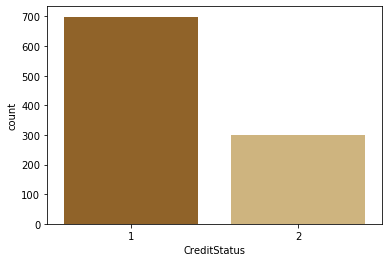

In [9]:
sns.countplot(x='CreditStatus', data=df_credit)
plt.show()

We have a disbalanced dataset...lets keep exploring

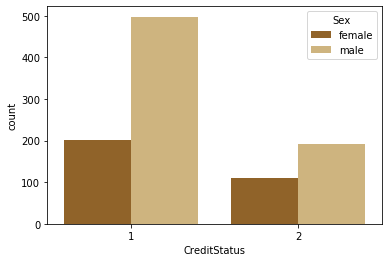

In [10]:
sns.countplot(x="CreditStatus", hue='Sex', data=df_credit)
plt.show()

### Other Features

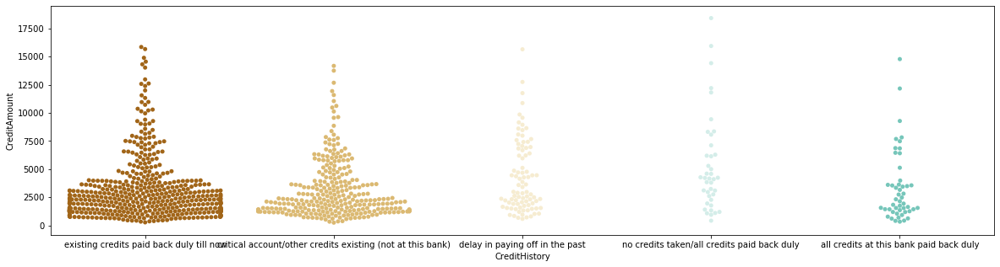

In [11]:
plt.figure(figsize=(20, 5))
sns.swarmplot(x="CreditHistory",y="CreditAmount",data=df_credit)
plt.show()

### Age

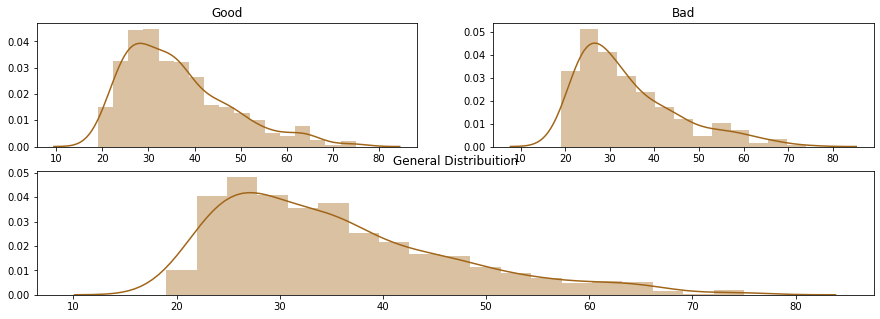

In [12]:
df_good = df_credit.loc[df_credit["CreditStatus"] == 1]['Age'].values.tolist()
df_bad = df_credit.loc[df_credit["CreditStatus"] == 2]['Age'].values.tolist()
df_age = df_credit['Age'].values.tolist()

fig = plt.figure(figsize=(15, 5))
#spec2 = gridspec.GridSpec(ncols=2, nrows=2, figure=fig)

ax1 = fig.add_subplot(221)
plot_good = sns.distplot(df_good, ax=ax1)
plt.title('Good')

ax2 = fig.add_subplot(222)
plot_bad = sns.distplot(df_bad, ax=ax2)
plt.title('Bad')

ax3 = fig.add_subplot(2,2,(3,4))
plot_age = sns.distplot(df_age, ax=ax3)
plt.title('General Distribuition')

plt.show()

### Credit Amount

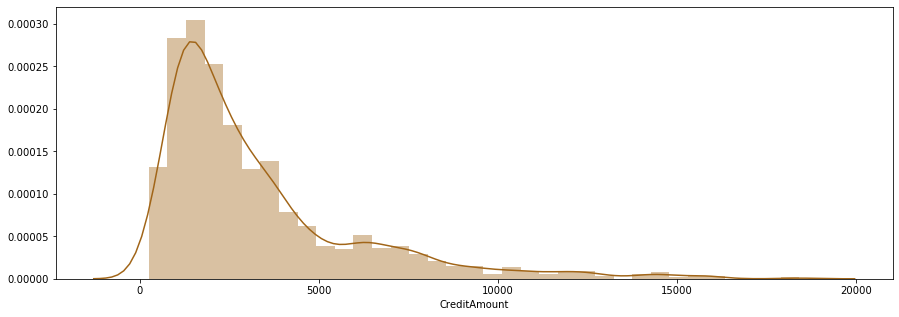

In [13]:
plt.figure(figsize=(15, 5))
sns.distplot(df_credit['CreditAmount'])
plt.show()

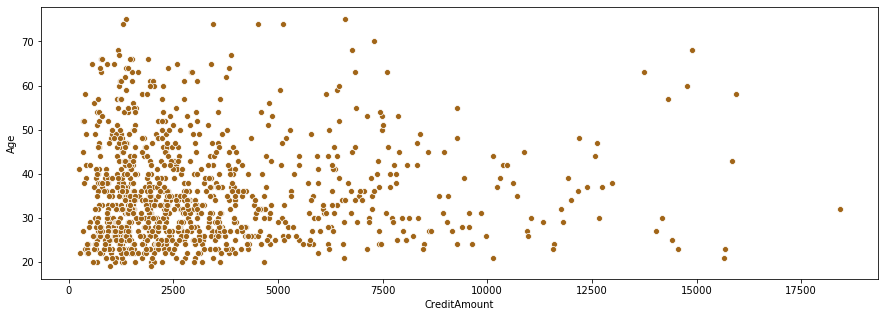

In [14]:
plt.figure(figsize=(15, 5))
sns.scatterplot(x='CreditAmount', y='Age', data=df_credit)
plt.show()

### Correlation Plot

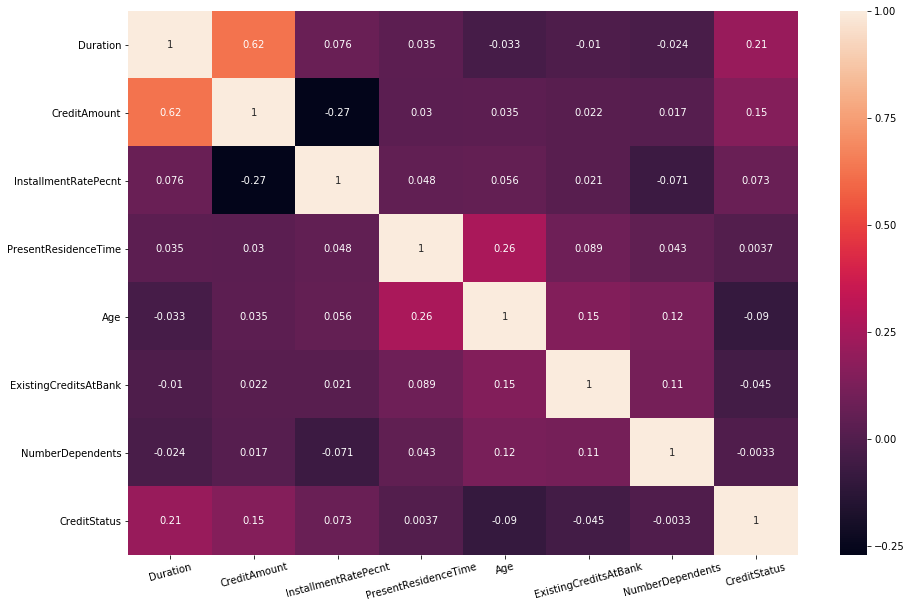

In [15]:
plt.figure(figsize=(15, 10))
a = sns.heatmap(df_credit.corr(),annot=True)
a.set_xticklabels(a.get_xticklabels(), rotation=15)
plt.show()

## Pre-Processing

### Binarize CreditStatus to 0 and 1

In [16]:
#(1 = Good, 2 = Bad) -> (1 = Good, 0 = Bad)

CreditStatus_new = {1:1, 2:0}

df_credit['CreditStatus'] = df_credit['CreditStatus'].map(CreditStatus_new)

### Categorize Features

In [17]:
# Age
age_interval = (18, 25, 35, 60, 120)

cats = ['Student', 'Young', 'Adult', 'Senior']
df_credit["Age"] = pd.cut(df_credit['Age'], age_interval, labels=cats)

# CreditAmount
#df_credit['CreditAmount'] = pd.qcut(df_credit['CreditAmount'], q=5)

# Duration
df_credit['Duration'] = pd.qcut(df_credit['Duration'], q=5)

### Label Encoding

In [18]:
cat_vars = ["CreditHistory", "CheckingAcctStat", "Purpose", "SavingsBonds", "Employment", 
           "OtherDetorsGuarantors", "Property", "OtherInstallments", "Housing",
           "Job", "Telephone", "ForeignWorker", "Sex", "PersonalStatus"]

cat_vars.append('Age')
#cat_vars.append('CreditAmount')
cat_vars.append('Duration')

for col_le in cat_vars:
    print('Label Encoding: {}'.format(col_le))
    #df_credit['{}_le'.format(col_le)] = preprocessing.LabelEncoder().fit_transform(df_credit[col_le])
    df_credit[col_le] = preprocessing.LabelEncoder().fit_transform(df_credit[col_le])


Label Encoding: CreditHistory
Label Encoding: CheckingAcctStat
Label Encoding: Purpose
Label Encoding: SavingsBonds
Label Encoding: Employment
Label Encoding: OtherDetorsGuarantors
Label Encoding: Property
Label Encoding: OtherInstallments
Label Encoding: Housing
Label Encoding: Job
Label Encoding: Telephone
Label Encoding: ForeignWorker
Label Encoding: Sex
Label Encoding: PersonalStatus
Label Encoding: Age
Label Encoding: Duration


### Normalization/Scaling

### CreditAmount to Log

In [19]:
df_credit['CreditAmount'] = np.log(df_credit['CreditAmount'])

### One-Hot Encoding

In [20]:
# Purpose to Dummies Variable
df_credit = df_credit.merge(pd.get_dummies(df_credit['Purpose'], drop_first=True, prefix='Purpose'), left_index=True, right_index=True)

#Sex feature in dummies
#df_credit = df_credit.merge(pd.get_dummies(df_credit['Sex'], drop_first=True, prefix='Sex'), left_index=True, right_index=True)

# Housing in dummies
df_credit = df_credit.merge(pd.get_dummies(df_credit['Housing'], drop_first=True, prefix='Housing'), left_index=True, right_index=True)

# SavingsBonds in dummies
df_credit = df_credit.merge(pd.get_dummies(df_credit['SavingsBonds'], drop_first=True, prefix='SavingsBonds'), left_index=True, right_index=True)

# Risk n dummies
# df_credit = df_credit.merge(pd.get_dummies(df_credit.Risk, prefix='Risk'), left_index=True, right_index=True)

# Checking Account n dummies
df_credit = df_credit.merge(pd.get_dummies(df_credit['CheckingAcctStat'], drop_first=True, prefix='CheckingAcctStat'), left_index=True, right_index=True)

# Age n dummies
df_credit = df_credit.merge(pd.get_dummies(df_credit["Age"], drop_first=True, prefix='Age'), left_index=True, right_index=True)

# PersonalStatus n dummies
df_credit = df_credit.merge(pd.get_dummies(df_credit["PersonalStatus"], drop_first=True, prefix='PersonalStatus'), left_index=True, right_index=True)

# ForeignWorker n dummies
# df_credit = df_credit.merge(pd.get_dummies(df_credit["ForeignWorker"], drop_first=True, prefix='ForeignWorker'), left_index=True, right_index=True)

# NumberDependents n dummies
df_credit = df_credit.merge(pd.get_dummies(df_credit["NumberDependents"], drop_first=True, prefix='NumberDependents'), left_index=True, right_index=True)

# Property n dummies
df_credit = df_credit.merge(pd.get_dummies(df_credit["Property"], drop_first=True, prefix='Property'), left_index=True, right_index=True)

# Telephone n dummies
#df_credit = df_credit.merge(pd.get_dummies(df_credit["Telephone"], drop_first=True, prefix='Telephone'), left_index=True, right_index=True)

# Job n dummies
df_credit = df_credit.merge(pd.get_dummies(df_credit["Job"], drop_first=True, prefix='Job'), left_index=True, right_index=True)

# InstallmentRatePecnt n dummies
df_credit = df_credit.merge(pd.get_dummies(df_credit["InstallmentRatePecnt"], drop_first=True, prefix='InstallmentRatePecnt'), left_index=True, right_index=True)

# InstallmentRatePecnt n dummies
df_credit = df_credit.merge(pd.get_dummies(df_credit["Employment"], drop_first=True, prefix='Employment'), left_index=True, right_index=True)

# InstallmentRatePecnt n dummies
df_credit = df_credit.merge(pd.get_dummies(df_credit["Duration"], drop_first=True, prefix='Duration'), left_index=True, right_index=True)

# InstallmentRatePecnt n dummies
df_credit = df_credit.merge(pd.get_dummies(df_credit["CreditHistory"], drop_first=True, prefix='CreditHistory'), left_index=True, right_index=True)

# InstallmentRatePecnt n dummies
#df_credit = df_credit.merge(pd.get_dummies(df_credit["CreditAmount"], drop_first=True, prefix='CreditAmount'), left_index=True, right_index=True)

# InstallmentRatePecnt n dummies
df_credit = df_credit.merge(pd.get_dummies(df_credit["ExistingCreditsAtBank"], drop_first=True, prefix='ExistingCreditsAtBank'), left_index=True, right_index=True)

# InstallmentRatePecnt n dummies
df_credit = df_credit.merge(pd.get_dummies(df_credit["OtherDetorsGuarantors"], drop_first=True, prefix='OtherDetorsGuarantors'), left_index=True, right_index=True)

# PresentResidenceTime n dummies
df_credit = df_credit.merge(pd.get_dummies(df_credit["PresentResidenceTime"], drop_first=True, prefix='PresentResidenceTime'), left_index=True, right_index=True)

# PresentResidenceTime n dummies
df_credit = df_credit.merge(pd.get_dummies(df_credit["OtherInstallments"], drop_first=True, prefix='OtherInstallments'), left_index=True, right_index=True)



#Excluding columns
df_credit.drop(columns=["SavingsBonds", "CheckingAcctStat","Purpose", 
                        "Housing", "Age", 'PersonalStatus',
                        'Property', 'Job',
                       'InstallmentRatePecnt', 'Employment', 'Duration',
                       'CreditHistory', 'CreditAmount', 'ExistingCreditsAtBank',
                       'OtherDetorsGuarantors', 'PresentResidenceTime', 
                        'OtherInstallments', 'NumberDependents'], inplace=True)

## Checking  the data 

In [21]:
df_credit.head(3)

,SexAndStatus,Telephone,ForeignWorker,CreditStatus,Sex,Purpose_1,Purpose_2,Purpose_3,Purpose_4,Purpose_5,Purpose_6,Purpose_7,Purpose_8,Purpose_9,Housing_1,Housing_2,SavingsBonds_1,SavingsBonds_2,SavingsBonds_3,SavingsBonds_4,CheckingAcctStat_1,CheckingAcctStat_2,CheckingAcctStat_3,Age_1,Age_2,Age_3,PersonalStatus_1,PersonalStatus_2,PersonalStatus_3,NumberDependents_2,Property_1,Property_2,Property_3,Job_1,Job_2,Job_3,InstallmentRatePecnt_2,InstallmentRatePecnt_3,InstallmentRatePecnt_4,Employment_1,Employment_2,Employment_3,Employment_4,Duration_1,Duration_2,Duration_3,Duration_4,CreditHistory_1,CreditHistory_2,CreditHistory_3,CreditHistory_4,ExistingCreditsAtBank_2,ExistingCreditsAtBank_3,ExistingCreditsAtBank_4,OtherDetorsGuarantors_1,OtherDetorsGuarantors_2,PresentResidenceTime_2,PresentResidenceTime_3,PresentResidenceTime_4,OtherInstallments_1,OtherInstallments_2
0,female : divorced/separated/married,0,1,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,1,0,0,0,1,0,1,0,0,0,0,1,0,1,0,0,1,0,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,1,1,0,0,0,0
1,male : single,0,1,1,1,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,1,1,0,1,0,0,0,1,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,1,0,0,0
2,male : single,0,1,1,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,1,0,0


## Modelling

In [22]:
# train_features = ['CreditHistory_le', 'CheckingAcctStat_le', 'Purpose_le', 'SavingsBonds_le', 'Employment_le',
#            'OtherDetorsGuarantors_le', 'Property_le', 'OtherInstallments_le', 'Housing_le', 'Job_le',
#            'Telephone_le', 'ForeignWorker_le', 'Sex_le', 'Status_le', 
#            'Duration', 'CreditAmount', 'InstallmentRatePecnt', 'PresentResidenceTime', 'ExistingCreditsAtBank',
#           'NumberDependents']

train_features_1 = ['CreditHistory', 'CheckingAcctStat', 'Purpose', 'SavingsBonds', 'Employment',
           'OtherDetorsGuarantors', 'Property', 'OtherInstallments', 'Housing', 'Job',
           'Telephone', 'ForeignWorker', 'Sex', 'PersonalStatus', 
           'Duration', 'CreditAmount', 'InstallmentRatePecnt', 'PresentResidenceTime', 'ExistingCreditsAtBank',
          'NumberDependents']

# Best Features from best_features_xg_clf_best_model 
train_features_2 = ['CheckingAcctStat', 'SavingsBonds', 'Sex', 'Duration', 'Employment', 'PresentResidenceTime',
                     'InstallmentRatePecnt', 'Housing', 'CreditAmount', 'Property']

# features from One-Hot Encoding
train_features_3 = list(df_credit[df_credit.columns.difference(['CreditStatus', 'SexAndStatus'])])

# removing less relevant features
train_features_4 = ['CreditHistory', 'CheckingAcctStat', 'Purpose', 'SavingsBonds', 'Employment',
           'OtherDetorsGuarantors', 'Property', 'OtherInstallments', 'Housing', 'Job',
           'Duration', 'CreditAmount', 'InstallmentRatePecnt', 'PresentResidenceTime', 'ExistingCreditsAtBank',
          'NumberDependents']


X = df_credit[train_features_3]
y = df_credit['CreditStatus']

In [23]:
def evaluate_XGBClassifier(model, X_train, y_train, X_test, y_test, gridSearch=False):
    # predict the target on the train dataset
    predict_train = model.predict(X_train)
    # predict the target on the test dataset
    predict_test = model.predict(X_test)
    # predict proba the target on the train dataset
    predict_proba_train = model.predict_proba(X_train)
    # predict proba the target on the test dataset
    predict_proba_test = model.predict_proba(X_test)
    
    ##################
    # Accuracy
    ##################
    
    # Accuray Score on train dataset
    accuracy_train = accuracy_score(y_train, predict_train)
    print('\nAccuracy(train dataset): {}'.format(round(accuracy_train, 2)))
    
    # Accuracy Score on test dataset
    accuracy_test = accuracy_score(y_test, predict_test)
    print('Accuracy(test dataset): {}'.format(round(accuracy_test, 2)))
    
    ##################
    # LogLoss
    ##################
    
    # LogLoss on train dataset
    ll_train = log_loss(y_train, predict_proba_train)
    print("\nLog Loss(train dataset): {}".format(round(ll_train, 2)))
    
    # LogLoss on test dataset
    ll_test = log_loss(y_test, predict_proba_test)
    print("Log Loss(test dataset): {}".format(round(ll_test, 2)))
    
    ##################
    # ROC AUC Score
    ##################
    
    # ROC AUC Score on train dataset
    roc_auc_score_train = roc_auc_score(y_train, predict_train)
    print("\nROC AUC Score(train dataset): {}".format(round(roc_auc_score_train, 2)))
    
    # ROC AUC Score on test dataset
    roc_auc_score_test = roc_auc_score(y_test, predict_test)
    print("ROC AUC Score(test dataset): {}".format(round(roc_auc_score_test, 2)))
    
     ##################
    # Feature Importance
    ##################
    sorted_idx = np.argsort(model.feature_importances_)[::-1]
#     for index in sorted_idx:
#         print([X_train.columns[index], model.feature_importances_[index]]) 
    plot_importance(model, max_num_features = 15)
    plt.show()
    
     ##################
    # Confusion Matrix
    ##################
    print('Confusion Matrix')
    cm = confusion_matrix(y_test, predict_test)
    #plt.figure(figsize=(10,6))  
    #cm_df = pd.DataFrame(cm, ['neutral','happy','sad'], ['neutral','happy','sad'])   
    #display(cm)
    sns.heatmap(cm, annot=np.empty_like(cm).astype(str), fmt='')
    
     ##################
    # Train-Test Log Loss
    ##################
    results = model.evals_result() # retrieve performance metrics
    epochs = len(results['validation_0']['error'])
    x_axis = range(0, epochs)
    # plot log loss
    fig, ax = plt.subplots()
    ax.plot(x_axis, results['validation_0']['logloss'], label='Train')
    ax.plot(x_axis, results['validation_1']['logloss'], label='Test')
    ax.legend()
    plt.ylabel('Log Loss')
    plt.title('XGBoost Log Loss')
    plt.show()
    
     ##################
    # Train-Test Classification Error
    ##################
    fig, ax = plt.subplots()
    ax.plot(x_axis, results['validation_0']['error'], label='Train')
    ax.plot(x_axis, results['validation_1']['error'], label='Test')
    ax.legend()
    plt.ylabel('Classification Error')
    plt.title('XGBoost Classification Error')
    plt.show()
    
     ##################
    # ROC curve
    ##################
    y_pred_prob = model.predict_proba(X_test)[:,1]
    # Generate ROC curve values: fpr, tpr, thresholds
    fpr, tpr, thresholds = roc_curve(y_test, y_pred_prob)
    # Plot ROC curve
    plt.plot([0, 1], [0, 1], 'k--')
    plt.plot(fpr, tpr)
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('ROC Curve')
    plt.show()

In [24]:
def get_best_features(model):
    sorted_idx = np.argsort(model.feature_importances_)[::-1]

    df_feature_importances = pd.DataFrame()

    for index in sorted_idx:
        serie_aux = pd.Series([X_train.columns[index], model.feature_importances_[index]])
        df_feature_importances = df_feature_importances.append(serie_aux,ignore_index=True)
    
    df_feature_importances.columns=['col', 'importance']
    
    return df_feature_importances.sort_values(by='importance', ascending=False)

### Train Test Split

In [25]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=4569)

X_train.shape, X_test.shape, y_train.shape, y_test.shape

((669, 59), (330, 59), (669,), (330,))

###  Balanced Dataset - SMOTE

In [26]:
from imblearn.over_sampling import SMOTE

sm = SMOTE(sampling_strategy='auto')
X_train_res, y_train_res = sm.fit_sample(X_train, y_train)

# Print number of 'good' credits and 'bad credits, should be fairly balanced now
print("Before clean")
unique, counts = np.unique(y_train, return_counts=True)
print(dict(zip(unique, counts)))
print("After clean")
unique, counts = np.unique(y_train_res, return_counts=True)
print(dict(zip(unique, counts)))

# defining train/test split
X_train = pd.DataFrame(X_train_res, columns=X_train.keys())
y_train = pd.DataFrame(y_train_res).values.ravel()

print('\nShape after SMOTE:')
X_train.shape, X_test.shape, y_train.shape, y_test.shape

Before clean
{0: 189, 1: 480}
After clean
{0: 480, 1: 480}

Shape after SMOTE:


((960, 59), (330, 59), (960,), (330,))

### XGBoost Classifier

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0,
              learning_rate=0.1, max_delta_step=0, max_depth=3,
              min_child_weight=1, missing=None, n_estimators=300, n_jobs=1,
              nthread=None, objective='binary:logistic', random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, seed=None,
              silent=None, subsample=1, verbosity=1)

Accuracy(train dataset): 0.87
Accuracy(test dataset): 0.78

Log Loss(train dataset): 0.33
Log Loss(test dataset): 0.49

ROC AUC Score(train dataset): 0.87
ROC AUC Score(test dataset): 0.76


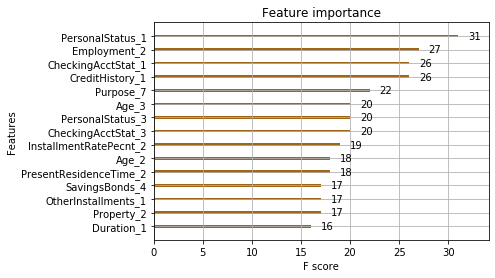

Confusion Matrix


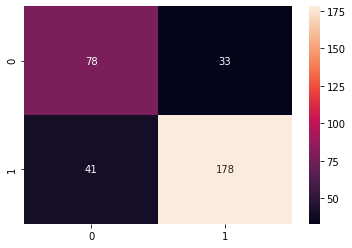

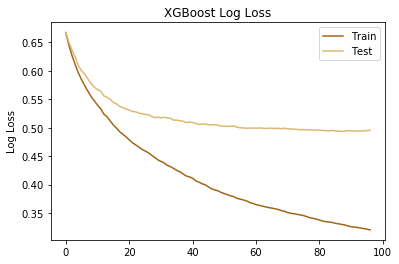

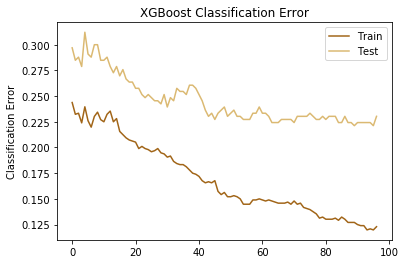

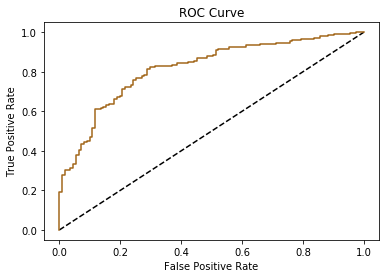

In [27]:
# fit the model with the training data
eval_set = [(X_train, y_train), (X_test, y_test)]

xg_clf = XGBClassifier(n_estimators = 300)
xg_clf.fit(X_train,y_train, early_stopping_rounds=10, 
           eval_metric=["error", "logloss"], eval_set=eval_set, verbose=False)

# see the model parameters
print(xg_clf)

# evaluate the model
evaluate_XGBClassifier(xg_clf, X_train, y_train, X_test, y_test)

In [28]:
best_features_xg_clf = get_best_features(xg_clf)

best_features_xg_clf

,col,importance
0,CheckingAcctStat_3,0.186555
1,CreditHistory_2,0.043332
2,Property_2,0.043187
3,SavingsBonds_4,0.036696
4,CheckingAcctStat_2,0.036399
5,Sex,0.031940
6,OtherDetorsGuarantors_1,0.031676
7,Employment_2,0.027851
8,CreditHistory_1,0.027067
9,CreditHistory_3,0.026512


### GridSearchCV

In [37]:
#Setting the Hyper Parameters
param_test = {
     'max_depth':[3,5,6,10],
     #'min_child_weight':[3,5,10],
     #'gamma':[0.0, 0.1, 0.2, 0.3, 0.4],
     'reg_alpha':[1e-5, 1e-2, 0.1, 1, 10],
     'n_estimators': [i for i in range(1, 200,1)],
     #'subsample':[i/100.0 for i in range(5,25,5)],
     #'colsample_bytree':[i/100.0 for i in range(5,25,5)],
     'learning_rate': [0.0001, 0.001, 0.01, 0.1, 0.2, 0.3],
    }

scoring = {'AUC': 'roc_auc', 'Accuracy': make_scorer(accuracy_score), 'LogLoss': 'neg_log_loss' }

xg_clf_1 = XGBClassifier(n_estimators=300)

grid_search1 = GridSearchCV(xg_clf_1, param_grid=param_test, cv=10, scoring=scoring, refit='Accuracy', 
                            return_train_score=True, verbose=3)
grid_search1.fit(X_train, y_train)

print(grid_search1.best_score_)
print(grid_search1.best_params_)

# Get the best GridSearch Model
print('\nBest GridSearch Model:')
xg_clf_best_model = grid_search1.best_estimator_
print(xg_clf_best_model)

Fitting 10 folds for each of 23880 candidates, totalling 238800 fits
[CV] learning_rate=0.0001, max_depth=3, n_estimators=1, reg_alpha=1e-05 


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


[CV]  learning_rate=0.0001, max_depth=3, n_estimators=1, reg_alpha=1e-05, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.693, test=-0.693), total=   0.7s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=1, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=1, reg_alpha=1e-05, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=1, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=1, reg_alpha=1e-05, AUC=(train=0.791, test=0.711), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=1, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=1, reg_alpha=1e-05, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.6s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.7s remaining:    0.0s


[CV] learning_rate=0.0001, max_depth=3, n_estimators=1, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=1, reg_alpha=0.01, AUC=(train=0.791, test=0.711), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=1, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=1, reg_alpha=0.01, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=1, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=1, reg_alpha=0.01, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=1, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=1, reg_alpha=0.01, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740),

[CV] learning_rate=0.0001, max_depth=3, n_estimators=2, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=2, reg_alpha=1e-05, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=2, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=2, reg_alpha=1e-05, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=2, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=2, reg_alpha=1e-05, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=2, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=2, reg_alpha=1e-05, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test

[CV] learning_rate=0.0001, max_depth=3, n_estimators=2, reg_alpha=10 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=2, reg_alpha=10, AUC=(train=0.782, test=0.702), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=2, reg_alpha=10 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=2, reg_alpha=10, AUC=(train=0.779, test=0.696), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=2, reg_alpha=10 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=2, reg_alpha=10, AUC=(train=0.780, test=0.685), Accuracy=(train=0.743, test=0.667), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=2, reg_alpha=10 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=2, reg_alpha=10, AUC=(train=0.778, test=0.690), Accuracy=(train=0.740, test=0.698), LogLoss=(tr

[CV] learning_rate=0.0001, max_depth=3, n_estimators=3, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=3, reg_alpha=0.1, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=3, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=3, reg_alpha=0.1, AUC=(train=0.780, test=0.808), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=3, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=3, reg_alpha=0.1, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=3, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=3, reg_alpha=0.1, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss

[CV] learning_rate=0.0001, max_depth=3, n_estimators=4, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=4, reg_alpha=1e-05, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=4, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=4, reg_alpha=0.01, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=4, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=4, reg_alpha=0.01, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=4, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=4, reg_alpha=0.01, AUC=(train=0.791, test=0.711), Accuracy=(train=0.764, test=0.677

[CV] learning_rate=0.0001, max_depth=3, n_estimators=4, reg_alpha=10 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=4, reg_alpha=10, AUC=(train=0.779, test=0.696), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=4, reg_alpha=10 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=4, reg_alpha=10, AUC=(train=0.780, test=0.685), Accuracy=(train=0.743, test=0.667), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=4, reg_alpha=10 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=4, reg_alpha=10, AUC=(train=0.778, test=0.690), Accuracy=(train=0.740, test=0.698), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=4, reg_alpha=10 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=4, reg_alpha=10, AUC=(train=0.777, test=0.742), Accuracy=(train=0.722, test=0.729), LogLoss=(tr

[CV] learning_rate=0.0001, max_depth=3, n_estimators=5, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=5, reg_alpha=0.1, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=5, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=5, reg_alpha=0.1, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=5, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=5, reg_alpha=0.1, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=5, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=5, reg_alpha=0.1, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=6, reg_alpha=0.01, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=6, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=6, reg_alpha=0.01, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=6, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=6, reg_alpha=0.01, AUC=(train=0.791, test=0.711), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=6, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=6, reg_alpha=0.01, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0

[CV] learning_rate=0.0001, max_depth=3, n_estimators=6, reg_alpha=10 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=6, reg_alpha=10, AUC=(train=0.777, test=0.742), Accuracy=(train=0.722, test=0.729), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=6, reg_alpha=10 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=6, reg_alpha=10, AUC=(train=0.772, test=0.794), Accuracy=(train=0.726, test=0.708), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=6, reg_alpha=10 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=6, reg_alpha=10, AUC=(train=0.763, test=0.817), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=6, reg_alpha=10 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=6, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(tr

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=7, reg_alpha=0.1, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=7, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=7, reg_alpha=0.1, AUC=(train=0.780, test=0.808), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=7, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=7, reg_alpha=0.1, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=7, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=7, reg_alpha=0.1, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, 

[CV] learning_rate=0.0001, max_depth=3, n_estimators=8, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=8, reg_alpha=1e-05, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=8, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=8, reg_alpha=1e-05, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=8, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=8, reg_alpha=0.01, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=8, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=8, reg_alpha=0.01, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.6

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=8, reg_alpha=10, AUC=(train=0.778, test=0.690), Accuracy=(train=0.740, test=0.698), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=8, reg_alpha=10 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=8, reg_alpha=10, AUC=(train=0.777, test=0.742), Accuracy=(train=0.722, test=0.729), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=8, reg_alpha=10 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=8, reg_alpha=10, AUC=(train=0.772, test=0.794), Accuracy=(train=0.726, test=0.708), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=8, reg_alpha=10 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=8, reg_alpha=10, AUC=(train=0.763, test=0.817), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=9, reg_alpha=0.1, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=9, reg_alpha=1 ..
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=9, reg_alpha=1, AUC=(train=0.799, test=0.717), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=9, reg_alpha=1 ..
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=9, reg_alpha=1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=9, reg_alpha=1 ..
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=9, reg_alpha=1, AUC=(train=0.786, test=0.705), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_de

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=10, reg_alpha=0.01, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=10, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=10, reg_alpha=0.01, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=10, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=10, reg_alpha=0.01, AUC=(train=0.780, test=0.808), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=10, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=10, reg_alpha=0.01, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=10, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=10, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=10, reg_alpha=10, AUC=(train=0.766, test=0.857), Accuracy=(train=0.722, test=0.740), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=10, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=10, reg_alpha=10, AUC=(train=0.773, test=0.786), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=11, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=11, reg_alpha=1e-05, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=11, reg_alpha=0.1, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=11, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=11, reg_alpha=1, AUC=(train=0.799, test=0.719), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=11, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=11, reg_alpha=1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=11, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=11, reg_alpha=1, AUC=(train=0.786, test=0.705), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, ma

[CV] learning_rate=0.0001, max_depth=3, n_estimators=12, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=12, reg_alpha=0.01, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=12, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=12, reg_alpha=0.01, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=12, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=12, reg_alpha=0.01, AUC=(train=0.780, test=0.808), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=12, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=12, reg_alpha=0.01, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=12, reg_alpha=10, AUC=(train=0.773, test=0.786), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=13, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=13, reg_alpha=1e-05, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=13, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=13, reg_alpha=1e-05, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=13, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=13, reg_alpha=1e-05, AUC=(train=0.791, test=0.711), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] lear

[CV] learning_rate=0.0001, max_depth=3, n_estimators=13, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=13, reg_alpha=1, AUC=(train=0.790, test=0.693), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=13, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=13, reg_alpha=1, AUC=(train=0.786, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=13, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=13, reg_alpha=1, AUC=(train=0.772, test=0.775), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=13, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=13, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(tr

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=14, reg_alpha=0.01, AUC=(train=0.780, test=0.808), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=14, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=14, reg_alpha=0.01, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.693, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=14, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=14, reg_alpha=0.01, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.693, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=14, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=14, reg_alpha=0.1, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.693, test=-0.693), total=   0.1s
[CV] learning_r

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=14, reg_alpha=10, AUC=(train=0.773, test=0.786), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=15, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=15, reg_alpha=1e-05, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=15, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=15, reg_alpha=1e-05, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=15, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=15, reg_alpha=1e-05, AUC=(train=0.791, test=0.711), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] lear

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=15, reg_alpha=1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=15, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=15, reg_alpha=1, AUC=(train=0.786, test=0.705), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=15, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=15, reg_alpha=1, AUC=(train=0.790, test=0.693), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=15, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=15, reg_alpha=1, AUC=(train=0.786, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=16, reg_alpha=0.01, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=16, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=16, reg_alpha=0.01, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=16, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=16, reg_alpha=0.01, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=16, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=16, reg_alpha=0.01, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=16, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=16, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=16, reg_alpha=10, AUC=(train=0.766, test=0.857), Accuracy=(train=0.722, test=0.740), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=16, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=16, reg_alpha=10, AUC=(train=0.773, test=0.786), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=17, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=17, reg_alpha=1e-05, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.

[CV] learning_rate=0.0001, max_depth=3, n_estimators=17, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=17, reg_alpha=1, AUC=(train=0.799, test=0.719), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=17, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=17, reg_alpha=1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=17, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=17, reg_alpha=1, AUC=(train=0.786, test=0.705), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=17, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=17, reg_alpha=1, AUC=(train=0.790, test=0.693), Accuracy=(train=0.743, test=0.698), LogLoss=(tr

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=18, reg_alpha=0.01, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=18, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=18, reg_alpha=0.01, AUC=(train=0.791, test=0.711), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=18, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=18, reg_alpha=0.01, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=18, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=18, reg_alpha=0.01, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=18, reg_alpha=10, AUC=(train=0.778, test=0.690), Accuracy=(train=0.740, test=0.698), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=18, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=18, reg_alpha=10, AUC=(train=0.777, test=0.742), Accuracy=(train=0.722, test=0.729), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=18, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=18, reg_alpha=10, AUC=(train=0.772, test=0.794), Accuracy=(train=0.726, test=0.708), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=18, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=18, reg_alpha=10, AUC=(train=0.763, test=0.817), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=19, reg_alpha=0.1, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=19, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=19, reg_alpha=0.1, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=19, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=19, reg_alpha=0.1, AUC=(train=0.780, test=0.808), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=19, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=19, reg_alpha=0.1, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=20, reg_alpha=1e-05, AUC=(train=0.780, test=0.808), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=20, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=20, reg_alpha=1e-05, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=20, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=20, reg_alpha=1e-05, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=20, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=20, reg_alpha=0.01, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] lea

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=20, reg_alpha=1, AUC=(train=0.777, test=0.772), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=20, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=20, reg_alpha=10, AUC=(train=0.782, test=0.702), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=20, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=20, reg_alpha=10, AUC=(train=0.779, test=0.696), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=20, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=20, reg_alpha=10, AUC=(train=0.780, test=0.685), Accuracy=(train=0.743, test=0.667), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, m

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=21, reg_alpha=0.1, AUC=(train=0.791, test=0.711), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=21, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=21, reg_alpha=0.1, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=21, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=21, reg_alpha=0.1, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=21, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=21, reg_alpha=0.1, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=22, reg_alpha=1e-05, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.693, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=22, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=22, reg_alpha=1e-05, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=22, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=22, reg_alpha=1e-05, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.693, test=-0.692), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=22, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=22, reg_alpha=1e-05, AUC=(train=0.780, test=0.808), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.693, test=-0.692), total=   0.0s
[CV] l

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=22, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.693, test=-0.692), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=22, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=22, reg_alpha=1, AUC=(train=0.775, test=0.804), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.693, test=-0.692), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=22, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=22, reg_alpha=1, AUC=(train=0.769, test=0.853), Accuracy=(train=0.734, test=0.812), LogLoss=(train=-0.693, test=-0.692), total=   0.0s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=22, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=22, reg_alpha=1, AUC=(train=0.777, test=0.772), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=23, reg_alpha=0.01, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.693, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=23, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=23, reg_alpha=0.01, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.693, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=23, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=23, reg_alpha=0.1, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=23, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=23, reg_alpha=0.1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rat

[CV] learning_rate=0.0001, max_depth=3, n_estimators=24, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=24, reg_alpha=1e-05, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=24, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=24, reg_alpha=1e-05, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=24, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=24, reg_alpha=1e-05, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=24, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=24, reg_alpha=1e-05, AUC=(train=0.772, test=0.830), Accuracy=(train=0.7

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=24, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.693, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=24, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=24, reg_alpha=1, AUC=(train=0.775, test=0.804), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.693, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=24, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=24, reg_alpha=1, AUC=(train=0.769, test=0.853), Accuracy=(train=0.734, test=0.812), LogLoss=(train=-0.693, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=24, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=24, reg_alpha=1, AUC=(train=0.777, test=0.772), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.693, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_

[CV] learning_rate=0.0001, max_depth=3, n_estimators=25, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=25, reg_alpha=0.1, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=25, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=25, reg_alpha=0.1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=25, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=25, reg_alpha=0.1, AUC=(train=0.791, test=0.711), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=25, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=25, reg_alpha=0.1, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635),

[CV] learning_rate=0.0001, max_depth=3, n_estimators=26, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=26, reg_alpha=1e-05, AUC=(train=0.791, test=0.711), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=26, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=26, reg_alpha=1e-05, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=26, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=26, reg_alpha=1e-05, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=26, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=26, reg_alpha=1e-05, AUC=(train=0.778, test=0.778), Accuracy=(train=0.7

[CV] learning_rate=0.0001, max_depth=3, n_estimators=26, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=26, reg_alpha=1, AUC=(train=0.772, test=0.775), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=26, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=26, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=26, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=26, reg_alpha=1, AUC=(train=0.775, test=0.804), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=26, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=26, reg_alpha=1, AUC=(train=0.769, test=0.853), Accuracy=(train=0.734, test=0.812), LogLoss=(tr

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=27, reg_alpha=0.01, AUC=(train=0.780, test=0.808), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=27, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=27, reg_alpha=0.01, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=27, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=27, reg_alpha=0.01, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=27, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=27, reg_alpha=0.1, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_r

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=28, reg_alpha=1e-05, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=28, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=28, reg_alpha=1e-05, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=28, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=28, reg_alpha=1e-05, AUC=(train=0.791, test=0.711), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=28, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=28, reg_alpha=1e-05, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] l

[CV] learning_rate=0.0001, max_depth=3, n_estimators=28, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=28, reg_alpha=1, AUC=(train=0.786, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=28, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=28, reg_alpha=1, AUC=(train=0.772, test=0.775), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=28, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=28, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=28, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=28, reg_alpha=1, AUC=(train=0.775, test=0.804), Accuracy=(train=0.750, test=0.802), LogLoss=(tr

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=29, reg_alpha=0.01, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=29, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=29, reg_alpha=0.01, AUC=(train=0.780, test=0.808), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=29, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=29, reg_alpha=0.01, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=29, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=29, reg_alpha=0.01, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=29, reg_alpha=10, AUC=(train=0.773, test=0.786), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.693, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=30, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=30, reg_alpha=1e-05, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=30, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=30, reg_alpha=1e-05, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=30, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=30, reg_alpha=1e-05, AUC=(train=0.791, test=0.711), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] lear

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=30, reg_alpha=1, AUC=(train=0.786, test=0.705), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=30, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=30, reg_alpha=1, AUC=(train=0.790, test=0.693), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=30, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=30, reg_alpha=1, AUC=(train=0.786, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=30, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=30, reg_alpha=1, AUC=(train=0.772, test=0.775), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=31, reg_alpha=0.01, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=31, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=31, reg_alpha=0.01, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=31, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=31, reg_alpha=0.01, AUC=(train=0.780, test=0.808), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=31, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=31, reg_alpha=0.01, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=31, reg_alpha=10, AUC=(train=0.766, test=0.857), Accuracy=(train=0.722, test=0.740), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=31, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=31, reg_alpha=10, AUC=(train=0.773, test=0.786), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=32, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=32, reg_alpha=1e-05, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=32, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=32, reg_alpha=1e-05, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_r

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=32, reg_alpha=0.1, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=32, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=32, reg_alpha=1, AUC=(train=0.799, test=0.719), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=32, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=32, reg_alpha=1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=32, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=32, reg_alpha=1, AUC=(train=0.786, test=0.705), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, ma

[CV] learning_rate=0.0001, max_depth=3, n_estimators=33, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=33, reg_alpha=0.01, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=33, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=33, reg_alpha=0.01, AUC=(train=0.791, test=0.711), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=33, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=33, reg_alpha=0.01, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=33, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=33, reg_alpha=0.01, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test

[CV] learning_rate=0.0001, max_depth=3, n_estimators=33, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=33, reg_alpha=10, AUC=(train=0.777, test=0.742), Accuracy=(train=0.722, test=0.729), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=33, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=33, reg_alpha=10, AUC=(train=0.772, test=0.794), Accuracy=(train=0.726, test=0.708), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=33, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=33, reg_alpha=10, AUC=(train=0.763, test=0.817), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=33, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=33, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=34, reg_alpha=0.1, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=34, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=34, reg_alpha=0.1, AUC=(train=0.780, test=0.808), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=34, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=34, reg_alpha=0.1, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=34, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=34, reg_alpha=0.1, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0

[CV] learning_rate=0.0001, max_depth=3, n_estimators=35, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=35, reg_alpha=1e-05, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=35, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=35, reg_alpha=0.01, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=35, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=35, reg_alpha=0.01, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=35, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=35, reg_alpha=0.01, AUC=(train=0.791, test=0.711), Accuracy=(train=0.764, te

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=35, reg_alpha=10, AUC=(train=0.782, test=0.702), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=35, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=35, reg_alpha=10, AUC=(train=0.779, test=0.696), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=35, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=35, reg_alpha=10, AUC=(train=0.780, test=0.685), Accuracy=(train=0.743, test=0.667), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=35, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=35, reg_alpha=10, AUC=(train=0.778, test=0.690), Accuracy=(train=0.740, test=0.698), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, 

[CV] learning_rate=0.0001, max_depth=3, n_estimators=36, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=36, reg_alpha=0.1, AUC=(train=0.791, test=0.711), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=36, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=36, reg_alpha=0.1, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=36, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=36, reg_alpha=0.1, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=36, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=36, reg_alpha=0.1, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740),

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=37, reg_alpha=1e-05, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=37, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=37, reg_alpha=1e-05, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=37, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=37, reg_alpha=1e-05, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=37, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=37, reg_alpha=1e-05, AUC=(train=0.780, test=0.808), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] l

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=37, reg_alpha=1, AUC=(train=0.769, test=0.853), Accuracy=(train=0.734, test=0.812), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=37, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=37, reg_alpha=1, AUC=(train=0.777, test=0.772), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=37, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=37, reg_alpha=10, AUC=(train=0.782, test=0.702), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=37, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=37, reg_alpha=10, AUC=(train=0.779, test=0.696), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, ma

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=38, reg_alpha=0.1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=38, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=38, reg_alpha=0.1, AUC=(train=0.791, test=0.711), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=38, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=38, reg_alpha=0.1, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=38, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=38, reg_alpha=0.1, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=39, reg_alpha=1e-05, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=39, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=39, reg_alpha=1e-05, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=39, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=39, reg_alpha=1e-05, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=39, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=39, reg_alpha=1e-05, AUC=(train=0.780, test=0.808), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] l

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=39, reg_alpha=1, AUC=(train=0.775, test=0.804), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=39, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=39, reg_alpha=1, AUC=(train=0.769, test=0.853), Accuracy=(train=0.734, test=0.812), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=39, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=39, reg_alpha=1, AUC=(train=0.777, test=0.772), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=39, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=39, reg_alpha=10, AUC=(train=0.782, test=0.702), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=40, reg_alpha=0.1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=40, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=40, reg_alpha=0.1, AUC=(train=0.791, test=0.711), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=40, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=40, reg_alpha=0.1, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=40, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=40, reg_alpha=0.1, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0

[CV] learning_rate=0.0001, max_depth=3, n_estimators=41, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=41, reg_alpha=1e-05, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=41, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=41, reg_alpha=1e-05, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=41, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=41, reg_alpha=1e-05, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=41, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=41, reg_alpha=1e-05, AUC=(train=0.772, test=0.830), Accuracy=(train=0.7

[CV] learning_rate=0.0001, max_depth=3, n_estimators=41, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=41, reg_alpha=1, AUC=(train=0.772, test=0.775), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=41, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=41, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=41, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=41, reg_alpha=1, AUC=(train=0.775, test=0.804), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=41, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=41, reg_alpha=1, AUC=(train=0.769, test=0.853), Accuracy=(train=0.734, test=0.812), LogLoss=(tr

[CV] learning_rate=0.0001, max_depth=3, n_estimators=42, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=42, reg_alpha=0.01, AUC=(train=0.780, test=0.808), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=42, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=42, reg_alpha=0.01, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=42, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=42, reg_alpha=0.01, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=42, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=42, reg_alpha=0.1, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0

[CV] learning_rate=0.0001, max_depth=3, n_estimators=43, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=43, reg_alpha=1e-05, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=43, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=43, reg_alpha=1e-05, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=43, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=43, reg_alpha=1e-05, AUC=(train=0.791, test=0.711), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=43, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=43, reg_alpha=1e-05, AUC=(train=0.779, test=0.627), Accuracy=(train=0.7

[CV] learning_rate=0.0001, max_depth=3, n_estimators=43, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=43, reg_alpha=1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=43, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=43, reg_alpha=1, AUC=(train=0.786, test=0.705), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=43, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=43, reg_alpha=1, AUC=(train=0.790, test=0.693), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=43, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=43, reg_alpha=1, AUC=(train=0.786, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(tr

[CV] learning_rate=0.0001, max_depth=3, n_estimators=44, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=44, reg_alpha=0.01, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=44, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=44, reg_alpha=0.01, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=44, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=44, reg_alpha=0.01, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=44, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=44, reg_alpha=0.01, AUC=(train=0.780, test=0.808), Accuracy=(train=0.750, test

[CV] learning_rate=0.0001, max_depth=3, n_estimators=44, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=44, reg_alpha=10, AUC=(train=0.763, test=0.817), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=44, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=44, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=44, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=44, reg_alpha=10, AUC=(train=0.766, test=0.857), Accuracy=(train=0.722, test=0.740), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=44, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=44, reg_alpha=10, AUC=(train=0.773, test=0.786), Accuracy=(train=0.721, test=0.750), LogLoss

[CV] learning_rate=0.0001, max_depth=3, n_estimators=45, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=45, reg_alpha=0.1, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=45, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=45, reg_alpha=0.1, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=45, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=45, reg_alpha=1, AUC=(train=0.800, test=0.718), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=45, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=45, reg_alpha=1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLo

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=46, reg_alpha=1e-05, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=46, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=46, reg_alpha=0.01, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=46, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=46, reg_alpha=0.01, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=46, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=46, reg_alpha=0.01, AUC=(train=0.791, test=0.711), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learnin

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=46, reg_alpha=10, AUC=(train=0.780, test=0.685), Accuracy=(train=0.743, test=0.667), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=46, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=46, reg_alpha=10, AUC=(train=0.778, test=0.690), Accuracy=(train=0.740, test=0.698), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=46, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=46, reg_alpha=10, AUC=(train=0.777, test=0.742), Accuracy=(train=0.722, test=0.729), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=46, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=46, reg_alpha=10, AUC=(train=0.772, test=0.794), Accuracy=(train=0.726, test=0.708), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=47, reg_alpha=0.1, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=47, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=47, reg_alpha=0.1, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=47, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=47, reg_alpha=0.1, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=47, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=47, reg_alpha=0.1, AUC=(train=0.780, test=0.808), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0

[CV] learning_rate=0.0001, max_depth=3, n_estimators=48, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=48, reg_alpha=1e-05, AUC=(train=0.793, test=0.826), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=48, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=48, reg_alpha=1e-05, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=48, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=48, reg_alpha=1e-05, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=48, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=48, reg_alpha=0.01, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=48, reg_alpha=1, AUC=(train=0.769, test=0.853), Accuracy=(train=0.734, test=0.812), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=48, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=48, reg_alpha=1, AUC=(train=0.777, test=0.772), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=48, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=48, reg_alpha=10, AUC=(train=0.782, test=0.702), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=48, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=48, reg_alpha=10, AUC=(train=0.779, test=0.696), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, ma

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=49, reg_alpha=0.1, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=49, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=49, reg_alpha=0.1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=49, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=49, reg_alpha=0.1, AUC=(train=0.791, test=0.711), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=49, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=49, reg_alpha=0.1, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=50, reg_alpha=1e-05, AUC=(train=0.791, test=0.711), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=50, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=50, reg_alpha=1e-05, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=50, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=50, reg_alpha=1e-05, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=50, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=50, reg_alpha=1e-05, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] l

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=50, reg_alpha=1, AUC=(train=0.786, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=50, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=50, reg_alpha=1, AUC=(train=0.772, test=0.775), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=50, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=50, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=50, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=50, reg_alpha=1, AUC=(train=0.775, test=0.804), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=51, reg_alpha=0.01, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.692, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=51, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=51, reg_alpha=0.01, AUC=(train=0.793, test=0.826), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=51, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=51, reg_alpha=0.01, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=51, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=51, reg_alpha=0.01, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=51, reg_alpha=10, AUC=(train=0.766, test=0.857), Accuracy=(train=0.722, test=0.740), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=51, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=51, reg_alpha=10, AUC=(train=0.773, test=0.786), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=52, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=52, reg_alpha=1e-05, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=52, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=52, reg_alpha=1e-05, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_r

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=52, reg_alpha=1, AUC=(train=0.800, test=0.718), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=52, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=52, reg_alpha=1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=52, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=52, reg_alpha=1, AUC=(train=0.786, test=0.705), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=52, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=52, reg_alpha=1, AUC=(train=0.790, test=0.693), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=53, reg_alpha=0.01, AUC=(train=0.791, test=0.711), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=53, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=53, reg_alpha=0.01, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=53, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=53, reg_alpha=0.01, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=53, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=53, reg_alpha=0.01, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=53, reg_alpha=10, AUC=(train=0.777, test=0.742), Accuracy=(train=0.722, test=0.729), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=53, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=53, reg_alpha=10, AUC=(train=0.772, test=0.794), Accuracy=(train=0.726, test=0.708), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=53, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=53, reg_alpha=10, AUC=(train=0.763, test=0.817), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=53, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=53, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=54, reg_alpha=0.1, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.692, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=54, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=54, reg_alpha=0.1, AUC=(train=0.780, test=0.808), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.692, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=54, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=54, reg_alpha=0.1, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=54, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=54, reg_alpha=0.1, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=55, reg_alpha=1e-05, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.692, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=55, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=55, reg_alpha=1e-05, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=55, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=55, reg_alpha=0.01, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=55, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=55, reg_alpha=0.01, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learn

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=55, reg_alpha=10, AUC=(train=0.782, test=0.702), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=55, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=55, reg_alpha=10, AUC=(train=0.779, test=0.696), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=55, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=55, reg_alpha=10, AUC=(train=0.780, test=0.685), Accuracy=(train=0.743, test=0.667), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=55, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=55, reg_alpha=10, AUC=(train=0.778, test=0.690), Accuracy=(train=0.740, test=0.698), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=56, reg_alpha=0.1, AUC=(train=0.791, test=0.711), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=56, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=56, reg_alpha=0.1, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=56, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=56, reg_alpha=0.1, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=56, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=56, reg_alpha=0.1, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=57, reg_alpha=1e-05, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=57, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=57, reg_alpha=1e-05, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=57, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=57, reg_alpha=1e-05, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.692, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=57, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=57, reg_alpha=1e-05, AUC=(train=0.793, test=0.826), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.692, test=-0.691), total=   0.1s
[CV] l

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=57, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.692, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=57, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=57, reg_alpha=1, AUC=(train=0.775, test=0.804), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.692, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=57, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=57, reg_alpha=1, AUC=(train=0.769, test=0.853), Accuracy=(train=0.734, test=0.812), LogLoss=(train=-0.692, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=57, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=57, reg_alpha=1, AUC=(train=0.777, test=0.772), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=58, reg_alpha=0.01, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.692, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=58, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=58, reg_alpha=0.01, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=58, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=58, reg_alpha=0.1, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=58, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=58, reg_alpha=0.1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rat

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=59, reg_alpha=1e-05, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=59, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=59, reg_alpha=1e-05, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=59, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=59, reg_alpha=1e-05, AUC=(train=0.791, test=0.711), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=59, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=59, reg_alpha=1e-05, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] l

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=59, reg_alpha=1, AUC=(train=0.786, test=0.705), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=59, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=59, reg_alpha=1, AUC=(train=0.790, test=0.693), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=59, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=59, reg_alpha=1, AUC=(train=0.786, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=59, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=59, reg_alpha=1, AUC=(train=0.772, test=0.775), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=60, reg_alpha=0.01, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=60, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=60, reg_alpha=0.01, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=60, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=60, reg_alpha=0.01, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.692, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=60, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=60, reg_alpha=0.01, AUC=(train=0.793, test=0.826), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.692, test=-0.691), total=   0.1s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=60, reg_alpha=10, AUC=(train=0.763, test=0.817), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=60, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=60, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=60, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=60, reg_alpha=10, AUC=(train=0.766, test=0.857), Accuracy=(train=0.722, test=0.740), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=60, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=60, reg_alpha=10, AUC=(train=0.773, test=0.786), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=61, reg_alpha=0.1, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.692, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=61, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=61, reg_alpha=0.1, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.692, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=61, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=61, reg_alpha=1, AUC=(train=0.800, test=0.718), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=61, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=61, reg_alpha=1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001,

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=62, reg_alpha=0.01, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=62, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=62, reg_alpha=0.01, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=62, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=62, reg_alpha=0.01, AUC=(train=0.791, test=0.711), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=62, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=62, reg_alpha=0.01, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning

[CV] learning_rate=0.0001, max_depth=3, n_estimators=62, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=62, reg_alpha=10, AUC=(train=0.778, test=0.690), Accuracy=(train=0.740, test=0.698), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=62, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=62, reg_alpha=10, AUC=(train=0.777, test=0.742), Accuracy=(train=0.722, test=0.729), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=62, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=62, reg_alpha=10, AUC=(train=0.772, test=0.794), Accuracy=(train=0.726, test=0.708), LogLoss=(train=-0.692, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=62, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=62, reg_alpha=10, AUC=(train=0.763, test=0.817), Accuracy=(train=0.721, test=0.750), LogLoss

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=63, reg_alpha=0.1, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=63, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=63, reg_alpha=0.1, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=63, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=63, reg_alpha=0.1, AUC=(train=0.780, test=0.808), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=63, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=63, reg_alpha=0.1, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.692, test=-0.691), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=64, reg_alpha=1e-05, AUC=(train=0.793, test=0.826), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=64, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=64, reg_alpha=1e-05, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=64, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=64, reg_alpha=1e-05, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=64, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=64, reg_alpha=0.01, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] lea

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=64, reg_alpha=1, AUC=(train=0.777, test=0.772), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=64, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=64, reg_alpha=10, AUC=(train=0.782, test=0.702), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=64, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=64, reg_alpha=10, AUC=(train=0.779, test=0.696), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=64, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=64, reg_alpha=10, AUC=(train=0.780, test=0.685), Accuracy=(train=0.743, test=0.667), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, m

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=65, reg_alpha=0.1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=65, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=65, reg_alpha=0.1, AUC=(train=0.791, test=0.711), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=65, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=65, reg_alpha=0.1, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=65, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=65, reg_alpha=0.1, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=66, reg_alpha=1e-05, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=66, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=66, reg_alpha=1e-05, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=66, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=66, reg_alpha=1e-05, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=66, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=66, reg_alpha=1e-05, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] l

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=66, reg_alpha=1, AUC=(train=0.772, test=0.775), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=66, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=66, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=66, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=66, reg_alpha=1, AUC=(train=0.775, test=0.804), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=66, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=66, reg_alpha=1, AUC=(train=0.769, test=0.853), Accuracy=(train=0.734, test=0.812), LogLoss=(train=-0.692, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=67, reg_alpha=0.01, AUC=(train=0.793, test=0.826), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=67, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=67, reg_alpha=0.01, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=67, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=67, reg_alpha=0.01, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=67, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=67, reg_alpha=0.1, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_r

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=67, reg_alpha=10, AUC=(train=0.773, test=0.786), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=68, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=68, reg_alpha=1e-05, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=68, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=68, reg_alpha=1e-05, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=68, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=68, reg_alpha=1e-05, AUC=(train=0.791, test=0.711), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] lear

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=68, reg_alpha=1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=68, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=68, reg_alpha=1, AUC=(train=0.786, test=0.705), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=68, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=68, reg_alpha=1, AUC=(train=0.790, test=0.693), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=68, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=68, reg_alpha=1, AUC=(train=0.786, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=69, reg_alpha=0.01, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=69, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=69, reg_alpha=0.01, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=69, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=69, reg_alpha=0.01, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=69, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=69, reg_alpha=0.01, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=69, reg_alpha=10, AUC=(train=0.772, test=0.794), Accuracy=(train=0.726, test=0.708), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=69, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=69, reg_alpha=10, AUC=(train=0.763, test=0.817), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.692, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=69, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=69, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.692, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=69, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=69, reg_alpha=10, AUC=(train=0.766, test=0.857), Accuracy=(train=0.722, test=0.740), LogLoss=(train=-0.692, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=70, reg_alpha=0.1, AUC=(train=0.780, test=0.808), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=70, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=70, reg_alpha=0.1, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=70, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=70, reg_alpha=0.1, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=70, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=70, reg_alpha=1, AUC=(train=0.800, test=0.718), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.00

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=71, reg_alpha=1e-05, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=71, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=71, reg_alpha=0.01, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=71, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=71, reg_alpha=0.01, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=71, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=71, reg_alpha=0.01, AUC=(train=0.791, test=0.711), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learnin

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=71, reg_alpha=10, AUC=(train=0.779, test=0.696), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=71, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=71, reg_alpha=10, AUC=(train=0.780, test=0.685), Accuracy=(train=0.743, test=0.667), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=71, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=71, reg_alpha=10, AUC=(train=0.778, test=0.690), Accuracy=(train=0.740, test=0.698), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=71, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=71, reg_alpha=10, AUC=(train=0.777, test=0.742), Accuracy=(train=0.722, test=0.729), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=72, reg_alpha=0.1, AUC=(train=0.791, test=0.711), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=72, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=72, reg_alpha=0.1, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=72, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=72, reg_alpha=0.1, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=72, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=72, reg_alpha=0.1, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=73, reg_alpha=1e-05, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=73, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=73, reg_alpha=1e-05, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=73, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=73, reg_alpha=1e-05, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=73, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=73, reg_alpha=1e-05, AUC=(train=0.793, test=0.826), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] l

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=73, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=73, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=73, reg_alpha=1, AUC=(train=0.775, test=0.804), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=73, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=73, reg_alpha=1, AUC=(train=0.769, test=0.853), Accuracy=(train=0.734, test=0.812), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=73, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=73, reg_alpha=1, AUC=(train=0.777, test=0.772), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=74, reg_alpha=0.01, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=74, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=74, reg_alpha=0.01, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=74, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=74, reg_alpha=0.1, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=74, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=74, reg_alpha=0.1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rat

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=75, reg_alpha=1e-05, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=75, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=75, reg_alpha=1e-05, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=75, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=75, reg_alpha=1e-05, AUC=(train=0.791, test=0.711), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=75, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=75, reg_alpha=1e-05, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] l

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=75, reg_alpha=1, AUC=(train=0.786, test=0.705), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=75, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=75, reg_alpha=1, AUC=(train=0.790, test=0.693), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=75, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=75, reg_alpha=1, AUC=(train=0.786, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=75, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=75, reg_alpha=1, AUC=(train=0.772, test=0.775), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=76, reg_alpha=0.01, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=76, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=76, reg_alpha=0.01, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=76, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=76, reg_alpha=0.01, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=76, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=76, reg_alpha=0.01, AUC=(train=0.793, test=0.826), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=76, reg_alpha=10, AUC=(train=0.763, test=0.817), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.692, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=76, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=76, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.692, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=76, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=76, reg_alpha=10, AUC=(train=0.766, test=0.857), Accuracy=(train=0.722, test=0.740), LogLoss=(train=-0.692, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=76, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=76, reg_alpha=10, AUC=(train=0.773, test=0.786), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=77, reg_alpha=0.1, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=77, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=77, reg_alpha=0.1, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=77, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=77, reg_alpha=1, AUC=(train=0.800, test=0.718), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=77, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=77, reg_alpha=1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001,

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=78, reg_alpha=0.01, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=78, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=78, reg_alpha=0.01, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=78, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=78, reg_alpha=0.01, AUC=(train=0.791, test=0.711), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=78, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=78, reg_alpha=0.01, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=78, reg_alpha=10, AUC=(train=0.780, test=0.685), Accuracy=(train=0.743, test=0.667), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=78, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=78, reg_alpha=10, AUC=(train=0.778, test=0.690), Accuracy=(train=0.740, test=0.698), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=78, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=78, reg_alpha=10, AUC=(train=0.777, test=0.742), Accuracy=(train=0.722, test=0.729), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=78, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=78, reg_alpha=10, AUC=(train=0.772, test=0.794), Accuracy=(train=0.726, test=0.708), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=79, reg_alpha=0.1, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=79, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=79, reg_alpha=0.1, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=79, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=79, reg_alpha=0.1, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=79, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=79, reg_alpha=0.1, AUC=(train=0.793, test=0.826), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=80, reg_alpha=1e-05, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=80, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=80, reg_alpha=1e-05, AUC=(train=0.793, test=0.826), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=80, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=80, reg_alpha=1e-05, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=80, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=80, reg_alpha=1e-05, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] l

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=80, reg_alpha=1, AUC=(train=0.769, test=0.853), Accuracy=(train=0.734, test=0.812), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=80, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=80, reg_alpha=1, AUC=(train=0.777, test=0.772), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=80, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=80, reg_alpha=10, AUC=(train=0.782, test=0.702), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=80, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=80, reg_alpha=10, AUC=(train=0.779, test=0.696), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, ma

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=81, reg_alpha=0.1, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=81, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=81, reg_alpha=0.1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=81, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=81, reg_alpha=0.1, AUC=(train=0.791, test=0.711), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=81, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=81, reg_alpha=0.1, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=82, reg_alpha=1e-05, AUC=(train=0.791, test=0.711), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=82, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=82, reg_alpha=1e-05, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=82, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=82, reg_alpha=1e-05, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=82, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=82, reg_alpha=1e-05, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] l

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=82, reg_alpha=1, AUC=(train=0.786, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=82, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=82, reg_alpha=1, AUC=(train=0.772, test=0.775), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=82, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=82, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=82, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=82, reg_alpha=1, AUC=(train=0.775, test=0.804), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=83, reg_alpha=0.01, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=83, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=83, reg_alpha=0.01, AUC=(train=0.793, test=0.826), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=83, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=83, reg_alpha=0.01, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=83, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=83, reg_alpha=0.01, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=83, reg_alpha=10, AUC=(train=0.766, test=0.857), Accuracy=(train=0.722, test=0.740), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=83, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=83, reg_alpha=10, AUC=(train=0.773, test=0.786), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=84, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=84, reg_alpha=1e-05, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=84, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=84, reg_alpha=1e-05, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_r

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=84, reg_alpha=1, AUC=(train=0.802, test=0.724), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=84, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=84, reg_alpha=1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=84, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=84, reg_alpha=1, AUC=(train=0.786, test=0.705), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=84, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=84, reg_alpha=1, AUC=(train=0.790, test=0.693), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=85, reg_alpha=0.01, AUC=(train=0.791, test=0.711), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=85, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=85, reg_alpha=0.01, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=85, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=85, reg_alpha=0.01, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=85, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=85, reg_alpha=0.01, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=85, reg_alpha=10, AUC=(train=0.772, test=0.794), Accuracy=(train=0.726, test=0.708), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=85, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=85, reg_alpha=10, AUC=(train=0.763, test=0.817), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=85, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=85, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=85, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=85, reg_alpha=10, AUC=(train=0.766, test=0.857), Accuracy=(train=0.722, test=0.740), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=86, reg_alpha=0.1, AUC=(train=0.793, test=0.826), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=86, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=86, reg_alpha=0.1, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=86, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=86, reg_alpha=0.1, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=86, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=86, reg_alpha=1, AUC=(train=0.802, test=0.724), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.00

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=87, reg_alpha=0.01, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=87, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=87, reg_alpha=0.01, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=87, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=87, reg_alpha=0.01, AUC=(train=0.791, test=0.711), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=87, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=87, reg_alpha=0.01, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=87, reg_alpha=10, AUC=(train=0.778, test=0.690), Accuracy=(train=0.740, test=0.698), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=87, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=87, reg_alpha=10, AUC=(train=0.777, test=0.742), Accuracy=(train=0.722, test=0.729), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=87, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=87, reg_alpha=10, AUC=(train=0.772, test=0.794), Accuracy=(train=0.726, test=0.708), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=87, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=87, reg_alpha=10, AUC=(train=0.763, test=0.817), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=88, reg_alpha=0.1, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=88, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=88, reg_alpha=0.1, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=88, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=88, reg_alpha=0.1, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=88, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=88, reg_alpha=0.1, AUC=(train=0.793, test=0.826), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning_rate=0

[CV] learning_rate=0.0001, max_depth=3, n_estimators=89, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=89, reg_alpha=1e-05, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=89, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=89, reg_alpha=1e-05, AUC=(train=0.793, test=0.826), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=89, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=89, reg_alpha=1e-05, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=89, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=89, reg_alpha=1e-05, AUC=(train=0.780, test=0.782), Accuracy=(train=0.7

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=89, reg_alpha=1, AUC=(train=0.775, test=0.804), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=89, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=89, reg_alpha=1, AUC=(train=0.769, test=0.853), Accuracy=(train=0.734, test=0.812), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=89, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=89, reg_alpha=1, AUC=(train=0.777, test=0.772), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=89, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=89, reg_alpha=10, AUC=(train=0.782, test=0.702), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=90, reg_alpha=0.1, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=90, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=90, reg_alpha=0.1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=90, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=90, reg_alpha=0.1, AUC=(train=0.791, test=0.711), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=90, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=90, reg_alpha=0.1, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=91, reg_alpha=1e-05, AUC=(train=0.791, test=0.709), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=91, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=91, reg_alpha=1e-05, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=91, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=91, reg_alpha=1e-05, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=91, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=91, reg_alpha=1e-05, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] l

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=91, reg_alpha=1, AUC=(train=0.790, test=0.693), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=91, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=91, reg_alpha=1, AUC=(train=0.786, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=91, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=91, reg_alpha=1, AUC=(train=0.772, test=0.775), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=91, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=91, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_

[CV] learning_rate=0.0001, max_depth=3, n_estimators=92, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=92, reg_alpha=0.01, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=92, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=92, reg_alpha=0.01, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=92, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=92, reg_alpha=0.01, AUC=(train=0.793, test=0.826), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=92, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=92, reg_alpha=0.01, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test

[CV] learning_rate=0.0001, max_depth=3, n_estimators=92, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=92, reg_alpha=10, AUC=(train=0.766, test=0.857), Accuracy=(train=0.722, test=0.740), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=92, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=92, reg_alpha=10, AUC=(train=0.773, test=0.786), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=93, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=93, reg_alpha=1e-05, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=93, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=93, reg_alpha=1e-05, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.6

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=93, reg_alpha=0.1, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=93, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=93, reg_alpha=1, AUC=(train=0.802, test=0.724), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=93, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=93, reg_alpha=1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=93, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=93, reg_alpha=1, AUC=(train=0.786, test=0.705), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, ma

[CV] learning_rate=0.0001, max_depth=3, n_estimators=94, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=94, reg_alpha=0.01, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=94, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=94, reg_alpha=0.01, AUC=(train=0.791, test=0.709), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=94, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=94, reg_alpha=0.01, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=94, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=94, reg_alpha=0.01, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test

[CV] learning_rate=0.0001, max_depth=3, n_estimators=94, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=94, reg_alpha=10, AUC=(train=0.778, test=0.690), Accuracy=(train=0.740, test=0.698), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=94, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=94, reg_alpha=10, AUC=(train=0.777, test=0.742), Accuracy=(train=0.722, test=0.729), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=94, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=94, reg_alpha=10, AUC=(train=0.772, test=0.794), Accuracy=(train=0.726, test=0.708), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=94, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=94, reg_alpha=10, AUC=(train=0.763, test=0.817), Accuracy=(train=0.721, test=0.750), LogLoss

[CV] learning_rate=0.0001, max_depth=3, n_estimators=95, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=95, reg_alpha=0.1, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=95, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=95, reg_alpha=0.1, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=95, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=95, reg_alpha=0.1, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=95, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=95, reg_alpha=0.1, AUC=(train=0.793, test=0.826), Accuracy=(train=0.750, test=0.802),

[CV] learning_rate=0.0001, max_depth=3, n_estimators=96, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=96, reg_alpha=1e-05, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=96, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=96, reg_alpha=1e-05, AUC=(train=0.793, test=0.826), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=96, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=96, reg_alpha=1e-05, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=96, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=96, reg_alpha=1e-05, AUC=(train=0.780, test=0.782), Accuracy=(train=0.7

[CV] learning_rate=0.0001, max_depth=3, n_estimators=96, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=96, reg_alpha=1, AUC=(train=0.769, test=0.853), Accuracy=(train=0.734, test=0.812), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=96, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=96, reg_alpha=1, AUC=(train=0.777, test=0.772), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=96, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=96, reg_alpha=10, AUC=(train=0.782, test=0.702), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=96, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=96, reg_alpha=10, AUC=(train=0.779, test=0.696), Accuracy=(train=0.741, test=0.688), LogLoss=(

[CV] learning_rate=0.0001, max_depth=3, n_estimators=97, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=97, reg_alpha=0.1, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=97, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=97, reg_alpha=0.1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=97, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=97, reg_alpha=0.1, AUC=(train=0.791, test=0.711), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=97, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=97, reg_alpha=0.1, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635),

[CV] learning_rate=0.0001, max_depth=3, n_estimators=98, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=98, reg_alpha=1e-05, AUC=(train=0.791, test=0.709), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=98, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=98, reg_alpha=1e-05, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=98, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=98, reg_alpha=1e-05, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=98, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=98, reg_alpha=1e-05, AUC=(train=0.778, test=0.778), Accuracy=(train=0.7

[CV] learning_rate=0.0001, max_depth=3, n_estimators=98, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=98, reg_alpha=1, AUC=(train=0.790, test=0.693), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=98, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=98, reg_alpha=1, AUC=(train=0.786, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=98, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=98, reg_alpha=1, AUC=(train=0.772, test=0.775), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=98, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=98, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(tr

[CV] learning_rate=0.0001, max_depth=3, n_estimators=99, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=99, reg_alpha=0.01, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=99, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=99, reg_alpha=0.01, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=99, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=99, reg_alpha=0.01, AUC=(train=0.793, test=0.826), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=99, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=99, reg_alpha=0.01, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test

[CV] learning_rate=0.0001, max_depth=3, n_estimators=99, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=99, reg_alpha=10, AUC=(train=0.766, test=0.857), Accuracy=(train=0.722, test=0.740), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=99, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=99, reg_alpha=10, AUC=(train=0.773, test=0.786), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=100, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=100, reg_alpha=1e-05, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=100, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=100, reg_alpha=1e-05, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test

[CV] learning_rate=0.0001, max_depth=3, n_estimators=100, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=100, reg_alpha=0.1, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=100, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=100, reg_alpha=1, AUC=(train=0.802, test=0.724), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=100, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=100, reg_alpha=1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=100, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=100, reg_alpha=1, AUC=(train=0.786, test=0.705), Accuracy=(train=0.764, test=0.677), Log

[CV] learning_rate=0.0001, max_depth=3, n_estimators=101, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=101, reg_alpha=0.01, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=101, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=101, reg_alpha=0.01, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=101, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=101, reg_alpha=0.01, AUC=(train=0.791, test=0.709), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=101, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=101, reg_alpha=0.01, AUC=(train=0.779, test=0.627), Accuracy=(train=0.7

[CV] learning_rate=0.0001, max_depth=3, n_estimators=101, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=101, reg_alpha=10, AUC=(train=0.779, test=0.696), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=101, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=101, reg_alpha=10, AUC=(train=0.780, test=0.685), Accuracy=(train=0.743, test=0.667), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=101, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=101, reg_alpha=10, AUC=(train=0.778, test=0.690), Accuracy=(train=0.740, test=0.698), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=101, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=101, reg_alpha=10, AUC=(train=0.777, test=0.742), Accuracy=(train=0.722, test=0.729),

[CV] learning_rate=0.0001, max_depth=3, n_estimators=102, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=102, reg_alpha=0.1, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=102, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=102, reg_alpha=0.1, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=102, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=102, reg_alpha=0.1, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=102, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=102, reg_alpha=0.1, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=103, reg_alpha=1e-05, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=103, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=103, reg_alpha=1e-05, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=103, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=103, reg_alpha=1e-05, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=103, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=103, reg_alpha=1e-05, AUC=(train=0.793, test=0.826), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.690, test=-0.690), total=   0.2s

[CV] learning_rate=0.0001, max_depth=3, n_estimators=103, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=103, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=103, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=103, reg_alpha=1, AUC=(train=0.775, test=0.804), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=103, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=103, reg_alpha=1, AUC=(train=0.769, test=0.853), Accuracy=(train=0.734, test=0.812), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=103, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=103, reg_alpha=1, AUC=(train=0.777, test=0.772), Accuracy=(train=0.741, test=0.750), LogLoss

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=104, reg_alpha=0.01, AUC=(train=0.793, test=0.826), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=104, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=104, reg_alpha=0.01, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=104, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=104, reg_alpha=0.01, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=104, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=104, reg_alpha=0.1, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] lea

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=104, reg_alpha=10, AUC=(train=0.773, test=0.786), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=105, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=105, reg_alpha=1e-05, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=105, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=105, reg_alpha=1e-05, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=105, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=105, reg_alpha=1e-05, AUC=(train=0.791, test=0.709), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[C

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=105, reg_alpha=1, AUC=(train=0.802, test=0.724), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=105, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=105, reg_alpha=1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=105, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=105, reg_alpha=1, AUC=(train=0.786, test=0.705), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=105, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=105, reg_alpha=1, AUC=(train=0.790, test=0.693), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=106, reg_alpha=0.01, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=106, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=106, reg_alpha=0.01, AUC=(train=0.791, test=0.709), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=106, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=106, reg_alpha=0.01, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=106, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=106, reg_alpha=0.01, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] l

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=106, reg_alpha=10, AUC=(train=0.778, test=0.690), Accuracy=(train=0.740, test=0.698), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=106, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=106, reg_alpha=10, AUC=(train=0.777, test=0.742), Accuracy=(train=0.722, test=0.729), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=106, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=106, reg_alpha=10, AUC=(train=0.772, test=0.794), Accuracy=(train=0.726, test=0.708), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=106, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=106, reg_alpha=10, AUC=(train=0.763, test=0.817), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=107, reg_alpha=0.1, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=107, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=107, reg_alpha=0.1, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=107, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=107, reg_alpha=0.1, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=107, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=107, reg_alpha=0.1, AUC=(train=0.793, test=0.826), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=108, reg_alpha=1e-05, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=108, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=108, reg_alpha=1e-05, AUC=(train=0.793, test=0.826), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=108, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=108, reg_alpha=1e-05, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=108, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=108, reg_alpha=1e-05, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.690, test=-0.690), total=   0.2s

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=108, reg_alpha=1, AUC=(train=0.775, test=0.804), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=108, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=108, reg_alpha=1, AUC=(train=0.769, test=0.853), Accuracy=(train=0.734, test=0.812), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=108, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=108, reg_alpha=1, AUC=(train=0.777, test=0.772), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=108, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=108, reg_alpha=10, AUC=(train=0.782, test=0.702), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=109, reg_alpha=0.01, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=109, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=109, reg_alpha=0.01, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=109, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=109, reg_alpha=0.1, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=109, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=109, reg_alpha=0.1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learn

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=110, reg_alpha=1e-05, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=110, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=110, reg_alpha=1e-05, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=110, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=110, reg_alpha=1e-05, AUC=(train=0.793, test=0.705), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=110, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=110, reg_alpha=1e-05, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.690, test=-0.692), total=   0.2s

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=110, reg_alpha=1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=110, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=110, reg_alpha=1, AUC=(train=0.786, test=0.705), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=110, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=110, reg_alpha=1, AUC=(train=0.790, test=0.693), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=110, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=110, reg_alpha=1, AUC=(train=0.786, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=111, reg_alpha=0.01, AUC=(train=0.791, test=0.709), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=111, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=111, reg_alpha=0.01, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=111, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=111, reg_alpha=0.01, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=111, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=111, reg_alpha=0.01, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] l

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=111, reg_alpha=10, AUC=(train=0.777, test=0.742), Accuracy=(train=0.722, test=0.729), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=111, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=111, reg_alpha=10, AUC=(train=0.772, test=0.794), Accuracy=(train=0.726, test=0.708), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=111, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=111, reg_alpha=10, AUC=(train=0.763, test=0.817), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=111, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=111, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=112, reg_alpha=0.1, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=112, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=112, reg_alpha=0.1, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.690, test=-0.689), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=112, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=112, reg_alpha=0.1, AUC=(train=0.793, test=0.826), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=112, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=112, reg_alpha=0.1, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=113, reg_alpha=1e-05, AUC=(train=0.795, test=0.828), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=113, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=113, reg_alpha=1e-05, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=113, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=113, reg_alpha=1e-05, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=113, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=113, reg_alpha=0.01, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=113, reg_alpha=1, AUC=(train=0.769, test=0.853), Accuracy=(train=0.734, test=0.812), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=113, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=113, reg_alpha=1, AUC=(train=0.777, test=0.772), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=113, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=113, reg_alpha=10, AUC=(train=0.782, test=0.702), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=113, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=113, reg_alpha=10, AUC=(train=0.779, test=0.696), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.00

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=114, reg_alpha=0.01, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=114, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=114, reg_alpha=0.1, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=114, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=114, reg_alpha=0.1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=114, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=114, reg_alpha=0.1, AUC=(train=0.791, test=0.711), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learnin

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=115, reg_alpha=1e-05, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=115, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=115, reg_alpha=1e-05, AUC=(train=0.793, test=0.705), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=115, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=115, reg_alpha=1e-05, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=115, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=115, reg_alpha=1e-05, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.690, test=-0.690), total=   0.2s

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=115, reg_alpha=1, AUC=(train=0.786, test=0.705), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=115, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=115, reg_alpha=1, AUC=(train=0.790, test=0.693), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=115, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=115, reg_alpha=1, AUC=(train=0.786, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=115, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=115, reg_alpha=1, AUC=(train=0.772, test=0.775), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=116, reg_alpha=0.01, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=116, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=116, reg_alpha=0.01, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=116, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=116, reg_alpha=0.01, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=116, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=116, reg_alpha=0.01, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.690, test=-0.689), total=   0.2s
[CV] l

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=116, reg_alpha=10, AUC=(train=0.772, test=0.794), Accuracy=(train=0.726, test=0.708), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=116, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=116, reg_alpha=10, AUC=(train=0.763, test=0.817), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=116, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=116, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=116, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=116, reg_alpha=10, AUC=(train=0.766, test=0.857), Accuracy=(train=0.722, test=0.740), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=117, reg_alpha=0.1, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.690, test=-0.689), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=117, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=117, reg_alpha=0.1, AUC=(train=0.793, test=0.826), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.690, test=-0.689), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=117, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=117, reg_alpha=0.1, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=117, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=117, reg_alpha=0.1, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=118, reg_alpha=1e-05, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=118, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=118, reg_alpha=1e-05, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=118, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=118, reg_alpha=0.01, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=118, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=118, reg_alpha=0.01, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=118, reg_alpha=1, AUC=(train=0.777, test=0.772), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=118, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=118, reg_alpha=10, AUC=(train=0.782, test=0.702), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=118, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=118, reg_alpha=10, AUC=(train=0.779, test=0.696), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=118, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=118, reg_alpha=10, AUC=(train=0.780, test=0.685), Accuracy=(train=0.743, test=0.667), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=119, reg_alpha=0.1, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=119, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=119, reg_alpha=0.1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=119, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=119, reg_alpha=0.1, AUC=(train=0.791, test=0.711), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=119, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=119, reg_alpha=0.1, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=120, reg_alpha=1e-05, AUC=(train=0.793, test=0.705), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=120, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=120, reg_alpha=1e-05, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=120, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=120, reg_alpha=1e-05, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=120, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=120, reg_alpha=1e-05, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.690, test=-0.690), total=   0.2s

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=120, reg_alpha=1, AUC=(train=0.790, test=0.693), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=120, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=120, reg_alpha=1, AUC=(train=0.786, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=120, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=120, reg_alpha=1, AUC=(train=0.772, test=0.775), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=120, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=120, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.690, test=-0.689), total=   0.2s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=121, reg_alpha=0.01, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=121, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=121, reg_alpha=0.01, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=121, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=121, reg_alpha=0.01, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.690, test=-0.689), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=121, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=121, reg_alpha=0.01, AUC=(train=0.795, test=0.828), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.690, test=-0.689), total=   0.2s
[CV] l

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=121, reg_alpha=10, AUC=(train=0.763, test=0.817), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=121, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=121, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=121, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=121, reg_alpha=10, AUC=(train=0.766, test=0.857), Accuracy=(train=0.722, test=0.740), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=121, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=121, reg_alpha=10, AUC=(train=0.773, test=0.786), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=122, reg_alpha=0.1, AUC=(train=0.793, test=0.826), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.690, test=-0.689), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=122, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=122, reg_alpha=0.1, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.690, test=-0.689), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=122, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=122, reg_alpha=0.1, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=122, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=122, reg_alpha=1, AUC=(train=0.802, test=0.724), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rat

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=123, reg_alpha=1e-05, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=123, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=123, reg_alpha=0.01, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=123, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=123, reg_alpha=0.01, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=123, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=123, reg_alpha=0.01, AUC=(train=0.793, test=0.705), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] 

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=123, reg_alpha=10, AUC=(train=0.782, test=0.702), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=123, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=123, reg_alpha=10, AUC=(train=0.779, test=0.696), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=123, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=123, reg_alpha=10, AUC=(train=0.780, test=0.685), Accuracy=(train=0.743, test=0.667), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=123, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=123, reg_alpha=10, AUC=(train=0.778, test=0.690), Accuracy=(train=0.740, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=124, reg_alpha=0.1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=124, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=124, reg_alpha=0.1, AUC=(train=0.791, test=0.711), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=124, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=124, reg_alpha=0.1, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=124, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=124, reg_alpha=0.1, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=125, reg_alpha=1e-05, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=125, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=125, reg_alpha=1e-05, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=125, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=125, reg_alpha=1e-05, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=125, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=125, reg_alpha=1e-05, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.690, test=-0.689), total=   0.2s

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=125, reg_alpha=1, AUC=(train=0.786, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=125, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=125, reg_alpha=1, AUC=(train=0.772, test=0.775), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=125, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=125, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.690, test=-0.689), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=125, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=125, reg_alpha=1, AUC=(train=0.775, test=0.804), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.690, test=-0.689), total=   0.2s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=126, reg_alpha=0.01, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=126, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=126, reg_alpha=0.01, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.690, test=-0.689), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=126, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=126, reg_alpha=0.01, AUC=(train=0.795, test=0.828), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.690, test=-0.689), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=126, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=126, reg_alpha=0.01, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.690, test=-0.689), total=   0.2s
[CV] l

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=126, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=126, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=126, reg_alpha=10, AUC=(train=0.766, test=0.857), Accuracy=(train=0.722, test=0.740), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=126, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=126, reg_alpha=10, AUC=(train=0.773, test=0.786), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=127, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=127, reg_alpha=1e-05, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.2s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=127, reg_alpha=0.1, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.690, test=-0.689), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=127, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=127, reg_alpha=0.1, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=127, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=127, reg_alpha=1, AUC=(train=0.802, test=0.724), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=127, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=127, reg_alpha=1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=128, reg_alpha=1e-05, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=128, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=128, reg_alpha=0.01, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=128, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=128, reg_alpha=0.01, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.689, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=128, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=128, reg_alpha=0.01, AUC=(train=0.793, test=0.705), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.689, test=-0.691), total=   0.2s
[CV] 

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=128, reg_alpha=10, AUC=(train=0.782, test=0.702), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=128, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=128, reg_alpha=10, AUC=(train=0.779, test=0.696), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=128, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=128, reg_alpha=10, AUC=(train=0.780, test=0.685), Accuracy=(train=0.743, test=0.667), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=128, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=128, reg_alpha=10, AUC=(train=0.778, test=0.690), Accuracy=(train=0.740, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=129, reg_alpha=0.1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.689, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=129, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=129, reg_alpha=0.1, AUC=(train=0.791, test=0.711), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.689, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=129, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=129, reg_alpha=0.1, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=129, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=129, reg_alpha=0.1, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=130, reg_alpha=1e-05, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=130, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=130, reg_alpha=1e-05, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=130, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=130, reg_alpha=1e-05, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=130, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=130, reg_alpha=1e-05, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.690, test=-0.689), total=   0.3s

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=130, reg_alpha=1, AUC=(train=0.786, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=130, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=130, reg_alpha=1, AUC=(train=0.772, test=0.775), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=130, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=130, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.690, test=-0.689), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=130, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=130, reg_alpha=1, AUC=(train=0.775, test=0.804), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.690, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=131, reg_alpha=0.01, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=131, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=131, reg_alpha=0.01, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.690, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=131, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=131, reg_alpha=0.01, AUC=(train=0.795, test=0.828), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.690, test=-0.689), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=131, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=131, reg_alpha=0.01, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.690, test=-0.689), total=   0.3s
[CV] l

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=131, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=131, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=131, reg_alpha=10, AUC=(train=0.766, test=0.857), Accuracy=(train=0.722, test=0.740), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=131, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=131, reg_alpha=10, AUC=(train=0.773, test=0.786), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=132, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=132, reg_alpha=1e-05, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.2s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=132, reg_alpha=0.1, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.690, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=132, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=132, reg_alpha=0.1, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=132, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=132, reg_alpha=1, AUC=(train=0.802, test=0.724), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=132, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=132, reg_alpha=1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.689, test=-0.691), total=   0.2s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=133, reg_alpha=1e-05, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=133, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=133, reg_alpha=0.01, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=133, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=133, reg_alpha=0.01, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=133, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=133, reg_alpha=0.01, AUC=(train=0.793, test=0.705), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.689, test=-0.691), total=   0.2s
[CV] 

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=133, reg_alpha=10, AUC=(train=0.782, test=0.702), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=133, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=133, reg_alpha=10, AUC=(train=0.779, test=0.696), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=133, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=133, reg_alpha=10, AUC=(train=0.780, test=0.685), Accuracy=(train=0.743, test=0.667), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=133, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=133, reg_alpha=10, AUC=(train=0.778, test=0.690), Accuracy=(train=0.740, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=134, reg_alpha=0.1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=134, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=134, reg_alpha=0.1, AUC=(train=0.791, test=0.711), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=134, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=134, reg_alpha=0.1, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=134, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=134, reg_alpha=0.1, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=135, reg_alpha=1e-05, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=135, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=135, reg_alpha=1e-05, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=135, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=135, reg_alpha=1e-05, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=135, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=135, reg_alpha=1e-05, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.690, test=-0.689), total=   0.3s

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=135, reg_alpha=1, AUC=(train=0.786, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=135, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=135, reg_alpha=1, AUC=(train=0.772, test=0.775), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=135, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=135, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.690, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=135, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=135, reg_alpha=1, AUC=(train=0.775, test=0.804), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.690, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=136, reg_alpha=0.01, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=136, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=136, reg_alpha=0.01, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.690, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=136, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=136, reg_alpha=0.01, AUC=(train=0.795, test=0.828), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.690, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=136, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=136, reg_alpha=0.01, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.690, test=-0.689), total=   0.3s
[CV] l

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=136, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=136, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=136, reg_alpha=10, AUC=(train=0.766, test=0.857), Accuracy=(train=0.722, test=0.740), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=136, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=136, reg_alpha=10, AUC=(train=0.773, test=0.786), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=137, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=137, reg_alpha=1e-05, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=137, reg_alpha=0.1, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.690, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=137, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=137, reg_alpha=0.1, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.690, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=137, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=137, reg_alpha=1, AUC=(train=0.802, test=0.724), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=137, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=137, reg_alpha=1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.689, test=-0.691), total=   0.2s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=138, reg_alpha=1e-05, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.690, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=138, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=138, reg_alpha=0.01, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=138, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=138, reg_alpha=0.01, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=138, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=138, reg_alpha=0.01, AUC=(train=0.793, test=0.705), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] 

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=138, reg_alpha=10, AUC=(train=0.782, test=0.702), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=138, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=138, reg_alpha=10, AUC=(train=0.779, test=0.696), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=138, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=138, reg_alpha=10, AUC=(train=0.780, test=0.685), Accuracy=(train=0.743, test=0.667), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=138, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=138, reg_alpha=10, AUC=(train=0.778, test=0.690), Accuracy=(train=0.740, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=139, reg_alpha=0.1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=139, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=139, reg_alpha=0.1, AUC=(train=0.791, test=0.711), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=139, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=139, reg_alpha=0.1, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=139, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=139, reg_alpha=0.1, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=140, reg_alpha=1e-05, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=140, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=140, reg_alpha=1e-05, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=140, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=140, reg_alpha=1e-05, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=140, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=140, reg_alpha=1e-05, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.689, test=-0.689), total=   0.3s

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=140, reg_alpha=1, AUC=(train=0.786, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=140, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=140, reg_alpha=1, AUC=(train=0.772, test=0.775), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=140, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=140, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.690, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=140, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=140, reg_alpha=1, AUC=(train=0.775, test=0.804), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.690, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=141, reg_alpha=0.01, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=141, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=141, reg_alpha=0.01, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=141, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=141, reg_alpha=0.01, AUC=(train=0.795, test=0.829), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=141, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=141, reg_alpha=0.01, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.690, test=-0.689), total=   0.3s
[CV] l

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=141, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=141, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=141, reg_alpha=10, AUC=(train=0.766, test=0.857), Accuracy=(train=0.722, test=0.740), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=141, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=141, reg_alpha=10, AUC=(train=0.773, test=0.786), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=142, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=142, reg_alpha=1e-05, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=142, reg_alpha=0.1, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.690, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=142, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=142, reg_alpha=0.1, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=142, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=142, reg_alpha=1, AUC=(train=0.802, test=0.724), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=142, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=142, reg_alpha=1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=143, reg_alpha=1e-05, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=143, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=143, reg_alpha=0.01, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=143, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=143, reg_alpha=0.01, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=143, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=143, reg_alpha=0.01, AUC=(train=0.793, test=0.705), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] 

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=143, reg_alpha=10, AUC=(train=0.782, test=0.702), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=143, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=143, reg_alpha=10, AUC=(train=0.779, test=0.696), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=143, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=143, reg_alpha=10, AUC=(train=0.780, test=0.685), Accuracy=(train=0.743, test=0.667), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=143, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=143, reg_alpha=10, AUC=(train=0.778, test=0.690), Accuracy=(train=0.740, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=144, reg_alpha=0.1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=144, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=144, reg_alpha=0.1, AUC=(train=0.791, test=0.711), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=144, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=144, reg_alpha=0.1, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=144, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=144, reg_alpha=0.1, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=145, reg_alpha=1e-05, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=145, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=145, reg_alpha=1e-05, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=145, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=145, reg_alpha=1e-05, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=145, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=145, reg_alpha=1e-05, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.689, test=-0.688), total=   0.3s

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=145, reg_alpha=1, AUC=(train=0.786, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=145, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=145, reg_alpha=1, AUC=(train=0.772, test=0.775), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=145, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=145, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=145, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=145, reg_alpha=1, AUC=(train=0.775, test=0.804), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=146, reg_alpha=0.01, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=146, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=146, reg_alpha=0.01, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=146, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=146, reg_alpha=0.01, AUC=(train=0.795, test=0.829), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=146, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=146, reg_alpha=0.01, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] l

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=146, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=146, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=146, reg_alpha=10, AUC=(train=0.766, test=0.857), Accuracy=(train=0.722, test=0.740), LogLoss=(train=-0.690, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=146, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=146, reg_alpha=10, AUC=(train=0.773, test=0.786), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=147, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=147, reg_alpha=1e-05, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=147, reg_alpha=0.1, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=147, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=147, reg_alpha=0.1, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=147, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=147, reg_alpha=1, AUC=(train=0.802, test=0.724), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=147, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=147, reg_alpha=1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=148, reg_alpha=1e-05, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=148, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=148, reg_alpha=0.01, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=148, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=148, reg_alpha=0.01, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=148, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=148, reg_alpha=0.01, AUC=(train=0.793, test=0.705), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] 

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=148, reg_alpha=10, AUC=(train=0.782, test=0.702), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=148, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=148, reg_alpha=10, AUC=(train=0.779, test=0.696), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=148, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=148, reg_alpha=10, AUC=(train=0.780, test=0.685), Accuracy=(train=0.743, test=0.667), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=148, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=148, reg_alpha=10, AUC=(train=0.778, test=0.690), Accuracy=(train=0.740, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=149, reg_alpha=0.1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=149, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=149, reg_alpha=0.1, AUC=(train=0.791, test=0.711), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=149, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=149, reg_alpha=0.1, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=149, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=149, reg_alpha=0.1, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=150, reg_alpha=1e-05, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=150, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=150, reg_alpha=1e-05, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=150, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=150, reg_alpha=1e-05, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=150, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=150, reg_alpha=1e-05, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.689, test=-0.688), total=   0.3s

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=150, reg_alpha=1, AUC=(train=0.786, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=150, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=150, reg_alpha=1, AUC=(train=0.772, test=0.775), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=150, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=150, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=150, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=150, reg_alpha=1, AUC=(train=0.775, test=0.804), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=151, reg_alpha=0.01, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=151, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=151, reg_alpha=0.01, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=151, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=151, reg_alpha=0.01, AUC=(train=0.795, test=0.829), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=151, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=151, reg_alpha=0.01, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] l

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=151, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=151, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=151, reg_alpha=10, AUC=(train=0.766, test=0.857), Accuracy=(train=0.722, test=0.740), LogLoss=(train=-0.690, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=151, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=151, reg_alpha=10, AUC=(train=0.773, test=0.786), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=152, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=152, reg_alpha=1e-05, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=152, reg_alpha=0.1, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=152, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=152, reg_alpha=0.1, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=152, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=152, reg_alpha=1, AUC=(train=0.802, test=0.724), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=152, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=152, reg_alpha=1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=153, reg_alpha=1e-05, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=153, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=153, reg_alpha=0.01, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=153, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=153, reg_alpha=0.01, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=153, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=153, reg_alpha=0.01, AUC=(train=0.793, test=0.705), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] 

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=153, reg_alpha=10, AUC=(train=0.782, test=0.702), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=153, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=153, reg_alpha=10, AUC=(train=0.779, test=0.696), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=153, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=153, reg_alpha=10, AUC=(train=0.780, test=0.685), Accuracy=(train=0.743, test=0.667), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=153, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=153, reg_alpha=10, AUC=(train=0.778, test=0.690), Accuracy=(train=0.740, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=154, reg_alpha=0.1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=154, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=154, reg_alpha=0.1, AUC=(train=0.791, test=0.709), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=154, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=154, reg_alpha=0.1, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=154, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=154, reg_alpha=0.1, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=155, reg_alpha=1e-05, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=155, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=155, reg_alpha=1e-05, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=155, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=155, reg_alpha=1e-05, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=155, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=155, reg_alpha=1e-05, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.689, test=-0.688), total=   0.3s

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=155, reg_alpha=1, AUC=(train=0.786, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=155, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=155, reg_alpha=1, AUC=(train=0.772, test=0.775), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=155, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=155, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=155, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=155, reg_alpha=1, AUC=(train=0.775, test=0.804), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=156, reg_alpha=0.01, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=156, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=156, reg_alpha=0.01, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=156, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=156, reg_alpha=0.01, AUC=(train=0.795, test=0.829), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=156, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=156, reg_alpha=0.01, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] l

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=156, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.690, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=156, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=156, reg_alpha=10, AUC=(train=0.766, test=0.857), Accuracy=(train=0.722, test=0.740), LogLoss=(train=-0.690, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=156, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=156, reg_alpha=10, AUC=(train=0.773, test=0.786), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.690, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=157, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=157, reg_alpha=1e-05, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=157, reg_alpha=0.1, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=157, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=157, reg_alpha=0.1, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=157, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=157, reg_alpha=1, AUC=(train=0.802, test=0.724), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=157, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=157, reg_alpha=1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=158, reg_alpha=1e-05, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=158, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=158, reg_alpha=0.01, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=158, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=158, reg_alpha=0.01, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=158, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=158, reg_alpha=0.01, AUC=(train=0.793, test=0.705), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] 

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=158, reg_alpha=10, AUC=(train=0.782, test=0.702), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=158, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=158, reg_alpha=10, AUC=(train=0.779, test=0.696), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=158, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=158, reg_alpha=10, AUC=(train=0.780, test=0.685), Accuracy=(train=0.743, test=0.667), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=158, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=158, reg_alpha=10, AUC=(train=0.778, test=0.690), Accuracy=(train=0.740, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=159, reg_alpha=0.1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=159, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=159, reg_alpha=0.1, AUC=(train=0.791, test=0.709), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=159, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=159, reg_alpha=0.1, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=159, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=159, reg_alpha=0.1, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=160, reg_alpha=1e-05, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=160, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=160, reg_alpha=1e-05, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=160, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=160, reg_alpha=1e-05, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=160, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=160, reg_alpha=1e-05, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.689, test=-0.688), total=   0.3s

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=160, reg_alpha=1, AUC=(train=0.786, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=160, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=160, reg_alpha=1, AUC=(train=0.772, test=0.775), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=160, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=160, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=160, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=160, reg_alpha=1, AUC=(train=0.775, test=0.804), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=161, reg_alpha=0.01, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=161, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=161, reg_alpha=0.01, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=161, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=161, reg_alpha=0.01, AUC=(train=0.795, test=0.829), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=161, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=161, reg_alpha=0.01, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] l

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=161, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.690, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=161, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=161, reg_alpha=10, AUC=(train=0.766, test=0.857), Accuracy=(train=0.722, test=0.740), LogLoss=(train=-0.690, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=161, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=161, reg_alpha=10, AUC=(train=0.773, test=0.786), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.690, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=162, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=162, reg_alpha=1e-05, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=162, reg_alpha=0.1, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=162, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=162, reg_alpha=0.1, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=162, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=162, reg_alpha=1, AUC=(train=0.802, test=0.724), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=162, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=162, reg_alpha=1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=163, reg_alpha=1e-05, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=163, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=163, reg_alpha=0.01, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=163, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=163, reg_alpha=0.01, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=163, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=163, reg_alpha=0.01, AUC=(train=0.793, test=0.705), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] 

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=163, reg_alpha=10, AUC=(train=0.782, test=0.702), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=163, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=163, reg_alpha=10, AUC=(train=0.779, test=0.696), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=163, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=163, reg_alpha=10, AUC=(train=0.780, test=0.685), Accuracy=(train=0.743, test=0.667), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=163, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=163, reg_alpha=10, AUC=(train=0.778, test=0.690), Accuracy=(train=0.740, test=0.698), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=164, reg_alpha=0.1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=164, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=164, reg_alpha=0.1, AUC=(train=0.791, test=0.709), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=164, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=164, reg_alpha=0.1, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=164, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=164, reg_alpha=0.1, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=165, reg_alpha=1e-05, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=165, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=165, reg_alpha=1e-05, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=165, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=165, reg_alpha=1e-05, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=165, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=165, reg_alpha=1e-05, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.689, test=-0.688), total=   0.3s

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=165, reg_alpha=1, AUC=(train=0.786, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=165, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=165, reg_alpha=1, AUC=(train=0.772, test=0.775), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=165, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=165, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=165, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=165, reg_alpha=1, AUC=(train=0.775, test=0.804), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=166, reg_alpha=0.01, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=166, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=166, reg_alpha=0.01, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=166, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=166, reg_alpha=0.01, AUC=(train=0.795, test=0.829), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=166, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=166, reg_alpha=0.01, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] l

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=166, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.690, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=166, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=166, reg_alpha=10, AUC=(train=0.766, test=0.857), Accuracy=(train=0.722, test=0.740), LogLoss=(train=-0.690, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=166, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=166, reg_alpha=10, AUC=(train=0.773, test=0.786), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.690, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=167, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=167, reg_alpha=1e-05, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=167, reg_alpha=0.1, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=167, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=167, reg_alpha=0.1, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=167, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=167, reg_alpha=1, AUC=(train=0.802, test=0.724), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=167, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=167, reg_alpha=1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=168, reg_alpha=1e-05, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=168, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=168, reg_alpha=0.01, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.688, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=168, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=168, reg_alpha=0.01, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=168, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=168, reg_alpha=0.01, AUC=(train=0.793, test=0.705), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] 

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=168, reg_alpha=10, AUC=(train=0.782, test=0.702), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=168, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=168, reg_alpha=10, AUC=(train=0.779, test=0.696), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=168, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=168, reg_alpha=10, AUC=(train=0.780, test=0.685), Accuracy=(train=0.743, test=0.667), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=168, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=168, reg_alpha=10, AUC=(train=0.778, test=0.690), Accuracy=(train=0.740, test=0.698), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=169, reg_alpha=0.1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=169, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=169, reg_alpha=0.1, AUC=(train=0.791, test=0.709), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=169, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=169, reg_alpha=0.1, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.688, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=169, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=169, reg_alpha=0.1, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=170, reg_alpha=1e-05, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.688, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=170, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=170, reg_alpha=1e-05, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.688, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=170, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=170, reg_alpha=1e-05, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.688, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=170, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=170, reg_alpha=1e-05, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.689, test=-0.688), total=   0.3s

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=170, reg_alpha=1, AUC=(train=0.786, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=170, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=170, reg_alpha=1, AUC=(train=0.772, test=0.775), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=170, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=170, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=170, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=170, reg_alpha=1, AUC=(train=0.775, test=0.804), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=171, reg_alpha=0.01, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.688, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=171, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=171, reg_alpha=0.01, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=171, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=171, reg_alpha=0.01, AUC=(train=0.795, test=0.829), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=171, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=171, reg_alpha=0.01, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] l

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=171, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=171, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=171, reg_alpha=10, AUC=(train=0.766, test=0.857), Accuracy=(train=0.722, test=0.740), LogLoss=(train=-0.690, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=171, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=171, reg_alpha=10, AUC=(train=0.773, test=0.786), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=172, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=172, reg_alpha=1e-05, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.688, test=-0.689), total=   0.3s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=172, reg_alpha=0.1, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=172, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=172, reg_alpha=0.1, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=172, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=172, reg_alpha=1, AUC=(train=0.802, test=0.724), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=172, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=172, reg_alpha=1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=173, reg_alpha=1e-05, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=173, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=173, reg_alpha=0.01, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.688, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=173, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=173, reg_alpha=0.01, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=173, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=173, reg_alpha=0.01, AUC=(train=0.793, test=0.705), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] 

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=173, reg_alpha=10, AUC=(train=0.782, test=0.702), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=173, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=173, reg_alpha=10, AUC=(train=0.779, test=0.696), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=173, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=173, reg_alpha=10, AUC=(train=0.780, test=0.685), Accuracy=(train=0.743, test=0.667), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=173, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=173, reg_alpha=10, AUC=(train=0.778, test=0.690), Accuracy=(train=0.740, test=0.698), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=174, reg_alpha=0.1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=174, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=174, reg_alpha=0.1, AUC=(train=0.791, test=0.709), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=174, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=174, reg_alpha=0.1, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.688, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=174, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=174, reg_alpha=0.1, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.688, test=-0.689), total=   0.3s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=175, reg_alpha=1e-05, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.688, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=175, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=175, reg_alpha=1e-05, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.688, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=175, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=175, reg_alpha=1e-05, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.688, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=175, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=175, reg_alpha=1e-05, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.689, test=-0.687), total=   0.3s

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=175, reg_alpha=1, AUC=(train=0.786, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.688, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=175, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=175, reg_alpha=1, AUC=(train=0.772, test=0.775), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=175, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=175, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=175, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=175, reg_alpha=1, AUC=(train=0.775, test=0.804), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=176, reg_alpha=0.01, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.688, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=176, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=176, reg_alpha=0.01, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.689, test=-0.687), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=176, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=176, reg_alpha=0.01, AUC=(train=0.795, test=0.829), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=176, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=176, reg_alpha=0.01, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] l

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=176, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=176, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=176, reg_alpha=10, AUC=(train=0.766, test=0.857), Accuracy=(train=0.722, test=0.740), LogLoss=(train=-0.690, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=176, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=176, reg_alpha=10, AUC=(train=0.773, test=0.786), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=177, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=177, reg_alpha=1e-05, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.688, test=-0.689), total=   0.3s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=177, reg_alpha=0.1, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=177, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=177, reg_alpha=0.1, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=177, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=177, reg_alpha=1, AUC=(train=0.802, test=0.724), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=177, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=177, reg_alpha=1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=178, reg_alpha=1e-05, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.688, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=178, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=178, reg_alpha=0.01, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.688, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=178, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=178, reg_alpha=0.01, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=178, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=178, reg_alpha=0.01, AUC=(train=0.793, test=0.707), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] 

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=178, reg_alpha=10, AUC=(train=0.782, test=0.702), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=178, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=178, reg_alpha=10, AUC=(train=0.779, test=0.696), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=178, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=178, reg_alpha=10, AUC=(train=0.780, test=0.685), Accuracy=(train=0.743, test=0.667), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=178, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=178, reg_alpha=10, AUC=(train=0.778, test=0.690), Accuracy=(train=0.740, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=179, reg_alpha=0.1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=179, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=179, reg_alpha=0.1, AUC=(train=0.791, test=0.709), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=179, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=179, reg_alpha=0.1, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.688, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=179, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=179, reg_alpha=0.1, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.688, test=-0.689), total=   0.3s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=180, reg_alpha=1e-05, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.688, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=180, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=180, reg_alpha=1e-05, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.688, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=180, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=180, reg_alpha=1e-05, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.688, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=180, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=180, reg_alpha=1e-05, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.688, test=-0.687), total=   0.3s

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=180, reg_alpha=1, AUC=(train=0.786, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.688, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=180, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=180, reg_alpha=1, AUC=(train=0.772, test=0.775), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.688, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=180, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=180, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=180, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=180, reg_alpha=1, AUC=(train=0.775, test=0.804), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=181, reg_alpha=0.01, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.688, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=181, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=181, reg_alpha=0.01, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.688, test=-0.687), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=181, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=181, reg_alpha=0.01, AUC=(train=0.795, test=0.829), Accuracy=(train=0.737, test=0.781), LogLoss=(train=-0.688, test=-0.687), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=181, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=181, reg_alpha=0.01, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] l

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=181, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=181, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=181, reg_alpha=10, AUC=(train=0.766, test=0.857), Accuracy=(train=0.722, test=0.740), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=181, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=181, reg_alpha=10, AUC=(train=0.773, test=0.786), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=182, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=182, reg_alpha=1e-05, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.688, test=-0.689), total=   0.3s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=182, reg_alpha=0.1, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=182, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=182, reg_alpha=0.1, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.688, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=182, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=182, reg_alpha=1, AUC=(train=0.802, test=0.724), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.688, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=182, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=182, reg_alpha=1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=183, reg_alpha=1e-05, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.688, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=183, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=183, reg_alpha=0.01, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.688, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=183, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=183, reg_alpha=0.01, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=183, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=183, reg_alpha=0.01, AUC=(train=0.793, test=0.707), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] 

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=183, reg_alpha=10, AUC=(train=0.782, test=0.702), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=183, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=183, reg_alpha=10, AUC=(train=0.779, test=0.696), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=183, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=183, reg_alpha=10, AUC=(train=0.780, test=0.685), Accuracy=(train=0.743, test=0.667), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=183, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=183, reg_alpha=10, AUC=(train=0.778, test=0.690), Accuracy=(train=0.740, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=184, reg_alpha=0.1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=184, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=184, reg_alpha=0.1, AUC=(train=0.791, test=0.709), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=184, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=184, reg_alpha=0.1, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.688, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=184, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=184, reg_alpha=0.1, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.688, test=-0.688), total=   0.3s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=185, reg_alpha=1e-05, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.688, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=185, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=185, reg_alpha=1e-05, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.688, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=185, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=185, reg_alpha=1e-05, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.688, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=185, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=185, reg_alpha=1e-05, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.688, test=-0.687), total=   0.3s

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=185, reg_alpha=1, AUC=(train=0.786, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.688, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=185, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=185, reg_alpha=1, AUC=(train=0.772, test=0.775), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.688, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=185, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=185, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.688, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=185, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=185, reg_alpha=1, AUC=(train=0.775, test=0.804), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.688, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=186, reg_alpha=0.01, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.688, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=186, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=186, reg_alpha=0.01, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.688, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=186, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=186, reg_alpha=0.01, AUC=(train=0.795, test=0.829), Accuracy=(train=0.737, test=0.781), LogLoss=(train=-0.688, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=186, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=186, reg_alpha=0.01, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.688, test=-0.688), total=   0.3s
[CV] l

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=186, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=186, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=186, reg_alpha=10, AUC=(train=0.766, test=0.857), Accuracy=(train=0.722, test=0.740), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=186, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=186, reg_alpha=10, AUC=(train=0.773, test=0.786), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=187, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=187, reg_alpha=1e-05, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.688, test=-0.689), total=   0.3s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=187, reg_alpha=0.1, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.688, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=187, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=187, reg_alpha=0.1, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.688, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=187, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=187, reg_alpha=1, AUC=(train=0.802, test=0.724), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.688, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=187, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=187, reg_alpha=1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=188, reg_alpha=1e-05, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.688, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=188, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=188, reg_alpha=0.01, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.688, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=188, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=188, reg_alpha=0.01, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=188, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=188, reg_alpha=0.01, AUC=(train=0.793, test=0.707), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.688, test=-0.690), total=   0.4s
[CV] 

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=188, reg_alpha=10, AUC=(train=0.782, test=0.702), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=188, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=188, reg_alpha=10, AUC=(train=0.779, test=0.696), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.689, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=188, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=188, reg_alpha=10, AUC=(train=0.780, test=0.685), Accuracy=(train=0.743, test=0.667), LogLoss=(train=-0.689, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=188, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=188, reg_alpha=10, AUC=(train=0.778, test=0.690), Accuracy=(train=0.740, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=189, reg_alpha=0.1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=189, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=189, reg_alpha=0.1, AUC=(train=0.791, test=0.709), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=189, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=189, reg_alpha=0.1, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.688, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=189, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=189, reg_alpha=0.1, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=190, reg_alpha=1e-05, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.688, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=190, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=190, reg_alpha=1e-05, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.688, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=190, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=190, reg_alpha=1e-05, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=190, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=190, reg_alpha=1e-05, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.688, test=-0.687), total=   0.4s

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=190, reg_alpha=1, AUC=(train=0.786, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=190, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=190, reg_alpha=1, AUC=(train=0.772, test=0.775), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.688, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=190, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=190, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.688, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=190, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=190, reg_alpha=1, AUC=(train=0.775, test=0.804), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.688, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=191, reg_alpha=0.01, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=191, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=191, reg_alpha=0.01, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.688, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=191, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=191, reg_alpha=0.01, AUC=(train=0.795, test=0.829), Accuracy=(train=0.737, test=0.781), LogLoss=(train=-0.688, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=191, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=191, reg_alpha=0.01, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.688, test=-0.687), total=   0.4s
[CV] l

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=191, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=191, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=191, reg_alpha=10, AUC=(train=0.766, test=0.857), Accuracy=(train=0.722, test=0.740), LogLoss=(train=-0.689, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=191, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=191, reg_alpha=10, AUC=(train=0.773, test=0.786), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=192, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=192, reg_alpha=1e-05, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.688, test=-0.689), total=   0.4s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=192, reg_alpha=0.1, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.688, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=192, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=192, reg_alpha=0.1, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=192, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=192, reg_alpha=1, AUC=(train=0.802, test=0.724), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.688, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=192, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=192, reg_alpha=1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.688, test=-0.690), total=   0.4s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=193, reg_alpha=1e-05, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=193, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=193, reg_alpha=0.01, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.688, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=193, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=193, reg_alpha=0.01, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.688, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=193, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=193, reg_alpha=0.01, AUC=(train=0.793, test=0.707), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.688, test=-0.690), total=   0.4s
[CV] 

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=193, reg_alpha=10, AUC=(train=0.782, test=0.702), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.689, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=193, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=193, reg_alpha=10, AUC=(train=0.779, test=0.696), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.689, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=193, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=193, reg_alpha=10, AUC=(train=0.780, test=0.685), Accuracy=(train=0.743, test=0.667), LogLoss=(train=-0.689, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=193, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=193, reg_alpha=10, AUC=(train=0.778, test=0.690), Accuracy=(train=0.740, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=194, reg_alpha=0.1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.688, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=194, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=194, reg_alpha=0.1, AUC=(train=0.793, test=0.705), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.688, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=194, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=194, reg_alpha=0.1, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.688, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=194, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=194, reg_alpha=0.1, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=195, reg_alpha=1e-05, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.688, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=195, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=195, reg_alpha=1e-05, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=195, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=195, reg_alpha=1e-05, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=195, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=195, reg_alpha=1e-05, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.688, test=-0.687), total=   0.4s

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=195, reg_alpha=1, AUC=(train=0.786, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=195, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=195, reg_alpha=1, AUC=(train=0.772, test=0.775), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=195, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=195, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.688, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=195, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=195, reg_alpha=1, AUC=(train=0.775, test=0.804), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.688, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=196, reg_alpha=0.01, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=196, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=196, reg_alpha=0.01, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.688, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=196, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=196, reg_alpha=0.01, AUC=(train=0.795, test=0.829), Accuracy=(train=0.737, test=0.781), LogLoss=(train=-0.688, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=196, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=196, reg_alpha=0.01, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.688, test=-0.687), total=   0.4s
[CV] l

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=196, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.689, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=196, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=196, reg_alpha=10, AUC=(train=0.766, test=0.857), Accuracy=(train=0.722, test=0.740), LogLoss=(train=-0.689, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=196, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=196, reg_alpha=10, AUC=(train=0.773, test=0.786), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=197, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=197, reg_alpha=1e-05, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.687, test=-0.689), total=   0.4s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=197, reg_alpha=0.1, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.688, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=197, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=197, reg_alpha=0.1, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=197, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=197, reg_alpha=1, AUC=(train=0.802, test=0.724), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.688, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=197, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=197, reg_alpha=1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.688, test=-0.690), total=   0.4s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=198, reg_alpha=1e-05, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=198, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=198, reg_alpha=0.01, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.687, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=198, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=198, reg_alpha=0.01, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.687, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=198, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=198, reg_alpha=0.01, AUC=(train=0.793, test=0.707), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.687, test=-0.690), total=   0.4s
[CV] 

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=198, reg_alpha=10, AUC=(train=0.782, test=0.702), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.688, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=198, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=198, reg_alpha=10, AUC=(train=0.779, test=0.696), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.689, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=198, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=198, reg_alpha=10, AUC=(train=0.780, test=0.685), Accuracy=(train=0.743, test=0.667), LogLoss=(train=-0.688, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=198, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=198, reg_alpha=10, AUC=(train=0.778, test=0.690), Accuracy=(train=0.740, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=3, n_estimators=199, reg_alpha=0.1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.687, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=199, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=199, reg_alpha=0.1, AUC=(train=0.793, test=0.705), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.687, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=199, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=199, reg_alpha=0.1, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.688, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=3, n_estimators=199, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=3, n_estimators=199, reg_alpha=0.1, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning

[CV] learning_rate=0.0001, max_depth=5, n_estimators=1, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=1, reg_alpha=0.01, AUC=(train=0.848, test=0.754), Accuracy=(train=0.812, test=0.688), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=1, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=1, reg_alpha=0.01, AUC=(train=0.863, test=0.713), Accuracy=(train=0.816, test=0.656), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=1, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=1, reg_alpha=0.01, AUC=(train=0.843, test=0.658), Accuracy=(train=0.814, test=0.583), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=1, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=1, reg_alpha=0.01, AUC=(train=0.854, test=0.836), Accuracy=(train=0.807, test=0.760),

[CV] learning_rate=0.0001, max_depth=5, n_estimators=2, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=2, reg_alpha=1e-05, AUC=(train=0.864, test=0.708), Accuracy=(train=0.818, test=0.656), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=2, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=2, reg_alpha=1e-05, AUC=(train=0.843, test=0.660), Accuracy=(train=0.815, test=0.594), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=2, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=2, reg_alpha=1e-05, AUC=(train=0.853, test=0.823), Accuracy=(train=0.807, test=0.760), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=2, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=2, reg_alpha=1e-05, AUC=(train=0.849, test=0.821), Accuracy=(train=0.803, test

[CV] learning_rate=0.0001, max_depth=5, n_estimators=2, reg_alpha=1 ..
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=2, reg_alpha=1, AUC=(train=0.823, test=0.889), Accuracy=(train=0.784, test=0.792), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=2, reg_alpha=1 ..
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=2, reg_alpha=1, AUC=(train=0.828, test=0.805), Accuracy=(train=0.797, test=0.750), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=2, reg_alpha=10 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=2, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=2, reg_alpha=10 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=2, reg_alpha=10, AUC=(train=0.809, test=0.731), Accuracy=(train=0.742, test=0.708), LogLoss=(trai

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=3, reg_alpha=0.1, AUC=(train=0.846, test=0.728), Accuracy=(train=0.812, test=0.688), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=3, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=3, reg_alpha=0.1, AUC=(train=0.864, test=0.709), Accuracy=(train=0.821, test=0.656), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=3, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=3, reg_alpha=0.1, AUC=(train=0.843, test=0.662), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=3, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=3, reg_alpha=0.1, AUC=(train=0.852, test=0.823), Accuracy=(train=0.807, test=0.760), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, 

[CV] learning_rate=0.0001, max_depth=5, n_estimators=4, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=4, reg_alpha=1e-05, AUC=(train=0.853, test=0.823), Accuracy=(train=0.807, test=0.760), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=4, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=4, reg_alpha=1e-05, AUC=(train=0.849, test=0.821), Accuracy=(train=0.803, test=0.760), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=4, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=4, reg_alpha=1e-05, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=4, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=4, reg_alpha=1e-05, AUC=(train=0.851, test=0.845), Accuracy=(train=0.802, test

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=4, reg_alpha=1, AUC=(train=0.828, test=0.805), Accuracy=(train=0.797, test=0.750), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=4, reg_alpha=10 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=4, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=4, reg_alpha=10 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=4, reg_alpha=10, AUC=(train=0.809, test=0.731), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=4, reg_alpha=10 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=4, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_d

[CV] learning_rate=0.0001, max_depth=5, n_estimators=5, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=5, reg_alpha=0.1, AUC=(train=0.852, test=0.823), Accuracy=(train=0.807, test=0.760), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=5, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=5, reg_alpha=0.1, AUC=(train=0.849, test=0.821), Accuracy=(train=0.803, test=0.760), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=5, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=5, reg_alpha=0.1, AUC=(train=0.841, test=0.908), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=5, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=5, reg_alpha=0.1, AUC=(train=0.851, test=0.845), Accuracy=(train=0.802, test=0.781), LogLoss

[CV] learning_rate=0.0001, max_depth=5, n_estimators=6, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=6, reg_alpha=1e-05, AUC=(train=0.845, test=0.884), Accuracy=(train=0.789, test=0.781), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=6, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=6, reg_alpha=1e-05, AUC=(train=0.848, test=0.814), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=6, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=6, reg_alpha=0.01, AUC=(train=0.854, test=0.786), Accuracy=(train=0.808, test=0.708), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=6, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=6, reg_alpha=0.01, AUC=(train=0.848, test=0.754), Accuracy=(train=0.812, test=0.6

[CV] learning_rate=0.0001, max_depth=5, n_estimators=6, reg_alpha=10 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=6, reg_alpha=10, AUC=(train=0.805, test=0.794), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=6, reg_alpha=10 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=6, reg_alpha=10, AUC=(train=0.807, test=0.821), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=6, reg_alpha=10 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=6, reg_alpha=10, AUC=(train=0.797, test=0.872), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=6, reg_alpha=10 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=6, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(tr

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=7, reg_alpha=0.1, AUC=(train=0.848, test=0.819), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=7, reg_alpha=1 ..
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=7, reg_alpha=1, AUC=(train=0.832, test=0.743), Accuracy=(train=0.802, test=0.698), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=7, reg_alpha=1 ..
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=7, reg_alpha=1, AUC=(train=0.841, test=0.730), Accuracy=(train=0.809, test=0.698), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=7, reg_alpha=1 ..
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=7, reg_alpha=1, AUC=(train=0.841, test=0.720), Accuracy=(train=0.803, test=0.667), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_de

[CV] learning_rate=0.0001, max_depth=5, n_estimators=8, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=8, reg_alpha=0.01, AUC=(train=0.843, test=0.659), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=8, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=8, reg_alpha=0.01, AUC=(train=0.852, test=0.823), Accuracy=(train=0.807, test=0.760), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=8, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=8, reg_alpha=0.01, AUC=(train=0.850, test=0.836), Accuracy=(train=0.803, test=0.760), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=8, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=8, reg_alpha=0.01, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865),

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=8, reg_alpha=10, AUC=(train=0.804, test=0.883), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=8, reg_alpha=10 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=8, reg_alpha=10, AUC=(train=0.811, test=0.822), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=9, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=9, reg_alpha=1e-05, AUC=(train=0.857, test=0.785), Accuracy=(train=0.808, test=0.708), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=9, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=9, reg_alpha=1e-05, AUC=(train=0.848, test=0.757), Accuracy=(train=0.812, test=0.688), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=9, reg_alpha=1, AUC=(train=0.849, test=0.738), Accuracy=(train=0.822, test=0.667), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=9, reg_alpha=1 ..
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=9, reg_alpha=1, AUC=(train=0.847, test=0.812), Accuracy=(train=0.797, test=0.750), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=9, reg_alpha=1 ..
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=9, reg_alpha=1, AUC=(train=0.827, test=0.798), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=9, reg_alpha=1 ..
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=9, reg_alpha=1, AUC=(train=0.823, test=0.884), Accuracy=(train=0.782, test=0.865), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_dept

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=10, reg_alpha=0.01, AUC=(train=0.845, test=0.885), Accuracy=(train=0.792, test=0.781), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=10, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=10, reg_alpha=0.01, AUC=(train=0.848, test=0.819), Accuracy=(train=0.803, test=0.750), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=10, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=10, reg_alpha=0.1, AUC=(train=0.857, test=0.785), Accuracy=(train=0.808, test=0.708), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=10, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=10, reg_alpha=0.1, AUC=(train=0.846, test=0.728), Accuracy=(train=0.812, test=0.688), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rat

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=11, reg_alpha=1e-05, AUC=(train=0.843, test=0.659), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=11, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=11, reg_alpha=1e-05, AUC=(train=0.852, test=0.823), Accuracy=(train=0.807, test=0.760), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=11, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=11, reg_alpha=1e-05, AUC=(train=0.849, test=0.836), Accuracy=(train=0.803, test=0.760), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=11, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=11, reg_alpha=1e-05, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] l

[CV] learning_rate=0.0001, max_depth=5, n_estimators=11, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=11, reg_alpha=1, AUC=(train=0.827, test=0.836), Accuracy=(train=0.791, test=0.812), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=11, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=11, reg_alpha=1, AUC=(train=0.823, test=0.889), Accuracy=(train=0.784, test=0.792), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=11, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=11, reg_alpha=1, AUC=(train=0.829, test=0.806), Accuracy=(train=0.796, test=0.760), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=11, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=11, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(t

[CV] learning_rate=0.0001, max_depth=5, n_estimators=12, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=12, reg_alpha=0.1, AUC=(train=0.863, test=0.708), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=12, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=12, reg_alpha=0.1, AUC=(train=0.843, test=0.662), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=12, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=12, reg_alpha=0.1, AUC=(train=0.851, test=0.823), Accuracy=(train=0.807, test=0.760), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=12, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=12, reg_alpha=0.1, AUC=(train=0.849, test=0.836), Accuracy=(train=0.803, test=0.760),

[CV] learning_rate=0.0001, max_depth=5, n_estimators=13, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=13, reg_alpha=1e-05, AUC=(train=0.845, test=0.884), Accuracy=(train=0.794, test=0.781), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=13, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=13, reg_alpha=1e-05, AUC=(train=0.848, test=0.808), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=13, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=13, reg_alpha=0.01, AUC=(train=0.857, test=0.783), Accuracy=(train=0.808, test=0.708), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=13, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=13, reg_alpha=0.01, AUC=(train=0.848, test=0.754), Accuracy=(train=0.812, 

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=13, reg_alpha=1, AUC=(train=0.829, test=0.806), Accuracy=(train=0.796, test=0.760), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=13, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=13, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=13, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=13, reg_alpha=10, AUC=(train=0.809, test=0.731), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=13, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=13, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, m

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=14, reg_alpha=0.1, AUC=(train=0.846, test=0.728), Accuracy=(train=0.812, test=0.688), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=14, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=14, reg_alpha=0.1, AUC=(train=0.863, test=0.709), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=14, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=14, reg_alpha=0.1, AUC=(train=0.843, test=0.662), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=14, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=14, reg_alpha=0.1, AUC=(train=0.851, test=0.823), Accuracy=(train=0.807, test=0.760), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=15, reg_alpha=1e-05, AUC=(train=0.843, test=0.660), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=15, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=15, reg_alpha=1e-05, AUC=(train=0.852, test=0.823), Accuracy=(train=0.807, test=0.760), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=15, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=15, reg_alpha=1e-05, AUC=(train=0.849, test=0.836), Accuracy=(train=0.803, test=0.760), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=15, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=15, reg_alpha=1e-05, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.693, test=-0.692), total=   0.0s
[CV] l

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=15, reg_alpha=1, AUC=(train=0.827, test=0.798), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=15, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=15, reg_alpha=1, AUC=(train=0.823, test=0.884), Accuracy=(train=0.782, test=0.865), LogLoss=(train=-0.693, test=-0.692), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=15, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=15, reg_alpha=1, AUC=(train=0.827, test=0.836), Accuracy=(train=0.791, test=0.812), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=15, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=15, reg_alpha=1, AUC=(train=0.823, test=0.889), Accuracy=(train=0.785, test=0.792), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=16, reg_alpha=0.01, AUC=(train=0.853, test=0.850), Accuracy=(train=0.801, test=0.781), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=16, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=16, reg_alpha=0.01, AUC=(train=0.845, test=0.884), Accuracy=(train=0.792, test=0.781), LogLoss=(train=-0.693, test=-0.692), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=16, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=16, reg_alpha=0.01, AUC=(train=0.848, test=0.819), Accuracy=(train=0.802, test=0.750), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=16, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=16, reg_alpha=0.1, AUC=(train=0.857, test=0.783), Accuracy=(train=0.808, test=0.708), LogLoss=(train=-0.693, test=-0.693), total=   0.1s
[CV] learning_r

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=16, reg_alpha=10, AUC=(train=0.811, test=0.822), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.693, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=17, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=17, reg_alpha=1e-05, AUC=(train=0.859, test=0.783), Accuracy=(train=0.808, test=0.708), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=17, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=17, reg_alpha=1e-05, AUC=(train=0.848, test=0.762), Accuracy=(train=0.812, test=0.688), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=17, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=17, reg_alpha=1e-05, AUC=(train=0.863, test=0.711), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] lear

[CV] learning_rate=0.0001, max_depth=5, n_estimators=17, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=17, reg_alpha=1, AUC=(train=0.849, test=0.738), Accuracy=(train=0.822, test=0.667), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=17, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=17, reg_alpha=1, AUC=(train=0.847, test=0.812), Accuracy=(train=0.797, test=0.750), LogLoss=(train=-0.693, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=17, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=17, reg_alpha=1, AUC=(train=0.827, test=0.798), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.693, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=17, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=17, reg_alpha=1, AUC=(train=0.823, test=0.884), Accuracy=(train=0.782, test=0.865), LogLoss=(tr

[CV] learning_rate=0.0001, max_depth=5, n_estimators=18, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=18, reg_alpha=0.01, AUC=(train=0.853, test=0.850), Accuracy=(train=0.801, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=18, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=18, reg_alpha=0.01, AUC=(train=0.845, test=0.884), Accuracy=(train=0.792, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=18, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=18, reg_alpha=0.01, AUC=(train=0.848, test=0.819), Accuracy=(train=0.802, test=0.750), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=18, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=18, reg_alpha=0.1, AUC=(train=0.857, test=0.783), Accuracy=(train=0.808, test=0

[CV] learning_rate=0.0001, max_depth=5, n_estimators=19, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=19, reg_alpha=1e-05, AUC=(train=0.848, test=0.758), Accuracy=(train=0.812, test=0.688), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=19, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=19, reg_alpha=1e-05, AUC=(train=0.863, test=0.711), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=19, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=19, reg_alpha=1e-05, AUC=(train=0.843, test=0.659), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=19, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=19, reg_alpha=1e-05, AUC=(train=0.852, test=0.823), Accuracy=(train=0.8

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=19, reg_alpha=1, AUC=(train=0.849, test=0.738), Accuracy=(train=0.822, test=0.667), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=19, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=19, reg_alpha=1, AUC=(train=0.847, test=0.812), Accuracy=(train=0.797, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=19, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=19, reg_alpha=1, AUC=(train=0.827, test=0.798), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=19, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=19, reg_alpha=1, AUC=(train=0.823, test=0.884), Accuracy=(train=0.782, test=0.865), LogLoss=(train=-0.693, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=20, reg_alpha=0.01, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=20, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=20, reg_alpha=0.01, AUC=(train=0.853, test=0.850), Accuracy=(train=0.801, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=20, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=20, reg_alpha=0.01, AUC=(train=0.845, test=0.884), Accuracy=(train=0.792, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=20, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=20, reg_alpha=0.01, AUC=(train=0.848, test=0.819), Accuracy=(train=0.802, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=20, reg_alpha=10, AUC=(train=0.811, test=0.822), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.693, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=21, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=21, reg_alpha=1e-05, AUC=(train=0.859, test=0.784), Accuracy=(train=0.809, test=0.698), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=21, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=21, reg_alpha=1e-05, AUC=(train=0.848, test=0.762), Accuracy=(train=0.812, test=0.688), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=21, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=21, reg_alpha=1e-05, AUC=(train=0.863, test=0.710), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] lear

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=21, reg_alpha=1, AUC=(train=0.841, test=0.720), Accuracy=(train=0.803, test=0.667), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=21, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=21, reg_alpha=1, AUC=(train=0.849, test=0.738), Accuracy=(train=0.822, test=0.667), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=21, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=21, reg_alpha=1, AUC=(train=0.847, test=0.812), Accuracy=(train=0.797, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=21, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=21, reg_alpha=1, AUC=(train=0.827, test=0.798), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=22, reg_alpha=0.01, AUC=(train=0.849, test=0.836), Accuracy=(train=0.803, test=0.760), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=22, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=22, reg_alpha=0.01, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=22, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=22, reg_alpha=0.01, AUC=(train=0.853, test=0.850), Accuracy=(train=0.801, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=22, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=22, reg_alpha=0.01, AUC=(train=0.845, test=0.884), Accuracy=(train=0.792, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=22, reg_alpha=10, AUC=(train=0.804, test=0.883), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.693, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=22, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=22, reg_alpha=10, AUC=(train=0.811, test=0.822), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.693, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=23, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=23, reg_alpha=1e-05, AUC=(train=0.859, test=0.783), Accuracy=(train=0.809, test=0.698), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=23, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=23, reg_alpha=1e-05, AUC=(train=0.848, test=0.762), Accuracy=(train=0.812, test=0.688), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_r

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=23, reg_alpha=1, AUC=(train=0.841, test=0.730), Accuracy=(train=0.809, test=0.698), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=23, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=23, reg_alpha=1, AUC=(train=0.841, test=0.720), Accuracy=(train=0.803, test=0.667), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=23, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=23, reg_alpha=1, AUC=(train=0.849, test=0.738), Accuracy=(train=0.822, test=0.667), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=23, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=23, reg_alpha=1, AUC=(train=0.847, test=0.812), Accuracy=(train=0.797, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=24, reg_alpha=0.01, AUC=(train=0.852, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=24, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=24, reg_alpha=0.01, AUC=(train=0.849, test=0.836), Accuracy=(train=0.803, test=0.760), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=24, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=24, reg_alpha=0.01, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=24, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=24, reg_alpha=0.01, AUC=(train=0.853, test=0.850), Accuracy=(train=0.801, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=24, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.693, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=24, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=24, reg_alpha=10, AUC=(train=0.804, test=0.883), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.693, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=24, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=24, reg_alpha=10, AUC=(train=0.811, test=0.822), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.693, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=25, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=25, reg_alpha=1e-05, AUC=(train=0.859, test=0.783), Accuracy=(train=0.808, test=0.698), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=25, reg_alpha=1, AUC=(train=0.832, test=0.743), Accuracy=(train=0.802, test=0.698), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=25, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=25, reg_alpha=1, AUC=(train=0.841, test=0.730), Accuracy=(train=0.809, test=0.698), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=25, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=25, reg_alpha=1, AUC=(train=0.841, test=0.720), Accuracy=(train=0.803, test=0.667), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=25, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=25, reg_alpha=1, AUC=(train=0.849, test=0.738), Accuracy=(train=0.822, test=0.667), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=26, reg_alpha=0.01, AUC=(train=0.843, test=0.659), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=26, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=26, reg_alpha=0.01, AUC=(train=0.852, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=26, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=26, reg_alpha=0.01, AUC=(train=0.849, test=0.836), Accuracy=(train=0.803, test=0.760), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=26, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=26, reg_alpha=0.01, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=26, reg_alpha=10, AUC=(train=0.797, test=0.872), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.693, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=26, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=26, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=26, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=26, reg_alpha=10, AUC=(train=0.804, test=0.883), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=26, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=26, reg_alpha=10, AUC=(train=0.811, test=0.822), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=27, reg_alpha=0.1, AUC=(train=0.847, test=0.819), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=27, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=27, reg_alpha=1, AUC=(train=0.832, test=0.743), Accuracy=(train=0.802, test=0.698), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=27, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=27, reg_alpha=1, AUC=(train=0.841, test=0.730), Accuracy=(train=0.809, test=0.698), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=27, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=27, reg_alpha=1, AUC=(train=0.841, test=0.720), Accuracy=(train=0.803, test=0.667), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, ma

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=28, reg_alpha=0.01, AUC=(train=0.863, test=0.709), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=28, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=28, reg_alpha=0.01, AUC=(train=0.843, test=0.659), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=28, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=28, reg_alpha=0.01, AUC=(train=0.852, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=28, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=28, reg_alpha=0.01, AUC=(train=0.849, test=0.836), Accuracy=(train=0.803, test=0.760), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=28, reg_alpha=10, AUC=(train=0.807, test=0.821), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=28, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=28, reg_alpha=10, AUC=(train=0.797, test=0.872), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=28, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=28, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=28, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=28, reg_alpha=10, AUC=(train=0.804, test=0.883), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=29, reg_alpha=0.1, AUC=(train=0.853, test=0.851), Accuracy=(train=0.801, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=29, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=29, reg_alpha=0.1, AUC=(train=0.845, test=0.884), Accuracy=(train=0.792, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=29, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=29, reg_alpha=0.1, AUC=(train=0.847, test=0.819), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=29, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=29, reg_alpha=1, AUC=(train=0.832, test=0.743), Accuracy=(train=0.802, test=0.698), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.00

[CV] learning_rate=0.0001, max_depth=5, n_estimators=30, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=30, reg_alpha=0.01, AUC=(train=0.858, test=0.783), Accuracy=(train=0.808, test=0.698), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=30, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=30, reg_alpha=0.01, AUC=(train=0.848, test=0.756), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=30, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=30, reg_alpha=0.01, AUC=(train=0.863, test=0.709), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=30, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=30, reg_alpha=0.01, AUC=(train=0.843, test=0.659), Accuracy=(train=0.814, test

[CV] learning_rate=0.0001, max_depth=5, n_estimators=30, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=30, reg_alpha=10, AUC=(train=0.815, test=0.733), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=30, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=30, reg_alpha=10, AUC=(train=0.805, test=0.794), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=30, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=30, reg_alpha=10, AUC=(train=0.807, test=0.821), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=30, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=30, reg_alpha=10, AUC=(train=0.797, test=0.872), Accuracy=(train=0.725, test=0.750), LogLoss

[CV] learning_rate=0.0001, max_depth=5, n_estimators=31, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=31, reg_alpha=0.1, AUC=(train=0.851, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=31, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=31, reg_alpha=0.1, AUC=(train=0.849, test=0.836), Accuracy=(train=0.803, test=0.760), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=31, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=31, reg_alpha=0.1, AUC=(train=0.840, test=0.908), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=31, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=31, reg_alpha=0.1, AUC=(train=0.853, test=0.851), Accuracy=(train=0.801, test=0.781),

[CV] learning_rate=0.0001, max_depth=5, n_estimators=32, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=32, reg_alpha=1e-05, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=32, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=32, reg_alpha=1e-05, AUC=(train=0.853, test=0.854), Accuracy=(train=0.801, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=32, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=32, reg_alpha=1e-05, AUC=(train=0.845, test=0.884), Accuracy=(train=0.792, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=32, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=32, reg_alpha=1e-05, AUC=(train=0.848, test=0.808), Accuracy=(train=0.8

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=32, reg_alpha=1, AUC=(train=0.827, test=0.836), Accuracy=(train=0.791, test=0.812), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=32, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=32, reg_alpha=1, AUC=(train=0.823, test=0.889), Accuracy=(train=0.785, test=0.792), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=32, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=32, reg_alpha=1, AUC=(train=0.829, test=0.806), Accuracy=(train=0.796, test=0.760), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=32, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=32, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=33, reg_alpha=0.01, AUC=(train=0.847, test=0.819), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=33, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=33, reg_alpha=0.1, AUC=(train=0.858, test=0.782), Accuracy=(train=0.808, test=0.698), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=33, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=33, reg_alpha=0.1, AUC=(train=0.846, test=0.730), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=33, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=33, reg_alpha=0.1, AUC=(train=0.863, test=0.709), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=

[CV] learning_rate=0.0001, max_depth=5, n_estimators=34, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=34, reg_alpha=1e-05, AUC=(train=0.863, test=0.710), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=34, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=34, reg_alpha=1e-05, AUC=(train=0.843, test=0.660), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=34, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=34, reg_alpha=1e-05, AUC=(train=0.852, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=34, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=34, reg_alpha=1e-05, AUC=(train=0.849, test=0.836), Accuracy=(train=0.8

[CV] learning_rate=0.0001, max_depth=5, n_estimators=34, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=34, reg_alpha=1, AUC=(train=0.847, test=0.812), Accuracy=(train=0.797, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=34, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=34, reg_alpha=1, AUC=(train=0.827, test=0.798), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=34, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=34, reg_alpha=1, AUC=(train=0.823, test=0.884), Accuracy=(train=0.782, test=0.865), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=34, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=34, reg_alpha=1, AUC=(train=0.827, test=0.836), Accuracy=(train=0.791, test=0.812), LogLoss=(tr

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=35, reg_alpha=0.01, AUC=(train=0.849, test=0.836), Accuracy=(train=0.803, test=0.760), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=35, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=35, reg_alpha=0.01, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.692, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=35, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=35, reg_alpha=0.01, AUC=(train=0.853, test=0.854), Accuracy=(train=0.801, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=35, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=35, reg_alpha=0.01, AUC=(train=0.845, test=0.884), Accuracy=(train=0.792, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=35, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=35, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=35, reg_alpha=10, AUC=(train=0.804, test=0.883), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=35, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=35, reg_alpha=10, AUC=(train=0.811, test=0.822), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=36, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=36, reg_alpha=1e-05, AUC=(train=0.859, test=0.781), Accuracy=(train=0.808, test=0.708), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=36, reg_alpha=0.1, AUC=(train=0.848, test=0.819), Accuracy=(train=0.802, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=36, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=36, reg_alpha=1, AUC=(train=0.832, test=0.743), Accuracy=(train=0.802, test=0.698), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=36, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=36, reg_alpha=1, AUC=(train=0.841, test=0.730), Accuracy=(train=0.809, test=0.698), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=36, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=36, reg_alpha=1, AUC=(train=0.841, test=0.720), Accuracy=(train=0.803, test=0.667), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, ma

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=37, reg_alpha=0.01, AUC=(train=0.848, test=0.755), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=37, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=37, reg_alpha=0.01, AUC=(train=0.863, test=0.709), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=37, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=37, reg_alpha=0.01, AUC=(train=0.843, test=0.659), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=37, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=37, reg_alpha=0.01, AUC=(train=0.852, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=37, reg_alpha=10, AUC=(train=0.815, test=0.733), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=37, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=37, reg_alpha=10, AUC=(train=0.805, test=0.794), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=37, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=37, reg_alpha=10, AUC=(train=0.807, test=0.821), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=37, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=37, reg_alpha=10, AUC=(train=0.797, test=0.872), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=38, reg_alpha=0.1, AUC=(train=0.849, test=0.836), Accuracy=(train=0.803, test=0.760), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=38, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=38, reg_alpha=0.1, AUC=(train=0.840, test=0.908), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.692, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=38, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=38, reg_alpha=0.1, AUC=(train=0.853, test=0.851), Accuracy=(train=0.801, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=38, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=38, reg_alpha=0.1, AUC=(train=0.845, test=0.884), Accuracy=(train=0.792, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=39, reg_alpha=1e-05, AUC=(train=0.853, test=0.854), Accuracy=(train=0.801, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=39, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=39, reg_alpha=1e-05, AUC=(train=0.845, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=39, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=39, reg_alpha=1e-05, AUC=(train=0.848, test=0.808), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=39, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=39, reg_alpha=0.01, AUC=(train=0.858, test=0.782), Accuracy=(train=0.808, test=0.708), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] lea

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=39, reg_alpha=1, AUC=(train=0.829, test=0.806), Accuracy=(train=0.796, test=0.760), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=39, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=39, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=39, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=39, reg_alpha=10, AUC=(train=0.809, test=0.731), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=39, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=39, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, m

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=40, reg_alpha=0.1, AUC=(train=0.846, test=0.730), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=40, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=40, reg_alpha=0.1, AUC=(train=0.863, test=0.709), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=40, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=40, reg_alpha=0.1, AUC=(train=0.843, test=0.662), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=40, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=40, reg_alpha=0.1, AUC=(train=0.851, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=41, reg_alpha=1e-05, AUC=(train=0.843, test=0.660), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=41, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=41, reg_alpha=1e-05, AUC=(train=0.852, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=41, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=41, reg_alpha=1e-05, AUC=(train=0.849, test=0.836), Accuracy=(train=0.803, test=0.760), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=41, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=41, reg_alpha=1e-05, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.692, test=-0.691), total=   0.1s
[CV] l

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=41, reg_alpha=1, AUC=(train=0.828, test=0.798), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=41, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=41, reg_alpha=1, AUC=(train=0.823, test=0.884), Accuracy=(train=0.782, test=0.865), LogLoss=(train=-0.692, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=41, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=41, reg_alpha=1, AUC=(train=0.827, test=0.836), Accuracy=(train=0.791, test=0.812), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=41, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=41, reg_alpha=1, AUC=(train=0.823, test=0.889), Accuracy=(train=0.785, test=0.792), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=42, reg_alpha=0.01, AUC=(train=0.853, test=0.854), Accuracy=(train=0.801, test=0.781), LogLoss=(train=-0.692, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=42, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=42, reg_alpha=0.01, AUC=(train=0.845, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.692, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=42, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=42, reg_alpha=0.01, AUC=(train=0.848, test=0.819), Accuracy=(train=0.802, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=42, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=42, reg_alpha=0.1, AUC=(train=0.858, test=0.782), Accuracy=(train=0.808, test=0.708), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_r

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=42, reg_alpha=10, AUC=(train=0.811, test=0.822), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=43, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=43, reg_alpha=1e-05, AUC=(train=0.860, test=0.779), Accuracy=(train=0.808, test=0.708), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=43, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=43, reg_alpha=1e-05, AUC=(train=0.848, test=0.762), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=43, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=43, reg_alpha=1e-05, AUC=(train=0.863, test=0.710), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] lear

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=43, reg_alpha=1, AUC=(train=0.841, test=0.730), Accuracy=(train=0.809, test=0.698), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=43, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=43, reg_alpha=1, AUC=(train=0.841, test=0.720), Accuracy=(train=0.803, test=0.667), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=43, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=43, reg_alpha=1, AUC=(train=0.849, test=0.738), Accuracy=(train=0.822, test=0.667), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=43, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=43, reg_alpha=1, AUC=(train=0.847, test=0.812), Accuracy=(train=0.797, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=44, reg_alpha=0.01, AUC=(train=0.843, test=0.659), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=44, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=44, reg_alpha=0.01, AUC=(train=0.852, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=44, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=44, reg_alpha=0.01, AUC=(train=0.849, test=0.836), Accuracy=(train=0.803, test=0.760), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=44, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=44, reg_alpha=0.01, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.692, test=-0.691), total=   0.1s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=44, reg_alpha=10, AUC=(train=0.807, test=0.821), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=44, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=44, reg_alpha=10, AUC=(train=0.797, test=0.872), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=44, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=44, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=44, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=44, reg_alpha=10, AUC=(train=0.804, test=0.883), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=45, reg_alpha=0.1, AUC=(train=0.853, test=0.854), Accuracy=(train=0.801, test=0.781), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=45, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=45, reg_alpha=0.1, AUC=(train=0.845, test=0.884), Accuracy=(train=0.792, test=0.781), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=45, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=45, reg_alpha=0.1, AUC=(train=0.847, test=0.819), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=45, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=45, reg_alpha=1, AUC=(train=0.832, test=0.743), Accuracy=(train=0.802, test=0.698), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.00

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=46, reg_alpha=1e-05, AUC=(train=0.848, test=0.808), Accuracy=(train=0.802, test=0.750), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=46, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=46, reg_alpha=0.01, AUC=(train=0.859, test=0.781), Accuracy=(train=0.808, test=0.708), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=46, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=46, reg_alpha=0.01, AUC=(train=0.848, test=0.755), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=46, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=46, reg_alpha=0.01, AUC=(train=0.863, test=0.709), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learnin

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=46, reg_alpha=10, AUC=(train=0.809, test=0.731), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=46, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=46, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=46, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=46, reg_alpha=10, AUC=(train=0.815, test=0.733), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=46, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=46, reg_alpha=10, AUC=(train=0.805, test=0.794), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=47, reg_alpha=0.1, AUC=(train=0.843, test=0.662), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=47, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=47, reg_alpha=0.1, AUC=(train=0.851, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=47, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=47, reg_alpha=0.1, AUC=(train=0.849, test=0.836), Accuracy=(train=0.803, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=47, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=47, reg_alpha=0.1, AUC=(train=0.840, test=0.908), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=48, reg_alpha=1e-05, AUC=(train=0.849, test=0.836), Accuracy=(train=0.803, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=48, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=48, reg_alpha=1e-05, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=48, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=48, reg_alpha=1e-05, AUC=(train=0.853, test=0.854), Accuracy=(train=0.801, test=0.781), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=48, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=48, reg_alpha=1e-05, AUC=(train=0.845, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] l

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=48, reg_alpha=1, AUC=(train=0.827, test=0.836), Accuracy=(train=0.791, test=0.812), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=48, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=48, reg_alpha=1, AUC=(train=0.823, test=0.889), Accuracy=(train=0.785, test=0.792), LogLoss=(train=-0.692, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=48, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=48, reg_alpha=1, AUC=(train=0.829, test=0.806), Accuracy=(train=0.796, test=0.760), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=48, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=48, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=49, reg_alpha=0.01, AUC=(train=0.847, test=0.819), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=49, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=49, reg_alpha=0.1, AUC=(train=0.858, test=0.783), Accuracy=(train=0.808, test=0.708), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=49, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=49, reg_alpha=0.1, AUC=(train=0.846, test=0.729), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=49, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=49, reg_alpha=0.1, AUC=(train=0.863, test=0.709), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=50, reg_alpha=1e-05, AUC=(train=0.848, test=0.762), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=50, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=50, reg_alpha=1e-05, AUC=(train=0.863, test=0.710), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=50, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=50, reg_alpha=1e-05, AUC=(train=0.843, test=0.660), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=50, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=50, reg_alpha=1e-05, AUC=(train=0.852, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] l

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=50, reg_alpha=1, AUC=(train=0.849, test=0.738), Accuracy=(train=0.822, test=0.667), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=50, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=50, reg_alpha=1, AUC=(train=0.847, test=0.813), Accuracy=(train=0.797, test=0.750), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=50, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=50, reg_alpha=1, AUC=(train=0.828, test=0.798), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=50, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=50, reg_alpha=1, AUC=(train=0.823, test=0.884), Accuracy=(train=0.782, test=0.865), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=51, reg_alpha=0.01, AUC=(train=0.849, test=0.836), Accuracy=(train=0.803, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=51, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=51, reg_alpha=0.01, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=51, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=51, reg_alpha=0.01, AUC=(train=0.852, test=0.854), Accuracy=(train=0.801, test=0.781), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=51, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=51, reg_alpha=0.01, AUC=(train=0.845, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=51, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=51, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=51, reg_alpha=10, AUC=(train=0.804, test=0.883), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=51, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=51, reg_alpha=10, AUC=(train=0.811, test=0.822), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=52, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=52, reg_alpha=1e-05, AUC=(train=0.860, test=0.780), Accuracy=(train=0.808, test=0.708), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=52, reg_alpha=0.1, AUC=(train=0.848, test=0.819), Accuracy=(train=0.802, test=0.750), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=52, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=52, reg_alpha=1, AUC=(train=0.832, test=0.743), Accuracy=(train=0.802, test=0.698), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=52, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=52, reg_alpha=1, AUC=(train=0.841, test=0.730), Accuracy=(train=0.809, test=0.698), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=52, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=52, reg_alpha=1, AUC=(train=0.841, test=0.720), Accuracy=(train=0.803, test=0.667), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, ma

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=53, reg_alpha=0.01, AUC=(train=0.848, test=0.755), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=53, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=53, reg_alpha=0.01, AUC=(train=0.863, test=0.709), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=53, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=53, reg_alpha=0.01, AUC=(train=0.843, test=0.659), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=53, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=53, reg_alpha=0.01, AUC=(train=0.852, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=53, reg_alpha=10, AUC=(train=0.815, test=0.733), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=53, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=53, reg_alpha=10, AUC=(train=0.805, test=0.794), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.692, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=53, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=53, reg_alpha=10, AUC=(train=0.807, test=0.821), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=53, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=53, reg_alpha=10, AUC=(train=0.797, test=0.872), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.692, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=54, reg_alpha=0.1, AUC=(train=0.849, test=0.836), Accuracy=(train=0.803, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=54, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=54, reg_alpha=0.1, AUC=(train=0.840, test=0.908), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=54, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=54, reg_alpha=0.1, AUC=(train=0.853, test=0.854), Accuracy=(train=0.801, test=0.781), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=54, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=54, reg_alpha=0.1, AUC=(train=0.845, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=55, reg_alpha=1e-05, AUC=(train=0.853, test=0.854), Accuracy=(train=0.800, test=0.781), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=55, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=55, reg_alpha=1e-05, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=55, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=55, reg_alpha=1e-05, AUC=(train=0.848, test=0.808), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=55, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=55, reg_alpha=0.01, AUC=(train=0.859, test=0.780), Accuracy=(train=0.808, test=0.708), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] lea

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=55, reg_alpha=1, AUC=(train=0.829, test=0.806), Accuracy=(train=0.796, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=55, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=55, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=55, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=55, reg_alpha=10, AUC=(train=0.809, test=0.731), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=55, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=55, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, m

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=56, reg_alpha=0.1, AUC=(train=0.846, test=0.729), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=56, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=56, reg_alpha=0.1, AUC=(train=0.863, test=0.709), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=56, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=56, reg_alpha=0.1, AUC=(train=0.843, test=0.662), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=56, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=56, reg_alpha=0.1, AUC=(train=0.851, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=57, reg_alpha=1e-05, AUC=(train=0.843, test=0.660), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=57, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=57, reg_alpha=1e-05, AUC=(train=0.852, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=57, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=57, reg_alpha=1e-05, AUC=(train=0.849, test=0.836), Accuracy=(train=0.803, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=57, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=57, reg_alpha=1e-05, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] l

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=57, reg_alpha=1, AUC=(train=0.828, test=0.798), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=57, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=57, reg_alpha=1, AUC=(train=0.823, test=0.884), Accuracy=(train=0.782, test=0.865), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=57, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=57, reg_alpha=1, AUC=(train=0.827, test=0.836), Accuracy=(train=0.791, test=0.812), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=57, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=57, reg_alpha=1, AUC=(train=0.823, test=0.889), Accuracy=(train=0.785, test=0.792), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=58, reg_alpha=0.01, AUC=(train=0.852, test=0.854), Accuracy=(train=0.800, test=0.781), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=58, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=58, reg_alpha=0.01, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=58, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=58, reg_alpha=0.01, AUC=(train=0.848, test=0.819), Accuracy=(train=0.802, test=0.750), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=58, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=58, reg_alpha=0.1, AUC=(train=0.859, test=0.780), Accuracy=(train=0.808, test=0.708), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_r

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=58, reg_alpha=10, AUC=(train=0.811, test=0.822), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.692, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=59, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=59, reg_alpha=1e-05, AUC=(train=0.860, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=59, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=59, reg_alpha=1e-05, AUC=(train=0.848, test=0.762), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=59, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=59, reg_alpha=1e-05, AUC=(train=0.863, test=0.710), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] lear

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=59, reg_alpha=1, AUC=(train=0.841, test=0.730), Accuracy=(train=0.809, test=0.698), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=59, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=59, reg_alpha=1, AUC=(train=0.841, test=0.720), Accuracy=(train=0.803, test=0.667), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=59, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=59, reg_alpha=1, AUC=(train=0.849, test=0.738), Accuracy=(train=0.822, test=0.667), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=59, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=59, reg_alpha=1, AUC=(train=0.847, test=0.813), Accuracy=(train=0.797, test=0.750), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=60, reg_alpha=0.01, AUC=(train=0.843, test=0.659), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=60, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=60, reg_alpha=0.01, AUC=(train=0.852, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=60, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=60, reg_alpha=0.01, AUC=(train=0.849, test=0.836), Accuracy=(train=0.803, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=60, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=60, reg_alpha=0.01, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=60, reg_alpha=10, AUC=(train=0.807, test=0.821), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.692, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=60, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=60, reg_alpha=10, AUC=(train=0.797, test=0.872), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.692, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=60, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=60, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.692, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=60, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=60, reg_alpha=10, AUC=(train=0.804, test=0.883), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.692, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=61, reg_alpha=0.1, AUC=(train=0.840, test=0.908), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=61, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=61, reg_alpha=0.1, AUC=(train=0.853, test=0.854), Accuracy=(train=0.801, test=0.781), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=61, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=61, reg_alpha=0.1, AUC=(train=0.845, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=61, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=61, reg_alpha=0.1, AUC=(train=0.848, test=0.819), Accuracy=(train=0.802, test=0.750), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=62, reg_alpha=1e-05, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=62, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=62, reg_alpha=1e-05, AUC=(train=0.848, test=0.808), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=62, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=62, reg_alpha=0.01, AUC=(train=0.859, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=62, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=62, reg_alpha=0.01, AUC=(train=0.848, test=0.755), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learn

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=62, reg_alpha=10, AUC=(train=0.809, test=0.731), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=62, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=62, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=62, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=62, reg_alpha=10, AUC=(train=0.815, test=0.733), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=62, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=62, reg_alpha=10, AUC=(train=0.805, test=0.794), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.692, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=63, reg_alpha=0.1, AUC=(train=0.843, test=0.662), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=63, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=63, reg_alpha=0.1, AUC=(train=0.851, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=63, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=63, reg_alpha=0.1, AUC=(train=0.849, test=0.836), Accuracy=(train=0.803, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=63, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=63, reg_alpha=0.1, AUC=(train=0.840, test=0.908), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=64, reg_alpha=1e-05, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=64, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=64, reg_alpha=1e-05, AUC=(train=0.853, test=0.854), Accuracy=(train=0.800, test=0.781), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=64, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=64, reg_alpha=1e-05, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=64, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=64, reg_alpha=1e-05, AUC=(train=0.848, test=0.808), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] l

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=64, reg_alpha=1, AUC=(train=0.829, test=0.806), Accuracy=(train=0.796, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=64, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=64, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=64, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=64, reg_alpha=10, AUC=(train=0.809, test=0.731), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=64, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=64, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, m

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=65, reg_alpha=0.1, AUC=(train=0.846, test=0.729), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=65, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=65, reg_alpha=0.1, AUC=(train=0.863, test=0.709), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=65, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=65, reg_alpha=0.1, AUC=(train=0.843, test=0.662), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=65, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=65, reg_alpha=0.1, AUC=(train=0.851, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0

[CV] learning_rate=0.0001, max_depth=5, n_estimators=66, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=66, reg_alpha=1e-05, AUC=(train=0.843, test=0.660), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=66, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=66, reg_alpha=1e-05, AUC=(train=0.852, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=66, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=66, reg_alpha=1e-05, AUC=(train=0.849, test=0.836), Accuracy=(train=0.803, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=66, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=66, reg_alpha=1e-05, AUC=(train=0.841, test=0.910), Accuracy=(train=0.7

[CV] learning_rate=0.0001, max_depth=5, n_estimators=66, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=66, reg_alpha=1, AUC=(train=0.828, test=0.798), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=66, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=66, reg_alpha=1, AUC=(train=0.823, test=0.884), Accuracy=(train=0.782, test=0.865), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=66, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=66, reg_alpha=1, AUC=(train=0.827, test=0.836), Accuracy=(train=0.791, test=0.812), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=66, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=66, reg_alpha=1, AUC=(train=0.823, test=0.889), Accuracy=(train=0.785, test=0.792), LogLoss=(tr

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=67, reg_alpha=0.01, AUC=(train=0.852, test=0.854), Accuracy=(train=0.800, test=0.781), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=67, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=67, reg_alpha=0.01, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=67, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=67, reg_alpha=0.01, AUC=(train=0.847, test=0.819), Accuracy=(train=0.800, test=0.750), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=67, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=67, reg_alpha=0.1, AUC=(train=0.859, test=0.780), Accuracy=(train=0.808, test=0.708), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_r

[CV] learning_rate=0.0001, max_depth=5, n_estimators=67, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=67, reg_alpha=10, AUC=(train=0.811, test=0.822), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=68, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=68, reg_alpha=1e-05, AUC=(train=0.860, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=68, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=68, reg_alpha=1e-05, AUC=(train=0.848, test=0.762), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=68, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=68, reg_alpha=1e-05, AUC=(train=0.863, test=0.709), Accuracy=(train=0.817, te

[CV] learning_rate=0.0001, max_depth=5, n_estimators=68, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=68, reg_alpha=1, AUC=(train=0.832, test=0.743), Accuracy=(train=0.802, test=0.698), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=68, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=68, reg_alpha=1, AUC=(train=0.841, test=0.730), Accuracy=(train=0.809, test=0.698), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=68, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=68, reg_alpha=1, AUC=(train=0.841, test=0.720), Accuracy=(train=0.803, test=0.667), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=68, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=68, reg_alpha=1, AUC=(train=0.849, test=0.738), Accuracy=(train=0.822, test=0.667), LogLoss=(tr

[CV] learning_rate=0.0001, max_depth=5, n_estimators=69, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=69, reg_alpha=0.01, AUC=(train=0.863, test=0.709), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=69, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=69, reg_alpha=0.01, AUC=(train=0.843, test=0.659), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=69, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=69, reg_alpha=0.01, AUC=(train=0.852, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=69, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=69, reg_alpha=0.01, AUC=(train=0.849, test=0.836), Accuracy=(train=0.803, test

[CV] learning_rate=0.0001, max_depth=5, n_estimators=69, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=69, reg_alpha=10, AUC=(train=0.805, test=0.794), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=69, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=69, reg_alpha=10, AUC=(train=0.807, test=0.821), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=69, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=69, reg_alpha=10, AUC=(train=0.797, test=0.872), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=69, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=69, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss

[CV] learning_rate=0.0001, max_depth=5, n_estimators=70, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=70, reg_alpha=0.1, AUC=(train=0.849, test=0.836), Accuracy=(train=0.803, test=0.760), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=70, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=70, reg_alpha=0.1, AUC=(train=0.840, test=0.908), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=70, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=70, reg_alpha=0.1, AUC=(train=0.852, test=0.854), Accuracy=(train=0.801, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=70, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=70, reg_alpha=0.1, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781),

[CV] learning_rate=0.0001, max_depth=5, n_estimators=71, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=71, reg_alpha=1e-05, AUC=(train=0.853, test=0.854), Accuracy=(train=0.800, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=71, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=71, reg_alpha=1e-05, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=71, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=71, reg_alpha=1e-05, AUC=(train=0.848, test=0.808), Accuracy=(train=0.800, test=0.750), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=71, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=71, reg_alpha=0.01, AUC=(train=0.859, test=0.780), Accuracy=(train=0.807

[CV] learning_rate=0.0001, max_depth=5, n_estimators=71, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=71, reg_alpha=1, AUC=(train=0.829, test=0.806), Accuracy=(train=0.796, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=71, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=71, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=71, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=71, reg_alpha=10, AUC=(train=0.809, test=0.731), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=71, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=71, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=

[CV] learning_rate=0.0001, max_depth=5, n_estimators=72, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=72, reg_alpha=0.1, AUC=(train=0.846, test=0.730), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=72, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=72, reg_alpha=0.1, AUC=(train=0.863, test=0.709), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=72, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=72, reg_alpha=0.1, AUC=(train=0.843, test=0.662), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=72, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=72, reg_alpha=0.1, AUC=(train=0.851, test=0.823), Accuracy=(train=0.804, test=0.760),

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=73, reg_alpha=1e-05, AUC=(train=0.843, test=0.660), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=73, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=73, reg_alpha=1e-05, AUC=(train=0.852, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=73, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=73, reg_alpha=1e-05, AUC=(train=0.849, test=0.836), Accuracy=(train=0.803, test=0.760), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=73, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=73, reg_alpha=1e-05, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] l

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=73, reg_alpha=1, AUC=(train=0.828, test=0.798), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=73, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=73, reg_alpha=1, AUC=(train=0.823, test=0.884), Accuracy=(train=0.782, test=0.865), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=73, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=73, reg_alpha=1, AUC=(train=0.827, test=0.836), Accuracy=(train=0.791, test=0.812), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=73, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=73, reg_alpha=1, AUC=(train=0.823, test=0.889), Accuracy=(train=0.785, test=0.792), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=74, reg_alpha=0.01, AUC=(train=0.852, test=0.854), Accuracy=(train=0.800, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=74, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=74, reg_alpha=0.01, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=74, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=74, reg_alpha=0.01, AUC=(train=0.847, test=0.819), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=74, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=74, reg_alpha=0.1, AUC=(train=0.859, test=0.780), Accuracy=(train=0.808, test=0.708), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_r

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=74, reg_alpha=10, AUC=(train=0.811, test=0.822), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=75, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=75, reg_alpha=1e-05, AUC=(train=0.860, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=75, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=75, reg_alpha=1e-05, AUC=(train=0.848, test=0.762), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=75, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=75, reg_alpha=1e-05, AUC=(train=0.864, test=0.708), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] lear

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=75, reg_alpha=1, AUC=(train=0.832, test=0.743), Accuracy=(train=0.802, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=75, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=75, reg_alpha=1, AUC=(train=0.841, test=0.730), Accuracy=(train=0.809, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=75, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=75, reg_alpha=1, AUC=(train=0.841, test=0.720), Accuracy=(train=0.803, test=0.667), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=75, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=75, reg_alpha=1, AUC=(train=0.849, test=0.738), Accuracy=(train=0.822, test=0.667), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=76, reg_alpha=0.01, AUC=(train=0.863, test=0.708), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=76, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=76, reg_alpha=0.01, AUC=(train=0.843, test=0.659), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=76, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=76, reg_alpha=0.01, AUC=(train=0.852, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=76, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=76, reg_alpha=0.01, AUC=(train=0.849, test=0.836), Accuracy=(train=0.803, test=0.760), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=76, reg_alpha=10, AUC=(train=0.805, test=0.794), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=76, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=76, reg_alpha=10, AUC=(train=0.807, test=0.821), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=76, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=76, reg_alpha=10, AUC=(train=0.797, test=0.872), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=76, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=76, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=77, reg_alpha=0.1, AUC=(train=0.849, test=0.836), Accuracy=(train=0.803, test=0.760), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=77, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=77, reg_alpha=0.1, AUC=(train=0.840, test=0.908), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.690, test=-0.689), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=77, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=77, reg_alpha=0.1, AUC=(train=0.852, test=0.854), Accuracy=(train=0.800, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=77, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=77, reg_alpha=0.1, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=78, reg_alpha=1e-05, AUC=(train=0.852, test=0.854), Accuracy=(train=0.800, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=78, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=78, reg_alpha=1e-05, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=78, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=78, reg_alpha=1e-05, AUC=(train=0.848, test=0.808), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=78, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=78, reg_alpha=0.01, AUC=(train=0.859, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] lea

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=78, reg_alpha=1, AUC=(train=0.829, test=0.806), Accuracy=(train=0.796, test=0.760), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=78, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=78, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=78, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=78, reg_alpha=10, AUC=(train=0.809, test=0.731), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=78, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=78, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, m

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=79, reg_alpha=0.1, AUC=(train=0.846, test=0.732), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=79, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=79, reg_alpha=0.1, AUC=(train=0.863, test=0.709), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=79, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=79, reg_alpha=0.1, AUC=(train=0.843, test=0.662), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=79, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=79, reg_alpha=0.1, AUC=(train=0.851, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=80, reg_alpha=1e-05, AUC=(train=0.843, test=0.660), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=80, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=80, reg_alpha=1e-05, AUC=(train=0.852, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=80, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=80, reg_alpha=1e-05, AUC=(train=0.849, test=0.836), Accuracy=(train=0.803, test=0.760), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=80, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=80, reg_alpha=1e-05, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.690, test=-0.689), total=   0.2s
[CV] l

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=80, reg_alpha=1, AUC=(train=0.828, test=0.798), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=80, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=80, reg_alpha=1, AUC=(train=0.823, test=0.884), Accuracy=(train=0.782, test=0.865), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=80, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=80, reg_alpha=1, AUC=(train=0.827, test=0.836), Accuracy=(train=0.791, test=0.812), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=80, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=80, reg_alpha=1, AUC=(train=0.823, test=0.889), Accuracy=(train=0.785, test=0.792), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=81, reg_alpha=0.01, AUC=(train=0.852, test=0.854), Accuracy=(train=0.800, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=81, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=81, reg_alpha=0.01, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=81, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=81, reg_alpha=0.01, AUC=(train=0.847, test=0.819), Accuracy=(train=0.800, test=0.750), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=81, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=81, reg_alpha=0.1, AUC=(train=0.859, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_r

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=81, reg_alpha=10, AUC=(train=0.811, test=0.822), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=82, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=82, reg_alpha=1e-05, AUC=(train=0.860, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=82, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=82, reg_alpha=1e-05, AUC=(train=0.848, test=0.765), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=82, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=82, reg_alpha=1e-05, AUC=(train=0.865, test=0.707), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] lear

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=82, reg_alpha=1, AUC=(train=0.832, test=0.743), Accuracy=(train=0.802, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=82, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=82, reg_alpha=1, AUC=(train=0.841, test=0.730), Accuracy=(train=0.809, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=82, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=82, reg_alpha=1, AUC=(train=0.841, test=0.720), Accuracy=(train=0.803, test=0.667), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=82, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=82, reg_alpha=1, AUC=(train=0.849, test=0.738), Accuracy=(train=0.822, test=0.667), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=83, reg_alpha=0.01, AUC=(train=0.865, test=0.707), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=83, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=83, reg_alpha=0.01, AUC=(train=0.843, test=0.659), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=83, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=83, reg_alpha=0.01, AUC=(train=0.852, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=83, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=83, reg_alpha=0.01, AUC=(train=0.849, test=0.836), Accuracy=(train=0.803, test=0.760), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=83, reg_alpha=10, AUC=(train=0.805, test=0.794), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=83, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=83, reg_alpha=10, AUC=(train=0.807, test=0.821), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=83, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=83, reg_alpha=10, AUC=(train=0.797, test=0.872), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=83, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=83, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=84, reg_alpha=0.1, AUC=(train=0.849, test=0.836), Accuracy=(train=0.803, test=0.760), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=84, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=84, reg_alpha=0.1, AUC=(train=0.840, test=0.908), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.690, test=-0.689), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=84, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=84, reg_alpha=0.1, AUC=(train=0.852, test=0.854), Accuracy=(train=0.800, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=84, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=84, reg_alpha=0.1, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=85, reg_alpha=1e-05, AUC=(train=0.852, test=0.854), Accuracy=(train=0.800, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=85, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=85, reg_alpha=1e-05, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=85, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=85, reg_alpha=1e-05, AUC=(train=0.848, test=0.808), Accuracy=(train=0.800, test=0.750), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=85, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=85, reg_alpha=0.01, AUC=(train=0.859, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] lea

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=85, reg_alpha=1, AUC=(train=0.829, test=0.806), Accuracy=(train=0.796, test=0.760), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=85, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=85, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=85, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=85, reg_alpha=10, AUC=(train=0.809, test=0.731), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=85, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=85, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, m

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=86, reg_alpha=0.1, AUC=(train=0.846, test=0.732), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=86, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=86, reg_alpha=0.1, AUC=(train=0.863, test=0.709), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=86, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=86, reg_alpha=0.1, AUC=(train=0.843, test=0.662), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=86, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=86, reg_alpha=0.1, AUC=(train=0.851, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=87, reg_alpha=1e-05, AUC=(train=0.843, test=0.660), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=87, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=87, reg_alpha=1e-05, AUC=(train=0.852, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=87, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=87, reg_alpha=1e-05, AUC=(train=0.849, test=0.836), Accuracy=(train=0.803, test=0.760), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=87, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=87, reg_alpha=1e-05, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.690, test=-0.689), total=   0.2s
[CV] l

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=87, reg_alpha=1, AUC=(train=0.828, test=0.798), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=87, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=87, reg_alpha=1, AUC=(train=0.823, test=0.884), Accuracy=(train=0.782, test=0.865), LogLoss=(train=-0.690, test=-0.689), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=87, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=87, reg_alpha=1, AUC=(train=0.827, test=0.836), Accuracy=(train=0.791, test=0.812), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=87, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=87, reg_alpha=1, AUC=(train=0.823, test=0.889), Accuracy=(train=0.785, test=0.792), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=88, reg_alpha=0.01, AUC=(train=0.852, test=0.854), Accuracy=(train=0.800, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=88, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=88, reg_alpha=0.01, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=88, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=88, reg_alpha=0.01, AUC=(train=0.847, test=0.819), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=88, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=88, reg_alpha=0.1, AUC=(train=0.859, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_r

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=88, reg_alpha=10, AUC=(train=0.811, test=0.822), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=89, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=89, reg_alpha=1e-05, AUC=(train=0.860, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=89, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=89, reg_alpha=1e-05, AUC=(train=0.848, test=0.765), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=89, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=89, reg_alpha=1e-05, AUC=(train=0.865, test=0.707), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.689, test=-0.691), total=   0.2s
[CV] lear

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=89, reg_alpha=1, AUC=(train=0.832, test=0.743), Accuracy=(train=0.802, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=89, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=89, reg_alpha=1, AUC=(train=0.841, test=0.730), Accuracy=(train=0.809, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=89, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=89, reg_alpha=1, AUC=(train=0.841, test=0.720), Accuracy=(train=0.803, test=0.667), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=89, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=89, reg_alpha=1, AUC=(train=0.849, test=0.738), Accuracy=(train=0.822, test=0.667), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=90, reg_alpha=0.01, AUC=(train=0.865, test=0.707), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.689, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=90, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=90, reg_alpha=0.01, AUC=(train=0.843, test=0.659), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=90, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=90, reg_alpha=0.01, AUC=(train=0.852, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=90, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=90, reg_alpha=0.01, AUC=(train=0.849, test=0.836), Accuracy=(train=0.803, test=0.760), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=90, reg_alpha=10, AUC=(train=0.805, test=0.794), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=90, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=90, reg_alpha=10, AUC=(train=0.807, test=0.821), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=90, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=90, reg_alpha=10, AUC=(train=0.797, test=0.872), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=90, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=90, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=91, reg_alpha=0.1, AUC=(train=0.849, test=0.836), Accuracy=(train=0.803, test=0.760), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=91, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=91, reg_alpha=0.1, AUC=(train=0.840, test=0.908), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.690, test=-0.689), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=91, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=91, reg_alpha=0.1, AUC=(train=0.852, test=0.854), Accuracy=(train=0.800, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=91, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=91, reg_alpha=0.1, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=92, reg_alpha=1e-05, AUC=(train=0.852, test=0.854), Accuracy=(train=0.800, test=0.781), LogLoss=(train=-0.690, test=-0.689), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=92, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=92, reg_alpha=1e-05, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.690, test=-0.689), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=92, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=92, reg_alpha=1e-05, AUC=(train=0.848, test=0.808), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=92, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=92, reg_alpha=0.01, AUC=(train=0.859, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.689, test=-0.690), total=   0.2s
[CV] lea

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=92, reg_alpha=1, AUC=(train=0.829, test=0.806), Accuracy=(train=0.796, test=0.760), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=92, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=92, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=92, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=92, reg_alpha=10, AUC=(train=0.809, test=0.731), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=92, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=92, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, m

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=93, reg_alpha=0.1, AUC=(train=0.846, test=0.732), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=93, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=93, reg_alpha=0.1, AUC=(train=0.863, test=0.709), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.689, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=93, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=93, reg_alpha=0.1, AUC=(train=0.843, test=0.660), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=93, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=93, reg_alpha=0.1, AUC=(train=0.851, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=94, reg_alpha=1e-05, AUC=(train=0.843, test=0.660), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.689, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=94, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=94, reg_alpha=1e-05, AUC=(train=0.852, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.689, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=94, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=94, reg_alpha=1e-05, AUC=(train=0.849, test=0.836), Accuracy=(train=0.803, test=0.760), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=94, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=94, reg_alpha=1e-05, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.690, test=-0.689), total=   0.2s
[CV] l

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=94, reg_alpha=1, AUC=(train=0.828, test=0.798), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=94, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=94, reg_alpha=1, AUC=(train=0.823, test=0.884), Accuracy=(train=0.782, test=0.865), LogLoss=(train=-0.690, test=-0.689), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=94, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=94, reg_alpha=1, AUC=(train=0.827, test=0.836), Accuracy=(train=0.791, test=0.812), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=94, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=94, reg_alpha=1, AUC=(train=0.823, test=0.889), Accuracy=(train=0.785, test=0.792), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=95, reg_alpha=0.01, AUC=(train=0.852, test=0.854), Accuracy=(train=0.800, test=0.781), LogLoss=(train=-0.690, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=95, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=95, reg_alpha=0.01, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.690, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=95, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=95, reg_alpha=0.01, AUC=(train=0.847, test=0.819), Accuracy=(train=0.800, test=0.750), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=95, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=95, reg_alpha=0.1, AUC=(train=0.859, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_r

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=95, reg_alpha=10, AUC=(train=0.811, test=0.822), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=96, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=96, reg_alpha=1e-05, AUC=(train=0.860, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=96, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=96, reg_alpha=1e-05, AUC=(train=0.848, test=0.765), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=96, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=96, reg_alpha=1e-05, AUC=(train=0.865, test=0.707), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] lear

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=96, reg_alpha=1, AUC=(train=0.832, test=0.743), Accuracy=(train=0.802, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=96, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=96, reg_alpha=1, AUC=(train=0.841, test=0.730), Accuracy=(train=0.809, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=96, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=96, reg_alpha=1, AUC=(train=0.841, test=0.720), Accuracy=(train=0.803, test=0.667), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=96, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=96, reg_alpha=1, AUC=(train=0.849, test=0.738), Accuracy=(train=0.822, test=0.667), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=97, reg_alpha=0.01, AUC=(train=0.865, test=0.707), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=97, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=97, reg_alpha=0.01, AUC=(train=0.843, test=0.659), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.689, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=97, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=97, reg_alpha=0.01, AUC=(train=0.852, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=97, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=97, reg_alpha=0.01, AUC=(train=0.849, test=0.836), Accuracy=(train=0.803, test=0.760), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=97, reg_alpha=10, AUC=(train=0.805, test=0.794), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.691, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=97, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=97, reg_alpha=10, AUC=(train=0.807, test=0.821), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.691, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=97, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=97, reg_alpha=10, AUC=(train=0.797, test=0.872), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.691, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=97, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=97, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.691, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=98, reg_alpha=0.1, AUC=(train=0.849, test=0.836), Accuracy=(train=0.803, test=0.760), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=98, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=98, reg_alpha=0.1, AUC=(train=0.840, test=0.908), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.690, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=98, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=98, reg_alpha=0.1, AUC=(train=0.852, test=0.854), Accuracy=(train=0.800, test=0.781), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=98, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=98, reg_alpha=0.1, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.690, test=-0.689), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=99, reg_alpha=1e-05, AUC=(train=0.852, test=0.854), Accuracy=(train=0.800, test=0.781), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=99, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=99, reg_alpha=1e-05, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=99, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=99, reg_alpha=1e-05, AUC=(train=0.848, test=0.808), Accuracy=(train=0.800, test=0.750), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=99, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=99, reg_alpha=0.01, AUC=(train=0.859, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] lea

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=99, reg_alpha=1, AUC=(train=0.829, test=0.806), Accuracy=(train=0.796, test=0.760), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=99, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=99, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=99, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=99, reg_alpha=10, AUC=(train=0.809, test=0.731), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=99, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=99, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, m

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=100, reg_alpha=0.1, AUC=(train=0.859, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=100, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=100, reg_alpha=0.1, AUC=(train=0.846, test=0.732), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=100, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=100, reg_alpha=0.1, AUC=(train=0.863, test=0.709), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=100, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=100, reg_alpha=0.1, AUC=(train=0.843, test=0.659), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.689, test=-0.692), total=   0.3s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=101, reg_alpha=1e-05, AUC=(train=0.865, test=0.707), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=101, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=101, reg_alpha=1e-05, AUC=(train=0.843, test=0.660), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.689, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=101, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=101, reg_alpha=1e-05, AUC=(train=0.852, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=101, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=101, reg_alpha=1e-05, AUC=(train=0.849, test=0.836), Accuracy=(train=0.803, test=0.760), LogLoss=(train=-0.689, test=-0.689), total=   0.3s

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=101, reg_alpha=1, AUC=(train=0.849, test=0.738), Accuracy=(train=0.822, test=0.667), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=101, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=101, reg_alpha=1, AUC=(train=0.847, test=0.813), Accuracy=(train=0.797, test=0.750), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=101, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=101, reg_alpha=1, AUC=(train=0.828, test=0.798), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=101, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=101, reg_alpha=1, AUC=(train=0.823, test=0.884), Accuracy=(train=0.782, test=0.865), LogLoss=(train=-0.690, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=102, reg_alpha=0.01, AUC=(train=0.852, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=102, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=102, reg_alpha=0.01, AUC=(train=0.849, test=0.836), Accuracy=(train=0.803, test=0.760), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=102, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=102, reg_alpha=0.01, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=102, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=102, reg_alpha=0.01, AUC=(train=0.852, test=0.854), Accuracy=(train=0.800, test=0.781), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] l

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=102, reg_alpha=10, AUC=(train=0.797, test=0.872), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.691, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=102, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=102, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.691, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=102, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=102, reg_alpha=10, AUC=(train=0.804, test=0.883), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.691, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=102, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=102, reg_alpha=10, AUC=(train=0.811, test=0.822), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.691, test=-0.690), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=103, reg_alpha=0.1, AUC=(train=0.852, test=0.854), Accuracy=(train=0.800, test=0.781), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=103, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=103, reg_alpha=0.1, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=103, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=103, reg_alpha=0.1, AUC=(train=0.847, test=0.819), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=103, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=103, reg_alpha=1, AUC=(train=0.832, test=0.743), Accuracy=(train=0.802, test=0.698), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rat

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=104, reg_alpha=1e-05, AUC=(train=0.848, test=0.808), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=104, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=104, reg_alpha=0.01, AUC=(train=0.859, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=104, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=104, reg_alpha=0.01, AUC=(train=0.848, test=0.758), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=104, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=104, reg_alpha=0.01, AUC=(train=0.865, test=0.707), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] 

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=104, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=104, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=104, reg_alpha=10, AUC=(train=0.809, test=0.731), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=104, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=104, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=104, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=104, reg_alpha=10, AUC=(train=0.815, test=0.733), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=105, reg_alpha=0.1, AUC=(train=0.846, test=0.732), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=105, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=105, reg_alpha=0.1, AUC=(train=0.863, test=0.709), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=105, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=105, reg_alpha=0.1, AUC=(train=0.843, test=0.659), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.689, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=105, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=105, reg_alpha=0.1, AUC=(train=0.851, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=106, reg_alpha=1e-05, AUC=(train=0.843, test=0.660), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.689, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=106, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=106, reg_alpha=1e-05, AUC=(train=0.852, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=106, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=106, reg_alpha=1e-05, AUC=(train=0.849, test=0.836), Accuracy=(train=0.803, test=0.760), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=106, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=106, reg_alpha=1e-05, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.689, test=-0.688), total=   0.3s

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=106, reg_alpha=1, AUC=(train=0.847, test=0.813), Accuracy=(train=0.797, test=0.750), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=106, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=106, reg_alpha=1, AUC=(train=0.828, test=0.798), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=106, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=106, reg_alpha=1, AUC=(train=0.823, test=0.884), Accuracy=(train=0.782, test=0.865), LogLoss=(train=-0.690, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=106, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=106, reg_alpha=1, AUC=(train=0.827, test=0.836), Accuracy=(train=0.791, test=0.812), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=107, reg_alpha=0.01, AUC=(train=0.849, test=0.836), Accuracy=(train=0.803, test=0.760), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=107, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=107, reg_alpha=0.01, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=107, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=107, reg_alpha=0.01, AUC=(train=0.852, test=0.854), Accuracy=(train=0.800, test=0.781), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=107, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=107, reg_alpha=0.01, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] l

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=107, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=107, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=107, reg_alpha=10, AUC=(train=0.804, test=0.883), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=107, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=107, reg_alpha=10, AUC=(train=0.811, test=0.822), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=108, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=108, reg_alpha=1e-05, AUC=(train=0.860, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=108, reg_alpha=0.1, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=108, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=108, reg_alpha=0.1, AUC=(train=0.847, test=0.819), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=108, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=108, reg_alpha=1, AUC=(train=0.832, test=0.743), Accuracy=(train=0.802, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=108, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=108, reg_alpha=1, AUC=(train=0.841, test=0.730), Accuracy=(train=0.809, test=0.698), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=109, reg_alpha=1e-05, AUC=(train=0.848, test=0.808), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=109, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=109, reg_alpha=0.01, AUC=(train=0.859, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=109, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=109, reg_alpha=0.01, AUC=(train=0.848, test=0.758), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=109, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=109, reg_alpha=0.01, AUC=(train=0.864, test=0.707), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] 

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=109, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=109, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=109, reg_alpha=10, AUC=(train=0.809, test=0.731), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=109, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=109, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=109, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=109, reg_alpha=10, AUC=(train=0.815, test=0.733), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=110, reg_alpha=0.1, AUC=(train=0.846, test=0.732), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=110, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=110, reg_alpha=0.1, AUC=(train=0.863, test=0.709), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=110, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=110, reg_alpha=0.1, AUC=(train=0.843, test=0.659), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=110, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=110, reg_alpha=0.1, AUC=(train=0.851, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=111, reg_alpha=1e-05, AUC=(train=0.843, test=0.660), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=111, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=111, reg_alpha=1e-05, AUC=(train=0.852, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=111, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=111, reg_alpha=1e-05, AUC=(train=0.848, test=0.836), Accuracy=(train=0.803, test=0.760), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=111, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=111, reg_alpha=1e-05, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.689, test=-0.688), total=   0.3s

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=111, reg_alpha=1, AUC=(train=0.847, test=0.813), Accuracy=(train=0.797, test=0.750), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=111, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=111, reg_alpha=1, AUC=(train=0.828, test=0.798), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=111, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=111, reg_alpha=1, AUC=(train=0.823, test=0.884), Accuracy=(train=0.782, test=0.865), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=111, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=111, reg_alpha=1, AUC=(train=0.827, test=0.836), Accuracy=(train=0.791, test=0.812), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=112, reg_alpha=0.01, AUC=(train=0.848, test=0.836), Accuracy=(train=0.803, test=0.760), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=112, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=112, reg_alpha=0.01, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=112, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=112, reg_alpha=0.01, AUC=(train=0.852, test=0.854), Accuracy=(train=0.800, test=0.781), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=112, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=112, reg_alpha=0.01, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] l

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=112, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=112, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=112, reg_alpha=10, AUC=(train=0.804, test=0.883), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=112, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=112, reg_alpha=10, AUC=(train=0.811, test=0.822), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=113, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=113, reg_alpha=1e-05, AUC=(train=0.860, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=113, reg_alpha=0.1, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=113, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=113, reg_alpha=0.1, AUC=(train=0.847, test=0.819), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=113, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=113, reg_alpha=1, AUC=(train=0.832, test=0.743), Accuracy=(train=0.802, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=113, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=113, reg_alpha=1, AUC=(train=0.841, test=0.730), Accuracy=(train=0.809, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=114, reg_alpha=1e-05, AUC=(train=0.848, test=0.808), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=114, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=114, reg_alpha=0.01, AUC=(train=0.859, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=114, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=114, reg_alpha=0.01, AUC=(train=0.848, test=0.758), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=114, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=114, reg_alpha=0.01, AUC=(train=0.864, test=0.707), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.688, test=-0.691), total=   0.3s
[CV] 

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=114, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=114, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=114, reg_alpha=10, AUC=(train=0.809, test=0.731), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=114, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=114, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=114, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=114, reg_alpha=10, AUC=(train=0.815, test=0.733), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=115, reg_alpha=0.1, AUC=(train=0.846, test=0.732), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=115, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=115, reg_alpha=0.1, AUC=(train=0.863, test=0.709), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.688, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=115, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=115, reg_alpha=0.1, AUC=(train=0.843, test=0.659), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=115, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=115, reg_alpha=0.1, AUC=(train=0.851, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=116, reg_alpha=1e-05, AUC=(train=0.843, test=0.660), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=116, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=116, reg_alpha=1e-05, AUC=(train=0.852, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=116, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=116, reg_alpha=1e-05, AUC=(train=0.848, test=0.836), Accuracy=(train=0.803, test=0.760), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=116, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=116, reg_alpha=1e-05, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.689, test=-0.688), total=   0.3s

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=116, reg_alpha=1, AUC=(train=0.847, test=0.813), Accuracy=(train=0.797, test=0.750), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=116, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=116, reg_alpha=1, AUC=(train=0.828, test=0.798), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=116, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=116, reg_alpha=1, AUC=(train=0.823, test=0.884), Accuracy=(train=0.782, test=0.865), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=116, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=116, reg_alpha=1, AUC=(train=0.827, test=0.836), Accuracy=(train=0.791, test=0.812), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=117, reg_alpha=0.01, AUC=(train=0.848, test=0.836), Accuracy=(train=0.803, test=0.760), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=117, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=117, reg_alpha=0.01, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=117, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=117, reg_alpha=0.01, AUC=(train=0.852, test=0.854), Accuracy=(train=0.800, test=0.781), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=117, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=117, reg_alpha=0.01, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] l

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=117, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=117, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=117, reg_alpha=10, AUC=(train=0.804, test=0.883), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=117, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=117, reg_alpha=10, AUC=(train=0.811, test=0.822), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=118, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=118, reg_alpha=1e-05, AUC=(train=0.860, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=118, reg_alpha=0.1, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=118, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=118, reg_alpha=0.1, AUC=(train=0.847, test=0.819), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=118, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=118, reg_alpha=1, AUC=(train=0.832, test=0.743), Accuracy=(train=0.802, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=118, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=118, reg_alpha=1, AUC=(train=0.841, test=0.730), Accuracy=(train=0.809, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=119, reg_alpha=1e-05, AUC=(train=0.848, test=0.808), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=119, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=119, reg_alpha=0.01, AUC=(train=0.859, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=119, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=119, reg_alpha=0.01, AUC=(train=0.848, test=0.758), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=119, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=119, reg_alpha=0.01, AUC=(train=0.864, test=0.707), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.688, test=-0.691), total=   0.3s
[CV] 

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=119, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=119, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=119, reg_alpha=10, AUC=(train=0.809, test=0.731), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=119, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=119, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=119, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=119, reg_alpha=10, AUC=(train=0.815, test=0.733), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=120, reg_alpha=0.1, AUC=(train=0.846, test=0.732), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=120, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=120, reg_alpha=0.1, AUC=(train=0.863, test=0.709), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.688, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=120, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=120, reg_alpha=0.1, AUC=(train=0.843, test=0.659), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.688, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=120, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=120, reg_alpha=0.1, AUC=(train=0.851, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=121, reg_alpha=1e-05, AUC=(train=0.843, test=0.660), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.688, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=121, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=121, reg_alpha=1e-05, AUC=(train=0.852, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.688, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=121, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=121, reg_alpha=1e-05, AUC=(train=0.848, test=0.836), Accuracy=(train=0.803, test=0.760), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=121, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=121, reg_alpha=1e-05, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.689, test=-0.687), total=   0.3s

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=121, reg_alpha=1, AUC=(train=0.847, test=0.813), Accuracy=(train=0.797, test=0.750), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=121, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=121, reg_alpha=1, AUC=(train=0.828, test=0.798), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=121, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=121, reg_alpha=1, AUC=(train=0.823, test=0.884), Accuracy=(train=0.782, test=0.865), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=121, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=121, reg_alpha=1, AUC=(train=0.827, test=0.836), Accuracy=(train=0.791, test=0.812), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=122, reg_alpha=0.01, AUC=(train=0.848, test=0.836), Accuracy=(train=0.803, test=0.760), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=122, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=122, reg_alpha=0.01, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.689, test=-0.687), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=122, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=122, reg_alpha=0.01, AUC=(train=0.852, test=0.854), Accuracy=(train=0.800, test=0.781), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=122, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=122, reg_alpha=0.01, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] l

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=122, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=122, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=122, reg_alpha=10, AUC=(train=0.804, test=0.883), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.690, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=122, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=122, reg_alpha=10, AUC=(train=0.811, test=0.822), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=123, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=123, reg_alpha=1e-05, AUC=(train=0.860, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=123, reg_alpha=0.1, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=123, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=123, reg_alpha=0.1, AUC=(train=0.847, test=0.819), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.688, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=123, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=123, reg_alpha=1, AUC=(train=0.832, test=0.743), Accuracy=(train=0.802, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=123, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=123, reg_alpha=1, AUC=(train=0.841, test=0.730), Accuracy=(train=0.809, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=124, reg_alpha=1e-05, AUC=(train=0.848, test=0.808), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.688, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=124, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=124, reg_alpha=0.01, AUC=(train=0.859, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=124, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=124, reg_alpha=0.01, AUC=(train=0.848, test=0.758), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=124, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=124, reg_alpha=0.01, AUC=(train=0.864, test=0.707), Accuracy=(train=0.816, test=0.656), LogLoss=(train=-0.688, test=-0.691), total=   0.3s
[CV] 

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=124, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=124, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=124, reg_alpha=10, AUC=(train=0.809, test=0.731), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=124, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=124, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=124, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=124, reg_alpha=10, AUC=(train=0.815, test=0.733), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=125, reg_alpha=0.1, AUC=(train=0.846, test=0.732), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=125, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=125, reg_alpha=0.1, AUC=(train=0.863, test=0.707), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.688, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=125, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=125, reg_alpha=0.1, AUC=(train=0.843, test=0.659), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.688, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=125, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=125, reg_alpha=0.1, AUC=(train=0.851, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.688, test=-0.689), total=   0.3s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=126, reg_alpha=1e-05, AUC=(train=0.843, test=0.660), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.688, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=126, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=126, reg_alpha=1e-05, AUC=(train=0.852, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.688, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=126, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=126, reg_alpha=1e-05, AUC=(train=0.848, test=0.836), Accuracy=(train=0.803, test=0.760), LogLoss=(train=-0.688, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=126, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=126, reg_alpha=1e-05, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.689, test=-0.687), total=   0.3s

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=126, reg_alpha=1, AUC=(train=0.847, test=0.813), Accuracy=(train=0.797, test=0.750), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=126, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=126, reg_alpha=1, AUC=(train=0.828, test=0.798), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=126, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=126, reg_alpha=1, AUC=(train=0.823, test=0.884), Accuracy=(train=0.782, test=0.865), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=126, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=126, reg_alpha=1, AUC=(train=0.827, test=0.836), Accuracy=(train=0.791, test=0.812), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=127, reg_alpha=0.01, AUC=(train=0.848, test=0.836), Accuracy=(train=0.803, test=0.760), LogLoss=(train=-0.688, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=127, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=127, reg_alpha=0.01, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.689, test=-0.687), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=127, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=127, reg_alpha=0.01, AUC=(train=0.852, test=0.854), Accuracy=(train=0.800, test=0.781), LogLoss=(train=-0.688, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=127, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=127, reg_alpha=0.01, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.688, test=-0.688), total=   0.3s
[CV] l

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=127, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.690, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=127, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=127, reg_alpha=10, AUC=(train=0.804, test=0.883), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.690, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=127, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=127, reg_alpha=10, AUC=(train=0.811, test=0.822), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=128, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=128, reg_alpha=1e-05, AUC=(train=0.860, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.688, test=-0.689), total=   0.3s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=128, reg_alpha=0.1, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.688, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=128, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=128, reg_alpha=0.1, AUC=(train=0.847, test=0.819), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.688, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=128, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=128, reg_alpha=1, AUC=(train=0.832, test=0.743), Accuracy=(train=0.802, test=0.698), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=128, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=128, reg_alpha=1, AUC=(train=0.841, test=0.730), Accuracy=(train=0.809, test=0.698), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=129, reg_alpha=1e-05, AUC=(train=0.848, test=0.808), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.688, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=129, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=129, reg_alpha=0.01, AUC=(train=0.859, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.688, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=129, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=129, reg_alpha=0.01, AUC=(train=0.848, test=0.758), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=129, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=129, reg_alpha=0.01, AUC=(train=0.864, test=0.707), Accuracy=(train=0.816, test=0.656), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] 

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=129, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=129, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=129, reg_alpha=10, AUC=(train=0.809, test=0.731), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=129, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=129, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=129, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=129, reg_alpha=10, AUC=(train=0.815, test=0.733), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=130, reg_alpha=0.1, AUC=(train=0.846, test=0.732), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=130, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=130, reg_alpha=0.1, AUC=(train=0.863, test=0.708), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=130, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=130, reg_alpha=0.1, AUC=(train=0.843, test=0.659), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.688, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=130, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=130, reg_alpha=0.1, AUC=(train=0.851, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.688, test=-0.688), total=   0.3s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=131, reg_alpha=1e-05, AUC=(train=0.843, test=0.660), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.688, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=131, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=131, reg_alpha=1e-05, AUC=(train=0.852, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.688, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=131, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=131, reg_alpha=1e-05, AUC=(train=0.848, test=0.836), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.688, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=131, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=131, reg_alpha=1e-05, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.688, test=-0.687), total=   0.3s

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=131, reg_alpha=1, AUC=(train=0.847, test=0.813), Accuracy=(train=0.797, test=0.750), LogLoss=(train=-0.688, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=131, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=131, reg_alpha=1, AUC=(train=0.828, test=0.798), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=131, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=131, reg_alpha=1, AUC=(train=0.823, test=0.884), Accuracy=(train=0.782, test=0.865), LogLoss=(train=-0.689, test=-0.687), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=131, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=131, reg_alpha=1, AUC=(train=0.827, test=0.836), Accuracy=(train=0.791, test=0.812), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=132, reg_alpha=0.01, AUC=(train=0.848, test=0.836), Accuracy=(train=0.803, test=0.760), LogLoss=(train=-0.688, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=132, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=132, reg_alpha=0.01, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.688, test=-0.687), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=132, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=132, reg_alpha=0.01, AUC=(train=0.852, test=0.854), Accuracy=(train=0.800, test=0.781), LogLoss=(train=-0.688, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=132, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=132, reg_alpha=0.01, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.688, test=-0.688), total=   0.3s
[CV] l

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=132, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.690, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=132, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=132, reg_alpha=10, AUC=(train=0.804, test=0.883), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.690, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=132, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=132, reg_alpha=10, AUC=(train=0.811, test=0.822), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.690, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=133, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=133, reg_alpha=1e-05, AUC=(train=0.860, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.688, test=-0.689), total=   0.3s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=133, reg_alpha=0.1, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.688, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=133, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=133, reg_alpha=0.1, AUC=(train=0.847, test=0.819), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.688, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=133, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=133, reg_alpha=1, AUC=(train=0.832, test=0.743), Accuracy=(train=0.802, test=0.698), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=133, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=133, reg_alpha=1, AUC=(train=0.841, test=0.730), Accuracy=(train=0.809, test=0.698), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=134, reg_alpha=1e-05, AUC=(train=0.848, test=0.808), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.688, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=134, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=134, reg_alpha=0.01, AUC=(train=0.859, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.688, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=134, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=134, reg_alpha=0.01, AUC=(train=0.848, test=0.758), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=134, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=134, reg_alpha=0.01, AUC=(train=0.864, test=0.707), Accuracy=(train=0.816, test=0.656), LogLoss=(train=-0.688, test=-0.690), total=   0.4s
[CV] 

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=134, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=134, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=134, reg_alpha=10, AUC=(train=0.809, test=0.731), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=134, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=134, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=134, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=134, reg_alpha=10, AUC=(train=0.815, test=0.733), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=135, reg_alpha=0.1, AUC=(train=0.846, test=0.732), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=135, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=135, reg_alpha=0.1, AUC=(train=0.863, test=0.708), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=135, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=135, reg_alpha=0.1, AUC=(train=0.843, test=0.659), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.688, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=135, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=135, reg_alpha=0.1, AUC=(train=0.851, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.688, test=-0.688), total=   0.3s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=136, reg_alpha=1e-05, AUC=(train=0.843, test=0.660), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.688, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=136, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=136, reg_alpha=1e-05, AUC=(train=0.852, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=136, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=136, reg_alpha=1e-05, AUC=(train=0.848, test=0.837), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=136, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=136, reg_alpha=1e-05, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.688, test=-0.687), total=   0.4s

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=136, reg_alpha=1, AUC=(train=0.847, test=0.813), Accuracy=(train=0.797, test=0.750), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=136, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=136, reg_alpha=1, AUC=(train=0.828, test=0.798), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.688, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=136, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=136, reg_alpha=1, AUC=(train=0.823, test=0.884), Accuracy=(train=0.782, test=0.865), LogLoss=(train=-0.689, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=136, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=136, reg_alpha=1, AUC=(train=0.827, test=0.836), Accuracy=(train=0.791, test=0.812), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=137, reg_alpha=0.01, AUC=(train=0.848, test=0.837), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=137, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=137, reg_alpha=0.01, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.688, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=137, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=137, reg_alpha=0.01, AUC=(train=0.852, test=0.854), Accuracy=(train=0.800, test=0.781), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=137, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=137, reg_alpha=0.01, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] l

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=137, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.690, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=137, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=137, reg_alpha=10, AUC=(train=0.804, test=0.883), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.690, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=137, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=137, reg_alpha=10, AUC=(train=0.811, test=0.822), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.690, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=138, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=138, reg_alpha=1e-05, AUC=(train=0.860, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.688, test=-0.689), total=   0.4s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=138, reg_alpha=0.1, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=138, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=138, reg_alpha=0.1, AUC=(train=0.847, test=0.819), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.688, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=138, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=138, reg_alpha=1, AUC=(train=0.832, test=0.743), Accuracy=(train=0.802, test=0.698), LogLoss=(train=-0.688, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=138, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=138, reg_alpha=1, AUC=(train=0.841, test=0.730), Accuracy=(train=0.809, test=0.698), LogLoss=(train=-0.688, test=-0.690), total=   0.4s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=139, reg_alpha=1e-05, AUC=(train=0.848, test=0.808), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=139, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=139, reg_alpha=0.01, AUC=(train=0.859, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.688, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=139, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=139, reg_alpha=0.01, AUC=(train=0.848, test=0.758), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.688, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=139, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=139, reg_alpha=0.01, AUC=(train=0.864, test=0.707), Accuracy=(train=0.816, test=0.656), LogLoss=(train=-0.687, test=-0.690), total=   0.4s
[CV] 

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=139, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.689, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=139, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=139, reg_alpha=10, AUC=(train=0.809, test=0.731), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.689, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=139, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=139, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.689, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=139, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=139, reg_alpha=10, AUC=(train=0.815, test=0.733), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=140, reg_alpha=0.1, AUC=(train=0.846, test=0.732), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.688, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=140, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=140, reg_alpha=0.1, AUC=(train=0.864, test=0.707), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.687, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=140, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=140, reg_alpha=0.1, AUC=(train=0.843, test=0.659), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.688, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=140, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=140, reg_alpha=0.1, AUC=(train=0.851, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=141, reg_alpha=1e-05, AUC=(train=0.843, test=0.660), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.688, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=141, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=141, reg_alpha=1e-05, AUC=(train=0.852, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=141, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=141, reg_alpha=1e-05, AUC=(train=0.848, test=0.837), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=141, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=141, reg_alpha=1e-05, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.688, test=-0.686), total=   0.4s

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=141, reg_alpha=1, AUC=(train=0.847, test=0.813), Accuracy=(train=0.797, test=0.750), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=141, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=141, reg_alpha=1, AUC=(train=0.828, test=0.798), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=141, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=141, reg_alpha=1, AUC=(train=0.823, test=0.884), Accuracy=(train=0.782, test=0.865), LogLoss=(train=-0.689, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=141, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=141, reg_alpha=1, AUC=(train=0.827, test=0.836), Accuracy=(train=0.791, test=0.812), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=142, reg_alpha=0.01, AUC=(train=0.848, test=0.837), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=142, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=142, reg_alpha=0.01, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.688, test=-0.686), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=142, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=142, reg_alpha=0.01, AUC=(train=0.852, test=0.854), Accuracy=(train=0.800, test=0.781), LogLoss=(train=-0.688, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=142, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=142, reg_alpha=0.01, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.688, test=-0.687), total=   0.4s
[CV] l

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=142, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.690, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=142, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=142, reg_alpha=10, AUC=(train=0.804, test=0.883), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.690, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=142, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=142, reg_alpha=10, AUC=(train=0.811, test=0.822), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=143, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=143, reg_alpha=1e-05, AUC=(train=0.860, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.687, test=-0.689), total=   0.4s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=143, reg_alpha=0.1, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.688, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=143, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=143, reg_alpha=0.1, AUC=(train=0.847, test=0.819), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=143, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=143, reg_alpha=1, AUC=(train=0.832, test=0.743), Accuracy=(train=0.802, test=0.698), LogLoss=(train=-0.688, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=143, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=143, reg_alpha=1, AUC=(train=0.841, test=0.730), Accuracy=(train=0.809, test=0.698), LogLoss=(train=-0.688, test=-0.690), total=   0.4s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=144, reg_alpha=1e-05, AUC=(train=0.848, test=0.808), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=144, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=144, reg_alpha=0.01, AUC=(train=0.859, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.687, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=144, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=144, reg_alpha=0.01, AUC=(train=0.848, test=0.758), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.688, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=144, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=144, reg_alpha=0.01, AUC=(train=0.864, test=0.707), Accuracy=(train=0.816, test=0.656), LogLoss=(train=-0.687, test=-0.690), total=   0.4s
[CV] 

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=144, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.689, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=144, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=144, reg_alpha=10, AUC=(train=0.809, test=0.731), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.689, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=144, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=144, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.689, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=144, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=144, reg_alpha=10, AUC=(train=0.815, test=0.733), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=145, reg_alpha=0.1, AUC=(train=0.846, test=0.732), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.688, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=145, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=145, reg_alpha=0.1, AUC=(train=0.864, test=0.707), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.687, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=145, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=145, reg_alpha=0.1, AUC=(train=0.843, test=0.659), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.688, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=145, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=145, reg_alpha=0.1, AUC=(train=0.851, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=146, reg_alpha=1e-05, AUC=(train=0.843, test=0.660), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.687, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=146, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=146, reg_alpha=1e-05, AUC=(train=0.852, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.687, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=146, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=146, reg_alpha=1e-05, AUC=(train=0.848, test=0.837), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=146, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=146, reg_alpha=1e-05, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.688, test=-0.686), total=   0.4s

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=146, reg_alpha=1, AUC=(train=0.847, test=0.813), Accuracy=(train=0.797, test=0.750), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=146, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=146, reg_alpha=1, AUC=(train=0.828, test=0.798), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=146, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=146, reg_alpha=1, AUC=(train=0.823, test=0.884), Accuracy=(train=0.782, test=0.865), LogLoss=(train=-0.688, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=146, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=146, reg_alpha=1, AUC=(train=0.827, test=0.836), Accuracy=(train=0.791, test=0.812), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=147, reg_alpha=0.01, AUC=(train=0.848, test=0.837), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=147, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=147, reg_alpha=0.01, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.688, test=-0.686), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=147, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=147, reg_alpha=0.01, AUC=(train=0.852, test=0.854), Accuracy=(train=0.800, test=0.781), LogLoss=(train=-0.688, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=147, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=147, reg_alpha=0.01, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.688, test=-0.687), total=   0.4s
[CV] l

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=147, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=147, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=147, reg_alpha=10, AUC=(train=0.804, test=0.883), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=147, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=147, reg_alpha=10, AUC=(train=0.811, test=0.822), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=148, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=148, reg_alpha=1e-05, AUC=(train=0.858, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.687, test=-0.689), total=   0.4s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=148, reg_alpha=0.1, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.688, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=148, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=148, reg_alpha=0.1, AUC=(train=0.847, test=0.819), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=148, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=148, reg_alpha=1, AUC=(train=0.832, test=0.743), Accuracy=(train=0.802, test=0.698), LogLoss=(train=-0.688, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=148, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=148, reg_alpha=1, AUC=(train=0.841, test=0.730), Accuracy=(train=0.809, test=0.698), LogLoss=(train=-0.688, test=-0.690), total=   0.4s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=149, reg_alpha=1e-05, AUC=(train=0.848, test=0.808), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.687, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=149, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=149, reg_alpha=0.01, AUC=(train=0.858, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.687, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=149, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=149, reg_alpha=0.01, AUC=(train=0.848, test=0.758), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.687, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=149, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=149, reg_alpha=0.01, AUC=(train=0.864, test=0.708), Accuracy=(train=0.816, test=0.656), LogLoss=(train=-0.687, test=-0.690), total=   0.4s
[CV] 

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=149, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.689, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=149, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=149, reg_alpha=10, AUC=(train=0.809, test=0.731), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.689, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=149, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=149, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.689, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=149, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=149, reg_alpha=10, AUC=(train=0.815, test=0.733), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=150, reg_alpha=0.1, AUC=(train=0.846, test=0.732), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.687, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=150, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=150, reg_alpha=0.1, AUC=(train=0.864, test=0.707), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.687, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=150, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=150, reg_alpha=0.1, AUC=(train=0.843, test=0.659), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.687, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=150, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=150, reg_alpha=0.1, AUC=(train=0.851, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.687, test=-0.688), total=   0.4s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=151, reg_alpha=1e-05, AUC=(train=0.843, test=0.660), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.687, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=151, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=151, reg_alpha=1e-05, AUC=(train=0.853, test=0.836), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.687, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=151, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=151, reg_alpha=1e-05, AUC=(train=0.848, test=0.837), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.687, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=151, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=151, reg_alpha=1e-05, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.688, test=-0.686), total=   0.4s

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=151, reg_alpha=1, AUC=(train=0.847, test=0.813), Accuracy=(train=0.797, test=0.750), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=151, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=151, reg_alpha=1, AUC=(train=0.828, test=0.798), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=151, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=151, reg_alpha=1, AUC=(train=0.823, test=0.884), Accuracy=(train=0.782, test=0.865), LogLoss=(train=-0.688, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=151, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=151, reg_alpha=1, AUC=(train=0.827, test=0.836), Accuracy=(train=0.791, test=0.812), LogLoss=(train=-0.688, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=152, reg_alpha=0.01, AUC=(train=0.848, test=0.837), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.687, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=152, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=152, reg_alpha=0.01, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.688, test=-0.686), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=152, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=152, reg_alpha=0.01, AUC=(train=0.852, test=0.854), Accuracy=(train=0.800, test=0.781), LogLoss=(train=-0.687, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=152, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=152, reg_alpha=0.01, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.688, test=-0.687), total=   0.4s
[CV] l

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=152, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=152, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=152, reg_alpha=10, AUC=(train=0.804, test=0.883), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.689, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=152, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=152, reg_alpha=10, AUC=(train=0.811, test=0.822), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=153, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=153, reg_alpha=1e-05, AUC=(train=0.858, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.687, test=-0.689), total=   0.4s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=153, reg_alpha=0.1, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.688, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=153, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=153, reg_alpha=0.1, AUC=(train=0.847, test=0.819), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.687, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=153, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=153, reg_alpha=1, AUC=(train=0.832, test=0.743), Accuracy=(train=0.802, test=0.698), LogLoss=(train=-0.688, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=153, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=153, reg_alpha=1, AUC=(train=0.841, test=0.730), Accuracy=(train=0.809, test=0.698), LogLoss=(train=-0.687, test=-0.689), total=   0.4s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=154, reg_alpha=1e-05, AUC=(train=0.848, test=0.808), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.687, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=154, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=154, reg_alpha=0.01, AUC=(train=0.858, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.687, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=154, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=154, reg_alpha=0.01, AUC=(train=0.848, test=0.758), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.687, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=154, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=154, reg_alpha=0.01, AUC=(train=0.864, test=0.708), Accuracy=(train=0.816, test=0.656), LogLoss=(train=-0.687, test=-0.690), total=   0.4s
[CV] 

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=154, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.689, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=154, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=154, reg_alpha=10, AUC=(train=0.809, test=0.731), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.689, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=154, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=154, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.689, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=154, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=154, reg_alpha=10, AUC=(train=0.815, test=0.733), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=155, reg_alpha=0.1, AUC=(train=0.846, test=0.732), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.687, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=155, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=155, reg_alpha=0.1, AUC=(train=0.864, test=0.707), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.687, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=155, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=155, reg_alpha=0.1, AUC=(train=0.843, test=0.659), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.687, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=155, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=155, reg_alpha=0.1, AUC=(train=0.851, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.687, test=-0.688), total=   0.4s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=156, reg_alpha=1e-05, AUC=(train=0.843, test=0.660), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.687, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=156, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=156, reg_alpha=1e-05, AUC=(train=0.854, test=0.849), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.687, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=156, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=156, reg_alpha=1e-05, AUC=(train=0.848, test=0.837), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.687, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=156, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=156, reg_alpha=1e-05, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.688, test=-0.686), total=   0.4s

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=156, reg_alpha=1, AUC=(train=0.847, test=0.813), Accuracy=(train=0.797, test=0.750), LogLoss=(train=-0.687, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=156, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=156, reg_alpha=1, AUC=(train=0.828, test=0.798), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=156, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=156, reg_alpha=1, AUC=(train=0.823, test=0.884), Accuracy=(train=0.782, test=0.865), LogLoss=(train=-0.688, test=-0.686), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=156, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=156, reg_alpha=1, AUC=(train=0.827, test=0.836), Accuracy=(train=0.791, test=0.812), LogLoss=(train=-0.688, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=157, reg_alpha=0.01, AUC=(train=0.848, test=0.837), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.687, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=157, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=157, reg_alpha=0.01, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.688, test=-0.686), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=157, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=157, reg_alpha=0.01, AUC=(train=0.852, test=0.854), Accuracy=(train=0.800, test=0.781), LogLoss=(train=-0.687, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=157, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=157, reg_alpha=0.01, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.687, test=-0.687), total=   0.4s
[CV] l

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=157, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=157, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=157, reg_alpha=10, AUC=(train=0.804, test=0.883), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.689, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=157, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=157, reg_alpha=10, AUC=(train=0.811, test=0.822), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=158, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=158, reg_alpha=1e-05, AUC=(train=0.858, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.687, test=-0.689), total=   0.4s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=158, reg_alpha=0.1, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.687, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=158, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=158, reg_alpha=0.1, AUC=(train=0.847, test=0.819), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.687, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=158, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=158, reg_alpha=1, AUC=(train=0.832, test=0.743), Accuracy=(train=0.802, test=0.698), LogLoss=(train=-0.687, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=158, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=158, reg_alpha=1, AUC=(train=0.841, test=0.730), Accuracy=(train=0.809, test=0.698), LogLoss=(train=-0.687, test=-0.689), total=   0.4s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=159, reg_alpha=1e-05, AUC=(train=0.848, test=0.808), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.687, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=159, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=159, reg_alpha=0.01, AUC=(train=0.858, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.687, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=159, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=159, reg_alpha=0.01, AUC=(train=0.848, test=0.758), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.687, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=159, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=159, reg_alpha=0.01, AUC=(train=0.864, test=0.708), Accuracy=(train=0.816, test=0.656), LogLoss=(train=-0.687, test=-0.690), total=   0.4s
[CV] 

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=159, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.689, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=159, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=159, reg_alpha=10, AUC=(train=0.809, test=0.731), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.689, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=159, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=159, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.689, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=159, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=159, reg_alpha=10, AUC=(train=0.815, test=0.733), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=160, reg_alpha=0.1, AUC=(train=0.846, test=0.732), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.687, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=160, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=160, reg_alpha=0.1, AUC=(train=0.864, test=0.707), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.687, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=160, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=160, reg_alpha=0.1, AUC=(train=0.843, test=0.659), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.687, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=160, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=160, reg_alpha=0.1, AUC=(train=0.851, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.687, test=-0.687), total=   0.4s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=161, reg_alpha=1e-05, AUC=(train=0.843, test=0.660), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.687, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=161, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=161, reg_alpha=1e-05, AUC=(train=0.854, test=0.849), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.687, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=161, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=161, reg_alpha=1e-05, AUC=(train=0.848, test=0.837), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.687, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=161, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=161, reg_alpha=1e-05, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.687, test=-0.685), total=   0.4s

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=161, reg_alpha=1, AUC=(train=0.847, test=0.813), Accuracy=(train=0.797, test=0.750), LogLoss=(train=-0.687, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=161, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=161, reg_alpha=1, AUC=(train=0.828, test=0.798), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=161, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=161, reg_alpha=1, AUC=(train=0.823, test=0.884), Accuracy=(train=0.782, test=0.865), LogLoss=(train=-0.688, test=-0.686), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=161, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=161, reg_alpha=1, AUC=(train=0.827, test=0.836), Accuracy=(train=0.791, test=0.812), LogLoss=(train=-0.688, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=162, reg_alpha=0.01, AUC=(train=0.848, test=0.837), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.687, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=162, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=162, reg_alpha=0.01, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.687, test=-0.685), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=162, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=162, reg_alpha=0.01, AUC=(train=0.852, test=0.854), Accuracy=(train=0.800, test=0.781), LogLoss=(train=-0.687, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=162, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=162, reg_alpha=0.01, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.687, test=-0.687), total=   0.4s
[CV] l

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=162, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.689, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=162, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=162, reg_alpha=10, AUC=(train=0.804, test=0.883), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.689, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=162, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=162, reg_alpha=10, AUC=(train=0.811, test=0.822), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=163, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=163, reg_alpha=1e-05, AUC=(train=0.858, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.687, test=-0.688), total=   0.4s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=163, reg_alpha=0.1, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.687, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=163, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=163, reg_alpha=0.1, AUC=(train=0.847, test=0.819), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.687, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=163, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=163, reg_alpha=1, AUC=(train=0.832, test=0.743), Accuracy=(train=0.802, test=0.698), LogLoss=(train=-0.687, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=163, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=163, reg_alpha=1, AUC=(train=0.841, test=0.730), Accuracy=(train=0.809, test=0.698), LogLoss=(train=-0.687, test=-0.689), total=   0.4s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=164, reg_alpha=1e-05, AUC=(train=0.848, test=0.808), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.687, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=164, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=164, reg_alpha=0.01, AUC=(train=0.858, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.687, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=164, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=164, reg_alpha=0.01, AUC=(train=0.848, test=0.758), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.687, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=164, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=164, reg_alpha=0.01, AUC=(train=0.864, test=0.706), Accuracy=(train=0.816, test=0.656), LogLoss=(train=-0.686, test=-0.690), total=   0.4s
[CV] 

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=164, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.689, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=164, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=164, reg_alpha=10, AUC=(train=0.809, test=0.731), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.689, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=164, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=164, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.689, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=164, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=164, reg_alpha=10, AUC=(train=0.815, test=0.733), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=165, reg_alpha=0.1, AUC=(train=0.846, test=0.732), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.687, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=165, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=165, reg_alpha=0.1, AUC=(train=0.864, test=0.707), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.686, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=165, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=165, reg_alpha=0.1, AUC=(train=0.843, test=0.659), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.687, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=165, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=165, reg_alpha=0.1, AUC=(train=0.851, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.687, test=-0.687), total=   0.4s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=166, reg_alpha=1e-05, AUC=(train=0.843, test=0.660), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.687, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=166, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=166, reg_alpha=1e-05, AUC=(train=0.854, test=0.849), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.687, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=166, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=166, reg_alpha=1e-05, AUC=(train=0.848, test=0.837), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.687, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=166, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=166, reg_alpha=1e-05, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.687, test=-0.685), total=   0.4s

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=166, reg_alpha=1, AUC=(train=0.847, test=0.813), Accuracy=(train=0.797, test=0.750), LogLoss=(train=-0.687, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=166, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=166, reg_alpha=1, AUC=(train=0.828, test=0.798), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.687, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=166, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=166, reg_alpha=1, AUC=(train=0.823, test=0.884), Accuracy=(train=0.782, test=0.865), LogLoss=(train=-0.688, test=-0.686), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=166, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=166, reg_alpha=1, AUC=(train=0.827, test=0.836), Accuracy=(train=0.791, test=0.812), LogLoss=(train=-0.687, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=167, reg_alpha=0.01, AUC=(train=0.848, test=0.837), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.687, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=167, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=167, reg_alpha=0.01, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.687, test=-0.685), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=167, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=167, reg_alpha=0.01, AUC=(train=0.851, test=0.854), Accuracy=(train=0.800, test=0.781), LogLoss=(train=-0.687, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=167, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=167, reg_alpha=0.01, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.687, test=-0.686), total=   0.4s
[CV] l

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=167, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.689, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=167, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=167, reg_alpha=10, AUC=(train=0.804, test=0.883), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.689, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=167, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=167, reg_alpha=10, AUC=(train=0.811, test=0.822), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.689, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=168, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=168, reg_alpha=1e-05, AUC=(train=0.858, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.686, test=-0.688), total=   0.4s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=168, reg_alpha=0.1, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.687, test=-0.686), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=168, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=168, reg_alpha=0.1, AUC=(train=0.847, test=0.819), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.687, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=168, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=168, reg_alpha=1, AUC=(train=0.832, test=0.743), Accuracy=(train=0.802, test=0.698), LogLoss=(train=-0.687, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=168, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=168, reg_alpha=1, AUC=(train=0.841, test=0.730), Accuracy=(train=0.809, test=0.698), LogLoss=(train=-0.687, test=-0.689), total=   0.4s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=169, reg_alpha=1e-05, AUC=(train=0.848, test=0.808), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.687, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=169, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=169, reg_alpha=0.01, AUC=(train=0.858, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.686, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=169, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=169, reg_alpha=0.01, AUC=(train=0.848, test=0.758), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.687, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=169, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=169, reg_alpha=0.01, AUC=(train=0.864, test=0.706), Accuracy=(train=0.816, test=0.656), LogLoss=(train=-0.686, test=-0.690), total=   0.4s
[CV] 

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=169, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.688, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=169, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=169, reg_alpha=10, AUC=(train=0.809, test=0.731), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.689, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=169, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=169, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.688, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=169, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=169, reg_alpha=10, AUC=(train=0.815, test=0.733), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.688, test=-0.690), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=170, reg_alpha=0.1, AUC=(train=0.846, test=0.732), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.687, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=170, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=170, reg_alpha=0.1, AUC=(train=0.864, test=0.707), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.686, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=170, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=170, reg_alpha=0.1, AUC=(train=0.843, test=0.659), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.687, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=170, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=170, reg_alpha=0.1, AUC=(train=0.851, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.687, test=-0.687), total=   0.4s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=171, reg_alpha=1e-05, AUC=(train=0.843, test=0.660), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.686, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=171, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=171, reg_alpha=1e-05, AUC=(train=0.854, test=0.849), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.687, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=171, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=171, reg_alpha=1e-05, AUC=(train=0.848, test=0.837), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.687, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=171, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=171, reg_alpha=1e-05, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.687, test=-0.685), total=   0.4s

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=171, reg_alpha=1, AUC=(train=0.847, test=0.813), Accuracy=(train=0.797, test=0.750), LogLoss=(train=-0.687, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=171, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=171, reg_alpha=1, AUC=(train=0.828, test=0.798), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.687, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=171, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=171, reg_alpha=1, AUC=(train=0.823, test=0.884), Accuracy=(train=0.782, test=0.865), LogLoss=(train=-0.688, test=-0.686), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=171, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=171, reg_alpha=1, AUC=(train=0.827, test=0.836), Accuracy=(train=0.791, test=0.812), LogLoss=(train=-0.687, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=172, reg_alpha=0.01, AUC=(train=0.848, test=0.837), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.687, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=172, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=172, reg_alpha=0.01, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.687, test=-0.685), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=172, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=172, reg_alpha=0.01, AUC=(train=0.851, test=0.854), Accuracy=(train=0.800, test=0.781), LogLoss=(train=-0.687, test=-0.686), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=172, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=172, reg_alpha=0.01, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.687, test=-0.686), total=   0.4s
[CV] l

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=172, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.689, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=172, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=172, reg_alpha=10, AUC=(train=0.804, test=0.883), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.689, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=172, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=172, reg_alpha=10, AUC=(train=0.811, test=0.822), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.689, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=173, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=173, reg_alpha=1e-05, AUC=(train=0.858, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.686, test=-0.688), total=   0.4s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=173, reg_alpha=0.1, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.687, test=-0.686), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=173, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=173, reg_alpha=0.1, AUC=(train=0.847, test=0.819), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.687, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=173, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=173, reg_alpha=1, AUC=(train=0.832, test=0.743), Accuracy=(train=0.802, test=0.698), LogLoss=(train=-0.687, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=173, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=173, reg_alpha=1, AUC=(train=0.841, test=0.730), Accuracy=(train=0.809, test=0.698), LogLoss=(train=-0.687, test=-0.689), total=   0.4s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=174, reg_alpha=1e-05, AUC=(train=0.848, test=0.808), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.687, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=174, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=174, reg_alpha=0.01, AUC=(train=0.858, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.686, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=174, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=174, reg_alpha=0.01, AUC=(train=0.848, test=0.758), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.686, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=174, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=174, reg_alpha=0.01, AUC=(train=0.864, test=0.704), Accuracy=(train=0.816, test=0.656), LogLoss=(train=-0.686, test=-0.690), total=   0.4s
[CV] 

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=174, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.688, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=174, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=174, reg_alpha=10, AUC=(train=0.809, test=0.731), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.688, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=174, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=174, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.688, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=174, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=174, reg_alpha=10, AUC=(train=0.815, test=0.733), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.688, test=-0.690), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=175, reg_alpha=0.1, AUC=(train=0.846, test=0.732), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.686, test=-0.689), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=175, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=175, reg_alpha=0.1, AUC=(train=0.864, test=0.707), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.686, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=175, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=175, reg_alpha=0.1, AUC=(train=0.843, test=0.659), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.686, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=175, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=175, reg_alpha=0.1, AUC=(train=0.851, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.686, test=-0.687), total=   0.4s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=176, reg_alpha=1e-05, AUC=(train=0.843, test=0.660), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.686, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=176, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=176, reg_alpha=1e-05, AUC=(train=0.854, test=0.849), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.686, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=176, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=176, reg_alpha=1e-05, AUC=(train=0.848, test=0.837), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.686, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=176, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=176, reg_alpha=1e-05, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.687, test=-0.685), total=   0.5s

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=176, reg_alpha=1, AUC=(train=0.847, test=0.813), Accuracy=(train=0.797, test=0.750), LogLoss=(train=-0.687, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=176, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=176, reg_alpha=1, AUC=(train=0.828, test=0.798), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.687, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=176, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=176, reg_alpha=1, AUC=(train=0.823, test=0.884), Accuracy=(train=0.782, test=0.865), LogLoss=(train=-0.687, test=-0.686), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=176, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=176, reg_alpha=1, AUC=(train=0.827, test=0.836), Accuracy=(train=0.791, test=0.812), LogLoss=(train=-0.687, test=-0.686), total=   0.5s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=177, reg_alpha=0.01, AUC=(train=0.848, test=0.837), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.686, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=177, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=177, reg_alpha=0.01, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.687, test=-0.685), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=177, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=177, reg_alpha=0.01, AUC=(train=0.851, test=0.854), Accuracy=(train=0.800, test=0.781), LogLoss=(train=-0.686, test=-0.686), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=177, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=177, reg_alpha=0.01, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.687, test=-0.686), total=   0.5s
[CV] l

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=177, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.689, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=177, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=177, reg_alpha=10, AUC=(train=0.804, test=0.883), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.689, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=177, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=177, reg_alpha=10, AUC=(train=0.811, test=0.822), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.689, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=178, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=178, reg_alpha=1e-05, AUC=(train=0.858, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.686, test=-0.688), total=   0.5s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=178, reg_alpha=0.1, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.687, test=-0.686), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=178, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=178, reg_alpha=0.1, AUC=(train=0.847, test=0.819), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.686, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=178, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=178, reg_alpha=1, AUC=(train=0.832, test=0.743), Accuracy=(train=0.802, test=0.698), LogLoss=(train=-0.687, test=-0.689), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=178, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=178, reg_alpha=1, AUC=(train=0.841, test=0.730), Accuracy=(train=0.809, test=0.698), LogLoss=(train=-0.687, test=-0.689), total=   0.5s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=179, reg_alpha=1e-05, AUC=(train=0.848, test=0.808), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.686, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=179, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=179, reg_alpha=0.01, AUC=(train=0.858, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.686, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=179, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=179, reg_alpha=0.01, AUC=(train=0.848, test=0.758), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.686, test=-0.689), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=179, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=179, reg_alpha=0.01, AUC=(train=0.864, test=0.704), Accuracy=(train=0.816, test=0.635), LogLoss=(train=-0.686, test=-0.689), total=   0.5s
[CV] 

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=179, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.688, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=179, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=179, reg_alpha=10, AUC=(train=0.809, test=0.731), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.688, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=179, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=179, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.688, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=179, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=179, reg_alpha=10, AUC=(train=0.815, test=0.733), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.688, test=-0.690), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=180, reg_alpha=0.1, AUC=(train=0.846, test=0.732), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.686, test=-0.689), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=180, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=180, reg_alpha=0.1, AUC=(train=0.864, test=0.707), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.686, test=-0.689), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=180, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=180, reg_alpha=0.1, AUC=(train=0.843, test=0.659), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.686, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=180, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=180, reg_alpha=0.1, AUC=(train=0.851, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.686, test=-0.687), total=   0.5s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=181, reg_alpha=1e-05, AUC=(train=0.843, test=0.660), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.686, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=181, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=181, reg_alpha=1e-05, AUC=(train=0.854, test=0.849), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.686, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=181, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=181, reg_alpha=1e-05, AUC=(train=0.848, test=0.837), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.686, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=181, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=181, reg_alpha=1e-05, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.687, test=-0.685), total=   0.5s

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=181, reg_alpha=1, AUC=(train=0.847, test=0.813), Accuracy=(train=0.797, test=0.750), LogLoss=(train=-0.687, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=181, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=181, reg_alpha=1, AUC=(train=0.828, test=0.798), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.687, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=181, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=181, reg_alpha=1, AUC=(train=0.823, test=0.884), Accuracy=(train=0.782, test=0.865), LogLoss=(train=-0.687, test=-0.685), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=181, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=181, reg_alpha=1, AUC=(train=0.827, test=0.836), Accuracy=(train=0.791, test=0.812), LogLoss=(train=-0.687, test=-0.686), total=   0.5s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=182, reg_alpha=0.01, AUC=(train=0.848, test=0.837), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.686, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=182, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=182, reg_alpha=0.01, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.687, test=-0.685), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=182, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=182, reg_alpha=0.01, AUC=(train=0.851, test=0.854), Accuracy=(train=0.800, test=0.781), LogLoss=(train=-0.686, test=-0.686), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=182, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=182, reg_alpha=0.01, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.686, test=-0.686), total=   0.5s
[CV] l

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=182, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.689, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=182, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=182, reg_alpha=10, AUC=(train=0.804, test=0.883), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.689, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=182, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=182, reg_alpha=10, AUC=(train=0.811, test=0.822), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.688, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=183, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=183, reg_alpha=1e-05, AUC=(train=0.858, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.686, test=-0.688), total=   0.5s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=183, reg_alpha=0.1, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.686, test=-0.686), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=183, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=183, reg_alpha=0.1, AUC=(train=0.847, test=0.819), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.686, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=183, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=183, reg_alpha=1, AUC=(train=0.832, test=0.743), Accuracy=(train=0.802, test=0.698), LogLoss=(train=-0.686, test=-0.689), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=183, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=183, reg_alpha=1, AUC=(train=0.841, test=0.730), Accuracy=(train=0.809, test=0.698), LogLoss=(train=-0.686, test=-0.689), total=   0.5s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=184, reg_alpha=1e-05, AUC=(train=0.848, test=0.808), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.686, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=184, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=184, reg_alpha=0.01, AUC=(train=0.858, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.686, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=184, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=184, reg_alpha=0.01, AUC=(train=0.848, test=0.758), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.686, test=-0.689), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=184, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=184, reg_alpha=0.01, AUC=(train=0.864, test=0.704), Accuracy=(train=0.816, test=0.635), LogLoss=(train=-0.686, test=-0.689), total=   0.5s
[CV] 

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=184, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.688, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=184, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=184, reg_alpha=10, AUC=(train=0.809, test=0.731), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.688, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=184, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=184, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.688, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=184, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=184, reg_alpha=10, AUC=(train=0.815, test=0.733), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.688, test=-0.690), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=185, reg_alpha=0.1, AUC=(train=0.846, test=0.732), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.686, test=-0.689), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=185, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=185, reg_alpha=0.1, AUC=(train=0.864, test=0.707), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.686, test=-0.689), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=185, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=185, reg_alpha=0.1, AUC=(train=0.843, test=0.659), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.686, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=185, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=185, reg_alpha=0.1, AUC=(train=0.851, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.686, test=-0.686), total=   0.5s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=186, reg_alpha=1e-05, AUC=(train=0.843, test=0.660), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.686, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=186, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=186, reg_alpha=1e-05, AUC=(train=0.854, test=0.849), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.686, test=-0.686), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=186, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=186, reg_alpha=1e-05, AUC=(train=0.848, test=0.837), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.686, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=186, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=186, reg_alpha=1e-05, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.686, test=-0.684), total=   0.5s

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=186, reg_alpha=1, AUC=(train=0.847, test=0.813), Accuracy=(train=0.797, test=0.750), LogLoss=(train=-0.686, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=186, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=186, reg_alpha=1, AUC=(train=0.828, test=0.798), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.687, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=186, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=186, reg_alpha=1, AUC=(train=0.823, test=0.884), Accuracy=(train=0.782, test=0.865), LogLoss=(train=-0.687, test=-0.685), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=186, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=186, reg_alpha=1, AUC=(train=0.827, test=0.836), Accuracy=(train=0.791, test=0.812), LogLoss=(train=-0.687, test=-0.686), total=   0.5s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=187, reg_alpha=0.01, AUC=(train=0.848, test=0.837), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.686, test=-0.686), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=187, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=187, reg_alpha=0.01, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.686, test=-0.684), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=187, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=187, reg_alpha=0.01, AUC=(train=0.851, test=0.854), Accuracy=(train=0.800, test=0.781), LogLoss=(train=-0.686, test=-0.686), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=187, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=187, reg_alpha=0.01, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.686, test=-0.686), total=   0.5s
[CV] l

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=187, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.688, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=187, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=187, reg_alpha=10, AUC=(train=0.804, test=0.883), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.689, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=187, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=187, reg_alpha=10, AUC=(train=0.811, test=0.822), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.688, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=188, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=188, reg_alpha=1e-05, AUC=(train=0.858, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.686, test=-0.688), total=   0.5s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=188, reg_alpha=0.1, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.686, test=-0.686), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=188, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=188, reg_alpha=0.1, AUC=(train=0.847, test=0.819), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.686, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=188, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=188, reg_alpha=1, AUC=(train=0.832, test=0.743), Accuracy=(train=0.802, test=0.698), LogLoss=(train=-0.686, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=188, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=188, reg_alpha=1, AUC=(train=0.841, test=0.730), Accuracy=(train=0.809, test=0.698), LogLoss=(train=-0.686, test=-0.689), total=   0.5s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=189, reg_alpha=1e-05, AUC=(train=0.849, test=0.808), Accuracy=(train=0.806, test=0.750), LogLoss=(train=-0.686, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=189, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=189, reg_alpha=0.01, AUC=(train=0.858, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.686, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=189, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=189, reg_alpha=0.01, AUC=(train=0.848, test=0.758), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.686, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=189, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=189, reg_alpha=0.01, AUC=(train=0.864, test=0.704), Accuracy=(train=0.816, test=0.635), LogLoss=(train=-0.685, test=-0.689), total=   0.5s
[CV] 

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=189, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.688, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=189, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=189, reg_alpha=10, AUC=(train=0.809, test=0.731), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.688, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=189, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=189, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.688, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=189, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=189, reg_alpha=10, AUC=(train=0.815, test=0.733), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.688, test=-0.689), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=190, reg_alpha=0.1, AUC=(train=0.846, test=0.732), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.686, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=190, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=190, reg_alpha=0.1, AUC=(train=0.864, test=0.707), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.685, test=-0.689), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=190, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=190, reg_alpha=0.1, AUC=(train=0.843, test=0.659), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.686, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=190, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=190, reg_alpha=0.1, AUC=(train=0.851, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.686, test=-0.686), total=   0.5s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=191, reg_alpha=1e-05, AUC=(train=0.843, test=0.660), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.686, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=191, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=191, reg_alpha=1e-05, AUC=(train=0.854, test=0.849), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.686, test=-0.686), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=191, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=191, reg_alpha=1e-05, AUC=(train=0.848, test=0.837), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.686, test=-0.686), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=191, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=191, reg_alpha=1e-05, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.686, test=-0.684), total=   0.5s

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=191, reg_alpha=1, AUC=(train=0.847, test=0.813), Accuracy=(train=0.797, test=0.750), LogLoss=(train=-0.686, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=191, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=191, reg_alpha=1, AUC=(train=0.828, test=0.798), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.687, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=191, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=191, reg_alpha=1, AUC=(train=0.823, test=0.884), Accuracy=(train=0.782, test=0.865), LogLoss=(train=-0.687, test=-0.685), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=191, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=191, reg_alpha=1, AUC=(train=0.827, test=0.836), Accuracy=(train=0.791, test=0.812), LogLoss=(train=-0.687, test=-0.686), total=   0.5s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=192, reg_alpha=0.01, AUC=(train=0.848, test=0.837), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.686, test=-0.686), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=192, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=192, reg_alpha=0.01, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.686, test=-0.684), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=192, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=192, reg_alpha=0.01, AUC=(train=0.851, test=0.854), Accuracy=(train=0.800, test=0.781), LogLoss=(train=-0.686, test=-0.686), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=192, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=192, reg_alpha=0.01, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.686, test=-0.686), total=   0.5s
[CV] l

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=192, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.688, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=192, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=192, reg_alpha=10, AUC=(train=0.804, test=0.883), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.688, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=192, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=192, reg_alpha=10, AUC=(train=0.811, test=0.822), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.688, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=193, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=193, reg_alpha=1e-05, AUC=(train=0.858, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.685, test=-0.688), total=   0.5s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=193, reg_alpha=0.1, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.686, test=-0.685), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=193, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=193, reg_alpha=0.1, AUC=(train=0.847, test=0.819), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.686, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=193, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=193, reg_alpha=1, AUC=(train=0.832, test=0.743), Accuracy=(train=0.802, test=0.698), LogLoss=(train=-0.686, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=193, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=193, reg_alpha=1, AUC=(train=0.841, test=0.730), Accuracy=(train=0.809, test=0.698), LogLoss=(train=-0.686, test=-0.689), total=   0.5s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=194, reg_alpha=1e-05, AUC=(train=0.849, test=0.808), Accuracy=(train=0.806, test=0.750), LogLoss=(train=-0.686, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=194, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=194, reg_alpha=0.01, AUC=(train=0.858, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.685, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=194, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=194, reg_alpha=0.01, AUC=(train=0.848, test=0.758), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.686, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=194, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=194, reg_alpha=0.01, AUC=(train=0.864, test=0.704), Accuracy=(train=0.816, test=0.635), LogLoss=(train=-0.685, test=-0.689), total=   0.5s
[CV] 

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=194, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.688, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=194, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=194, reg_alpha=10, AUC=(train=0.809, test=0.731), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.688, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=194, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=194, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.688, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=194, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=194, reg_alpha=10, AUC=(train=0.815, test=0.733), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.688, test=-0.689), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=195, reg_alpha=0.1, AUC=(train=0.846, test=0.732), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.686, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=195, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=195, reg_alpha=0.1, AUC=(train=0.864, test=0.707), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.685, test=-0.689), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=195, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=195, reg_alpha=0.1, AUC=(train=0.843, test=0.659), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.686, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=195, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=195, reg_alpha=0.1, AUC=(train=0.851, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.686, test=-0.686), total=   0.5s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=196, reg_alpha=1e-05, AUC=(train=0.843, test=0.660), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.686, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=196, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=196, reg_alpha=1e-05, AUC=(train=0.854, test=0.849), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.686, test=-0.686), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=196, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=196, reg_alpha=1e-05, AUC=(train=0.849, test=0.837), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.686, test=-0.686), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=196, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=196, reg_alpha=1e-05, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.686, test=-0.684), total=   0.5s

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=196, reg_alpha=1, AUC=(train=0.847, test=0.813), Accuracy=(train=0.797, test=0.750), LogLoss=(train=-0.686, test=-0.686), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=196, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=196, reg_alpha=1, AUC=(train=0.828, test=0.798), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.686, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=196, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=196, reg_alpha=1, AUC=(train=0.823, test=0.884), Accuracy=(train=0.782, test=0.865), LogLoss=(train=-0.687, test=-0.685), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=196, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=196, reg_alpha=1, AUC=(train=0.827, test=0.836), Accuracy=(train=0.791, test=0.812), LogLoss=(train=-0.686, test=-0.686), total=   0.5s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=197, reg_alpha=0.01, AUC=(train=0.848, test=0.837), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.686, test=-0.686), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=197, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=197, reg_alpha=0.01, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.686, test=-0.684), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=197, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=197, reg_alpha=0.01, AUC=(train=0.851, test=0.854), Accuracy=(train=0.800, test=0.781), LogLoss=(train=-0.686, test=-0.685), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=197, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=197, reg_alpha=0.01, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.686, test=-0.685), total=   0.5s
[CV] l

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=197, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.688, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=197, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=197, reg_alpha=10, AUC=(train=0.804, test=0.883), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.688, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=197, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=197, reg_alpha=10, AUC=(train=0.811, test=0.822), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.688, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=198, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=198, reg_alpha=1e-05, AUC=(train=0.858, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.685, test=-0.687), total=   0.5s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=198, reg_alpha=0.1, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.686, test=-0.685), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=198, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=198, reg_alpha=0.1, AUC=(train=0.847, test=0.819), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.686, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=198, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=198, reg_alpha=1, AUC=(train=0.832, test=0.743), Accuracy=(train=0.802, test=0.698), LogLoss=(train=-0.686, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=198, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=198, reg_alpha=1, AUC=(train=0.841, test=0.730), Accuracy=(train=0.809, test=0.698), LogLoss=(train=-0.686, test=-0.688), total=   0.5s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=199, reg_alpha=1e-05, AUC=(train=0.849, test=0.808), Accuracy=(train=0.806, test=0.750), LogLoss=(train=-0.686, test=-0.686), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=199, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=199, reg_alpha=0.01, AUC=(train=0.858, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.685, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=199, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=199, reg_alpha=0.01, AUC=(train=0.848, test=0.758), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.685, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=199, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=199, reg_alpha=0.01, AUC=(train=0.864, test=0.704), Accuracy=(train=0.816, test=0.635), LogLoss=(train=-0.685, test=-0.689), total=   0.5s
[CV] 

[CV]  learning_rate=0.0001, max_depth=5, n_estimators=199, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.688, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=199, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=199, reg_alpha=10, AUC=(train=0.809, test=0.731), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.688, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=199, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=199, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.688, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=5, n_estimators=199, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=5, n_estimators=199, reg_alpha=10, AUC=(train=0.815, test=0.733), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.688, test=-0.689), total=   0.5s
[CV] learning_rate=0

[CV] learning_rate=0.0001, max_depth=6, n_estimators=1, reg_alpha=1 ..
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=1, reg_alpha=1, AUC=(train=0.852, test=0.760), Accuracy=(train=0.814, test=0.708), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=1, reg_alpha=1 ..
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=1, reg_alpha=1, AUC=(train=0.864, test=0.730), Accuracy=(train=0.824, test=0.677), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=1, reg_alpha=1 ..
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=1, reg_alpha=1, AUC=(train=0.855, test=0.682), Accuracy=(train=0.815, test=0.667), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=1, reg_alpha=1 ..
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=1, reg_alpha=1, AUC=(train=0.866, test=0.727), Accuracy=(train=0.843, test=0.667), LogLoss=(train=

[CV] learning_rate=0.0001, max_depth=6, n_estimators=2, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=2, reg_alpha=0.01, AUC=(train=0.878, test=0.848), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=2, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=2, reg_alpha=0.01, AUC=(train=0.873, test=0.882), Accuracy=(train=0.821, test=0.781), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=2, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=2, reg_alpha=0.01, AUC=(train=0.876, test=0.826), Accuracy=(train=0.830, test=0.760), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=2, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=2, reg_alpha=0.1, AUC=(train=0.878, test=0.780), Accuracy=(train=0.829, test=0.708), L

[CV] learning_rate=0.0001, max_depth=6, n_estimators=3, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=3, reg_alpha=1e-05, AUC=(train=0.877, test=0.707), Accuracy=(train=0.830, test=0.667), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=3, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=3, reg_alpha=1e-05, AUC=(train=0.878, test=0.691), Accuracy=(train=0.840, test=0.646), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=3, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=3, reg_alpha=1e-05, AUC=(train=0.863, test=0.673), Accuracy=(train=0.832, test=0.625), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=3, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=3, reg_alpha=1e-05, AUC=(train=0.881, test=0.840), Accuracy=(train=0.824, test

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=3, reg_alpha=1, AUC=(train=0.846, test=0.819), Accuracy=(train=0.817, test=0.771), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=3, reg_alpha=10 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=3, reg_alpha=10, AUC=(train=0.830, test=0.717), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=3, reg_alpha=10 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=3, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=3, reg_alpha=10 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=3, reg_alpha=10, AUC=(train=0.825, test=0.697), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_d

[CV] learning_rate=0.0001, max_depth=6, n_estimators=4, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=4, reg_alpha=0.1, AUC=(train=0.862, test=0.930), Accuracy=(train=0.811, test=0.854), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=4, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=4, reg_alpha=0.1, AUC=(train=0.878, test=0.849), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=4, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=4, reg_alpha=0.1, AUC=(train=0.872, test=0.882), Accuracy=(train=0.821, test=0.781), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=4, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=4, reg_alpha=0.1, AUC=(train=0.876, test=0.826), Accuracy=(train=0.830, test=0.760), LogLoss

[CV] learning_rate=0.0001, max_depth=6, n_estimators=5, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=5, reg_alpha=0.01, AUC=(train=0.878, test=0.780), Accuracy=(train=0.829, test=0.708), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=5, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=5, reg_alpha=0.01, AUC=(train=0.875, test=0.709), Accuracy=(train=0.830, test=0.667), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=5, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=5, reg_alpha=0.01, AUC=(train=0.878, test=0.689), Accuracy=(train=0.840, test=0.646), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=5, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=5, reg_alpha=0.01, AUC=(train=0.863, test=0.673), Accuracy=(train=0.834, test=0.615),

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=5, reg_alpha=10, AUC=(train=0.803, test=0.877), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=5, reg_alpha=10 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=5, reg_alpha=10, AUC=(train=0.804, test=0.847), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=5, reg_alpha=10 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=5, reg_alpha=10, AUC=(train=0.813, test=0.878), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=5, reg_alpha=10 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=5, reg_alpha=10, AUC=(train=0.818, test=0.827), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=6, reg_alpha=1, AUC=(train=0.855, test=0.682), Accuracy=(train=0.815, test=0.667), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=6, reg_alpha=1 ..
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=6, reg_alpha=1, AUC=(train=0.867, test=0.726), Accuracy=(train=0.844, test=0.656), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=6, reg_alpha=1 ..
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=6, reg_alpha=1, AUC=(train=0.861, test=0.821), Accuracy=(train=0.810, test=0.771), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=6, reg_alpha=1 ..
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=6, reg_alpha=1, AUC=(train=0.842, test=0.829), Accuracy=(train=0.810, test=0.802), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_dept

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=7, reg_alpha=0.01, AUC=(train=0.863, test=0.932), Accuracy=(train=0.811, test=0.854), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=7, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=7, reg_alpha=0.01, AUC=(train=0.878, test=0.848), Accuracy=(train=0.821, test=0.781), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=7, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=7, reg_alpha=0.01, AUC=(train=0.872, test=0.882), Accuracy=(train=0.819, test=0.781), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=7, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=7, reg_alpha=0.01, AUC=(train=0.874, test=0.826), Accuracy=(train=0.830, test=0.760), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=8, reg_alpha=1e-05, AUC=(train=0.880, test=0.777), Accuracy=(train=0.831, test=0.708), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=8, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=8, reg_alpha=1e-05, AUC=(train=0.877, test=0.706), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=8, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=8, reg_alpha=1e-05, AUC=(train=0.878, test=0.689), Accuracy=(train=0.840, test=0.646), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=8, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=8, reg_alpha=1e-05, AUC=(train=0.863, test=0.672), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning

[CV] learning_rate=0.0001, max_depth=6, n_estimators=8, reg_alpha=1 ..
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=8, reg_alpha=1, AUC=(train=0.837, test=0.898), Accuracy=(train=0.797, test=0.844), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=8, reg_alpha=1 ..
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=8, reg_alpha=1, AUC=(train=0.848, test=0.872), Accuracy=(train=0.803, test=0.812), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=8, reg_alpha=1 ..
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=8, reg_alpha=1, AUC=(train=0.844, test=0.867), Accuracy=(train=0.797, test=0.760), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=8, reg_alpha=1 ..
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=8, reg_alpha=1, AUC=(train=0.846, test=0.820), Accuracy=(train=0.816, test=0.781), LogLoss=(train=

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=9, reg_alpha=0.1, AUC=(train=0.878, test=0.780), Accuracy=(train=0.829, test=0.708), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=9, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=9, reg_alpha=0.1, AUC=(train=0.875, test=0.708), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=9, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=9, reg_alpha=0.1, AUC=(train=0.883, test=0.679), Accuracy=(train=0.836, test=0.667), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=9, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=9, reg_alpha=0.1, AUC=(train=0.863, test=0.674), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=10, reg_alpha=1e-05, AUC=(train=0.869, test=0.850), Accuracy=(train=0.826, test=0.802), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=10, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=10, reg_alpha=1e-05, AUC=(train=0.863, test=0.932), Accuracy=(train=0.811, test=0.854), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=10, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=10, reg_alpha=1e-05, AUC=(train=0.878, test=0.846), Accuracy=(train=0.821, test=0.781), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=10, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=10, reg_alpha=1e-05, AUC=(train=0.872, test=0.883), Accuracy=(train=0.819, test=0.781), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] l

[CV] learning_rate=0.0001, max_depth=6, n_estimators=10, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=10, reg_alpha=10, AUC=(train=0.830, test=0.717), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=10, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=10, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=10, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=10, reg_alpha=10, AUC=(train=0.825, test=0.697), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=10, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=10, reg_alpha=10, AUC=(train=0.821, test=0.729), Accuracy=(train=0.743, test=0.698), LogLoss

[CV] learning_rate=0.0001, max_depth=6, n_estimators=11, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=11, reg_alpha=0.1, AUC=(train=0.879, test=0.843), Accuracy=(train=0.824, test=0.781), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=11, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=11, reg_alpha=0.1, AUC=(train=0.869, test=0.850), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=11, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=11, reg_alpha=0.1, AUC=(train=0.863, test=0.930), Accuracy=(train=0.811, test=0.854), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=11, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=11, reg_alpha=0.1, AUC=(train=0.879, test=0.851), Accuracy=(train=0.819, test=0.781),

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=12, reg_alpha=1e-05, AUC=(train=0.869, test=0.850), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=12, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=12, reg_alpha=1e-05, AUC=(train=0.864, test=0.932), Accuracy=(train=0.811, test=0.854), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=12, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=12, reg_alpha=1e-05, AUC=(train=0.879, test=0.851), Accuracy=(train=0.818, test=0.781), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=12, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=12, reg_alpha=1e-05, AUC=(train=0.872, test=0.883), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] l

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=12, reg_alpha=1, AUC=(train=0.848, test=0.872), Accuracy=(train=0.803, test=0.812), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=12, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=12, reg_alpha=1, AUC=(train=0.844, test=0.867), Accuracy=(train=0.797, test=0.760), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=12, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=12, reg_alpha=1, AUC=(train=0.845, test=0.820), Accuracy=(train=0.815, test=0.781), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=12, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=12, reg_alpha=10, AUC=(train=0.830, test=0.717), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=13, reg_alpha=0.01, AUC=(train=0.873, test=0.826), Accuracy=(train=0.826, test=0.760), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=13, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=13, reg_alpha=0.1, AUC=(train=0.879, test=0.781), Accuracy=(train=0.830, test=0.719), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=13, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=13, reg_alpha=0.1, AUC=(train=0.875, test=0.710), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=13, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=13, reg_alpha=0.1, AUC=(train=0.882, test=0.681), Accuracy=(train=0.831, test=0.667), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=14, reg_alpha=1e-05, AUC=(train=0.877, test=0.708), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.693, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=14, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=14, reg_alpha=1e-05, AUC=(train=0.878, test=0.692), Accuracy=(train=0.836, test=0.646), LogLoss=(train=-0.693, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=14, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=14, reg_alpha=1e-05, AUC=(train=0.863, test=0.673), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=14, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=14, reg_alpha=1e-05, AUC=(train=0.880, test=0.842), Accuracy=(train=0.824, test=0.781), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] l

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=14, reg_alpha=1, AUC=(train=0.867, test=0.726), Accuracy=(train=0.844, test=0.656), LogLoss=(train=-0.693, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=14, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=14, reg_alpha=1, AUC=(train=0.861, test=0.821), Accuracy=(train=0.810, test=0.771), LogLoss=(train=-0.693, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=14, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=14, reg_alpha=1, AUC=(train=0.842, test=0.829), Accuracy=(train=0.811, test=0.802), LogLoss=(train=-0.693, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=14, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=14, reg_alpha=1, AUC=(train=0.837, test=0.898), Accuracy=(train=0.797, test=0.844), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=15, reg_alpha=0.01, AUC=(train=0.878, test=0.852), Accuracy=(train=0.818, test=0.781), LogLoss=(train=-0.693, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=15, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=15, reg_alpha=0.01, AUC=(train=0.872, test=0.881), Accuracy=(train=0.819, test=0.781), LogLoss=(train=-0.693, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=15, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=15, reg_alpha=0.01, AUC=(train=0.873, test=0.826), Accuracy=(train=0.826, test=0.760), LogLoss=(train=-0.693, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=15, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=15, reg_alpha=0.1, AUC=(train=0.879, test=0.780), Accuracy=(train=0.830, test=0.719), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_r

[CV] learning_rate=0.0001, max_depth=6, n_estimators=16, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=16, reg_alpha=1e-05, AUC=(train=0.878, test=0.692), Accuracy=(train=0.836, test=0.646), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=16, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=16, reg_alpha=1e-05, AUC=(train=0.863, test=0.673), Accuracy=(train=0.834, test=0.615), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=16, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=16, reg_alpha=1e-05, AUC=(train=0.880, test=0.842), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=16, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=16, reg_alpha=1e-05, AUC=(train=0.869, test=0.850), Accuracy=(train=0.8

[CV] learning_rate=0.0001, max_depth=6, n_estimators=16, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=16, reg_alpha=1, AUC=(train=0.842, test=0.829), Accuracy=(train=0.810, test=0.802), LogLoss=(train=-0.693, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=16, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=16, reg_alpha=1, AUC=(train=0.837, test=0.898), Accuracy=(train=0.797, test=0.844), LogLoss=(train=-0.693, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=16, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=16, reg_alpha=1, AUC=(train=0.848, test=0.872), Accuracy=(train=0.803, test=0.812), LogLoss=(train=-0.693, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=16, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=16, reg_alpha=1, AUC=(train=0.844, test=0.867), Accuracy=(train=0.797, test=0.760), LogLoss=(tr

[CV] learning_rate=0.0001, max_depth=6, n_estimators=17, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=17, reg_alpha=0.01, AUC=(train=0.872, test=0.881), Accuracy=(train=0.819, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=17, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=17, reg_alpha=0.01, AUC=(train=0.873, test=0.826), Accuracy=(train=0.826, test=0.760), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=17, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=17, reg_alpha=0.1, AUC=(train=0.879, test=0.780), Accuracy=(train=0.830, test=0.719), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=17, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=17, reg_alpha=0.1, AUC=(train=0.875, test=0.710), Accuracy=(train=0.829, test=0.6

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=18, reg_alpha=1e-05, AUC=(train=0.881, test=0.778), Accuracy=(train=0.832, test=0.719), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=18, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=18, reg_alpha=1e-05, AUC=(train=0.876, test=0.712), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=18, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=18, reg_alpha=1e-05, AUC=(train=0.878, test=0.692), Accuracy=(train=0.836, test=0.646), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=18, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=18, reg_alpha=1e-05, AUC=(train=0.863, test=0.673), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] l

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=18, reg_alpha=1, AUC=(train=0.867, test=0.727), Accuracy=(train=0.844, test=0.656), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=18, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=18, reg_alpha=1, AUC=(train=0.861, test=0.821), Accuracy=(train=0.810, test=0.771), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=18, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=18, reg_alpha=1, AUC=(train=0.842, test=0.829), Accuracy=(train=0.810, test=0.802), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=18, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=18, reg_alpha=1, AUC=(train=0.837, test=0.898), Accuracy=(train=0.797, test=0.844), LogLoss=(train=-0.693, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=19, reg_alpha=0.01, AUC=(train=0.863, test=0.932), Accuracy=(train=0.809, test=0.854), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=19, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=19, reg_alpha=0.01, AUC=(train=0.878, test=0.852), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=19, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=19, reg_alpha=0.01, AUC=(train=0.872, test=0.881), Accuracy=(train=0.819, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=19, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=19, reg_alpha=0.01, AUC=(train=0.873, test=0.826), Accuracy=(train=0.826, test=0.760), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=19, reg_alpha=10, AUC=(train=0.818, test=0.827), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.693, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=20, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=20, reg_alpha=1e-05, AUC=(train=0.881, test=0.778), Accuracy=(train=0.834, test=0.719), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=20, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=20, reg_alpha=1e-05, AUC=(train=0.876, test=0.712), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=20, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=20, reg_alpha=1e-05, AUC=(train=0.886, test=0.679), Accuracy=(train=0.836, test=0.646), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] lear

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=20, reg_alpha=1, AUC=(train=0.855, test=0.682), Accuracy=(train=0.815, test=0.667), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=20, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=20, reg_alpha=1, AUC=(train=0.867, test=0.727), Accuracy=(train=0.844, test=0.656), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=20, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=20, reg_alpha=1, AUC=(train=0.861, test=0.821), Accuracy=(train=0.810, test=0.771), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=20, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=20, reg_alpha=1, AUC=(train=0.842, test=0.829), Accuracy=(train=0.811, test=0.802), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=21, reg_alpha=0.01, AUC=(train=0.869, test=0.850), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=21, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=21, reg_alpha=0.01, AUC=(train=0.863, test=0.932), Accuracy=(train=0.809, test=0.854), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=21, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=21, reg_alpha=0.01, AUC=(train=0.878, test=0.852), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=21, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=21, reg_alpha=0.01, AUC=(train=0.872, test=0.881), Accuracy=(train=0.819, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=21, reg_alpha=10, AUC=(train=0.813, test=0.878), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.693, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=21, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=21, reg_alpha=10, AUC=(train=0.818, test=0.827), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.693, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=22, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=22, reg_alpha=1e-05, AUC=(train=0.881, test=0.777), Accuracy=(train=0.834, test=0.719), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=22, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=22, reg_alpha=1e-05, AUC=(train=0.876, test=0.712), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_r

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=22, reg_alpha=1, AUC=(train=0.864, test=0.730), Accuracy=(train=0.825, test=0.677), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=22, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=22, reg_alpha=1, AUC=(train=0.855, test=0.682), Accuracy=(train=0.815, test=0.667), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=22, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=22, reg_alpha=1, AUC=(train=0.866, test=0.727), Accuracy=(train=0.844, test=0.656), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=22, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=22, reg_alpha=1, AUC=(train=0.861, test=0.821), Accuracy=(train=0.810, test=0.771), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=23, reg_alpha=0.01, AUC=(train=0.880, test=0.841), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=23, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=23, reg_alpha=0.01, AUC=(train=0.869, test=0.850), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=23, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=23, reg_alpha=0.01, AUC=(train=0.863, test=0.932), Accuracy=(train=0.809, test=0.854), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=23, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=23, reg_alpha=0.01, AUC=(train=0.878, test=0.852), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=23, reg_alpha=10, AUC=(train=0.804, test=0.847), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.693, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=23, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=23, reg_alpha=10, AUC=(train=0.813, test=0.878), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.693, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=23, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=23, reg_alpha=10, AUC=(train=0.818, test=0.827), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.693, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=24, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=24, reg_alpha=1e-05, AUC=(train=0.881, test=0.777), Accuracy=(train=0.834, test=0.719), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=24, reg_alpha=1, AUC=(train=0.852, test=0.759), Accuracy=(train=0.814, test=0.708), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=24, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=24, reg_alpha=1, AUC=(train=0.864, test=0.730), Accuracy=(train=0.825, test=0.677), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=24, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=24, reg_alpha=1, AUC=(train=0.855, test=0.682), Accuracy=(train=0.815, test=0.667), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=24, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=24, reg_alpha=1, AUC=(train=0.866, test=0.726), Accuracy=(train=0.844, test=0.656), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=25, reg_alpha=0.01, AUC=(train=0.885, test=0.685), Accuracy=(train=0.836, test=0.646), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=25, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=25, reg_alpha=0.01, AUC=(train=0.863, test=0.673), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=25, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=25, reg_alpha=0.01, AUC=(train=0.880, test=0.842), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=25, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=25, reg_alpha=0.01, AUC=(train=0.869, test=0.850), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=25, reg_alpha=10, AUC=(train=0.816, test=0.834), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=25, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=25, reg_alpha=10, AUC=(train=0.803, test=0.877), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.693, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=25, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=25, reg_alpha=10, AUC=(train=0.804, test=0.847), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=25, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=25, reg_alpha=10, AUC=(train=0.813, test=0.878), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, 

[CV] learning_rate=0.0001, max_depth=6, n_estimators=26, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=26, reg_alpha=0.1, AUC=(train=0.872, test=0.883), Accuracy=(train=0.821, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=26, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=26, reg_alpha=0.1, AUC=(train=0.872, test=0.826), Accuracy=(train=0.824, test=0.760), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=26, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=26, reg_alpha=1, AUC=(train=0.852, test=0.760), Accuracy=(train=0.814, test=0.708), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=26, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=26, reg_alpha=1, AUC=(train=0.864, test=0.730), Accuracy=(train=0.825, test=0.677), LogLo

[CV] learning_rate=0.0001, max_depth=6, n_estimators=27, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=27, reg_alpha=0.01, AUC=(train=0.879, test=0.780), Accuracy=(train=0.833, test=0.708), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=27, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=27, reg_alpha=0.01, AUC=(train=0.875, test=0.709), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=27, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=27, reg_alpha=0.01, AUC=(train=0.885, test=0.685), Accuracy=(train=0.836, test=0.646), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=27, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=27, reg_alpha=0.01, AUC=(train=0.863, test=0.673), Accuracy=(train=0.833, test

[CV] learning_rate=0.0001, max_depth=6, n_estimators=27, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=27, reg_alpha=10, AUC=(train=0.825, test=0.697), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=27, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=27, reg_alpha=10, AUC=(train=0.821, test=0.729), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=27, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=27, reg_alpha=10, AUC=(train=0.810, test=0.799), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=27, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=27, reg_alpha=10, AUC=(train=0.816, test=0.834), Accuracy=(train=0.728, test=0.719), LogLoss

[CV] learning_rate=0.0001, max_depth=6, n_estimators=28, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=28, reg_alpha=0.1, AUC=(train=0.879, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=28, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=28, reg_alpha=0.1, AUC=(train=0.869, test=0.850), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=28, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=28, reg_alpha=0.1, AUC=(train=0.862, test=0.930), Accuracy=(train=0.809, test=0.854), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=28, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=28, reg_alpha=0.1, AUC=(train=0.878, test=0.852), Accuracy=(train=0.817, test=0.781),

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=29, reg_alpha=1e-05, AUC=(train=0.869, test=0.850), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=29, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=29, reg_alpha=1e-05, AUC=(train=0.863, test=0.932), Accuracy=(train=0.809, test=0.854), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=29, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=29, reg_alpha=1e-05, AUC=(train=0.878, test=0.852), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=29, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=29, reg_alpha=1e-05, AUC=(train=0.872, test=0.882), Accuracy=(train=0.819, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] l

[CV] learning_rate=0.0001, max_depth=6, n_estimators=29, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=29, reg_alpha=1, AUC=(train=0.844, test=0.867), Accuracy=(train=0.797, test=0.760), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=29, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=29, reg_alpha=1, AUC=(train=0.845, test=0.822), Accuracy=(train=0.815, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=29, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=29, reg_alpha=10, AUC=(train=0.830, test=0.717), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=29, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=29, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=30, reg_alpha=0.01, AUC=(train=0.872, test=0.825), Accuracy=(train=0.824, test=0.760), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=30, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=30, reg_alpha=0.1, AUC=(train=0.879, test=0.780), Accuracy=(train=0.833, test=0.708), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=30, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=30, reg_alpha=0.1, AUC=(train=0.875, test=0.709), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=30, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=30, reg_alpha=0.1, AUC=(train=0.885, test=0.683), Accuracy=(train=0.831, test=0.667), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=31, reg_alpha=1e-05, AUC=(train=0.876, test=0.714), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=31, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=31, reg_alpha=1e-05, AUC=(train=0.885, test=0.685), Accuracy=(train=0.836, test=0.646), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=31, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=31, reg_alpha=1e-05, AUC=(train=0.863, test=0.673), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=31, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=31, reg_alpha=1e-05, AUC=(train=0.880, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] l

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=31, reg_alpha=1, AUC=(train=0.866, test=0.727), Accuracy=(train=0.844, test=0.656), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=31, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=31, reg_alpha=1, AUC=(train=0.861, test=0.821), Accuracy=(train=0.810, test=0.771), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=31, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=31, reg_alpha=1, AUC=(train=0.842, test=0.829), Accuracy=(train=0.811, test=0.802), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=31, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=31, reg_alpha=1, AUC=(train=0.837, test=0.898), Accuracy=(train=0.797, test=0.844), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=32, reg_alpha=0.01, AUC=(train=0.869, test=0.850), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=32, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=32, reg_alpha=0.01, AUC=(train=0.863, test=0.929), Accuracy=(train=0.809, test=0.854), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=32, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=32, reg_alpha=0.01, AUC=(train=0.878, test=0.853), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=32, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=32, reg_alpha=0.01, AUC=(train=0.872, test=0.881), Accuracy=(train=0.819, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=32, reg_alpha=10, AUC=(train=0.804, test=0.847), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=32, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=32, reg_alpha=10, AUC=(train=0.813, test=0.878), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=32, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=32, reg_alpha=10, AUC=(train=0.818, test=0.827), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=33, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=33, reg_alpha=1e-05, AUC=(train=0.881, test=0.778), Accuracy=(train=0.834, test=0.708), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=33, reg_alpha=0.1, AUC=(train=0.872, test=0.825), Accuracy=(train=0.824, test=0.760), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=33, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=33, reg_alpha=1, AUC=(train=0.852, test=0.759), Accuracy=(train=0.814, test=0.708), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=33, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=33, reg_alpha=1, AUC=(train=0.864, test=0.730), Accuracy=(train=0.825, test=0.677), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=33, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=33, reg_alpha=1, AUC=(train=0.855, test=0.682), Accuracy=(train=0.815, test=0.667), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, ma

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=34, reg_alpha=0.01, AUC=(train=0.875, test=0.709), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=34, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=34, reg_alpha=0.01, AUC=(train=0.885, test=0.683), Accuracy=(train=0.836, test=0.646), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=34, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=34, reg_alpha=0.01, AUC=(train=0.863, test=0.673), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=34, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=34, reg_alpha=0.01, AUC=(train=0.879, test=0.842), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=34, reg_alpha=10, AUC=(train=0.821, test=0.729), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=34, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=34, reg_alpha=10, AUC=(train=0.810, test=0.799), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=34, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=34, reg_alpha=10, AUC=(train=0.816, test=0.834), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=34, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=34, reg_alpha=10, AUC=(train=0.803, test=0.877), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=35, reg_alpha=0.1, AUC=(train=0.868, test=0.850), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=35, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=35, reg_alpha=0.1, AUC=(train=0.862, test=0.929), Accuracy=(train=0.809, test=0.854), LogLoss=(train=-0.692, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=35, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=35, reg_alpha=0.1, AUC=(train=0.877, test=0.851), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=35, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=35, reg_alpha=0.1, AUC=(train=0.871, test=0.883), Accuracy=(train=0.819, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=36, reg_alpha=1e-05, AUC=(train=0.877, test=0.852), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=36, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=36, reg_alpha=1e-05, AUC=(train=0.871, test=0.882), Accuracy=(train=0.818, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=36, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=36, reg_alpha=1e-05, AUC=(train=0.875, test=0.782), Accuracy=(train=0.824, test=0.760), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=36, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=36, reg_alpha=0.01, AUC=(train=0.879, test=0.780), Accuracy=(train=0.832, test=0.708), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] lea

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=36, reg_alpha=1, AUC=(train=0.845, test=0.822), Accuracy=(train=0.815, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=36, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=36, reg_alpha=10, AUC=(train=0.830, test=0.717), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=36, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=36, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=36, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=36, reg_alpha=10, AUC=(train=0.825, test=0.697), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, m

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=37, reg_alpha=0.1, AUC=(train=0.875, test=0.709), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=37, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=37, reg_alpha=0.1, AUC=(train=0.885, test=0.683), Accuracy=(train=0.831, test=0.667), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=37, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=37, reg_alpha=0.1, AUC=(train=0.863, test=0.675), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=37, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=37, reg_alpha=0.1, AUC=(train=0.879, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=38, reg_alpha=1e-05, AUC=(train=0.863, test=0.673), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=38, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=38, reg_alpha=1e-05, AUC=(train=0.880, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=38, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=38, reg_alpha=1e-05, AUC=(train=0.869, test=0.850), Accuracy=(train=0.824, test=0.812), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=38, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=38, reg_alpha=1e-05, AUC=(train=0.863, test=0.931), Accuracy=(train=0.809, test=0.854), LogLoss=(train=-0.692, test=-0.691), total=   0.1s
[CV] l

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=38, reg_alpha=1, AUC=(train=0.842, test=0.829), Accuracy=(train=0.810, test=0.802), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=38, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=38, reg_alpha=1, AUC=(train=0.837, test=0.898), Accuracy=(train=0.797, test=0.844), LogLoss=(train=-0.692, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=38, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=38, reg_alpha=1, AUC=(train=0.858, test=0.868), Accuracy=(train=0.803, test=0.812), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=38, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=38, reg_alpha=1, AUC=(train=0.844, test=0.867), Accuracy=(train=0.797, test=0.760), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=39, reg_alpha=0.01, AUC=(train=0.877, test=0.853), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=39, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=39, reg_alpha=0.01, AUC=(train=0.871, test=0.881), Accuracy=(train=0.818, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=39, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=39, reg_alpha=0.01, AUC=(train=0.875, test=0.782), Accuracy=(train=0.824, test=0.760), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=39, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=39, reg_alpha=0.1, AUC=(train=0.879, test=0.780), Accuracy=(train=0.832, test=0.708), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_r

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=39, reg_alpha=10, AUC=(train=0.818, test=0.827), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=40, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=40, reg_alpha=1e-05, AUC=(train=0.881, test=0.778), Accuracy=(train=0.834, test=0.708), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=40, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=40, reg_alpha=1e-05, AUC=(train=0.876, test=0.714), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=40, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=40, reg_alpha=1e-05, AUC=(train=0.885, test=0.682), Accuracy=(train=0.836, test=0.646), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] lear

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=40, reg_alpha=1, AUC=(train=0.864, test=0.730), Accuracy=(train=0.825, test=0.677), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=40, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=40, reg_alpha=1, AUC=(train=0.855, test=0.682), Accuracy=(train=0.815, test=0.667), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=40, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=40, reg_alpha=1, AUC=(train=0.866, test=0.727), Accuracy=(train=0.844, test=0.656), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=40, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=40, reg_alpha=1, AUC=(train=0.861, test=0.821), Accuracy=(train=0.810, test=0.771), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=41, reg_alpha=0.01, AUC=(train=0.863, test=0.673), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=41, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=41, reg_alpha=0.01, AUC=(train=0.879, test=0.842), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=41, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=41, reg_alpha=0.01, AUC=(train=0.869, test=0.850), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=41, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=41, reg_alpha=0.01, AUC=(train=0.863, test=0.929), Accuracy=(train=0.808, test=0.854), LogLoss=(train=-0.692, test=-0.691), total=   0.1s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=41, reg_alpha=10, AUC=(train=0.816, test=0.834), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=41, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=41, reg_alpha=10, AUC=(train=0.803, test=0.877), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=41, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=41, reg_alpha=10, AUC=(train=0.804, test=0.847), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=41, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=41, reg_alpha=10, AUC=(train=0.813, test=0.878), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=42, reg_alpha=0.1, AUC=(train=0.877, test=0.852), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=42, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=42, reg_alpha=0.1, AUC=(train=0.871, test=0.883), Accuracy=(train=0.819, test=0.792), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=42, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=42, reg_alpha=0.1, AUC=(train=0.872, test=0.825), Accuracy=(train=0.824, test=0.760), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=42, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=42, reg_alpha=1, AUC=(train=0.852, test=0.759), Accuracy=(train=0.814, test=0.708), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.00

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=43, reg_alpha=1e-05, AUC=(train=0.875, test=0.782), Accuracy=(train=0.824, test=0.760), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=43, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=43, reg_alpha=0.01, AUC=(train=0.879, test=0.780), Accuracy=(train=0.832, test=0.708), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=43, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=43, reg_alpha=0.01, AUC=(train=0.875, test=0.712), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=43, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=43, reg_alpha=0.01, AUC=(train=0.886, test=0.683), Accuracy=(train=0.830, test=0.667), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learnin

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=43, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=43, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=43, reg_alpha=10, AUC=(train=0.825, test=0.697), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=43, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=43, reg_alpha=10, AUC=(train=0.821, test=0.729), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=43, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=43, reg_alpha=10, AUC=(train=0.810, test=0.799), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=44, reg_alpha=0.1, AUC=(train=0.863, test=0.674), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=44, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=44, reg_alpha=0.1, AUC=(train=0.879, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=44, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=44, reg_alpha=0.1, AUC=(train=0.868, test=0.850), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=44, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=44, reg_alpha=0.1, AUC=(train=0.862, test=0.928), Accuracy=(train=0.809, test=0.854), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=45, reg_alpha=1e-05, AUC=(train=0.869, test=0.850), Accuracy=(train=0.824, test=0.812), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=45, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=45, reg_alpha=1e-05, AUC=(train=0.863, test=0.929), Accuracy=(train=0.808, test=0.854), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=45, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=45, reg_alpha=1e-05, AUC=(train=0.877, test=0.852), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=45, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=45, reg_alpha=1e-05, AUC=(train=0.871, test=0.882), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] l

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=45, reg_alpha=1, AUC=(train=0.858, test=0.868), Accuracy=(train=0.803, test=0.812), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=45, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=45, reg_alpha=1, AUC=(train=0.844, test=0.867), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=45, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=45, reg_alpha=1, AUC=(train=0.845, test=0.822), Accuracy=(train=0.815, test=0.781), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=45, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=45, reg_alpha=10, AUC=(train=0.830, test=0.717), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=46, reg_alpha=0.01, AUC=(train=0.875, test=0.782), Accuracy=(train=0.823, test=0.760), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=46, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=46, reg_alpha=0.1, AUC=(train=0.879, test=0.780), Accuracy=(train=0.832, test=0.708), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=46, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=46, reg_alpha=0.1, AUC=(train=0.875, test=0.712), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=46, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=46, reg_alpha=0.1, AUC=(train=0.886, test=0.682), Accuracy=(train=0.831, test=0.667), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=47, reg_alpha=1e-05, AUC=(train=0.876, test=0.717), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=47, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=47, reg_alpha=1e-05, AUC=(train=0.885, test=0.682), Accuracy=(train=0.836, test=0.646), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=47, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=47, reg_alpha=1e-05, AUC=(train=0.863, test=0.673), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=47, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=47, reg_alpha=1e-05, AUC=(train=0.880, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] l

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=47, reg_alpha=1, AUC=(train=0.866, test=0.727), Accuracy=(train=0.844, test=0.656), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=47, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=47, reg_alpha=1, AUC=(train=0.861, test=0.821), Accuracy=(train=0.810, test=0.771), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=47, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=47, reg_alpha=1, AUC=(train=0.842, test=0.829), Accuracy=(train=0.810, test=0.802), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=47, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=47, reg_alpha=1, AUC=(train=0.837, test=0.898), Accuracy=(train=0.797, test=0.844), LogLoss=(train=-0.691, test=-0.691), total=   0.1s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=48, reg_alpha=0.01, AUC=(train=0.863, test=0.929), Accuracy=(train=0.808, test=0.854), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=48, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=48, reg_alpha=0.01, AUC=(train=0.877, test=0.852), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=48, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=48, reg_alpha=0.01, AUC=(train=0.871, test=0.881), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=48, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=48, reg_alpha=0.01, AUC=(train=0.875, test=0.782), Accuracy=(train=0.823, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=48, reg_alpha=10, AUC=(train=0.813, test=0.878), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=48, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=48, reg_alpha=10, AUC=(train=0.818, test=0.827), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=49, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=49, reg_alpha=1e-05, AUC=(train=0.880, test=0.778), Accuracy=(train=0.834, test=0.708), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=49, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=49, reg_alpha=1e-05, AUC=(train=0.876, test=0.717), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_r

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=49, reg_alpha=1, AUC=(train=0.852, test=0.759), Accuracy=(train=0.814, test=0.708), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=49, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=49, reg_alpha=1, AUC=(train=0.864, test=0.730), Accuracy=(train=0.825, test=0.677), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=49, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=49, reg_alpha=1, AUC=(train=0.855, test=0.682), Accuracy=(train=0.815, test=0.667), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=49, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=49, reg_alpha=1, AUC=(train=0.866, test=0.727), Accuracy=(train=0.844, test=0.656), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=50, reg_alpha=0.01, AUC=(train=0.886, test=0.683), Accuracy=(train=0.830, test=0.667), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=50, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=50, reg_alpha=0.01, AUC=(train=0.863, test=0.673), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=50, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=50, reg_alpha=0.01, AUC=(train=0.879, test=0.842), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=50, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=50, reg_alpha=0.01, AUC=(train=0.869, test=0.850), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=50, reg_alpha=10, AUC=(train=0.810, test=0.799), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.692, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=50, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=50, reg_alpha=10, AUC=(train=0.816, test=0.834), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.692, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=50, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=50, reg_alpha=10, AUC=(train=0.803, test=0.877), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.692, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=50, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=50, reg_alpha=10, AUC=(train=0.804, test=0.847), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.692, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=51, reg_alpha=0.1, AUC=(train=0.862, test=0.928), Accuracy=(train=0.809, test=0.854), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=51, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=51, reg_alpha=0.1, AUC=(train=0.877, test=0.852), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=51, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=51, reg_alpha=0.1, AUC=(train=0.871, test=0.883), Accuracy=(train=0.819, test=0.792), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=51, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=51, reg_alpha=0.1, AUC=(train=0.871, test=0.825), Accuracy=(train=0.823, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=52, reg_alpha=1e-05, AUC=(train=0.871, test=0.882), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=52, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=52, reg_alpha=1e-05, AUC=(train=0.875, test=0.782), Accuracy=(train=0.824, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=52, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=52, reg_alpha=0.01, AUC=(train=0.879, test=0.780), Accuracy=(train=0.832, test=0.708), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=52, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=52, reg_alpha=0.01, AUC=(train=0.875, test=0.712), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learn

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=52, reg_alpha=10, AUC=(train=0.830, test=0.717), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.692, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=52, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=52, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.692, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=52, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=52, reg_alpha=10, AUC=(train=0.825, test=0.697), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.692, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=52, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=52, reg_alpha=10, AUC=(train=0.821, test=0.729), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.692, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=53, reg_alpha=0.1, AUC=(train=0.886, test=0.681), Accuracy=(train=0.830, test=0.667), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=53, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=53, reg_alpha=0.1, AUC=(train=0.863, test=0.675), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=53, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=53, reg_alpha=0.1, AUC=(train=0.879, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=53, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=53, reg_alpha=0.1, AUC=(train=0.868, test=0.850), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0

[CV] learning_rate=0.0001, max_depth=6, n_estimators=54, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=54, reg_alpha=1e-05, AUC=(train=0.869, test=0.850), Accuracy=(train=0.824, test=0.812), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=54, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=54, reg_alpha=1e-05, AUC=(train=0.863, test=0.929), Accuracy=(train=0.808, test=0.854), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=54, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=54, reg_alpha=1e-05, AUC=(train=0.877, test=0.852), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=54, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=54, reg_alpha=1e-05, AUC=(train=0.871, test=0.882), Accuracy=(train=0.8

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=54, reg_alpha=1, AUC=(train=0.858, test=0.868), Accuracy=(train=0.803, test=0.812), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=54, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=54, reg_alpha=1, AUC=(train=0.844, test=0.867), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=54, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=54, reg_alpha=1, AUC=(train=0.845, test=0.822), Accuracy=(train=0.815, test=0.781), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=54, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=54, reg_alpha=10, AUC=(train=0.830, test=0.717), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.692, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max

[CV] learning_rate=0.0001, max_depth=6, n_estimators=55, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=55, reg_alpha=0.01, AUC=(train=0.875, test=0.782), Accuracy=(train=0.823, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=55, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=55, reg_alpha=0.1, AUC=(train=0.879, test=0.780), Accuracy=(train=0.832, test=0.708), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=55, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=55, reg_alpha=0.1, AUC=(train=0.875, test=0.712), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=55, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=55, reg_alpha=0.1, AUC=(train=0.886, test=0.681), Accuracy=(train=0.830, test=0.667

[CV] learning_rate=0.0001, max_depth=6, n_estimators=56, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=56, reg_alpha=1e-05, AUC=(train=0.876, test=0.717), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=56, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=56, reg_alpha=1e-05, AUC=(train=0.886, test=0.683), Accuracy=(train=0.830, test=0.667), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=56, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=56, reg_alpha=1e-05, AUC=(train=0.863, test=0.673), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=56, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=56, reg_alpha=1e-05, AUC=(train=0.880, test=0.843), Accuracy=(train=0.8

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=56, reg_alpha=1, AUC=(train=0.855, test=0.682), Accuracy=(train=0.815, test=0.667), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=56, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=56, reg_alpha=1, AUC=(train=0.866, test=0.727), Accuracy=(train=0.844, test=0.656), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=56, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=56, reg_alpha=1, AUC=(train=0.861, test=0.821), Accuracy=(train=0.810, test=0.771), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=56, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=56, reg_alpha=1, AUC=(train=0.842, test=0.829), Accuracy=(train=0.811, test=0.802), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=57, reg_alpha=0.01, AUC=(train=0.879, test=0.842), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=57, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=57, reg_alpha=0.01, AUC=(train=0.869, test=0.850), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=57, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=57, reg_alpha=0.01, AUC=(train=0.863, test=0.929), Accuracy=(train=0.808, test=0.854), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=57, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=57, reg_alpha=0.01, AUC=(train=0.877, test=0.852), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=57, reg_alpha=10, AUC=(train=0.803, test=0.877), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.692, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=57, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=57, reg_alpha=10, AUC=(train=0.804, test=0.847), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.692, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=57, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=57, reg_alpha=10, AUC=(train=0.813, test=0.878), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.692, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=57, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=57, reg_alpha=10, AUC=(train=0.818, test=0.827), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.692, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=58, reg_alpha=0.1, AUC=(train=0.871, test=0.883), Accuracy=(train=0.816, test=0.792), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=58, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=58, reg_alpha=0.1, AUC=(train=0.871, test=0.825), Accuracy=(train=0.823, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=58, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=58, reg_alpha=1, AUC=(train=0.852, test=0.759), Accuracy=(train=0.814, test=0.708), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=58, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=58, reg_alpha=1, AUC=(train=0.864, test=0.730), Accuracy=(train=0.825, test=0.677), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001,

[CV] learning_rate=0.0001, max_depth=6, n_estimators=59, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=59, reg_alpha=0.01, AUC=(train=0.879, test=0.780), Accuracy=(train=0.832, test=0.708), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=59, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=59, reg_alpha=0.01, AUC=(train=0.875, test=0.712), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=59, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=59, reg_alpha=0.01, AUC=(train=0.886, test=0.683), Accuracy=(train=0.830, test=0.667), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=59, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=59, reg_alpha=0.01, AUC=(train=0.863, test=0.673), Accuracy=(train=0.833, test

[CV] learning_rate=0.0001, max_depth=6, n_estimators=59, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=59, reg_alpha=10, AUC=(train=0.825, test=0.697), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=59, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=59, reg_alpha=10, AUC=(train=0.821, test=0.729), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=59, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=59, reg_alpha=10, AUC=(train=0.810, test=0.799), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.692, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=59, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=59, reg_alpha=10, AUC=(train=0.816, test=0.834), Accuracy=(train=0.728, test=0.719), LogLoss

[CV] learning_rate=0.0001, max_depth=6, n_estimators=60, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=60, reg_alpha=0.1, AUC=(train=0.863, test=0.674), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=60, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=60, reg_alpha=0.1, AUC=(train=0.879, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=60, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=60, reg_alpha=0.1, AUC=(train=0.869, test=0.850), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=60, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=60, reg_alpha=0.1, AUC=(train=0.862, test=0.928), Accuracy=(train=0.808, test=0.854),

[CV] learning_rate=0.0001, max_depth=6, n_estimators=61, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=61, reg_alpha=1e-05, AUC=(train=0.869, test=0.850), Accuracy=(train=0.824, test=0.812), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=61, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=61, reg_alpha=1e-05, AUC=(train=0.863, test=0.929), Accuracy=(train=0.808, test=0.854), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=61, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=61, reg_alpha=1e-05, AUC=(train=0.877, test=0.852), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=61, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=61, reg_alpha=1e-05, AUC=(train=0.870, test=0.882), Accuracy=(train=0.8

[CV] learning_rate=0.0001, max_depth=6, n_estimators=61, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=61, reg_alpha=1, AUC=(train=0.857, test=0.867), Accuracy=(train=0.803, test=0.812), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=61, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=61, reg_alpha=1, AUC=(train=0.844, test=0.867), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=61, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=61, reg_alpha=1, AUC=(train=0.845, test=0.822), Accuracy=(train=0.815, test=0.781), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=61, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=61, reg_alpha=10, AUC=(train=0.830, test=0.717), Accuracy=(train=0.735, test=0.656), LogLoss=(t

[CV] learning_rate=0.0001, max_depth=6, n_estimators=62, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=62, reg_alpha=0.01, AUC=(train=0.875, test=0.782), Accuracy=(train=0.823, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=62, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=62, reg_alpha=0.1, AUC=(train=0.879, test=0.779), Accuracy=(train=0.832, test=0.708), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=62, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=62, reg_alpha=0.1, AUC=(train=0.875, test=0.712), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=62, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=62, reg_alpha=0.1, AUC=(train=0.886, test=0.682), Accuracy=(train=0.830, test=0.667

[CV] learning_rate=0.0001, max_depth=6, n_estimators=63, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=63, reg_alpha=1e-05, AUC=(train=0.876, test=0.717), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=63, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=63, reg_alpha=1e-05, AUC=(train=0.886, test=0.683), Accuracy=(train=0.830, test=0.667), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=63, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=63, reg_alpha=1e-05, AUC=(train=0.863, test=0.673), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=63, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=63, reg_alpha=1e-05, AUC=(train=0.880, test=0.843), Accuracy=(train=0.8

[CV] learning_rate=0.0001, max_depth=6, n_estimators=63, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=63, reg_alpha=1, AUC=(train=0.855, test=0.682), Accuracy=(train=0.815, test=0.667), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=63, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=63, reg_alpha=1, AUC=(train=0.866, test=0.727), Accuracy=(train=0.844, test=0.656), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=63, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=63, reg_alpha=1, AUC=(train=0.861, test=0.821), Accuracy=(train=0.810, test=0.771), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=63, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=63, reg_alpha=1, AUC=(train=0.842, test=0.829), Accuracy=(train=0.811, test=0.802), LogLoss=(tr

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=64, reg_alpha=0.01, AUC=(train=0.863, test=0.673), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=64, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=64, reg_alpha=0.01, AUC=(train=0.879, test=0.842), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=64, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=64, reg_alpha=0.01, AUC=(train=0.869, test=0.850), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=64, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=64, reg_alpha=0.01, AUC=(train=0.863, test=0.929), Accuracy=(train=0.808, test=0.854), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning

[CV] learning_rate=0.0001, max_depth=6, n_estimators=64, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=64, reg_alpha=10, AUC=(train=0.816, test=0.834), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=64, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=64, reg_alpha=10, AUC=(train=0.803, test=0.877), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.692, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=64, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=64, reg_alpha=10, AUC=(train=0.804, test=0.847), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=64, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=64, reg_alpha=10, AUC=(train=0.813, test=0.878), Accuracy=(train=0.726, test=0.740), LogLoss

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=65, reg_alpha=0.1, AUC=(train=0.862, test=0.928), Accuracy=(train=0.808, test=0.854), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=65, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=65, reg_alpha=0.1, AUC=(train=0.877, test=0.852), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=65, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=65, reg_alpha=0.1, AUC=(train=0.870, test=0.883), Accuracy=(train=0.817, test=0.792), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=65, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=65, reg_alpha=0.1, AUC=(train=0.871, test=0.825), Accuracy=(train=0.823, test=0.760), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=66, reg_alpha=1e-05, AUC=(train=0.870, test=0.882), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=66, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=66, reg_alpha=1e-05, AUC=(train=0.875, test=0.782), Accuracy=(train=0.824, test=0.760), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=66, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=66, reg_alpha=0.01, AUC=(train=0.879, test=0.780), Accuracy=(train=0.831, test=0.708), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=66, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=66, reg_alpha=0.01, AUC=(train=0.875, test=0.712), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learn

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=66, reg_alpha=10, AUC=(train=0.830, test=0.717), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=66, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=66, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=66, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=66, reg_alpha=10, AUC=(train=0.825, test=0.697), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=66, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=66, reg_alpha=10, AUC=(train=0.821, test=0.729), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=67, reg_alpha=0.1, AUC=(train=0.875, test=0.712), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=67, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=67, reg_alpha=0.1, AUC=(train=0.886, test=0.681), Accuracy=(train=0.830, test=0.667), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=67, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=67, reg_alpha=0.1, AUC=(train=0.863, test=0.675), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=67, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=67, reg_alpha=0.1, AUC=(train=0.879, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=68, reg_alpha=1e-05, AUC=(train=0.863, test=0.673), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=68, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=68, reg_alpha=1e-05, AUC=(train=0.880, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=68, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=68, reg_alpha=1e-05, AUC=(train=0.869, test=0.850), Accuracy=(train=0.824, test=0.812), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=68, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=68, reg_alpha=1e-05, AUC=(train=0.863, test=0.929), Accuracy=(train=0.808, test=0.854), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] l

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=68, reg_alpha=1, AUC=(train=0.842, test=0.829), Accuracy=(train=0.811, test=0.802), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=68, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=68, reg_alpha=1, AUC=(train=0.837, test=0.898), Accuracy=(train=0.797, test=0.844), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=68, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=68, reg_alpha=1, AUC=(train=0.857, test=0.867), Accuracy=(train=0.803, test=0.812), LogLoss=(train=-0.691, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=68, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=68, reg_alpha=1, AUC=(train=0.844, test=0.867), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=69, reg_alpha=0.01, AUC=(train=0.877, test=0.851), Accuracy=(train=0.816, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=69, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=69, reg_alpha=0.01, AUC=(train=0.871, test=0.881), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=69, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=69, reg_alpha=0.01, AUC=(train=0.875, test=0.782), Accuracy=(train=0.823, test=0.760), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=69, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=69, reg_alpha=0.1, AUC=(train=0.879, test=0.779), Accuracy=(train=0.832, test=0.708), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_r

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=69, reg_alpha=10, AUC=(train=0.818, test=0.827), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=70, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=70, reg_alpha=1e-05, AUC=(train=0.880, test=0.778), Accuracy=(train=0.833, test=0.708), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=70, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=70, reg_alpha=1e-05, AUC=(train=0.876, test=0.717), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=70, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=70, reg_alpha=1e-05, AUC=(train=0.886, test=0.683), Accuracy=(train=0.830, test=0.667), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] lear

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=70, reg_alpha=1, AUC=(train=0.852, test=0.759), Accuracy=(train=0.814, test=0.708), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=70, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=70, reg_alpha=1, AUC=(train=0.864, test=0.730), Accuracy=(train=0.825, test=0.677), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=70, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=70, reg_alpha=1, AUC=(train=0.855, test=0.682), Accuracy=(train=0.815, test=0.667), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=70, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=70, reg_alpha=1, AUC=(train=0.866, test=0.727), Accuracy=(train=0.844, test=0.656), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=71, reg_alpha=0.01, AUC=(train=0.886, test=0.683), Accuracy=(train=0.830, test=0.667), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=71, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=71, reg_alpha=0.01, AUC=(train=0.863, test=0.673), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=71, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=71, reg_alpha=0.01, AUC=(train=0.879, test=0.842), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=71, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=71, reg_alpha=0.01, AUC=(train=0.869, test=0.850), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=71, reg_alpha=10, AUC=(train=0.810, test=0.799), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=71, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=71, reg_alpha=10, AUC=(train=0.816, test=0.834), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=71, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=71, reg_alpha=10, AUC=(train=0.803, test=0.877), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=71, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=71, reg_alpha=10, AUC=(train=0.804, test=0.847), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=72, reg_alpha=0.1, AUC=(train=0.869, test=0.850), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=72, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=72, reg_alpha=0.1, AUC=(train=0.862, test=0.928), Accuracy=(train=0.808, test=0.854), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=72, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=72, reg_alpha=0.1, AUC=(train=0.877, test=0.852), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=72, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=72, reg_alpha=0.1, AUC=(train=0.871, test=0.883), Accuracy=(train=0.817, test=0.792), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=73, reg_alpha=1e-05, AUC=(train=0.877, test=0.851), Accuracy=(train=0.816, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=73, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=73, reg_alpha=1e-05, AUC=(train=0.871, test=0.882), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=73, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=73, reg_alpha=1e-05, AUC=(train=0.875, test=0.782), Accuracy=(train=0.824, test=0.760), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=73, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=73, reg_alpha=0.01, AUC=(train=0.879, test=0.780), Accuracy=(train=0.831, test=0.708), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] lea

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=73, reg_alpha=1, AUC=(train=0.845, test=0.822), Accuracy=(train=0.815, test=0.781), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=73, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=73, reg_alpha=10, AUC=(train=0.830, test=0.717), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=73, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=73, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=73, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=73, reg_alpha=10, AUC=(train=0.825, test=0.697), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, m

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=74, reg_alpha=0.1, AUC=(train=0.875, test=0.712), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=74, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=74, reg_alpha=0.1, AUC=(train=0.886, test=0.681), Accuracy=(train=0.830, test=0.667), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=74, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=74, reg_alpha=0.1, AUC=(train=0.863, test=0.674), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=74, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=74, reg_alpha=0.1, AUC=(train=0.879, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=75, reg_alpha=1e-05, AUC=(train=0.863, test=0.673), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=75, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=75, reg_alpha=1e-05, AUC=(train=0.880, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=75, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=75, reg_alpha=1e-05, AUC=(train=0.869, test=0.850), Accuracy=(train=0.824, test=0.812), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=75, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=75, reg_alpha=1e-05, AUC=(train=0.863, test=0.929), Accuracy=(train=0.808, test=0.854), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] l

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=75, reg_alpha=1, AUC=(train=0.842, test=0.829), Accuracy=(train=0.811, test=0.802), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=75, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=75, reg_alpha=1, AUC=(train=0.837, test=0.898), Accuracy=(train=0.797, test=0.844), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=75, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=75, reg_alpha=1, AUC=(train=0.857, test=0.867), Accuracy=(train=0.803, test=0.812), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=75, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=75, reg_alpha=1, AUC=(train=0.844, test=0.867), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=76, reg_alpha=0.01, AUC=(train=0.877, test=0.851), Accuracy=(train=0.816, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=76, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=76, reg_alpha=0.01, AUC=(train=0.871, test=0.881), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=76, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=76, reg_alpha=0.01, AUC=(train=0.875, test=0.782), Accuracy=(train=0.823, test=0.760), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=76, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=76, reg_alpha=0.1, AUC=(train=0.879, test=0.779), Accuracy=(train=0.832, test=0.708), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_r

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=76, reg_alpha=10, AUC=(train=0.818, test=0.827), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=77, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=77, reg_alpha=1e-05, AUC=(train=0.880, test=0.777), Accuracy=(train=0.833, test=0.708), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=77, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=77, reg_alpha=1e-05, AUC=(train=0.876, test=0.717), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=77, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=77, reg_alpha=1e-05, AUC=(train=0.886, test=0.683), Accuracy=(train=0.830, test=0.667), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] lear

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=77, reg_alpha=1, AUC=(train=0.852, test=0.759), Accuracy=(train=0.814, test=0.708), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=77, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=77, reg_alpha=1, AUC=(train=0.864, test=0.730), Accuracy=(train=0.825, test=0.677), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=77, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=77, reg_alpha=1, AUC=(train=0.855, test=0.682), Accuracy=(train=0.815, test=0.667), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=77, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=77, reg_alpha=1, AUC=(train=0.866, test=0.727), Accuracy=(train=0.844, test=0.656), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=78, reg_alpha=0.01, AUC=(train=0.886, test=0.683), Accuracy=(train=0.830, test=0.667), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=78, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=78, reg_alpha=0.01, AUC=(train=0.863, test=0.673), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=78, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=78, reg_alpha=0.01, AUC=(train=0.880, test=0.842), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=78, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=78, reg_alpha=0.01, AUC=(train=0.869, test=0.850), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=78, reg_alpha=10, AUC=(train=0.810, test=0.799), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=78, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=78, reg_alpha=10, AUC=(train=0.816, test=0.834), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=78, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=78, reg_alpha=10, AUC=(train=0.803, test=0.877), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=78, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=78, reg_alpha=10, AUC=(train=0.804, test=0.847), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=79, reg_alpha=0.1, AUC=(train=0.869, test=0.850), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=79, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=79, reg_alpha=0.1, AUC=(train=0.862, test=0.928), Accuracy=(train=0.808, test=0.854), LogLoss=(train=-0.690, test=-0.689), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=79, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=79, reg_alpha=0.1, AUC=(train=0.877, test=0.852), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=79, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=79, reg_alpha=0.1, AUC=(train=0.871, test=0.883), Accuracy=(train=0.817, test=0.792), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=80, reg_alpha=1e-05, AUC=(train=0.877, test=0.851), Accuracy=(train=0.816, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=80, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=80, reg_alpha=1e-05, AUC=(train=0.871, test=0.882), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=80, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=80, reg_alpha=1e-05, AUC=(train=0.875, test=0.782), Accuracy=(train=0.824, test=0.760), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=80, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=80, reg_alpha=0.01, AUC=(train=0.879, test=0.779), Accuracy=(train=0.831, test=0.708), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] lea

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=80, reg_alpha=1, AUC=(train=0.845, test=0.822), Accuracy=(train=0.815, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=80, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=80, reg_alpha=10, AUC=(train=0.830, test=0.717), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=80, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=80, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=80, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=80, reg_alpha=10, AUC=(train=0.825, test=0.697), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, m

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=81, reg_alpha=0.1, AUC=(train=0.875, test=0.712), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=81, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=81, reg_alpha=0.1, AUC=(train=0.886, test=0.681), Accuracy=(train=0.830, test=0.667), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=81, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=81, reg_alpha=0.1, AUC=(train=0.863, test=0.675), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=81, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=81, reg_alpha=0.1, AUC=(train=0.879, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=82, reg_alpha=1e-05, AUC=(train=0.863, test=0.673), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=82, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=82, reg_alpha=1e-05, AUC=(train=0.880, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=82, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=82, reg_alpha=1e-05, AUC=(train=0.869, test=0.850), Accuracy=(train=0.824, test=0.812), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=82, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=82, reg_alpha=1e-05, AUC=(train=0.863, test=0.929), Accuracy=(train=0.808, test=0.854), LogLoss=(train=-0.690, test=-0.689), total=   0.2s
[CV] l

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=82, reg_alpha=1, AUC=(train=0.842, test=0.829), Accuracy=(train=0.811, test=0.802), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=82, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=82, reg_alpha=1, AUC=(train=0.837, test=0.898), Accuracy=(train=0.797, test=0.844), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=82, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=82, reg_alpha=1, AUC=(train=0.857, test=0.867), Accuracy=(train=0.803, test=0.812), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=82, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=82, reg_alpha=1, AUC=(train=0.844, test=0.867), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=83, reg_alpha=0.01, AUC=(train=0.877, test=0.851), Accuracy=(train=0.816, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=83, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=83, reg_alpha=0.01, AUC=(train=0.871, test=0.881), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=83, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=83, reg_alpha=0.01, AUC=(train=0.875, test=0.782), Accuracy=(train=0.823, test=0.760), LogLoss=(train=-0.690, test=-0.690), total=   0.2s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=83, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=83, reg_alpha=0.1, AUC=(train=0.879, test=0.779), Accuracy=(train=0.832, test=0.708), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_r

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=83, reg_alpha=10, AUC=(train=0.818, test=0.827), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.691, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=84, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=84, reg_alpha=1e-05, AUC=(train=0.880, test=0.777), Accuracy=(train=0.833, test=0.708), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=84, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=84, reg_alpha=1e-05, AUC=(train=0.876, test=0.717), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=84, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=84, reg_alpha=1e-05, AUC=(train=0.886, test=0.683), Accuracy=(train=0.830, test=0.667), LogLoss=(train=-0.689, test=-0.692), total=   0.3s
[CV] lear

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=84, reg_alpha=1, AUC=(train=0.852, test=0.759), Accuracy=(train=0.814, test=0.708), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=84, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=84, reg_alpha=1, AUC=(train=0.864, test=0.730), Accuracy=(train=0.825, test=0.677), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=84, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=84, reg_alpha=1, AUC=(train=0.855, test=0.682), Accuracy=(train=0.815, test=0.667), LogLoss=(train=-0.690, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=84, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=84, reg_alpha=1, AUC=(train=0.866, test=0.727), Accuracy=(train=0.844, test=0.656), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=85, reg_alpha=0.01, AUC=(train=0.886, test=0.683), Accuracy=(train=0.830, test=0.667), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=85, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=85, reg_alpha=0.01, AUC=(train=0.863, test=0.673), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.689, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=85, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=85, reg_alpha=0.01, AUC=(train=0.880, test=0.842), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=85, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=85, reg_alpha=0.01, AUC=(train=0.869, test=0.850), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=85, reg_alpha=10, AUC=(train=0.810, test=0.799), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.691, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=85, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=85, reg_alpha=10, AUC=(train=0.816, test=0.834), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.691, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=85, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=85, reg_alpha=10, AUC=(train=0.803, test=0.877), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.691, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=85, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=85, reg_alpha=10, AUC=(train=0.804, test=0.847), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.691, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=86, reg_alpha=0.1, AUC=(train=0.869, test=0.850), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=86, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=86, reg_alpha=0.1, AUC=(train=0.862, test=0.928), Accuracy=(train=0.808, test=0.854), LogLoss=(train=-0.690, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=86, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=86, reg_alpha=0.1, AUC=(train=0.877, test=0.852), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=86, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=86, reg_alpha=0.1, AUC=(train=0.871, test=0.883), Accuracy=(train=0.816, test=0.792), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=87, reg_alpha=1e-05, AUC=(train=0.877, test=0.851), Accuracy=(train=0.816, test=0.771), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=87, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=87, reg_alpha=1e-05, AUC=(train=0.871, test=0.882), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=87, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=87, reg_alpha=1e-05, AUC=(train=0.875, test=0.781), Accuracy=(train=0.823, test=0.750), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=87, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=87, reg_alpha=0.01, AUC=(train=0.879, test=0.779), Accuracy=(train=0.831, test=0.708), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] lea

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=87, reg_alpha=1, AUC=(train=0.845, test=0.822), Accuracy=(train=0.815, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=87, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=87, reg_alpha=10, AUC=(train=0.830, test=0.717), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.691, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=87, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=87, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.691, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=87, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=87, reg_alpha=10, AUC=(train=0.825, test=0.697), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.691, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, m

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=88, reg_alpha=0.1, AUC=(train=0.875, test=0.712), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=88, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=88, reg_alpha=0.1, AUC=(train=0.886, test=0.681), Accuracy=(train=0.830, test=0.667), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=88, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=88, reg_alpha=0.1, AUC=(train=0.863, test=0.674), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.689, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=88, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=88, reg_alpha=0.1, AUC=(train=0.879, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=89, reg_alpha=1e-05, AUC=(train=0.863, test=0.673), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.689, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=89, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=89, reg_alpha=1e-05, AUC=(train=0.880, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=89, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=89, reg_alpha=1e-05, AUC=(train=0.869, test=0.850), Accuracy=(train=0.824, test=0.812), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=89, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=89, reg_alpha=1e-05, AUC=(train=0.863, test=0.929), Accuracy=(train=0.809, test=0.844), LogLoss=(train=-0.690, test=-0.689), total=   0.3s
[CV] l

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=89, reg_alpha=1, AUC=(train=0.842, test=0.829), Accuracy=(train=0.811, test=0.802), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=89, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=89, reg_alpha=1, AUC=(train=0.837, test=0.898), Accuracy=(train=0.797, test=0.844), LogLoss=(train=-0.690, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=89, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=89, reg_alpha=1, AUC=(train=0.857, test=0.867), Accuracy=(train=0.803, test=0.812), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=89, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=89, reg_alpha=1, AUC=(train=0.844, test=0.867), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=90, reg_alpha=0.01, AUC=(train=0.877, test=0.851), Accuracy=(train=0.816, test=0.771), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=90, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=90, reg_alpha=0.01, AUC=(train=0.871, test=0.881), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=90, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=90, reg_alpha=0.01, AUC=(train=0.875, test=0.781), Accuracy=(train=0.822, test=0.750), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=90, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=90, reg_alpha=0.1, AUC=(train=0.879, test=0.779), Accuracy=(train=0.832, test=0.708), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_r

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=90, reg_alpha=10, AUC=(train=0.818, test=0.827), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.691, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=91, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=91, reg_alpha=1e-05, AUC=(train=0.880, test=0.777), Accuracy=(train=0.833, test=0.708), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=91, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=91, reg_alpha=1e-05, AUC=(train=0.876, test=0.717), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=91, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=91, reg_alpha=1e-05, AUC=(train=0.886, test=0.683), Accuracy=(train=0.830, test=0.667), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] lear

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=91, reg_alpha=1, AUC=(train=0.852, test=0.759), Accuracy=(train=0.814, test=0.708), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=91, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=91, reg_alpha=1, AUC=(train=0.864, test=0.730), Accuracy=(train=0.825, test=0.677), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=91, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=91, reg_alpha=1, AUC=(train=0.855, test=0.682), Accuracy=(train=0.815, test=0.667), LogLoss=(train=-0.690, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=91, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=91, reg_alpha=1, AUC=(train=0.866, test=0.727), Accuracy=(train=0.844, test=0.656), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=92, reg_alpha=0.01, AUC=(train=0.886, test=0.683), Accuracy=(train=0.830, test=0.667), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=92, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=92, reg_alpha=0.01, AUC=(train=0.863, test=0.673), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.689, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=92, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=92, reg_alpha=0.01, AUC=(train=0.880, test=0.842), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=92, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=92, reg_alpha=0.01, AUC=(train=0.869, test=0.850), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=92, reg_alpha=10, AUC=(train=0.810, test=0.799), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.691, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=92, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=92, reg_alpha=10, AUC=(train=0.816, test=0.834), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.691, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=92, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=92, reg_alpha=10, AUC=(train=0.803, test=0.877), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.691, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=92, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=92, reg_alpha=10, AUC=(train=0.804, test=0.847), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.691, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=93, reg_alpha=0.1, AUC=(train=0.869, test=0.850), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=93, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=93, reg_alpha=0.1, AUC=(train=0.862, test=0.928), Accuracy=(train=0.808, test=0.854), LogLoss=(train=-0.690, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=93, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=93, reg_alpha=0.1, AUC=(train=0.877, test=0.851), Accuracy=(train=0.816, test=0.781), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=93, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=93, reg_alpha=0.1, AUC=(train=0.871, test=0.883), Accuracy=(train=0.816, test=0.792), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=94, reg_alpha=1e-05, AUC=(train=0.877, test=0.851), Accuracy=(train=0.816, test=0.771), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=94, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=94, reg_alpha=1e-05, AUC=(train=0.870, test=0.882), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=94, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=94, reg_alpha=1e-05, AUC=(train=0.875, test=0.781), Accuracy=(train=0.823, test=0.750), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=94, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=94, reg_alpha=0.01, AUC=(train=0.879, test=0.779), Accuracy=(train=0.831, test=0.708), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] lea

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=94, reg_alpha=1, AUC=(train=0.845, test=0.822), Accuracy=(train=0.815, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=94, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=94, reg_alpha=10, AUC=(train=0.830, test=0.717), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=94, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=94, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.690, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=94, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=94, reg_alpha=10, AUC=(train=0.825, test=0.697), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.690, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, m

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=95, reg_alpha=0.1, AUC=(train=0.875, test=0.712), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=95, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=95, reg_alpha=0.1, AUC=(train=0.886, test=0.680), Accuracy=(train=0.830, test=0.667), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=95, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=95, reg_alpha=0.1, AUC=(train=0.863, test=0.675), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.689, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=95, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=95, reg_alpha=0.1, AUC=(train=0.879, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=96, reg_alpha=1e-05, AUC=(train=0.863, test=0.673), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.689, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=96, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=96, reg_alpha=1e-05, AUC=(train=0.880, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=96, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=96, reg_alpha=1e-05, AUC=(train=0.869, test=0.850), Accuracy=(train=0.824, test=0.812), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=96, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=96, reg_alpha=1e-05, AUC=(train=0.863, test=0.929), Accuracy=(train=0.809, test=0.844), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] l

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=96, reg_alpha=1, AUC=(train=0.842, test=0.829), Accuracy=(train=0.811, test=0.802), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=96, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=96, reg_alpha=1, AUC=(train=0.837, test=0.898), Accuracy=(train=0.797, test=0.844), LogLoss=(train=-0.690, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=96, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=96, reg_alpha=1, AUC=(train=0.857, test=0.867), Accuracy=(train=0.803, test=0.812), LogLoss=(train=-0.690, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=96, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=96, reg_alpha=1, AUC=(train=0.844, test=0.867), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=97, reg_alpha=0.01, AUC=(train=0.877, test=0.851), Accuracy=(train=0.816, test=0.771), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=97, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=97, reg_alpha=0.01, AUC=(train=0.871, test=0.881), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=97, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=97, reg_alpha=0.01, AUC=(train=0.875, test=0.781), Accuracy=(train=0.822, test=0.750), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=97, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=97, reg_alpha=0.1, AUC=(train=0.879, test=0.779), Accuracy=(train=0.831, test=0.708), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_r

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=97, reg_alpha=10, AUC=(train=0.818, test=0.827), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.691, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=98, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=98, reg_alpha=1e-05, AUC=(train=0.880, test=0.777), Accuracy=(train=0.833, test=0.708), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=98, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=98, reg_alpha=1e-05, AUC=(train=0.876, test=0.717), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=98, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=98, reg_alpha=1e-05, AUC=(train=0.886, test=0.683), Accuracy=(train=0.830, test=0.667), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] lear

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=98, reg_alpha=1, AUC=(train=0.852, test=0.759), Accuracy=(train=0.814, test=0.708), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=98, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=98, reg_alpha=1, AUC=(train=0.864, test=0.730), Accuracy=(train=0.825, test=0.677), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=98, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=98, reg_alpha=1, AUC=(train=0.855, test=0.682), Accuracy=(train=0.815, test=0.667), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=98, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=98, reg_alpha=1, AUC=(train=0.866, test=0.727), Accuracy=(train=0.844, test=0.656), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=99, reg_alpha=0.01, AUC=(train=0.886, test=0.683), Accuracy=(train=0.830, test=0.667), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=99, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=99, reg_alpha=0.01, AUC=(train=0.863, test=0.673), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.689, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=99, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=99, reg_alpha=0.01, AUC=(train=0.880, test=0.842), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=99, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=99, reg_alpha=0.01, AUC=(train=0.869, test=0.850), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=99, reg_alpha=10, AUC=(train=0.810, test=0.799), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=99, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=99, reg_alpha=10, AUC=(train=0.816, test=0.834), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=99, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=99, reg_alpha=10, AUC=(train=0.803, test=0.877), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.691, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=99, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=99, reg_alpha=10, AUC=(train=0.804, test=0.847), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.691, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=100, reg_alpha=0.1, AUC=(train=0.869, test=0.850), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=100, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=100, reg_alpha=0.1, AUC=(train=0.862, test=0.928), Accuracy=(train=0.808, test=0.854), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=100, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=100, reg_alpha=0.1, AUC=(train=0.877, test=0.851), Accuracy=(train=0.816, test=0.781), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=100, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=100, reg_alpha=0.1, AUC=(train=0.871, test=0.883), Accuracy=(train=0.816, test=0.792), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=101, reg_alpha=1e-05, AUC=(train=0.877, test=0.851), Accuracy=(train=0.816, test=0.771), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=101, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=101, reg_alpha=1e-05, AUC=(train=0.870, test=0.882), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=101, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=101, reg_alpha=1e-05, AUC=(train=0.875, test=0.781), Accuracy=(train=0.823, test=0.750), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=101, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=101, reg_alpha=0.01, AUC=(train=0.879, test=0.779), Accuracy=(train=0.831, test=0.708), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=101, reg_alpha=1, AUC=(train=0.844, test=0.867), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=101, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=101, reg_alpha=1, AUC=(train=0.845, test=0.822), Accuracy=(train=0.815, test=0.781), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=101, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=101, reg_alpha=10, AUC=(train=0.830, test=0.717), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=101, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=101, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.00

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=102, reg_alpha=0.01, AUC=(train=0.875, test=0.781), Accuracy=(train=0.822, test=0.750), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=102, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=102, reg_alpha=0.1, AUC=(train=0.879, test=0.779), Accuracy=(train=0.831, test=0.708), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=102, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=102, reg_alpha=0.1, AUC=(train=0.875, test=0.712), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=102, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=102, reg_alpha=0.1, AUC=(train=0.886, test=0.680), Accuracy=(train=0.830, test=0.667), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learnin

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=103, reg_alpha=1e-05, AUC=(train=0.876, test=0.717), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=103, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=103, reg_alpha=1e-05, AUC=(train=0.886, test=0.683), Accuracy=(train=0.830, test=0.667), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=103, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=103, reg_alpha=1e-05, AUC=(train=0.863, test=0.673), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.689, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=103, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=103, reg_alpha=1e-05, AUC=(train=0.880, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.689, test=-0.689), total=   0.3s

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=103, reg_alpha=1, AUC=(train=0.855, test=0.682), Accuracy=(train=0.815, test=0.667), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=103, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=103, reg_alpha=1, AUC=(train=0.866, test=0.727), Accuracy=(train=0.844, test=0.656), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=103, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=103, reg_alpha=1, AUC=(train=0.861, test=0.821), Accuracy=(train=0.810, test=0.771), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=103, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=103, reg_alpha=1, AUC=(train=0.842, test=0.829), Accuracy=(train=0.811, test=0.802), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=104, reg_alpha=0.01, AUC=(train=0.863, test=0.673), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.689, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=104, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=104, reg_alpha=0.01, AUC=(train=0.880, test=0.842), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=104, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=104, reg_alpha=0.01, AUC=(train=0.869, test=0.850), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=104, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=104, reg_alpha=0.01, AUC=(train=0.862, test=0.929), Accuracy=(train=0.809, test=0.844), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] l

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=104, reg_alpha=10, AUC=(train=0.816, test=0.834), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=104, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=104, reg_alpha=10, AUC=(train=0.803, test=0.877), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=104, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=104, reg_alpha=10, AUC=(train=0.804, test=0.847), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=104, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=104, reg_alpha=10, AUC=(train=0.813, test=0.878), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=105, reg_alpha=0.1, AUC=(train=0.861, test=0.928), Accuracy=(train=0.808, test=0.854), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=105, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=105, reg_alpha=0.1, AUC=(train=0.877, test=0.851), Accuracy=(train=0.816, test=0.781), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=105, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=105, reg_alpha=0.1, AUC=(train=0.871, test=0.883), Accuracy=(train=0.816, test=0.792), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=105, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=105, reg_alpha=0.1, AUC=(train=0.871, test=0.825), Accuracy=(train=0.823, test=0.760), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=106, reg_alpha=1e-05, AUC=(train=0.870, test=0.882), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=106, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=106, reg_alpha=1e-05, AUC=(train=0.875, test=0.781), Accuracy=(train=0.823, test=0.750), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=106, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=106, reg_alpha=0.01, AUC=(train=0.879, test=0.779), Accuracy=(train=0.831, test=0.708), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=106, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=106, reg_alpha=0.01, AUC=(train=0.876, test=0.712), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=106, reg_alpha=1, AUC=(train=0.845, test=0.822), Accuracy=(train=0.815, test=0.781), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=106, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=106, reg_alpha=10, AUC=(train=0.830, test=0.717), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=106, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=106, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=106, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=106, reg_alpha=10, AUC=(train=0.825, test=0.697), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=107, reg_alpha=0.1, AUC=(train=0.879, test=0.779), Accuracy=(train=0.831, test=0.708), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=107, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=107, reg_alpha=0.1, AUC=(train=0.875, test=0.712), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=107, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=107, reg_alpha=0.1, AUC=(train=0.886, test=0.680), Accuracy=(train=0.830, test=0.667), LogLoss=(train=-0.688, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=107, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=107, reg_alpha=0.1, AUC=(train=0.863, test=0.675), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=108, reg_alpha=1e-05, AUC=(train=0.886, test=0.683), Accuracy=(train=0.830, test=0.667), LogLoss=(train=-0.688, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=108, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=108, reg_alpha=1e-05, AUC=(train=0.863, test=0.673), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.688, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=108, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=108, reg_alpha=1e-05, AUC=(train=0.880, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=108, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=108, reg_alpha=1e-05, AUC=(train=0.869, test=0.850), Accuracy=(train=0.824, test=0.812), LogLoss=(train=-0.689, test=-0.689), total=   0.3s

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=108, reg_alpha=1, AUC=(train=0.866, test=0.727), Accuracy=(train=0.844, test=0.656), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=108, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=108, reg_alpha=1, AUC=(train=0.861, test=0.821), Accuracy=(train=0.810, test=0.771), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=108, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=108, reg_alpha=1, AUC=(train=0.842, test=0.829), Accuracy=(train=0.811, test=0.802), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=108, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=108, reg_alpha=1, AUC=(train=0.837, test=0.898), Accuracy=(train=0.797, test=0.844), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=109, reg_alpha=0.01, AUC=(train=0.880, test=0.842), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=109, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=109, reg_alpha=0.01, AUC=(train=0.869, test=0.850), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=109, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=109, reg_alpha=0.01, AUC=(train=0.862, test=0.929), Accuracy=(train=0.809, test=0.844), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=109, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=109, reg_alpha=0.01, AUC=(train=0.877, test=0.851), Accuracy=(train=0.816, test=0.771), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] l

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=109, reg_alpha=10, AUC=(train=0.803, test=0.877), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=109, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=109, reg_alpha=10, AUC=(train=0.804, test=0.847), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=109, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=109, reg_alpha=10, AUC=(train=0.813, test=0.878), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=109, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=109, reg_alpha=10, AUC=(train=0.818, test=0.827), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=110, reg_alpha=0.1, AUC=(train=0.877, test=0.851), Accuracy=(train=0.816, test=0.771), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=110, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=110, reg_alpha=0.1, AUC=(train=0.870, test=0.883), Accuracy=(train=0.816, test=0.792), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=110, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=110, reg_alpha=0.1, AUC=(train=0.871, test=0.825), Accuracy=(train=0.823, test=0.760), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=110, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=110, reg_alpha=1, AUC=(train=0.852, test=0.759), Accuracy=(train=0.814, test=0.708), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rat

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=111, reg_alpha=1e-05, AUC=(train=0.875, test=0.781), Accuracy=(train=0.823, test=0.750), LogLoss=(train=-0.688, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=111, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=111, reg_alpha=0.01, AUC=(train=0.879, test=0.779), Accuracy=(train=0.831, test=0.708), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=111, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=111, reg_alpha=0.01, AUC=(train=0.876, test=0.712), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.688, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=111, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=111, reg_alpha=0.01, AUC=(train=0.886, test=0.683), Accuracy=(train=0.830, test=0.667), LogLoss=(train=-0.688, test=-0.691), total=   0.3s
[CV] 

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=111, reg_alpha=10, AUC=(train=0.830, test=0.717), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=111, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=111, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=111, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=111, reg_alpha=10, AUC=(train=0.825, test=0.697), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=111, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=111, reg_alpha=10, AUC=(train=0.821, test=0.729), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=112, reg_alpha=0.1, AUC=(train=0.875, test=0.712), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.688, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=112, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=112, reg_alpha=0.1, AUC=(train=0.886, test=0.680), Accuracy=(train=0.830, test=0.667), LogLoss=(train=-0.688, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=112, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=112, reg_alpha=0.1, AUC=(train=0.863, test=0.674), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.688, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=112, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=112, reg_alpha=0.1, AUC=(train=0.879, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.688, test=-0.689), total=   0.3s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=113, reg_alpha=1e-05, AUC=(train=0.863, test=0.673), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.688, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=113, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=113, reg_alpha=1e-05, AUC=(train=0.880, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.688, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=113, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=113, reg_alpha=1e-05, AUC=(train=0.869, test=0.850), Accuracy=(train=0.824, test=0.812), LogLoss=(train=-0.688, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=113, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=113, reg_alpha=1e-05, AUC=(train=0.863, test=0.929), Accuracy=(train=0.809, test=0.844), LogLoss=(train=-0.689, test=-0.688), total=   0.3s

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=113, reg_alpha=1, AUC=(train=0.861, test=0.821), Accuracy=(train=0.810, test=0.771), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=113, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=113, reg_alpha=1, AUC=(train=0.842, test=0.829), Accuracy=(train=0.811, test=0.802), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=113, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=113, reg_alpha=1, AUC=(train=0.837, test=0.898), Accuracy=(train=0.797, test=0.844), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=113, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=113, reg_alpha=1, AUC=(train=0.857, test=0.867), Accuracy=(train=0.803, test=0.812), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=114, reg_alpha=0.01, AUC=(train=0.869, test=0.850), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.688, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=114, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=114, reg_alpha=0.01, AUC=(train=0.862, test=0.929), Accuracy=(train=0.809, test=0.844), LogLoss=(train=-0.689, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=114, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=114, reg_alpha=0.01, AUC=(train=0.877, test=0.851), Accuracy=(train=0.816, test=0.771), LogLoss=(train=-0.688, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=114, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=114, reg_alpha=0.01, AUC=(train=0.871, test=0.881), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.688, test=-0.688), total=   0.3s
[CV] l

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=114, reg_alpha=10, AUC=(train=0.804, test=0.847), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=114, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=114, reg_alpha=10, AUC=(train=0.813, test=0.878), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.690, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=114, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=114, reg_alpha=10, AUC=(train=0.818, test=0.827), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=115, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=115, reg_alpha=1e-05, AUC=(train=0.880, test=0.777), Accuracy=(train=0.833, test=0.708), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=115, reg_alpha=0.1, AUC=(train=0.870, test=0.883), Accuracy=(train=0.815, test=0.792), LogLoss=(train=-0.688, test=-0.688), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=115, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=115, reg_alpha=0.1, AUC=(train=0.871, test=0.824), Accuracy=(train=0.822, test=0.750), LogLoss=(train=-0.688, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=115, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=115, reg_alpha=1, AUC=(train=0.852, test=0.759), Accuracy=(train=0.814, test=0.708), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=115, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=115, reg_alpha=1, AUC=(train=0.864, test=0.730), Accuracy=(train=0.825, test=0.677), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=116, reg_alpha=1e-05, AUC=(train=0.875, test=0.781), Accuracy=(train=0.823, test=0.750), LogLoss=(train=-0.688, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=116, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=116, reg_alpha=0.01, AUC=(train=0.880, test=0.779), Accuracy=(train=0.831, test=0.708), LogLoss=(train=-0.688, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=116, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=116, reg_alpha=0.01, AUC=(train=0.876, test=0.712), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.688, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=116, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=116, reg_alpha=0.01, AUC=(train=0.886, test=0.683), Accuracy=(train=0.830, test=0.667), LogLoss=(train=-0.688, test=-0.691), total=   0.3s
[CV] 

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=116, reg_alpha=10, AUC=(train=0.830, test=0.717), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=116, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=116, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=116, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=116, reg_alpha=10, AUC=(train=0.825, test=0.697), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=116, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=116, reg_alpha=10, AUC=(train=0.821, test=0.729), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=117, reg_alpha=0.1, AUC=(train=0.875, test=0.712), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.688, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=117, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=117, reg_alpha=0.1, AUC=(train=0.886, test=0.679), Accuracy=(train=0.830, test=0.667), LogLoss=(train=-0.688, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=117, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=117, reg_alpha=0.1, AUC=(train=0.863, test=0.675), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.688, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=117, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=117, reg_alpha=0.1, AUC=(train=0.879, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.688, test=-0.689), total=   0.3s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=118, reg_alpha=1e-05, AUC=(train=0.863, test=0.673), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.688, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=118, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=118, reg_alpha=1e-05, AUC=(train=0.880, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.688, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=118, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=118, reg_alpha=1e-05, AUC=(train=0.869, test=0.850), Accuracy=(train=0.824, test=0.812), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=118, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=118, reg_alpha=1e-05, AUC=(train=0.863, test=0.929), Accuracy=(train=0.809, test=0.844), LogLoss=(train=-0.688, test=-0.688), total=   0.4s

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=118, reg_alpha=1, AUC=(train=0.861, test=0.821), Accuracy=(train=0.810, test=0.771), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=118, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=118, reg_alpha=1, AUC=(train=0.842, test=0.829), Accuracy=(train=0.811, test=0.802), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=118, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=118, reg_alpha=1, AUC=(train=0.837, test=0.898), Accuracy=(train=0.797, test=0.844), LogLoss=(train=-0.689, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=118, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=118, reg_alpha=1, AUC=(train=0.857, test=0.867), Accuracy=(train=0.803, test=0.812), LogLoss=(train=-0.689, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=119, reg_alpha=0.01, AUC=(train=0.869, test=0.850), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=119, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=119, reg_alpha=0.01, AUC=(train=0.862, test=0.929), Accuracy=(train=0.809, test=0.844), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=119, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=119, reg_alpha=0.01, AUC=(train=0.877, test=0.851), Accuracy=(train=0.815, test=0.771), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=119, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=119, reg_alpha=0.01, AUC=(train=0.871, test=0.881), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] l

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=119, reg_alpha=10, AUC=(train=0.804, test=0.847), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.690, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=119, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=119, reg_alpha=10, AUC=(train=0.813, test=0.878), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.690, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=119, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=119, reg_alpha=10, AUC=(train=0.818, test=0.827), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.690, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=120, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=120, reg_alpha=1e-05, AUC=(train=0.880, test=0.777), Accuracy=(train=0.833, test=0.708), LogLoss=(train=-0.688, test=-0.690), total=   0.4s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=120, reg_alpha=0.1, AUC=(train=0.870, test=0.883), Accuracy=(train=0.815, test=0.792), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=120, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=120, reg_alpha=0.1, AUC=(train=0.871, test=0.824), Accuracy=(train=0.822, test=0.750), LogLoss=(train=-0.688, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=120, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=120, reg_alpha=1, AUC=(train=0.852, test=0.759), Accuracy=(train=0.814, test=0.708), LogLoss=(train=-0.688, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=120, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=120, reg_alpha=1, AUC=(train=0.864, test=0.729), Accuracy=(train=0.825, test=0.677), LogLoss=(train=-0.688, test=-0.691), total=   0.4s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=121, reg_alpha=1e-05, AUC=(train=0.875, test=0.781), Accuracy=(train=0.823, test=0.750), LogLoss=(train=-0.688, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=121, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=121, reg_alpha=0.01, AUC=(train=0.880, test=0.779), Accuracy=(train=0.831, test=0.708), LogLoss=(train=-0.688, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=121, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=121, reg_alpha=0.01, AUC=(train=0.876, test=0.712), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.688, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=121, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=121, reg_alpha=0.01, AUC=(train=0.886, test=0.683), Accuracy=(train=0.830, test=0.667), LogLoss=(train=-0.688, test=-0.691), total=   0.4s
[CV] 

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=121, reg_alpha=10, AUC=(train=0.830, test=0.717), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.690, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=121, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=121, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.690, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=121, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=121, reg_alpha=10, AUC=(train=0.825, test=0.697), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.690, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=121, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=121, reg_alpha=10, AUC=(train=0.821, test=0.729), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=122, reg_alpha=0.1, AUC=(train=0.875, test=0.712), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.688, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=122, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=122, reg_alpha=0.1, AUC=(train=0.886, test=0.679), Accuracy=(train=0.830, test=0.667), LogLoss=(train=-0.688, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=122, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=122, reg_alpha=0.1, AUC=(train=0.863, test=0.674), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.688, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=122, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=122, reg_alpha=0.1, AUC=(train=0.879, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=123, reg_alpha=1e-05, AUC=(train=0.863, test=0.673), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.688, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=123, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=123, reg_alpha=1e-05, AUC=(train=0.880, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=123, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=123, reg_alpha=1e-05, AUC=(train=0.869, test=0.850), Accuracy=(train=0.824, test=0.812), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=123, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=123, reg_alpha=1e-05, AUC=(train=0.863, test=0.929), Accuracy=(train=0.809, test=0.844), LogLoss=(train=-0.688, test=-0.687), total=   0.4s

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=123, reg_alpha=1, AUC=(train=0.861, test=0.821), Accuracy=(train=0.810, test=0.771), LogLoss=(train=-0.688, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=123, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=123, reg_alpha=1, AUC=(train=0.842, test=0.829), Accuracy=(train=0.811, test=0.802), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=123, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=123, reg_alpha=1, AUC=(train=0.837, test=0.898), Accuracy=(train=0.797, test=0.844), LogLoss=(train=-0.689, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=123, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=123, reg_alpha=1, AUC=(train=0.857, test=0.867), Accuracy=(train=0.803, test=0.812), LogLoss=(train=-0.689, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=124, reg_alpha=0.01, AUC=(train=0.869, test=0.850), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=124, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=124, reg_alpha=0.01, AUC=(train=0.862, test=0.929), Accuracy=(train=0.809, test=0.844), LogLoss=(train=-0.688, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=124, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=124, reg_alpha=0.01, AUC=(train=0.877, test=0.851), Accuracy=(train=0.815, test=0.771), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=124, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=124, reg_alpha=0.01, AUC=(train=0.871, test=0.881), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] l

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=124, reg_alpha=10, AUC=(train=0.804, test=0.847), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.690, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=124, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=124, reg_alpha=10, AUC=(train=0.813, test=0.878), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.690, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=124, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=124, reg_alpha=10, AUC=(train=0.818, test=0.827), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.690, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=125, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=125, reg_alpha=1e-05, AUC=(train=0.880, test=0.779), Accuracy=(train=0.833, test=0.708), LogLoss=(train=-0.688, test=-0.689), total=   0.4s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=125, reg_alpha=0.1, AUC=(train=0.870, test=0.883), Accuracy=(train=0.815, test=0.792), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=125, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=125, reg_alpha=0.1, AUC=(train=0.871, test=0.824), Accuracy=(train=0.822, test=0.750), LogLoss=(train=-0.688, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=125, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=125, reg_alpha=1, AUC=(train=0.852, test=0.759), Accuracy=(train=0.814, test=0.708), LogLoss=(train=-0.688, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=125, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=125, reg_alpha=1, AUC=(train=0.864, test=0.729), Accuracy=(train=0.825, test=0.677), LogLoss=(train=-0.688, test=-0.690), total=   0.4s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=126, reg_alpha=1e-05, AUC=(train=0.875, test=0.781), Accuracy=(train=0.823, test=0.750), LogLoss=(train=-0.688, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=126, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=126, reg_alpha=0.01, AUC=(train=0.880, test=0.781), Accuracy=(train=0.831, test=0.708), LogLoss=(train=-0.688, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=126, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=126, reg_alpha=0.01, AUC=(train=0.876, test=0.712), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.688, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=126, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=126, reg_alpha=0.01, AUC=(train=0.886, test=0.684), Accuracy=(train=0.830, test=0.667), LogLoss=(train=-0.688, test=-0.691), total=   0.4s
[CV] 

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=126, reg_alpha=10, AUC=(train=0.830, test=0.717), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.689, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=126, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=126, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.690, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=126, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=126, reg_alpha=10, AUC=(train=0.825, test=0.697), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.689, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=126, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=126, reg_alpha=10, AUC=(train=0.821, test=0.729), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=127, reg_alpha=0.1, AUC=(train=0.875, test=0.712), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.688, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=127, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=127, reg_alpha=0.1, AUC=(train=0.886, test=0.679), Accuracy=(train=0.830, test=0.667), LogLoss=(train=-0.688, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=127, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=127, reg_alpha=0.1, AUC=(train=0.863, test=0.675), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.688, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=127, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=127, reg_alpha=0.1, AUC=(train=0.879, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=128, reg_alpha=1e-05, AUC=(train=0.863, test=0.673), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.688, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=128, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=128, reg_alpha=1e-05, AUC=(train=0.880, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=128, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=128, reg_alpha=1e-05, AUC=(train=0.869, test=0.850), Accuracy=(train=0.824, test=0.812), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=128, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=128, reg_alpha=1e-05, AUC=(train=0.863, test=0.929), Accuracy=(train=0.809, test=0.844), LogLoss=(train=-0.688, test=-0.687), total=   0.4s

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=128, reg_alpha=1, AUC=(train=0.861, test=0.821), Accuracy=(train=0.810, test=0.771), LogLoss=(train=-0.688, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=128, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=128, reg_alpha=1, AUC=(train=0.842, test=0.829), Accuracy=(train=0.811, test=0.802), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=128, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=128, reg_alpha=1, AUC=(train=0.837, test=0.898), Accuracy=(train=0.797, test=0.844), LogLoss=(train=-0.689, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=128, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=128, reg_alpha=1, AUC=(train=0.857, test=0.867), Accuracy=(train=0.803, test=0.812), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=129, reg_alpha=0.01, AUC=(train=0.869, test=0.850), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=129, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=129, reg_alpha=0.01, AUC=(train=0.862, test=0.929), Accuracy=(train=0.809, test=0.844), LogLoss=(train=-0.688, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=129, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=129, reg_alpha=0.01, AUC=(train=0.877, test=0.851), Accuracy=(train=0.815, test=0.771), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=129, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=129, reg_alpha=0.01, AUC=(train=0.871, test=0.881), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] l

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=129, reg_alpha=10, AUC=(train=0.804, test=0.847), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.690, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=129, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=129, reg_alpha=10, AUC=(train=0.813, test=0.878), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.690, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=129, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=129, reg_alpha=10, AUC=(train=0.818, test=0.827), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.690, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=130, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=130, reg_alpha=1e-05, AUC=(train=0.880, test=0.779), Accuracy=(train=0.833, test=0.708), LogLoss=(train=-0.687, test=-0.689), total=   0.4s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=130, reg_alpha=0.1, AUC=(train=0.870, test=0.883), Accuracy=(train=0.815, test=0.792), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=130, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=130, reg_alpha=0.1, AUC=(train=0.871, test=0.824), Accuracy=(train=0.822, test=0.750), LogLoss=(train=-0.688, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=130, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=130, reg_alpha=1, AUC=(train=0.852, test=0.759), Accuracy=(train=0.814, test=0.708), LogLoss=(train=-0.688, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=130, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=130, reg_alpha=1, AUC=(train=0.864, test=0.729), Accuracy=(train=0.825, test=0.677), LogLoss=(train=-0.688, test=-0.690), total=   0.4s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=131, reg_alpha=1e-05, AUC=(train=0.875, test=0.781), Accuracy=(train=0.823, test=0.750), LogLoss=(train=-0.688, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=131, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=131, reg_alpha=0.01, AUC=(train=0.880, test=0.781), Accuracy=(train=0.831, test=0.708), LogLoss=(train=-0.687, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=131, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=131, reg_alpha=0.01, AUC=(train=0.876, test=0.712), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.688, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=131, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=131, reg_alpha=0.01, AUC=(train=0.886, test=0.684), Accuracy=(train=0.830, test=0.667), LogLoss=(train=-0.687, test=-0.691), total=   0.4s
[CV] 

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=131, reg_alpha=10, AUC=(train=0.830, test=0.717), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.689, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=131, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=131, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.689, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=131, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=131, reg_alpha=10, AUC=(train=0.825, test=0.697), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.689, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=131, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=131, reg_alpha=10, AUC=(train=0.821, test=0.729), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.689, test=-0.691), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=132, reg_alpha=0.1, AUC=(train=0.875, test=0.712), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.688, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=132, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=132, reg_alpha=0.1, AUC=(train=0.886, test=0.679), Accuracy=(train=0.830, test=0.667), LogLoss=(train=-0.687, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=132, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=132, reg_alpha=0.1, AUC=(train=0.863, test=0.674), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.688, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=132, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=132, reg_alpha=0.1, AUC=(train=0.879, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=133, reg_alpha=1e-05, AUC=(train=0.863, test=0.673), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.687, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=133, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=133, reg_alpha=1e-05, AUC=(train=0.880, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=133, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=133, reg_alpha=1e-05, AUC=(train=0.869, test=0.850), Accuracy=(train=0.824, test=0.812), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=133, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=133, reg_alpha=1e-05, AUC=(train=0.863, test=0.929), Accuracy=(train=0.809, test=0.844), LogLoss=(train=-0.688, test=-0.687), total=   0.4s

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=133, reg_alpha=1, AUC=(train=0.861, test=0.821), Accuracy=(train=0.810, test=0.771), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=133, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=133, reg_alpha=1, AUC=(train=0.842, test=0.829), Accuracy=(train=0.811, test=0.802), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=133, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=133, reg_alpha=1, AUC=(train=0.837, test=0.898), Accuracy=(train=0.797, test=0.844), LogLoss=(train=-0.688, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=133, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=133, reg_alpha=1, AUC=(train=0.857, test=0.867), Accuracy=(train=0.803, test=0.812), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=134, reg_alpha=0.01, AUC=(train=0.869, test=0.850), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=134, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=134, reg_alpha=0.01, AUC=(train=0.862, test=0.929), Accuracy=(train=0.809, test=0.844), LogLoss=(train=-0.688, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=134, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=134, reg_alpha=0.01, AUC=(train=0.877, test=0.851), Accuracy=(train=0.815, test=0.771), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=134, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=134, reg_alpha=0.01, AUC=(train=0.871, test=0.881), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] l

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=134, reg_alpha=10, AUC=(train=0.804, test=0.847), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.690, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=134, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=134, reg_alpha=10, AUC=(train=0.813, test=0.878), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.690, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=134, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=134, reg_alpha=10, AUC=(train=0.818, test=0.827), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.690, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=135, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=135, reg_alpha=1e-05, AUC=(train=0.880, test=0.779), Accuracy=(train=0.833, test=0.708), LogLoss=(train=-0.687, test=-0.689), total=   0.4s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=135, reg_alpha=0.1, AUC=(train=0.870, test=0.883), Accuracy=(train=0.815, test=0.792), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=135, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=135, reg_alpha=0.1, AUC=(train=0.871, test=0.824), Accuracy=(train=0.822, test=0.750), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=135, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=135, reg_alpha=1, AUC=(train=0.852, test=0.759), Accuracy=(train=0.814, test=0.708), LogLoss=(train=-0.688, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=135, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=135, reg_alpha=1, AUC=(train=0.864, test=0.729), Accuracy=(train=0.825, test=0.677), LogLoss=(train=-0.688, test=-0.690), total=   0.4s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=136, reg_alpha=1e-05, AUC=(train=0.875, test=0.781), Accuracy=(train=0.823, test=0.750), LogLoss=(train=-0.687, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=136, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=136, reg_alpha=0.01, AUC=(train=0.880, test=0.781), Accuracy=(train=0.831, test=0.708), LogLoss=(train=-0.687, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=136, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=136, reg_alpha=0.01, AUC=(train=0.876, test=0.712), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.687, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=136, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=136, reg_alpha=0.01, AUC=(train=0.886, test=0.684), Accuracy=(train=0.830, test=0.667), LogLoss=(train=-0.687, test=-0.691), total=   0.4s
[CV] 

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=136, reg_alpha=10, AUC=(train=0.830, test=0.717), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.689, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=136, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=136, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.689, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=136, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=136, reg_alpha=10, AUC=(train=0.825, test=0.697), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.689, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=136, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=136, reg_alpha=10, AUC=(train=0.821, test=0.729), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.689, test=-0.691), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=137, reg_alpha=0.1, AUC=(train=0.875, test=0.712), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.687, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=137, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=137, reg_alpha=0.1, AUC=(train=0.886, test=0.681), Accuracy=(train=0.830, test=0.667), LogLoss=(train=-0.687, test=-0.691), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=137, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=137, reg_alpha=0.1, AUC=(train=0.863, test=0.675), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.687, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=137, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=137, reg_alpha=0.1, AUC=(train=0.879, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.687, test=-0.688), total=   0.4s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=138, reg_alpha=1e-05, AUC=(train=0.863, test=0.673), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.687, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=138, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=138, reg_alpha=1e-05, AUC=(train=0.880, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.687, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=138, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=138, reg_alpha=1e-05, AUC=(train=0.869, test=0.850), Accuracy=(train=0.824, test=0.812), LogLoss=(train=-0.687, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=138, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=138, reg_alpha=1e-05, AUC=(train=0.862, test=0.929), Accuracy=(train=0.809, test=0.844), LogLoss=(train=-0.688, test=-0.687), total=   0.4s

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=138, reg_alpha=1, AUC=(train=0.861, test=0.821), Accuracy=(train=0.810, test=0.771), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=138, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=138, reg_alpha=1, AUC=(train=0.842, test=0.829), Accuracy=(train=0.811, test=0.802), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=138, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=138, reg_alpha=1, AUC=(train=0.837, test=0.898), Accuracy=(train=0.797, test=0.844), LogLoss=(train=-0.688, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=138, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=138, reg_alpha=1, AUC=(train=0.857, test=0.867), Accuracy=(train=0.803, test=0.812), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=139, reg_alpha=0.01, AUC=(train=0.869, test=0.850), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.687, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=139, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=139, reg_alpha=0.01, AUC=(train=0.862, test=0.929), Accuracy=(train=0.809, test=0.844), LogLoss=(train=-0.688, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=139, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=139, reg_alpha=0.01, AUC=(train=0.877, test=0.851), Accuracy=(train=0.815, test=0.771), LogLoss=(train=-0.687, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=139, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=139, reg_alpha=0.01, AUC=(train=0.871, test=0.881), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.687, test=-0.687), total=   0.4s
[CV] l

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=139, reg_alpha=10, AUC=(train=0.808, test=0.853), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.690, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=139, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=139, reg_alpha=10, AUC=(train=0.813, test=0.878), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.690, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=139, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=139, reg_alpha=10, AUC=(train=0.818, test=0.827), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=140, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=140, reg_alpha=1e-05, AUC=(train=0.880, test=0.779), Accuracy=(train=0.833, test=0.708), LogLoss=(train=-0.687, test=-0.689), total=   0.4s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=140, reg_alpha=0.1, AUC=(train=0.870, test=0.883), Accuracy=(train=0.815, test=0.792), LogLoss=(train=-0.687, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=140, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=140, reg_alpha=0.1, AUC=(train=0.871, test=0.824), Accuracy=(train=0.822, test=0.750), LogLoss=(train=-0.687, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=140, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=140, reg_alpha=1, AUC=(train=0.852, test=0.759), Accuracy=(train=0.814, test=0.708), LogLoss=(train=-0.688, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=140, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=140, reg_alpha=1, AUC=(train=0.864, test=0.729), Accuracy=(train=0.825, test=0.677), LogLoss=(train=-0.688, test=-0.690), total=   0.4s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=141, reg_alpha=1e-05, AUC=(train=0.875, test=0.781), Accuracy=(train=0.823, test=0.750), LogLoss=(train=-0.687, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=141, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=141, reg_alpha=0.01, AUC=(train=0.880, test=0.781), Accuracy=(train=0.831, test=0.708), LogLoss=(train=-0.687, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=141, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=141, reg_alpha=0.01, AUC=(train=0.876, test=0.712), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.687, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=141, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=141, reg_alpha=0.01, AUC=(train=0.886, test=0.683), Accuracy=(train=0.831, test=0.656), LogLoss=(train=-0.687, test=-0.690), total=   0.4s
[CV] 

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=141, reg_alpha=10, AUC=(train=0.830, test=0.717), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.689, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=141, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=141, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.689, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=141, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=141, reg_alpha=10, AUC=(train=0.825, test=0.697), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.689, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=141, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=141, reg_alpha=10, AUC=(train=0.821, test=0.729), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=142, reg_alpha=0.1, AUC=(train=0.875, test=0.712), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.687, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=142, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=142, reg_alpha=0.1, AUC=(train=0.886, test=0.681), Accuracy=(train=0.830, test=0.667), LogLoss=(train=-0.687, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=142, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=142, reg_alpha=0.1, AUC=(train=0.863, test=0.674), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.687, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=142, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=142, reg_alpha=0.1, AUC=(train=0.879, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.687, test=-0.688), total=   0.4s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=143, reg_alpha=1e-05, AUC=(train=0.863, test=0.673), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.687, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=143, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=143, reg_alpha=1e-05, AUC=(train=0.880, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.687, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=143, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=143, reg_alpha=1e-05, AUC=(train=0.869, test=0.850), Accuracy=(train=0.824, test=0.812), LogLoss=(train=-0.687, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=143, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=143, reg_alpha=1e-05, AUC=(train=0.862, test=0.929), Accuracy=(train=0.809, test=0.844), LogLoss=(train=-0.688, test=-0.686), total=   0.4s

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=143, reg_alpha=1, AUC=(train=0.861, test=0.821), Accuracy=(train=0.810, test=0.771), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=143, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=143, reg_alpha=1, AUC=(train=0.842, test=0.829), Accuracy=(train=0.811, test=0.802), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=143, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=143, reg_alpha=1, AUC=(train=0.837, test=0.898), Accuracy=(train=0.797, test=0.844), LogLoss=(train=-0.688, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=143, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=143, reg_alpha=1, AUC=(train=0.857, test=0.867), Accuracy=(train=0.803, test=0.812), LogLoss=(train=-0.688, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=144, reg_alpha=0.01, AUC=(train=0.869, test=0.850), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.687, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=144, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=144, reg_alpha=0.01, AUC=(train=0.862, test=0.929), Accuracy=(train=0.809, test=0.844), LogLoss=(train=-0.687, test=-0.686), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=144, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=144, reg_alpha=0.01, AUC=(train=0.877, test=0.851), Accuracy=(train=0.815, test=0.771), LogLoss=(train=-0.687, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=144, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=144, reg_alpha=0.01, AUC=(train=0.871, test=0.881), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.687, test=-0.687), total=   0.4s
[CV] l

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=144, reg_alpha=10, AUC=(train=0.808, test=0.853), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=144, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=144, reg_alpha=10, AUC=(train=0.813, test=0.878), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=144, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=144, reg_alpha=10, AUC=(train=0.818, test=0.827), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=145, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=145, reg_alpha=1e-05, AUC=(train=0.880, test=0.779), Accuracy=(train=0.833, test=0.708), LogLoss=(train=-0.687, test=-0.689), total=   0.4s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=145, reg_alpha=0.1, AUC=(train=0.870, test=0.883), Accuracy=(train=0.815, test=0.792), LogLoss=(train=-0.687, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=145, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=145, reg_alpha=0.1, AUC=(train=0.871, test=0.824), Accuracy=(train=0.822, test=0.750), LogLoss=(train=-0.687, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=145, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=145, reg_alpha=1, AUC=(train=0.852, test=0.759), Accuracy=(train=0.814, test=0.708), LogLoss=(train=-0.687, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=145, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=145, reg_alpha=1, AUC=(train=0.864, test=0.729), Accuracy=(train=0.825, test=0.677), LogLoss=(train=-0.687, test=-0.690), total=   0.4s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=146, reg_alpha=1e-05, AUC=(train=0.875, test=0.781), Accuracy=(train=0.823, test=0.750), LogLoss=(train=-0.687, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=146, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=146, reg_alpha=0.01, AUC=(train=0.880, test=0.781), Accuracy=(train=0.831, test=0.708), LogLoss=(train=-0.687, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=146, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=146, reg_alpha=0.01, AUC=(train=0.876, test=0.712), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.687, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=146, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=146, reg_alpha=0.01, AUC=(train=0.886, test=0.683), Accuracy=(train=0.831, test=0.656), LogLoss=(train=-0.687, test=-0.690), total=   0.4s
[CV] 

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=146, reg_alpha=10, AUC=(train=0.830, test=0.717), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.689, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=146, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=146, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.689, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=146, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=146, reg_alpha=10, AUC=(train=0.825, test=0.697), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.689, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=146, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=146, reg_alpha=10, AUC=(train=0.821, test=0.729), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=147, reg_alpha=0.1, AUC=(train=0.875, test=0.712), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.687, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=147, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=147, reg_alpha=0.1, AUC=(train=0.886, test=0.681), Accuracy=(train=0.830, test=0.667), LogLoss=(train=-0.687, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=147, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=147, reg_alpha=0.1, AUC=(train=0.863, test=0.675), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.687, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=147, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=147, reg_alpha=0.1, AUC=(train=0.879, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.687, test=-0.688), total=   0.4s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=148, reg_alpha=1e-05, AUC=(train=0.863, test=0.673), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.687, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=148, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=148, reg_alpha=1e-05, AUC=(train=0.880, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.687, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=148, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=148, reg_alpha=1e-05, AUC=(train=0.869, test=0.850), Accuracy=(train=0.824, test=0.812), LogLoss=(train=-0.687, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=148, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=148, reg_alpha=1e-05, AUC=(train=0.862, test=0.929), Accuracy=(train=0.809, test=0.844), LogLoss=(train=-0.687, test=-0.686), total=   0.4s

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=148, reg_alpha=1, AUC=(train=0.861, test=0.821), Accuracy=(train=0.810, test=0.771), LogLoss=(train=-0.687, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=148, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=148, reg_alpha=1, AUC=(train=0.842, test=0.829), Accuracy=(train=0.811, test=0.802), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=148, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=148, reg_alpha=1, AUC=(train=0.837, test=0.898), Accuracy=(train=0.797, test=0.844), LogLoss=(train=-0.688, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=148, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=148, reg_alpha=1, AUC=(train=0.857, test=0.867), Accuracy=(train=0.803, test=0.812), LogLoss=(train=-0.688, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=149, reg_alpha=0.01, AUC=(train=0.869, test=0.850), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.687, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=149, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=149, reg_alpha=0.01, AUC=(train=0.862, test=0.929), Accuracy=(train=0.809, test=0.844), LogLoss=(train=-0.687, test=-0.686), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=149, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=149, reg_alpha=0.01, AUC=(train=0.877, test=0.851), Accuracy=(train=0.815, test=0.771), LogLoss=(train=-0.687, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=149, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=149, reg_alpha=0.01, AUC=(train=0.871, test=0.881), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.687, test=-0.687), total=   0.4s
[CV] l

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=149, reg_alpha=10, AUC=(train=0.808, test=0.853), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.689, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=149, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=149, reg_alpha=10, AUC=(train=0.813, test=0.878), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.689, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=149, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=149, reg_alpha=10, AUC=(train=0.818, test=0.827), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=150, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=150, reg_alpha=1e-05, AUC=(train=0.880, test=0.779), Accuracy=(train=0.833, test=0.708), LogLoss=(train=-0.687, test=-0.689), total=   0.4s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=150, reg_alpha=0.1, AUC=(train=0.870, test=0.883), Accuracy=(train=0.815, test=0.792), LogLoss=(train=-0.687, test=-0.687), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=150, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=150, reg_alpha=0.1, AUC=(train=0.871, test=0.824), Accuracy=(train=0.822, test=0.750), LogLoss=(train=-0.687, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=150, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=150, reg_alpha=1, AUC=(train=0.852, test=0.759), Accuracy=(train=0.814, test=0.708), LogLoss=(train=-0.687, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=150, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=150, reg_alpha=1, AUC=(train=0.864, test=0.729), Accuracy=(train=0.825, test=0.677), LogLoss=(train=-0.687, test=-0.690), total=   0.4s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=151, reg_alpha=1e-05, AUC=(train=0.875, test=0.781), Accuracy=(train=0.823, test=0.750), LogLoss=(train=-0.687, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=151, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=151, reg_alpha=0.01, AUC=(train=0.880, test=0.781), Accuracy=(train=0.831, test=0.708), LogLoss=(train=-0.687, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=151, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=151, reg_alpha=0.01, AUC=(train=0.876, test=0.712), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.687, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=151, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=151, reg_alpha=0.01, AUC=(train=0.886, test=0.683), Accuracy=(train=0.831, test=0.656), LogLoss=(train=-0.686, test=-0.690), total=   0.4s
[CV] 

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=151, reg_alpha=10, AUC=(train=0.830, test=0.717), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.689, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=151, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=151, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.689, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=151, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=151, reg_alpha=10, AUC=(train=0.825, test=0.697), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.689, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=151, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=151, reg_alpha=10, AUC=(train=0.821, test=0.729), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=152, reg_alpha=0.1, AUC=(train=0.875, test=0.712), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.687, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=152, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=152, reg_alpha=0.1, AUC=(train=0.886, test=0.681), Accuracy=(train=0.830, test=0.667), LogLoss=(train=-0.686, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=152, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=152, reg_alpha=0.1, AUC=(train=0.863, test=0.673), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.687, test=-0.691), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=152, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=152, reg_alpha=0.1, AUC=(train=0.879, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.687, test=-0.687), total=   0.5s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=153, reg_alpha=1e-05, AUC=(train=0.863, test=0.673), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.687, test=-0.691), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=153, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=153, reg_alpha=1e-05, AUC=(train=0.880, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.687, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=153, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=153, reg_alpha=1e-05, AUC=(train=0.869, test=0.850), Accuracy=(train=0.824, test=0.812), LogLoss=(train=-0.687, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=153, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=153, reg_alpha=1e-05, AUC=(train=0.862, test=0.929), Accuracy=(train=0.809, test=0.844), LogLoss=(train=-0.687, test=-0.686), total=   0.5s

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=153, reg_alpha=1, AUC=(train=0.861, test=0.821), Accuracy=(train=0.810, test=0.771), LogLoss=(train=-0.687, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=153, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=153, reg_alpha=1, AUC=(train=0.842, test=0.829), Accuracy=(train=0.811, test=0.802), LogLoss=(train=-0.687, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=153, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=153, reg_alpha=1, AUC=(train=0.837, test=0.898), Accuracy=(train=0.797, test=0.844), LogLoss=(train=-0.688, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=153, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=153, reg_alpha=1, AUC=(train=0.857, test=0.867), Accuracy=(train=0.803, test=0.812), LogLoss=(train=-0.688, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=154, reg_alpha=0.01, AUC=(train=0.869, test=0.850), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.687, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=154, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=154, reg_alpha=0.01, AUC=(train=0.862, test=0.929), Accuracy=(train=0.809, test=0.844), LogLoss=(train=-0.687, test=-0.686), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=154, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=154, reg_alpha=0.01, AUC=(train=0.877, test=0.851), Accuracy=(train=0.815, test=0.771), LogLoss=(train=-0.687, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=154, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=154, reg_alpha=0.01, AUC=(train=0.871, test=0.881), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.687, test=-0.687), total=   0.5s
[CV] l

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=154, reg_alpha=10, AUC=(train=0.808, test=0.853), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.689, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=154, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=154, reg_alpha=10, AUC=(train=0.813, test=0.878), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.689, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=154, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=154, reg_alpha=10, AUC=(train=0.818, test=0.827), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.689, test=-0.689), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=155, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=155, reg_alpha=1e-05, AUC=(train=0.880, test=0.779), Accuracy=(train=0.833, test=0.708), LogLoss=(train=-0.686, test=-0.689), total=   0.5s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=155, reg_alpha=0.1, AUC=(train=0.870, test=0.883), Accuracy=(train=0.815, test=0.792), LogLoss=(train=-0.687, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=155, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=155, reg_alpha=0.1, AUC=(train=0.871, test=0.824), Accuracy=(train=0.822, test=0.750), LogLoss=(train=-0.687, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=155, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=155, reg_alpha=1, AUC=(train=0.852, test=0.759), Accuracy=(train=0.814, test=0.708), LogLoss=(train=-0.687, test=-0.689), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=155, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=155, reg_alpha=1, AUC=(train=0.864, test=0.729), Accuracy=(train=0.825, test=0.677), LogLoss=(train=-0.687, test=-0.690), total=   0.5s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=156, reg_alpha=1e-05, AUC=(train=0.875, test=0.781), Accuracy=(train=0.823, test=0.750), LogLoss=(train=-0.687, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=156, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=156, reg_alpha=0.01, AUC=(train=0.880, test=0.781), Accuracy=(train=0.831, test=0.708), LogLoss=(train=-0.686, test=-0.689), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=156, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=156, reg_alpha=0.01, AUC=(train=0.876, test=0.712), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.686, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=156, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=156, reg_alpha=0.01, AUC=(train=0.886, test=0.683), Accuracy=(train=0.831, test=0.656), LogLoss=(train=-0.686, test=-0.690), total=   0.5s
[CV] 

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=156, reg_alpha=10, AUC=(train=0.830, test=0.717), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.689, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=156, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=156, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.689, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=156, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=156, reg_alpha=10, AUC=(train=0.825, test=0.697), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.689, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=156, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=156, reg_alpha=10, AUC=(train=0.821, test=0.729), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=157, reg_alpha=0.1, AUC=(train=0.875, test=0.712), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.686, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=157, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=157, reg_alpha=0.1, AUC=(train=0.886, test=0.681), Accuracy=(train=0.830, test=0.667), LogLoss=(train=-0.686, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=157, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=157, reg_alpha=0.1, AUC=(train=0.863, test=0.674), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.686, test=-0.691), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=157, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=157, reg_alpha=0.1, AUC=(train=0.879, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.687, test=-0.687), total=   0.5s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=158, reg_alpha=1e-05, AUC=(train=0.863, test=0.673), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.686, test=-0.691), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=158, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=158, reg_alpha=1e-05, AUC=(train=0.880, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.687, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=158, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=158, reg_alpha=1e-05, AUC=(train=0.869, test=0.850), Accuracy=(train=0.824, test=0.812), LogLoss=(train=-0.687, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=158, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=158, reg_alpha=1e-05, AUC=(train=0.862, test=0.929), Accuracy=(train=0.809, test=0.844), LogLoss=(train=-0.687, test=-0.686), total=   0.5s

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=158, reg_alpha=1, AUC=(train=0.861, test=0.821), Accuracy=(train=0.810, test=0.771), LogLoss=(train=-0.687, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=158, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=158, reg_alpha=1, AUC=(train=0.842, test=0.829), Accuracy=(train=0.811, test=0.802), LogLoss=(train=-0.687, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=158, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=158, reg_alpha=1, AUC=(train=0.837, test=0.898), Accuracy=(train=0.797, test=0.844), LogLoss=(train=-0.688, test=-0.686), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=158, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=158, reg_alpha=1, AUC=(train=0.857, test=0.867), Accuracy=(train=0.803, test=0.812), LogLoss=(train=-0.687, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=159, reg_alpha=0.01, AUC=(train=0.869, test=0.850), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.687, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=159, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=159, reg_alpha=0.01, AUC=(train=0.862, test=0.929), Accuracy=(train=0.809, test=0.844), LogLoss=(train=-0.687, test=-0.686), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=159, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=159, reg_alpha=0.01, AUC=(train=0.877, test=0.851), Accuracy=(train=0.815, test=0.771), LogLoss=(train=-0.687, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=159, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=159, reg_alpha=0.01, AUC=(train=0.871, test=0.881), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.687, test=-0.687), total=   0.5s
[CV] l

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=159, reg_alpha=10, AUC=(train=0.808, test=0.853), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.689, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=159, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=159, reg_alpha=10, AUC=(train=0.813, test=0.878), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.689, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=159, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=159, reg_alpha=10, AUC=(train=0.818, test=0.827), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.689, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=160, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=160, reg_alpha=1e-05, AUC=(train=0.880, test=0.779), Accuracy=(train=0.833, test=0.708), LogLoss=(train=-0.686, test=-0.688), total=   0.5s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=160, reg_alpha=0.1, AUC=(train=0.870, test=0.883), Accuracy=(train=0.815, test=0.792), LogLoss=(train=-0.687, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=160, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=160, reg_alpha=0.1, AUC=(train=0.871, test=0.824), Accuracy=(train=0.822, test=0.750), LogLoss=(train=-0.687, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=160, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=160, reg_alpha=1, AUC=(train=0.852, test=0.759), Accuracy=(train=0.814, test=0.708), LogLoss=(train=-0.687, test=-0.689), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=160, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=160, reg_alpha=1, AUC=(train=0.864, test=0.729), Accuracy=(train=0.825, test=0.677), LogLoss=(train=-0.687, test=-0.690), total=   0.5s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=161, reg_alpha=1e-05, AUC=(train=0.875, test=0.781), Accuracy=(train=0.823, test=0.750), LogLoss=(train=-0.686, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=161, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=161, reg_alpha=0.01, AUC=(train=0.880, test=0.781), Accuracy=(train=0.831, test=0.708), LogLoss=(train=-0.686, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=161, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=161, reg_alpha=0.01, AUC=(train=0.876, test=0.712), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.686, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=161, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=161, reg_alpha=0.01, AUC=(train=0.886, test=0.683), Accuracy=(train=0.831, test=0.656), LogLoss=(train=-0.686, test=-0.690), total=   0.5s
[CV] 

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=161, reg_alpha=10, AUC=(train=0.830, test=0.717), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.688, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=161, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=161, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.689, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=161, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=161, reg_alpha=10, AUC=(train=0.825, test=0.697), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.688, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=161, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=161, reg_alpha=10, AUC=(train=0.821, test=0.729), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=162, reg_alpha=0.1, AUC=(train=0.875, test=0.712), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.686, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=162, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=162, reg_alpha=0.1, AUC=(train=0.886, test=0.681), Accuracy=(train=0.830, test=0.667), LogLoss=(train=-0.686, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=162, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=162, reg_alpha=0.1, AUC=(train=0.863, test=0.673), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.686, test=-0.691), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=162, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=162, reg_alpha=0.1, AUC=(train=0.879, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.686, test=-0.687), total=   0.5s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=163, reg_alpha=1e-05, AUC=(train=0.863, test=0.673), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.686, test=-0.691), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=163, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=163, reg_alpha=1e-05, AUC=(train=0.880, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.686, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=163, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=163, reg_alpha=1e-05, AUC=(train=0.869, test=0.850), Accuracy=(train=0.824, test=0.812), LogLoss=(train=-0.686, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=163, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=163, reg_alpha=1e-05, AUC=(train=0.862, test=0.929), Accuracy=(train=0.809, test=0.844), LogLoss=(train=-0.687, test=-0.685), total=   0.5s

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=163, reg_alpha=1, AUC=(train=0.861, test=0.821), Accuracy=(train=0.810, test=0.771), LogLoss=(train=-0.687, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=163, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=163, reg_alpha=1, AUC=(train=0.842, test=0.829), Accuracy=(train=0.811, test=0.802), LogLoss=(train=-0.687, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=163, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=163, reg_alpha=1, AUC=(train=0.837, test=0.898), Accuracy=(train=0.797, test=0.844), LogLoss=(train=-0.687, test=-0.686), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=163, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=163, reg_alpha=1, AUC=(train=0.857, test=0.867), Accuracy=(train=0.803, test=0.812), LogLoss=(train=-0.687, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=164, reg_alpha=0.01, AUC=(train=0.869, test=0.850), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.686, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=164, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=164, reg_alpha=0.01, AUC=(train=0.862, test=0.929), Accuracy=(train=0.809, test=0.844), LogLoss=(train=-0.687, test=-0.685), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=164, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=164, reg_alpha=0.01, AUC=(train=0.877, test=0.851), Accuracy=(train=0.815, test=0.771), LogLoss=(train=-0.686, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=164, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=164, reg_alpha=0.01, AUC=(train=0.871, test=0.881), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.686, test=-0.686), total=   0.5s
[CV] l

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=164, reg_alpha=10, AUC=(train=0.808, test=0.853), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.689, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=164, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=164, reg_alpha=10, AUC=(train=0.813, test=0.878), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.689, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=164, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=164, reg_alpha=10, AUC=(train=0.818, test=0.827), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.689, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=165, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=165, reg_alpha=1e-05, AUC=(train=0.880, test=0.779), Accuracy=(train=0.833, test=0.708), LogLoss=(train=-0.686, test=-0.688), total=   0.5s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=165, reg_alpha=0.1, AUC=(train=0.870, test=0.883), Accuracy=(train=0.815, test=0.792), LogLoss=(train=-0.686, test=-0.686), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=165, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=165, reg_alpha=0.1, AUC=(train=0.871, test=0.824), Accuracy=(train=0.822, test=0.750), LogLoss=(train=-0.686, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=165, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=165, reg_alpha=1, AUC=(train=0.852, test=0.759), Accuracy=(train=0.814, test=0.708), LogLoss=(train=-0.687, test=-0.689), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=165, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=165, reg_alpha=1, AUC=(train=0.864, test=0.729), Accuracy=(train=0.825, test=0.677), LogLoss=(train=-0.687, test=-0.690), total=   0.5s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=166, reg_alpha=1e-05, AUC=(train=0.875, test=0.781), Accuracy=(train=0.823, test=0.750), LogLoss=(train=-0.686, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=166, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=166, reg_alpha=0.01, AUC=(train=0.880, test=0.781), Accuracy=(train=0.831, test=0.708), LogLoss=(train=-0.686, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=166, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=166, reg_alpha=0.01, AUC=(train=0.876, test=0.712), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.686, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=166, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=166, reg_alpha=0.01, AUC=(train=0.886, test=0.682), Accuracy=(train=0.831, test=0.656), LogLoss=(train=-0.686, test=-0.690), total=   0.5s
[CV] 

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=166, reg_alpha=10, AUC=(train=0.830, test=0.717), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.688, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=166, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=166, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.688, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=166, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=166, reg_alpha=10, AUC=(train=0.825, test=0.697), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.688, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=166, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=166, reg_alpha=10, AUC=(train=0.821, test=0.729), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.688, test=-0.690), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=167, reg_alpha=0.1, AUC=(train=0.875, test=0.712), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.686, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=167, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=167, reg_alpha=0.1, AUC=(train=0.886, test=0.681), Accuracy=(train=0.830, test=0.667), LogLoss=(train=-0.686, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=167, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=167, reg_alpha=0.1, AUC=(train=0.863, test=0.675), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.686, test=-0.691), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=167, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=167, reg_alpha=0.1, AUC=(train=0.879, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.686, test=-0.687), total=   0.5s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=168, reg_alpha=1e-05, AUC=(train=0.863, test=0.673), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.686, test=-0.691), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=168, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=168, reg_alpha=1e-05, AUC=(train=0.880, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.686, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=168, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=168, reg_alpha=1e-05, AUC=(train=0.869, test=0.850), Accuracy=(train=0.824, test=0.812), LogLoss=(train=-0.686, test=-0.686), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=168, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=168, reg_alpha=1e-05, AUC=(train=0.862, test=0.929), Accuracy=(train=0.809, test=0.844), LogLoss=(train=-0.687, test=-0.685), total=   0.5s

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=168, reg_alpha=1, AUC=(train=0.861, test=0.821), Accuracy=(train=0.810, test=0.771), LogLoss=(train=-0.687, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=168, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=168, reg_alpha=1, AUC=(train=0.842, test=0.829), Accuracy=(train=0.811, test=0.802), LogLoss=(train=-0.687, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=168, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=168, reg_alpha=1, AUC=(train=0.837, test=0.898), Accuracy=(train=0.797, test=0.844), LogLoss=(train=-0.687, test=-0.686), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=168, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=168, reg_alpha=1, AUC=(train=0.857, test=0.867), Accuracy=(train=0.803, test=0.812), LogLoss=(train=-0.687, test=-0.686), total=   0.5s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=169, reg_alpha=0.01, AUC=(train=0.869, test=0.850), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.686, test=-0.686), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=169, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=169, reg_alpha=0.01, AUC=(train=0.862, test=0.929), Accuracy=(train=0.809, test=0.844), LogLoss=(train=-0.687, test=-0.685), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=169, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=169, reg_alpha=0.01, AUC=(train=0.877, test=0.851), Accuracy=(train=0.815, test=0.771), LogLoss=(train=-0.686, test=-0.686), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=169, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=169, reg_alpha=0.01, AUC=(train=0.871, test=0.881), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.686, test=-0.686), total=   0.5s
[CV] l

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=169, reg_alpha=10, AUC=(train=0.808, test=0.853), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.689, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=169, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=169, reg_alpha=10, AUC=(train=0.813, test=0.878), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.689, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=169, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=169, reg_alpha=10, AUC=(train=0.818, test=0.827), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.689, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=170, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=170, reg_alpha=1e-05, AUC=(train=0.880, test=0.779), Accuracy=(train=0.833, test=0.708), LogLoss=(train=-0.686, test=-0.688), total=   0.5s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=170, reg_alpha=0.1, AUC=(train=0.870, test=0.883), Accuracy=(train=0.815, test=0.792), LogLoss=(train=-0.686, test=-0.686), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=170, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=170, reg_alpha=0.1, AUC=(train=0.871, test=0.824), Accuracy=(train=0.822, test=0.750), LogLoss=(train=-0.686, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=170, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=170, reg_alpha=1, AUC=(train=0.852, test=0.759), Accuracy=(train=0.814, test=0.708), LogLoss=(train=-0.686, test=-0.689), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=170, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=170, reg_alpha=1, AUC=(train=0.864, test=0.729), Accuracy=(train=0.825, test=0.677), LogLoss=(train=-0.686, test=-0.690), total=   0.5s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=171, reg_alpha=1e-05, AUC=(train=0.875, test=0.781), Accuracy=(train=0.823, test=0.750), LogLoss=(train=-0.686, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=171, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=171, reg_alpha=0.01, AUC=(train=0.880, test=0.781), Accuracy=(train=0.831, test=0.708), LogLoss=(train=-0.686, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=171, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=171, reg_alpha=0.01, AUC=(train=0.876, test=0.712), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.686, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=171, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=171, reg_alpha=0.01, AUC=(train=0.886, test=0.683), Accuracy=(train=0.831, test=0.656), LogLoss=(train=-0.686, test=-0.690), total=   0.5s
[CV] 

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=171, reg_alpha=10, AUC=(train=0.830, test=0.717), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.688, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=171, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=171, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.688, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=171, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=171, reg_alpha=10, AUC=(train=0.825, test=0.697), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.688, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=171, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=171, reg_alpha=10, AUC=(train=0.821, test=0.729), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.688, test=-0.690), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=172, reg_alpha=0.1, AUC=(train=0.875, test=0.712), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.686, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=172, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=172, reg_alpha=0.1, AUC=(train=0.886, test=0.681), Accuracy=(train=0.830, test=0.667), LogLoss=(train=-0.686, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=172, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=172, reg_alpha=0.1, AUC=(train=0.863, test=0.673), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.686, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=172, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=172, reg_alpha=0.1, AUC=(train=0.879, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.686, test=-0.687), total=   0.5s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=173, reg_alpha=1e-05, AUC=(train=0.863, test=0.673), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.686, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=173, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=173, reg_alpha=1e-05, AUC=(train=0.880, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.686, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=173, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=173, reg_alpha=1e-05, AUC=(train=0.869, test=0.850), Accuracy=(train=0.824, test=0.812), LogLoss=(train=-0.686, test=-0.686), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=173, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=173, reg_alpha=1e-05, AUC=(train=0.862, test=0.929), Accuracy=(train=0.809, test=0.844), LogLoss=(train=-0.686, test=-0.685), total=   0.5s

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=173, reg_alpha=1, AUC=(train=0.861, test=0.821), Accuracy=(train=0.810, test=0.771), LogLoss=(train=-0.686, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=173, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=173, reg_alpha=1, AUC=(train=0.842, test=0.829), Accuracy=(train=0.811, test=0.802), LogLoss=(train=-0.687, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=173, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=173, reg_alpha=1, AUC=(train=0.837, test=0.898), Accuracy=(train=0.797, test=0.844), LogLoss=(train=-0.687, test=-0.686), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=173, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=173, reg_alpha=1, AUC=(train=0.857, test=0.867), Accuracy=(train=0.803, test=0.812), LogLoss=(train=-0.687, test=-0.686), total=   0.5s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=174, reg_alpha=0.01, AUC=(train=0.869, test=0.850), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.686, test=-0.686), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=174, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=174, reg_alpha=0.01, AUC=(train=0.862, test=0.929), Accuracy=(train=0.809, test=0.844), LogLoss=(train=-0.686, test=-0.685), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=174, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=174, reg_alpha=0.01, AUC=(train=0.877, test=0.851), Accuracy=(train=0.815, test=0.771), LogLoss=(train=-0.686, test=-0.686), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=174, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=174, reg_alpha=0.01, AUC=(train=0.871, test=0.881), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.686, test=-0.686), total=   0.5s
[CV] l

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=174, reg_alpha=10, AUC=(train=0.808, test=0.853), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.689, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=174, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=174, reg_alpha=10, AUC=(train=0.813, test=0.878), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.689, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=174, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=174, reg_alpha=10, AUC=(train=0.818, test=0.827), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.688, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=175, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=175, reg_alpha=1e-05, AUC=(train=0.880, test=0.779), Accuracy=(train=0.833, test=0.708), LogLoss=(train=-0.685, test=-0.688), total=   0.5s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=175, reg_alpha=0.1, AUC=(train=0.870, test=0.883), Accuracy=(train=0.815, test=0.792), LogLoss=(train=-0.686, test=-0.686), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=175, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=175, reg_alpha=0.1, AUC=(train=0.871, test=0.824), Accuracy=(train=0.822, test=0.750), LogLoss=(train=-0.686, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=175, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=175, reg_alpha=1, AUC=(train=0.852, test=0.759), Accuracy=(train=0.814, test=0.708), LogLoss=(train=-0.686, test=-0.689), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=175, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=175, reg_alpha=1, AUC=(train=0.864, test=0.729), Accuracy=(train=0.825, test=0.677), LogLoss=(train=-0.686, test=-0.689), total=   0.5s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=176, reg_alpha=1e-05, AUC=(train=0.875, test=0.781), Accuracy=(train=0.823, test=0.750), LogLoss=(train=-0.686, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=176, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=176, reg_alpha=0.01, AUC=(train=0.880, test=0.781), Accuracy=(train=0.831, test=0.708), LogLoss=(train=-0.685, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=176, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=176, reg_alpha=0.01, AUC=(train=0.876, test=0.714), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.686, test=-0.689), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=176, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=176, reg_alpha=0.01, AUC=(train=0.886, test=0.683), Accuracy=(train=0.831, test=0.656), LogLoss=(train=-0.685, test=-0.690), total=   0.5s
[CV] 

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=176, reg_alpha=10, AUC=(train=0.830, test=0.717), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.688, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=176, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=176, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.688, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=176, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=176, reg_alpha=10, AUC=(train=0.825, test=0.697), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.688, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=176, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=176, reg_alpha=10, AUC=(train=0.821, test=0.729), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.688, test=-0.690), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=177, reg_alpha=0.1, AUC=(train=0.875, test=0.712), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.686, test=-0.689), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=177, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=177, reg_alpha=0.1, AUC=(train=0.886, test=0.681), Accuracy=(train=0.830, test=0.667), LogLoss=(train=-0.685, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=177, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=177, reg_alpha=0.1, AUC=(train=0.863, test=0.674), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.686, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=177, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=177, reg_alpha=0.1, AUC=(train=0.879, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.686, test=-0.686), total=   0.5s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=178, reg_alpha=1e-05, AUC=(train=0.863, test=0.673), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.686, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=178, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=178, reg_alpha=1e-05, AUC=(train=0.880, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.686, test=-0.686), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=178, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=178, reg_alpha=1e-05, AUC=(train=0.869, test=0.850), Accuracy=(train=0.824, test=0.812), LogLoss=(train=-0.686, test=-0.686), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=178, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=178, reg_alpha=1e-05, AUC=(train=0.862, test=0.929), Accuracy=(train=0.809, test=0.844), LogLoss=(train=-0.686, test=-0.685), total=   0.5s

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=178, reg_alpha=1, AUC=(train=0.861, test=0.821), Accuracy=(train=0.810, test=0.771), LogLoss=(train=-0.686, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=178, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=178, reg_alpha=1, AUC=(train=0.842, test=0.829), Accuracy=(train=0.811, test=0.802), LogLoss=(train=-0.687, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=178, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=178, reg_alpha=1, AUC=(train=0.837, test=0.898), Accuracy=(train=0.797, test=0.844), LogLoss=(train=-0.687, test=-0.685), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=178, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=178, reg_alpha=1, AUC=(train=0.857, test=0.867), Accuracy=(train=0.803, test=0.812), LogLoss=(train=-0.687, test=-0.686), total=   0.5s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=179, reg_alpha=0.01, AUC=(train=0.869, test=0.850), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.686, test=-0.686), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=179, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=179, reg_alpha=0.01, AUC=(train=0.862, test=0.929), Accuracy=(train=0.809, test=0.844), LogLoss=(train=-0.686, test=-0.685), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=179, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=179, reg_alpha=0.01, AUC=(train=0.877, test=0.851), Accuracy=(train=0.815, test=0.771), LogLoss=(train=-0.686, test=-0.686), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=179, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=179, reg_alpha=0.01, AUC=(train=0.871, test=0.881), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.686, test=-0.686), total=   0.5s
[CV] l

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=179, reg_alpha=10, AUC=(train=0.808, test=0.853), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.689, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=179, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=179, reg_alpha=10, AUC=(train=0.813, test=0.878), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.689, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=179, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=179, reg_alpha=10, AUC=(train=0.818, test=0.827), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.688, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=180, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=180, reg_alpha=1e-05, AUC=(train=0.880, test=0.779), Accuracy=(train=0.833, test=0.708), LogLoss=(train=-0.685, test=-0.688), total=   0.5s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=180, reg_alpha=0.1, AUC=(train=0.870, test=0.883), Accuracy=(train=0.815, test=0.792), LogLoss=(train=-0.686, test=-0.686), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=180, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=180, reg_alpha=0.1, AUC=(train=0.871, test=0.824), Accuracy=(train=0.822, test=0.750), LogLoss=(train=-0.686, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=180, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=180, reg_alpha=1, AUC=(train=0.852, test=0.759), Accuracy=(train=0.814, test=0.708), LogLoss=(train=-0.686, test=-0.689), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=180, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=180, reg_alpha=1, AUC=(train=0.864, test=0.730), Accuracy=(train=0.825, test=0.677), LogLoss=(train=-0.686, test=-0.689), total=   0.5s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=181, reg_alpha=1e-05, AUC=(train=0.875, test=0.781), Accuracy=(train=0.823, test=0.750), LogLoss=(train=-0.686, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=181, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=181, reg_alpha=0.01, AUC=(train=0.880, test=0.781), Accuracy=(train=0.831, test=0.708), LogLoss=(train=-0.685, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=181, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=181, reg_alpha=0.01, AUC=(train=0.876, test=0.714), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.685, test=-0.689), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=181, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=181, reg_alpha=0.01, AUC=(train=0.886, test=0.683), Accuracy=(train=0.831, test=0.656), LogLoss=(train=-0.685, test=-0.690), total=   0.5s
[CV] 

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=181, reg_alpha=10, AUC=(train=0.830, test=0.717), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.688, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=181, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=181, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.688, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=181, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=181, reg_alpha=10, AUC=(train=0.825, test=0.697), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.688, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=181, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=181, reg_alpha=10, AUC=(train=0.821, test=0.729), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.688, test=-0.690), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=182, reg_alpha=0.1, AUC=(train=0.875, test=0.712), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.685, test=-0.689), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=182, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=182, reg_alpha=0.1, AUC=(train=0.886, test=0.681), Accuracy=(train=0.830, test=0.667), LogLoss=(train=-0.685, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=182, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=182, reg_alpha=0.1, AUC=(train=0.863, test=0.674), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.685, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=182, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=182, reg_alpha=0.1, AUC=(train=0.879, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.686, test=-0.686), total=   0.5s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=183, reg_alpha=1e-05, AUC=(train=0.863, test=0.673), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.685, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=183, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=183, reg_alpha=1e-05, AUC=(train=0.880, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.686, test=-0.686), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=183, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=183, reg_alpha=1e-05, AUC=(train=0.869, test=0.850), Accuracy=(train=0.824, test=0.812), LogLoss=(train=-0.686, test=-0.686), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=183, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=183, reg_alpha=1e-05, AUC=(train=0.862, test=0.929), Accuracy=(train=0.809, test=0.844), LogLoss=(train=-0.686, test=-0.685), total=   0.5s

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=183, reg_alpha=1, AUC=(train=0.861, test=0.821), Accuracy=(train=0.810, test=0.771), LogLoss=(train=-0.686, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=183, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=183, reg_alpha=1, AUC=(train=0.842, test=0.829), Accuracy=(train=0.811, test=0.802), LogLoss=(train=-0.686, test=-0.686), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=183, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=183, reg_alpha=1, AUC=(train=0.837, test=0.898), Accuracy=(train=0.797, test=0.844), LogLoss=(train=-0.687, test=-0.685), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=183, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=183, reg_alpha=1, AUC=(train=0.857, test=0.867), Accuracy=(train=0.803, test=0.812), LogLoss=(train=-0.687, test=-0.686), total=   0.6s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=184, reg_alpha=0.01, AUC=(train=0.869, test=0.850), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.686, test=-0.686), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=184, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=184, reg_alpha=0.01, AUC=(train=0.862, test=0.929), Accuracy=(train=0.809, test=0.844), LogLoss=(train=-0.686, test=-0.685), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=184, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=184, reg_alpha=0.01, AUC=(train=0.877, test=0.851), Accuracy=(train=0.815, test=0.771), LogLoss=(train=-0.686, test=-0.686), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=184, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=184, reg_alpha=0.01, AUC=(train=0.871, test=0.881), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.686, test=-0.686), total=   0.5s
[CV] l

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=184, reg_alpha=10, AUC=(train=0.808, test=0.853), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.688, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=184, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=184, reg_alpha=10, AUC=(train=0.813, test=0.878), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.688, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=184, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=184, reg_alpha=10, AUC=(train=0.818, test=0.827), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.688, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=185, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=185, reg_alpha=1e-05, AUC=(train=0.880, test=0.779), Accuracy=(train=0.833, test=0.708), LogLoss=(train=-0.685, test=-0.688), total=   0.6s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=185, reg_alpha=0.1, AUC=(train=0.870, test=0.883), Accuracy=(train=0.815, test=0.792), LogLoss=(train=-0.686, test=-0.685), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=185, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=185, reg_alpha=0.1, AUC=(train=0.871, test=0.824), Accuracy=(train=0.822, test=0.750), LogLoss=(train=-0.685, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=185, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=185, reg_alpha=1, AUC=(train=0.852, test=0.759), Accuracy=(train=0.814, test=0.708), LogLoss=(train=-0.686, test=-0.689), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=185, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=185, reg_alpha=1, AUC=(train=0.865, test=0.730), Accuracy=(train=0.825, test=0.677), LogLoss=(train=-0.686, test=-0.689), total=   0.5s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=186, reg_alpha=1e-05, AUC=(train=0.875, test=0.781), Accuracy=(train=0.823, test=0.750), LogLoss=(train=-0.685, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=186, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=186, reg_alpha=0.01, AUC=(train=0.880, test=0.781), Accuracy=(train=0.831, test=0.708), LogLoss=(train=-0.685, test=-0.688), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=186, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=186, reg_alpha=0.01, AUC=(train=0.876, test=0.714), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.685, test=-0.689), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=186, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=186, reg_alpha=0.01, AUC=(train=0.886, test=0.682), Accuracy=(train=0.831, test=0.656), LogLoss=(train=-0.685, test=-0.690), total=   0.6s
[CV] 

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=186, reg_alpha=10, AUC=(train=0.830, test=0.717), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.688, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=186, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=186, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.688, test=-0.690), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=186, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=186, reg_alpha=10, AUC=(train=0.825, test=0.697), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.688, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=186, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=186, reg_alpha=10, AUC=(train=0.821, test=0.729), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.688, test=-0.690), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=187, reg_alpha=0.1, AUC=(train=0.875, test=0.712), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.685, test=-0.689), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=187, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=187, reg_alpha=0.1, AUC=(train=0.886, test=0.681), Accuracy=(train=0.830, test=0.667), LogLoss=(train=-0.685, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=187, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=187, reg_alpha=0.1, AUC=(train=0.863, test=0.674), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.685, test=-0.690), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=187, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=187, reg_alpha=0.1, AUC=(train=0.879, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.685, test=-0.686), total=   0.6s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=188, reg_alpha=1e-05, AUC=(train=0.863, test=0.673), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.685, test=-0.690), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=188, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=188, reg_alpha=1e-05, AUC=(train=0.880, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.685, test=-0.686), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=188, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=188, reg_alpha=1e-05, AUC=(train=0.869, test=0.850), Accuracy=(train=0.824, test=0.812), LogLoss=(train=-0.685, test=-0.686), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=188, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=188, reg_alpha=1e-05, AUC=(train=0.862, test=0.929), Accuracy=(train=0.809, test=0.844), LogLoss=(train=-0.686, test=-0.684), total=   0.6s

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=188, reg_alpha=1, AUC=(train=0.861, test=0.821), Accuracy=(train=0.810, test=0.771), LogLoss=(train=-0.686, test=-0.686), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=188, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=188, reg_alpha=1, AUC=(train=0.842, test=0.829), Accuracy=(train=0.811, test=0.802), LogLoss=(train=-0.686, test=-0.686), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=188, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=188, reg_alpha=1, AUC=(train=0.837, test=0.898), Accuracy=(train=0.797, test=0.844), LogLoss=(train=-0.687, test=-0.685), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=188, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=188, reg_alpha=1, AUC=(train=0.857, test=0.867), Accuracy=(train=0.803, test=0.812), LogLoss=(train=-0.686, test=-0.686), total=   0.6s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=189, reg_alpha=0.01, AUC=(train=0.869, test=0.850), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.685, test=-0.686), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=189, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=189, reg_alpha=0.01, AUC=(train=0.862, test=0.929), Accuracy=(train=0.809, test=0.844), LogLoss=(train=-0.686, test=-0.684), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=189, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=189, reg_alpha=0.01, AUC=(train=0.877, test=0.851), Accuracy=(train=0.815, test=0.771), LogLoss=(train=-0.685, test=-0.686), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=189, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=189, reg_alpha=0.01, AUC=(train=0.871, test=0.881), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.685, test=-0.685), total=   0.6s
[CV] l

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=189, reg_alpha=10, AUC=(train=0.808, test=0.853), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.688, test=-0.687), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=189, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=189, reg_alpha=10, AUC=(train=0.813, test=0.878), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.688, test=-0.687), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=189, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=189, reg_alpha=10, AUC=(train=0.818, test=0.827), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.688, test=-0.688), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=190, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=190, reg_alpha=1e-05, AUC=(train=0.880, test=0.779), Accuracy=(train=0.833, test=0.708), LogLoss=(train=-0.685, test=-0.688), total=   0.6s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=190, reg_alpha=0.1, AUC=(train=0.870, test=0.883), Accuracy=(train=0.815, test=0.792), LogLoss=(train=-0.685, test=-0.685), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=190, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=190, reg_alpha=0.1, AUC=(train=0.871, test=0.824), Accuracy=(train=0.822, test=0.750), LogLoss=(train=-0.685, test=-0.687), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=190, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=190, reg_alpha=1, AUC=(train=0.852, test=0.759), Accuracy=(train=0.814, test=0.708), LogLoss=(train=-0.686, test=-0.688), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=190, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=190, reg_alpha=1, AUC=(train=0.865, test=0.730), Accuracy=(train=0.825, test=0.677), LogLoss=(train=-0.686, test=-0.689), total=   0.6s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=191, reg_alpha=1e-05, AUC=(train=0.875, test=0.781), Accuracy=(train=0.823, test=0.750), LogLoss=(train=-0.685, test=-0.686), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=191, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=191, reg_alpha=0.01, AUC=(train=0.880, test=0.781), Accuracy=(train=0.831, test=0.708), LogLoss=(train=-0.685, test=-0.688), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=191, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=191, reg_alpha=0.01, AUC=(train=0.876, test=0.714), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.685, test=-0.689), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=191, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=191, reg_alpha=0.01, AUC=(train=0.886, test=0.681), Accuracy=(train=0.831, test=0.646), LogLoss=(train=-0.685, test=-0.690), total=   0.6s
[CV] 

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=191, reg_alpha=10, AUC=(train=0.830, test=0.717), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.688, test=-0.690), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=191, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=191, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.688, test=-0.690), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=191, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=191, reg_alpha=10, AUC=(train=0.825, test=0.697), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.688, test=-0.690), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=191, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=191, reg_alpha=10, AUC=(train=0.821, test=0.729), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.688, test=-0.689), total=   0.6s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=192, reg_alpha=0.1, AUC=(train=0.875, test=0.712), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.685, test=-0.689), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=192, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=192, reg_alpha=0.1, AUC=(train=0.886, test=0.681), Accuracy=(train=0.830, test=0.667), LogLoss=(train=-0.685, test=-0.690), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=192, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=192, reg_alpha=0.1, AUC=(train=0.863, test=0.674), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.685, test=-0.690), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=192, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=192, reg_alpha=0.1, AUC=(train=0.879, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.685, test=-0.686), total=   0.6s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=193, reg_alpha=1e-05, AUC=(train=0.863, test=0.673), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.685, test=-0.690), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=193, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=193, reg_alpha=1e-05, AUC=(train=0.880, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.685, test=-0.686), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=193, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=193, reg_alpha=1e-05, AUC=(train=0.869, test=0.850), Accuracy=(train=0.824, test=0.812), LogLoss=(train=-0.685, test=-0.685), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=193, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=193, reg_alpha=1e-05, AUC=(train=0.862, test=0.929), Accuracy=(train=0.809, test=0.844), LogLoss=(train=-0.686, test=-0.684), total=   0.6s

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=193, reg_alpha=1, AUC=(train=0.861, test=0.821), Accuracy=(train=0.810, test=0.771), LogLoss=(train=-0.686, test=-0.686), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=193, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=193, reg_alpha=1, AUC=(train=0.842, test=0.829), Accuracy=(train=0.811, test=0.802), LogLoss=(train=-0.686, test=-0.686), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=193, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=193, reg_alpha=1, AUC=(train=0.837, test=0.898), Accuracy=(train=0.797, test=0.844), LogLoss=(train=-0.686, test=-0.685), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=193, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=193, reg_alpha=1, AUC=(train=0.857, test=0.867), Accuracy=(train=0.803, test=0.812), LogLoss=(train=-0.686, test=-0.685), total=   0.6s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=194, reg_alpha=0.01, AUC=(train=0.869, test=0.850), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.685, test=-0.685), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=194, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=194, reg_alpha=0.01, AUC=(train=0.862, test=0.929), Accuracy=(train=0.809, test=0.844), LogLoss=(train=-0.686, test=-0.684), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=194, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=194, reg_alpha=0.01, AUC=(train=0.877, test=0.851), Accuracy=(train=0.815, test=0.771), LogLoss=(train=-0.685, test=-0.685), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=194, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=194, reg_alpha=0.01, AUC=(train=0.871, test=0.881), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.685, test=-0.685), total=   0.6s
[CV] l

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=194, reg_alpha=10, AUC=(train=0.808, test=0.853), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.688, test=-0.687), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=194, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=194, reg_alpha=10, AUC=(train=0.813, test=0.878), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.688, test=-0.687), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=194, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=194, reg_alpha=10, AUC=(train=0.818, test=0.827), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.688, test=-0.687), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=195, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=195, reg_alpha=1e-05, AUC=(train=0.880, test=0.779), Accuracy=(train=0.833, test=0.708), LogLoss=(train=-0.685, test=-0.687), total=   0.6s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=195, reg_alpha=0.1, AUC=(train=0.870, test=0.883), Accuracy=(train=0.815, test=0.792), LogLoss=(train=-0.685, test=-0.685), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=195, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=195, reg_alpha=0.1, AUC=(train=0.871, test=0.824), Accuracy=(train=0.822, test=0.750), LogLoss=(train=-0.685, test=-0.686), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=195, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=195, reg_alpha=1, AUC=(train=0.852, test=0.759), Accuracy=(train=0.814, test=0.708), LogLoss=(train=-0.686, test=-0.688), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=195, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=195, reg_alpha=1, AUC=(train=0.865, test=0.729), Accuracy=(train=0.825, test=0.677), LogLoss=(train=-0.685, test=-0.689), total=   0.6s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=196, reg_alpha=1e-05, AUC=(train=0.875, test=0.781), Accuracy=(train=0.823, test=0.750), LogLoss=(train=-0.685, test=-0.686), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=196, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=196, reg_alpha=0.01, AUC=(train=0.880, test=0.781), Accuracy=(train=0.831, test=0.708), LogLoss=(train=-0.685, test=-0.687), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=196, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=196, reg_alpha=0.01, AUC=(train=0.876, test=0.714), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.685, test=-0.689), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=196, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=196, reg_alpha=0.01, AUC=(train=0.886, test=0.681), Accuracy=(train=0.831, test=0.646), LogLoss=(train=-0.685, test=-0.689), total=   0.6s
[CV] 

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=196, reg_alpha=10, AUC=(train=0.830, test=0.717), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.687, test=-0.690), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=196, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=196, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.688, test=-0.690), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=196, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=196, reg_alpha=10, AUC=(train=0.832, test=0.689), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.687, test=-0.690), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=196, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=196, reg_alpha=10, AUC=(train=0.821, test=0.729), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.688, test=-0.689), total=   0.6s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=197, reg_alpha=0.1, AUC=(train=0.875, test=0.712), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.685, test=-0.689), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=197, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=197, reg_alpha=0.1, AUC=(train=0.886, test=0.681), Accuracy=(train=0.830, test=0.667), LogLoss=(train=-0.685, test=-0.689), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=197, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=197, reg_alpha=0.1, AUC=(train=0.863, test=0.674), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.685, test=-0.690), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=197, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=197, reg_alpha=0.1, AUC=(train=0.879, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.685, test=-0.686), total=   0.6s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=198, reg_alpha=1e-05, AUC=(train=0.863, test=0.673), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.685, test=-0.690), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=198, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=198, reg_alpha=1e-05, AUC=(train=0.880, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.685, test=-0.686), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=198, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=198, reg_alpha=1e-05, AUC=(train=0.869, test=0.849), Accuracy=(train=0.824, test=0.812), LogLoss=(train=-0.685, test=-0.685), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=198, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=198, reg_alpha=1e-05, AUC=(train=0.862, test=0.929), Accuracy=(train=0.809, test=0.844), LogLoss=(train=-0.685, test=-0.684), total=   0.6s

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=198, reg_alpha=1, AUC=(train=0.861, test=0.821), Accuracy=(train=0.810, test=0.771), LogLoss=(train=-0.685, test=-0.686), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=198, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=198, reg_alpha=1, AUC=(train=0.842, test=0.829), Accuracy=(train=0.811, test=0.802), LogLoss=(train=-0.686, test=-0.686), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=198, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=198, reg_alpha=1, AUC=(train=0.837, test=0.898), Accuracy=(train=0.797, test=0.844), LogLoss=(train=-0.686, test=-0.685), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=198, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=198, reg_alpha=1, AUC=(train=0.857, test=0.867), Accuracy=(train=0.803, test=0.812), LogLoss=(train=-0.686, test=-0.685), total=   0.6s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=199, reg_alpha=0.01, AUC=(train=0.869, test=0.850), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.685, test=-0.685), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=199, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=199, reg_alpha=0.01, AUC=(train=0.862, test=0.929), Accuracy=(train=0.809, test=0.844), LogLoss=(train=-0.685, test=-0.684), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=199, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=199, reg_alpha=0.01, AUC=(train=0.877, test=0.851), Accuracy=(train=0.815, test=0.771), LogLoss=(train=-0.685, test=-0.685), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=199, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=199, reg_alpha=0.01, AUC=(train=0.871, test=0.881), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.685, test=-0.685), total=   0.6s
[CV] l

[CV]  learning_rate=0.0001, max_depth=6, n_estimators=199, reg_alpha=10, AUC=(train=0.808, test=0.853), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.688, test=-0.687), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=199, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=199, reg_alpha=10, AUC=(train=0.813, test=0.878), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.688, test=-0.687), total=   0.6s
[CV] learning_rate=0.0001, max_depth=6, n_estimators=199, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=6, n_estimators=199, reg_alpha=10, AUC=(train=0.818, test=0.827), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.688, test=-0.687), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=1, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=1, reg_alpha=1e-05, AUC=(train=0.922, test=0.783), Accuracy=(train=0.867, test=0.688), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_ra

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=1, reg_alpha=1, AUC=(train=0.871, test=0.845), Accuracy=(train=0.833, test=0.802), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=1, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=1, reg_alpha=1, AUC=(train=0.885, test=0.899), Accuracy=(train=0.833, test=0.823), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=1, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=1, reg_alpha=1, AUC=(train=0.883, test=0.905), Accuracy=(train=0.837, test=0.865), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=1, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=1, reg_alpha=1, AUC=(train=0.893, test=0.894), Accuracy=(train=0.843, test=0.771), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_

[CV] learning_rate=0.0001, max_depth=10, n_estimators=2, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=2, reg_alpha=0.1, AUC=(train=0.924, test=0.700), Accuracy=(train=0.877, test=0.667), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=2, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=2, reg_alpha=0.1, AUC=(train=0.923, test=0.701), Accuracy=(train=0.878, test=0.625), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=2, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=2, reg_alpha=0.1, AUC=(train=0.912, test=0.685), Accuracy=(train=0.870, test=0.615), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=2, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=2, reg_alpha=0.1, AUC=(train=0.929, test=0.903), Accuracy=(train=0.878, test=0.823),

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=3, reg_alpha=1e-05, AUC=(train=0.925, test=0.918), Accuracy=(train=0.877, test=0.792), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=3, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=3, reg_alpha=1e-05, AUC=(train=0.923, test=0.877), Accuracy=(train=0.875, test=0.802), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=3, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=3, reg_alpha=0.01, AUC=(train=0.923, test=0.783), Accuracy=(train=0.873, test=0.688), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=3, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=3, reg_alpha=0.01, AUC=(train=0.925, test=0.701), Accuracy=(train=0.878, test=0.667), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learn

[CV] learning_rate=0.0001, max_depth=10, n_estimators=3, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=3, reg_alpha=10, AUC=(train=0.840, test=0.740), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=3, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=3, reg_alpha=10, AUC=(train=0.822, test=0.847), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=3, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=3, reg_alpha=10, AUC=(train=0.833, test=0.844), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=3, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=3, reg_alpha=10, AUC=(train=0.821, test=0.855), Accuracy=(train=0.725, test=0.750), LogLoss

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=4, reg_alpha=0.1, AUC=(train=0.922, test=0.877), Accuracy=(train=0.875, test=0.802), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=4, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=4, reg_alpha=1, AUC=(train=0.890, test=0.743), Accuracy=(train=0.846, test=0.677), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=4, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=4, reg_alpha=1, AUC=(train=0.904, test=0.734), Accuracy=(train=0.859, test=0.708), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=4, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=4, reg_alpha=1, AUC=(train=0.891, test=0.687), Accuracy=(train=0.858, test=0.625), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, ma

[CV] learning_rate=0.0001, max_depth=10, n_estimators=5, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=5, reg_alpha=0.01, AUC=(train=0.912, test=0.680), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=5, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=5, reg_alpha=0.01, AUC=(train=0.930, test=0.903), Accuracy=(train=0.880, test=0.833), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=5, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=5, reg_alpha=0.01, AUC=(train=0.912, test=0.872), Accuracy=(train=0.861, test=0.812), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=5, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=5, reg_alpha=0.01, AUC=(train=0.913, test=0.913), Accuracy=(train=0.856, test

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=5, reg_alpha=10, AUC=(train=0.828, test=0.899), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=5, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=5, reg_alpha=10, AUC=(train=0.833, test=0.860), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=6, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=6, reg_alpha=1e-05, AUC=(train=0.925, test=0.786), Accuracy=(train=0.873, test=0.688), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=6, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=6, reg_alpha=1e-05, AUC=(train=0.928, test=0.696), Accuracy=(train=0.877, test=0.667), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_r

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=6, reg_alpha=1, AUC=(train=0.909, test=0.736), Accuracy=(train=0.861, test=0.635), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=6, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=6, reg_alpha=1, AUC=(train=0.906, test=0.880), Accuracy=(train=0.846, test=0.792), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=6, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=6, reg_alpha=1, AUC=(train=0.873, test=0.848), Accuracy=(train=0.839, test=0.802), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=6, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=6, reg_alpha=1, AUC=(train=0.885, test=0.899), Accuracy=(train=0.834, test=0.823), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_

[CV] learning_rate=0.0001, max_depth=10, n_estimators=7, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=7, reg_alpha=0.01, AUC=(train=0.913, test=0.913), Accuracy=(train=0.856, test=0.812), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=7, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=7, reg_alpha=0.01, AUC=(train=0.932, test=0.872), Accuracy=(train=0.875, test=0.823), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=7, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=7, reg_alpha=0.01, AUC=(train=0.924, test=0.916), Accuracy=(train=0.878, test=0.792), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=7, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=7, reg_alpha=0.01, AUC=(train=0.922, test=0.875), Accuracy=(train=0.877, test

[CV] learning_rate=0.0001, max_depth=10, n_estimators=7, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=7, reg_alpha=10, AUC=(train=0.828, test=0.899), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=7, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=7, reg_alpha=10, AUC=(train=0.833, test=0.860), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=8, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=8, reg_alpha=1e-05, AUC=(train=0.925, test=0.786), Accuracy=(train=0.873, test=0.688), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=8, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=8, reg_alpha=1e-05, AUC=(train=0.929, test=0.694), Accuracy=(train=0.876, test=0.6

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=8, reg_alpha=0.1, AUC=(train=0.921, test=0.875), Accuracy=(train=0.878, test=0.802), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=8, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=8, reg_alpha=1, AUC=(train=0.889, test=0.743), Accuracy=(train=0.844, test=0.677), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=8, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=8, reg_alpha=1, AUC=(train=0.905, test=0.734), Accuracy=(train=0.861, test=0.708), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=8, reg_alpha=1 .
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=8, reg_alpha=1, AUC=(train=0.891, test=0.687), Accuracy=(train=0.858, test=0.625), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, ma

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=9, reg_alpha=0.01, AUC=(train=0.924, test=0.702), Accuracy=(train=0.876, test=0.667), LogLoss=(train=-0.693, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=9, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=9, reg_alpha=0.01, AUC=(train=0.923, test=0.718), Accuracy=(train=0.878, test=0.656), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=9, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=9, reg_alpha=0.01, AUC=(train=0.912, test=0.681), Accuracy=(train=0.869, test=0.615), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=9, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=9, reg_alpha=0.01, AUC=(train=0.931, test=0.902), Accuracy=(train=0.881, test=0.833), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=9, reg_alpha=10, AUC=(train=0.840, test=0.740), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=9, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=9, reg_alpha=10, AUC=(train=0.822, test=0.847), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=9, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=9, reg_alpha=10, AUC=(train=0.833, test=0.844), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=9, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=9, reg_alpha=10, AUC=(train=0.821, test=0.855), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.0001, 

[CV] learning_rate=0.0001, max_depth=10, n_estimators=10, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=10, reg_alpha=0.1, AUC=(train=0.912, test=0.875), Accuracy=(train=0.861, test=0.812), LogLoss=(train=-0.693, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=10, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=10, reg_alpha=0.1, AUC=(train=0.912, test=0.913), Accuracy=(train=0.858, test=0.812), LogLoss=(train=-0.693, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=10, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=10, reg_alpha=0.1, AUC=(train=0.933, test=0.875), Accuracy=(train=0.874, test=0.823), LogLoss=(train=-0.693, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=10, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=10, reg_alpha=0.1, AUC=(train=0.924, test=0.915), Accuracy=(train=0.877, test

[CV] learning_rate=0.0001, max_depth=10, n_estimators=11, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=11, reg_alpha=1e-05, AUC=(train=0.933, test=0.874), Accuracy=(train=0.875, test=0.823), LogLoss=(train=-0.693, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=11, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=11, reg_alpha=1e-05, AUC=(train=0.924, test=0.916), Accuracy=(train=0.878, test=0.792), LogLoss=(train=-0.693, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=11, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=11, reg_alpha=1e-05, AUC=(train=0.921, test=0.877), Accuracy=(train=0.881, test=0.802), LogLoss=(train=-0.693, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=11, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=11, reg_alpha=0.01, AUC=(train=0.923, test=0.783), Accuracy=(tra

[CV] learning_rate=0.0001, max_depth=10, n_estimators=11, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=11, reg_alpha=10, AUC=(train=0.847, test=0.725), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.693, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=11, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=11, reg_alpha=10, AUC=(train=0.843, test=0.711), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.693, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=11, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=11, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.693, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=11, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=11, reg_alpha=10, AUC=(train=0.840, test=0.740), Accuracy=(train=0.743, test=0.698),

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=12, reg_alpha=0.1, AUC=(train=0.923, test=0.699), Accuracy=(train=0.876, test=0.625), LogLoss=(train=-0.693, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=12, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=12, reg_alpha=0.1, AUC=(train=0.911, test=0.682), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.693, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=12, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=12, reg_alpha=0.1, AUC=(train=0.930, test=0.900), Accuracy=(train=0.881, test=0.833), LogLoss=(train=-0.693, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=12, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=12, reg_alpha=0.1, AUC=(train=0.911, test=0.875), Accuracy=(train=0.860, test=0.812), LogLoss=(train=-0.693, test=-0.693), total=   0.1s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=13, reg_alpha=1e-05, AUC=(train=0.915, test=0.879), Accuracy=(train=0.862, test=0.812), LogLoss=(train=-0.693, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=13, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=13, reg_alpha=1e-05, AUC=(train=0.913, test=0.916), Accuracy=(train=0.860, test=0.812), LogLoss=(train=-0.693, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=13, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=13, reg_alpha=1e-05, AUC=(train=0.933, test=0.877), Accuracy=(train=0.874, test=0.823), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=13, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=13, reg_alpha=1e-05, AUC=(train=0.924, test=0.914), Accuracy=(train=0.878, test=0.792), LogLoss=(train=-0.692, test=-0.693), total=   0.1s

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=13, reg_alpha=1, AUC=(train=0.891, test=0.909), Accuracy=(train=0.848, test=0.781), LogLoss=(train=-0.693, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=13, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=13, reg_alpha=1, AUC=(train=0.884, test=0.871), Accuracy=(train=0.850, test=0.802), LogLoss=(train=-0.693, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=13, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=13, reg_alpha=10, AUC=(train=0.847, test=0.725), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.693, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=13, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=13, reg_alpha=10, AUC=(train=0.843, test=0.711), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.693, test=-0.693), total=   0.1s
[CV] learning_rate=0.00

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=14, reg_alpha=0.1, AUC=(train=0.924, test=0.703), Accuracy=(train=0.876, test=0.677), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=14, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=14, reg_alpha=0.1, AUC=(train=0.923, test=0.698), Accuracy=(train=0.875, test=0.625), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=14, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=14, reg_alpha=0.1, AUC=(train=0.911, test=0.681), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=14, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=14, reg_alpha=0.1, AUC=(train=0.930, test=0.900), Accuracy=(train=0.878, test=0.833), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=15, reg_alpha=1e-05, AUC=(train=0.931, test=0.898), Accuracy=(train=0.878, test=0.833), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=15, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=15, reg_alpha=1e-05, AUC=(train=0.915, test=0.880), Accuracy=(train=0.861, test=0.823), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=15, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=15, reg_alpha=1e-05, AUC=(train=0.913, test=0.917), Accuracy=(train=0.860, test=0.812), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=15, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=15, reg_alpha=1e-05, AUC=(train=0.933, test=0.877), Accuracy=(train=0.874, test=0.823), LogLoss=(train=-0.692, test=-0.692), total=   0.1s

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=15, reg_alpha=1, AUC=(train=0.884, test=0.905), Accuracy=(train=0.838, test=0.865), LogLoss=(train=-0.693, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=15, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=15, reg_alpha=1, AUC=(train=0.891, test=0.909), Accuracy=(train=0.848, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=15, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=15, reg_alpha=1, AUC=(train=0.884, test=0.871), Accuracy=(train=0.850, test=0.802), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=15, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=15, reg_alpha=10, AUC=(train=0.847, test=0.725), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.693, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=16, reg_alpha=0.1, AUC=(train=0.923, test=0.781), Accuracy=(train=0.870, test=0.688), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=16, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=16, reg_alpha=0.1, AUC=(train=0.924, test=0.702), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=16, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=16, reg_alpha=0.1, AUC=(train=0.923, test=0.698), Accuracy=(train=0.875, test=0.625), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=16, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=16, reg_alpha=0.1, AUC=(train=0.911, test=0.682), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning

[CV] learning_rate=0.0001, max_depth=10, n_estimators=17, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=17, reg_alpha=1e-05, AUC=(train=0.922, test=0.718), Accuracy=(train=0.874, test=0.656), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=17, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=17, reg_alpha=1e-05, AUC=(train=0.912, test=0.679), Accuracy=(train=0.869, test=0.615), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=17, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=17, reg_alpha=1e-05, AUC=(train=0.931, test=0.897), Accuracy=(train=0.875, test=0.823), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=17, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=17, reg_alpha=1e-05, AUC=(train=0.915, test=0.880), Accuracy=(t

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=17, reg_alpha=1, AUC=(train=0.906, test=0.880), Accuracy=(train=0.848, test=0.802), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=17, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=17, reg_alpha=1, AUC=(train=0.873, test=0.850), Accuracy=(train=0.839, test=0.802), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=17, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=17, reg_alpha=1, AUC=(train=0.885, test=0.899), Accuracy=(train=0.832, test=0.823), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=17, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=17, reg_alpha=1, AUC=(train=0.884, test=0.905), Accuracy=(train=0.838, test=0.865), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, 

[CV] learning_rate=0.0001, max_depth=10, n_estimators=18, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=18, reg_alpha=0.01, AUC=(train=0.933, test=0.877), Accuracy=(train=0.873, test=0.823), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=18, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=18, reg_alpha=0.01, AUC=(train=0.924, test=0.914), Accuracy=(train=0.875, test=0.792), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=18, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=18, reg_alpha=0.01, AUC=(train=0.920, test=0.875), Accuracy=(train=0.872, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=18, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=18, reg_alpha=0.1, AUC=(train=0.923, test=0.781), Accuracy=(train=0.870

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=19, reg_alpha=1e-05, AUC=(train=0.925, test=0.786), Accuracy=(train=0.873, test=0.688), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=19, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=19, reg_alpha=1e-05, AUC=(train=0.928, test=0.693), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=19, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=19, reg_alpha=1e-05, AUC=(train=0.922, test=0.719), Accuracy=(train=0.873, test=0.656), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=19, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=19, reg_alpha=1e-05, AUC=(train=0.912, test=0.680), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.692, test=-0.693), total=   0.1s

[CV] learning_rate=0.0001, max_depth=10, n_estimators=19, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=19, reg_alpha=1, AUC=(train=0.904, test=0.735), Accuracy=(train=0.861, test=0.719), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=19, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=19, reg_alpha=1, AUC=(train=0.891, test=0.687), Accuracy=(train=0.858, test=0.625), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=19, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=19, reg_alpha=1, AUC=(train=0.908, test=0.737), Accuracy=(train=0.859, test=0.635), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=19, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=19, reg_alpha=1, AUC=(train=0.906, test=0.880), Accuracy=(train=0.848, test=0.802), LogLoss

[CV] learning_rate=0.0001, max_depth=10, n_estimators=20, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=20, reg_alpha=0.01, AUC=(train=0.912, test=0.680), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=20, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=20, reg_alpha=0.01, AUC=(train=0.930, test=0.895), Accuracy=(train=0.874, test=0.823), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=20, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=20, reg_alpha=0.01, AUC=(train=0.914, test=0.880), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=20, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=20, reg_alpha=0.01, AUC=(train=0.912, test=0.919), Accuracy=(train=0.8

[CV] learning_rate=0.0001, max_depth=10, n_estimators=20, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=20, reg_alpha=10, AUC=(train=0.833, test=0.844), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.693, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=20, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=20, reg_alpha=10, AUC=(train=0.821, test=0.855), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.693, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=20, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=20, reg_alpha=10, AUC=(train=0.817, test=0.876), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.693, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=20, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=20, reg_alpha=10, AUC=(train=0.828, test=0.899), Accuracy=(train=0.726, test=0.740),

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=21, reg_alpha=0.1, AUC=(train=0.910, test=0.916), Accuracy=(train=0.856, test=0.812), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=21, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=21, reg_alpha=0.1, AUC=(train=0.933, test=0.877), Accuracy=(train=0.872, test=0.823), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=21, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=21, reg_alpha=0.1, AUC=(train=0.923, test=0.914), Accuracy=(train=0.875, test=0.792), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=21, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=21, reg_alpha=0.1, AUC=(train=0.920, test=0.875), Accuracy=(train=0.870, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=22, reg_alpha=1e-05, AUC=(train=0.924, test=0.914), Accuracy=(train=0.877, test=0.792), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=22, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=22, reg_alpha=1e-05, AUC=(train=0.920, test=0.876), Accuracy=(train=0.874, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=22, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=22, reg_alpha=0.01, AUC=(train=0.923, test=0.782), Accuracy=(train=0.872, test=0.688), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=22, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=22, reg_alpha=0.01, AUC=(train=0.923, test=0.702), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=22, reg_alpha=10, AUC=(train=0.847, test=0.725), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=22, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=22, reg_alpha=10, AUC=(train=0.843, test=0.711), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=22, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=22, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=22, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=22, reg_alpha=10, AUC=(train=0.840, test=0.740), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=23, reg_alpha=0.1, AUC=(train=0.922, test=0.697), Accuracy=(train=0.875, test=0.615), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=23, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=23, reg_alpha=0.1, AUC=(train=0.911, test=0.683), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=23, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=23, reg_alpha=0.1, AUC=(train=0.929, test=0.897), Accuracy=(train=0.874, test=0.823), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=23, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=23, reg_alpha=0.1, AUC=(train=0.914, test=0.880), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=24, reg_alpha=1e-05, AUC=(train=0.933, test=0.899), Accuracy=(train=0.874, test=0.823), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=24, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=24, reg_alpha=1e-05, AUC=(train=0.914, test=0.880), Accuracy=(train=0.860, test=0.823), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=24, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=24, reg_alpha=1e-05, AUC=(train=0.912, test=0.920), Accuracy=(train=0.854, test=0.833), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=24, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=24, reg_alpha=1e-05, AUC=(train=0.933, test=0.878), Accuracy=(train=0.873, test=0.823), LogLoss=(train=-0.692, test=-0.692), total=   0.1s

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=24, reg_alpha=1, AUC=(train=0.885, test=0.899), Accuracy=(train=0.832, test=0.823), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=24, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=24, reg_alpha=1, AUC=(train=0.884, test=0.905), Accuracy=(train=0.838, test=0.865), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=24, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=24, reg_alpha=1, AUC=(train=0.891, test=0.908), Accuracy=(train=0.848, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=24, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=24, reg_alpha=1, AUC=(train=0.884, test=0.870), Accuracy=(train=0.850, test=0.802), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=25, reg_alpha=0.01, AUC=(train=0.923, test=0.914), Accuracy=(train=0.874, test=0.792), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=25, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=25, reg_alpha=0.01, AUC=(train=0.919, test=0.875), Accuracy=(train=0.865, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=25, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=25, reg_alpha=0.1, AUC=(train=0.923, test=0.784), Accuracy=(train=0.872, test=0.688), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=25, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=25, reg_alpha=0.1, AUC=(train=0.923, test=0.702), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learn

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=26, reg_alpha=1e-05, AUC=(train=0.925, test=0.787), Accuracy=(train=0.874, test=0.688), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=26, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=26, reg_alpha=1e-05, AUC=(train=0.927, test=0.696), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=26, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=26, reg_alpha=1e-05, AUC=(train=0.921, test=0.718), Accuracy=(train=0.873, test=0.656), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=26, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=26, reg_alpha=1e-05, AUC=(train=0.911, test=0.680), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.692, test=-0.693), total=   0.1s

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=26, reg_alpha=1, AUC=(train=0.891, test=0.687), Accuracy=(train=0.858, test=0.625), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=26, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=26, reg_alpha=1, AUC=(train=0.908, test=0.737), Accuracy=(train=0.859, test=0.635), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=26, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=26, reg_alpha=1, AUC=(train=0.906, test=0.880), Accuracy=(train=0.848, test=0.802), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=26, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=26, reg_alpha=1, AUC=(train=0.873, test=0.850), Accuracy=(train=0.838, test=0.802), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=27, reg_alpha=0.01, AUC=(train=0.932, test=0.899), Accuracy=(train=0.874, test=0.823), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=27, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=27, reg_alpha=0.01, AUC=(train=0.914, test=0.880), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=27, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=27, reg_alpha=0.01, AUC=(train=0.911, test=0.920), Accuracy=(train=0.854, test=0.812), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=27, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=27, reg_alpha=0.01, AUC=(train=0.932, test=0.878), Accuracy=(train=0.873, test=0.823), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] l

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=27, reg_alpha=10, AUC=(train=0.821, test=0.855), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=27, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=27, reg_alpha=10, AUC=(train=0.817, test=0.876), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=27, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=27, reg_alpha=10, AUC=(train=0.828, test=0.899), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=27, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=27, reg_alpha=10, AUC=(train=0.833, test=0.860), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=28, reg_alpha=0.1, AUC=(train=0.923, test=0.914), Accuracy=(train=0.875, test=0.792), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=28, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=28, reg_alpha=0.1, AUC=(train=0.919, test=0.875), Accuracy=(train=0.867, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=28, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=28, reg_alpha=1, AUC=(train=0.889, test=0.743), Accuracy=(train=0.844, test=0.677), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=28, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=28, reg_alpha=1, AUC=(train=0.904, test=0.736), Accuracy=(train=0.861, test=0.719), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=29, reg_alpha=0.01, AUC=(train=0.923, test=0.783), Accuracy=(train=0.870, test=0.688), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=29, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=29, reg_alpha=0.01, AUC=(train=0.923, test=0.705), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=29, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=29, reg_alpha=0.01, AUC=(train=0.921, test=0.718), Accuracy=(train=0.873, test=0.656), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=29, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=29, reg_alpha=0.01, AUC=(train=0.911, test=0.680), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] l

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=29, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=29, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=29, reg_alpha=10, AUC=(train=0.840, test=0.740), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=29, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=29, reg_alpha=10, AUC=(train=0.822, test=0.847), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=29, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=29, reg_alpha=10, AUC=(train=0.833, test=0.844), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=30, reg_alpha=0.1, AUC=(train=0.931, test=0.900), Accuracy=(train=0.874, test=0.823), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=30, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=30, reg_alpha=0.1, AUC=(train=0.913, test=0.880), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=30, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=30, reg_alpha=0.1, AUC=(train=0.910, test=0.915), Accuracy=(train=0.855, test=0.812), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=30, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=30, reg_alpha=0.1, AUC=(train=0.932, test=0.879), Accuracy=(train=0.873, test=0.823), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=31, reg_alpha=1e-05, AUC=(train=0.912, test=0.922), Accuracy=(train=0.855, test=0.844), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=31, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=31, reg_alpha=1e-05, AUC=(train=0.932, test=0.878), Accuracy=(train=0.872, test=0.823), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=31, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=31, reg_alpha=1e-05, AUC=(train=0.923, test=0.914), Accuracy=(train=0.873, test=0.792), LogLoss=(train=-0.692, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=31, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=31, reg_alpha=1e-05, AUC=(train=0.919, test=0.876), Accuracy=(train=0.870, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.1s

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=31, reg_alpha=1, AUC=(train=0.891, test=0.908), Accuracy=(train=0.848, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=31, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=31, reg_alpha=1, AUC=(train=0.883, test=0.870), Accuracy=(train=0.848, test=0.802), LogLoss=(train=-0.692, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=31, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=31, reg_alpha=10, AUC=(train=0.847, test=0.725), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=31, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=31, reg_alpha=10, AUC=(train=0.843, test=0.711), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning_rate=0.00

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=32, reg_alpha=0.1, AUC=(train=0.922, test=0.783), Accuracy=(train=0.870, test=0.688), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=32, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=32, reg_alpha=0.1, AUC=(train=0.923, test=0.705), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.691, test=-0.692), total=   0.1s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=32, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=32, reg_alpha=0.1, AUC=(train=0.922, test=0.697), Accuracy=(train=0.875, test=0.615), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=32, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=32, reg_alpha=0.1, AUC=(train=0.911, test=0.682), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.692, test=-0.693), total=   0.1s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=33, reg_alpha=1e-05, AUC=(train=0.921, test=0.718), Accuracy=(train=0.873, test=0.656), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=33, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=33, reg_alpha=1e-05, AUC=(train=0.911, test=0.680), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.691, test=-0.693), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=33, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=33, reg_alpha=1e-05, AUC=(train=0.932, test=0.898), Accuracy=(train=0.872, test=0.823), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=33, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=33, reg_alpha=1e-05, AUC=(train=0.913, test=0.880), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.692, test=-0.692), total=   0.2s

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=33, reg_alpha=1, AUC=(train=0.906, test=0.880), Accuracy=(train=0.848, test=0.802), LogLoss=(train=-0.692, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=33, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=33, reg_alpha=1, AUC=(train=0.872, test=0.850), Accuracy=(train=0.837, test=0.802), LogLoss=(train=-0.692, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=33, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=33, reg_alpha=1, AUC=(train=0.885, test=0.899), Accuracy=(train=0.832, test=0.823), LogLoss=(train=-0.692, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=33, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=33, reg_alpha=1, AUC=(train=0.890, test=0.907), Accuracy=(train=0.840, test=0.865), LogLoss=(train=-0.692, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=34, reg_alpha=0.01, AUC=(train=0.911, test=0.919), Accuracy=(train=0.854, test=0.812), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=34, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=34, reg_alpha=0.01, AUC=(train=0.932, test=0.878), Accuracy=(train=0.872, test=0.823), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=34, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=34, reg_alpha=0.01, AUC=(train=0.923, test=0.914), Accuracy=(train=0.870, test=0.792), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=34, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=34, reg_alpha=0.01, AUC=(train=0.918, test=0.875), Accuracy=(train=0.863, test=0.781), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] l

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=34, reg_alpha=10, AUC=(train=0.828, test=0.899), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.692, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=34, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=34, reg_alpha=10, AUC=(train=0.833, test=0.860), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=35, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=35, reg_alpha=1e-05, AUC=(train=0.924, test=0.787), Accuracy=(train=0.873, test=0.688), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=35, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=35, reg_alpha=1e-05, AUC=(train=0.927, test=0.697), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] lea

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=35, reg_alpha=1, AUC=(train=0.890, test=0.743), Accuracy=(train=0.844, test=0.677), LogLoss=(train=-0.692, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=35, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=35, reg_alpha=1, AUC=(train=0.904, test=0.736), Accuracy=(train=0.862, test=0.719), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=35, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=35, reg_alpha=1, AUC=(train=0.891, test=0.687), Accuracy=(train=0.858, test=0.625), LogLoss=(train=-0.692, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=35, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=35, reg_alpha=1, AUC=(train=0.908, test=0.737), Accuracy=(train=0.859, test=0.635), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=36, reg_alpha=0.01, AUC=(train=0.921, test=0.718), Accuracy=(train=0.873, test=0.667), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=36, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=36, reg_alpha=0.01, AUC=(train=0.911, test=0.680), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.691, test=-0.693), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=36, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=36, reg_alpha=0.01, AUC=(train=0.932, test=0.898), Accuracy=(train=0.872, test=0.823), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=36, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=36, reg_alpha=0.01, AUC=(train=0.913, test=0.880), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] l

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=36, reg_alpha=10, AUC=(train=0.833, test=0.844), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.692, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=36, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=36, reg_alpha=10, AUC=(train=0.821, test=0.855), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=36, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=36, reg_alpha=10, AUC=(train=0.817, test=0.876), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.692, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=36, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=36, reg_alpha=10, AUC=(train=0.828, test=0.899), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.692, test=-0.692), total=   0.2s
[CV] learning_rate=0

[CV] learning_rate=0.0001, max_depth=10, n_estimators=37, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=37, reg_alpha=0.1, AUC=(train=0.932, test=0.879), Accuracy=(train=0.872, test=0.823), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=37, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=37, reg_alpha=0.1, AUC=(train=0.922, test=0.914), Accuracy=(train=0.874, test=0.792), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=37, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=37, reg_alpha=0.1, AUC=(train=0.918, test=0.875), Accuracy=(train=0.865, test=0.781), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=37, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=37, reg_alpha=1, AUC=(train=0.890, test=0.743), Accuracy=(train=0.844, test=0.6

[CV] learning_rate=0.0001, max_depth=10, n_estimators=38, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=38, reg_alpha=1e-05, AUC=(train=0.919, test=0.876), Accuracy=(train=0.869, test=0.781), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=38, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=38, reg_alpha=0.01, AUC=(train=0.922, test=0.784), Accuracy=(train=0.870, test=0.688), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=38, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=38, reg_alpha=0.01, AUC=(train=0.923, test=0.704), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=38, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=38, reg_alpha=0.01, AUC=(train=0.921, test=0.719), Accuracy=(train=0

[CV] learning_rate=0.0001, max_depth=10, n_estimators=38, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=38, reg_alpha=10, AUC=(train=0.847, test=0.725), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.692, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=38, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=38, reg_alpha=10, AUC=(train=0.843, test=0.711), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.692, test=-0.693), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=38, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=38, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.692, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=38, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=38, reg_alpha=10, AUC=(train=0.840, test=0.740), Accuracy=(train=0.743, test=0.698),

[CV] learning_rate=0.0001, max_depth=10, n_estimators=39, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=39, reg_alpha=0.1, AUC=(train=0.923, test=0.705), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=39, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=39, reg_alpha=0.1, AUC=(train=0.922, test=0.697), Accuracy=(train=0.875, test=0.615), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=39, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=39, reg_alpha=0.1, AUC=(train=0.911, test=0.683), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=39, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=39, reg_alpha=0.1, AUC=(train=0.931, test=0.900), Accuracy=(train=0.872, test

[CV] learning_rate=0.0001, max_depth=10, n_estimators=40, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=40, reg_alpha=1e-05, AUC=(train=0.911, test=0.680), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=40, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=40, reg_alpha=1e-05, AUC=(train=0.932, test=0.898), Accuracy=(train=0.872, test=0.812), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=40, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=40, reg_alpha=1e-05, AUC=(train=0.913, test=0.880), Accuracy=(train=0.856, test=0.833), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=40, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=40, reg_alpha=1e-05, AUC=(train=0.912, test=0.923), Accuracy=(t

[CV] learning_rate=0.0001, max_depth=10, n_estimators=40, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=40, reg_alpha=1, AUC=(train=0.906, test=0.880), Accuracy=(train=0.848, test=0.802), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=40, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=40, reg_alpha=1, AUC=(train=0.872, test=0.850), Accuracy=(train=0.837, test=0.802), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=40, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=40, reg_alpha=1, AUC=(train=0.885, test=0.899), Accuracy=(train=0.832, test=0.823), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=40, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=40, reg_alpha=1, AUC=(train=0.892, test=0.906), Accuracy=(train=0.840, test=0.854), LogLoss

[CV] learning_rate=0.0001, max_depth=10, n_estimators=41, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=41, reg_alpha=0.01, AUC=(train=0.913, test=0.880), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=41, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=41, reg_alpha=0.01, AUC=(train=0.911, test=0.920), Accuracy=(train=0.854, test=0.812), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=41, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=41, reg_alpha=0.01, AUC=(train=0.932, test=0.879), Accuracy=(train=0.872, test=0.823), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=41, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=41, reg_alpha=0.01, AUC=(train=0.923, test=0.914), Accuracy=(train=0.8

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=41, reg_alpha=10, AUC=(train=0.821, test=0.855), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=41, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=41, reg_alpha=10, AUC=(train=0.817, test=0.876), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.692, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=41, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=41, reg_alpha=10, AUC=(train=0.828, test=0.899), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.692, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=41, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=41, reg_alpha=10, AUC=(train=0.833, test=0.860), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=42, reg_alpha=0.1, AUC=(train=0.932, test=0.878), Accuracy=(train=0.872, test=0.823), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=42, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=42, reg_alpha=0.1, AUC=(train=0.922, test=0.914), Accuracy=(train=0.873, test=0.792), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=42, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=42, reg_alpha=0.1, AUC=(train=0.918, test=0.875), Accuracy=(train=0.863, test=0.781), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=42, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=42, reg_alpha=1, AUC=(train=0.890, test=0.743), Accuracy=(train=0.844, test=0.677), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rat

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=43, reg_alpha=1e-05, AUC=(train=0.919, test=0.875), Accuracy=(train=0.869, test=0.781), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=43, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=43, reg_alpha=0.01, AUC=(train=0.922, test=0.784), Accuracy=(train=0.869, test=0.688), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=43, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=43, reg_alpha=0.01, AUC=(train=0.923, test=0.705), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=43, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=43, reg_alpha=0.01, AUC=(train=0.921, test=0.719), Accuracy=(train=0.873, test=0.667), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] 

[CV] learning_rate=0.0001, max_depth=10, n_estimators=43, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=43, reg_alpha=10, AUC=(train=0.843, test=0.711), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.692, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=43, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=43, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.692, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=43, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=43, reg_alpha=10, AUC=(train=0.840, test=0.740), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.692, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=43, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=43, reg_alpha=10, AUC=(train=0.822, test=0.847), Accuracy=(train=0.726, test=0.729),

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=44, reg_alpha=0.1, AUC=(train=0.922, test=0.697), Accuracy=(train=0.875, test=0.615), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=44, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=44, reg_alpha=0.1, AUC=(train=0.911, test=0.682), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=44, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=44, reg_alpha=0.1, AUC=(train=0.931, test=0.900), Accuracy=(train=0.872, test=0.823), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=44, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=44, reg_alpha=0.1, AUC=(train=0.913, test=0.880), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=45, reg_alpha=1e-05, AUC=(train=0.932, test=0.898), Accuracy=(train=0.870, test=0.812), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=45, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=45, reg_alpha=1e-05, AUC=(train=0.913, test=0.880), Accuracy=(train=0.856, test=0.833), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=45, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=45, reg_alpha=1e-05, AUC=(train=0.911, test=0.924), Accuracy=(train=0.855, test=0.844), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=45, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=45, reg_alpha=1e-05, AUC=(train=0.932, test=0.879), Accuracy=(train=0.872, test=0.823), LogLoss=(train=-0.691, test=-0.691), total=   0.2s

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=45, reg_alpha=1, AUC=(train=0.872, test=0.850), Accuracy=(train=0.836, test=0.802), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=45, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=45, reg_alpha=1, AUC=(train=0.885, test=0.899), Accuracy=(train=0.832, test=0.823), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=45, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=45, reg_alpha=1, AUC=(train=0.892, test=0.906), Accuracy=(train=0.839, test=0.854), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=45, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=45, reg_alpha=1, AUC=(train=0.891, test=0.908), Accuracy=(train=0.850, test=0.781), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=46, reg_alpha=0.01, AUC=(train=0.911, test=0.921), Accuracy=(train=0.854, test=0.812), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=46, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=46, reg_alpha=0.01, AUC=(train=0.932, test=0.880), Accuracy=(train=0.872, test=0.823), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=46, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=46, reg_alpha=0.01, AUC=(train=0.922, test=0.914), Accuracy=(train=0.872, test=0.792), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=46, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=46, reg_alpha=0.01, AUC=(train=0.918, test=0.875), Accuracy=(train=0.862, test=0.781), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] l

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=46, reg_alpha=10, AUC=(train=0.828, test=0.899), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.692, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=46, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=46, reg_alpha=10, AUC=(train=0.833, test=0.860), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=47, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=47, reg_alpha=1e-05, AUC=(train=0.924, test=0.787), Accuracy=(train=0.872, test=0.688), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=47, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=47, reg_alpha=1e-05, AUC=(train=0.927, test=0.696), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] lea

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=47, reg_alpha=0.1, AUC=(train=0.918, test=0.875), Accuracy=(train=0.863, test=0.781), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=47, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=47, reg_alpha=1, AUC=(train=0.890, test=0.743), Accuracy=(train=0.844, test=0.677), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=47, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=47, reg_alpha=1, AUC=(train=0.904, test=0.736), Accuracy=(train=0.862, test=0.719), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=47, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=47, reg_alpha=1, AUC=(train=0.891, test=0.687), Accuracy=(train=0.858, test=0.625), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=48, reg_alpha=0.01, AUC=(train=0.922, test=0.784), Accuracy=(train=0.869, test=0.688), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=48, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=48, reg_alpha=0.01, AUC=(train=0.923, test=0.705), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=48, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=48, reg_alpha=0.01, AUC=(train=0.921, test=0.719), Accuracy=(train=0.873, test=0.667), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=48, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=48, reg_alpha=0.01, AUC=(train=0.911, test=0.680), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] l

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=48, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.692, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=48, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=48, reg_alpha=10, AUC=(train=0.840, test=0.740), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.692, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=48, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=48, reg_alpha=10, AUC=(train=0.822, test=0.847), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.692, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=48, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=48, reg_alpha=10, AUC=(train=0.833, test=0.844), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.692, test=-0.692), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=49, reg_alpha=0.1, AUC=(train=0.911, test=0.683), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=49, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=49, reg_alpha=0.1, AUC=(train=0.931, test=0.900), Accuracy=(train=0.872, test=0.823), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=49, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=49, reg_alpha=0.1, AUC=(train=0.913, test=0.880), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=49, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=49, reg_alpha=0.1, AUC=(train=0.910, test=0.915), Accuracy=(train=0.860, test=0.812), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=50, reg_alpha=1e-05, AUC=(train=0.913, test=0.880), Accuracy=(train=0.856, test=0.833), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=50, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=50, reg_alpha=1e-05, AUC=(train=0.911, test=0.924), Accuracy=(train=0.852, test=0.844), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=50, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=50, reg_alpha=1e-05, AUC=(train=0.932, test=0.880), Accuracy=(train=0.872, test=0.823), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=50, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=50, reg_alpha=1e-05, AUC=(train=0.923, test=0.912), Accuracy=(train=0.872, test=0.792), LogLoss=(train=-0.691, test=-0.691), total=   0.2s

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=50, reg_alpha=1, AUC=(train=0.885, test=0.899), Accuracy=(train=0.832, test=0.823), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=50, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=50, reg_alpha=1, AUC=(train=0.893, test=0.906), Accuracy=(train=0.839, test=0.854), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=50, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=50, reg_alpha=1, AUC=(train=0.891, test=0.908), Accuracy=(train=0.848, test=0.781), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=50, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=50, reg_alpha=1, AUC=(train=0.883, test=0.868), Accuracy=(train=0.848, test=0.792), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=51, reg_alpha=0.01, AUC=(train=0.932, test=0.880), Accuracy=(train=0.872, test=0.823), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=51, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=51, reg_alpha=0.01, AUC=(train=0.923, test=0.912), Accuracy=(train=0.872, test=0.792), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=51, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=51, reg_alpha=0.01, AUC=(train=0.918, test=0.875), Accuracy=(train=0.862, test=0.781), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=51, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=51, reg_alpha=0.1, AUC=(train=0.922, test=0.785), Accuracy=(train=0.870, test=0.688), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] lea

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=51, reg_alpha=10, AUC=(train=0.833, test=0.860), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.692, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=52, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=52, reg_alpha=1e-05, AUC=(train=0.924, test=0.787), Accuracy=(train=0.872, test=0.688), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=52, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=52, reg_alpha=1e-05, AUC=(train=0.927, test=0.697), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=52, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=52, reg_alpha=1e-05, AUC=(train=0.921, test=0.719), Accuracy=(train=0.873, test=0.667), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[C

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=52, reg_alpha=1, AUC=(train=0.890, test=0.743), Accuracy=(train=0.844, test=0.677), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=52, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=52, reg_alpha=1, AUC=(train=0.904, test=0.736), Accuracy=(train=0.861, test=0.719), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=52, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=52, reg_alpha=1, AUC=(train=0.891, test=0.687), Accuracy=(train=0.858, test=0.625), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=52, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=52, reg_alpha=1, AUC=(train=0.908, test=0.737), Accuracy=(train=0.859, test=0.635), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=53, reg_alpha=0.01, AUC=(train=0.923, test=0.704), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=53, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=53, reg_alpha=0.01, AUC=(train=0.921, test=0.718), Accuracy=(train=0.873, test=0.667), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=53, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=53, reg_alpha=0.01, AUC=(train=0.911, test=0.680), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.690, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=53, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=53, reg_alpha=0.01, AUC=(train=0.931, test=0.897), Accuracy=(train=0.870, test=0.812), LogLoss=(train=-0.690, test=-0.691), total=   0.2s
[CV] l

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=53, reg_alpha=10, AUC=(train=0.840, test=0.740), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=53, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=53, reg_alpha=10, AUC=(train=0.822, test=0.847), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.692, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=53, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=53, reg_alpha=10, AUC=(train=0.833, test=0.844), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.692, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=53, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=53, reg_alpha=10, AUC=(train=0.821, test=0.855), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.692, test=-0.691), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=54, reg_alpha=0.1, AUC=(train=0.931, test=0.899), Accuracy=(train=0.872, test=0.812), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=54, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=54, reg_alpha=0.1, AUC=(train=0.913, test=0.880), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=54, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=54, reg_alpha=0.1, AUC=(train=0.910, test=0.916), Accuracy=(train=0.860, test=0.812), LogLoss=(train=-0.691, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=54, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=54, reg_alpha=0.1, AUC=(train=0.932, test=0.880), Accuracy=(train=0.872, test=0.823), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=55, reg_alpha=1e-05, AUC=(train=0.911, test=0.924), Accuracy=(train=0.852, test=0.844), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=55, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=55, reg_alpha=1e-05, AUC=(train=0.932, test=0.879), Accuracy=(train=0.872, test=0.812), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=55, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=55, reg_alpha=1e-05, AUC=(train=0.923, test=0.912), Accuracy=(train=0.872, test=0.802), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=55, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=55, reg_alpha=1e-05, AUC=(train=0.918, test=0.875), Accuracy=(train=0.869, test=0.781), LogLoss=(train=-0.690, test=-0.691), total=   0.3s

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=55, reg_alpha=1, AUC=(train=0.893, test=0.906), Accuracy=(train=0.843, test=0.854), LogLoss=(train=-0.691, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=55, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=55, reg_alpha=1, AUC=(train=0.891, test=0.908), Accuracy=(train=0.850, test=0.781), LogLoss=(train=-0.691, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=55, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=55, reg_alpha=1, AUC=(train=0.883, test=0.868), Accuracy=(train=0.850, test=0.792), LogLoss=(train=-0.691, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=55, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=55, reg_alpha=10, AUC=(train=0.847, test=0.725), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.691, test=-0.692), total=   0.2s
[CV] learning_rate=0.0001

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=56, reg_alpha=0.01, AUC=(train=0.923, test=0.912), Accuracy=(train=0.872, test=0.802), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=56, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=56, reg_alpha=0.01, AUC=(train=0.917, test=0.875), Accuracy=(train=0.862, test=0.781), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=56, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=56, reg_alpha=0.1, AUC=(train=0.922, test=0.784), Accuracy=(train=0.869, test=0.688), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=56, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=56, reg_alpha=0.1, AUC=(train=0.923, test=0.706), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.690, test=-0.692), total=   0.3s
[CV] learn

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=57, reg_alpha=1e-05, AUC=(train=0.924, test=0.786), Accuracy=(train=0.867, test=0.677), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=57, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=57, reg_alpha=1e-05, AUC=(train=0.927, test=0.697), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.690, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=57, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=57, reg_alpha=1e-05, AUC=(train=0.921, test=0.719), Accuracy=(train=0.873, test=0.667), LogLoss=(train=-0.690, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=57, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=57, reg_alpha=1e-05, AUC=(train=0.911, test=0.680), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.690, test=-0.692), total=   0.3s

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=57, reg_alpha=1, AUC=(train=0.904, test=0.736), Accuracy=(train=0.861, test=0.719), LogLoss=(train=-0.690, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=57, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=57, reg_alpha=1, AUC=(train=0.891, test=0.687), Accuracy=(train=0.858, test=0.625), LogLoss=(train=-0.690, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=57, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=57, reg_alpha=1, AUC=(train=0.908, test=0.737), Accuracy=(train=0.859, test=0.635), LogLoss=(train=-0.690, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=57, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=57, reg_alpha=1, AUC=(train=0.907, test=0.881), Accuracy=(train=0.848, test=0.802), LogLoss=(train=-0.691, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=58, reg_alpha=0.01, AUC=(train=0.921, test=0.719), Accuracy=(train=0.873, test=0.667), LogLoss=(train=-0.690, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=58, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=58, reg_alpha=0.01, AUC=(train=0.911, test=0.680), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.690, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=58, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=58, reg_alpha=0.01, AUC=(train=0.931, test=0.897), Accuracy=(train=0.870, test=0.812), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=58, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=58, reg_alpha=0.01, AUC=(train=0.913, test=0.880), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] l

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=58, reg_alpha=10, AUC=(train=0.822, test=0.847), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=58, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=58, reg_alpha=10, AUC=(train=0.833, test=0.844), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=58, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=58, reg_alpha=10, AUC=(train=0.821, test=0.855), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=58, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=58, reg_alpha=10, AUC=(train=0.817, test=0.876), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.691, test=-0.691), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=59, reg_alpha=0.1, AUC=(train=0.913, test=0.880), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=59, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=59, reg_alpha=0.1, AUC=(train=0.910, test=0.916), Accuracy=(train=0.860, test=0.812), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=59, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=59, reg_alpha=0.1, AUC=(train=0.932, test=0.880), Accuracy=(train=0.872, test=0.823), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=59, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=59, reg_alpha=0.1, AUC=(train=0.922, test=0.914), Accuracy=(train=0.872, test=0.792), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=60, reg_alpha=1e-05, AUC=(train=0.931, test=0.879), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=60, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=60, reg_alpha=1e-05, AUC=(train=0.923, test=0.912), Accuracy=(train=0.870, test=0.802), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=60, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=60, reg_alpha=1e-05, AUC=(train=0.918, test=0.875), Accuracy=(train=0.869, test=0.781), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=60, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=60, reg_alpha=0.01, AUC=(train=0.922, test=0.784), Accuracy=(train=0.868, test=0.688), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=60, reg_alpha=1, AUC=(train=0.893, test=0.900), Accuracy=(train=0.850, test=0.781), LogLoss=(train=-0.691, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=60, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=60, reg_alpha=1, AUC=(train=0.883, test=0.868), Accuracy=(train=0.848, test=0.792), LogLoss=(train=-0.691, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=60, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=60, reg_alpha=10, AUC=(train=0.847, test=0.725), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.691, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=60, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=60, reg_alpha=10, AUC=(train=0.843, test=0.711), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.691, test=-0.692), total=   0.3s
[CV] learning_rate=0.00

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=61, reg_alpha=0.01, AUC=(train=0.918, test=0.874), Accuracy=(train=0.863, test=0.781), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=61, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=61, reg_alpha=0.1, AUC=(train=0.922, test=0.785), Accuracy=(train=0.869, test=0.688), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=61, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=61, reg_alpha=0.1, AUC=(train=0.923, test=0.706), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.690, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=61, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=61, reg_alpha=0.1, AUC=(train=0.921, test=0.695), Accuracy=(train=0.875, test=0.615), LogLoss=(train=-0.690, test=-0.692), total=   0.3s
[CV] learnin

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=62, reg_alpha=1e-05, AUC=(train=0.927, test=0.697), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.690, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=62, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=62, reg_alpha=1e-05, AUC=(train=0.921, test=0.719), Accuracy=(train=0.873, test=0.667), LogLoss=(train=-0.690, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=62, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=62, reg_alpha=1e-05, AUC=(train=0.911, test=0.680), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.690, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=62, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=62, reg_alpha=1e-05, AUC=(train=0.931, test=0.898), Accuracy=(train=0.870, test=0.812), LogLoss=(train=-0.690, test=-0.690), total=   0.3s

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=62, reg_alpha=1, AUC=(train=0.891, test=0.687), Accuracy=(train=0.858, test=0.625), LogLoss=(train=-0.690, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=62, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=62, reg_alpha=1, AUC=(train=0.908, test=0.737), Accuracy=(train=0.859, test=0.635), LogLoss=(train=-0.690, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=62, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=62, reg_alpha=1, AUC=(train=0.907, test=0.881), Accuracy=(train=0.848, test=0.802), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=62, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=62, reg_alpha=1, AUC=(train=0.872, test=0.850), Accuracy=(train=0.836, test=0.802), LogLoss=(train=-0.691, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=63, reg_alpha=0.01, AUC=(train=0.911, test=0.680), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.690, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=63, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=63, reg_alpha=0.01, AUC=(train=0.931, test=0.898), Accuracy=(train=0.870, test=0.812), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=63, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=63, reg_alpha=0.01, AUC=(train=0.913, test=0.880), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=63, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=63, reg_alpha=0.01, AUC=(train=0.910, test=0.921), Accuracy=(train=0.851, test=0.812), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] l

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=63, reg_alpha=10, AUC=(train=0.833, test=0.844), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.691, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=63, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=63, reg_alpha=10, AUC=(train=0.821, test=0.855), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.691, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=63, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=63, reg_alpha=10, AUC=(train=0.817, test=0.876), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.691, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=63, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=63, reg_alpha=10, AUC=(train=0.828, test=0.899), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.691, test=-0.691), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=64, reg_alpha=0.1, AUC=(train=0.910, test=0.916), Accuracy=(train=0.860, test=0.812), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=64, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=64, reg_alpha=0.1, AUC=(train=0.931, test=0.880), Accuracy=(train=0.872, test=0.823), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=64, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=64, reg_alpha=0.1, AUC=(train=0.922, test=0.914), Accuracy=(train=0.872, test=0.792), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=64, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=64, reg_alpha=0.1, AUC=(train=0.917, test=0.875), Accuracy=(train=0.862, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=65, reg_alpha=1e-05, AUC=(train=0.923, test=0.911), Accuracy=(train=0.869, test=0.802), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=65, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=65, reg_alpha=1e-05, AUC=(train=0.918, test=0.875), Accuracy=(train=0.869, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=65, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=65, reg_alpha=0.01, AUC=(train=0.922, test=0.783), Accuracy=(train=0.865, test=0.677), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=65, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=65, reg_alpha=0.01, AUC=(train=0.923, test=0.704), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.690, test=-0.692), total=   0.3s
[CV

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=65, reg_alpha=1, AUC=(train=0.883, test=0.868), Accuracy=(train=0.850, test=0.792), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=65, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=65, reg_alpha=10, AUC=(train=0.847, test=0.725), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.691, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=65, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=65, reg_alpha=10, AUC=(train=0.843, test=0.711), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.691, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=65, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=65, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.691, test=-0.692), total=   0.3s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=66, reg_alpha=0.1, AUC=(train=0.922, test=0.783), Accuracy=(train=0.865, test=0.677), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=66, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=66, reg_alpha=0.1, AUC=(train=0.923, test=0.706), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.690, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=66, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=66, reg_alpha=0.1, AUC=(train=0.921, test=0.695), Accuracy=(train=0.875, test=0.615), LogLoss=(train=-0.690, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=66, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=66, reg_alpha=0.1, AUC=(train=0.911, test=0.682), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.690, test=-0.692), total=   0.3s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=67, reg_alpha=1e-05, AUC=(train=0.921, test=0.719), Accuracy=(train=0.873, test=0.667), LogLoss=(train=-0.690, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=67, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=67, reg_alpha=1e-05, AUC=(train=0.911, test=0.680), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.690, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=67, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=67, reg_alpha=1e-05, AUC=(train=0.931, test=0.898), Accuracy=(train=0.870, test=0.812), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=67, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=67, reg_alpha=1e-05, AUC=(train=0.913, test=0.880), Accuracy=(train=0.856, test=0.833), LogLoss=(train=-0.690, test=-0.690), total=   0.3s

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=67, reg_alpha=1, AUC=(train=0.908, test=0.737), Accuracy=(train=0.859, test=0.635), LogLoss=(train=-0.690, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=67, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=67, reg_alpha=1, AUC=(train=0.907, test=0.881), Accuracy=(train=0.848, test=0.802), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=67, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=67, reg_alpha=1, AUC=(train=0.872, test=0.850), Accuracy=(train=0.836, test=0.802), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=67, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=67, reg_alpha=1, AUC=(train=0.885, test=0.899), Accuracy=(train=0.832, test=0.823), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=68, reg_alpha=0.01, AUC=(train=0.931, test=0.898), Accuracy=(train=0.870, test=0.812), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=68, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=68, reg_alpha=0.01, AUC=(train=0.913, test=0.880), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=68, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=68, reg_alpha=0.01, AUC=(train=0.910, test=0.921), Accuracy=(train=0.851, test=0.812), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=68, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=68, reg_alpha=0.01, AUC=(train=0.931, test=0.879), Accuracy=(train=0.868, test=0.812), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] l

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=68, reg_alpha=10, AUC=(train=0.821, test=0.855), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.691, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=68, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=68, reg_alpha=10, AUC=(train=0.817, test=0.876), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.691, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=68, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=68, reg_alpha=10, AUC=(train=0.828, test=0.899), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.691, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=68, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=68, reg_alpha=10, AUC=(train=0.833, test=0.860), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.691, test=-0.691), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=69, reg_alpha=0.1, AUC=(train=0.931, test=0.880), Accuracy=(train=0.872, test=0.823), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=69, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=69, reg_alpha=0.1, AUC=(train=0.923, test=0.915), Accuracy=(train=0.872, test=0.792), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=69, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=69, reg_alpha=0.1, AUC=(train=0.917, test=0.875), Accuracy=(train=0.862, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=69, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=69, reg_alpha=1, AUC=(train=0.890, test=0.743), Accuracy=(train=0.844, test=0.677), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rat

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=70, reg_alpha=1e-05, AUC=(train=0.918, test=0.875), Accuracy=(train=0.869, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=70, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=70, reg_alpha=0.01, AUC=(train=0.922, test=0.783), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=70, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=70, reg_alpha=0.01, AUC=(train=0.924, test=0.705), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.689, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=70, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=70, reg_alpha=0.01, AUC=(train=0.921, test=0.719), Accuracy=(train=0.873, test=0.667), LogLoss=(train=-0.689, test=-0.692), total=   0.3s
[CV] 

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=70, reg_alpha=10, AUC=(train=0.847, test=0.725), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.691, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=70, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=70, reg_alpha=10, AUC=(train=0.843, test=0.711), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.691, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=70, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=70, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.691, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=70, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=70, reg_alpha=10, AUC=(train=0.840, test=0.740), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.691, test=-0.692), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=71, reg_alpha=0.1, AUC=(train=0.923, test=0.706), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.689, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=71, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=71, reg_alpha=0.1, AUC=(train=0.921, test=0.695), Accuracy=(train=0.875, test=0.615), LogLoss=(train=-0.689, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=71, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=71, reg_alpha=0.1, AUC=(train=0.911, test=0.683), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.690, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=71, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=71, reg_alpha=0.1, AUC=(train=0.931, test=0.900), Accuracy=(train=0.870, test=0.812), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=72, reg_alpha=1e-05, AUC=(train=0.911, test=0.680), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.689, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=72, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=72, reg_alpha=1e-05, AUC=(train=0.931, test=0.898), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=72, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=72, reg_alpha=1e-05, AUC=(train=0.913, test=0.880), Accuracy=(train=0.856, test=0.833), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=72, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=72, reg_alpha=1e-05, AUC=(train=0.911, test=0.926), Accuracy=(train=0.852, test=0.844), LogLoss=(train=-0.690, test=-0.689), total=   0.3s

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=72, reg_alpha=1, AUC=(train=0.907, test=0.881), Accuracy=(train=0.848, test=0.802), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=72, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=72, reg_alpha=1, AUC=(train=0.872, test=0.850), Accuracy=(train=0.836, test=0.802), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=72, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=72, reg_alpha=1, AUC=(train=0.885, test=0.899), Accuracy=(train=0.832, test=0.823), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=72, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=72, reg_alpha=1, AUC=(train=0.895, test=0.906), Accuracy=(train=0.844, test=0.854), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=73, reg_alpha=0.01, AUC=(train=0.913, test=0.880), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=73, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=73, reg_alpha=0.01, AUC=(train=0.910, test=0.921), Accuracy=(train=0.851, test=0.812), LogLoss=(train=-0.690, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=73, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=73, reg_alpha=0.01, AUC=(train=0.931, test=0.878), Accuracy=(train=0.868, test=0.812), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=73, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=73, reg_alpha=0.01, AUC=(train=0.923, test=0.911), Accuracy=(train=0.869, test=0.802), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] l

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=73, reg_alpha=10, AUC=(train=0.817, test=0.876), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.691, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=73, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=73, reg_alpha=10, AUC=(train=0.828, test=0.899), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.691, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=73, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=73, reg_alpha=10, AUC=(train=0.833, test=0.860), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.691, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=74, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=74, reg_alpha=1e-05, AUC=(train=0.924, test=0.786), Accuracy=(train=0.866, test=0.677), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=74, reg_alpha=0.1, AUC=(train=0.923, test=0.915), Accuracy=(train=0.872, test=0.802), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=74, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=74, reg_alpha=0.1, AUC=(train=0.917, test=0.874), Accuracy=(train=0.862, test=0.781), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=74, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=74, reg_alpha=1, AUC=(train=0.890, test=0.743), Accuracy=(train=0.844, test=0.677), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=74, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=74, reg_alpha=1, AUC=(train=0.904, test=0.736), Accuracy=(train=0.860, test=0.719), LogLoss=(train=-0.690, test=-0.691), total=   0.3s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=75, reg_alpha=1e-05, AUC=(train=0.918, test=0.875), Accuracy=(train=0.869, test=0.781), LogLoss=(train=-0.689, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=75, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=75, reg_alpha=0.01, AUC=(train=0.922, test=0.783), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=75, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=75, reg_alpha=0.01, AUC=(train=0.925, test=0.705), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=75, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=75, reg_alpha=0.01, AUC=(train=0.921, test=0.719), Accuracy=(train=0.873, test=0.667), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] 

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=75, reg_alpha=10, AUC=(train=0.847, test=0.725), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.691, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=75, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=75, reg_alpha=10, AUC=(train=0.843, test=0.711), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.691, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=75, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=75, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.691, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=75, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=75, reg_alpha=10, AUC=(train=0.840, test=0.740), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.691, test=-0.692), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=76, reg_alpha=0.1, AUC=(train=0.923, test=0.706), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.689, test=-0.691), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=76, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=76, reg_alpha=0.1, AUC=(train=0.921, test=0.695), Accuracy=(train=0.875, test=0.615), LogLoss=(train=-0.689, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=76, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=76, reg_alpha=0.1, AUC=(train=0.911, test=0.682), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.689, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=76, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=76, reg_alpha=0.1, AUC=(train=0.931, test=0.899), Accuracy=(train=0.870, test=0.812), LogLoss=(train=-0.689, test=-0.689), total=   0.3s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=77, reg_alpha=1e-05, AUC=(train=0.911, test=0.680), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.689, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=77, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=77, reg_alpha=1e-05, AUC=(train=0.931, test=0.898), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=77, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=77, reg_alpha=1e-05, AUC=(train=0.913, test=0.880), Accuracy=(train=0.856, test=0.833), LogLoss=(train=-0.689, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=77, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=77, reg_alpha=1e-05, AUC=(train=0.911, test=0.926), Accuracy=(train=0.852, test=0.844), LogLoss=(train=-0.689, test=-0.689), total=   0.4s

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=77, reg_alpha=1, AUC=(train=0.907, test=0.881), Accuracy=(train=0.848, test=0.802), LogLoss=(train=-0.690, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=77, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=77, reg_alpha=1, AUC=(train=0.872, test=0.850), Accuracy=(train=0.836, test=0.802), LogLoss=(train=-0.690, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=77, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=77, reg_alpha=1, AUC=(train=0.885, test=0.899), Accuracy=(train=0.832, test=0.823), LogLoss=(train=-0.690, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=77, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=77, reg_alpha=1, AUC=(train=0.895, test=0.906), Accuracy=(train=0.844, test=0.854), LogLoss=(train=-0.690, test=-0.689), total=   0.3s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=78, reg_alpha=0.01, AUC=(train=0.913, test=0.880), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.689, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=78, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=78, reg_alpha=0.01, AUC=(train=0.910, test=0.921), Accuracy=(train=0.851, test=0.812), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=78, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=78, reg_alpha=0.01, AUC=(train=0.931, test=0.878), Accuracy=(train=0.868, test=0.812), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=78, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=78, reg_alpha=0.01, AUC=(train=0.923, test=0.911), Accuracy=(train=0.869, test=0.802), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] l

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=78, reg_alpha=10, AUC=(train=0.817, test=0.876), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.691, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=78, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=78, reg_alpha=10, AUC=(train=0.828, test=0.899), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.691, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=78, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=78, reg_alpha=10, AUC=(train=0.833, test=0.860), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.691, test=-0.690), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=79, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=79, reg_alpha=1e-05, AUC=(train=0.924, test=0.786), Accuracy=(train=0.866, test=0.677), LogLoss=(train=-0.689, test=-0.691), total=   0.4s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=79, reg_alpha=0.1, AUC=(train=0.923, test=0.915), Accuracy=(train=0.870, test=0.802), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=79, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=79, reg_alpha=0.1, AUC=(train=0.917, test=0.874), Accuracy=(train=0.862, test=0.781), LogLoss=(train=-0.689, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=79, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=79, reg_alpha=1, AUC=(train=0.890, test=0.743), Accuracy=(train=0.844, test=0.677), LogLoss=(train=-0.689, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=79, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=79, reg_alpha=1, AUC=(train=0.904, test=0.736), Accuracy=(train=0.861, test=0.719), LogLoss=(train=-0.689, test=-0.691), total=   0.4s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=80, reg_alpha=1e-05, AUC=(train=0.918, test=0.875), Accuracy=(train=0.869, test=0.781), LogLoss=(train=-0.689, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=80, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=80, reg_alpha=0.01, AUC=(train=0.922, test=0.783), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.689, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=80, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=80, reg_alpha=0.01, AUC=(train=0.925, test=0.705), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.689, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=80, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=80, reg_alpha=0.01, AUC=(train=0.921, test=0.717), Accuracy=(train=0.873, test=0.667), LogLoss=(train=-0.689, test=-0.691), total=   0.4s
[CV] 

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=80, reg_alpha=10, AUC=(train=0.847, test=0.725), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.691, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=80, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=80, reg_alpha=10, AUC=(train=0.843, test=0.711), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.691, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=80, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=80, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.691, test=-0.692), total=   0.3s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=80, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=80, reg_alpha=10, AUC=(train=0.840, test=0.740), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.691, test=-0.691), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=81, reg_alpha=0.1, AUC=(train=0.923, test=0.706), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.689, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=81, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=81, reg_alpha=0.1, AUC=(train=0.921, test=0.699), Accuracy=(train=0.875, test=0.625), LogLoss=(train=-0.689, test=-0.692), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=81, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=81, reg_alpha=0.1, AUC=(train=0.911, test=0.683), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.689, test=-0.692), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=81, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=81, reg_alpha=0.1, AUC=(train=0.931, test=0.899), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=82, reg_alpha=1e-05, AUC=(train=0.911, test=0.680), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.689, test=-0.692), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=82, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=82, reg_alpha=1e-05, AUC=(train=0.931, test=0.898), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=82, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=82, reg_alpha=1e-05, AUC=(train=0.913, test=0.880), Accuracy=(train=0.856, test=0.833), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=82, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=82, reg_alpha=1e-05, AUC=(train=0.911, test=0.926), Accuracy=(train=0.852, test=0.844), LogLoss=(train=-0.689, test=-0.689), total=   0.4s

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=82, reg_alpha=1, AUC=(train=0.907, test=0.881), Accuracy=(train=0.848, test=0.802), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=82, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=82, reg_alpha=1, AUC=(train=0.872, test=0.850), Accuracy=(train=0.836, test=0.802), LogLoss=(train=-0.690, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=82, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=82, reg_alpha=1, AUC=(train=0.885, test=0.899), Accuracy=(train=0.832, test=0.823), LogLoss=(train=-0.690, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=82, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=82, reg_alpha=1, AUC=(train=0.895, test=0.906), Accuracy=(train=0.844, test=0.854), LogLoss=(train=-0.690, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=83, reg_alpha=0.01, AUC=(train=0.913, test=0.880), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=83, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=83, reg_alpha=0.01, AUC=(train=0.910, test=0.921), Accuracy=(train=0.851, test=0.812), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=83, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=83, reg_alpha=0.01, AUC=(train=0.931, test=0.878), Accuracy=(train=0.868, test=0.812), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=83, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=83, reg_alpha=0.01, AUC=(train=0.923, test=0.911), Accuracy=(train=0.869, test=0.802), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] l

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=83, reg_alpha=10, AUC=(train=0.817, test=0.876), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.691, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=83, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=83, reg_alpha=10, AUC=(train=0.828, test=0.899), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.691, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=83, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=83, reg_alpha=10, AUC=(train=0.833, test=0.860), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.691, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=84, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=84, reg_alpha=1e-05, AUC=(train=0.924, test=0.786), Accuracy=(train=0.866, test=0.677), LogLoss=(train=-0.689, test=-0.691), total=   0.4s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=84, reg_alpha=0.1, AUC=(train=0.923, test=0.915), Accuracy=(train=0.870, test=0.802), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=84, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=84, reg_alpha=0.1, AUC=(train=0.917, test=0.874), Accuracy=(train=0.862, test=0.781), LogLoss=(train=-0.689, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=84, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=84, reg_alpha=1, AUC=(train=0.890, test=0.743), Accuracy=(train=0.844, test=0.677), LogLoss=(train=-0.689, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=84, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=84, reg_alpha=1, AUC=(train=0.904, test=0.736), Accuracy=(train=0.860, test=0.719), LogLoss=(train=-0.689, test=-0.691), total=   0.4s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=85, reg_alpha=1e-05, AUC=(train=0.918, test=0.875), Accuracy=(train=0.869, test=0.781), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=85, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=85, reg_alpha=0.01, AUC=(train=0.922, test=0.783), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.689, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=85, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=85, reg_alpha=0.01, AUC=(train=0.925, test=0.705), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.689, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=85, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=85, reg_alpha=0.01, AUC=(train=0.921, test=0.717), Accuracy=(train=0.873, test=0.667), LogLoss=(train=-0.689, test=-0.691), total=   0.4s
[CV] 

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=85, reg_alpha=10, AUC=(train=0.847, test=0.725), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.690, test=-0.692), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=85, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=85, reg_alpha=10, AUC=(train=0.843, test=0.711), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.690, test=-0.692), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=85, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=85, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.690, test=-0.692), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=85, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=85, reg_alpha=10, AUC=(train=0.840, test=0.740), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=86, reg_alpha=0.1, AUC=(train=0.923, test=0.706), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.689, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=86, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=86, reg_alpha=0.1, AUC=(train=0.921, test=0.701), Accuracy=(train=0.875, test=0.625), LogLoss=(train=-0.689, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=86, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=86, reg_alpha=0.1, AUC=(train=0.911, test=0.682), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.689, test=-0.692), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=86, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=86, reg_alpha=0.1, AUC=(train=0.930, test=0.899), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=87, reg_alpha=1e-05, AUC=(train=0.911, test=0.680), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.689, test=-0.692), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=87, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=87, reg_alpha=1e-05, AUC=(train=0.931, test=0.898), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=87, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=87, reg_alpha=1e-05, AUC=(train=0.913, test=0.880), Accuracy=(train=0.856, test=0.833), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=87, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=87, reg_alpha=1e-05, AUC=(train=0.910, test=0.926), Accuracy=(train=0.853, test=0.833), LogLoss=(train=-0.689, test=-0.689), total=   0.4s

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=87, reg_alpha=1, AUC=(train=0.907, test=0.881), Accuracy=(train=0.848, test=0.802), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=87, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=87, reg_alpha=1, AUC=(train=0.872, test=0.850), Accuracy=(train=0.836, test=0.802), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=87, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=87, reg_alpha=1, AUC=(train=0.885, test=0.899), Accuracy=(train=0.832, test=0.823), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=87, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=87, reg_alpha=1, AUC=(train=0.895, test=0.906), Accuracy=(train=0.844, test=0.854), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=88, reg_alpha=0.01, AUC=(train=0.913, test=0.880), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=88, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=88, reg_alpha=0.01, AUC=(train=0.910, test=0.921), Accuracy=(train=0.852, test=0.802), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=88, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=88, reg_alpha=0.01, AUC=(train=0.931, test=0.878), Accuracy=(train=0.868, test=0.802), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=88, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=88, reg_alpha=0.01, AUC=(train=0.923, test=0.911), Accuracy=(train=0.869, test=0.802), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] l

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=88, reg_alpha=10, AUC=(train=0.817, test=0.876), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.691, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=88, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=88, reg_alpha=10, AUC=(train=0.828, test=0.899), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.691, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=88, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=88, reg_alpha=10, AUC=(train=0.833, test=0.860), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.691, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=89, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=89, reg_alpha=1e-05, AUC=(train=0.924, test=0.786), Accuracy=(train=0.866, test=0.677), LogLoss=(train=-0.688, test=-0.690), total=   0.4s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=89, reg_alpha=0.1, AUC=(train=0.923, test=0.915), Accuracy=(train=0.869, test=0.802), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=89, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=89, reg_alpha=0.1, AUC=(train=0.917, test=0.875), Accuracy=(train=0.865, test=0.781), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=89, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=89, reg_alpha=1, AUC=(train=0.890, test=0.743), Accuracy=(train=0.844, test=0.677), LogLoss=(train=-0.689, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=89, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=89, reg_alpha=1, AUC=(train=0.904, test=0.736), Accuracy=(train=0.861, test=0.719), LogLoss=(train=-0.689, test=-0.691), total=   0.4s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=90, reg_alpha=1e-05, AUC=(train=0.918, test=0.875), Accuracy=(train=0.868, test=0.771), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=90, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=90, reg_alpha=0.01, AUC=(train=0.922, test=0.783), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.688, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=90, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=90, reg_alpha=0.01, AUC=(train=0.925, test=0.703), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.688, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=90, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=90, reg_alpha=0.01, AUC=(train=0.921, test=0.717), Accuracy=(train=0.873, test=0.667), LogLoss=(train=-0.688, test=-0.691), total=   0.4s
[CV] 

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=90, reg_alpha=10, AUC=(train=0.847, test=0.725), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.690, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=90, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=90, reg_alpha=10, AUC=(train=0.843, test=0.711), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.690, test=-0.692), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=90, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=90, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.690, test=-0.692), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=90, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=90, reg_alpha=10, AUC=(train=0.840, test=0.740), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=91, reg_alpha=0.1, AUC=(train=0.923, test=0.707), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.688, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=91, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=91, reg_alpha=0.1, AUC=(train=0.921, test=0.701), Accuracy=(train=0.876, test=0.625), LogLoss=(train=-0.688, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=91, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=91, reg_alpha=0.1, AUC=(train=0.911, test=0.683), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.689, test=-0.692), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=91, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=91, reg_alpha=0.1, AUC=(train=0.930, test=0.899), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=92, reg_alpha=1e-05, AUC=(train=0.911, test=0.680), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.688, test=-0.692), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=92, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=92, reg_alpha=1e-05, AUC=(train=0.931, test=0.898), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.688, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=92, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=92, reg_alpha=1e-05, AUC=(train=0.913, test=0.880), Accuracy=(train=0.856, test=0.833), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=92, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=92, reg_alpha=1e-05, AUC=(train=0.910, test=0.926), Accuracy=(train=0.853, test=0.833), LogLoss=(train=-0.689, test=-0.688), total=   0.4s

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=92, reg_alpha=1, AUC=(train=0.907, test=0.881), Accuracy=(train=0.848, test=0.802), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=92, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=92, reg_alpha=1, AUC=(train=0.872, test=0.850), Accuracy=(train=0.836, test=0.802), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=92, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=92, reg_alpha=1, AUC=(train=0.885, test=0.899), Accuracy=(train=0.832, test=0.823), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=92, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=92, reg_alpha=1, AUC=(train=0.895, test=0.906), Accuracy=(train=0.844, test=0.854), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=93, reg_alpha=0.01, AUC=(train=0.913, test=0.880), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=93, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=93, reg_alpha=0.01, AUC=(train=0.910, test=0.921), Accuracy=(train=0.852, test=0.802), LogLoss=(train=-0.689, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=93, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=93, reg_alpha=0.01, AUC=(train=0.931, test=0.878), Accuracy=(train=0.868, test=0.802), LogLoss=(train=-0.688, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=93, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=93, reg_alpha=0.01, AUC=(train=0.923, test=0.911), Accuracy=(train=0.869, test=0.802), LogLoss=(train=-0.688, test=-0.689), total=   0.4s
[CV] l

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=93, reg_alpha=10, AUC=(train=0.817, test=0.876), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.690, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=93, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=93, reg_alpha=10, AUC=(train=0.828, test=0.899), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.690, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=93, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=93, reg_alpha=10, AUC=(train=0.833, test=0.860), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.690, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=94, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=94, reg_alpha=1e-05, AUC=(train=0.924, test=0.786), Accuracy=(train=0.866, test=0.677), LogLoss=(train=-0.688, test=-0.690), total=   0.4s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=94, reg_alpha=0.1, AUC=(train=0.923, test=0.915), Accuracy=(train=0.870, test=0.802), LogLoss=(train=-0.688, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=94, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=94, reg_alpha=0.1, AUC=(train=0.917, test=0.875), Accuracy=(train=0.865, test=0.781), LogLoss=(train=-0.688, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=94, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=94, reg_alpha=1, AUC=(train=0.890, test=0.743), Accuracy=(train=0.844, test=0.677), LogLoss=(train=-0.689, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=94, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=94, reg_alpha=1, AUC=(train=0.904, test=0.736), Accuracy=(train=0.860, test=0.719), LogLoss=(train=-0.689, test=-0.691), total=   0.4s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=95, reg_alpha=1e-05, AUC=(train=0.918, test=0.875), Accuracy=(train=0.868, test=0.771), LogLoss=(train=-0.688, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=95, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=95, reg_alpha=0.01, AUC=(train=0.922, test=0.783), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.688, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=95, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=95, reg_alpha=0.01, AUC=(train=0.926, test=0.703), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.688, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=95, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=95, reg_alpha=0.01, AUC=(train=0.921, test=0.717), Accuracy=(train=0.870, test=0.667), LogLoss=(train=-0.688, test=-0.691), total=   0.4s
[CV] 

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=95, reg_alpha=10, AUC=(train=0.847, test=0.725), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.690, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=95, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=95, reg_alpha=10, AUC=(train=0.843, test=0.711), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.690, test=-0.692), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=95, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=95, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.690, test=-0.692), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=95, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=95, reg_alpha=10, AUC=(train=0.840, test=0.740), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=96, reg_alpha=0.1, AUC=(train=0.923, test=0.707), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.688, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=96, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=96, reg_alpha=0.1, AUC=(train=0.921, test=0.703), Accuracy=(train=0.877, test=0.625), LogLoss=(train=-0.688, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=96, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=96, reg_alpha=0.1, AUC=(train=0.911, test=0.682), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.688, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=96, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=96, reg_alpha=0.1, AUC=(train=0.930, test=0.899), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=97, reg_alpha=1e-05, AUC=(train=0.911, test=0.680), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.688, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=97, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=97, reg_alpha=1e-05, AUC=(train=0.931, test=0.898), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=97, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=97, reg_alpha=1e-05, AUC=(train=0.913, test=0.880), Accuracy=(train=0.856, test=0.833), LogLoss=(train=-0.688, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=97, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=97, reg_alpha=1e-05, AUC=(train=0.910, test=0.926), Accuracy=(train=0.853, test=0.833), LogLoss=(train=-0.688, test=-0.688), total=   0.4s

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=97, reg_alpha=1, AUC=(train=0.907, test=0.881), Accuracy=(train=0.848, test=0.802), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=97, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=97, reg_alpha=1, AUC=(train=0.872, test=0.850), Accuracy=(train=0.836, test=0.802), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=97, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=97, reg_alpha=1, AUC=(train=0.885, test=0.899), Accuracy=(train=0.832, test=0.823), LogLoss=(train=-0.689, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=97, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=97, reg_alpha=1, AUC=(train=0.895, test=0.906), Accuracy=(train=0.844, test=0.854), LogLoss=(train=-0.689, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, 

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=98, reg_alpha=0.01, AUC=(train=0.913, test=0.880), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.688, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=98, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=98, reg_alpha=0.01, AUC=(train=0.910, test=0.921), Accuracy=(train=0.852, test=0.802), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=98, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=98, reg_alpha=0.01, AUC=(train=0.931, test=0.877), Accuracy=(train=0.868, test=0.802), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=98, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=98, reg_alpha=0.01, AUC=(train=0.923, test=0.911), Accuracy=(train=0.869, test=0.802), LogLoss=(train=-0.688, test=-0.688), total=   0.4s
[CV] l

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=98, reg_alpha=10, AUC=(train=0.817, test=0.876), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.690, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=98, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=98, reg_alpha=10, AUC=(train=0.828, test=0.899), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.690, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=98, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=98, reg_alpha=10, AUC=(train=0.833, test=0.860), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.690, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=99, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=99, reg_alpha=1e-05, AUC=(train=0.924, test=0.786), Accuracy=(train=0.866, test=0.677), LogLoss=(train=-0.688, test=-0.690), total=   0.4s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=99, reg_alpha=0.1, AUC=(train=0.923, test=0.915), Accuracy=(train=0.870, test=0.812), LogLoss=(train=-0.688, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=99, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=99, reg_alpha=0.1, AUC=(train=0.917, test=0.875), Accuracy=(train=0.865, test=0.781), LogLoss=(train=-0.688, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=99, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=99, reg_alpha=1, AUC=(train=0.890, test=0.743), Accuracy=(train=0.844, test=0.677), LogLoss=(train=-0.689, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=99, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=99, reg_alpha=1, AUC=(train=0.904, test=0.736), Accuracy=(train=0.861, test=0.719), LogLoss=(train=-0.688, test=-0.691), total=   0.4s
[CV] learning_rate=0.

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=100, reg_alpha=1e-05, AUC=(train=0.918, test=0.875), Accuracy=(train=0.868, test=0.771), LogLoss=(train=-0.688, test=-0.689), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=100, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=100, reg_alpha=0.01, AUC=(train=0.922, test=0.783), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.688, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=100, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=100, reg_alpha=0.01, AUC=(train=0.925, test=0.702), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.688, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=100, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=100, reg_alpha=0.01, AUC=(train=0.921, test=0.717), Accuracy=(train=0.870, test=0.667), LogLoss=(train=-0.688, test=-0.691), total=   0.4

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=100, reg_alpha=10, AUC=(train=0.847, test=0.725), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.690, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=100, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=100, reg_alpha=10, AUC=(train=0.843, test=0.711), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.690, test=-0.692), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=100, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=100, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.690, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=100, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=100, reg_alpha=10, AUC=(train=0.840, test=0.740), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.4s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=101, reg_alpha=0.1, AUC=(train=0.923, test=0.707), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.688, test=-0.691), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=101, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=101, reg_alpha=0.1, AUC=(train=0.922, test=0.705), Accuracy=(train=0.877, test=0.625), LogLoss=(train=-0.688, test=-0.691), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=101, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=101, reg_alpha=0.1, AUC=(train=0.911, test=0.683), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.688, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=101, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=101, reg_alpha=0.1, AUC=(train=0.930, test=0.899), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.688, test=-0.688), total=   0.5s
[CV] l

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=102, reg_alpha=1e-05, AUC=(train=0.921, test=0.717), Accuracy=(train=0.870, test=0.667), LogLoss=(train=-0.688, test=-0.691), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=102, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=102, reg_alpha=1e-05, AUC=(train=0.911, test=0.680), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.688, test=-0.691), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=102, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=102, reg_alpha=1e-05, AUC=(train=0.931, test=0.898), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.688, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=102, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=102, reg_alpha=1e-05, AUC=(train=0.913, test=0.880), Accuracy=(train=0.856, test=0.833), LogLoss=(train=-0.688, test=-0.688), total=

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=102, reg_alpha=1, AUC=(train=0.908, test=0.737), Accuracy=(train=0.859, test=0.635), LogLoss=(train=-0.688, test=-0.691), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=102, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=102, reg_alpha=1, AUC=(train=0.907, test=0.881), Accuracy=(train=0.848, test=0.802), LogLoss=(train=-0.689, test=-0.689), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=102, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=102, reg_alpha=1, AUC=(train=0.872, test=0.850), Accuracy=(train=0.836, test=0.802), LogLoss=(train=-0.689, test=-0.689), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=102, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=102, reg_alpha=1, AUC=(train=0.885, test=0.899), Accuracy=(train=0.832, test=0.823), LogLoss=(train=-0.689, test=-0.688), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=103, reg_alpha=0.01, AUC=(train=0.930, test=0.898), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.688, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=103, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=103, reg_alpha=0.01, AUC=(train=0.913, test=0.880), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.688, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=103, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=103, reg_alpha=0.01, AUC=(train=0.910, test=0.921), Accuracy=(train=0.852, test=0.802), LogLoss=(train=-0.688, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=103, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=103, reg_alpha=0.01, AUC=(train=0.931, test=0.877), Accuracy=(train=0.868, test=0.802), LogLoss=(train=-0.688, test=-0.688), total=   0.5s

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=103, reg_alpha=10, AUC=(train=0.833, test=0.844), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.690, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=103, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=103, reg_alpha=10, AUC=(train=0.821, test=0.855), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.690, test=-0.690), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=103, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=103, reg_alpha=10, AUC=(train=0.817, test=0.876), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.690, test=-0.689), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=103, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=103, reg_alpha=10, AUC=(train=0.828, test=0.899), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.690, test=-0.689), total=   0.4s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=104, reg_alpha=0.1, AUC=(train=0.909, test=0.920), Accuracy=(train=0.853, test=0.823), LogLoss=(train=-0.688, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=104, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=104, reg_alpha=0.1, AUC=(train=0.931, test=0.878), Accuracy=(train=0.868, test=0.812), LogLoss=(train=-0.688, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=104, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=104, reg_alpha=0.1, AUC=(train=0.923, test=0.915), Accuracy=(train=0.870, test=0.812), LogLoss=(train=-0.688, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=104, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=104, reg_alpha=0.1, AUC=(train=0.917, test=0.875), Accuracy=(train=0.865, test=0.781), LogLoss=(train=-0.688, test=-0.689), total=   0.5s
[CV] l

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=105, reg_alpha=1e-05, AUC=(train=0.931, test=0.877), Accuracy=(train=0.868, test=0.802), LogLoss=(train=-0.688, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=105, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=105, reg_alpha=1e-05, AUC=(train=0.923, test=0.911), Accuracy=(train=0.869, test=0.802), LogLoss=(train=-0.688, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=105, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=105, reg_alpha=1e-05, AUC=(train=0.918, test=0.875), Accuracy=(train=0.868, test=0.771), LogLoss=(train=-0.688, test=-0.689), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=105, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=105, reg_alpha=0.01, AUC=(train=0.922, test=0.783), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.688, test=-0.690), total=  

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=105, reg_alpha=1, AUC=(train=0.893, test=0.900), Accuracy=(train=0.850, test=0.781), LogLoss=(train=-0.689, test=-0.689), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=105, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=105, reg_alpha=1, AUC=(train=0.883, test=0.868), Accuracy=(train=0.848, test=0.792), LogLoss=(train=-0.689, test=-0.689), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=105, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=105, reg_alpha=10, AUC=(train=0.847, test=0.725), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.690, test=-0.691), total=   0.4s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=105, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=105, reg_alpha=10, AUC=(train=0.843, test=0.711), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.690, test=-0.692), total=   0.4s
[CV] learning_ra

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=106, reg_alpha=0.01, AUC=(train=0.918, test=0.874), Accuracy=(train=0.863, test=0.771), LogLoss=(train=-0.688, test=-0.689), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=106, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=106, reg_alpha=0.1, AUC=(train=0.921, test=0.783), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.688, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=106, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=106, reg_alpha=0.1, AUC=(train=0.923, test=0.707), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.688, test=-0.691), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=106, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=106, reg_alpha=0.1, AUC=(train=0.921, test=0.707), Accuracy=(train=0.877, test=0.625), LogLoss=(train=-0.688, test=-0.691), total=   0.5s
[CV] 

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=107, reg_alpha=1e-05, AUC=(train=0.923, test=0.786), Accuracy=(train=0.866, test=0.677), LogLoss=(train=-0.688, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=107, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=107, reg_alpha=1e-05, AUC=(train=0.927, test=0.699), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.688, test=-0.691), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=107, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=107, reg_alpha=1e-05, AUC=(train=0.921, test=0.717), Accuracy=(train=0.870, test=0.667), LogLoss=(train=-0.688, test=-0.691), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=107, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=107, reg_alpha=1e-05, AUC=(train=0.911, test=0.680), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.688, test=-0.691), total=

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=107, reg_alpha=1, AUC=(train=0.904, test=0.736), Accuracy=(train=0.861, test=0.719), LogLoss=(train=-0.688, test=-0.691), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=107, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=107, reg_alpha=1, AUC=(train=0.891, test=0.687), Accuracy=(train=0.858, test=0.625), LogLoss=(train=-0.688, test=-0.691), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=107, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=107, reg_alpha=1, AUC=(train=0.908, test=0.737), Accuracy=(train=0.859, test=0.635), LogLoss=(train=-0.688, test=-0.691), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=107, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=107, reg_alpha=1, AUC=(train=0.907, test=0.881), Accuracy=(train=0.848, test=0.802), LogLoss=(train=-0.688, test=-0.688), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=108, reg_alpha=0.01, AUC=(train=0.921, test=0.717), Accuracy=(train=0.870, test=0.667), LogLoss=(train=-0.688, test=-0.691), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=108, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=108, reg_alpha=0.01, AUC=(train=0.911, test=0.680), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.688, test=-0.691), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=108, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=108, reg_alpha=0.01, AUC=(train=0.930, test=0.898), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.688, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=108, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=108, reg_alpha=0.01, AUC=(train=0.913, test=0.880), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.688, test=-0.688), total=   0.5s

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=108, reg_alpha=10, AUC=(train=0.840, test=0.740), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=108, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=108, reg_alpha=10, AUC=(train=0.822, test=0.847), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.690, test=-0.689), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=108, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=108, reg_alpha=10, AUC=(train=0.833, test=0.844), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.690, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=108, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=108, reg_alpha=10, AUC=(train=0.821, test=0.855), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.690, test=-0.689), total=   0.4s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=109, reg_alpha=0.1, AUC=(train=0.930, test=0.899), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.688, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=109, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=109, reg_alpha=0.1, AUC=(train=0.912, test=0.880), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.688, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=109, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=109, reg_alpha=0.1, AUC=(train=0.909, test=0.920), Accuracy=(train=0.854, test=0.812), LogLoss=(train=-0.688, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=109, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=109, reg_alpha=0.1, AUC=(train=0.931, test=0.878), Accuracy=(train=0.868, test=0.802), LogLoss=(train=-0.688, test=-0.688), total=   0.5s
[CV] l

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=110, reg_alpha=1e-05, AUC=(train=0.913, test=0.880), Accuracy=(train=0.856, test=0.833), LogLoss=(train=-0.688, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=110, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=110, reg_alpha=1e-05, AUC=(train=0.910, test=0.926), Accuracy=(train=0.853, test=0.833), LogLoss=(train=-0.688, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=110, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=110, reg_alpha=1e-05, AUC=(train=0.931, test=0.877), Accuracy=(train=0.868, test=0.802), LogLoss=(train=-0.687, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=110, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=110, reg_alpha=1e-05, AUC=(train=0.923, test=0.912), Accuracy=(train=0.869, test=0.802), LogLoss=(train=-0.687, test=-0.688), total=

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=110, reg_alpha=1, AUC=(train=0.885, test=0.899), Accuracy=(train=0.832, test=0.823), LogLoss=(train=-0.688, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=110, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=110, reg_alpha=1, AUC=(train=0.896, test=0.906), Accuracy=(train=0.844, test=0.854), LogLoss=(train=-0.688, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=110, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=110, reg_alpha=1, AUC=(train=0.893, test=0.900), Accuracy=(train=0.850, test=0.781), LogLoss=(train=-0.688, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=110, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=110, reg_alpha=1, AUC=(train=0.883, test=0.868), Accuracy=(train=0.848, test=0.792), LogLoss=(train=-0.688, test=-0.689), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=111, reg_alpha=0.01, AUC=(train=0.931, test=0.877), Accuracy=(train=0.868, test=0.802), LogLoss=(train=-0.687, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=111, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=111, reg_alpha=0.01, AUC=(train=0.923, test=0.911), Accuracy=(train=0.869, test=0.802), LogLoss=(train=-0.687, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=111, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=111, reg_alpha=0.01, AUC=(train=0.918, test=0.874), Accuracy=(train=0.863, test=0.771), LogLoss=(train=-0.688, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=111, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=111, reg_alpha=0.1, AUC=(train=0.921, test=0.783), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.687, test=-0.690), total=   0.5s
[

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=111, reg_alpha=10, AUC=(train=0.828, test=0.899), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.690, test=-0.689), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=111, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=111, reg_alpha=10, AUC=(train=0.833, test=0.860), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.690, test=-0.689), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=112, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=112, reg_alpha=1e-05, AUC=(train=0.923, test=0.786), Accuracy=(train=0.866, test=0.677), LogLoss=(train=-0.687, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=112, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=112, reg_alpha=1e-05, AUC=(train=0.927, test=0.699), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.687, test=-0.691), total=   0.5s
[

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=112, reg_alpha=0.1, AUC=(train=0.917, test=0.875), Accuracy=(train=0.863, test=0.771), LogLoss=(train=-0.688, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=112, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=112, reg_alpha=1, AUC=(train=0.890, test=0.743), Accuracy=(train=0.844, test=0.677), LogLoss=(train=-0.688, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=112, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=112, reg_alpha=1, AUC=(train=0.904, test=0.736), Accuracy=(train=0.860, test=0.719), LogLoss=(train=-0.688, test=-0.691), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=112, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=112, reg_alpha=1, AUC=(train=0.891, test=0.687), Accuracy=(train=0.858, test=0.625), LogLoss=(train=-0.688, test=-0.691), total=   0.5s
[CV] learning_rate

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=113, reg_alpha=0.01, AUC=(train=0.922, test=0.783), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.687, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=113, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=113, reg_alpha=0.01, AUC=(train=0.926, test=0.702), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.687, test=-0.691), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=113, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=113, reg_alpha=0.01, AUC=(train=0.921, test=0.717), Accuracy=(train=0.870, test=0.667), LogLoss=(train=-0.687, test=-0.691), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=113, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=113, reg_alpha=0.01, AUC=(train=0.911, test=0.680), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.687, test=-0.691), total=   0.5s

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=113, reg_alpha=10, AUC=(train=0.843, test=0.711), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.689, test=-0.691), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=113, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=113, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.689, test=-0.691), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=113, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=113, reg_alpha=10, AUC=(train=0.840, test=0.740), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=113, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=113, reg_alpha=10, AUC=(train=0.822, test=0.847), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.690, test=-0.689), total=   0.5s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=114, reg_alpha=0.1, AUC=(train=0.921, test=0.707), Accuracy=(train=0.875, test=0.625), LogLoss=(train=-0.687, test=-0.691), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=114, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=114, reg_alpha=0.1, AUC=(train=0.911, test=0.682), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.687, test=-0.691), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=114, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=114, reg_alpha=0.1, AUC=(train=0.930, test=0.899), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.687, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=114, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=114, reg_alpha=0.1, AUC=(train=0.912, test=0.880), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.688, test=-0.688), total=   0.5s
[CV] l

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=115, reg_alpha=1e-05, AUC=(train=0.911, test=0.680), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.687, test=-0.691), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=115, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=115, reg_alpha=1e-05, AUC=(train=0.931, test=0.898), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.687, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=115, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=115, reg_alpha=1e-05, AUC=(train=0.913, test=0.880), Accuracy=(train=0.856, test=0.833), LogLoss=(train=-0.688, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=115, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=115, reg_alpha=1e-05, AUC=(train=0.910, test=0.926), Accuracy=(train=0.853, test=0.833), LogLoss=(train=-0.688, test=-0.687), total=

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=115, reg_alpha=1, AUC=(train=0.907, test=0.881), Accuracy=(train=0.848, test=0.802), LogLoss=(train=-0.688, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=115, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=115, reg_alpha=1, AUC=(train=0.872, test=0.850), Accuracy=(train=0.836, test=0.802), LogLoss=(train=-0.688, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=115, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=115, reg_alpha=1, AUC=(train=0.885, test=0.899), Accuracy=(train=0.832, test=0.823), LogLoss=(train=-0.688, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=115, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=115, reg_alpha=1, AUC=(train=0.896, test=0.906), Accuracy=(train=0.844, test=0.854), LogLoss=(train=-0.688, test=-0.688), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=116, reg_alpha=0.01, AUC=(train=0.913, test=0.880), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.688, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=116, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=116, reg_alpha=0.01, AUC=(train=0.910, test=0.923), Accuracy=(train=0.853, test=0.812), LogLoss=(train=-0.688, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=116, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=116, reg_alpha=0.01, AUC=(train=0.931, test=0.878), Accuracy=(train=0.867, test=0.802), LogLoss=(train=-0.687, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=116, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=116, reg_alpha=0.01, AUC=(train=0.923, test=0.911), Accuracy=(train=0.869, test=0.802), LogLoss=(train=-0.687, test=-0.688), total=   0.5s

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=116, reg_alpha=10, AUC=(train=0.821, test=0.855), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.690, test=-0.689), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=116, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=116, reg_alpha=10, AUC=(train=0.817, test=0.876), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.690, test=-0.689), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=116, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=116, reg_alpha=10, AUC=(train=0.828, test=0.899), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.690, test=-0.689), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=116, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=116, reg_alpha=10, AUC=(train=0.833, test=0.860), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.690, test=-0.689), total=   0.5s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=117, reg_alpha=0.1, AUC=(train=0.931, test=0.878), Accuracy=(train=0.868, test=0.802), LogLoss=(train=-0.687, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=117, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=117, reg_alpha=0.1, AUC=(train=0.923, test=0.915), Accuracy=(train=0.870, test=0.812), LogLoss=(train=-0.687, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=117, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=117, reg_alpha=0.1, AUC=(train=0.917, test=0.875), Accuracy=(train=0.863, test=0.771), LogLoss=(train=-0.687, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=117, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=117, reg_alpha=1, AUC=(train=0.890, test=0.743), Accuracy=(train=0.844, test=0.677), LogLoss=(train=-0.688, test=-0.690), total=   0.5s
[CV] learn

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=118, reg_alpha=1e-05, AUC=(train=0.923, test=0.912), Accuracy=(train=0.869, test=0.802), LogLoss=(train=-0.687, test=-0.687), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=118, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=118, reg_alpha=1e-05, AUC=(train=0.918, test=0.875), Accuracy=(train=0.868, test=0.771), LogLoss=(train=-0.687, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=118, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=118, reg_alpha=0.01, AUC=(train=0.922, test=0.783), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.687, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=118, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=118, reg_alpha=0.01, AUC=(train=0.926, test=0.702), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.687, test=-0.691), total=   0

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=118, reg_alpha=1, AUC=(train=0.883, test=0.868), Accuracy=(train=0.848, test=0.792), LogLoss=(train=-0.688, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=118, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=118, reg_alpha=10, AUC=(train=0.847, test=0.725), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.689, test=-0.691), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=118, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=118, reg_alpha=10, AUC=(train=0.843, test=0.711), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.689, test=-0.691), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=118, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=118, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.689, test=-0.691), total=   0.5s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=119, reg_alpha=0.1, AUC=(train=0.921, test=0.783), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.687, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=119, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=119, reg_alpha=0.1, AUC=(train=0.923, test=0.706), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.687, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=119, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=119, reg_alpha=0.1, AUC=(train=0.921, test=0.707), Accuracy=(train=0.875, test=0.625), LogLoss=(train=-0.687, test=-0.691), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=119, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=119, reg_alpha=0.1, AUC=(train=0.911, test=0.683), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.687, test=-0.691), total=   0.5s
[CV] l

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=120, reg_alpha=1e-05, AUC=(train=0.927, test=0.700), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.687, test=-0.691), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=120, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=120, reg_alpha=1e-05, AUC=(train=0.921, test=0.717), Accuracy=(train=0.870, test=0.667), LogLoss=(train=-0.687, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=120, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=120, reg_alpha=1e-05, AUC=(train=0.911, test=0.680), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.687, test=-0.691), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=120, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=120, reg_alpha=1e-05, AUC=(train=0.931, test=0.898), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.687, test=-0.687), total=

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=120, reg_alpha=1, AUC=(train=0.891, test=0.687), Accuracy=(train=0.858, test=0.625), LogLoss=(train=-0.688, test=-0.691), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=120, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=120, reg_alpha=1, AUC=(train=0.908, test=0.737), Accuracy=(train=0.859, test=0.635), LogLoss=(train=-0.687, test=-0.690), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=120, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=120, reg_alpha=1, AUC=(train=0.907, test=0.881), Accuracy=(train=0.848, test=0.802), LogLoss=(train=-0.688, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=120, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=120, reg_alpha=1, AUC=(train=0.872, test=0.850), Accuracy=(train=0.836, test=0.802), LogLoss=(train=-0.688, test=-0.688), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=121, reg_alpha=0.01, AUC=(train=0.911, test=0.680), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.687, test=-0.691), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=121, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=121, reg_alpha=0.01, AUC=(train=0.930, test=0.898), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.687, test=-0.687), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=121, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=121, reg_alpha=0.01, AUC=(train=0.913, test=0.880), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.687, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=121, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=121, reg_alpha=0.01, AUC=(train=0.910, test=0.923), Accuracy=(train=0.853, test=0.812), LogLoss=(train=-0.687, test=-0.687), total=   0.6s

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=121, reg_alpha=10, AUC=(train=0.822, test=0.847), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.690, test=-0.689), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=121, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=121, reg_alpha=10, AUC=(train=0.833, test=0.844), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.690, test=-0.689), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=121, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=121, reg_alpha=10, AUC=(train=0.821, test=0.855), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.690, test=-0.689), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=121, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=121, reg_alpha=10, AUC=(train=0.817, test=0.876), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.690, test=-0.689), total=   0.5s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=122, reg_alpha=0.1, AUC=(train=0.912, test=0.880), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.687, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=122, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=122, reg_alpha=0.1, AUC=(train=0.909, test=0.920), Accuracy=(train=0.854, test=0.812), LogLoss=(train=-0.687, test=-0.687), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=122, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=122, reg_alpha=0.1, AUC=(train=0.931, test=0.878), Accuracy=(train=0.868, test=0.802), LogLoss=(train=-0.687, test=-0.687), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=122, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=122, reg_alpha=0.1, AUC=(train=0.923, test=0.915), Accuracy=(train=0.870, test=0.812), LogLoss=(train=-0.687, test=-0.687), total=   0.6s
[CV] l

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=123, reg_alpha=1e-05, AUC=(train=0.910, test=0.926), Accuracy=(train=0.853, test=0.833), LogLoss=(train=-0.687, test=-0.687), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=123, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=123, reg_alpha=1e-05, AUC=(train=0.935, test=0.885), Accuracy=(train=0.867, test=0.802), LogLoss=(train=-0.687, test=-0.687), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=123, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=123, reg_alpha=1e-05, AUC=(train=0.923, test=0.912), Accuracy=(train=0.869, test=0.802), LogLoss=(train=-0.687, test=-0.687), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=123, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=123, reg_alpha=1e-05, AUC=(train=0.918, test=0.875), Accuracy=(train=0.868, test=0.771), LogLoss=(train=-0.687, test=-0.688), total=

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=123, reg_alpha=1, AUC=(train=0.896, test=0.906), Accuracy=(train=0.844, test=0.854), LogLoss=(train=-0.688, test=-0.687), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=123, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=123, reg_alpha=1, AUC=(train=0.893, test=0.900), Accuracy=(train=0.850, test=0.781), LogLoss=(train=-0.688, test=-0.688), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=123, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=123, reg_alpha=1, AUC=(train=0.883, test=0.868), Accuracy=(train=0.848, test=0.792), LogLoss=(train=-0.688, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=123, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=123, reg_alpha=10, AUC=(train=0.847, test=0.725), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.689, test=-0.691), total=   0.5s
[CV] learning_rate

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=124, reg_alpha=0.01, AUC=(train=0.923, test=0.911), Accuracy=(train=0.869, test=0.802), LogLoss=(train=-0.687, test=-0.687), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=124, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=124, reg_alpha=0.01, AUC=(train=0.917, test=0.874), Accuracy=(train=0.862, test=0.771), LogLoss=(train=-0.687, test=-0.688), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=124, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=124, reg_alpha=0.1, AUC=(train=0.921, test=0.783), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.687, test=-0.689), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=124, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=124, reg_alpha=0.1, AUC=(train=0.923, test=0.706), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.687, test=-0.690), total=   0.6s
[CV

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=124, reg_alpha=10, AUC=(train=0.833, test=0.860), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.690, test=-0.689), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=125, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=125, reg_alpha=1e-05, AUC=(train=0.923, test=0.786), Accuracy=(train=0.866, test=0.677), LogLoss=(train=-0.687, test=-0.689), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=125, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=125, reg_alpha=1e-05, AUC=(train=0.927, test=0.700), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.687, test=-0.690), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=125, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=125, reg_alpha=1e-05, AUC=(train=0.921, test=0.717), Accuracy=(train=0.870, test=0.667), LogLoss=(train=-0.687, test=-0.690), total=   

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=125, reg_alpha=1, AUC=(train=0.890, test=0.743), Accuracy=(train=0.844, test=0.677), LogLoss=(train=-0.687, test=-0.690), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=125, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=125, reg_alpha=1, AUC=(train=0.904, test=0.735), Accuracy=(train=0.861, test=0.719), LogLoss=(train=-0.687, test=-0.690), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=125, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=125, reg_alpha=1, AUC=(train=0.891, test=0.687), Accuracy=(train=0.858, test=0.625), LogLoss=(train=-0.687, test=-0.691), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=125, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=125, reg_alpha=1, AUC=(train=0.908, test=0.737), Accuracy=(train=0.859, test=0.635), LogLoss=(train=-0.687, test=-0.690), total=   0.6s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=126, reg_alpha=0.01, AUC=(train=0.926, test=0.701), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.687, test=-0.690), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=126, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=126, reg_alpha=0.01, AUC=(train=0.921, test=0.717), Accuracy=(train=0.870, test=0.667), LogLoss=(train=-0.687, test=-0.690), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=126, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=126, reg_alpha=0.01, AUC=(train=0.911, test=0.680), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.687, test=-0.691), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=126, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=126, reg_alpha=0.01, AUC=(train=0.930, test=0.898), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.687, test=-0.687), total=   0.6s

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=126, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.689, test=-0.691), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=126, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=126, reg_alpha=10, AUC=(train=0.840, test=0.740), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.689, test=-0.691), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=126, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=126, reg_alpha=10, AUC=(train=0.822, test=0.847), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.689, test=-0.689), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=126, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=126, reg_alpha=10, AUC=(train=0.833, test=0.844), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.689, test=-0.689), total=   0.5s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=127, reg_alpha=0.1, AUC=(train=0.911, test=0.682), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.687, test=-0.691), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=127, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=127, reg_alpha=0.1, AUC=(train=0.930, test=0.899), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.687, test=-0.687), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=127, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=127, reg_alpha=0.1, AUC=(train=0.912, test=0.880), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.687, test=-0.687), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=127, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=127, reg_alpha=0.1, AUC=(train=0.909, test=0.920), Accuracy=(train=0.854, test=0.812), LogLoss=(train=-0.687, test=-0.687), total=   0.6s
[CV] l

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=128, reg_alpha=1e-05, AUC=(train=0.931, test=0.898), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.687, test=-0.687), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=128, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=128, reg_alpha=1e-05, AUC=(train=0.913, test=0.880), Accuracy=(train=0.856, test=0.833), LogLoss=(train=-0.687, test=-0.687), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=128, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=128, reg_alpha=1e-05, AUC=(train=0.910, test=0.926), Accuracy=(train=0.853, test=0.833), LogLoss=(train=-0.687, test=-0.687), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=128, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=128, reg_alpha=1e-05, AUC=(train=0.935, test=0.885), Accuracy=(train=0.867, test=0.802), LogLoss=(train=-0.687, test=-0.687), total=

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=128, reg_alpha=1, AUC=(train=0.872, test=0.850), Accuracy=(train=0.836, test=0.802), LogLoss=(train=-0.688, test=-0.688), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=128, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=128, reg_alpha=1, AUC=(train=0.885, test=0.899), Accuracy=(train=0.832, test=0.823), LogLoss=(train=-0.688, test=-0.687), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=128, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=128, reg_alpha=1, AUC=(train=0.896, test=0.906), Accuracy=(train=0.844, test=0.854), LogLoss=(train=-0.688, test=-0.687), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=128, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=128, reg_alpha=1, AUC=(train=0.893, test=0.900), Accuracy=(train=0.850, test=0.781), LogLoss=(train=-0.688, test=-0.687), total=   0.6s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=129, reg_alpha=0.01, AUC=(train=0.910, test=0.924), Accuracy=(train=0.853, test=0.812), LogLoss=(train=-0.687, test=-0.687), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=129, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=129, reg_alpha=0.01, AUC=(train=0.935, test=0.885), Accuracy=(train=0.867, test=0.802), LogLoss=(train=-0.687, test=-0.687), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=129, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=129, reg_alpha=0.01, AUC=(train=0.923, test=0.911), Accuracy=(train=0.869, test=0.802), LogLoss=(train=-0.687, test=-0.687), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=129, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=129, reg_alpha=0.01, AUC=(train=0.917, test=0.874), Accuracy=(train=0.862, test=0.771), LogLoss=(train=-0.687, test=-0.688), total=   0.6s

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=129, reg_alpha=10, AUC=(train=0.817, test=0.876), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.689, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=129, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=129, reg_alpha=10, AUC=(train=0.828, test=0.899), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.689, test=-0.688), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=129, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=129, reg_alpha=10, AUC=(train=0.833, test=0.860), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.689, test=-0.689), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=130, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=130, reg_alpha=1e-05, AUC=(train=0.923, test=0.786), Accuracy=(train=0.866, test=0.677), LogLoss=(train=-0.686, test=-0.689), total=   0.6s
[CV] le

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=130, reg_alpha=0.1, AUC=(train=0.923, test=0.914), Accuracy=(train=0.870, test=0.812), LogLoss=(train=-0.687, test=-0.687), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=130, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=130, reg_alpha=0.1, AUC=(train=0.917, test=0.875), Accuracy=(train=0.863, test=0.771), LogLoss=(train=-0.687, test=-0.688), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=130, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=130, reg_alpha=1, AUC=(train=0.890, test=0.743), Accuracy=(train=0.844, test=0.677), LogLoss=(train=-0.687, test=-0.690), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=130, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=130, reg_alpha=1, AUC=(train=0.904, test=0.735), Accuracy=(train=0.860, test=0.719), LogLoss=(train=-0.687, test=-0.690), total=   0.6s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=131, reg_alpha=1e-05, AUC=(train=0.917, test=0.875), Accuracy=(train=0.868, test=0.771), LogLoss=(train=-0.687, test=-0.688), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=131, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=131, reg_alpha=0.01, AUC=(train=0.922, test=0.783), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.686, test=-0.689), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=131, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=131, reg_alpha=0.01, AUC=(train=0.926, test=0.702), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.686, test=-0.690), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=131, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=131, reg_alpha=0.01, AUC=(train=0.921, test=0.717), Accuracy=(train=0.870, test=0.667), LogLoss=(train=-0.686, test=-0.690), total=   0.6

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=131, reg_alpha=10, AUC=(train=0.847, test=0.725), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.689, test=-0.691), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=131, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=131, reg_alpha=10, AUC=(train=0.843, test=0.711), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.689, test=-0.691), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=131, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=131, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.689, test=-0.691), total=   0.5s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=131, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=131, reg_alpha=10, AUC=(train=0.840, test=0.740), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.5s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=132, reg_alpha=0.1, AUC=(train=0.923, test=0.706), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.686, test=-0.690), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=132, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=132, reg_alpha=0.1, AUC=(train=0.921, test=0.707), Accuracy=(train=0.875, test=0.625), LogLoss=(train=-0.686, test=-0.690), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=132, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=132, reg_alpha=0.1, AUC=(train=0.911, test=0.682), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.687, test=-0.691), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=132, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=132, reg_alpha=0.1, AUC=(train=0.930, test=0.899), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.686, test=-0.687), total=   0.6s
[CV] l

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=133, reg_alpha=1e-05, AUC=(train=0.921, test=0.717), Accuracy=(train=0.870, test=0.667), LogLoss=(train=-0.686, test=-0.690), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=133, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=133, reg_alpha=1e-05, AUC=(train=0.911, test=0.680), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.686, test=-0.691), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=133, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=133, reg_alpha=1e-05, AUC=(train=0.931, test=0.898), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.686, test=-0.687), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=133, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=133, reg_alpha=1e-05, AUC=(train=0.913, test=0.880), Accuracy=(train=0.856, test=0.833), LogLoss=(train=-0.687, test=-0.687), total=

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=133, reg_alpha=1, AUC=(train=0.908, test=0.737), Accuracy=(train=0.859, test=0.635), LogLoss=(train=-0.687, test=-0.690), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=133, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=133, reg_alpha=1, AUC=(train=0.907, test=0.881), Accuracy=(train=0.848, test=0.802), LogLoss=(train=-0.687, test=-0.687), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=133, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=133, reg_alpha=1, AUC=(train=0.872, test=0.850), Accuracy=(train=0.836, test=0.802), LogLoss=(train=-0.688, test=-0.688), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=133, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=133, reg_alpha=1, AUC=(train=0.885, test=0.899), Accuracy=(train=0.832, test=0.823), LogLoss=(train=-0.687, test=-0.687), total=   0.6s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=134, reg_alpha=0.01, AUC=(train=0.930, test=0.898), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.686, test=-0.687), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=134, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=134, reg_alpha=0.01, AUC=(train=0.913, test=0.880), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.687, test=-0.687), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=134, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=134, reg_alpha=0.01, AUC=(train=0.910, test=0.924), Accuracy=(train=0.853, test=0.812), LogLoss=(train=-0.687, test=-0.686), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=134, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=134, reg_alpha=0.01, AUC=(train=0.935, test=0.885), Accuracy=(train=0.867, test=0.802), LogLoss=(train=-0.686, test=-0.687), total=   0.6s

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=134, reg_alpha=10, AUC=(train=0.833, test=0.844), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.689, test=-0.689), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=134, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=134, reg_alpha=10, AUC=(train=0.821, test=0.855), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.689, test=-0.689), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=134, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=134, reg_alpha=10, AUC=(train=0.817, test=0.876), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.689, test=-0.688), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=134, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=134, reg_alpha=10, AUC=(train=0.828, test=0.899), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.689, test=-0.688), total=   0.6s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=135, reg_alpha=0.1, AUC=(train=0.909, test=0.920), Accuracy=(train=0.854, test=0.812), LogLoss=(train=-0.687, test=-0.686), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=135, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=135, reg_alpha=0.1, AUC=(train=0.931, test=0.877), Accuracy=(train=0.868, test=0.802), LogLoss=(train=-0.686, test=-0.686), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=135, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=135, reg_alpha=0.1, AUC=(train=0.923, test=0.914), Accuracy=(train=0.870, test=0.812), LogLoss=(train=-0.686, test=-0.687), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=135, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=135, reg_alpha=0.1, AUC=(train=0.917, test=0.875), Accuracy=(train=0.863, test=0.771), LogLoss=(train=-0.687, test=-0.687), total=   0.6s
[CV] l

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=136, reg_alpha=1e-05, AUC=(train=0.935, test=0.885), Accuracy=(train=0.867, test=0.802), LogLoss=(train=-0.686, test=-0.686), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=136, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=136, reg_alpha=1e-05, AUC=(train=0.922, test=0.912), Accuracy=(train=0.869, test=0.802), LogLoss=(train=-0.686, test=-0.687), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=136, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=136, reg_alpha=1e-05, AUC=(train=0.917, test=0.875), Accuracy=(train=0.868, test=0.771), LogLoss=(train=-0.686, test=-0.687), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=136, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=136, reg_alpha=0.01, AUC=(train=0.922, test=0.783), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.686, test=-0.689), total=  

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=136, reg_alpha=1, AUC=(train=0.893, test=0.900), Accuracy=(train=0.850, test=0.781), LogLoss=(train=-0.687, test=-0.687), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=136, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=136, reg_alpha=1, AUC=(train=0.883, test=0.868), Accuracy=(train=0.848, test=0.792), LogLoss=(train=-0.687, test=-0.688), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=136, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=136, reg_alpha=10, AUC=(train=0.847, test=0.725), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.689, test=-0.691), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=136, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=136, reg_alpha=10, AUC=(train=0.843, test=0.711), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.689, test=-0.691), total=   0.6s
[CV] learning_ra

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=137, reg_alpha=0.01, AUC=(train=0.917, test=0.874), Accuracy=(train=0.862, test=0.771), LogLoss=(train=-0.686, test=-0.687), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=137, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=137, reg_alpha=0.1, AUC=(train=0.921, test=0.783), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.686, test=-0.689), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=137, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=137, reg_alpha=0.1, AUC=(train=0.923, test=0.706), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.686, test=-0.690), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=137, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=137, reg_alpha=0.1, AUC=(train=0.921, test=0.708), Accuracy=(train=0.875, test=0.625), LogLoss=(train=-0.686, test=-0.690), total=   0.6s
[CV] 

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=138, reg_alpha=1e-05, AUC=(train=0.923, test=0.786), Accuracy=(train=0.866, test=0.677), LogLoss=(train=-0.686, test=-0.689), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=138, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=138, reg_alpha=1e-05, AUC=(train=0.927, test=0.700), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.686, test=-0.690), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=138, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=138, reg_alpha=1e-05, AUC=(train=0.921, test=0.717), Accuracy=(train=0.870, test=0.667), LogLoss=(train=-0.686, test=-0.690), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=138, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=138, reg_alpha=1e-05, AUC=(train=0.911, test=0.680), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.686, test=-0.691), total=

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=138, reg_alpha=1, AUC=(train=0.904, test=0.735), Accuracy=(train=0.860, test=0.719), LogLoss=(train=-0.687, test=-0.690), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=138, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=138, reg_alpha=1, AUC=(train=0.891, test=0.687), Accuracy=(train=0.858, test=0.625), LogLoss=(train=-0.687, test=-0.690), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=138, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=138, reg_alpha=1, AUC=(train=0.908, test=0.737), Accuracy=(train=0.859, test=0.635), LogLoss=(train=-0.687, test=-0.690), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=138, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=138, reg_alpha=1, AUC=(train=0.907, test=0.881), Accuracy=(train=0.848, test=0.802), LogLoss=(train=-0.687, test=-0.687), total=   0.6s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=139, reg_alpha=0.01, AUC=(train=0.921, test=0.717), Accuracy=(train=0.870, test=0.667), LogLoss=(train=-0.686, test=-0.690), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=139, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=139, reg_alpha=0.01, AUC=(train=0.911, test=0.680), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.686, test=-0.691), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=139, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=139, reg_alpha=0.01, AUC=(train=0.930, test=0.898), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.686, test=-0.686), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=139, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=139, reg_alpha=0.01, AUC=(train=0.913, test=0.880), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.686, test=-0.687), total=   0.6s

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=139, reg_alpha=10, AUC=(train=0.840, test=0.740), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=139, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=139, reg_alpha=10, AUC=(train=0.822, test=0.847), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.689, test=-0.688), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=139, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=139, reg_alpha=10, AUC=(train=0.833, test=0.844), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.689, test=-0.689), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=139, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=139, reg_alpha=10, AUC=(train=0.821, test=0.855), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.689, test=-0.688), total=   0.6s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=140, reg_alpha=0.1, AUC=(train=0.930, test=0.899), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.686, test=-0.686), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=140, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=140, reg_alpha=0.1, AUC=(train=0.912, test=0.880), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.686, test=-0.687), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=140, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=140, reg_alpha=0.1, AUC=(train=0.909, test=0.920), Accuracy=(train=0.854, test=0.812), LogLoss=(train=-0.686, test=-0.686), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=140, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=140, reg_alpha=0.1, AUC=(train=0.931, test=0.877), Accuracy=(train=0.868, test=0.802), LogLoss=(train=-0.686, test=-0.686), total=   0.6s
[CV] l

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=141, reg_alpha=1e-05, AUC=(train=0.913, test=0.880), Accuracy=(train=0.856, test=0.833), LogLoss=(train=-0.686, test=-0.687), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=141, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=141, reg_alpha=1e-05, AUC=(train=0.910, test=0.926), Accuracy=(train=0.853, test=0.833), LogLoss=(train=-0.686, test=-0.686), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=141, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=141, reg_alpha=1e-05, AUC=(train=0.936, test=0.885), Accuracy=(train=0.867, test=0.802), LogLoss=(train=-0.686, test=-0.686), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=141, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=141, reg_alpha=1e-05, AUC=(train=0.922, test=0.911), Accuracy=(train=0.869, test=0.802), LogLoss=(train=-0.686, test=-0.686), total=

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=141, reg_alpha=1, AUC=(train=0.885, test=0.899), Accuracy=(train=0.832, test=0.823), LogLoss=(train=-0.687, test=-0.687), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=141, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=141, reg_alpha=1, AUC=(train=0.896, test=0.906), Accuracy=(train=0.844, test=0.854), LogLoss=(train=-0.687, test=-0.686), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=141, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=141, reg_alpha=1, AUC=(train=0.893, test=0.900), Accuracy=(train=0.850, test=0.781), LogLoss=(train=-0.687, test=-0.687), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=141, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=141, reg_alpha=1, AUC=(train=0.883, test=0.868), Accuracy=(train=0.848, test=0.792), LogLoss=(train=-0.687, test=-0.688), total=   0.6s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=142, reg_alpha=0.01, AUC=(train=0.935, test=0.885), Accuracy=(train=0.867, test=0.802), LogLoss=(train=-0.686, test=-0.686), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=142, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=142, reg_alpha=0.01, AUC=(train=0.922, test=0.911), Accuracy=(train=0.869, test=0.802), LogLoss=(train=-0.686, test=-0.686), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=142, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=142, reg_alpha=0.01, AUC=(train=0.917, test=0.874), Accuracy=(train=0.862, test=0.771), LogLoss=(train=-0.686, test=-0.687), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=142, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=142, reg_alpha=0.1, AUC=(train=0.921, test=0.783), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.686, test=-0.689), total=   0.6s
[

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=142, reg_alpha=10, AUC=(train=0.828, test=0.899), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.689, test=-0.688), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=142, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=142, reg_alpha=10, AUC=(train=0.833, test=0.860), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.689, test=-0.688), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=143, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=143, reg_alpha=1e-05, AUC=(train=0.923, test=0.786), Accuracy=(train=0.866, test=0.677), LogLoss=(train=-0.686, test=-0.689), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=143, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=143, reg_alpha=1e-05, AUC=(train=0.927, test=0.700), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.686, test=-0.690), total=   0.6s
[

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=143, reg_alpha=0.1, AUC=(train=0.917, test=0.875), Accuracy=(train=0.863, test=0.771), LogLoss=(train=-0.686, test=-0.687), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=143, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=143, reg_alpha=1, AUC=(train=0.890, test=0.743), Accuracy=(train=0.844, test=0.677), LogLoss=(train=-0.687, test=-0.690), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=143, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=143, reg_alpha=1, AUC=(train=0.904, test=0.735), Accuracy=(train=0.861, test=0.719), LogLoss=(train=-0.686, test=-0.690), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=143, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=143, reg_alpha=1, AUC=(train=0.891, test=0.687), Accuracy=(train=0.858, test=0.625), LogLoss=(train=-0.687, test=-0.690), total=   0.6s
[CV] learning_rate

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=144, reg_alpha=0.01, AUC=(train=0.922, test=0.783), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.686, test=-0.689), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=144, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=144, reg_alpha=0.01, AUC=(train=0.926, test=0.701), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.686, test=-0.690), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=144, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=144, reg_alpha=0.01, AUC=(train=0.921, test=0.717), Accuracy=(train=0.870, test=0.667), LogLoss=(train=-0.686, test=-0.690), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=144, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=144, reg_alpha=0.01, AUC=(train=0.911, test=0.680), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.686, test=-0.691), total=   0.6s

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=144, reg_alpha=10, AUC=(train=0.843, test=0.711), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.688, test=-0.691), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=144, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=144, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.688, test=-0.691), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=144, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=144, reg_alpha=10, AUC=(train=0.840, test=0.740), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=144, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=144, reg_alpha=10, AUC=(train=0.822, test=0.847), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.689, test=-0.688), total=   0.6s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=145, reg_alpha=0.1, AUC=(train=0.921, test=0.708), Accuracy=(train=0.875, test=0.625), LogLoss=(train=-0.686, test=-0.690), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=145, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=145, reg_alpha=0.1, AUC=(train=0.911, test=0.683), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.686, test=-0.691), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=145, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=145, reg_alpha=0.1, AUC=(train=0.930, test=0.899), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.686, test=-0.686), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=145, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=145, reg_alpha=0.1, AUC=(train=0.912, test=0.880), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.686, test=-0.687), total=   0.7s
[CV] l

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=146, reg_alpha=1e-05, AUC=(train=0.911, test=0.680), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.686, test=-0.691), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=146, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=146, reg_alpha=1e-05, AUC=(train=0.931, test=0.898), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.686, test=-0.686), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=146, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=146, reg_alpha=1e-05, AUC=(train=0.913, test=0.880), Accuracy=(train=0.856, test=0.833), LogLoss=(train=-0.686, test=-0.686), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=146, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=146, reg_alpha=1e-05, AUC=(train=0.910, test=0.925), Accuracy=(train=0.853, test=0.833), LogLoss=(train=-0.686, test=-0.686), total=

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=146, reg_alpha=1, AUC=(train=0.907, test=0.881), Accuracy=(train=0.848, test=0.802), LogLoss=(train=-0.687, test=-0.687), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=146, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=146, reg_alpha=1, AUC=(train=0.872, test=0.850), Accuracy=(train=0.836, test=0.802), LogLoss=(train=-0.687, test=-0.687), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=146, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=146, reg_alpha=1, AUC=(train=0.885, test=0.899), Accuracy=(train=0.832, test=0.823), LogLoss=(train=-0.687, test=-0.686), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=146, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=146, reg_alpha=1, AUC=(train=0.896, test=0.906), Accuracy=(train=0.844, test=0.854), LogLoss=(train=-0.687, test=-0.686), total=   0.7s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=147, reg_alpha=0.01, AUC=(train=0.913, test=0.880), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.686, test=-0.686), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=147, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=147, reg_alpha=0.01, AUC=(train=0.910, test=0.924), Accuracy=(train=0.853, test=0.812), LogLoss=(train=-0.686, test=-0.686), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=147, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=147, reg_alpha=0.01, AUC=(train=0.935, test=0.885), Accuracy=(train=0.867, test=0.802), LogLoss=(train=-0.686, test=-0.686), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=147, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=147, reg_alpha=0.01, AUC=(train=0.922, test=0.911), Accuracy=(train=0.869, test=0.802), LogLoss=(train=-0.686, test=-0.686), total=   0.7s

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=147, reg_alpha=10, AUC=(train=0.821, test=0.855), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.689, test=-0.688), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=147, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=147, reg_alpha=10, AUC=(train=0.817, test=0.876), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.689, test=-0.688), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=147, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=147, reg_alpha=10, AUC=(train=0.828, test=0.899), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.689, test=-0.688), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=147, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=147, reg_alpha=10, AUC=(train=0.833, test=0.860), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.689, test=-0.688), total=   0.6s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=148, reg_alpha=0.1, AUC=(train=0.931, test=0.878), Accuracy=(train=0.867, test=0.802), LogLoss=(train=-0.686, test=-0.686), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=148, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=148, reg_alpha=0.1, AUC=(train=0.923, test=0.914), Accuracy=(train=0.870, test=0.812), LogLoss=(train=-0.686, test=-0.686), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=148, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=148, reg_alpha=0.1, AUC=(train=0.917, test=0.875), Accuracy=(train=0.863, test=0.771), LogLoss=(train=-0.686, test=-0.687), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=148, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=148, reg_alpha=1, AUC=(train=0.890, test=0.743), Accuracy=(train=0.844, test=0.677), LogLoss=(train=-0.686, test=-0.689), total=   0.7s
[CV] learn

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=149, reg_alpha=1e-05, AUC=(train=0.922, test=0.911), Accuracy=(train=0.869, test=0.802), LogLoss=(train=-0.686, test=-0.686), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=149, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=149, reg_alpha=1e-05, AUC=(train=0.917, test=0.874), Accuracy=(train=0.868, test=0.771), LogLoss=(train=-0.686, test=-0.687), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=149, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=149, reg_alpha=0.01, AUC=(train=0.922, test=0.783), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.685, test=-0.689), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=149, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=149, reg_alpha=0.01, AUC=(train=0.926, test=0.701), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.685, test=-0.690), total=   0

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=149, reg_alpha=1, AUC=(train=0.883, test=0.868), Accuracy=(train=0.848, test=0.792), LogLoss=(train=-0.687, test=-0.687), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=149, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=149, reg_alpha=10, AUC=(train=0.847, test=0.725), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.688, test=-0.690), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=149, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=149, reg_alpha=10, AUC=(train=0.843, test=0.711), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.688, test=-0.691), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=149, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=149, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.688, test=-0.691), total=   0.6s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=150, reg_alpha=0.1, AUC=(train=0.921, test=0.783), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.685, test=-0.689), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=150, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=150, reg_alpha=0.1, AUC=(train=0.923, test=0.706), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.685, test=-0.690), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=150, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=150, reg_alpha=0.1, AUC=(train=0.921, test=0.709), Accuracy=(train=0.875, test=0.625), LogLoss=(train=-0.685, test=-0.690), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=150, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=150, reg_alpha=0.1, AUC=(train=0.911, test=0.682), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.686, test=-0.691), total=   0.7s
[CV] l

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=151, reg_alpha=1e-05, AUC=(train=0.927, test=0.700), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.685, test=-0.690), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=151, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=151, reg_alpha=1e-05, AUC=(train=0.921, test=0.716), Accuracy=(train=0.872, test=0.667), LogLoss=(train=-0.685, test=-0.690), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=151, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=151, reg_alpha=1e-05, AUC=(train=0.911, test=0.680), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.685, test=-0.691), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=151, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=151, reg_alpha=1e-05, AUC=(train=0.931, test=0.898), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.685, test=-0.686), total=

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=151, reg_alpha=1, AUC=(train=0.891, test=0.687), Accuracy=(train=0.858, test=0.625), LogLoss=(train=-0.686, test=-0.690), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=151, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=151, reg_alpha=1, AUC=(train=0.908, test=0.737), Accuracy=(train=0.859, test=0.635), LogLoss=(train=-0.686, test=-0.690), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=151, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=151, reg_alpha=1, AUC=(train=0.907, test=0.881), Accuracy=(train=0.848, test=0.802), LogLoss=(train=-0.686, test=-0.686), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=151, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=151, reg_alpha=1, AUC=(train=0.872, test=0.850), Accuracy=(train=0.836, test=0.802), LogLoss=(train=-0.687, test=-0.687), total=   0.7s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=152, reg_alpha=0.01, AUC=(train=0.911, test=0.680), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.685, test=-0.691), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=152, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=152, reg_alpha=0.01, AUC=(train=0.930, test=0.898), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.685, test=-0.686), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=152, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=152, reg_alpha=0.01, AUC=(train=0.913, test=0.880), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.686, test=-0.686), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=152, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=152, reg_alpha=0.01, AUC=(train=0.910, test=0.923), Accuracy=(train=0.853, test=0.812), LogLoss=(train=-0.686, test=-0.685), total=   0.7s

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=152, reg_alpha=10, AUC=(train=0.822, test=0.847), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.689, test=-0.688), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=152, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=152, reg_alpha=10, AUC=(train=0.833, test=0.844), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.689, test=-0.688), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=152, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=152, reg_alpha=10, AUC=(train=0.821, test=0.855), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.689, test=-0.688), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=152, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=152, reg_alpha=10, AUC=(train=0.817, test=0.876), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.689, test=-0.688), total=   0.6s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=153, reg_alpha=0.1, AUC=(train=0.912, test=0.880), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.686, test=-0.686), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=153, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=153, reg_alpha=0.1, AUC=(train=0.909, test=0.918), Accuracy=(train=0.854, test=0.812), LogLoss=(train=-0.686, test=-0.685), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=153, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=153, reg_alpha=0.1, AUC=(train=0.931, test=0.879), Accuracy=(train=0.867, test=0.802), LogLoss=(train=-0.685, test=-0.686), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=153, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=153, reg_alpha=0.1, AUC=(train=0.923, test=0.914), Accuracy=(train=0.870, test=0.812), LogLoss=(train=-0.685, test=-0.686), total=   0.7s
[CV] l

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=154, reg_alpha=1e-05, AUC=(train=0.910, test=0.925), Accuracy=(train=0.853, test=0.833), LogLoss=(train=-0.686, test=-0.685), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=154, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=154, reg_alpha=1e-05, AUC=(train=0.936, test=0.895), Accuracy=(train=0.867, test=0.802), LogLoss=(train=-0.685, test=-0.686), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=154, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=154, reg_alpha=1e-05, AUC=(train=0.922, test=0.911), Accuracy=(train=0.869, test=0.802), LogLoss=(train=-0.685, test=-0.686), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=154, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=154, reg_alpha=1e-05, AUC=(train=0.917, test=0.874), Accuracy=(train=0.868, test=0.771), LogLoss=(train=-0.685, test=-0.687), total=

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=154, reg_alpha=1, AUC=(train=0.896, test=0.906), Accuracy=(train=0.844, test=0.854), LogLoss=(train=-0.686, test=-0.686), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=154, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=154, reg_alpha=1, AUC=(train=0.893, test=0.900), Accuracy=(train=0.850, test=0.781), LogLoss=(train=-0.686, test=-0.686), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=154, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=154, reg_alpha=1, AUC=(train=0.883, test=0.868), Accuracy=(train=0.848, test=0.792), LogLoss=(train=-0.687, test=-0.687), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=154, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=154, reg_alpha=10, AUC=(train=0.847, test=0.725), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.688, test=-0.690), total=   0.6s
[CV] learning_rate

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=155, reg_alpha=0.01, AUC=(train=0.922, test=0.911), Accuracy=(train=0.869, test=0.802), LogLoss=(train=-0.685, test=-0.686), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=155, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=155, reg_alpha=0.01, AUC=(train=0.917, test=0.874), Accuracy=(train=0.862, test=0.771), LogLoss=(train=-0.685, test=-0.687), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=155, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=155, reg_alpha=0.1, AUC=(train=0.921, test=0.783), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.685, test=-0.689), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=155, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=155, reg_alpha=0.1, AUC=(train=0.923, test=0.706), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.685, test=-0.690), total=   0.7s
[CV

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=155, reg_alpha=10, AUC=(train=0.833, test=0.860), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.689, test=-0.688), total=   0.6s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=156, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=156, reg_alpha=1e-05, AUC=(train=0.923, test=0.786), Accuracy=(train=0.866, test=0.677), LogLoss=(train=-0.685, test=-0.688), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=156, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=156, reg_alpha=1e-05, AUC=(train=0.927, test=0.702), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.685, test=-0.690), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=156, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=156, reg_alpha=1e-05, AUC=(train=0.921, test=0.716), Accuracy=(train=0.872, test=0.667), LogLoss=(train=-0.685, test=-0.690), total=   

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=156, reg_alpha=1, AUC=(train=0.890, test=0.743), Accuracy=(train=0.844, test=0.677), LogLoss=(train=-0.686, test=-0.689), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=156, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=156, reg_alpha=1, AUC=(train=0.904, test=0.735), Accuracy=(train=0.860, test=0.719), LogLoss=(train=-0.686, test=-0.690), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=156, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=156, reg_alpha=1, AUC=(train=0.891, test=0.687), Accuracy=(train=0.858, test=0.625), LogLoss=(train=-0.686, test=-0.690), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=156, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=156, reg_alpha=1, AUC=(train=0.908, test=0.737), Accuracy=(train=0.859, test=0.635), LogLoss=(train=-0.686, test=-0.690), total=   0.7s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=157, reg_alpha=0.01, AUC=(train=0.926, test=0.701), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.685, test=-0.690), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=157, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=157, reg_alpha=0.01, AUC=(train=0.921, test=0.717), Accuracy=(train=0.872, test=0.667), LogLoss=(train=-0.685, test=-0.690), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=157, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=157, reg_alpha=0.01, AUC=(train=0.911, test=0.680), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.685, test=-0.690), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=157, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=157, reg_alpha=0.01, AUC=(train=0.930, test=0.898), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.685, test=-0.686), total=   0.7s

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=157, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.688, test=-0.690), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=157, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=157, reg_alpha=10, AUC=(train=0.840, test=0.740), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.688, test=-0.690), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=157, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=157, reg_alpha=10, AUC=(train=0.822, test=0.847), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.689, test=-0.688), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=157, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=157, reg_alpha=10, AUC=(train=0.833, test=0.844), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.689, test=-0.688), total=   0.7s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=158, reg_alpha=0.1, AUC=(train=0.911, test=0.682), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.685, test=-0.690), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=158, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=158, reg_alpha=0.1, AUC=(train=0.930, test=0.899), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.685, test=-0.685), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=158, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=158, reg_alpha=0.1, AUC=(train=0.912, test=0.880), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.686, test=-0.686), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=158, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=158, reg_alpha=0.1, AUC=(train=0.909, test=0.918), Accuracy=(train=0.854, test=0.812), LogLoss=(train=-0.686, test=-0.685), total=   0.7s
[CV] l

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=159, reg_alpha=1e-05, AUC=(train=0.931, test=0.898), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.685, test=-0.685), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=159, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=159, reg_alpha=1e-05, AUC=(train=0.912, test=0.880), Accuracy=(train=0.856, test=0.833), LogLoss=(train=-0.685, test=-0.686), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=159, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=159, reg_alpha=1e-05, AUC=(train=0.910, test=0.925), Accuracy=(train=0.853, test=0.833), LogLoss=(train=-0.685, test=-0.685), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=159, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=159, reg_alpha=1e-05, AUC=(train=0.936, test=0.895), Accuracy=(train=0.867, test=0.802), LogLoss=(train=-0.685, test=-0.685), total=

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=159, reg_alpha=1, AUC=(train=0.872, test=0.850), Accuracy=(train=0.836, test=0.802), LogLoss=(train=-0.687, test=-0.686), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=159, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=159, reg_alpha=1, AUC=(train=0.885, test=0.899), Accuracy=(train=0.832, test=0.823), LogLoss=(train=-0.686, test=-0.686), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=159, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=159, reg_alpha=1, AUC=(train=0.896, test=0.906), Accuracy=(train=0.844, test=0.854), LogLoss=(train=-0.686, test=-0.685), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=159, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=159, reg_alpha=1, AUC=(train=0.893, test=0.900), Accuracy=(train=0.850, test=0.781), LogLoss=(train=-0.686, test=-0.686), total=   0.7s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=160, reg_alpha=0.01, AUC=(train=0.910, test=0.923), Accuracy=(train=0.853, test=0.812), LogLoss=(train=-0.685, test=-0.685), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=160, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=160, reg_alpha=0.01, AUC=(train=0.936, test=0.895), Accuracy=(train=0.867, test=0.802), LogLoss=(train=-0.685, test=-0.685), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=160, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=160, reg_alpha=0.01, AUC=(train=0.922, test=0.911), Accuracy=(train=0.869, test=0.802), LogLoss=(train=-0.685, test=-0.685), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=160, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=160, reg_alpha=0.01, AUC=(train=0.917, test=0.874), Accuracy=(train=0.863, test=0.771), LogLoss=(train=-0.685, test=-0.686), total=   0.7s

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=160, reg_alpha=10, AUC=(train=0.817, test=0.876), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.689, test=-0.687), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=160, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=160, reg_alpha=10, AUC=(train=0.828, test=0.899), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.689, test=-0.687), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=160, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=160, reg_alpha=10, AUC=(train=0.833, test=0.860), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.688, test=-0.688), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=161, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=161, reg_alpha=1e-05, AUC=(train=0.923, test=0.786), Accuracy=(train=0.866, test=0.677), LogLoss=(train=-0.685, test=-0.688), total=   0.7s
[CV] le

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=161, reg_alpha=0.1, AUC=(train=0.923, test=0.914), Accuracy=(train=0.870, test=0.812), LogLoss=(train=-0.685, test=-0.685), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=161, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=161, reg_alpha=0.1, AUC=(train=0.917, test=0.875), Accuracy=(train=0.863, test=0.771), LogLoss=(train=-0.685, test=-0.686), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=161, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=161, reg_alpha=1, AUC=(train=0.891, test=0.741), Accuracy=(train=0.851, test=0.677), LogLoss=(train=-0.686, test=-0.689), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=161, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=161, reg_alpha=1, AUC=(train=0.904, test=0.735), Accuracy=(train=0.861, test=0.719), LogLoss=(train=-0.686, test=-0.690), total=   0.7s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=162, reg_alpha=1e-05, AUC=(train=0.917, test=0.874), Accuracy=(train=0.868, test=0.771), LogLoss=(train=-0.685, test=-0.686), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=162, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=162, reg_alpha=0.01, AUC=(train=0.922, test=0.783), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.685, test=-0.688), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=162, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=162, reg_alpha=0.01, AUC=(train=0.926, test=0.701), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.685, test=-0.690), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=162, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=162, reg_alpha=0.01, AUC=(train=0.921, test=0.716), Accuracy=(train=0.872, test=0.667), LogLoss=(train=-0.685, test=-0.690), total=   0.7

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=162, reg_alpha=10, AUC=(train=0.847, test=0.725), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.688, test=-0.690), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=162, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=162, reg_alpha=10, AUC=(train=0.843, test=0.711), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.688, test=-0.691), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=162, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=162, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.688, test=-0.690), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=162, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=162, reg_alpha=10, AUC=(train=0.840, test=0.740), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.688, test=-0.690), total=   0.7s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=163, reg_alpha=0.1, AUC=(train=0.923, test=0.706), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.685, test=-0.690), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=163, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=163, reg_alpha=0.1, AUC=(train=0.921, test=0.709), Accuracy=(train=0.875, test=0.635), LogLoss=(train=-0.685, test=-0.690), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=163, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=163, reg_alpha=0.1, AUC=(train=0.911, test=0.683), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.685, test=-0.690), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=163, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=163, reg_alpha=0.1, AUC=(train=0.930, test=0.899), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.685, test=-0.685), total=   0.7s
[CV] l

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=164, reg_alpha=1e-05, AUC=(train=0.921, test=0.716), Accuracy=(train=0.872, test=0.667), LogLoss=(train=-0.685, test=-0.689), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=164, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=164, reg_alpha=1e-05, AUC=(train=0.911, test=0.680), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.685, test=-0.690), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=164, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=164, reg_alpha=1e-05, AUC=(train=0.931, test=0.898), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.685, test=-0.685), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=164, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=164, reg_alpha=1e-05, AUC=(train=0.913, test=0.880), Accuracy=(train=0.856, test=0.833), LogLoss=(train=-0.685, test=-0.686), total=

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=164, reg_alpha=1, AUC=(train=0.908, test=0.737), Accuracy=(train=0.859, test=0.635), LogLoss=(train=-0.685, test=-0.689), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=164, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=164, reg_alpha=1, AUC=(train=0.907, test=0.881), Accuracy=(train=0.848, test=0.802), LogLoss=(train=-0.686, test=-0.686), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=164, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=164, reg_alpha=1, AUC=(train=0.872, test=0.850), Accuracy=(train=0.836, test=0.802), LogLoss=(train=-0.686, test=-0.686), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=164, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=164, reg_alpha=1, AUC=(train=0.885, test=0.899), Accuracy=(train=0.832, test=0.823), LogLoss=(train=-0.686, test=-0.686), total=   0.7s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=165, reg_alpha=0.01, AUC=(train=0.930, test=0.898), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.685, test=-0.685), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=165, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=165, reg_alpha=0.01, AUC=(train=0.913, test=0.880), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.685, test=-0.686), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=165, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=165, reg_alpha=0.01, AUC=(train=0.910, test=0.923), Accuracy=(train=0.853, test=0.812), LogLoss=(train=-0.685, test=-0.685), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=165, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=165, reg_alpha=0.01, AUC=(train=0.936, test=0.895), Accuracy=(train=0.867, test=0.802), LogLoss=(train=-0.685, test=-0.685), total=   0.7s

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=165, reg_alpha=10, AUC=(train=0.833, test=0.844), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.688, test=-0.688), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=165, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=165, reg_alpha=10, AUC=(train=0.821, test=0.855), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.688, test=-0.688), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=165, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=165, reg_alpha=10, AUC=(train=0.817, test=0.876), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.688, test=-0.687), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=165, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=165, reg_alpha=10, AUC=(train=0.828, test=0.899), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.688, test=-0.687), total=   0.7s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=166, reg_alpha=0.1, AUC=(train=0.909, test=0.918), Accuracy=(train=0.854, test=0.812), LogLoss=(train=-0.685, test=-0.685), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=166, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=166, reg_alpha=0.1, AUC=(train=0.935, test=0.885), Accuracy=(train=0.867, test=0.802), LogLoss=(train=-0.685, test=-0.685), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=166, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=166, reg_alpha=0.1, AUC=(train=0.924, test=0.914), Accuracy=(train=0.872, test=0.812), LogLoss=(train=-0.685, test=-0.685), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=166, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=166, reg_alpha=0.1, AUC=(train=0.917, test=0.875), Accuracy=(train=0.863, test=0.771), LogLoss=(train=-0.685, test=-0.686), total=   0.7s
[CV] l

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=167, reg_alpha=1e-05, AUC=(train=0.936, test=0.895), Accuracy=(train=0.867, test=0.802), LogLoss=(train=-0.685, test=-0.685), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=167, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=167, reg_alpha=1e-05, AUC=(train=0.922, test=0.911), Accuracy=(train=0.869, test=0.802), LogLoss=(train=-0.685, test=-0.685), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=167, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=167, reg_alpha=1e-05, AUC=(train=0.917, test=0.874), Accuracy=(train=0.868, test=0.771), LogLoss=(train=-0.685, test=-0.686), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=167, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=167, reg_alpha=0.01, AUC=(train=0.922, test=0.783), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.685, test=-0.688), total=  

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=167, reg_alpha=1, AUC=(train=0.893, test=0.900), Accuracy=(train=0.850, test=0.781), LogLoss=(train=-0.686, test=-0.686), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=167, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=167, reg_alpha=1, AUC=(train=0.883, test=0.868), Accuracy=(train=0.848, test=0.792), LogLoss=(train=-0.686, test=-0.687), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=167, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=167, reg_alpha=10, AUC=(train=0.847, test=0.725), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.688, test=-0.690), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=167, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=167, reg_alpha=10, AUC=(train=0.843, test=0.711), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.688, test=-0.691), total=   0.7s
[CV] learning_ra

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=168, reg_alpha=0.01, AUC=(train=0.917, test=0.874), Accuracy=(train=0.863, test=0.771), LogLoss=(train=-0.685, test=-0.686), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=168, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=168, reg_alpha=0.1, AUC=(train=0.921, test=0.783), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.685, test=-0.688), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=168, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=168, reg_alpha=0.1, AUC=(train=0.923, test=0.706), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.685, test=-0.689), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=168, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=168, reg_alpha=0.1, AUC=(train=0.921, test=0.709), Accuracy=(train=0.875, test=0.635), LogLoss=(train=-0.684, test=-0.690), total=   0.7s
[CV] 

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=169, reg_alpha=1e-05, AUC=(train=0.923, test=0.786), Accuracy=(train=0.866, test=0.677), LogLoss=(train=-0.684, test=-0.688), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=169, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=169, reg_alpha=1e-05, AUC=(train=0.927, test=0.700), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.684, test=-0.689), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=169, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=169, reg_alpha=1e-05, AUC=(train=0.928, test=0.722), Accuracy=(train=0.872, test=0.667), LogLoss=(train=-0.684, test=-0.689), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=169, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=169, reg_alpha=1e-05, AUC=(train=0.911, test=0.680), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.685, test=-0.690), total=

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=169, reg_alpha=1, AUC=(train=0.905, test=0.735), Accuracy=(train=0.861, test=0.719), LogLoss=(train=-0.685, test=-0.689), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=169, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=169, reg_alpha=1, AUC=(train=0.891, test=0.687), Accuracy=(train=0.858, test=0.625), LogLoss=(train=-0.685, test=-0.690), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=169, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=169, reg_alpha=1, AUC=(train=0.908, test=0.737), Accuracy=(train=0.859, test=0.635), LogLoss=(train=-0.685, test=-0.689), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=169, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=169, reg_alpha=1, AUC=(train=0.907, test=0.881), Accuracy=(train=0.848, test=0.802), LogLoss=(train=-0.686, test=-0.686), total=   0.8s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=170, reg_alpha=0.01, AUC=(train=0.921, test=0.716), Accuracy=(train=0.872, test=0.667), LogLoss=(train=-0.684, test=-0.689), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=170, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=170, reg_alpha=0.01, AUC=(train=0.911, test=0.680), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.685, test=-0.690), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=170, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=170, reg_alpha=0.01, AUC=(train=0.930, test=0.898), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.684, test=-0.685), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=170, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=170, reg_alpha=0.01, AUC=(train=0.913, test=0.880), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.685, test=-0.685), total=   0.8s

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=170, reg_alpha=10, AUC=(train=0.840, test=0.740), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.688, test=-0.690), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=170, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=170, reg_alpha=10, AUC=(train=0.822, test=0.847), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.688, test=-0.687), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=170, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=170, reg_alpha=10, AUC=(train=0.833, test=0.844), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.688, test=-0.688), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=170, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=170, reg_alpha=10, AUC=(train=0.821, test=0.855), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.688, test=-0.687), total=   0.7s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=171, reg_alpha=0.1, AUC=(train=0.930, test=0.899), Accuracy=(train=0.870, test=0.812), LogLoss=(train=-0.685, test=-0.685), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=171, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=171, reg_alpha=0.1, AUC=(train=0.912, test=0.880), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.685, test=-0.685), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=171, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=171, reg_alpha=0.1, AUC=(train=0.909, test=0.918), Accuracy=(train=0.854, test=0.812), LogLoss=(train=-0.685, test=-0.684), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=171, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=171, reg_alpha=0.1, AUC=(train=0.935, test=0.885), Accuracy=(train=0.867, test=0.802), LogLoss=(train=-0.684, test=-0.685), total=   0.8s
[CV] l

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=172, reg_alpha=1e-05, AUC=(train=0.913, test=0.880), Accuracy=(train=0.856, test=0.833), LogLoss=(train=-0.685, test=-0.685), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=172, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=172, reg_alpha=1e-05, AUC=(train=0.910, test=0.925), Accuracy=(train=0.853, test=0.833), LogLoss=(train=-0.685, test=-0.684), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=172, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=172, reg_alpha=1e-05, AUC=(train=0.936, test=0.895), Accuracy=(train=0.867, test=0.802), LogLoss=(train=-0.684, test=-0.685), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=172, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=172, reg_alpha=1e-05, AUC=(train=0.922, test=0.911), Accuracy=(train=0.869, test=0.802), LogLoss=(train=-0.684, test=-0.685), total=

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=172, reg_alpha=1, AUC=(train=0.885, test=0.899), Accuracy=(train=0.832, test=0.823), LogLoss=(train=-0.686, test=-0.685), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=172, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=172, reg_alpha=1, AUC=(train=0.896, test=0.906), Accuracy=(train=0.850, test=0.854), LogLoss=(train=-0.686, test=-0.685), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=172, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=172, reg_alpha=1, AUC=(train=0.893, test=0.900), Accuracy=(train=0.850, test=0.781), LogLoss=(train=-0.686, test=-0.686), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=172, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=172, reg_alpha=1, AUC=(train=0.883, test=0.868), Accuracy=(train=0.848, test=0.792), LogLoss=(train=-0.686, test=-0.686), total=   0.8s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=173, reg_alpha=0.01, AUC=(train=0.936, test=0.895), Accuracy=(train=0.867, test=0.802), LogLoss=(train=-0.684, test=-0.685), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=173, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=173, reg_alpha=0.01, AUC=(train=0.922, test=0.911), Accuracy=(train=0.869, test=0.802), LogLoss=(train=-0.684, test=-0.685), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=173, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=173, reg_alpha=0.01, AUC=(train=0.917, test=0.874), Accuracy=(train=0.863, test=0.771), LogLoss=(train=-0.685, test=-0.686), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=173, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=173, reg_alpha=0.1, AUC=(train=0.921, test=0.783), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.684, test=-0.688), total=   0.8s
[

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=173, reg_alpha=10, AUC=(train=0.828, test=0.899), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.688, test=-0.687), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=173, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=173, reg_alpha=10, AUC=(train=0.833, test=0.860), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.688, test=-0.687), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=174, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=174, reg_alpha=1e-05, AUC=(train=0.923, test=0.786), Accuracy=(train=0.866, test=0.677), LogLoss=(train=-0.684, test=-0.688), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=174, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=174, reg_alpha=1e-05, AUC=(train=0.927, test=0.702), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.684, test=-0.689), total=   0.8s
[

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=174, reg_alpha=0.1, AUC=(train=0.917, test=0.875), Accuracy=(train=0.863, test=0.771), LogLoss=(train=-0.685, test=-0.686), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=174, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=174, reg_alpha=1, AUC=(train=0.891, test=0.741), Accuracy=(train=0.851, test=0.677), LogLoss=(train=-0.685, test=-0.689), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=174, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=174, reg_alpha=1, AUC=(train=0.904, test=0.735), Accuracy=(train=0.860, test=0.719), LogLoss=(train=-0.685, test=-0.689), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=174, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=174, reg_alpha=1, AUC=(train=0.891, test=0.687), Accuracy=(train=0.858, test=0.625), LogLoss=(train=-0.685, test=-0.690), total=   0.8s
[CV] learning_rate

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=175, reg_alpha=0.01, AUC=(train=0.922, test=0.783), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.684, test=-0.688), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=175, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=175, reg_alpha=0.01, AUC=(train=0.926, test=0.701), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.684, test=-0.689), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=175, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=175, reg_alpha=0.01, AUC=(train=0.928, test=0.722), Accuracy=(train=0.872, test=0.667), LogLoss=(train=-0.684, test=-0.689), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=175, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=175, reg_alpha=0.01, AUC=(train=0.911, test=0.680), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.684, test=-0.690), total=   0.8s

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=175, reg_alpha=10, AUC=(train=0.843, test=0.711), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.687, test=-0.691), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=175, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=175, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.687, test=-0.690), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=175, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=175, reg_alpha=10, AUC=(train=0.840, test=0.740), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.688, test=-0.690), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=175, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=175, reg_alpha=10, AUC=(train=0.822, test=0.847), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.688, test=-0.687), total=   0.7s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=176, reg_alpha=0.1, AUC=(train=0.921, test=0.710), Accuracy=(train=0.875, test=0.635), LogLoss=(train=-0.684, test=-0.689), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=176, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=176, reg_alpha=0.1, AUC=(train=0.911, test=0.682), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.684, test=-0.690), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=176, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=176, reg_alpha=0.1, AUC=(train=0.930, test=0.899), Accuracy=(train=0.870, test=0.812), LogLoss=(train=-0.684, test=-0.685), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=176, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=176, reg_alpha=0.1, AUC=(train=0.912, test=0.880), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.685, test=-0.685), total=   0.8s
[CV] l

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=177, reg_alpha=1e-05, AUC=(train=0.911, test=0.680), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.684, test=-0.690), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=177, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=177, reg_alpha=1e-05, AUC=(train=0.931, test=0.898), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.684, test=-0.685), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=177, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=177, reg_alpha=1e-05, AUC=(train=0.913, test=0.880), Accuracy=(train=0.856, test=0.833), LogLoss=(train=-0.685, test=-0.685), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=177, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=177, reg_alpha=1e-05, AUC=(train=0.910, test=0.925), Accuracy=(train=0.853, test=0.833), LogLoss=(train=-0.685, test=-0.684), total=

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=177, reg_alpha=1, AUC=(train=0.907, test=0.881), Accuracy=(train=0.848, test=0.802), LogLoss=(train=-0.685, test=-0.685), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=177, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=177, reg_alpha=1, AUC=(train=0.872, test=0.850), Accuracy=(train=0.836, test=0.802), LogLoss=(train=-0.686, test=-0.686), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=177, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=177, reg_alpha=1, AUC=(train=0.885, test=0.899), Accuracy=(train=0.832, test=0.823), LogLoss=(train=-0.686, test=-0.685), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=177, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=177, reg_alpha=1, AUC=(train=0.897, test=0.906), Accuracy=(train=0.850, test=0.854), LogLoss=(train=-0.685, test=-0.685), total=   0.8s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=178, reg_alpha=0.01, AUC=(train=0.913, test=0.880), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.685, test=-0.685), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=178, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=178, reg_alpha=0.01, AUC=(train=0.910, test=0.923), Accuracy=(train=0.853, test=0.812), LogLoss=(train=-0.685, test=-0.684), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=178, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=178, reg_alpha=0.01, AUC=(train=0.936, test=0.895), Accuracy=(train=0.867, test=0.802), LogLoss=(train=-0.684, test=-0.684), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=178, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=178, reg_alpha=0.01, AUC=(train=0.923, test=0.911), Accuracy=(train=0.869, test=0.802), LogLoss=(train=-0.684, test=-0.685), total=   0.8s

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=178, reg_alpha=10, AUC=(train=0.821, test=0.855), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.688, test=-0.687), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=178, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=178, reg_alpha=10, AUC=(train=0.817, test=0.876), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.688, test=-0.687), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=178, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=178, reg_alpha=10, AUC=(train=0.828, test=0.899), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.688, test=-0.687), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=178, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=178, reg_alpha=10, AUC=(train=0.833, test=0.860), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.688, test=-0.687), total=   0.7s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=179, reg_alpha=0.1, AUC=(train=0.935, test=0.885), Accuracy=(train=0.867, test=0.802), LogLoss=(train=-0.684, test=-0.684), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=179, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=179, reg_alpha=0.1, AUC=(train=0.924, test=0.914), Accuracy=(train=0.872, test=0.812), LogLoss=(train=-0.684, test=-0.684), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=179, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=179, reg_alpha=0.1, AUC=(train=0.917, test=0.875), Accuracy=(train=0.863, test=0.771), LogLoss=(train=-0.684, test=-0.686), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=179, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=179, reg_alpha=1, AUC=(train=0.891, test=0.741), Accuracy=(train=0.851, test=0.677), LogLoss=(train=-0.685, test=-0.689), total=   0.8s
[CV] learn

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=180, reg_alpha=1e-05, AUC=(train=0.922, test=0.911), Accuracy=(train=0.869, test=0.802), LogLoss=(train=-0.684, test=-0.684), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=180, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=180, reg_alpha=1e-05, AUC=(train=0.917, test=0.874), Accuracy=(train=0.868, test=0.771), LogLoss=(train=-0.684, test=-0.685), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=180, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=180, reg_alpha=0.01, AUC=(train=0.922, test=0.783), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.684, test=-0.688), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=180, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=180, reg_alpha=0.01, AUC=(train=0.926, test=0.701), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.684, test=-0.689), total=   0

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=180, reg_alpha=1, AUC=(train=0.883, test=0.868), Accuracy=(train=0.848, test=0.792), LogLoss=(train=-0.685, test=-0.686), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=180, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=180, reg_alpha=10, AUC=(train=0.847, test=0.725), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.687, test=-0.690), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=180, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=180, reg_alpha=10, AUC=(train=0.843, test=0.711), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.687, test=-0.690), total=   0.7s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=180, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=180, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.687, test=-0.690), total=   0.7s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=181, reg_alpha=0.1, AUC=(train=0.921, test=0.783), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.684, test=-0.688), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=181, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=181, reg_alpha=0.1, AUC=(train=0.923, test=0.704), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.684, test=-0.689), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=181, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=181, reg_alpha=0.1, AUC=(train=0.921, test=0.710), Accuracy=(train=0.875, test=0.635), LogLoss=(train=-0.684, test=-0.689), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=181, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=181, reg_alpha=0.1, AUC=(train=0.911, test=0.682), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.684, test=-0.690), total=   0.8s
[CV] l

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=182, reg_alpha=1e-05, AUC=(train=0.927, test=0.702), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.684, test=-0.689), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=182, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=182, reg_alpha=1e-05, AUC=(train=0.927, test=0.722), Accuracy=(train=0.873, test=0.656), LogLoss=(train=-0.684, test=-0.689), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=182, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=182, reg_alpha=1e-05, AUC=(train=0.911, test=0.680), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.684, test=-0.690), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=182, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=182, reg_alpha=1e-05, AUC=(train=0.931, test=0.898), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.684, test=-0.684), total=

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=182, reg_alpha=1, AUC=(train=0.891, test=0.687), Accuracy=(train=0.858, test=0.625), LogLoss=(train=-0.685, test=-0.690), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=182, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=182, reg_alpha=1, AUC=(train=0.908, test=0.737), Accuracy=(train=0.859, test=0.635), LogLoss=(train=-0.685, test=-0.689), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=182, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=182, reg_alpha=1, AUC=(train=0.907, test=0.881), Accuracy=(train=0.848, test=0.802), LogLoss=(train=-0.685, test=-0.685), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=182, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=182, reg_alpha=1, AUC=(train=0.872, test=0.850), Accuracy=(train=0.836, test=0.802), LogLoss=(train=-0.686, test=-0.685), total=   0.8s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=183, reg_alpha=0.01, AUC=(train=0.911, test=0.680), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.684, test=-0.690), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=183, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=183, reg_alpha=0.01, AUC=(train=0.930, test=0.898), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.684, test=-0.684), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=183, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=183, reg_alpha=0.01, AUC=(train=0.913, test=0.880), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.684, test=-0.685), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=183, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=183, reg_alpha=0.01, AUC=(train=0.910, test=0.923), Accuracy=(train=0.853, test=0.812), LogLoss=(train=-0.684, test=-0.684), total=   0.8s

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=183, reg_alpha=10, AUC=(train=0.822, test=0.847), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.688, test=-0.687), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=183, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=183, reg_alpha=10, AUC=(train=0.833, test=0.844), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.688, test=-0.688), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=183, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=183, reg_alpha=10, AUC=(train=0.821, test=0.855), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.688, test=-0.687), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=183, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=183, reg_alpha=10, AUC=(train=0.817, test=0.876), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.688, test=-0.686), total=   0.8s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=184, reg_alpha=0.1, AUC=(train=0.912, test=0.880), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.684, test=-0.685), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=184, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=184, reg_alpha=0.1, AUC=(train=0.909, test=0.918), Accuracy=(train=0.854, test=0.812), LogLoss=(train=-0.684, test=-0.684), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=184, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=184, reg_alpha=0.1, AUC=(train=0.935, test=0.885), Accuracy=(train=0.867, test=0.802), LogLoss=(train=-0.684, test=-0.684), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=184, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=184, reg_alpha=0.1, AUC=(train=0.923, test=0.914), Accuracy=(train=0.868, test=0.812), LogLoss=(train=-0.684, test=-0.684), total=   0.8s
[CV] l

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=185, reg_alpha=1e-05, AUC=(train=0.910, test=0.925), Accuracy=(train=0.853, test=0.833), LogLoss=(train=-0.684, test=-0.684), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=185, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=185, reg_alpha=1e-05, AUC=(train=0.936, test=0.895), Accuracy=(train=0.867, test=0.802), LogLoss=(train=-0.684, test=-0.684), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=185, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=185, reg_alpha=1e-05, AUC=(train=0.922, test=0.911), Accuracy=(train=0.869, test=0.802), LogLoss=(train=-0.684, test=-0.684), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=185, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=185, reg_alpha=1e-05, AUC=(train=0.917, test=0.874), Accuracy=(train=0.868, test=0.771), LogLoss=(train=-0.684, test=-0.685), total=

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=185, reg_alpha=1, AUC=(train=0.897, test=0.906), Accuracy=(train=0.850, test=0.854), LogLoss=(train=-0.685, test=-0.684), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=185, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=185, reg_alpha=1, AUC=(train=0.893, test=0.900), Accuracy=(train=0.850, test=0.781), LogLoss=(train=-0.685, test=-0.685), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=185, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=185, reg_alpha=1, AUC=(train=0.883, test=0.868), Accuracy=(train=0.848, test=0.792), LogLoss=(train=-0.685, test=-0.686), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=185, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=185, reg_alpha=10, AUC=(train=0.847, test=0.725), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.687, test=-0.690), total=   0.8s
[CV] learning_rate

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=186, reg_alpha=0.01, AUC=(train=0.923, test=0.911), Accuracy=(train=0.869, test=0.802), LogLoss=(train=-0.684, test=-0.684), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=186, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=186, reg_alpha=0.01, AUC=(train=0.917, test=0.874), Accuracy=(train=0.866, test=0.771), LogLoss=(train=-0.684, test=-0.685), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=186, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=186, reg_alpha=0.1, AUC=(train=0.921, test=0.783), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.684, test=-0.688), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=186, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=186, reg_alpha=0.1, AUC=(train=0.923, test=0.704), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.684, test=-0.689), total=   0.8s
[CV

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=186, reg_alpha=10, AUC=(train=0.833, test=0.860), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.688, test=-0.687), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=187, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=187, reg_alpha=1e-05, AUC=(train=0.923, test=0.786), Accuracy=(train=0.866, test=0.677), LogLoss=(train=-0.683, test=-0.688), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=187, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=187, reg_alpha=1e-05, AUC=(train=0.927, test=0.702), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.683, test=-0.689), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=187, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=187, reg_alpha=1e-05, AUC=(train=0.927, test=0.722), Accuracy=(train=0.873, test=0.656), LogLoss=(train=-0.683, test=-0.689), total=   

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=187, reg_alpha=1, AUC=(train=0.891, test=0.741), Accuracy=(train=0.851, test=0.677), LogLoss=(train=-0.685, test=-0.689), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=187, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=187, reg_alpha=1, AUC=(train=0.905, test=0.736), Accuracy=(train=0.861, test=0.719), LogLoss=(train=-0.684, test=-0.689), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=187, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=187, reg_alpha=1, AUC=(train=0.891, test=0.687), Accuracy=(train=0.858, test=0.625), LogLoss=(train=-0.685, test=-0.690), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=187, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=187, reg_alpha=1, AUC=(train=0.908, test=0.737), Accuracy=(train=0.859, test=0.635), LogLoss=(train=-0.684, test=-0.689), total=   0.8s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=188, reg_alpha=0.01, AUC=(train=0.926, test=0.703), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.683, test=-0.689), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=188, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=188, reg_alpha=0.01, AUC=(train=0.927, test=0.722), Accuracy=(train=0.873, test=0.656), LogLoss=(train=-0.683, test=-0.689), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=188, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=188, reg_alpha=0.01, AUC=(train=0.911, test=0.680), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.684, test=-0.690), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=188, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=188, reg_alpha=0.01, AUC=(train=0.930, test=0.898), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.684, test=-0.684), total=   0.9s

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=188, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.687, test=-0.690), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=188, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=188, reg_alpha=10, AUC=(train=0.840, test=0.740), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.687, test=-0.689), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=188, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=188, reg_alpha=10, AUC=(train=0.822, test=0.847), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.688, test=-0.687), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=188, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=188, reg_alpha=10, AUC=(train=0.833, test=0.844), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.688, test=-0.687), total=   0.8s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=189, reg_alpha=0.1, AUC=(train=0.911, test=0.682), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.684, test=-0.690), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=189, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=189, reg_alpha=0.1, AUC=(train=0.930, test=0.899), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.684, test=-0.684), total=   0.9s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=189, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=189, reg_alpha=0.1, AUC=(train=0.912, test=0.880), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.684, test=-0.685), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=189, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=189, reg_alpha=0.1, AUC=(train=0.909, test=0.918), Accuracy=(train=0.854, test=0.812), LogLoss=(train=-0.684, test=-0.684), total=   0.9s
[CV] l

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=190, reg_alpha=1e-05, AUC=(train=0.931, test=0.898), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.683, test=-0.684), total=   0.9s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=190, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=190, reg_alpha=1e-05, AUC=(train=0.916, test=0.881), Accuracy=(train=0.856, test=0.833), LogLoss=(train=-0.684, test=-0.684), total=   0.9s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=190, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=190, reg_alpha=1e-05, AUC=(train=0.910, test=0.925), Accuracy=(train=0.853, test=0.833), LogLoss=(train=-0.684, test=-0.683), total=   0.9s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=190, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=190, reg_alpha=1e-05, AUC=(train=0.936, test=0.895), Accuracy=(train=0.867, test=0.802), LogLoss=(train=-0.683, test=-0.684), total=

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=190, reg_alpha=1, AUC=(train=0.872, test=0.850), Accuracy=(train=0.836, test=0.802), LogLoss=(train=-0.685, test=-0.685), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=190, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=190, reg_alpha=1, AUC=(train=0.885, test=0.899), Accuracy=(train=0.832, test=0.823), LogLoss=(train=-0.685, test=-0.684), total=   0.9s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=190, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=190, reg_alpha=1, AUC=(train=0.897, test=0.906), Accuracy=(train=0.850, test=0.854), LogLoss=(train=-0.685, test=-0.684), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=190, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=190, reg_alpha=1, AUC=(train=0.893, test=0.900), Accuracy=(train=0.850, test=0.781), LogLoss=(train=-0.685, test=-0.685), total=   0.9s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=191, reg_alpha=0.01, AUC=(train=0.910, test=0.924), Accuracy=(train=0.853, test=0.812), LogLoss=(train=-0.684, test=-0.683), total=   0.9s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=191, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=191, reg_alpha=0.01, AUC=(train=0.936, test=0.895), Accuracy=(train=0.867, test=0.802), LogLoss=(train=-0.683, test=-0.684), total=   0.9s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=191, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=191, reg_alpha=0.01, AUC=(train=0.923, test=0.911), Accuracy=(train=0.869, test=0.802), LogLoss=(train=-0.683, test=-0.684), total=   0.9s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=191, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=191, reg_alpha=0.01, AUC=(train=0.917, test=0.874), Accuracy=(train=0.866, test=0.771), LogLoss=(train=-0.684, test=-0.685), total=   0.9s

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=191, reg_alpha=10, AUC=(train=0.817, test=0.876), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.688, test=-0.686), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=191, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=191, reg_alpha=10, AUC=(train=0.828, test=0.899), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.688, test=-0.686), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=191, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=191, reg_alpha=10, AUC=(train=0.833, test=0.860), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.688, test=-0.687), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=192, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=192, reg_alpha=1e-05, AUC=(train=0.923, test=0.786), Accuracy=(train=0.866, test=0.677), LogLoss=(train=-0.683, test=-0.687), total=   0.9s
[CV] le

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=192, reg_alpha=0.1, AUC=(train=0.923, test=0.914), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.683, test=-0.684), total=   0.9s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=192, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=192, reg_alpha=0.1, AUC=(train=0.917, test=0.875), Accuracy=(train=0.863, test=0.771), LogLoss=(train=-0.684, test=-0.685), total=   0.9s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=192, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=192, reg_alpha=1, AUC=(train=0.891, test=0.741), Accuracy=(train=0.851, test=0.677), LogLoss=(train=-0.684, test=-0.688), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=192, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=192, reg_alpha=1, AUC=(train=0.905, test=0.736), Accuracy=(train=0.860, test=0.719), LogLoss=(train=-0.684, test=-0.689), total=   0.8s
[CV] learning_

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=193, reg_alpha=1e-05, AUC=(train=0.917, test=0.874), Accuracy=(train=0.867, test=0.771), LogLoss=(train=-0.684, test=-0.685), total=   0.9s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=193, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=193, reg_alpha=0.01, AUC=(train=0.922, test=0.783), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.683, test=-0.687), total=   0.9s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=193, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=193, reg_alpha=0.01, AUC=(train=0.927, test=0.703), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.683, test=-0.689), total=   0.9s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=193, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=193, reg_alpha=0.01, AUC=(train=0.927, test=0.722), Accuracy=(train=0.873, test=0.656), LogLoss=(train=-0.683, test=-0.689), total=   0.9

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=193, reg_alpha=10, AUC=(train=0.847, test=0.725), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.687, test=-0.689), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=193, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=193, reg_alpha=10, AUC=(train=0.843, test=0.711), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.687, test=-0.690), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=193, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=193, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.687, test=-0.690), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=193, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=193, reg_alpha=10, AUC=(train=0.840, test=0.740), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.687, test=-0.689), total=   0.8s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=194, reg_alpha=0.1, AUC=(train=0.923, test=0.704), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.683, test=-0.689), total=   0.9s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=194, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=194, reg_alpha=0.1, AUC=(train=0.921, test=0.712), Accuracy=(train=0.875, test=0.635), LogLoss=(train=-0.683, test=-0.689), total=   0.9s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=194, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=194, reg_alpha=0.1, AUC=(train=0.911, test=0.682), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.683, test=-0.690), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=194, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=194, reg_alpha=0.1, AUC=(train=0.930, test=0.899), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.683, test=-0.684), total=   0.9s
[CV] l

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=195, reg_alpha=1e-05, AUC=(train=0.928, test=0.722), Accuracy=(train=0.873, test=0.656), LogLoss=(train=-0.683, test=-0.689), total=   0.9s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=195, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=195, reg_alpha=1e-05, AUC=(train=0.911, test=0.680), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.683, test=-0.690), total=   0.9s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=195, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=195, reg_alpha=1e-05, AUC=(train=0.931, test=0.898), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.683, test=-0.684), total=   0.9s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=195, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=195, reg_alpha=1e-05, AUC=(train=0.916, test=0.881), Accuracy=(train=0.856, test=0.833), LogLoss=(train=-0.684, test=-0.684), total=

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=195, reg_alpha=1, AUC=(train=0.908, test=0.737), Accuracy=(train=0.859, test=0.635), LogLoss=(train=-0.684, test=-0.689), total=   0.9s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=195, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=195, reg_alpha=1, AUC=(train=0.907, test=0.881), Accuracy=(train=0.848, test=0.802), LogLoss=(train=-0.684, test=-0.685), total=   0.9s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=195, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=195, reg_alpha=1, AUC=(train=0.872, test=0.850), Accuracy=(train=0.836, test=0.802), LogLoss=(train=-0.685, test=-0.685), total=   0.9s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=195, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=195, reg_alpha=1, AUC=(train=0.885, test=0.899), Accuracy=(train=0.832, test=0.823), LogLoss=(train=-0.685, test=-0.684), total=   0.9s
[CV] learning_rate=0

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=196, reg_alpha=0.01, AUC=(train=0.930, test=0.898), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.683, test=-0.684), total=   0.9s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=196, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=196, reg_alpha=0.01, AUC=(train=0.916, test=0.880), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.684, test=-0.684), total=   0.9s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=196, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=196, reg_alpha=0.01, AUC=(train=0.910, test=0.924), Accuracy=(train=0.853, test=0.812), LogLoss=(train=-0.684, test=-0.683), total=   0.9s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=196, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=196, reg_alpha=0.01, AUC=(train=0.936, test=0.895), Accuracy=(train=0.867, test=0.802), LogLoss=(train=-0.683, test=-0.684), total=   0.9s

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=196, reg_alpha=10, AUC=(train=0.833, test=0.844), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.687, test=-0.687), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=196, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=196, reg_alpha=10, AUC=(train=0.821, test=0.855), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.688, test=-0.687), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=196, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=196, reg_alpha=10, AUC=(train=0.817, test=0.876), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.688, test=-0.686), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=196, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=196, reg_alpha=10, AUC=(train=0.828, test=0.899), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.688, test=-0.686), total=   0.8s
[CV] learning

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=197, reg_alpha=0.1, AUC=(train=0.909, test=0.919), Accuracy=(train=0.854, test=0.812), LogLoss=(train=-0.684, test=-0.683), total=   0.9s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=197, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=197, reg_alpha=0.1, AUC=(train=0.935, test=0.895), Accuracy=(train=0.867, test=0.802), LogLoss=(train=-0.683, test=-0.684), total=   0.9s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=197, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=197, reg_alpha=0.1, AUC=(train=0.923, test=0.914), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.683, test=-0.684), total=   0.9s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=197, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=197, reg_alpha=0.1, AUC=(train=0.917, test=0.875), Accuracy=(train=0.863, test=0.771), LogLoss=(train=-0.684, test=-0.685), total=   0.9s
[CV] l

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=198, reg_alpha=1e-05, AUC=(train=0.937, test=0.898), Accuracy=(train=0.867, test=0.802), LogLoss=(train=-0.683, test=-0.683), total=   0.9s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=198, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=198, reg_alpha=1e-05, AUC=(train=0.922, test=0.911), Accuracy=(train=0.868, test=0.802), LogLoss=(train=-0.683, test=-0.684), total=   0.9s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=198, reg_alpha=1e-05 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=198, reg_alpha=1e-05, AUC=(train=0.917, test=0.874), Accuracy=(train=0.867, test=0.771), LogLoss=(train=-0.683, test=-0.685), total=   0.9s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=198, reg_alpha=0.01 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=198, reg_alpha=0.01, AUC=(train=0.922, test=0.783), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.683, test=-0.687), total=  

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=198, reg_alpha=1, AUC=(train=0.893, test=0.900), Accuracy=(train=0.850, test=0.781), LogLoss=(train=-0.685, test=-0.684), total=   0.9s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=198, reg_alpha=1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=198, reg_alpha=1, AUC=(train=0.883, test=0.868), Accuracy=(train=0.848, test=0.792), LogLoss=(train=-0.685, test=-0.685), total=   0.9s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=198, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=198, reg_alpha=10, AUC=(train=0.847, test=0.725), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.687, test=-0.689), total=   0.8s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=198, reg_alpha=10 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=198, reg_alpha=10, AUC=(train=0.843, test=0.711), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.687, test=-0.690), total=   0.8s
[CV] learning_ra

[CV]  learning_rate=0.0001, max_depth=10, n_estimators=199, reg_alpha=0.01, AUC=(train=0.917, test=0.874), Accuracy=(train=0.866, test=0.771), LogLoss=(train=-0.683, test=-0.685), total=   0.9s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=199, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=199, reg_alpha=0.1, AUC=(train=0.921, test=0.783), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.683, test=-0.687), total=   0.9s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=199, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=199, reg_alpha=0.1, AUC=(train=0.923, test=0.704), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.683, test=-0.689), total=   0.9s
[CV] learning_rate=0.0001, max_depth=10, n_estimators=199, reg_alpha=0.1 
[CV]  learning_rate=0.0001, max_depth=10, n_estimators=199, reg_alpha=0.1, AUC=(train=0.921, test=0.712), Accuracy=(train=0.875, test=0.635), LogLoss=(train=-0.683, test=-0.689), total=   0.9s
[CV] 

[CV] learning_rate=0.001, max_depth=3, n_estimators=1, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=1, reg_alpha=0.01, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=1, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=1, reg_alpha=0.01, AUC=(train=0.791, test=0.711), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=1, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=1, reg_alpha=0.01, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=1, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=1, reg_alpha=0.01, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss

[CV] learning_rate=0.001, max_depth=3, n_estimators=1, reg_alpha=10 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=1, reg_alpha=10, AUC=(train=0.777, test=0.742), Accuracy=(train=0.722, test=0.729), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=1, reg_alpha=10 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=1, reg_alpha=10, AUC=(train=0.772, test=0.794), Accuracy=(train=0.726, test=0.708), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=1, reg_alpha=10 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=1, reg_alpha=10, AUC=(train=0.763, test=0.817), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=1, reg_alpha=10 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=1, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=

[CV] learning_rate=0.001, max_depth=3, n_estimators=2, reg_alpha=1 ...
[CV]  learning_rate=0.001, max_depth=3, n_estimators=2, reg_alpha=1, AUC=(train=0.786, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=2, reg_alpha=1 ...
[CV]  learning_rate=0.001, max_depth=3, n_estimators=2, reg_alpha=1, AUC=(train=0.772, test=0.775), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=2, reg_alpha=1 ...
[CV]  learning_rate=0.001, max_depth=3, n_estimators=2, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=2, reg_alpha=1 ...
[CV]  learning_rate=0.001, max_depth=3, n_estimators=2, reg_alpha=1, AUC=(train=0.775, test=0.804), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.6

[CV] learning_rate=0.001, max_depth=3, n_estimators=3, reg_alpha=0.1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=3, reg_alpha=0.1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.692, test=-0.693), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=3, reg_alpha=0.1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=3, reg_alpha=0.1, AUC=(train=0.791, test=0.711), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.692, test=-0.693), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=3, reg_alpha=0.1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=3, reg_alpha=0.1, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.692, test=-0.693), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=3, reg_alpha=0.1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=3, reg_alpha=0.1, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(tr

[CV] learning_rate=0.001, max_depth=3, n_estimators=4, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=4, reg_alpha=1e-05, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.692, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=4, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=4, reg_alpha=1e-05, AUC=(train=0.780, test=0.808), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.692, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=4, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=4, reg_alpha=1e-05, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.692, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=4, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=4, reg_alpha=1e-05, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750),

[CV] learning_rate=0.001, max_depth=3, n_estimators=4, reg_alpha=1 ...
[CV]  learning_rate=0.001, max_depth=3, n_estimators=4, reg_alpha=1, AUC=(train=0.769, test=0.853), Accuracy=(train=0.734, test=0.812), LogLoss=(train=-0.692, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=4, reg_alpha=1 ...
[CV]  learning_rate=0.001, max_depth=3, n_estimators=4, reg_alpha=1, AUC=(train=0.777, test=0.772), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=4, reg_alpha=10 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=4, reg_alpha=10, AUC=(train=0.782, test=0.702), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.692, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=4, reg_alpha=10 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=4, reg_alpha=10, AUC=(train=0.779, test=0.696), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0

[CV] learning_rate=0.001, max_depth=3, n_estimators=5, reg_alpha=0.1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=5, reg_alpha=0.1, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.692, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=5, reg_alpha=0.1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=5, reg_alpha=0.1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.692, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=5, reg_alpha=0.1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=5, reg_alpha=0.1, AUC=(train=0.791, test=0.711), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.692, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=5, reg_alpha=0.1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=5, reg_alpha=0.1, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(tr

[CV] learning_rate=0.001, max_depth=3, n_estimators=6, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=6, reg_alpha=1e-05, AUC=(train=0.791, test=0.711), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.691, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=6, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=6, reg_alpha=1e-05, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.691, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=6, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=6, reg_alpha=1e-05, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.691, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=6, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=6, reg_alpha=1e-05, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740),

[CV]  learning_rate=0.001, max_depth=3, n_estimators=6, reg_alpha=1, AUC=(train=0.775, test=0.804), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.692, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=6, reg_alpha=1 ...
[CV]  learning_rate=0.001, max_depth=3, n_estimators=6, reg_alpha=1, AUC=(train=0.769, test=0.853), Accuracy=(train=0.734, test=0.812), LogLoss=(train=-0.692, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=6, reg_alpha=1 ...
[CV]  learning_rate=0.001, max_depth=3, n_estimators=6, reg_alpha=1, AUC=(train=0.777, test=0.772), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=6, reg_alpha=10 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=6, reg_alpha=10, AUC=(train=0.782, test=0.702), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.692, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=3,

[CV] learning_rate=0.001, max_depth=3, n_estimators=7, reg_alpha=0.1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=7, reg_alpha=0.1, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.691, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=7, reg_alpha=0.1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=7, reg_alpha=0.1, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=7, reg_alpha=0.1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=7, reg_alpha=0.1, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.691, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=7, reg_alpha=0.1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=7, reg_alpha=0.1, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(tr

[CV] learning_rate=0.001, max_depth=3, n_estimators=8, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=8, reg_alpha=1e-05, AUC=(train=0.793, test=0.826), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.691, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=8, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=8, reg_alpha=1e-05, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.691, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=8, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=8, reg_alpha=1e-05, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.691, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=8, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=8, reg_alpha=0.01, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), L

[CV] learning_rate=0.001, max_depth=3, n_estimators=8, reg_alpha=10 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=8, reg_alpha=10, AUC=(train=0.777, test=0.742), Accuracy=(train=0.722, test=0.729), LogLoss=(train=-0.691, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=8, reg_alpha=10 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=8, reg_alpha=10, AUC=(train=0.772, test=0.794), Accuracy=(train=0.726, test=0.708), LogLoss=(train=-0.691, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=8, reg_alpha=10 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=8, reg_alpha=10, AUC=(train=0.763, test=0.817), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.691, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=8, reg_alpha=10 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=8, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=

[CV]  learning_rate=0.001, max_depth=3, n_estimators=9, reg_alpha=1, AUC=(train=0.800, test=0.718), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.691, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=9, reg_alpha=1 ...
[CV]  learning_rate=0.001, max_depth=3, n_estimators=9, reg_alpha=1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.691, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=9, reg_alpha=1 ...
[CV]  learning_rate=0.001, max_depth=3, n_estimators=9, reg_alpha=1, AUC=(train=0.786, test=0.705), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.691, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=9, reg_alpha=1 ...
[CV]  learning_rate=0.001, max_depth=3, n_estimators=9, reg_alpha=1, AUC=(train=0.790, test=0.693), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.691, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, 

[CV]  learning_rate=0.001, max_depth=3, n_estimators=10, reg_alpha=0.01, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.691, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=10, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=10, reg_alpha=0.01, AUC=(train=0.795, test=0.828), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.690, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=10, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=10, reg_alpha=0.01, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.691, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=10, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=10, reg_alpha=0.01, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.691, test=-0.690), total=   0.0s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=3, n_estimators=11, reg_alpha=1e-05, AUC=(train=0.793, test=0.705), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.690, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=11, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=11, reg_alpha=1e-05, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.690, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=11, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=11, reg_alpha=1e-05, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.690, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=11, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=11, reg_alpha=1e-05, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.690, test=-0.690), total=   0.0s
[CV] learning

[CV]  learning_rate=0.001, max_depth=3, n_estimators=11, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.690, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=11, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=11, reg_alpha=1, AUC=(train=0.775, test=0.804), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.690, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=11, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=11, reg_alpha=1, AUC=(train=0.769, test=0.853), Accuracy=(train=0.734, test=0.812), LogLoss=(train=-0.690, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=11, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=11, reg_alpha=1, AUC=(train=0.777, test=0.772), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.690, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth

[CV] learning_rate=0.001, max_depth=3, n_estimators=12, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=12, reg_alpha=0.1, AUC=(train=0.791, test=0.711), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.690, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=12, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=12, reg_alpha=0.1, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.690, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=12, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=12, reg_alpha=0.1, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.690, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=12, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=12, reg_alpha=0.1, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss

[CV] learning_rate=0.001, max_depth=3, n_estimators=13, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=13, reg_alpha=1e-05, AUC=(train=0.795, test=0.828), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.690, test=-0.689), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=13, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=13, reg_alpha=1e-05, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.690, test=-0.689), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=13, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=13, reg_alpha=1e-05, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.690, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=13, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=13, reg_alpha=0.01, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0

[CV]  learning_rate=0.001, max_depth=3, n_estimators=13, reg_alpha=10, AUC=(train=0.779, test=0.696), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.690, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=13, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=13, reg_alpha=10, AUC=(train=0.780, test=0.685), Accuracy=(train=0.743, test=0.667), LogLoss=(train=-0.690, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=13, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=13, reg_alpha=10, AUC=(train=0.778, test=0.690), Accuracy=(train=0.740, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=13, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=13, reg_alpha=10, AUC=(train=0.777, test=0.742), Accuracy=(train=0.722, test=0.729), LogLoss=(train=-0.690, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=3, n_estimators=14, reg_alpha=0.1, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.689, test=-0.689), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=14, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=14, reg_alpha=0.1, AUC=(train=0.793, test=0.826), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.689, test=-0.689), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=14, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=14, reg_alpha=0.1, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.690, test=-0.689), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=14, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=14, reg_alpha=0.1, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.689, test=-0.689), total=   0.0s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=3, n_estimators=15, reg_alpha=0.01, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.689, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=15, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=15, reg_alpha=0.01, AUC=(train=0.793, test=0.705), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.689, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=15, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=15, reg_alpha=0.01, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.689, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=15, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=15, reg_alpha=0.01, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.689, test=-0.689), total=   0.0s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=3, n_estimators=15, reg_alpha=10, AUC=(train=0.772, test=0.794), Accuracy=(train=0.726, test=0.708), LogLoss=(train=-0.690, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=15, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=15, reg_alpha=10, AUC=(train=0.763, test=0.817), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.690, test=-0.689), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=15, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=15, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.690, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=15, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=15, reg_alpha=10, AUC=(train=0.766, test=0.857), Accuracy=(train=0.722, test=0.740), LogLoss=(train=-0.690, test=-0.689), total=   0.0s
[CV] learning_rate=0.001, max_d

[CV] learning_rate=0.001, max_depth=3, n_estimators=16, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=16, reg_alpha=0.1, AUC=(train=0.795, test=0.828), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.689, test=-0.688), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=16, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=16, reg_alpha=0.1, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.689, test=-0.688), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=16, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=16, reg_alpha=0.1, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.689, test=-0.689), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=16, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=16, reg_alpha=1, AUC=(train=0.802, test=0.724), Accuracy=(train=0.763, test=0.698), LogLoss=(

[CV]  learning_rate=0.001, max_depth=3, n_estimators=17, reg_alpha=0.01, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.688, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=17, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=17, reg_alpha=0.01, AUC=(train=0.793, test=0.705), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.688, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=17, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=17, reg_alpha=0.01, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.688, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=17, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=17, reg_alpha=0.01, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.688, test=-0.689), total=   0.0s
[CV] learning_rate=0

[CV] learning_rate=0.001, max_depth=3, n_estimators=17, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=17, reg_alpha=10, AUC=(train=0.772, test=0.794), Accuracy=(train=0.726, test=0.708), LogLoss=(train=-0.689, test=-0.689), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=17, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=17, reg_alpha=10, AUC=(train=0.763, test=0.817), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.690, test=-0.689), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=17, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=17, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.690, test=-0.689), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=17, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=17, reg_alpha=10, AUC=(train=0.766, test=0.857), Accuracy=(train=0.722, test=0.740), LogLoss=(tr

[CV] learning_rate=0.001, max_depth=3, n_estimators=18, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=18, reg_alpha=0.1, AUC=(train=0.795, test=0.828), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.688, test=-0.687), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=18, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=18, reg_alpha=0.1, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.689, test=-0.688), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=18, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=18, reg_alpha=0.1, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.688, test=-0.688), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=18, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=18, reg_alpha=1, AUC=(train=0.802, test=0.724), Accuracy=(train=0.763, test=0.698), LogLoss=(

[CV]  learning_rate=0.001, max_depth=3, n_estimators=19, reg_alpha=0.01, AUC=(train=0.793, test=0.707), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.688, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=19, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=19, reg_alpha=0.01, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.688, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=19, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=19, reg_alpha=0.01, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.688, test=-0.688), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=19, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=19, reg_alpha=0.01, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.688, test=-0.688), total=   0.0s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=3, n_estimators=19, reg_alpha=10, AUC=(train=0.777, test=0.742), Accuracy=(train=0.722, test=0.729), LogLoss=(train=-0.689, test=-0.689), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=19, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=19, reg_alpha=10, AUC=(train=0.772, test=0.794), Accuracy=(train=0.726, test=0.708), LogLoss=(train=-0.689, test=-0.689), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=19, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=19, reg_alpha=10, AUC=(train=0.763, test=0.817), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.689, test=-0.688), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=19, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=19, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.689, test=-0.689), total=   0.0s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=3, n_estimators=20, reg_alpha=0.1, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.688, test=-0.687), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=20, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=20, reg_alpha=0.1, AUC=(train=0.795, test=0.829), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.688, test=-0.687), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=20, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=20, reg_alpha=0.1, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.688, test=-0.687), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=20, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=20, reg_alpha=0.1, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.688, test=-0.688), total=   0.0s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=3, n_estimators=21, reg_alpha=1e-05, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.688, test=-0.687), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=21, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=21, reg_alpha=1e-05, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.688, test=-0.687), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=21, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=21, reg_alpha=0.01, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.687, test=-0.689), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=21, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=21, reg_alpha=0.01, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.687, test=-0.689), total=   0.0s
[CV] learning_rat

[CV]  learning_rate=0.001, max_depth=3, n_estimators=21, reg_alpha=10, AUC=(train=0.782, test=0.702), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.688, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=21, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=21, reg_alpha=10, AUC=(train=0.779, test=0.696), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.688, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=21, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=21, reg_alpha=10, AUC=(train=0.780, test=0.685), Accuracy=(train=0.743, test=0.667), LogLoss=(train=-0.688, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=21, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=21, reg_alpha=10, AUC=(train=0.778, test=0.690), Accuracy=(train=0.740, test=0.698), LogLoss=(train=-0.688, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=3, n_estimators=22, reg_alpha=0.1, AUC=(train=0.793, test=0.705), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.687, test=-0.689), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=22, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=22, reg_alpha=0.1, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.687, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=22, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=22, reg_alpha=0.1, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.687, test=-0.688), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=22, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=22, reg_alpha=0.1, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.687, test=-0.687), total=   0.0s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=3, n_estimators=23, reg_alpha=1e-05, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.687, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=23, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=23, reg_alpha=1e-05, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.687, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=23, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=23, reg_alpha=1e-05, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.687, test=-0.686), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=23, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=23, reg_alpha=1e-05, AUC=(train=0.795, test=0.829), Accuracy=(train=0.737, test=0.781), LogLoss=(train=-0.687, test=-0.686), total=   0.1s
[CV] learning

[CV]  learning_rate=0.001, max_depth=3, n_estimators=23, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.687, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=23, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=23, reg_alpha=1, AUC=(train=0.775, test=0.804), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.687, test=-0.686), total=   0.0s
[CV] learning_rate=0.001, max_depth=3, n_estimators=23, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=23, reg_alpha=1, AUC=(train=0.769, test=0.853), Accuracy=(train=0.734, test=0.812), LogLoss=(train=-0.688, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=23, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=23, reg_alpha=1, AUC=(train=0.777, test=0.772), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.687, test=-0.687), total=   0.0s
[CV] learning_rate=0.001, max_depth

[CV] learning_rate=0.001, max_depth=3, n_estimators=24, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=24, reg_alpha=0.1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.686, test=-0.689), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=24, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=24, reg_alpha=0.1, AUC=(train=0.793, test=0.705), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.686, test=-0.689), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=24, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=24, reg_alpha=0.1, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.687, test=-0.690), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=24, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=24, reg_alpha=0.1, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss

[CV] learning_rate=0.001, max_depth=3, n_estimators=25, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=25, reg_alpha=1e-05, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.686, test=-0.690), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=25, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=25, reg_alpha=1e-05, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.686, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=25, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=25, reg_alpha=1e-05, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.686, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=25, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=25, reg_alpha=1e-05, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test

[CV] learning_rate=0.001, max_depth=3, n_estimators=25, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=25, reg_alpha=1, AUC=(train=0.772, test=0.775), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.687, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=25, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=25, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.687, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=25, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=25, reg_alpha=1, AUC=(train=0.775, test=0.804), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.687, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=25, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=25, reg_alpha=1, AUC=(train=0.769, test=0.853), Accuracy=(train=0.734, test=0.812), LogLoss=(train=

[CV] learning_rate=0.001, max_depth=3, n_estimators=26, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=26, reg_alpha=0.01, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.686, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=26, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=26, reg_alpha=0.1, AUC=(train=0.803, test=0.732), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.686, test=-0.688), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=26, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=26, reg_alpha=0.1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.686, test=-0.688), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=26, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=26, reg_alpha=0.1, AUC=(train=0.793, test=0.705), Accuracy=(train=0.764, test=0.677), LogLo

[CV] learning_rate=0.001, max_depth=3, n_estimators=27, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=27, reg_alpha=1e-05, AUC=(train=0.794, test=0.699), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.685, test=-0.688), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=27, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=27, reg_alpha=1e-05, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.686, test=-0.690), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=27, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=27, reg_alpha=1e-05, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.686, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=27, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=27, reg_alpha=1e-05, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test

[CV] learning_rate=0.001, max_depth=3, n_estimators=27, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=27, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.686, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=27, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=27, reg_alpha=1, AUC=(train=0.775, test=0.804), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.686, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=27, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=27, reg_alpha=1, AUC=(train=0.769, test=0.853), Accuracy=(train=0.734, test=0.812), LogLoss=(train=-0.687, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=27, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=27, reg_alpha=1, AUC=(train=0.777, test=0.772), Accuracy=(train=0.741, test=0.750), LogLoss=(train=

[CV] learning_rate=0.001, max_depth=3, n_estimators=28, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=28, reg_alpha=0.01, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.686, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=28, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=28, reg_alpha=0.1, AUC=(train=0.803, test=0.732), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.685, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=28, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=28, reg_alpha=0.1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.685, test=-0.688), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=28, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=28, reg_alpha=0.1, AUC=(train=0.793, test=0.705), Accuracy=(train=0.764, test=0.677), LogLo

[CV] learning_rate=0.001, max_depth=3, n_estimators=29, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=29, reg_alpha=1e-05, AUC=(train=0.794, test=0.699), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.685, test=-0.688), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=29, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=29, reg_alpha=1e-05, AUC=(train=0.779, test=0.627), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.685, test=-0.689), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=29, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=29, reg_alpha=1e-05, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.685, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=29, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=29, reg_alpha=1e-05, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test

[CV]  learning_rate=0.001, max_depth=3, n_estimators=29, reg_alpha=1, AUC=(train=0.786, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.685, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=29, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=29, reg_alpha=1, AUC=(train=0.772, test=0.775), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.686, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=29, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=29, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.686, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=29, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=29, reg_alpha=1, AUC=(train=0.775, test=0.804), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.686, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth

[CV]  learning_rate=0.001, max_depth=3, n_estimators=30, reg_alpha=0.01, AUC=(train=0.796, test=0.830), Accuracy=(train=0.737, test=0.781), LogLoss=(train=-0.685, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=30, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=30, reg_alpha=0.01, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.686, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=30, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=30, reg_alpha=0.01, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.685, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=30, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=30, reg_alpha=0.1, AUC=(train=0.803, test=0.732), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.685, test=-0.687), total=   0.1s
[CV] learning_rate=0.0

[CV]  learning_rate=0.001, max_depth=3, n_estimators=31, reg_alpha=1e-05, AUC=(train=0.803, test=0.732), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.684, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=31, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=31, reg_alpha=1e-05, AUC=(train=0.807, test=0.687), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.684, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=31, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=31, reg_alpha=1e-05, AUC=(train=0.794, test=0.699), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.684, test=-0.688), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=31, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=31, reg_alpha=1e-05, AUC=(train=0.799, test=0.673), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.685, test=-0.689), total=   0.1s
[CV] learning

[CV]  learning_rate=0.001, max_depth=3, n_estimators=31, reg_alpha=1, AUC=(train=0.796, test=0.677), Accuracy=(train=0.751, test=0.635), LogLoss=(train=-0.685, test=-0.688), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=31, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=31, reg_alpha=1, AUC=(train=0.786, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.685, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=31, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=31, reg_alpha=1, AUC=(train=0.772, test=0.775), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.685, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=31, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=31, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.685, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth

[CV]  learning_rate=0.001, max_depth=3, n_estimators=32, reg_alpha=0.01, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.685, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=32, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=32, reg_alpha=0.01, AUC=(train=0.796, test=0.830), Accuracy=(train=0.737, test=0.781), LogLoss=(train=-0.685, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=32, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=32, reg_alpha=0.01, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.685, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=32, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=32, reg_alpha=0.01, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.685, test=-0.685), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=3, n_estimators=32, reg_alpha=10, AUC=(train=0.773, test=0.786), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.686, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=33, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=33, reg_alpha=1e-05, AUC=(train=0.803, test=0.732), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.684, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=33, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=33, reg_alpha=1e-05, AUC=(train=0.807, test=0.686), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.684, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=33, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=33, reg_alpha=1e-05, AUC=(train=0.794, test=0.699), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.684, test=-0.687), total=   0.1s
[CV] learning_ra

[CV]  learning_rate=0.001, max_depth=3, n_estimators=33, reg_alpha=1, AUC=(train=0.786, test=0.705), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.684, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=33, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=33, reg_alpha=1, AUC=(train=0.796, test=0.677), Accuracy=(train=0.751, test=0.635), LogLoss=(train=-0.684, test=-0.688), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=33, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=33, reg_alpha=1, AUC=(train=0.786, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.684, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=33, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=33, reg_alpha=1, AUC=(train=0.772, test=0.775), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.685, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth

[CV]  learning_rate=0.001, max_depth=3, n_estimators=34, reg_alpha=0.01, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.684, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=34, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=34, reg_alpha=0.01, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.684, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=34, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=34, reg_alpha=0.01, AUC=(train=0.796, test=0.830), Accuracy=(train=0.737, test=0.781), LogLoss=(train=-0.684, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=34, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=34, reg_alpha=0.01, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.685, test=-0.683), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=3, n_estimators=34, reg_alpha=10, AUC=(train=0.766, test=0.857), Accuracy=(train=0.722, test=0.740), LogLoss=(train=-0.686, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=34, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=34, reg_alpha=10, AUC=(train=0.773, test=0.786), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.686, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=35, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=35, reg_alpha=1e-05, AUC=(train=0.803, test=0.732), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.683, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=35, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=35, reg_alpha=1e-05, AUC=(train=0.807, test=0.686), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.683, test=-0.687), total=   0.1s
[CV] learning_rate=0.

[CV]  learning_rate=0.001, max_depth=3, n_estimators=35, reg_alpha=1, AUC=(train=0.807, test=0.687), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.684, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=35, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=35, reg_alpha=1, AUC=(train=0.786, test=0.705), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.683, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=35, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=35, reg_alpha=1, AUC=(train=0.797, test=0.676), Accuracy=(train=0.751, test=0.635), LogLoss=(train=-0.684, test=-0.688), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=35, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=35, reg_alpha=1, AUC=(train=0.786, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.684, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth

[CV]  learning_rate=0.001, max_depth=3, n_estimators=36, reg_alpha=0.01, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.683, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=36, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=36, reg_alpha=0.01, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.683, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=36, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=36, reg_alpha=0.01, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.684, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=36, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=36, reg_alpha=0.01, AUC=(train=0.796, test=0.830), Accuracy=(train=0.737, test=0.781), LogLoss=(train=-0.684, test=-0.682), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=3, n_estimators=36, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.686, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=36, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=36, reg_alpha=10, AUC=(train=0.766, test=0.857), Accuracy=(train=0.722, test=0.740), LogLoss=(train=-0.686, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=36, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=36, reg_alpha=10, AUC=(train=0.773, test=0.786), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.686, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=37, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=37, reg_alpha=1e-05, AUC=(train=0.803, test=0.732), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.683, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, 

[CV]  learning_rate=0.001, max_depth=3, n_estimators=37, reg_alpha=1, AUC=(train=0.802, test=0.724), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.683, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=37, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=37, reg_alpha=1, AUC=(train=0.807, test=0.687), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.683, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=37, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=37, reg_alpha=1, AUC=(train=0.786, test=0.705), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.683, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=37, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=37, reg_alpha=1, AUC=(train=0.797, test=0.676), Accuracy=(train=0.751, test=0.635), LogLoss=(train=-0.683, test=-0.688), total=   0.1s
[CV] learning_rate=0.001, max_depth

[CV]  learning_rate=0.001, max_depth=3, n_estimators=38, reg_alpha=0.01, AUC=(train=0.811, test=0.693), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.683, test=-0.688), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=38, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=38, reg_alpha=0.01, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.683, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=38, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=38, reg_alpha=0.01, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.683, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=38, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=38, reg_alpha=0.01, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.683, test=-0.681), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=3, n_estimators=38, reg_alpha=10, AUC=(train=0.763, test=0.817), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.685, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=38, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=38, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.685, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=38, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=38, reg_alpha=10, AUC=(train=0.766, test=0.857), Accuracy=(train=0.722, test=0.740), LogLoss=(train=-0.685, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=38, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=38, reg_alpha=10, AUC=(train=0.773, test=0.786), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.685, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=3, n_estimators=39, reg_alpha=0.1, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.683, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=39, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=39, reg_alpha=0.1, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.683, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=39, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=39, reg_alpha=1, AUC=(train=0.802, test=0.724), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.682, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=39, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=39, reg_alpha=1, AUC=(train=0.807, test=0.686), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.682, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=3, n_estimators=40, reg_alpha=0.01, AUC=(train=0.794, test=0.699), Accuracy=(train=0.750, test=0.667), LogLoss=(train=-0.682, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=40, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=40, reg_alpha=0.01, AUC=(train=0.813, test=0.692), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.682, test=-0.688), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=40, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=40, reg_alpha=0.01, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.682, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=40, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=40, reg_alpha=0.01, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.682, test=-0.683), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=3, n_estimators=40, reg_alpha=10, AUC=(train=0.772, test=0.794), Accuracy=(train=0.726, test=0.708), LogLoss=(train=-0.685, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=40, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=40, reg_alpha=10, AUC=(train=0.763, test=0.817), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.685, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=40, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=40, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.685, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=40, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=40, reg_alpha=10, AUC=(train=0.766, test=0.857), Accuracy=(train=0.722, test=0.740), LogLoss=(train=-0.685, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=3, n_estimators=41, reg_alpha=0.1, AUC=(train=0.789, test=0.878), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.683, test=-0.681), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=41, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=41, reg_alpha=0.1, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.683, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=41, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=41, reg_alpha=1, AUC=(train=0.802, test=0.724), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.682, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=41, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=41, reg_alpha=1, AUC=(train=0.807, test=0.686), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.682, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_d

[CV] learning_rate=0.001, max_depth=3, n_estimators=42, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=42, reg_alpha=0.01, AUC=(train=0.804, test=0.731), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.681, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=42, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=42, reg_alpha=0.01, AUC=(train=0.807, test=0.686), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.681, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=42, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=42, reg_alpha=0.01, AUC=(train=0.794, test=0.699), Accuracy=(train=0.750, test=0.667), LogLoss=(train=-0.681, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=42, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=42, reg_alpha=0.01, AUC=(train=0.813, test=0.692), Accuracy=(train=0.753, test=0.635),

[CV] learning_rate=0.001, max_depth=3, n_estimators=42, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=42, reg_alpha=10, AUC=(train=0.778, test=0.690), Accuracy=(train=0.740, test=0.698), LogLoss=(train=-0.684, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=42, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=42, reg_alpha=10, AUC=(train=0.777, test=0.742), Accuracy=(train=0.722, test=0.729), LogLoss=(train=-0.684, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=42, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=42, reg_alpha=10, AUC=(train=0.772, test=0.794), Accuracy=(train=0.726, test=0.708), LogLoss=(train=-0.684, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=42, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=42, reg_alpha=10, AUC=(train=0.763, test=0.817), Accuracy=(train=0.721, test=0.750), LogLoss=(tr

[CV]  learning_rate=0.001, max_depth=3, n_estimators=43, reg_alpha=0.1, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.682, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=43, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=43, reg_alpha=0.1, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.682, test=-0.680), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=43, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=43, reg_alpha=0.1, AUC=(train=0.795, test=0.829), Accuracy=(train=0.737, test=0.781), LogLoss=(train=-0.682, test=-0.680), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=43, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=43, reg_alpha=0.1, AUC=(train=0.789, test=0.878), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.682, test=-0.681), total=   0.1s
[CV] learning_rate=0.001, m

[CV] learning_rate=0.001, max_depth=3, n_estimators=44, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=44, reg_alpha=1e-05, AUC=(train=0.789, test=0.879), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.682, test=-0.680), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=44, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=44, reg_alpha=1e-05, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.682, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=44, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=44, reg_alpha=0.01, AUC=(train=0.804, test=0.731), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.681, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=44, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=44, reg_alpha=0.01, AUC=(train=0.807, test=0.686), Accuracy=(train=0.759, test=0.6

[CV] learning_rate=0.001, max_depth=3, n_estimators=44, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=44, reg_alpha=10, AUC=(train=0.782, test=0.702), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.683, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=44, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=44, reg_alpha=10, AUC=(train=0.779, test=0.696), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.683, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=44, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=44, reg_alpha=10, AUC=(train=0.780, test=0.685), Accuracy=(train=0.743, test=0.667), LogLoss=(train=-0.683, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=44, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=44, reg_alpha=10, AUC=(train=0.778, test=0.690), Accuracy=(train=0.740, test=0.698), LogLoss=(tr

[CV] learning_rate=0.001, max_depth=3, n_estimators=45, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=45, reg_alpha=0.1, AUC=(train=0.793, test=0.705), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.681, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=45, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=45, reg_alpha=0.1, AUC=(train=0.813, test=0.693), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.681, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=45, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=45, reg_alpha=0.1, AUC=(train=0.787, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.681, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=45, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=45, reg_alpha=0.1, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss

[CV] learning_rate=0.001, max_depth=3, n_estimators=46, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=46, reg_alpha=1e-05, AUC=(train=0.800, test=0.754), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.681, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=46, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=46, reg_alpha=1e-05, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.681, test=-0.681), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=46, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=46, reg_alpha=1e-05, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.681, test=-0.679), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=46, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=46, reg_alpha=1e-05, AUC=(train=0.796, test=0.830), Accuracy=(train=0.737, test

[CV]  learning_rate=0.001, max_depth=3, n_estimators=46, reg_alpha=1, AUC=(train=0.772, test=0.775), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.681, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=46, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=46, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.682, test=-0.679), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=46, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=46, reg_alpha=1, AUC=(train=0.788, test=0.821), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.682, test=-0.680), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=46, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=46, reg_alpha=1, AUC=(train=0.769, test=0.853), Accuracy=(train=0.734, test=0.812), LogLoss=(train=-0.682, test=-0.680), total=   0.1s
[CV] learning_rate=0.001, max_depth

[CV]  learning_rate=0.001, max_depth=3, n_estimators=47, reg_alpha=0.01, AUC=(train=0.796, test=0.830), Accuracy=(train=0.737, test=0.781), LogLoss=(train=-0.681, test=-0.679), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=47, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=47, reg_alpha=0.01, AUC=(train=0.789, test=0.879), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.681, test=-0.679), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=47, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=47, reg_alpha=0.01, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.681, test=-0.681), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=47, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=47, reg_alpha=0.1, AUC=(train=0.804, test=0.731), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.680, test=-0.683), total=   0.1s
[CV] learning_rate=0.0

[CV]  learning_rate=0.001, max_depth=3, n_estimators=47, reg_alpha=10, AUC=(train=0.773, test=0.786), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.683, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=48, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=48, reg_alpha=1e-05, AUC=(train=0.804, test=0.731), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.680, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=48, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=48, reg_alpha=1e-05, AUC=(train=0.807, test=0.686), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.680, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=48, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=48, reg_alpha=1e-05, AUC=(train=0.794, test=0.699), Accuracy=(train=0.750, test=0.667), LogLoss=(train=-0.680, test=-0.685), total=   0.1s
[CV] learning_ra

[CV]  learning_rate=0.001, max_depth=3, n_estimators=48, reg_alpha=1, AUC=(train=0.807, test=0.686), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.680, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=48, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=48, reg_alpha=1, AUC=(train=0.786, test=0.705), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.680, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=48, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=48, reg_alpha=1, AUC=(train=0.798, test=0.677), Accuracy=(train=0.751, test=0.635), LogLoss=(train=-0.681, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=48, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=48, reg_alpha=1, AUC=(train=0.786, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.681, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth

[CV]  learning_rate=0.001, max_depth=3, n_estimators=49, reg_alpha=0.01, AUC=(train=0.813, test=0.692), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.680, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=49, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=49, reg_alpha=0.01, AUC=(train=0.800, test=0.754), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.680, test=-0.681), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=49, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=49, reg_alpha=0.01, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.680, test=-0.681), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=49, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=49, reg_alpha=0.01, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.681, test=-0.678), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=3, n_estimators=49, reg_alpha=10, AUC=(train=0.772, test=0.794), Accuracy=(train=0.726, test=0.708), LogLoss=(train=-0.683, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=49, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=49, reg_alpha=10, AUC=(train=0.763, test=0.817), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.683, test=-0.681), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=49, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=49, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.683, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=49, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=49, reg_alpha=10, AUC=(train=0.789, test=0.866), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.683, test=-0.681), total=   0.1s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=3, n_estimators=50, reg_alpha=0.1, AUC=(train=0.796, test=0.830), Accuracy=(train=0.737, test=0.781), LogLoss=(train=-0.680, test=-0.678), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=50, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=50, reg_alpha=0.1, AUC=(train=0.790, test=0.878), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.681, test=-0.679), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=50, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=50, reg_alpha=0.1, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.680, test=-0.680), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=50, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=50, reg_alpha=1, AUC=(train=0.802, test=0.724), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.680, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max

[CV]  learning_rate=0.001, max_depth=3, n_estimators=51, reg_alpha=1e-05, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.680, test=-0.680), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=51, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=51, reg_alpha=0.01, AUC=(train=0.804, test=0.731), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.679, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=51, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=51, reg_alpha=0.01, AUC=(train=0.807, test=0.686), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.679, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=51, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=51, reg_alpha=0.01, AUC=(train=0.794, test=0.699), Accuracy=(train=0.750, test=0.667), LogLoss=(train=-0.679, test=-0.685), total=   0.1s
[CV] learning_rate=

[CV]  learning_rate=0.001, max_depth=3, n_estimators=51, reg_alpha=10, AUC=(train=0.794, test=0.681), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.682, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=51, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=51, reg_alpha=10, AUC=(train=0.780, test=0.685), Accuracy=(train=0.743, test=0.667), LogLoss=(train=-0.681, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=51, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=51, reg_alpha=10, AUC=(train=0.778, test=0.690), Accuracy=(train=0.740, test=0.698), LogLoss=(train=-0.682, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=51, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=51, reg_alpha=10, AUC=(train=0.777, test=0.742), Accuracy=(train=0.722, test=0.729), LogLoss=(train=-0.682, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=3, n_estimators=52, reg_alpha=0.1, AUC=(train=0.813, test=0.693), Accuracy=(train=0.752, test=0.635), LogLoss=(train=-0.679, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=52, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=52, reg_alpha=0.1, AUC=(train=0.800, test=0.754), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.679, test=-0.680), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=52, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=52, reg_alpha=0.1, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.679, test=-0.680), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=52, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=52, reg_alpha=0.1, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.680, test=-0.677), total=   0.1s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=3, n_estimators=53, reg_alpha=1e-05, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.679, test=-0.680), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=53, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=53, reg_alpha=1e-05, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.680, test=-0.676), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=53, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=53, reg_alpha=1e-05, AUC=(train=0.796, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.680, test=-0.677), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=53, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=53, reg_alpha=1e-05, AUC=(train=0.790, test=0.879), Accuracy=(train=0.729, test=0.750), LogLoss=(train=-0.680, test=-0.678), total=   0.1s
[CV] learning

[CV]  learning_rate=0.001, max_depth=3, n_estimators=53, reg_alpha=1, AUC=(train=0.788, test=0.821), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.680, test=-0.678), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=53, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=53, reg_alpha=1, AUC=(train=0.769, test=0.853), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.681, test=-0.678), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=53, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=53, reg_alpha=1, AUC=(train=0.777, test=0.772), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.680, test=-0.680), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=53, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=53, reg_alpha=10, AUC=(train=0.782, test=0.702), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.681, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_dept

[CV]  learning_rate=0.001, max_depth=3, n_estimators=54, reg_alpha=0.01, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.679, test=-0.679), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=54, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=54, reg_alpha=0.1, AUC=(train=0.804, test=0.731), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.678, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=54, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=54, reg_alpha=0.1, AUC=(train=0.807, test=0.686), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.678, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=54, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=54, reg_alpha=0.1, AUC=(train=0.794, test=0.699), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.678, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, 

[CV]  learning_rate=0.001, max_depth=3, n_estimators=55, reg_alpha=1e-05, AUC=(train=0.807, test=0.686), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.678, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=55, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=55, reg_alpha=1e-05, AUC=(train=0.807, test=0.708), Accuracy=(train=0.750, test=0.667), LogLoss=(train=-0.678, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=55, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=55, reg_alpha=1e-05, AUC=(train=0.813, test=0.690), Accuracy=(train=0.752, test=0.635), LogLoss=(train=-0.678, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=55, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=55, reg_alpha=1e-05, AUC=(train=0.800, test=0.754), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.679, test=-0.680), total=   0.1s
[CV] learning

[CV]  learning_rate=0.001, max_depth=3, n_estimators=55, reg_alpha=1, AUC=(train=0.810, test=0.695), Accuracy=(train=0.751, test=0.635), LogLoss=(train=-0.679, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=55, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=55, reg_alpha=1, AUC=(train=0.786, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.679, test=-0.680), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=55, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=55, reg_alpha=1, AUC=(train=0.772, test=0.775), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.679, test=-0.680), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=55, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=55, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.680, test=-0.677), total=   0.1s
[CV] learning_rate=0.001, max_depth

[CV]  learning_rate=0.001, max_depth=3, n_estimators=56, reg_alpha=0.01, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.678, test=-0.679), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=56, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=56, reg_alpha=0.01, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.679, test=-0.676), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=56, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=56, reg_alpha=0.01, AUC=(train=0.796, test=0.830), Accuracy=(train=0.737, test=0.781), LogLoss=(train=-0.679, test=-0.676), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=56, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=56, reg_alpha=0.01, AUC=(train=0.790, test=0.879), Accuracy=(train=0.729, test=0.750), LogLoss=(train=-0.679, test=-0.677), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=3, n_estimators=56, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.682, test=-0.680), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=56, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=56, reg_alpha=10, AUC=(train=0.789, test=0.866), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.682, test=-0.679), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=56, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=56, reg_alpha=10, AUC=(train=0.773, test=0.786), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.681, test=-0.680), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=57, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=57, reg_alpha=1e-05, AUC=(train=0.804, test=0.731), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.677, test=-0.681), total=   0.1s
[CV] learning_rate=0.001, 

[CV]  learning_rate=0.001, max_depth=3, n_estimators=57, reg_alpha=0.1, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.679, test=-0.678), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=57, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=57, reg_alpha=1, AUC=(train=0.802, test=0.724), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.678, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=57, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=57, reg_alpha=1, AUC=(train=0.807, test=0.686), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.678, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=57, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=57, reg_alpha=1, AUC=(train=0.786, test=0.705), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.678, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_dep

[CV]  learning_rate=0.001, max_depth=3, n_estimators=58, reg_alpha=0.01, AUC=(train=0.807, test=0.686), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.677, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=58, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=58, reg_alpha=0.01, AUC=(train=0.807, test=0.708), Accuracy=(train=0.750, test=0.667), LogLoss=(train=-0.677, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=58, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=58, reg_alpha=0.01, AUC=(train=0.813, test=0.690), Accuracy=(train=0.752, test=0.635), LogLoss=(train=-0.678, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=58, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=58, reg_alpha=0.01, AUC=(train=0.800, test=0.754), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.678, test=-0.679), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=3, n_estimators=58, reg_alpha=10, AUC=(train=0.778, test=0.690), Accuracy=(train=0.740, test=0.698), LogLoss=(train=-0.680, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=58, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=58, reg_alpha=10, AUC=(train=0.777, test=0.742), Accuracy=(train=0.722, test=0.729), LogLoss=(train=-0.681, test=-0.681), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=58, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=58, reg_alpha=10, AUC=(train=0.772, test=0.794), Accuracy=(train=0.726, test=0.708), LogLoss=(train=-0.681, test=-0.680), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=58, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=58, reg_alpha=10, AUC=(train=0.763, test=0.817), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.682, test=-0.679), total=   0.1s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=3, n_estimators=59, reg_alpha=0.1, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.678, test=-0.678), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=59, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=59, reg_alpha=0.1, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.678, test=-0.675), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=59, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=59, reg_alpha=0.1, AUC=(train=0.796, test=0.830), Accuracy=(train=0.737, test=0.781), LogLoss=(train=-0.678, test=-0.675), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=59, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=59, reg_alpha=0.1, AUC=(train=0.790, test=0.878), Accuracy=(train=0.729, test=0.750), LogLoss=(train=-0.679, test=-0.676), total=   0.1s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=3, n_estimators=60, reg_alpha=1e-05, AUC=(train=0.796, test=0.830), Accuracy=(train=0.737, test=0.781), LogLoss=(train=-0.678, test=-0.675), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=60, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=60, reg_alpha=1e-05, AUC=(train=0.790, test=0.879), Accuracy=(train=0.729, test=0.750), LogLoss=(train=-0.678, test=-0.676), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=60, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=60, reg_alpha=1e-05, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.678, test=-0.678), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=60, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=60, reg_alpha=0.01, AUC=(train=0.804, test=0.731), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.676, test=-0.681), total=   0.1s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=3, n_estimators=60, reg_alpha=1, AUC=(train=0.777, test=0.772), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.678, test=-0.679), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=60, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=60, reg_alpha=10, AUC=(train=0.782, test=0.702), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.680, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=60, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=60, reg_alpha=10, AUC=(train=0.794, test=0.681), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.680, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=60, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=60, reg_alpha=10, AUC=(train=0.780, test=0.685), Accuracy=(train=0.743, test=0.667), LogLoss=(train=-0.679, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_de

[CV]  learning_rate=0.001, max_depth=3, n_estimators=61, reg_alpha=0.1, AUC=(train=0.807, test=0.686), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.676, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=61, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=61, reg_alpha=0.1, AUC=(train=0.807, test=0.708), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.676, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=61, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=61, reg_alpha=0.1, AUC=(train=0.813, test=0.692), Accuracy=(train=0.752, test=0.635), LogLoss=(train=-0.677, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=61, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=61, reg_alpha=0.1, AUC=(train=0.800, test=0.754), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.677, test=-0.678), total=   0.1s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=3, n_estimators=62, reg_alpha=1e-05, AUC=(train=0.813, test=0.690), Accuracy=(train=0.752, test=0.635), LogLoss=(train=-0.676, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=62, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=62, reg_alpha=1e-05, AUC=(train=0.800, test=0.754), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.677, test=-0.678), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=62, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=62, reg_alpha=1e-05, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.677, test=-0.677), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=62, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=62, reg_alpha=1e-05, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.678, test=-0.674), total=   0.1s
[CV] learning

[CV]  learning_rate=0.001, max_depth=3, n_estimators=62, reg_alpha=1, AUC=(train=0.777, test=0.777), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.677, test=-0.678), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=62, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=62, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.678, test=-0.675), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=62, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=62, reg_alpha=1, AUC=(train=0.788, test=0.821), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.678, test=-0.675), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=62, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=62, reg_alpha=1, AUC=(train=0.771, test=0.853), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.679, test=-0.676), total=   0.1s
[CV] learning_rate=0.001, max_depth

[CV]  learning_rate=0.001, max_depth=3, n_estimators=63, reg_alpha=0.01, AUC=(train=0.796, test=0.830), Accuracy=(train=0.737, test=0.781), LogLoss=(train=-0.677, test=-0.674), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=63, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=63, reg_alpha=0.01, AUC=(train=0.790, test=0.878), Accuracy=(train=0.729, test=0.750), LogLoss=(train=-0.678, test=-0.675), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=63, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=63, reg_alpha=0.01, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.677, test=-0.677), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=63, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=63, reg_alpha=0.1, AUC=(train=0.804, test=0.731), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.676, test=-0.680), total=   0.1s
[CV] learning_rate=0.0

[CV]  learning_rate=0.001, max_depth=3, n_estimators=63, reg_alpha=10, AUC=(train=0.773, test=0.786), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.680, test=-0.679), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=64, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=64, reg_alpha=1e-05, AUC=(train=0.804, test=0.731), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.675, test=-0.680), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=64, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=64, reg_alpha=1e-05, AUC=(train=0.807, test=0.686), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.676, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=64, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=64, reg_alpha=1e-05, AUC=(train=0.809, test=0.698), Accuracy=(train=0.750, test=0.667), LogLoss=(train=-0.676, test=-0.683), total=   0.1s
[CV] learning_ra

[CV]  learning_rate=0.001, max_depth=3, n_estimators=64, reg_alpha=1, AUC=(train=0.807, test=0.686), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.676, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=64, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=64, reg_alpha=1, AUC=(train=0.786, test=0.705), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.676, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=64, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=64, reg_alpha=1, AUC=(train=0.810, test=0.695), Accuracy=(train=0.751, test=0.635), LogLoss=(train=-0.677, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=64, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=64, reg_alpha=1, AUC=(train=0.786, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.677, test=-0.678), total=   0.1s
[CV] learning_rate=0.001, max_depth

[CV]  learning_rate=0.001, max_depth=3, n_estimators=65, reg_alpha=0.01, AUC=(train=0.813, test=0.690), Accuracy=(train=0.752, test=0.635), LogLoss=(train=-0.676, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=65, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=65, reg_alpha=0.01, AUC=(train=0.800, test=0.754), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.676, test=-0.677), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=65, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=65, reg_alpha=0.01, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.676, test=-0.677), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=65, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=65, reg_alpha=0.01, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.677, test=-0.673), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=3, n_estimators=65, reg_alpha=10, AUC=(train=0.772, test=0.794), Accuracy=(train=0.726, test=0.708), LogLoss=(train=-0.680, test=-0.679), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=65, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=65, reg_alpha=10, AUC=(train=0.763, test=0.817), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.680, test=-0.678), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=65, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=65, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.680, test=-0.678), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=65, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=65, reg_alpha=10, AUC=(train=0.789, test=0.866), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.680, test=-0.677), total=   0.1s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=3, n_estimators=66, reg_alpha=0.1, AUC=(train=0.796, test=0.830), Accuracy=(train=0.737, test=0.781), LogLoss=(train=-0.677, test=-0.673), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=66, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=66, reg_alpha=0.1, AUC=(train=0.790, test=0.878), Accuracy=(train=0.729, test=0.750), LogLoss=(train=-0.677, test=-0.674), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=66, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=66, reg_alpha=0.1, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.677, test=-0.676), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=66, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=66, reg_alpha=1, AUC=(train=0.802, test=0.724), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.675, test=-0.680), total=   0.1s
[CV] learning_rate=0.001, max

[CV]  learning_rate=0.001, max_depth=3, n_estimators=67, reg_alpha=1e-05, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.676, test=-0.676), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=67, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=67, reg_alpha=0.01, AUC=(train=0.804, test=0.731), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.675, test=-0.679), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=67, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=67, reg_alpha=0.01, AUC=(train=0.807, test=0.686), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.675, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=67, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=67, reg_alpha=0.01, AUC=(train=0.809, test=0.698), Accuracy=(train=0.750, test=0.667), LogLoss=(train=-0.675, test=-0.682), total=   0.1s
[CV] learning_rate=

[CV]  learning_rate=0.001, max_depth=3, n_estimators=67, reg_alpha=10, AUC=(train=0.794, test=0.681), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.678, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=67, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=67, reg_alpha=10, AUC=(train=0.780, test=0.685), Accuracy=(train=0.743, test=0.667), LogLoss=(train=-0.678, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=67, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=67, reg_alpha=10, AUC=(train=0.778, test=0.690), Accuracy=(train=0.740, test=0.698), LogLoss=(train=-0.678, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=67, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=67, reg_alpha=10, AUC=(train=0.777, test=0.742), Accuracy=(train=0.722, test=0.729), LogLoss=(train=-0.679, test=-0.679), total=   0.1s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=3, n_estimators=68, reg_alpha=0.1, AUC=(train=0.813, test=0.692), Accuracy=(train=0.752, test=0.635), LogLoss=(train=-0.675, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=68, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=68, reg_alpha=0.1, AUC=(train=0.800, test=0.754), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.675, test=-0.677), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=68, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=68, reg_alpha=0.1, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.675, test=-0.676), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=68, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=68, reg_alpha=0.1, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.676, test=-0.672), total=   0.1s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=3, n_estimators=69, reg_alpha=1e-05, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.675, test=-0.676), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=69, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=69, reg_alpha=1e-05, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.676, test=-0.672), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=69, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=69, reg_alpha=1e-05, AUC=(train=0.796, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.676, test=-0.672), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=69, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=69, reg_alpha=1e-05, AUC=(train=0.790, test=0.878), Accuracy=(train=0.729, test=0.750), LogLoss=(train=-0.676, test=-0.674), total=   0.1s
[CV] learning

[CV]  learning_rate=0.001, max_depth=3, n_estimators=69, reg_alpha=1, AUC=(train=0.788, test=0.821), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.676, test=-0.673), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=69, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=69, reg_alpha=1, AUC=(train=0.771, test=0.853), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.677, test=-0.674), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=69, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=69, reg_alpha=1, AUC=(train=0.777, test=0.772), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.676, test=-0.677), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=69, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=69, reg_alpha=10, AUC=(train=0.782, test=0.702), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.678, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_dept

[CV]  learning_rate=0.001, max_depth=3, n_estimators=70, reg_alpha=0.01, AUC=(train=0.781, test=0.784), Accuracy=(train=0.741, test=0.760), LogLoss=(train=-0.676, test=-0.675), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=70, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=70, reg_alpha=0.1, AUC=(train=0.804, test=0.731), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.674, test=-0.679), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=70, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=70, reg_alpha=0.1, AUC=(train=0.807, test=0.686), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.674, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=70, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=70, reg_alpha=0.1, AUC=(train=0.807, test=0.708), Accuracy=(train=0.750, test=0.667), LogLoss=(train=-0.674, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, 

[CV]  learning_rate=0.001, max_depth=3, n_estimators=71, reg_alpha=1e-05, AUC=(train=0.808, test=0.689), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.674, test=-0.681), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=71, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=71, reg_alpha=1e-05, AUC=(train=0.809, test=0.698), Accuracy=(train=0.750, test=0.667), LogLoss=(train=-0.674, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=71, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=71, reg_alpha=1e-05, AUC=(train=0.833, test=0.728), Accuracy=(train=0.752, test=0.635), LogLoss=(train=-0.674, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=71, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=71, reg_alpha=1e-05, AUC=(train=0.800, test=0.754), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.675, test=-0.676), total=   0.1s
[CV] learning

[CV]  learning_rate=0.001, max_depth=3, n_estimators=71, reg_alpha=1, AUC=(train=0.827, test=0.715), Accuracy=(train=0.750, test=0.635), LogLoss=(train=-0.675, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=71, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=71, reg_alpha=1, AUC=(train=0.786, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.675, test=-0.677), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=71, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=71, reg_alpha=1, AUC=(train=0.777, test=0.777), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.675, test=-0.676), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=71, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=71, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.676, test=-0.673), total=   0.1s
[CV] learning_rate=0.001, max_depth

[CV]  learning_rate=0.001, max_depth=3, n_estimators=72, reg_alpha=0.01, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.674, test=-0.675), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=72, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=72, reg_alpha=0.01, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.675, test=-0.671), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=72, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=72, reg_alpha=0.01, AUC=(train=0.796, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.675, test=-0.671), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=72, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=72, reg_alpha=0.01, AUC=(train=0.790, test=0.878), Accuracy=(train=0.729, test=0.750), LogLoss=(train=-0.676, test=-0.673), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=3, n_estimators=72, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.678, test=-0.677), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=72, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=72, reg_alpha=10, AUC=(train=0.789, test=0.866), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.679, test=-0.676), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=72, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=72, reg_alpha=10, AUC=(train=0.773, test=0.786), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.678, test=-0.677), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=73, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=73, reg_alpha=1e-05, AUC=(train=0.804, test=0.731), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.673, test=-0.678), total=   0.1s
[CV] learning_rate=0.001, 

[CV]  learning_rate=0.001, max_depth=3, n_estimators=73, reg_alpha=0.1, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.675, test=-0.674), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=73, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=73, reg_alpha=1, AUC=(train=0.802, test=0.724), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.674, test=-0.679), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=73, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=73, reg_alpha=1, AUC=(train=0.807, test=0.686), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.674, test=-0.681), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=73, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=73, reg_alpha=1, AUC=(train=0.787, test=0.702), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.674, test=-0.680), total=   0.1s
[CV] learning_rate=0.001, max_dep

[CV]  learning_rate=0.001, max_depth=3, n_estimators=74, reg_alpha=0.01, AUC=(train=0.807, test=0.686), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.673, test=-0.681), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=74, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=74, reg_alpha=0.01, AUC=(train=0.821, test=0.720), Accuracy=(train=0.750, test=0.667), LogLoss=(train=-0.673, test=-0.681), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=74, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=74, reg_alpha=0.01, AUC=(train=0.831, test=0.726), Accuracy=(train=0.752, test=0.635), LogLoss=(train=-0.673, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=74, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=74, reg_alpha=0.01, AUC=(train=0.800, test=0.754), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.674, test=-0.675), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=3, n_estimators=74, reg_alpha=10, AUC=(train=0.778, test=0.690), Accuracy=(train=0.740, test=0.698), LogLoss=(train=-0.677, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=74, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=74, reg_alpha=10, AUC=(train=0.777, test=0.742), Accuracy=(train=0.722, test=0.729), LogLoss=(train=-0.678, test=-0.678), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=74, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=74, reg_alpha=10, AUC=(train=0.773, test=0.795), Accuracy=(train=0.736, test=0.729), LogLoss=(train=-0.678, test=-0.677), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=74, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=74, reg_alpha=10, AUC=(train=0.763, test=0.817), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.679, test=-0.676), total=   0.1s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=3, n_estimators=75, reg_alpha=0.1, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.674, test=-0.674), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=75, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=75, reg_alpha=0.1, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.675, test=-0.670), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=75, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=75, reg_alpha=0.1, AUC=(train=0.796, test=0.830), Accuracy=(train=0.737, test=0.781), LogLoss=(train=-0.674, test=-0.671), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=75, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=75, reg_alpha=0.1, AUC=(train=0.790, test=0.878), Accuracy=(train=0.729, test=0.750), LogLoss=(train=-0.675, test=-0.672), total=   0.1s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=3, n_estimators=76, reg_alpha=1e-05, AUC=(train=0.796, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.674, test=-0.670), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=76, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=76, reg_alpha=1e-05, AUC=(train=0.790, test=0.878), Accuracy=(train=0.729, test=0.750), LogLoss=(train=-0.675, test=-0.672), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=76, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=76, reg_alpha=1e-05, AUC=(train=0.781, test=0.784), Accuracy=(train=0.741, test=0.760), LogLoss=(train=-0.674, test=-0.674), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=76, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=76, reg_alpha=0.01, AUC=(train=0.804, test=0.731), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.672, test=-0.678), total=   0.1s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=3, n_estimators=76, reg_alpha=1, AUC=(train=0.777, test=0.772), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.675, test=-0.675), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=76, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=76, reg_alpha=10, AUC=(train=0.782, test=0.702), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.676, test=-0.681), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=76, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=76, reg_alpha=10, AUC=(train=0.794, test=0.681), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.676, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=76, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=76, reg_alpha=10, AUC=(train=0.780, test=0.685), Accuracy=(train=0.743, test=0.667), LogLoss=(train=-0.676, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_de

[CV]  learning_rate=0.001, max_depth=3, n_estimators=77, reg_alpha=0.1, AUC=(train=0.807, test=0.686), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.672, test=-0.681), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=77, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=77, reg_alpha=0.1, AUC=(train=0.820, test=0.720), Accuracy=(train=0.750, test=0.667), LogLoss=(train=-0.672, test=-0.681), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=77, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=77, reg_alpha=0.1, AUC=(train=0.831, test=0.726), Accuracy=(train=0.752, test=0.635), LogLoss=(train=-0.673, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=77, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=77, reg_alpha=0.1, AUC=(train=0.800, test=0.754), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.673, test=-0.675), total=   0.1s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=3, n_estimators=78, reg_alpha=1e-05, AUC=(train=0.831, test=0.730), Accuracy=(train=0.752, test=0.635), LogLoss=(train=-0.672, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=78, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=78, reg_alpha=1e-05, AUC=(train=0.800, test=0.754), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.673, test=-0.674), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=78, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=78, reg_alpha=1e-05, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.673, test=-0.674), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=78, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=78, reg_alpha=1e-05, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.674, test=-0.669), total=   0.1s
[CV] learning

[CV]  learning_rate=0.001, max_depth=3, n_estimators=78, reg_alpha=1, AUC=(train=0.777, test=0.777), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.674, test=-0.674), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=78, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=78, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.675, test=-0.671), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=78, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=78, reg_alpha=1, AUC=(train=0.788, test=0.821), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.674, test=-0.671), total=   0.1s
[CV] learning_rate=0.001, max_depth=3, n_estimators=78, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=78, reg_alpha=1, AUC=(train=0.788, test=0.875), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.675, test=-0.672), total=   0.1s
[CV] learning_rate=0.001, max_depth

[CV]  learning_rate=0.001, max_depth=3, n_estimators=79, reg_alpha=0.01, AUC=(train=0.796, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.673, test=-0.670), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=79, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=79, reg_alpha=0.01, AUC=(train=0.790, test=0.878), Accuracy=(train=0.729, test=0.750), LogLoss=(train=-0.674, test=-0.671), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=79, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=79, reg_alpha=0.01, AUC=(train=0.781, test=0.784), Accuracy=(train=0.741, test=0.760), LogLoss=(train=-0.674, test=-0.673), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=79, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=79, reg_alpha=0.1, AUC=(train=0.804, test=0.731), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.672, test=-0.677), total=   0.2s
[CV] learning_rate=0.0

[CV]  learning_rate=0.001, max_depth=3, n_estimators=79, reg_alpha=10, AUC=(train=0.774, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.677, test=-0.675), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=80, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=80, reg_alpha=1e-05, AUC=(train=0.805, test=0.730), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.671, test=-0.677), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=80, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=80, reg_alpha=1e-05, AUC=(train=0.808, test=0.689), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.671, test=-0.680), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=80, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=80, reg_alpha=1e-05, AUC=(train=0.821, test=0.720), Accuracy=(train=0.750, test=0.667), LogLoss=(train=-0.672, test=-0.680), total=   0.2s
[CV] learning_ra

[CV]  learning_rate=0.001, max_depth=3, n_estimators=80, reg_alpha=1, AUC=(train=0.807, test=0.686), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.672, test=-0.681), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=80, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=80, reg_alpha=1, AUC=(train=0.787, test=0.702), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.672, test=-0.679), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=80, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=80, reg_alpha=1, AUC=(train=0.829, test=0.728), Accuracy=(train=0.750, test=0.635), LogLoss=(train=-0.673, test=-0.681), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=80, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=80, reg_alpha=1, AUC=(train=0.800, test=0.754), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.673, test=-0.675), total=   0.2s
[CV] learning_rate=0.001, max_depth

[CV]  learning_rate=0.001, max_depth=3, n_estimators=81, reg_alpha=0.01, AUC=(train=0.831, test=0.730), Accuracy=(train=0.752, test=0.635), LogLoss=(train=-0.672, test=-0.681), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=81, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=81, reg_alpha=0.01, AUC=(train=0.800, test=0.754), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.672, test=-0.674), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=81, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=81, reg_alpha=0.01, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.672, test=-0.673), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=81, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=81, reg_alpha=0.01, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.673, test=-0.668), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=3, n_estimators=81, reg_alpha=10, AUC=(train=0.773, test=0.795), Accuracy=(train=0.736, test=0.729), LogLoss=(train=-0.677, test=-0.675), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=81, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=81, reg_alpha=10, AUC=(train=0.763, test=0.817), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.677, test=-0.674), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=81, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=81, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.677, test=-0.675), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=81, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=81, reg_alpha=10, AUC=(train=0.789, test=0.866), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.677, test=-0.674), total=   0.2s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=3, n_estimators=82, reg_alpha=0.1, AUC=(train=0.796, test=0.830), Accuracy=(train=0.737, test=0.781), LogLoss=(train=-0.673, test=-0.669), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=82, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=82, reg_alpha=0.1, AUC=(train=0.790, test=0.878), Accuracy=(train=0.729, test=0.750), LogLoss=(train=-0.673, test=-0.670), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=82, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=82, reg_alpha=0.1, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.673, test=-0.672), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=82, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=82, reg_alpha=1, AUC=(train=0.802, test=0.724), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.671, test=-0.678), total=   0.2s
[CV] learning_rate=0.001, max

[CV]  learning_rate=0.001, max_depth=3, n_estimators=83, reg_alpha=1e-05, AUC=(train=0.781, test=0.784), Accuracy=(train=0.741, test=0.760), LogLoss=(train=-0.673, test=-0.672), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=83, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=83, reg_alpha=0.01, AUC=(train=0.805, test=0.730), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.671, test=-0.676), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=83, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=83, reg_alpha=0.01, AUC=(train=0.808, test=0.689), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.671, test=-0.680), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=83, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=83, reg_alpha=0.01, AUC=(train=0.820, test=0.726), Accuracy=(train=0.751, test=0.667), LogLoss=(train=-0.671, test=-0.680), total=   0.2s
[CV] learning_rate=

[CV]  learning_rate=0.001, max_depth=3, n_estimators=83, reg_alpha=10, AUC=(train=0.794, test=0.681), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.675, test=-0.681), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=83, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=83, reg_alpha=10, AUC=(train=0.780, test=0.685), Accuracy=(train=0.743, test=0.667), LogLoss=(train=-0.675, test=-0.682), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=83, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=83, reg_alpha=10, AUC=(train=0.778, test=0.690), Accuracy=(train=0.740, test=0.698), LogLoss=(train=-0.675, test=-0.682), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=83, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=83, reg_alpha=10, AUC=(train=0.778, test=0.744), Accuracy=(train=0.733, test=0.750), LogLoss=(train=-0.676, test=-0.676), total=   0.2s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=3, n_estimators=84, reg_alpha=0.1, AUC=(train=0.831, test=0.730), Accuracy=(train=0.752, test=0.635), LogLoss=(train=-0.671, test=-0.681), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=84, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=84, reg_alpha=0.1, AUC=(train=0.800, test=0.754), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.672, test=-0.673), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=84, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=84, reg_alpha=0.1, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.672, test=-0.672), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=84, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=84, reg_alpha=0.1, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.673, test=-0.667), total=   0.2s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=3, n_estimators=85, reg_alpha=1e-05, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.671, test=-0.672), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=85, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=85, reg_alpha=1e-05, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.672, test=-0.667), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=85, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=85, reg_alpha=1e-05, AUC=(train=0.796, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.672, test=-0.668), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=85, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=85, reg_alpha=1e-05, AUC=(train=0.790, test=0.878), Accuracy=(train=0.729, test=0.750), LogLoss=(train=-0.673, test=-0.669), total=   0.2s
[CV] learning

[CV]  learning_rate=0.001, max_depth=3, n_estimators=85, reg_alpha=1, AUC=(train=0.788, test=0.821), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.673, test=-0.669), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=85, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=85, reg_alpha=1, AUC=(train=0.787, test=0.877), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.674, test=-0.670), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=85, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=85, reg_alpha=1, AUC=(train=0.779, test=0.774), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.673, test=-0.673), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=85, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=85, reg_alpha=10, AUC=(train=0.782, test=0.702), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.674, test=-0.680), total=   0.2s
[CV] learning_rate=0.001, max_dept

[CV]  learning_rate=0.001, max_depth=3, n_estimators=86, reg_alpha=0.01, AUC=(train=0.781, test=0.784), Accuracy=(train=0.741, test=0.760), LogLoss=(train=-0.672, test=-0.671), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=86, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=86, reg_alpha=0.1, AUC=(train=0.805, test=0.730), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.670, test=-0.676), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=86, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=86, reg_alpha=0.1, AUC=(train=0.807, test=0.686), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.670, test=-0.679), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=86, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=86, reg_alpha=0.1, AUC=(train=0.819, test=0.727), Accuracy=(train=0.770, test=0.667), LogLoss=(train=-0.670, test=-0.679), total=   0.2s
[CV] learning_rate=0.001, 

[CV]  learning_rate=0.001, max_depth=3, n_estimators=87, reg_alpha=1e-05, AUC=(train=0.820, test=0.727), Accuracy=(train=0.751, test=0.667), LogLoss=(train=-0.670, test=-0.679), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=87, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=87, reg_alpha=1e-05, AUC=(train=0.834, test=0.729), Accuracy=(train=0.752, test=0.635), LogLoss=(train=-0.670, test=-0.680), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=87, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=87, reg_alpha=1e-05, AUC=(train=0.800, test=0.754), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.671, test=-0.672), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=87, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=87, reg_alpha=1e-05, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.671, test=-0.672), total=   0.2s
[CV] learning

[CV]  learning_rate=0.001, max_depth=3, n_estimators=87, reg_alpha=1, AUC=(train=0.777, test=0.777), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.672, test=-0.672), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=87, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=87, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.673, test=-0.668), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=87, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=87, reg_alpha=1, AUC=(train=0.788, test=0.821), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.672, test=-0.669), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=87, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=87, reg_alpha=1, AUC=(train=0.803, test=0.884), Accuracy=(train=0.734, test=0.823), LogLoss=(train=-0.673, test=-0.669), total=   0.2s
[CV] learning_rate=0.001, max_depth

[CV]  learning_rate=0.001, max_depth=3, n_estimators=88, reg_alpha=0.01, AUC=(train=0.796, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.671, test=-0.667), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=88, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=88, reg_alpha=0.01, AUC=(train=0.790, test=0.878), Accuracy=(train=0.729, test=0.750), LogLoss=(train=-0.672, test=-0.669), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=88, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=88, reg_alpha=0.01, AUC=(train=0.781, test=0.784), Accuracy=(train=0.741, test=0.760), LogLoss=(train=-0.672, test=-0.671), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=88, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=88, reg_alpha=0.1, AUC=(train=0.805, test=0.730), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.669, test=-0.675), total=   0.2s
[CV] learning_rate=0.0

[CV]  learning_rate=0.001, max_depth=3, n_estimators=88, reg_alpha=10, AUC=(train=0.774, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.675, test=-0.674), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=89, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=89, reg_alpha=1e-05, AUC=(train=0.805, test=0.730), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.669, test=-0.675), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=89, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=89, reg_alpha=1e-05, AUC=(train=0.808, test=0.689), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.669, test=-0.679), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=89, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=89, reg_alpha=1e-05, AUC=(train=0.820, test=0.727), Accuracy=(train=0.751, test=0.667), LogLoss=(train=-0.669, test=-0.679), total=   0.2s
[CV] learning_ra

[CV]  learning_rate=0.001, max_depth=3, n_estimators=89, reg_alpha=1, AUC=(train=0.807, test=0.686), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.670, test=-0.679), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=89, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=89, reg_alpha=1, AUC=(train=0.802, test=0.707), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.670, test=-0.678), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=89, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=89, reg_alpha=1, AUC=(train=0.830, test=0.727), Accuracy=(train=0.750, test=0.635), LogLoss=(train=-0.670, test=-0.680), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=89, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=89, reg_alpha=1, AUC=(train=0.800, test=0.754), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.671, test=-0.673), total=   0.2s
[CV] learning_rate=0.001, max_depth

[CV]  learning_rate=0.001, max_depth=3, n_estimators=90, reg_alpha=0.01, AUC=(train=0.834, test=0.728), Accuracy=(train=0.752, test=0.635), LogLoss=(train=-0.670, test=-0.680), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=90, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=90, reg_alpha=0.01, AUC=(train=0.800, test=0.754), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.670, test=-0.672), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=90, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=90, reg_alpha=0.01, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.670, test=-0.671), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=90, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=90, reg_alpha=0.01, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.671, test=-0.666), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=3, n_estimators=90, reg_alpha=10, AUC=(train=0.773, test=0.795), Accuracy=(train=0.736, test=0.729), LogLoss=(train=-0.675, test=-0.673), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=90, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=90, reg_alpha=10, AUC=(train=0.763, test=0.817), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.676, test=-0.672), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=90, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=90, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.675, test=-0.673), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=90, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=90, reg_alpha=10, AUC=(train=0.789, test=0.866), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.676, test=-0.672), total=   0.2s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=3, n_estimators=91, reg_alpha=0.1, AUC=(train=0.796, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.671, test=-0.666), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=91, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=91, reg_alpha=0.1, AUC=(train=0.789, test=0.878), Accuracy=(train=0.729, test=0.750), LogLoss=(train=-0.672, test=-0.668), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=91, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=91, reg_alpha=0.1, AUC=(train=0.781, test=0.784), Accuracy=(train=0.741, test=0.760), LogLoss=(train=-0.671, test=-0.670), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=91, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=91, reg_alpha=1, AUC=(train=0.802, test=0.724), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.669, test=-0.676), total=   0.2s
[CV] learning_rate=0.001, max

[CV] learning_rate=0.001, max_depth=3, n_estimators=92, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=92, reg_alpha=1e-05, AUC=(train=0.784, test=0.787), Accuracy=(train=0.741, test=0.760), LogLoss=(train=-0.671, test=-0.670), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=92, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=92, reg_alpha=0.01, AUC=(train=0.805, test=0.730), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.668, test=-0.675), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=92, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=92, reg_alpha=0.01, AUC=(train=0.808, test=0.689), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.669, test=-0.678), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=92, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=92, reg_alpha=0.01, AUC=(train=0.820, test=0.726), Accuracy=(train=0.751, test=0.667

[CV]  learning_rate=0.001, max_depth=3, n_estimators=92, reg_alpha=10, AUC=(train=0.794, test=0.681), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.673, test=-0.680), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=92, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=92, reg_alpha=10, AUC=(train=0.780, test=0.685), Accuracy=(train=0.743, test=0.667), LogLoss=(train=-0.673, test=-0.681), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=92, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=92, reg_alpha=10, AUC=(train=0.778, test=0.690), Accuracy=(train=0.740, test=0.698), LogLoss=(train=-0.673, test=-0.680), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=92, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=92, reg_alpha=10, AUC=(train=0.779, test=0.743), Accuracy=(train=0.733, test=0.750), LogLoss=(train=-0.674, test=-0.674), total=   0.2s
[CV] learning_rate=0.001, max_d

[CV] learning_rate=0.001, max_depth=3, n_estimators=93, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=93, reg_alpha=0.1, AUC=(train=0.834, test=0.729), Accuracy=(train=0.752, test=0.635), LogLoss=(train=-0.669, test=-0.679), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=93, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=93, reg_alpha=0.1, AUC=(train=0.800, test=0.754), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.669, test=-0.671), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=93, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=93, reg_alpha=0.1, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.669, test=-0.670), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=93, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=93, reg_alpha=0.1, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss

[CV] learning_rate=0.001, max_depth=3, n_estimators=94, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=94, reg_alpha=1e-05, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.669, test=-0.670), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=94, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=94, reg_alpha=1e-05, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.670, test=-0.665), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=94, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=94, reg_alpha=1e-05, AUC=(train=0.796, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.670, test=-0.665), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=94, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=94, reg_alpha=1e-05, AUC=(train=0.790, test=0.878), Accuracy=(train=0.729, test

[CV] learning_rate=0.001, max_depth=3, n_estimators=94, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=94, reg_alpha=1, AUC=(train=0.792, test=0.821), Accuracy=(train=0.737, test=0.781), LogLoss=(train=-0.671, test=-0.667), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=94, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=94, reg_alpha=1, AUC=(train=0.803, test=0.884), Accuracy=(train=0.734, test=0.771), LogLoss=(train=-0.672, test=-0.668), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=94, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=94, reg_alpha=1, AUC=(train=0.779, test=0.774), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.671, test=-0.671), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=94, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=94, reg_alpha=10, AUC=(train=0.782, test=0.702), Accuracy=(train=0.733, test=0.646), LogLoss=(train

[CV] learning_rate=0.001, max_depth=3, n_estimators=95, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=95, reg_alpha=0.01, AUC=(train=0.784, test=0.787), Accuracy=(train=0.741, test=0.760), LogLoss=(train=-0.670, test=-0.669), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=95, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=95, reg_alpha=0.1, AUC=(train=0.805, test=0.730), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.668, test=-0.674), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=95, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=95, reg_alpha=0.1, AUC=(train=0.807, test=0.686), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.668, test=-0.678), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=95, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=95, reg_alpha=0.1, AUC=(train=0.820, test=0.726), Accuracy=(train=0.771, test=0.667), LogLo

[CV] learning_rate=0.001, max_depth=3, n_estimators=96, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=96, reg_alpha=1e-05, AUC=(train=0.808, test=0.689), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.668, test=-0.678), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=96, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=96, reg_alpha=1e-05, AUC=(train=0.819, test=0.727), Accuracy=(train=0.778, test=0.677), LogLoss=(train=-0.668, test=-0.678), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=96, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=96, reg_alpha=1e-05, AUC=(train=0.834, test=0.729), Accuracy=(train=0.752, test=0.635), LogLoss=(train=-0.668, test=-0.679), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=96, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=96, reg_alpha=1e-05, AUC=(train=0.800, test=0.754), Accuracy=(train=0.753, test

[CV] learning_rate=0.001, max_depth=3, n_estimators=96, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=96, reg_alpha=1, AUC=(train=0.830, test=0.727), Accuracy=(train=0.751, test=0.635), LogLoss=(train=-0.669, test=-0.679), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=96, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=96, reg_alpha=1, AUC=(train=0.800, test=0.754), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.669, test=-0.671), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=96, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=96, reg_alpha=1, AUC=(train=0.795, test=0.811), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.670, test=-0.670), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=96, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=96, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=

[CV] learning_rate=0.001, max_depth=3, n_estimators=97, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=97, reg_alpha=0.01, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.668, test=-0.669), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=97, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=97, reg_alpha=0.01, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.670, test=-0.664), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=97, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=97, reg_alpha=0.01, AUC=(train=0.796, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.669, test=-0.665), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=97, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=97, reg_alpha=0.01, AUC=(train=0.790, test=0.878), Accuracy=(train=0.729, test=0.750),

[CV]  learning_rate=0.001, max_depth=3, n_estimators=97, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.674, test=-0.671), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=97, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=97, reg_alpha=10, AUC=(train=0.789, test=0.866), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.675, test=-0.671), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=97, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=97, reg_alpha=10, AUC=(train=0.775, test=0.787), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.674, test=-0.672), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=98, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=98, reg_alpha=1e-05, AUC=(train=0.805, test=0.730), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.667, test=-0.674), total=   0.2s
[CV] learning_rate=0.001, 

[CV] learning_rate=0.001, max_depth=3, n_estimators=98, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=98, reg_alpha=0.1, AUC=(train=0.781, test=0.784), Accuracy=(train=0.741, test=0.760), LogLoss=(train=-0.669, test=-0.668), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=98, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=98, reg_alpha=1, AUC=(train=0.803, test=0.724), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.668, test=-0.675), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=98, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=98, reg_alpha=1, AUC=(train=0.807, test=0.686), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.668, test=-0.678), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=98, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=3, n_estimators=98, reg_alpha=1, AUC=(train=0.802, test=0.707), Accuracy=(train=0.764, test=0.677), LogLoss=(trai

[CV] learning_rate=0.001, max_depth=3, n_estimators=99, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=99, reg_alpha=0.01, AUC=(train=0.808, test=0.689), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.667, test=-0.677), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=99, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=99, reg_alpha=0.01, AUC=(train=0.819, test=0.726), Accuracy=(train=0.778, test=0.677), LogLoss=(train=-0.667, test=-0.677), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=99, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=99, reg_alpha=0.01, AUC=(train=0.834, test=0.728), Accuracy=(train=0.752, test=0.635), LogLoss=(train=-0.667, test=-0.679), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=99, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=99, reg_alpha=0.01, AUC=(train=0.800, test=0.754), Accuracy=(train=0.753, test=0.760),

[CV] learning_rate=0.001, max_depth=3, n_estimators=99, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=99, reg_alpha=10, AUC=(train=0.778, test=0.690), Accuracy=(train=0.740, test=0.698), LogLoss=(train=-0.672, test=-0.680), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=99, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=99, reg_alpha=10, AUC=(train=0.779, test=0.743), Accuracy=(train=0.733, test=0.750), LogLoss=(train=-0.673, test=-0.673), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=99, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=99, reg_alpha=10, AUC=(train=0.773, test=0.795), Accuracy=(train=0.736, test=0.729), LogLoss=(train=-0.673, test=-0.672), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=99, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=99, reg_alpha=10, AUC=(train=0.763, test=0.817), Accuracy=(train=0.721, test=0.750), LogLoss=(tr

[CV] learning_rate=0.001, max_depth=3, n_estimators=100, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=100, reg_alpha=0.1, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.668, test=-0.669), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=100, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=100, reg_alpha=0.1, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.669, test=-0.663), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=100, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=100, reg_alpha=0.1, AUC=(train=0.796, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.669, test=-0.664), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=100, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=100, reg_alpha=0.1, AUC=(train=0.806, test=0.885), Accuracy=(train=0.729, test=0.750),

[CV] learning_rate=0.001, max_depth=3, n_estimators=101, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=101, reg_alpha=1e-05, AUC=(train=0.796, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.668, test=-0.663), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=101, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=101, reg_alpha=1e-05, AUC=(train=0.807, test=0.885), Accuracy=(train=0.729, test=0.750), LogLoss=(train=-0.669, test=-0.666), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=101, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=101, reg_alpha=1e-05, AUC=(train=0.784, test=0.787), Accuracy=(train=0.741, test=0.760), LogLoss=(train=-0.669, test=-0.667), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=101, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=101, reg_alpha=0.01, AUC=(train=0.805, test=0.731), Accuracy=(train=0.763

[CV] learning_rate=0.001, max_depth=3, n_estimators=101, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=101, reg_alpha=1, AUC=(train=0.779, test=0.774), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.669, test=-0.670), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=101, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=101, reg_alpha=10, AUC=(train=0.782, test=0.702), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.671, test=-0.678), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=101, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=101, reg_alpha=10, AUC=(train=0.794, test=0.681), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.671, test=-0.679), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=101, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=101, reg_alpha=10, AUC=(train=0.780, test=0.685), Accuracy=(train=0.743, test=0.667), LogLoss=

[CV] learning_rate=0.001, max_depth=3, n_estimators=102, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=102, reg_alpha=0.1, AUC=(train=0.807, test=0.686), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.666, test=-0.677), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=102, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=102, reg_alpha=0.1, AUC=(train=0.819, test=0.726), Accuracy=(train=0.771, test=0.667), LogLoss=(train=-0.666, test=-0.677), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=102, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=102, reg_alpha=0.1, AUC=(train=0.834, test=0.729), Accuracy=(train=0.752, test=0.635), LogLoss=(train=-0.667, test=-0.678), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=102, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=102, reg_alpha=0.1, AUC=(train=0.800, test=0.754), Accuracy=(train=0.753, test=0.760),

[CV]  learning_rate=0.001, max_depth=3, n_estimators=103, reg_alpha=1e-05, AUC=(train=0.834, test=0.728), Accuracy=(train=0.752, test=0.635), LogLoss=(train=-0.666, test=-0.678), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=103, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=103, reg_alpha=1e-05, AUC=(train=0.801, test=0.754), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.667, test=-0.669), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=103, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=103, reg_alpha=1e-05, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.667, test=-0.668), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=103, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=103, reg_alpha=1e-05, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.668, test=-0.662), total=   0.2s
[CV] l

[CV]  learning_rate=0.001, max_depth=3, n_estimators=103, reg_alpha=1, AUC=(train=0.794, test=0.810), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.668, test=-0.668), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=103, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=103, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.669, test=-0.664), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=103, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=103, reg_alpha=1, AUC=(train=0.796, test=0.824), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.669, test=-0.664), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=103, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=103, reg_alpha=1, AUC=(train=0.805, test=0.884), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.670, test=-0.666), total=   0.2s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=3, n_estimators=104, reg_alpha=0.01, AUC=(train=0.796, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.668, test=-0.663), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=104, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=104, reg_alpha=0.01, AUC=(train=0.807, test=0.885), Accuracy=(train=0.729, test=0.750), LogLoss=(train=-0.669, test=-0.665), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=104, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=104, reg_alpha=0.01, AUC=(train=0.784, test=0.787), Accuracy=(train=0.741, test=0.760), LogLoss=(train=-0.668, test=-0.667), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=104, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=104, reg_alpha=0.1, AUC=(train=0.805, test=0.731), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.665, test=-0.673), total=   0.2s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=3, n_estimators=104, reg_alpha=10, AUC=(train=0.775, test=0.787), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.672, test=-0.670), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=105, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=105, reg_alpha=1e-05, AUC=(train=0.805, test=0.731), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.665, test=-0.672), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=105, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=105, reg_alpha=1e-05, AUC=(train=0.808, test=0.689), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.665, test=-0.676), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=105, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=105, reg_alpha=1e-05, AUC=(train=0.820, test=0.726), Accuracy=(train=0.778, test=0.677), LogLoss=(train=-0.665, test=-0.676), total=   0.2s
[CV] lear

[CV]  learning_rate=0.001, max_depth=3, n_estimators=105, reg_alpha=1, AUC=(train=0.803, test=0.724), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.666, test=-0.674), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=105, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=105, reg_alpha=1, AUC=(train=0.807, test=0.686), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.666, test=-0.677), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=105, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=105, reg_alpha=1, AUC=(train=0.815, test=0.720), Accuracy=(train=0.763, test=0.656), LogLoss=(train=-0.666, test=-0.676), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=105, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=105, reg_alpha=1, AUC=(train=0.829, test=0.727), Accuracy=(train=0.751, test=0.635), LogLoss=(train=-0.667, test=-0.678), total=   0.2s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=3, n_estimators=106, reg_alpha=0.01, AUC=(train=0.820, test=0.726), Accuracy=(train=0.778, test=0.677), LogLoss=(train=-0.665, test=-0.676), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=106, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=106, reg_alpha=0.01, AUC=(train=0.834, test=0.728), Accuracy=(train=0.752, test=0.635), LogLoss=(train=-0.666, test=-0.678), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=106, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=106, reg_alpha=0.01, AUC=(train=0.801, test=0.754), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.666, test=-0.668), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=106, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=106, reg_alpha=0.01, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.666, test=-0.667), total=   0.2s
[CV] learning

[CV]  learning_rate=0.001, max_depth=3, n_estimators=106, reg_alpha=10, AUC=(train=0.779, test=0.743), Accuracy=(train=0.733, test=0.750), LogLoss=(train=-0.671, test=-0.672), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=106, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=106, reg_alpha=10, AUC=(train=0.773, test=0.795), Accuracy=(train=0.736, test=0.729), LogLoss=(train=-0.672, test=-0.670), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=106, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=106, reg_alpha=10, AUC=(train=0.778, test=0.865), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.673, test=-0.669), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=106, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=106, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.672, test=-0.670), total=   0.2s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=3, n_estimators=107, reg_alpha=0.1, AUC=(train=0.796, test=0.812), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.666, test=-0.667), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=107, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=107, reg_alpha=0.1, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.668, test=-0.661), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=107, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=107, reg_alpha=0.1, AUC=(train=0.796, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.667, test=-0.662), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=107, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=107, reg_alpha=0.1, AUC=(train=0.807, test=0.885), Accuracy=(train=0.729, test=0.750), LogLoss=(train=-0.668, test=-0.664), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=3, n_estimators=108, reg_alpha=1e-05, AUC=(train=0.796, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.667, test=-0.662), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=108, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=108, reg_alpha=1e-05, AUC=(train=0.807, test=0.885), Accuracy=(train=0.729, test=0.750), LogLoss=(train=-0.668, test=-0.664), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=108, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=108, reg_alpha=1e-05, AUC=(train=0.784, test=0.787), Accuracy=(train=0.741, test=0.760), LogLoss=(train=-0.667, test=-0.666), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=108, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=108, reg_alpha=0.01, AUC=(train=0.805, test=0.731), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.664, test=-0.672), total=   0.2s
[CV] lea

[CV]  learning_rate=0.001, max_depth=3, n_estimators=108, reg_alpha=1, AUC=(train=0.779, test=0.774), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.668, test=-0.668), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=108, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=108, reg_alpha=10, AUC=(train=0.782, test=0.702), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.670, test=-0.677), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=108, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=108, reg_alpha=10, AUC=(train=0.794, test=0.681), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.670, test=-0.678), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=108, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=108, reg_alpha=10, AUC=(train=0.780, test=0.685), Accuracy=(train=0.743, test=0.667), LogLoss=(train=-0.670, test=-0.679), total=   0.2s
[CV] learning_rate=0.001, ma

[CV]  learning_rate=0.001, max_depth=3, n_estimators=109, reg_alpha=0.1, AUC=(train=0.820, test=0.700), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.664, test=-0.676), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=109, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=109, reg_alpha=0.1, AUC=(train=0.819, test=0.727), Accuracy=(train=0.778, test=0.677), LogLoss=(train=-0.665, test=-0.676), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=109, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=109, reg_alpha=0.1, AUC=(train=0.832, test=0.729), Accuracy=(train=0.752, test=0.635), LogLoss=(train=-0.665, test=-0.677), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=109, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=109, reg_alpha=0.1, AUC=(train=0.800, test=0.754), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.666, test=-0.668), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=3, n_estimators=110, reg_alpha=1e-05, AUC=(train=0.834, test=0.728), Accuracy=(train=0.752, test=0.635), LogLoss=(train=-0.665, test=-0.677), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=110, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=110, reg_alpha=1e-05, AUC=(train=0.801, test=0.754), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.665, test=-0.667), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=110, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=110, reg_alpha=1e-05, AUC=(train=0.796, test=0.812), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.665, test=-0.666), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=110, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=110, reg_alpha=1e-05, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.667, test=-0.660), total=   0.2s
[CV] l

[CV]  learning_rate=0.001, max_depth=3, n_estimators=110, reg_alpha=1, AUC=(train=0.794, test=0.811), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.666, test=-0.667), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=110, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=110, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.668, test=-0.662), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=110, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=110, reg_alpha=1, AUC=(train=0.796, test=0.824), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.667, test=-0.663), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=110, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=110, reg_alpha=1, AUC=(train=0.805, test=0.885), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.668, test=-0.664), total=   0.2s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=3, n_estimators=111, reg_alpha=0.01, AUC=(train=0.796, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.666, test=-0.661), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=111, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=111, reg_alpha=0.01, AUC=(train=0.807, test=0.885), Accuracy=(train=0.729, test=0.750), LogLoss=(train=-0.667, test=-0.663), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=111, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=111, reg_alpha=0.01, AUC=(train=0.784, test=0.787), Accuracy=(train=0.741, test=0.760), LogLoss=(train=-0.666, test=-0.665), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=111, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=111, reg_alpha=0.1, AUC=(train=0.805, test=0.731), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.664, test=-0.672), total=   0.2s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=3, n_estimators=111, reg_alpha=10, AUC=(train=0.775, test=0.787), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.671, test=-0.669), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=112, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=112, reg_alpha=1e-05, AUC=(train=0.806, test=0.731), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.663, test=-0.671), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=112, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=112, reg_alpha=1e-05, AUC=(train=0.820, test=0.703), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.664, test=-0.675), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=112, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=112, reg_alpha=1e-05, AUC=(train=0.820, test=0.726), Accuracy=(train=0.778, test=0.667), LogLoss=(train=-0.664, test=-0.675), total=   0.2s
[CV] lear

[CV]  learning_rate=0.001, max_depth=3, n_estimators=112, reg_alpha=1, AUC=(train=0.803, test=0.724), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.664, test=-0.673), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=112, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=112, reg_alpha=1, AUC=(train=0.807, test=0.686), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.664, test=-0.676), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=112, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=112, reg_alpha=1, AUC=(train=0.815, test=0.719), Accuracy=(train=0.763, test=0.656), LogLoss=(train=-0.664, test=-0.675), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=112, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=112, reg_alpha=1, AUC=(train=0.829, test=0.727), Accuracy=(train=0.751, test=0.635), LogLoss=(train=-0.665, test=-0.677), total=   0.2s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=3, n_estimators=113, reg_alpha=0.01, AUC=(train=0.820, test=0.726), Accuracy=(train=0.778, test=0.667), LogLoss=(train=-0.664, test=-0.675), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=113, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=113, reg_alpha=0.01, AUC=(train=0.834, test=0.732), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.664, test=-0.677), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=113, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=113, reg_alpha=0.01, AUC=(train=0.801, test=0.754), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.665, test=-0.667), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=113, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=113, reg_alpha=0.01, AUC=(train=0.796, test=0.812), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.665, test=-0.666), total=   0.2s
[CV] learning

[CV]  learning_rate=0.001, max_depth=3, n_estimators=113, reg_alpha=10, AUC=(train=0.779, test=0.743), Accuracy=(train=0.733, test=0.750), LogLoss=(train=-0.670, test=-0.671), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=113, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=113, reg_alpha=10, AUC=(train=0.785, test=0.804), Accuracy=(train=0.736, test=0.729), LogLoss=(train=-0.671, test=-0.669), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=113, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=113, reg_alpha=10, AUC=(train=0.794, test=0.872), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.672, test=-0.667), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=113, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=113, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.671, test=-0.668), total=   0.2s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=3, n_estimators=114, reg_alpha=0.1, AUC=(train=0.796, test=0.812), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.665, test=-0.666), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=114, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=114, reg_alpha=0.1, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.666, test=-0.659), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=114, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=114, reg_alpha=0.1, AUC=(train=0.796, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.666, test=-0.660), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=114, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=114, reg_alpha=0.1, AUC=(train=0.807, test=0.885), Accuracy=(train=0.729, test=0.750), LogLoss=(train=-0.667, test=-0.662), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=3, n_estimators=115, reg_alpha=1e-05, AUC=(train=0.796, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.665, test=-0.660), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=115, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=115, reg_alpha=1e-05, AUC=(train=0.807, test=0.885), Accuracy=(train=0.729, test=0.750), LogLoss=(train=-0.666, test=-0.662), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=115, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=115, reg_alpha=1e-05, AUC=(train=0.784, test=0.787), Accuracy=(train=0.741, test=0.760), LogLoss=(train=-0.666, test=-0.664), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=115, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=115, reg_alpha=0.01, AUC=(train=0.806, test=0.730), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.663, test=-0.671), total=   0.2s
[CV] lea

[CV]  learning_rate=0.001, max_depth=3, n_estimators=115, reg_alpha=1, AUC=(train=0.779, test=0.774), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.666, test=-0.667), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=115, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=115, reg_alpha=10, AUC=(train=0.782, test=0.702), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.668, test=-0.676), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=115, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=115, reg_alpha=10, AUC=(train=0.794, test=0.681), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.668, test=-0.678), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=115, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=115, reg_alpha=10, AUC=(train=0.780, test=0.685), Accuracy=(train=0.743, test=0.667), LogLoss=(train=-0.668, test=-0.678), total=   0.2s
[CV] learning_rate=0.001, ma

[CV]  learning_rate=0.001, max_depth=3, n_estimators=116, reg_alpha=0.1, AUC=(train=0.820, test=0.700), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.663, test=-0.675), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=116, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=116, reg_alpha=0.1, AUC=(train=0.819, test=0.727), Accuracy=(train=0.778, test=0.677), LogLoss=(train=-0.663, test=-0.675), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=116, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=116, reg_alpha=0.1, AUC=(train=0.834, test=0.732), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.663, test=-0.676), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=116, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=116, reg_alpha=0.1, AUC=(train=0.801, test=0.754), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.664, test=-0.666), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=3, n_estimators=117, reg_alpha=1e-05, AUC=(train=0.834, test=0.732), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.663, test=-0.676), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=117, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=117, reg_alpha=1e-05, AUC=(train=0.801, test=0.754), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.664, test=-0.666), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=117, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=117, reg_alpha=1e-05, AUC=(train=0.796, test=0.812), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.664, test=-0.665), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=117, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=117, reg_alpha=1e-05, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.665, test=-0.658), total=   0.2s
[CV] l

[CV]  learning_rate=0.001, max_depth=3, n_estimators=117, reg_alpha=1, AUC=(train=0.794, test=0.811), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.665, test=-0.665), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=117, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=117, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.666, test=-0.660), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=117, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=117, reg_alpha=1, AUC=(train=0.796, test=0.824), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.666, test=-0.661), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=117, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=117, reg_alpha=1, AUC=(train=0.805, test=0.885), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.667, test=-0.662), total=   0.2s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=3, n_estimators=118, reg_alpha=0.01, AUC=(train=0.797, test=0.829), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.665, test=-0.659), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=118, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=118, reg_alpha=0.01, AUC=(train=0.808, test=0.885), Accuracy=(train=0.729, test=0.750), LogLoss=(train=-0.666, test=-0.661), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=118, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=118, reg_alpha=0.01, AUC=(train=0.810, test=0.822), Accuracy=(train=0.741, test=0.760), LogLoss=(train=-0.665, test=-0.663), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=118, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=118, reg_alpha=0.1, AUC=(train=0.806, test=0.730), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.662, test=-0.670), total=   0.2s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=3, n_estimators=118, reg_alpha=10, AUC=(train=0.775, test=0.787), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.670, test=-0.668), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=119, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=119, reg_alpha=1e-05, AUC=(train=0.806, test=0.730), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.662, test=-0.670), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=119, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=119, reg_alpha=1e-05, AUC=(train=0.820, test=0.703), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.662, test=-0.674), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=119, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=119, reg_alpha=1e-05, AUC=(train=0.820, test=0.726), Accuracy=(train=0.778, test=0.667), LogLoss=(train=-0.662, test=-0.674), total=   0.2s
[CV] lear

[CV]  learning_rate=0.001, max_depth=3, n_estimators=119, reg_alpha=1, AUC=(train=0.803, test=0.723), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.663, test=-0.671), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=119, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=119, reg_alpha=1, AUC=(train=0.807, test=0.686), Accuracy=(train=0.751, test=0.677), LogLoss=(train=-0.663, test=-0.675), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=119, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=119, reg_alpha=1, AUC=(train=0.815, test=0.719), Accuracy=(train=0.763, test=0.656), LogLoss=(train=-0.663, test=-0.674), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=119, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=119, reg_alpha=1, AUC=(train=0.829, test=0.727), Accuracy=(train=0.751, test=0.635), LogLoss=(train=-0.664, test=-0.676), total=   0.2s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=3, n_estimators=120, reg_alpha=0.01, AUC=(train=0.820, test=0.726), Accuracy=(train=0.778, test=0.667), LogLoss=(train=-0.662, test=-0.674), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=120, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=120, reg_alpha=0.01, AUC=(train=0.834, test=0.732), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.662, test=-0.676), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=120, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=120, reg_alpha=0.01, AUC=(train=0.801, test=0.754), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.663, test=-0.665), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=120, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=120, reg_alpha=0.01, AUC=(train=0.796, test=0.812), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.663, test=-0.664), total=   0.2s
[CV] learning

[CV]  learning_rate=0.001, max_depth=3, n_estimators=120, reg_alpha=10, AUC=(train=0.779, test=0.743), Accuracy=(train=0.733, test=0.750), LogLoss=(train=-0.669, test=-0.669), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=120, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=120, reg_alpha=10, AUC=(train=0.785, test=0.804), Accuracy=(train=0.736, test=0.729), LogLoss=(train=-0.670, test=-0.668), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=120, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=120, reg_alpha=10, AUC=(train=0.793, test=0.871), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.671, test=-0.666), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=120, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=120, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.670, test=-0.667), total=   0.2s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=3, n_estimators=121, reg_alpha=0.1, AUC=(train=0.796, test=0.812), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.663, test=-0.664), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=121, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=121, reg_alpha=0.1, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.665, test=-0.657), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=121, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=121, reg_alpha=0.1, AUC=(train=0.797, test=0.829), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.664, test=-0.658), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=121, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=121, reg_alpha=0.1, AUC=(train=0.808, test=0.885), Accuracy=(train=0.729, test=0.750), LogLoss=(train=-0.665, test=-0.661), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=3, n_estimators=122, reg_alpha=1e-05, AUC=(train=0.797, test=0.829), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.664, test=-0.658), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=122, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=122, reg_alpha=1e-05, AUC=(train=0.808, test=0.885), Accuracy=(train=0.729, test=0.750), LogLoss=(train=-0.665, test=-0.661), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=122, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=122, reg_alpha=1e-05, AUC=(train=0.809, test=0.820), Accuracy=(train=0.741, test=0.760), LogLoss=(train=-0.664, test=-0.663), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=122, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=122, reg_alpha=0.01, AUC=(train=0.806, test=0.730), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.661, test=-0.670), total=   0.2s
[CV] lea

[CV]  learning_rate=0.001, max_depth=3, n_estimators=122, reg_alpha=1, AUC=(train=0.779, test=0.774), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.665, test=-0.665), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=122, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=122, reg_alpha=10, AUC=(train=0.800, test=0.710), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.667, test=-0.675), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=122, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=122, reg_alpha=10, AUC=(train=0.794, test=0.681), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.667, test=-0.677), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=122, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=122, reg_alpha=10, AUC=(train=0.780, test=0.685), Accuracy=(train=0.743, test=0.667), LogLoss=(train=-0.667, test=-0.677), total=   0.2s
[CV] learning_rate=0.001, ma

[CV]  learning_rate=0.001, max_depth=3, n_estimators=123, reg_alpha=0.1, AUC=(train=0.820, test=0.700), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.661, test=-0.674), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=123, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=123, reg_alpha=0.1, AUC=(train=0.820, test=0.725), Accuracy=(train=0.778, test=0.677), LogLoss=(train=-0.661, test=-0.674), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=123, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=123, reg_alpha=0.1, AUC=(train=0.834, test=0.732), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.662, test=-0.675), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=123, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=123, reg_alpha=0.1, AUC=(train=0.801, test=0.754), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.663, test=-0.665), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=3, n_estimators=124, reg_alpha=1e-05, AUC=(train=0.834, test=0.732), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.661, test=-0.675), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=124, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=124, reg_alpha=1e-05, AUC=(train=0.801, test=0.754), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.662, test=-0.664), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=124, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=124, reg_alpha=1e-05, AUC=(train=0.796, test=0.812), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.662, test=-0.663), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=124, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=124, reg_alpha=1e-05, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.664, test=-0.656), total=   0.2s
[CV] l

[CV]  learning_rate=0.001, max_depth=3, n_estimators=124, reg_alpha=1, AUC=(train=0.794, test=0.811), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.663, test=-0.664), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=124, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=124, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.665, test=-0.659), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=124, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=124, reg_alpha=1, AUC=(train=0.796, test=0.824), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.664, test=-0.659), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=124, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=124, reg_alpha=1, AUC=(train=0.805, test=0.885), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.665, test=-0.661), total=   0.2s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=3, n_estimators=125, reg_alpha=0.01, AUC=(train=0.797, test=0.829), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.663, test=-0.657), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=125, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=125, reg_alpha=0.01, AUC=(train=0.808, test=0.885), Accuracy=(train=0.729, test=0.750), LogLoss=(train=-0.664, test=-0.660), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=125, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=125, reg_alpha=0.01, AUC=(train=0.809, test=0.820), Accuracy=(train=0.741, test=0.760), LogLoss=(train=-0.663, test=-0.662), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=125, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=125, reg_alpha=0.1, AUC=(train=0.806, test=0.730), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.660, test=-0.669), total=   0.2s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=3, n_estimators=125, reg_alpha=10, AUC=(train=0.775, test=0.787), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.669, test=-0.666), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=126, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=126, reg_alpha=1e-05, AUC=(train=0.806, test=0.730), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.660, test=-0.669), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=126, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=126, reg_alpha=1e-05, AUC=(train=0.820, test=0.703), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.660, test=-0.673), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=126, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=126, reg_alpha=1e-05, AUC=(train=0.820, test=0.726), Accuracy=(train=0.778, test=0.667), LogLoss=(train=-0.661, test=-0.673), total=   0.2s
[CV] lear

[CV]  learning_rate=0.001, max_depth=3, n_estimators=126, reg_alpha=1, AUC=(train=0.804, test=0.723), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.661, test=-0.670), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=126, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=126, reg_alpha=1, AUC=(train=0.820, test=0.700), Accuracy=(train=0.753, test=0.677), LogLoss=(train=-0.661, test=-0.675), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=126, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=126, reg_alpha=1, AUC=(train=0.815, test=0.719), Accuracy=(train=0.762, test=0.656), LogLoss=(train=-0.661, test=-0.673), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=126, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=126, reg_alpha=1, AUC=(train=0.829, test=0.727), Accuracy=(train=0.751, test=0.635), LogLoss=(train=-0.662, test=-0.675), total=   0.2s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=3, n_estimators=127, reg_alpha=0.01, AUC=(train=0.820, test=0.726), Accuracy=(train=0.778, test=0.667), LogLoss=(train=-0.660, test=-0.673), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=127, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=127, reg_alpha=0.01, AUC=(train=0.834, test=0.732), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.661, test=-0.675), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=127, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=127, reg_alpha=0.01, AUC=(train=0.801, test=0.754), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.662, test=-0.664), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=127, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=127, reg_alpha=0.01, AUC=(train=0.796, test=0.812), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.662, test=-0.663), total=   0.2s
[CV] learning

[CV]  learning_rate=0.001, max_depth=3, n_estimators=127, reg_alpha=10, AUC=(train=0.779, test=0.743), Accuracy=(train=0.733, test=0.750), LogLoss=(train=-0.668, test=-0.668), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=127, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=127, reg_alpha=10, AUC=(train=0.796, test=0.815), Accuracy=(train=0.736, test=0.729), LogLoss=(train=-0.668, test=-0.666), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=127, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=127, reg_alpha=10, AUC=(train=0.793, test=0.871), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.669, test=-0.664), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=127, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=127, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.668, test=-0.665), total=   0.2s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=3, n_estimators=128, reg_alpha=0.1, AUC=(train=0.796, test=0.812), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.662, test=-0.662), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=128, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=128, reg_alpha=0.1, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.663, test=-0.655), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=128, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=128, reg_alpha=0.1, AUC=(train=0.797, test=0.829), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.663, test=-0.657), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=128, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=128, reg_alpha=0.1, AUC=(train=0.808, test=0.885), Accuracy=(train=0.729, test=0.750), LogLoss=(train=-0.664, test=-0.659), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=3, n_estimators=129, reg_alpha=1e-05, AUC=(train=0.797, test=0.829), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.662, test=-0.656), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=129, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=129, reg_alpha=1e-05, AUC=(train=0.808, test=0.885), Accuracy=(train=0.729, test=0.750), LogLoss=(train=-0.663, test=-0.659), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=129, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=129, reg_alpha=1e-05, AUC=(train=0.809, test=0.820), Accuracy=(train=0.741, test=0.760), LogLoss=(train=-0.663, test=-0.661), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=129, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=129, reg_alpha=0.01, AUC=(train=0.806, test=0.730), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.659, test=-0.669), total=   0.2s
[CV] lea

[CV]  learning_rate=0.001, max_depth=3, n_estimators=129, reg_alpha=1, AUC=(train=0.779, test=0.774), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.663, test=-0.664), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=129, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=129, reg_alpha=10, AUC=(train=0.800, test=0.710), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.666, test=-0.674), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=129, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=129, reg_alpha=10, AUC=(train=0.794, test=0.681), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.666, test=-0.676), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=129, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=129, reg_alpha=10, AUC=(train=0.780, test=0.685), Accuracy=(train=0.743, test=0.667), LogLoss=(train=-0.666, test=-0.676), total=   0.2s
[CV] learning_rate=0.001, ma

[CV]  learning_rate=0.001, max_depth=3, n_estimators=130, reg_alpha=0.1, AUC=(train=0.820, test=0.703), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.659, test=-0.673), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=130, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=130, reg_alpha=0.1, AUC=(train=0.820, test=0.725), Accuracy=(train=0.778, test=0.667), LogLoss=(train=-0.660, test=-0.673), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=130, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=130, reg_alpha=0.1, AUC=(train=0.834, test=0.732), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.660, test=-0.674), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=130, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=130, reg_alpha=0.1, AUC=(train=0.801, test=0.754), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.661, test=-0.663), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=3, n_estimators=131, reg_alpha=1e-05, AUC=(train=0.835, test=0.730), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.660, test=-0.674), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=131, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=131, reg_alpha=1e-05, AUC=(train=0.801, test=0.754), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.661, test=-0.663), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=131, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=131, reg_alpha=1e-05, AUC=(train=0.796, test=0.812), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.661, test=-0.662), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=131, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=131, reg_alpha=1e-05, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.662, test=-0.654), total=   0.2s
[CV] l

[CV]  learning_rate=0.001, max_depth=3, n_estimators=131, reg_alpha=1, AUC=(train=0.794, test=0.811), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.662, test=-0.662), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=131, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=131, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.663, test=-0.657), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=131, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=131, reg_alpha=1, AUC=(train=0.797, test=0.824), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.663, test=-0.658), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=131, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=131, reg_alpha=1, AUC=(train=0.805, test=0.885), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.664, test=-0.659), total=   0.2s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=3, n_estimators=132, reg_alpha=0.01, AUC=(train=0.797, test=0.829), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.662, test=-0.655), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=132, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=132, reg_alpha=0.01, AUC=(train=0.808, test=0.886), Accuracy=(train=0.729, test=0.750), LogLoss=(train=-0.663, test=-0.658), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=132, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=132, reg_alpha=0.01, AUC=(train=0.809, test=0.820), Accuracy=(train=0.741, test=0.760), LogLoss=(train=-0.662, test=-0.660), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=132, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=132, reg_alpha=0.1, AUC=(train=0.806, test=0.730), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.659, test=-0.668), total=   0.2s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=3, n_estimators=132, reg_alpha=10, AUC=(train=0.775, test=0.787), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.667, test=-0.665), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=133, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=133, reg_alpha=1e-05, AUC=(train=0.806, test=0.730), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.658, test=-0.668), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=133, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=133, reg_alpha=1e-05, AUC=(train=0.822, test=0.701), Accuracy=(train=0.753, test=0.677), LogLoss=(train=-0.659, test=-0.672), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=133, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=133, reg_alpha=1e-05, AUC=(train=0.820, test=0.726), Accuracy=(train=0.778, test=0.667), LogLoss=(train=-0.659, test=-0.672), total=   0.2s
[CV] lear

[CV]  learning_rate=0.001, max_depth=3, n_estimators=133, reg_alpha=1, AUC=(train=0.805, test=0.720), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.659, test=-0.669), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=133, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=133, reg_alpha=1, AUC=(train=0.820, test=0.700), Accuracy=(train=0.753, test=0.677), LogLoss=(train=-0.660, test=-0.674), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=133, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=133, reg_alpha=1, AUC=(train=0.815, test=0.719), Accuracy=(train=0.762, test=0.656), LogLoss=(train=-0.660, test=-0.672), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=133, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=133, reg_alpha=1, AUC=(train=0.828, test=0.732), Accuracy=(train=0.751, test=0.635), LogLoss=(train=-0.660, test=-0.674), total=   0.2s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=3, n_estimators=134, reg_alpha=0.01, AUC=(train=0.820, test=0.726), Accuracy=(train=0.778, test=0.667), LogLoss=(train=-0.659, test=-0.672), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=134, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=134, reg_alpha=0.01, AUC=(train=0.835, test=0.730), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.659, test=-0.674), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=134, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=134, reg_alpha=0.01, AUC=(train=0.801, test=0.754), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.660, test=-0.662), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=134, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=134, reg_alpha=0.01, AUC=(train=0.796, test=0.812), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.660, test=-0.661), total=   0.3s
[CV] learning

[CV]  learning_rate=0.001, max_depth=3, n_estimators=134, reg_alpha=10, AUC=(train=0.779, test=0.743), Accuracy=(train=0.733, test=0.750), LogLoss=(train=-0.666, test=-0.667), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=134, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=134, reg_alpha=10, AUC=(train=0.796, test=0.815), Accuracy=(train=0.736, test=0.729), LogLoss=(train=-0.667, test=-0.665), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=134, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=134, reg_alpha=10, AUC=(train=0.794, test=0.872), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.668, test=-0.663), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=134, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=134, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.667, test=-0.664), total=   0.3s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=3, n_estimators=135, reg_alpha=0.1, AUC=(train=0.795, test=0.811), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.660, test=-0.661), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=135, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=135, reg_alpha=0.1, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.662, test=-0.654), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=135, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=135, reg_alpha=0.1, AUC=(train=0.797, test=0.829), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.661, test=-0.655), total=   0.2s
[CV] learning_rate=0.001, max_depth=3, n_estimators=135, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=135, reg_alpha=0.1, AUC=(train=0.808, test=0.885), Accuracy=(train=0.729, test=0.750), LogLoss=(train=-0.662, test=-0.658), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=3, n_estimators=136, reg_alpha=1e-05, AUC=(train=0.797, test=0.829), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.661, test=-0.654), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=136, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=136, reg_alpha=1e-05, AUC=(train=0.808, test=0.885), Accuracy=(train=0.729, test=0.750), LogLoss=(train=-0.662, test=-0.657), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=136, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=136, reg_alpha=1e-05, AUC=(train=0.809, test=0.820), Accuracy=(train=0.741, test=0.760), LogLoss=(train=-0.661, test=-0.659), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=136, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=136, reg_alpha=0.01, AUC=(train=0.806, test=0.730), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.658, test=-0.668), total=   0.3s
[CV] lea

[CV]  learning_rate=0.001, max_depth=3, n_estimators=136, reg_alpha=1, AUC=(train=0.805, test=0.806), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.662, test=-0.663), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=136, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=136, reg_alpha=10, AUC=(train=0.800, test=0.710), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.664, test=-0.673), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=136, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=136, reg_alpha=10, AUC=(train=0.794, test=0.681), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.664, test=-0.675), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=136, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=136, reg_alpha=10, AUC=(train=0.780, test=0.685), Accuracy=(train=0.743, test=0.667), LogLoss=(train=-0.664, test=-0.675), total=   0.3s
[CV] learning_rate=0.001, ma

[CV]  learning_rate=0.001, max_depth=3, n_estimators=137, reg_alpha=0.1, AUC=(train=0.822, test=0.701), Accuracy=(train=0.753, test=0.677), LogLoss=(train=-0.658, test=-0.672), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=137, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=137, reg_alpha=0.1, AUC=(train=0.820, test=0.725), Accuracy=(train=0.778, test=0.667), LogLoss=(train=-0.658, test=-0.672), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=137, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=137, reg_alpha=0.1, AUC=(train=0.835, test=0.730), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.659, test=-0.673), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=137, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=137, reg_alpha=0.1, AUC=(train=0.801, test=0.754), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.660, test=-0.662), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=3, n_estimators=138, reg_alpha=1e-05, AUC=(train=0.835, test=0.730), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.658, test=-0.673), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=138, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=138, reg_alpha=1e-05, AUC=(train=0.801, test=0.754), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.659, test=-0.661), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=138, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=138, reg_alpha=1e-05, AUC=(train=0.795, test=0.811), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.659, test=-0.660), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=138, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=138, reg_alpha=1e-05, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.661, test=-0.653), total=   0.3s
[CV] l

[CV]  learning_rate=0.001, max_depth=3, n_estimators=138, reg_alpha=1, AUC=(train=0.794, test=0.811), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.660, test=-0.661), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=138, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=138, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.662, test=-0.655), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=138, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=138, reg_alpha=1, AUC=(train=0.797, test=0.824), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.661, test=-0.656), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=138, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=138, reg_alpha=1, AUC=(train=0.805, test=0.885), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.663, test=-0.658), total=   0.3s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=3, n_estimators=139, reg_alpha=0.01, AUC=(train=0.797, test=0.829), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.660, test=-0.654), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=139, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=139, reg_alpha=0.01, AUC=(train=0.808, test=0.886), Accuracy=(train=0.729, test=0.750), LogLoss=(train=-0.661, test=-0.657), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=139, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=139, reg_alpha=0.01, AUC=(train=0.809, test=0.820), Accuracy=(train=0.741, test=0.760), LogLoss=(train=-0.660, test=-0.659), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=139, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=139, reg_alpha=0.1, AUC=(train=0.806, test=0.730), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.657, test=-0.667), total=   0.3s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=3, n_estimators=139, reg_alpha=10, AUC=(train=0.775, test=0.787), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.666, test=-0.664), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=140, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=140, reg_alpha=1e-05, AUC=(train=0.806, test=0.730), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.657, test=-0.667), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=140, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=140, reg_alpha=1e-05, AUC=(train=0.822, test=0.701), Accuracy=(train=0.753, test=0.677), LogLoss=(train=-0.657, test=-0.671), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=140, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=140, reg_alpha=1e-05, AUC=(train=0.820, test=0.725), Accuracy=(train=0.778, test=0.667), LogLoss=(train=-0.657, test=-0.671), total=   0.3s
[CV] lear

[CV]  learning_rate=0.001, max_depth=3, n_estimators=140, reg_alpha=1, AUC=(train=0.805, test=0.720), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.658, test=-0.668), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=140, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=140, reg_alpha=1, AUC=(train=0.820, test=0.700), Accuracy=(train=0.753, test=0.677), LogLoss=(train=-0.658, test=-0.673), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=140, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=140, reg_alpha=1, AUC=(train=0.815, test=0.720), Accuracy=(train=0.763, test=0.656), LogLoss=(train=-0.658, test=-0.671), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=140, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=140, reg_alpha=1, AUC=(train=0.829, test=0.735), Accuracy=(train=0.752, test=0.635), LogLoss=(train=-0.659, test=-0.673), total=   0.3s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=3, n_estimators=141, reg_alpha=0.01, AUC=(train=0.820, test=0.726), Accuracy=(train=0.778, test=0.667), LogLoss=(train=-0.657, test=-0.671), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=141, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=141, reg_alpha=0.01, AUC=(train=0.835, test=0.730), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.658, test=-0.673), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=141, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=141, reg_alpha=0.01, AUC=(train=0.801, test=0.754), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.659, test=-0.661), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=141, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=141, reg_alpha=0.01, AUC=(train=0.795, test=0.811), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.659, test=-0.660), total=   0.3s
[CV] learning

[CV]  learning_rate=0.001, max_depth=3, n_estimators=141, reg_alpha=10, AUC=(train=0.779, test=0.743), Accuracy=(train=0.733, test=0.750), LogLoss=(train=-0.665, test=-0.666), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=141, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=141, reg_alpha=10, AUC=(train=0.796, test=0.815), Accuracy=(train=0.736, test=0.729), LogLoss=(train=-0.666, test=-0.664), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=141, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=141, reg_alpha=10, AUC=(train=0.794, test=0.872), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.667, test=-0.661), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=141, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=141, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.666, test=-0.663), total=   0.3s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=3, n_estimators=142, reg_alpha=0.1, AUC=(train=0.795, test=0.811), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.659, test=-0.659), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=142, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=142, reg_alpha=0.1, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.660, test=-0.652), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=142, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=142, reg_alpha=0.1, AUC=(train=0.797, test=0.828), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.660, test=-0.653), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=142, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=142, reg_alpha=0.1, AUC=(train=0.808, test=0.885), Accuracy=(train=0.740, test=0.750), LogLoss=(train=-0.661, test=-0.656), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=3, n_estimators=143, reg_alpha=1e-05, AUC=(train=0.798, test=0.829), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.659, test=-0.653), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=143, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=143, reg_alpha=1e-05, AUC=(train=0.809, test=0.888), Accuracy=(train=0.740, test=0.750), LogLoss=(train=-0.660, test=-0.656), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=143, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=143, reg_alpha=1e-05, AUC=(train=0.809, test=0.820), Accuracy=(train=0.741, test=0.760), LogLoss=(train=-0.660, test=-0.658), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=143, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=143, reg_alpha=0.01, AUC=(train=0.806, test=0.730), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.656, test=-0.666), total=   0.3s
[CV] lea

[CV]  learning_rate=0.001, max_depth=3, n_estimators=143, reg_alpha=1, AUC=(train=0.805, test=0.806), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.661, test=-0.661), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=143, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=143, reg_alpha=10, AUC=(train=0.800, test=0.710), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.663, test=-0.672), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=143, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=143, reg_alpha=10, AUC=(train=0.794, test=0.681), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.663, test=-0.675), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=143, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=143, reg_alpha=10, AUC=(train=0.780, test=0.685), Accuracy=(train=0.743, test=0.667), LogLoss=(train=-0.663, test=-0.675), total=   0.3s
[CV] learning_rate=0.001, ma

[CV]  learning_rate=0.001, max_depth=3, n_estimators=144, reg_alpha=0.1, AUC=(train=0.822, test=0.701), Accuracy=(train=0.753, test=0.677), LogLoss=(train=-0.656, test=-0.671), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=144, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=144, reg_alpha=0.1, AUC=(train=0.820, test=0.723), Accuracy=(train=0.778, test=0.667), LogLoss=(train=-0.657, test=-0.671), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=144, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=144, reg_alpha=0.1, AUC=(train=0.834, test=0.730), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.657, test=-0.672), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=144, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=144, reg_alpha=0.1, AUC=(train=0.801, test=0.754), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.658, test=-0.660), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=3, n_estimators=145, reg_alpha=1e-05, AUC=(train=0.835, test=0.730), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.657, test=-0.672), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=145, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=145, reg_alpha=1e-05, AUC=(train=0.801, test=0.754), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.658, test=-0.660), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=145, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=145, reg_alpha=1e-05, AUC=(train=0.795, test=0.811), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.658, test=-0.659), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=145, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=145, reg_alpha=1e-05, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.659, test=-0.651), total=   0.3s
[CV] l

[CV]  learning_rate=0.001, max_depth=3, n_estimators=145, reg_alpha=1, AUC=(train=0.794, test=0.811), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.659, test=-0.659), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=145, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=145, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.661, test=-0.654), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=145, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=145, reg_alpha=1, AUC=(train=0.797, test=0.824), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.660, test=-0.654), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=145, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=145, reg_alpha=1, AUC=(train=0.805, test=0.885), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.661, test=-0.656), total=   0.3s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=3, n_estimators=146, reg_alpha=0.01, AUC=(train=0.798, test=0.829), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.659, test=-0.652), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=146, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=146, reg_alpha=0.01, AUC=(train=0.809, test=0.888), Accuracy=(train=0.740, test=0.750), LogLoss=(train=-0.660, test=-0.655), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=146, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=146, reg_alpha=0.01, AUC=(train=0.808, test=0.820), Accuracy=(train=0.745, test=0.760), LogLoss=(train=-0.659, test=-0.657), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=146, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=146, reg_alpha=0.1, AUC=(train=0.806, test=0.730), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.656, test=-0.666), total=   0.3s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=3, n_estimators=146, reg_alpha=10, AUC=(train=0.775, test=0.787), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.665, test=-0.662), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=147, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=147, reg_alpha=1e-05, AUC=(train=0.806, test=0.730), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.655, test=-0.666), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=147, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=147, reg_alpha=1e-05, AUC=(train=0.822, test=0.701), Accuracy=(train=0.753, test=0.677), LogLoss=(train=-0.655, test=-0.670), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=147, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=147, reg_alpha=1e-05, AUC=(train=0.820, test=0.725), Accuracy=(train=0.778, test=0.667), LogLoss=(train=-0.656, test=-0.671), total=   0.3s
[CV] lear

[CV]  learning_rate=0.001, max_depth=3, n_estimators=147, reg_alpha=1, AUC=(train=0.806, test=0.720), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.656, test=-0.667), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=147, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=147, reg_alpha=1, AUC=(train=0.820, test=0.700), Accuracy=(train=0.753, test=0.677), LogLoss=(train=-0.656, test=-0.672), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=147, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=147, reg_alpha=1, AUC=(train=0.815, test=0.721), Accuracy=(train=0.763, test=0.656), LogLoss=(train=-0.657, test=-0.670), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=147, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=147, reg_alpha=1, AUC=(train=0.832, test=0.734), Accuracy=(train=0.752, test=0.635), LogLoss=(train=-0.657, test=-0.672), total=   0.3s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=3, n_estimators=148, reg_alpha=0.01, AUC=(train=0.820, test=0.726), Accuracy=(train=0.778, test=0.667), LogLoss=(train=-0.656, test=-0.670), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=148, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=148, reg_alpha=0.01, AUC=(train=0.835, test=0.731), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.656, test=-0.672), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=148, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=148, reg_alpha=0.01, AUC=(train=0.801, test=0.754), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.657, test=-0.659), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=148, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=148, reg_alpha=0.01, AUC=(train=0.795, test=0.811), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.657, test=-0.658), total=   0.3s
[CV] learning

[CV]  learning_rate=0.001, max_depth=3, n_estimators=148, reg_alpha=10, AUC=(train=0.779, test=0.743), Accuracy=(train=0.733, test=0.750), LogLoss=(train=-0.664, test=-0.665), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=148, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=148, reg_alpha=10, AUC=(train=0.796, test=0.815), Accuracy=(train=0.736, test=0.729), LogLoss=(train=-0.665, test=-0.663), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=148, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=148, reg_alpha=10, AUC=(train=0.793, test=0.871), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.666, test=-0.660), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=148, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=148, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.665, test=-0.661), total=   0.3s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=3, n_estimators=149, reg_alpha=0.1, AUC=(train=0.795, test=0.811), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.657, test=-0.658), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=149, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=149, reg_alpha=0.1, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.659, test=-0.650), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=149, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=149, reg_alpha=0.1, AUC=(train=0.797, test=0.828), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.658, test=-0.651), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=149, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=149, reg_alpha=0.1, AUC=(train=0.809, test=0.888), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.659, test=-0.654), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=3, n_estimators=150, reg_alpha=1e-05, AUC=(train=0.798, test=0.828), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.658, test=-0.651), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=150, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=150, reg_alpha=1e-05, AUC=(train=0.809, test=0.888), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.659, test=-0.654), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=150, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=150, reg_alpha=1e-05, AUC=(train=0.808, test=0.820), Accuracy=(train=0.745, test=0.760), LogLoss=(train=-0.658, test=-0.656), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=150, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=150, reg_alpha=0.01, AUC=(train=0.808, test=0.724), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.655, test=-0.665), total=   0.3s
[CV] lea

[CV]  learning_rate=0.001, max_depth=3, n_estimators=150, reg_alpha=1, AUC=(train=0.805, test=0.806), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.659, test=-0.660), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=150, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=150, reg_alpha=10, AUC=(train=0.800, test=0.710), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.662, test=-0.672), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=150, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=150, reg_alpha=10, AUC=(train=0.794, test=0.681), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.662, test=-0.674), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=150, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=150, reg_alpha=10, AUC=(train=0.780, test=0.685), Accuracy=(train=0.743, test=0.667), LogLoss=(train=-0.662, test=-0.674), total=   0.3s
[CV] learning_rate=0.001, ma

[CV]  learning_rate=0.001, max_depth=3, n_estimators=151, reg_alpha=0.1, AUC=(train=0.822, test=0.701), Accuracy=(train=0.753, test=0.677), LogLoss=(train=-0.655, test=-0.671), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=151, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=151, reg_alpha=0.1, AUC=(train=0.820, test=0.723), Accuracy=(train=0.778, test=0.667), LogLoss=(train=-0.655, test=-0.670), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=151, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=151, reg_alpha=0.1, AUC=(train=0.834, test=0.733), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.656, test=-0.671), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=151, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=151, reg_alpha=0.1, AUC=(train=0.801, test=0.754), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.657, test=-0.659), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=3, n_estimators=152, reg_alpha=1e-05, AUC=(train=0.835, test=0.731), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.655, test=-0.671), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=152, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=152, reg_alpha=1e-05, AUC=(train=0.802, test=0.755), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.656, test=-0.659), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=152, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=152, reg_alpha=1e-05, AUC=(train=0.795, test=0.811), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.656, test=-0.657), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=152, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=152, reg_alpha=1e-05, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.658, test=-0.649), total=   0.3s
[CV] l

[CV]  learning_rate=0.001, max_depth=3, n_estimators=152, reg_alpha=1, AUC=(train=0.794, test=0.809), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.658, test=-0.658), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=152, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=152, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.659, test=-0.652), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=152, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=152, reg_alpha=1, AUC=(train=0.797, test=0.824), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.659, test=-0.653), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=152, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=152, reg_alpha=1, AUC=(train=0.806, test=0.885), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.660, test=-0.654), total=   0.3s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=3, n_estimators=153, reg_alpha=0.01, AUC=(train=0.797, test=0.828), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.657, test=-0.650), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=153, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=153, reg_alpha=0.01, AUC=(train=0.810, test=0.886), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.658, test=-0.653), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=153, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=153, reg_alpha=0.01, AUC=(train=0.808, test=0.820), Accuracy=(train=0.745, test=0.760), LogLoss=(train=-0.658, test=-0.656), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=153, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=153, reg_alpha=0.1, AUC=(train=0.823, test=0.736), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.654, test=-0.665), total=   0.3s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=3, n_estimators=153, reg_alpha=10, AUC=(train=0.775, test=0.787), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.664, test=-0.661), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=154, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=154, reg_alpha=1e-05, AUC=(train=0.825, test=0.730), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.654, test=-0.665), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=154, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=154, reg_alpha=1e-05, AUC=(train=0.822, test=0.701), Accuracy=(train=0.753, test=0.677), LogLoss=(train=-0.654, test=-0.669), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=154, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=154, reg_alpha=1e-05, AUC=(train=0.820, test=0.725), Accuracy=(train=0.778, test=0.667), LogLoss=(train=-0.654, test=-0.670), total=   0.3s
[CV] lear

[CV]  learning_rate=0.001, max_depth=3, n_estimators=154, reg_alpha=1, AUC=(train=0.806, test=0.720), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.655, test=-0.666), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=154, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=154, reg_alpha=1, AUC=(train=0.820, test=0.698), Accuracy=(train=0.753, test=0.677), LogLoss=(train=-0.655, test=-0.671), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=154, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=154, reg_alpha=1, AUC=(train=0.815, test=0.721), Accuracy=(train=0.771, test=0.646), LogLoss=(train=-0.655, test=-0.669), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=154, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=154, reg_alpha=1, AUC=(train=0.832, test=0.734), Accuracy=(train=0.752, test=0.635), LogLoss=(train=-0.656, test=-0.671), total=   0.3s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=3, n_estimators=155, reg_alpha=0.01, AUC=(train=0.820, test=0.725), Accuracy=(train=0.778, test=0.667), LogLoss=(train=-0.654, test=-0.669), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=155, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=155, reg_alpha=0.01, AUC=(train=0.835, test=0.733), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.655, test=-0.671), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=155, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=155, reg_alpha=0.01, AUC=(train=0.802, test=0.755), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.656, test=-0.658), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=155, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=155, reg_alpha=0.01, AUC=(train=0.795, test=0.811), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.656, test=-0.656), total=   0.3s
[CV] learning

[CV]  learning_rate=0.001, max_depth=3, n_estimators=155, reg_alpha=10, AUC=(train=0.779, test=0.743), Accuracy=(train=0.733, test=0.750), LogLoss=(train=-0.663, test=-0.664), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=155, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=155, reg_alpha=10, AUC=(train=0.796, test=0.815), Accuracy=(train=0.736, test=0.729), LogLoss=(train=-0.664, test=-0.661), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=155, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=155, reg_alpha=10, AUC=(train=0.793, test=0.871), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.665, test=-0.658), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=155, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=155, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.664, test=-0.660), total=   0.3s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=3, n_estimators=156, reg_alpha=0.1, AUC=(train=0.795, test=0.811), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.656, test=-0.656), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=156, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=156, reg_alpha=0.1, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.657, test=-0.648), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=156, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=156, reg_alpha=0.1, AUC=(train=0.797, test=0.828), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.657, test=-0.650), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=156, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=156, reg_alpha=0.1, AUC=(train=0.809, test=0.888), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.658, test=-0.653), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=3, n_estimators=157, reg_alpha=1e-05, AUC=(train=0.797, test=0.828), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.656, test=-0.649), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=157, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=157, reg_alpha=1e-05, AUC=(train=0.809, test=0.886), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.658, test=-0.653), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=157, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=157, reg_alpha=1e-05, AUC=(train=0.808, test=0.820), Accuracy=(train=0.745, test=0.760), LogLoss=(train=-0.657, test=-0.655), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=157, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=157, reg_alpha=0.01, AUC=(train=0.825, test=0.730), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.653, test=-0.664), total=   0.3s
[CV] lea

[CV]  learning_rate=0.001, max_depth=3, n_estimators=157, reg_alpha=1, AUC=(train=0.805, test=0.806), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.658, test=-0.658), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=157, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=157, reg_alpha=10, AUC=(train=0.800, test=0.710), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.660, test=-0.671), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=157, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=157, reg_alpha=10, AUC=(train=0.794, test=0.681), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.660, test=-0.673), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=157, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=157, reg_alpha=10, AUC=(train=0.780, test=0.685), Accuracy=(train=0.743, test=0.667), LogLoss=(train=-0.660, test=-0.673), total=   0.3s
[CV] learning_rate=0.001, ma

[CV]  learning_rate=0.001, max_depth=3, n_estimators=158, reg_alpha=0.1, AUC=(train=0.823, test=0.698), Accuracy=(train=0.753, test=0.677), LogLoss=(train=-0.653, test=-0.670), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=158, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=158, reg_alpha=0.1, AUC=(train=0.820, test=0.723), Accuracy=(train=0.778, test=0.667), LogLoss=(train=-0.653, test=-0.669), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=158, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=158, reg_alpha=0.1, AUC=(train=0.835, test=0.733), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.654, test=-0.671), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=158, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=158, reg_alpha=0.1, AUC=(train=0.801, test=0.754), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.655, test=-0.658), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=3, n_estimators=159, reg_alpha=1e-05, AUC=(train=0.835, test=0.733), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.654, test=-0.670), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=159, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=159, reg_alpha=1e-05, AUC=(train=0.802, test=0.755), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.655, test=-0.657), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=159, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=159, reg_alpha=1e-05, AUC=(train=0.795, test=0.811), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.655, test=-0.656), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=159, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=159, reg_alpha=1e-05, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.657, test=-0.647), total=   0.3s
[CV] l

[CV]  learning_rate=0.001, max_depth=3, n_estimators=159, reg_alpha=1, AUC=(train=0.794, test=0.809), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.656, test=-0.656), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=159, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=159, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.658, test=-0.650), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=159, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=159, reg_alpha=1, AUC=(train=0.798, test=0.824), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.657, test=-0.651), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=159, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=159, reg_alpha=1, AUC=(train=0.806, test=0.885), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.658, test=-0.653), total=   0.3s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=3, n_estimators=160, reg_alpha=0.01, AUC=(train=0.797, test=0.828), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.656, test=-0.649), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=160, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=160, reg_alpha=0.01, AUC=(train=0.809, test=0.886), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.657, test=-0.652), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=160, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=160, reg_alpha=0.01, AUC=(train=0.808, test=0.820), Accuracy=(train=0.745, test=0.760), LogLoss=(train=-0.656, test=-0.654), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=160, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=160, reg_alpha=0.1, AUC=(train=0.825, test=0.730), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.653, test=-0.664), total=   0.3s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=3, n_estimators=160, reg_alpha=10, AUC=(train=0.775, test=0.787), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.663, test=-0.660), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=161, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=161, reg_alpha=1e-05, AUC=(train=0.825, test=0.730), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.652, test=-0.664), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=161, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=161, reg_alpha=1e-05, AUC=(train=0.823, test=0.698), Accuracy=(train=0.753, test=0.677), LogLoss=(train=-0.652, test=-0.669), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=161, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=161, reg_alpha=1e-05, AUC=(train=0.820, test=0.725), Accuracy=(train=0.778, test=0.667), LogLoss=(train=-0.653, test=-0.669), total=   0.3s
[CV] lear

[CV]  learning_rate=0.001, max_depth=3, n_estimators=161, reg_alpha=1, AUC=(train=0.806, test=0.720), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.653, test=-0.665), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=161, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=161, reg_alpha=1, AUC=(train=0.820, test=0.698), Accuracy=(train=0.753, test=0.677), LogLoss=(train=-0.653, test=-0.670), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=161, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=161, reg_alpha=1, AUC=(train=0.815, test=0.721), Accuracy=(train=0.771, test=0.646), LogLoss=(train=-0.654, test=-0.669), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=161, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=161, reg_alpha=1, AUC=(train=0.832, test=0.734), Accuracy=(train=0.752, test=0.635), LogLoss=(train=-0.654, test=-0.671), total=   0.3s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=3, n_estimators=162, reg_alpha=0.01, AUC=(train=0.820, test=0.725), Accuracy=(train=0.778, test=0.667), LogLoss=(train=-0.653, test=-0.669), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=162, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=162, reg_alpha=0.01, AUC=(train=0.835, test=0.733), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.653, test=-0.670), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=162, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=162, reg_alpha=0.01, AUC=(train=0.802, test=0.755), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.654, test=-0.657), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=162, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=162, reg_alpha=0.01, AUC=(train=0.795, test=0.811), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.654, test=-0.655), total=   0.3s
[CV] learning

[CV]  learning_rate=0.001, max_depth=3, n_estimators=162, reg_alpha=10, AUC=(train=0.779, test=0.743), Accuracy=(train=0.733, test=0.750), LogLoss=(train=-0.662, test=-0.662), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=162, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=162, reg_alpha=10, AUC=(train=0.796, test=0.815), Accuracy=(train=0.736, test=0.729), LogLoss=(train=-0.662, test=-0.660), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=162, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=162, reg_alpha=10, AUC=(train=0.793, test=0.871), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.664, test=-0.657), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=162, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=162, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.663, test=-0.659), total=   0.3s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=3, n_estimators=163, reg_alpha=0.1, AUC=(train=0.795, test=0.811), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.654, test=-0.655), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=163, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=163, reg_alpha=0.1, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.656, test=-0.646), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=163, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=163, reg_alpha=0.1, AUC=(train=0.797, test=0.828), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.655, test=-0.648), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=163, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=163, reg_alpha=0.1, AUC=(train=0.809, test=0.888), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.657, test=-0.651), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=3, n_estimators=164, reg_alpha=1e-05, AUC=(train=0.797, test=0.828), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.655, test=-0.648), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=164, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=164, reg_alpha=1e-05, AUC=(train=0.809, test=0.886), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.656, test=-0.651), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=164, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=164, reg_alpha=1e-05, AUC=(train=0.808, test=0.820), Accuracy=(train=0.745, test=0.760), LogLoss=(train=-0.655, test=-0.653), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=164, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=164, reg_alpha=0.01, AUC=(train=0.832, test=0.725), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.652, test=-0.663), total=   0.3s
[CV] lea

[CV]  learning_rate=0.001, max_depth=3, n_estimators=164, reg_alpha=1, AUC=(train=0.805, test=0.806), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.656, test=-0.657), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=164, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=164, reg_alpha=10, AUC=(train=0.800, test=0.710), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.659, test=-0.670), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=164, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=164, reg_alpha=10, AUC=(train=0.794, test=0.681), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.659, test=-0.672), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=164, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=164, reg_alpha=10, AUC=(train=0.780, test=0.685), Accuracy=(train=0.743, test=0.667), LogLoss=(train=-0.659, test=-0.672), total=   0.3s
[CV] learning_rate=0.001, ma

[CV]  learning_rate=0.001, max_depth=3, n_estimators=165, reg_alpha=0.1, AUC=(train=0.823, test=0.698), Accuracy=(train=0.753, test=0.677), LogLoss=(train=-0.652, test=-0.669), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=165, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=165, reg_alpha=0.1, AUC=(train=0.820, test=0.723), Accuracy=(train=0.778, test=0.667), LogLoss=(train=-0.652, test=-0.668), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=165, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=165, reg_alpha=0.1, AUC=(train=0.835, test=0.733), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.653, test=-0.670), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=165, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=165, reg_alpha=0.1, AUC=(train=0.802, test=0.755), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.654, test=-0.656), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=3, n_estimators=166, reg_alpha=1e-05, AUC=(train=0.835, test=0.733), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.652, test=-0.670), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=166, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=166, reg_alpha=1e-05, AUC=(train=0.802, test=0.755), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.653, test=-0.656), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=166, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=166, reg_alpha=1e-05, AUC=(train=0.795, test=0.811), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.653, test=-0.654), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=166, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=166, reg_alpha=1e-05, AUC=(train=0.789, test=0.877), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.655, test=-0.645), total=   0.3s
[CV] l

[CV]  learning_rate=0.001, max_depth=3, n_estimators=166, reg_alpha=1, AUC=(train=0.794, test=0.809), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.655, test=-0.655), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=166, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=166, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.657, test=-0.649), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=166, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=166, reg_alpha=1, AUC=(train=0.798, test=0.824), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.656, test=-0.649), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=166, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=166, reg_alpha=1, AUC=(train=0.805, test=0.885), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.657, test=-0.651), total=   0.3s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=3, n_estimators=167, reg_alpha=0.01, AUC=(train=0.814, test=0.849), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.654, test=-0.647), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=167, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=167, reg_alpha=0.01, AUC=(train=0.809, test=0.886), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.656, test=-0.650), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=167, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=167, reg_alpha=0.01, AUC=(train=0.808, test=0.820), Accuracy=(train=0.745, test=0.760), LogLoss=(train=-0.655, test=-0.653), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=167, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=167, reg_alpha=0.1, AUC=(train=0.825, test=0.730), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.651, test=-0.663), total=   0.3s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=3, n_estimators=167, reg_alpha=10, AUC=(train=0.775, test=0.787), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.662, test=-0.659), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=168, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=168, reg_alpha=1e-05, AUC=(train=0.832, test=0.725), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.651, test=-0.663), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=168, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=168, reg_alpha=1e-05, AUC=(train=0.823, test=0.698), Accuracy=(train=0.755, test=0.656), LogLoss=(train=-0.651, test=-0.668), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=168, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=168, reg_alpha=1e-05, AUC=(train=0.820, test=0.724), Accuracy=(train=0.759, test=0.646), LogLoss=(train=-0.651, test=-0.668), total=   0.3s
[CV] lear

[CV]  learning_rate=0.001, max_depth=3, n_estimators=168, reg_alpha=1, AUC=(train=0.806, test=0.720), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.652, test=-0.665), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=168, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=168, reg_alpha=1, AUC=(train=0.822, test=0.697), Accuracy=(train=0.753, test=0.677), LogLoss=(train=-0.652, test=-0.669), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=168, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=168, reg_alpha=1, AUC=(train=0.815, test=0.720), Accuracy=(train=0.771, test=0.646), LogLoss=(train=-0.652, test=-0.668), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=168, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=168, reg_alpha=1, AUC=(train=0.832, test=0.733), Accuracy=(train=0.752, test=0.635), LogLoss=(train=-0.653, test=-0.670), total=   0.3s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=3, n_estimators=169, reg_alpha=0.01, AUC=(train=0.820, test=0.724), Accuracy=(train=0.759, test=0.646), LogLoss=(train=-0.651, test=-0.668), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=169, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=169, reg_alpha=0.01, AUC=(train=0.835, test=0.733), Accuracy=(train=0.758, test=0.635), LogLoss=(train=-0.652, test=-0.669), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=169, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=169, reg_alpha=0.01, AUC=(train=0.804, test=0.757), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.653, test=-0.655), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=169, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=169, reg_alpha=0.01, AUC=(train=0.795, test=0.811), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.653, test=-0.654), total=   0.3s
[CV] learning

[CV]  learning_rate=0.001, max_depth=3, n_estimators=169, reg_alpha=10, AUC=(train=0.779, test=0.743), Accuracy=(train=0.733, test=0.750), LogLoss=(train=-0.660, test=-0.661), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=169, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=169, reg_alpha=10, AUC=(train=0.796, test=0.815), Accuracy=(train=0.736, test=0.729), LogLoss=(train=-0.661, test=-0.659), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=169, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=169, reg_alpha=10, AUC=(train=0.793, test=0.871), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.663, test=-0.655), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=169, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=169, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.662, test=-0.658), total=   0.3s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=3, n_estimators=170, reg_alpha=0.1, AUC=(train=0.795, test=0.811), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.653, test=-0.653), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=170, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=170, reg_alpha=0.1, AUC=(train=0.789, test=0.877), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.655, test=-0.645), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=170, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=170, reg_alpha=0.1, AUC=(train=0.814, test=0.849), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.654, test=-0.647), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=170, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=170, reg_alpha=0.1, AUC=(train=0.809, test=0.888), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.655, test=-0.650), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=3, n_estimators=171, reg_alpha=1e-05, AUC=(train=0.814, test=0.849), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.654, test=-0.646), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=171, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=171, reg_alpha=1e-05, AUC=(train=0.809, test=0.886), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.655, test=-0.649), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=171, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=171, reg_alpha=1e-05, AUC=(train=0.808, test=0.820), Accuracy=(train=0.745, test=0.760), LogLoss=(train=-0.654, test=-0.652), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=171, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=171, reg_alpha=0.01, AUC=(train=0.832, test=0.725), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.650, test=-0.663), total=   0.3s
[CV] lea

[CV]  learning_rate=0.001, max_depth=3, n_estimators=171, reg_alpha=1, AUC=(train=0.805, test=0.806), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.655, test=-0.656), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=171, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=171, reg_alpha=10, AUC=(train=0.800, test=0.710), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.658, test=-0.669), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=171, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=171, reg_alpha=10, AUC=(train=0.794, test=0.681), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.658, test=-0.672), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=171, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=171, reg_alpha=10, AUC=(train=0.780, test=0.685), Accuracy=(train=0.743, test=0.667), LogLoss=(train=-0.658, test=-0.672), total=   0.3s
[CV] learning_rate=0.001, ma

[CV]  learning_rate=0.001, max_depth=3, n_estimators=172, reg_alpha=0.1, AUC=(train=0.823, test=0.698), Accuracy=(train=0.755, test=0.656), LogLoss=(train=-0.650, test=-0.668), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=172, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=172, reg_alpha=0.1, AUC=(train=0.820, test=0.724), Accuracy=(train=0.778, test=0.667), LogLoss=(train=-0.650, test=-0.667), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=172, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=172, reg_alpha=0.1, AUC=(train=0.835, test=0.733), Accuracy=(train=0.758, test=0.635), LogLoss=(train=-0.651, test=-0.669), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=172, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=172, reg_alpha=0.1, AUC=(train=0.802, test=0.755), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.652, test=-0.655), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=3, n_estimators=173, reg_alpha=1e-05, AUC=(train=0.835, test=0.734), Accuracy=(train=0.758, test=0.635), LogLoss=(train=-0.651, test=-0.669), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=173, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=173, reg_alpha=1e-05, AUC=(train=0.804, test=0.757), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.652, test=-0.655), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=173, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=173, reg_alpha=1e-05, AUC=(train=0.795, test=0.811), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.652, test=-0.653), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=173, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=173, reg_alpha=1e-05, AUC=(train=0.789, test=0.877), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.654, test=-0.644), total=   0.3s
[CV] l

[CV]  learning_rate=0.001, max_depth=3, n_estimators=173, reg_alpha=1, AUC=(train=0.794, test=0.809), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.653, test=-0.653), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=173, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=173, reg_alpha=1, AUC=(train=0.784, test=0.870), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.655, test=-0.647), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=173, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=173, reg_alpha=1, AUC=(train=0.815, test=0.844), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.655, test=-0.648), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=173, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=173, reg_alpha=1, AUC=(train=0.806, test=0.885), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.656, test=-0.650), total=   0.3s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=3, n_estimators=174, reg_alpha=0.01, AUC=(train=0.814, test=0.849), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.653, test=-0.646), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=174, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=174, reg_alpha=0.01, AUC=(train=0.809, test=0.886), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.654, test=-0.649), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=174, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=174, reg_alpha=0.01, AUC=(train=0.808, test=0.820), Accuracy=(train=0.745, test=0.760), LogLoss=(train=-0.653, test=-0.651), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=174, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=174, reg_alpha=0.1, AUC=(train=0.832, test=0.725), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.649, test=-0.662), total=   0.3s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=3, n_estimators=174, reg_alpha=10, AUC=(train=0.775, test=0.787), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.660, test=-0.657), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=175, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=175, reg_alpha=1e-05, AUC=(train=0.832, test=0.725), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.649, test=-0.662), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=175, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=175, reg_alpha=1e-05, AUC=(train=0.824, test=0.700), Accuracy=(train=0.755, test=0.656), LogLoss=(train=-0.649, test=-0.667), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=175, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=175, reg_alpha=1e-05, AUC=(train=0.828, test=0.721), Accuracy=(train=0.759, test=0.646), LogLoss=(train=-0.650, test=-0.667), total=   0.3s
[CV] lear

[CV]  learning_rate=0.001, max_depth=3, n_estimators=175, reg_alpha=1, AUC=(train=0.820, test=0.723), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.650, test=-0.664), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=175, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=175, reg_alpha=1, AUC=(train=0.846, test=0.699), Accuracy=(train=0.755, test=0.656), LogLoss=(train=-0.650, test=-0.669), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=175, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=175, reg_alpha=1, AUC=(train=0.815, test=0.720), Accuracy=(train=0.771, test=0.646), LogLoss=(train=-0.651, test=-0.667), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=175, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=175, reg_alpha=1, AUC=(train=0.833, test=0.731), Accuracy=(train=0.752, test=0.635), LogLoss=(train=-0.652, test=-0.669), total=   0.3s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=3, n_estimators=176, reg_alpha=0.01, AUC=(train=0.822, test=0.722), Accuracy=(train=0.759, test=0.646), LogLoss=(train=-0.650, test=-0.667), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=176, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=176, reg_alpha=0.01, AUC=(train=0.835, test=0.733), Accuracy=(train=0.758, test=0.635), LogLoss=(train=-0.650, test=-0.668), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=176, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=176, reg_alpha=0.01, AUC=(train=0.804, test=0.757), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.651, test=-0.654), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=176, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=176, reg_alpha=0.01, AUC=(train=0.795, test=0.811), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.651, test=-0.652), total=   0.3s
[CV] learning

[CV]  learning_rate=0.001, max_depth=3, n_estimators=176, reg_alpha=10, AUC=(train=0.779, test=0.743), Accuracy=(train=0.733, test=0.750), LogLoss=(train=-0.659, test=-0.660), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=176, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=176, reg_alpha=10, AUC=(train=0.796, test=0.815), Accuracy=(train=0.736, test=0.729), LogLoss=(train=-0.660, test=-0.658), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=176, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=176, reg_alpha=10, AUC=(train=0.793, test=0.871), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.661, test=-0.654), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=176, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=176, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.660, test=-0.656), total=   0.3s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=3, n_estimators=177, reg_alpha=0.1, AUC=(train=0.795, test=0.811), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.651, test=-0.652), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=177, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=177, reg_alpha=0.1, AUC=(train=0.789, test=0.877), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.653, test=-0.643), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=177, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=177, reg_alpha=0.1, AUC=(train=0.814, test=0.849), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.653, test=-0.645), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=177, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=177, reg_alpha=0.1, AUC=(train=0.809, test=0.888), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.654, test=-0.648), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=3, n_estimators=178, reg_alpha=1e-05, AUC=(train=0.814, test=0.849), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.652, test=-0.645), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=178, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=178, reg_alpha=1e-05, AUC=(train=0.809, test=0.886), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.653, test=-0.648), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=178, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=178, reg_alpha=1e-05, AUC=(train=0.808, test=0.820), Accuracy=(train=0.745, test=0.760), LogLoss=(train=-0.653, test=-0.650), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=178, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=178, reg_alpha=0.01, AUC=(train=0.832, test=0.725), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.649, test=-0.662), total=   0.3s
[CV] lea

[CV]  learning_rate=0.001, max_depth=3, n_estimators=178, reg_alpha=1, AUC=(train=0.805, test=0.806), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.654, test=-0.654), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=178, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=178, reg_alpha=10, AUC=(train=0.800, test=0.710), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.657, test=-0.668), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=178, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=178, reg_alpha=10, AUC=(train=0.794, test=0.681), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.657, test=-0.671), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=178, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=178, reg_alpha=10, AUC=(train=0.780, test=0.685), Accuracy=(train=0.743, test=0.667), LogLoss=(train=-0.657, test=-0.671), total=   0.3s
[CV] learning_rate=0.001, ma

[CV]  learning_rate=0.001, max_depth=3, n_estimators=179, reg_alpha=0.1, AUC=(train=0.824, test=0.700), Accuracy=(train=0.759, test=0.667), LogLoss=(train=-0.649, test=-0.667), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=179, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=179, reg_alpha=0.1, AUC=(train=0.820, test=0.723), Accuracy=(train=0.778, test=0.667), LogLoss=(train=-0.649, test=-0.666), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=179, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=179, reg_alpha=0.1, AUC=(train=0.834, test=0.731), Accuracy=(train=0.758, test=0.635), LogLoss=(train=-0.650, test=-0.668), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=179, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=179, reg_alpha=0.1, AUC=(train=0.802, test=0.755), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.651, test=-0.654), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=3, n_estimators=180, reg_alpha=1e-05, AUC=(train=0.835, test=0.733), Accuracy=(train=0.758, test=0.635), LogLoss=(train=-0.649, test=-0.668), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=180, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=180, reg_alpha=1e-05, AUC=(train=0.804, test=0.757), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.650, test=-0.653), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=180, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=180, reg_alpha=1e-05, AUC=(train=0.795, test=0.811), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.651, test=-0.651), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=180, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=180, reg_alpha=1e-05, AUC=(train=0.789, test=0.877), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.653, test=-0.642), total=   0.3s
[CV] l

[CV]  learning_rate=0.001, max_depth=3, n_estimators=180, reg_alpha=1, AUC=(train=0.794, test=0.809), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.652, test=-0.652), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=180, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=180, reg_alpha=1, AUC=(train=0.784, test=0.870), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.654, test=-0.645), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=180, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=180, reg_alpha=1, AUC=(train=0.816, test=0.844), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.653, test=-0.647), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=180, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=180, reg_alpha=1, AUC=(train=0.806, test=0.885), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.654, test=-0.648), total=   0.3s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=3, n_estimators=181, reg_alpha=0.01, AUC=(train=0.814, test=0.849), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.652, test=-0.644), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=181, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=181, reg_alpha=0.01, AUC=(train=0.809, test=0.886), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.653, test=-0.647), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=181, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=181, reg_alpha=0.01, AUC=(train=0.808, test=0.820), Accuracy=(train=0.745, test=0.760), LogLoss=(train=-0.652, test=-0.650), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=181, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=181, reg_alpha=0.1, AUC=(train=0.832, test=0.725), Accuracy=(train=0.767, test=0.698), LogLoss=(train=-0.648, test=-0.661), total=   0.3s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=3, n_estimators=181, reg_alpha=10, AUC=(train=0.775, test=0.787), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.659, test=-0.656), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=182, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=182, reg_alpha=1e-05, AUC=(train=0.832, test=0.725), Accuracy=(train=0.767, test=0.698), LogLoss=(train=-0.648, test=-0.661), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=182, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=182, reg_alpha=1e-05, AUC=(train=0.824, test=0.700), Accuracy=(train=0.759, test=0.667), LogLoss=(train=-0.648, test=-0.666), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=182, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=182, reg_alpha=1e-05, AUC=(train=0.829, test=0.721), Accuracy=(train=0.759, test=0.646), LogLoss=(train=-0.648, test=-0.666), total=   0.3s
[CV] lear

[CV]  learning_rate=0.001, max_depth=3, n_estimators=182, reg_alpha=1, AUC=(train=0.820, test=0.722), Accuracy=(train=0.767, test=0.698), LogLoss=(train=-0.649, test=-0.663), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=182, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=182, reg_alpha=1, AUC=(train=0.846, test=0.699), Accuracy=(train=0.758, test=0.667), LogLoss=(train=-0.649, test=-0.668), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=182, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=182, reg_alpha=1, AUC=(train=0.815, test=0.720), Accuracy=(train=0.771, test=0.646), LogLoss=(train=-0.649, test=-0.666), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=182, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=182, reg_alpha=1, AUC=(train=0.833, test=0.732), Accuracy=(train=0.752, test=0.635), LogLoss=(train=-0.650, test=-0.668), total=   0.3s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=3, n_estimators=183, reg_alpha=0.01, AUC=(train=0.829, test=0.721), Accuracy=(train=0.759, test=0.646), LogLoss=(train=-0.648, test=-0.666), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=183, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=183, reg_alpha=0.01, AUC=(train=0.835, test=0.734), Accuracy=(train=0.758, test=0.635), LogLoss=(train=-0.649, test=-0.668), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=183, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=183, reg_alpha=0.01, AUC=(train=0.804, test=0.757), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.650, test=-0.653), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=183, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=183, reg_alpha=0.01, AUC=(train=0.795, test=0.811), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.650, test=-0.651), total=   0.3s
[CV] learning

[CV]  learning_rate=0.001, max_depth=3, n_estimators=183, reg_alpha=10, AUC=(train=0.779, test=0.743), Accuracy=(train=0.733, test=0.750), LogLoss=(train=-0.658, test=-0.659), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=183, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=183, reg_alpha=10, AUC=(train=0.796, test=0.815), Accuracy=(train=0.736, test=0.729), LogLoss=(train=-0.659, test=-0.657), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=183, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=183, reg_alpha=10, AUC=(train=0.793, test=0.871), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.660, test=-0.653), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=183, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=183, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.659, test=-0.655), total=   0.3s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=3, n_estimators=184, reg_alpha=0.1, AUC=(train=0.795, test=0.811), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.650, test=-0.651), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=184, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=184, reg_alpha=0.1, AUC=(train=0.789, test=0.877), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.652, test=-0.641), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=184, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=184, reg_alpha=0.1, AUC=(train=0.814, test=0.849), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.651, test=-0.643), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=184, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=184, reg_alpha=0.1, AUC=(train=0.809, test=0.886), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.652, test=-0.647), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=3, n_estimators=185, reg_alpha=1e-05, AUC=(train=0.814, test=0.849), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.651, test=-0.643), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=185, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=185, reg_alpha=1e-05, AUC=(train=0.809, test=0.886), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.652, test=-0.646), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=185, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=185, reg_alpha=1e-05, AUC=(train=0.808, test=0.820), Accuracy=(train=0.745, test=0.760), LogLoss=(train=-0.651, test=-0.649), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=185, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=185, reg_alpha=0.01, AUC=(train=0.832, test=0.725), Accuracy=(train=0.767, test=0.698), LogLoss=(train=-0.647, test=-0.661), total=   0.3s
[CV] lea

[CV]  learning_rate=0.001, max_depth=3, n_estimators=185, reg_alpha=1, AUC=(train=0.805, test=0.809), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.652, test=-0.653), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=185, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=185, reg_alpha=10, AUC=(train=0.800, test=0.710), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.655, test=-0.668), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=185, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=185, reg_alpha=10, AUC=(train=0.794, test=0.681), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.656, test=-0.670), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=185, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=185, reg_alpha=10, AUC=(train=0.780, test=0.685), Accuracy=(train=0.743, test=0.667), LogLoss=(train=-0.655, test=-0.670), total=   0.3s
[CV] learning_rate=0.001, ma

[CV]  learning_rate=0.001, max_depth=3, n_estimators=186, reg_alpha=0.1, AUC=(train=0.838, test=0.712), Accuracy=(train=0.759, test=0.667), LogLoss=(train=-0.647, test=-0.666), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=186, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=186, reg_alpha=0.1, AUC=(train=0.827, test=0.721), Accuracy=(train=0.766, test=0.656), LogLoss=(train=-0.647, test=-0.665), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=186, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=186, reg_alpha=0.1, AUC=(train=0.834, test=0.732), Accuracy=(train=0.758, test=0.635), LogLoss=(train=-0.648, test=-0.667), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=186, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=186, reg_alpha=0.1, AUC=(train=0.802, test=0.755), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.649, test=-0.652), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=3, n_estimators=187, reg_alpha=1e-05, AUC=(train=0.835, test=0.734), Accuracy=(train=0.758, test=0.635), LogLoss=(train=-0.648, test=-0.667), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=187, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=187, reg_alpha=1e-05, AUC=(train=0.804, test=0.757), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.649, test=-0.652), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=187, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=187, reg_alpha=1e-05, AUC=(train=0.808, test=0.826), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.649, test=-0.650), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=187, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=187, reg_alpha=1e-05, AUC=(train=0.789, test=0.877), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.651, test=-0.640), total=   0.3s
[CV] l

[CV]  learning_rate=0.001, max_depth=3, n_estimators=187, reg_alpha=1, AUC=(train=0.794, test=0.809), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.651, test=-0.651), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=187, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=187, reg_alpha=1, AUC=(train=0.785, test=0.868), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.653, test=-0.644), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=187, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=187, reg_alpha=1, AUC=(train=0.816, test=0.844), Accuracy=(train=0.736, test=0.771), LogLoss=(train=-0.652, test=-0.645), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=187, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=187, reg_alpha=1, AUC=(train=0.806, test=0.885), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.653, test=-0.647), total=   0.3s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=3, n_estimators=188, reg_alpha=0.01, AUC=(train=0.814, test=0.849), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.650, test=-0.642), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=188, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=188, reg_alpha=0.01, AUC=(train=0.809, test=0.886), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.652, test=-0.646), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=188, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=188, reg_alpha=0.01, AUC=(train=0.808, test=0.820), Accuracy=(train=0.745, test=0.760), LogLoss=(train=-0.651, test=-0.648), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=188, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=188, reg_alpha=0.1, AUC=(train=0.832, test=0.725), Accuracy=(train=0.767, test=0.698), LogLoss=(train=-0.647, test=-0.660), total=   0.3s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=3, n_estimators=188, reg_alpha=10, AUC=(train=0.775, test=0.787), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.658, test=-0.655), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=189, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=189, reg_alpha=1e-05, AUC=(train=0.832, test=0.725), Accuracy=(train=0.767, test=0.698), LogLoss=(train=-0.646, test=-0.660), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=189, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=189, reg_alpha=1e-05, AUC=(train=0.838, test=0.712), Accuracy=(train=0.759, test=0.667), LogLoss=(train=-0.646, test=-0.665), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=189, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=189, reg_alpha=1e-05, AUC=(train=0.829, test=0.720), Accuracy=(train=0.766, test=0.656), LogLoss=(train=-0.647, test=-0.665), total=   0.3s
[CV] lear

[CV]  learning_rate=0.001, max_depth=3, n_estimators=189, reg_alpha=1, AUC=(train=0.820, test=0.722), Accuracy=(train=0.767, test=0.698), LogLoss=(train=-0.647, test=-0.662), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=189, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=189, reg_alpha=1, AUC=(train=0.846, test=0.699), Accuracy=(train=0.758, test=0.667), LogLoss=(train=-0.647, test=-0.667), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=189, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=189, reg_alpha=1, AUC=(train=0.815, test=0.720), Accuracy=(train=0.771, test=0.646), LogLoss=(train=-0.648, test=-0.665), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=189, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=189, reg_alpha=1, AUC=(train=0.833, test=0.732), Accuracy=(train=0.752, test=0.635), LogLoss=(train=-0.649, test=-0.667), total=   0.3s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=3, n_estimators=190, reg_alpha=0.01, AUC=(train=0.829, test=0.721), Accuracy=(train=0.766, test=0.656), LogLoss=(train=-0.647, test=-0.665), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=190, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=190, reg_alpha=0.01, AUC=(train=0.847, test=0.729), Accuracy=(train=0.758, test=0.635), LogLoss=(train=-0.647, test=-0.667), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=190, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=190, reg_alpha=0.01, AUC=(train=0.804, test=0.757), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.648, test=-0.651), total=   0.4s
[CV] learning_rate=0.001, max_depth=3, n_estimators=190, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=190, reg_alpha=0.01, AUC=(train=0.808, test=0.826), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.649, test=-0.649), total=   0.4s
[CV] learning

[CV]  learning_rate=0.001, max_depth=3, n_estimators=190, reg_alpha=10, AUC=(train=0.779, test=0.743), Accuracy=(train=0.733, test=0.750), LogLoss=(train=-0.657, test=-0.658), total=   0.4s
[CV] learning_rate=0.001, max_depth=3, n_estimators=190, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=190, reg_alpha=10, AUC=(train=0.796, test=0.815), Accuracy=(train=0.736, test=0.729), LogLoss=(train=-0.658, test=-0.655), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=190, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=190, reg_alpha=10, AUC=(train=0.793, test=0.871), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.659, test=-0.651), total=   0.3s
[CV] learning_rate=0.001, max_depth=3, n_estimators=190, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=190, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.658, test=-0.654), total=   0.4s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=3, n_estimators=191, reg_alpha=0.1, AUC=(train=0.808, test=0.826), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.649, test=-0.649), total=   0.4s
[CV] learning_rate=0.001, max_depth=3, n_estimators=191, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=191, reg_alpha=0.1, AUC=(train=0.789, test=0.877), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.651, test=-0.639), total=   0.4s
[CV] learning_rate=0.001, max_depth=3, n_estimators=191, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=191, reg_alpha=0.1, AUC=(train=0.816, test=0.847), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.650, test=-0.642), total=   0.4s
[CV] learning_rate=0.001, max_depth=3, n_estimators=191, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=191, reg_alpha=0.1, AUC=(train=0.809, test=0.886), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.651, test=-0.645), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=3, n_estimators=192, reg_alpha=1e-05, AUC=(train=0.814, test=0.849), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.650, test=-0.642), total=   0.4s
[CV] learning_rate=0.001, max_depth=3, n_estimators=192, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=192, reg_alpha=1e-05, AUC=(train=0.810, test=0.886), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.651, test=-0.645), total=   0.4s
[CV] learning_rate=0.001, max_depth=3, n_estimators=192, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=192, reg_alpha=1e-05, AUC=(train=0.808, test=0.820), Accuracy=(train=0.745, test=0.760), LogLoss=(train=-0.650, test=-0.647), total=   0.4s
[CV] learning_rate=0.001, max_depth=3, n_estimators=192, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=192, reg_alpha=0.01, AUC=(train=0.832, test=0.729), Accuracy=(train=0.767, test=0.698), LogLoss=(train=-0.646, test=-0.660), total=   0.4s
[CV] lea

[CV]  learning_rate=0.001, max_depth=3, n_estimators=192, reg_alpha=1, AUC=(train=0.805, test=0.809), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.651, test=-0.652), total=   0.4s
[CV] learning_rate=0.001, max_depth=3, n_estimators=192, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=192, reg_alpha=10, AUC=(train=0.800, test=0.710), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.654, test=-0.667), total=   0.4s
[CV] learning_rate=0.001, max_depth=3, n_estimators=192, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=192, reg_alpha=10, AUC=(train=0.794, test=0.681), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.654, test=-0.670), total=   0.4s
[CV] learning_rate=0.001, max_depth=3, n_estimators=192, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=192, reg_alpha=10, AUC=(train=0.780, test=0.685), Accuracy=(train=0.743, test=0.667), LogLoss=(train=-0.654, test=-0.670), total=   0.4s
[CV] learning_rate=0.001, ma

[CV]  learning_rate=0.001, max_depth=3, n_estimators=193, reg_alpha=0.1, AUC=(train=0.847, test=0.711), Accuracy=(train=0.759, test=0.667), LogLoss=(train=-0.646, test=-0.665), total=   0.4s
[CV] learning_rate=0.001, max_depth=3, n_estimators=193, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=193, reg_alpha=0.1, AUC=(train=0.826, test=0.721), Accuracy=(train=0.766, test=0.656), LogLoss=(train=-0.646, test=-0.665), total=   0.4s
[CV] learning_rate=0.001, max_depth=3, n_estimators=193, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=193, reg_alpha=0.1, AUC=(train=0.845, test=0.727), Accuracy=(train=0.758, test=0.635), LogLoss=(train=-0.647, test=-0.666), total=   0.4s
[CV] learning_rate=0.001, max_depth=3, n_estimators=193, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=193, reg_alpha=0.1, AUC=(train=0.804, test=0.757), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.648, test=-0.651), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=3, n_estimators=194, reg_alpha=1e-05, AUC=(train=0.847, test=0.729), Accuracy=(train=0.758, test=0.635), LogLoss=(train=-0.646, test=-0.666), total=   0.4s
[CV] learning_rate=0.001, max_depth=3, n_estimators=194, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=194, reg_alpha=1e-05, AUC=(train=0.804, test=0.757), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.648, test=-0.651), total=   0.4s
[CV] learning_rate=0.001, max_depth=3, n_estimators=194, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=194, reg_alpha=1e-05, AUC=(train=0.808, test=0.826), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.648, test=-0.648), total=   0.4s
[CV] learning_rate=0.001, max_depth=3, n_estimators=194, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=194, reg_alpha=1e-05, AUC=(train=0.789, test=0.877), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.650, test=-0.638), total=   0.4s
[CV] l

[CV]  learning_rate=0.001, max_depth=3, n_estimators=194, reg_alpha=1, AUC=(train=0.795, test=0.809), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.649, test=-0.649), total=   0.4s
[CV] learning_rate=0.001, max_depth=3, n_estimators=194, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=194, reg_alpha=1, AUC=(train=0.785, test=0.868), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.651, test=-0.642), total=   0.4s
[CV] learning_rate=0.001, max_depth=3, n_estimators=194, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=194, reg_alpha=1, AUC=(train=0.816, test=0.844), Accuracy=(train=0.736, test=0.771), LogLoss=(train=-0.651, test=-0.644), total=   0.4s
[CV] learning_rate=0.001, max_depth=3, n_estimators=194, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=194, reg_alpha=1, AUC=(train=0.806, test=0.885), Accuracy=(train=0.748, test=0.740), LogLoss=(train=-0.652, test=-0.645), total=   0.4s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=3, n_estimators=195, reg_alpha=0.01, AUC=(train=0.814, test=0.849), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.649, test=-0.641), total=   0.4s
[CV] learning_rate=0.001, max_depth=3, n_estimators=195, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=195, reg_alpha=0.01, AUC=(train=0.810, test=0.886), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.650, test=-0.644), total=   0.4s
[CV] learning_rate=0.001, max_depth=3, n_estimators=195, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=195, reg_alpha=0.01, AUC=(train=0.808, test=0.820), Accuracy=(train=0.747, test=0.740), LogLoss=(train=-0.649, test=-0.647), total=   0.4s
[CV] learning_rate=0.001, max_depth=3, n_estimators=195, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=195, reg_alpha=0.1, AUC=(train=0.832, test=0.726), Accuracy=(train=0.767, test=0.698), LogLoss=(train=-0.645, test=-0.660), total=   0.4s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=3, n_estimators=195, reg_alpha=10, AUC=(train=0.775, test=0.787), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.657, test=-0.654), total=   0.4s
[CV] learning_rate=0.001, max_depth=3, n_estimators=196, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=196, reg_alpha=1e-05, AUC=(train=0.832, test=0.729), Accuracy=(train=0.767, test=0.698), LogLoss=(train=-0.645, test=-0.659), total=   0.4s
[CV] learning_rate=0.001, max_depth=3, n_estimators=196, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=196, reg_alpha=1e-05, AUC=(train=0.844, test=0.724), Accuracy=(train=0.759, test=0.667), LogLoss=(train=-0.645, test=-0.664), total=   0.4s
[CV] learning_rate=0.001, max_depth=3, n_estimators=196, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=196, reg_alpha=1e-05, AUC=(train=0.829, test=0.720), Accuracy=(train=0.766, test=0.656), LogLoss=(train=-0.645, test=-0.665), total=   0.4s
[CV] lear

[CV]  learning_rate=0.001, max_depth=3, n_estimators=196, reg_alpha=1, AUC=(train=0.820, test=0.722), Accuracy=(train=0.767, test=0.698), LogLoss=(train=-0.646, test=-0.661), total=   0.4s
[CV] learning_rate=0.001, max_depth=3, n_estimators=196, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=196, reg_alpha=1, AUC=(train=0.846, test=0.699), Accuracy=(train=0.758, test=0.667), LogLoss=(train=-0.646, test=-0.666), total=   0.4s
[CV] learning_rate=0.001, max_depth=3, n_estimators=196, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=196, reg_alpha=1, AUC=(train=0.815, test=0.714), Accuracy=(train=0.778, test=0.656), LogLoss=(train=-0.647, test=-0.664), total=   0.4s
[CV] learning_rate=0.001, max_depth=3, n_estimators=196, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=3, n_estimators=196, reg_alpha=1, AUC=(train=0.833, test=0.730), Accuracy=(train=0.752, test=0.635), LogLoss=(train=-0.647, test=-0.666), total=   0.4s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=3, n_estimators=197, reg_alpha=0.01, AUC=(train=0.829, test=0.720), Accuracy=(train=0.766, test=0.656), LogLoss=(train=-0.645, test=-0.664), total=   0.4s
[CV] learning_rate=0.001, max_depth=3, n_estimators=197, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=197, reg_alpha=0.01, AUC=(train=0.847, test=0.729), Accuracy=(train=0.758, test=0.635), LogLoss=(train=-0.646, test=-0.666), total=   0.4s
[CV] learning_rate=0.001, max_depth=3, n_estimators=197, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=197, reg_alpha=0.01, AUC=(train=0.804, test=0.757), Accuracy=(train=0.762, test=0.760), LogLoss=(train=-0.647, test=-0.650), total=   0.4s
[CV] learning_rate=0.001, max_depth=3, n_estimators=197, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=197, reg_alpha=0.01, AUC=(train=0.808, test=0.826), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.647, test=-0.648), total=   0.4s
[CV] learning

[CV]  learning_rate=0.001, max_depth=3, n_estimators=197, reg_alpha=10, AUC=(train=0.779, test=0.743), Accuracy=(train=0.733, test=0.750), LogLoss=(train=-0.656, test=-0.657), total=   0.4s
[CV] learning_rate=0.001, max_depth=3, n_estimators=197, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=197, reg_alpha=10, AUC=(train=0.796, test=0.815), Accuracy=(train=0.736, test=0.729), LogLoss=(train=-0.657, test=-0.654), total=   0.4s
[CV] learning_rate=0.001, max_depth=3, n_estimators=197, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=197, reg_alpha=10, AUC=(train=0.793, test=0.871), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.658, test=-0.650), total=   0.4s
[CV] learning_rate=0.001, max_depth=3, n_estimators=197, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=197, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.657, test=-0.653), total=   0.4s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=3, n_estimators=198, reg_alpha=0.1, AUC=(train=0.808, test=0.826), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.647, test=-0.648), total=   0.4s
[CV] learning_rate=0.001, max_depth=3, n_estimators=198, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=198, reg_alpha=0.1, AUC=(train=0.790, test=0.877), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.649, test=-0.637), total=   0.4s
[CV] learning_rate=0.001, max_depth=3, n_estimators=198, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=198, reg_alpha=0.1, AUC=(train=0.816, test=0.847), Accuracy=(train=0.750, test=0.792), LogLoss=(train=-0.649, test=-0.641), total=   0.4s
[CV] learning_rate=0.001, max_depth=3, n_estimators=198, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=198, reg_alpha=0.1, AUC=(train=0.819, test=0.886), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.650, test=-0.644), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=3, n_estimators=199, reg_alpha=1e-05, AUC=(train=0.814, test=0.849), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.648, test=-0.640), total=   0.4s
[CV] learning_rate=0.001, max_depth=3, n_estimators=199, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=199, reg_alpha=1e-05, AUC=(train=0.819, test=0.886), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.649, test=-0.643), total=   0.4s
[CV] learning_rate=0.001, max_depth=3, n_estimators=199, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=199, reg_alpha=1e-05, AUC=(train=0.808, test=0.820), Accuracy=(train=0.747, test=0.740), LogLoss=(train=-0.649, test=-0.646), total=   0.4s
[CV] learning_rate=0.001, max_depth=3, n_estimators=199, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=199, reg_alpha=0.01, AUC=(train=0.832, test=0.729), Accuracy=(train=0.773, test=0.698), LogLoss=(train=-0.644, test=-0.659), total=   0.4s
[CV] lea

[CV]  learning_rate=0.001, max_depth=3, n_estimators=199, reg_alpha=1, AUC=(train=0.805, test=0.809), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.650, test=-0.650), total=   0.4s
[CV] learning_rate=0.001, max_depth=3, n_estimators=199, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=199, reg_alpha=10, AUC=(train=0.800, test=0.710), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.653, test=-0.666), total=   0.4s
[CV] learning_rate=0.001, max_depth=3, n_estimators=199, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=199, reg_alpha=10, AUC=(train=0.794, test=0.681), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.653, test=-0.669), total=   0.4s
[CV] learning_rate=0.001, max_depth=3, n_estimators=199, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=3, n_estimators=199, reg_alpha=10, AUC=(train=0.780, test=0.685), Accuracy=(train=0.743, test=0.667), LogLoss=(train=-0.653, test=-0.669), total=   0.4s
[CV] learning_rate=0.001, ma

[CV]  learning_rate=0.001, max_depth=5, n_estimators=1, reg_alpha=0.1, AUC=(train=0.846, test=0.728), Accuracy=(train=0.812, test=0.688), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=1, reg_alpha=0.1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=1, reg_alpha=0.1, AUC=(train=0.863, test=0.713), Accuracy=(train=0.816, test=0.656), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=1, reg_alpha=0.1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=1, reg_alpha=0.1, AUC=(train=0.843, test=0.660), Accuracy=(train=0.814, test=0.583), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=1, reg_alpha=0.1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=1, reg_alpha=0.1, AUC=(train=0.852, test=0.823), Accuracy=(train=0.807, test=0.760), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.001, max_d

[CV] learning_rate=0.001, max_depth=5, n_estimators=2, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=2, reg_alpha=0.01, AUC=(train=0.848, test=0.754), Accuracy=(train=0.812, test=0.688), LogLoss=(train=-0.692, test=-0.693), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=2, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=2, reg_alpha=0.01, AUC=(train=0.864, test=0.710), Accuracy=(train=0.819, test=0.656), LogLoss=(train=-0.692, test=-0.693), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=2, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=2, reg_alpha=0.01, AUC=(train=0.843, test=0.659), Accuracy=(train=0.815, test=0.594), LogLoss=(train=-0.692, test=-0.693), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=2, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=2, reg_alpha=0.01, AUC=(train=0.852, test=0.823), Accuracy=(train=0.807, test=0.760), LogLoss

[CV] learning_rate=0.001, max_depth=5, n_estimators=2, reg_alpha=10 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=2, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=2, reg_alpha=10 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=2, reg_alpha=10, AUC=(train=0.804, test=0.883), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=2, reg_alpha=10 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=2, reg_alpha=10, AUC=(train=0.811, test=0.822), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=3, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=3, reg_alpha=1e-05, AUC=(train=0.859, test=0.783), Accuracy=(train=0.808, test=0.708), LogLoss=(tr

[CV] learning_rate=0.001, max_depth=5, n_estimators=3, reg_alpha=0.1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=3, reg_alpha=0.1, AUC=(train=0.848, test=0.819), Accuracy=(train=0.802, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=3, reg_alpha=1 ...
[CV]  learning_rate=0.001, max_depth=5, n_estimators=3, reg_alpha=1, AUC=(train=0.832, test=0.743), Accuracy=(train=0.802, test=0.698), LogLoss=(train=-0.692, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=3, reg_alpha=1 ...
[CV]  learning_rate=0.001, max_depth=5, n_estimators=3, reg_alpha=1, AUC=(train=0.841, test=0.730), Accuracy=(train=0.809, test=0.698), LogLoss=(train=-0.692, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=3, reg_alpha=1 ...
[CV]  learning_rate=0.001, max_depth=5, n_estimators=3, reg_alpha=1, AUC=(train=0.841, test=0.720), Accuracy=(train=0.803, test=0.667), LogLoss=(train=-0

[CV] learning_rate=0.001, max_depth=5, n_estimators=4, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=4, reg_alpha=0.01, AUC=(train=0.853, test=0.850), Accuracy=(train=0.801, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=4, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=4, reg_alpha=0.01, AUC=(train=0.845, test=0.884), Accuracy=(train=0.792, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=4, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=4, reg_alpha=0.01, AUC=(train=0.848, test=0.819), Accuracy=(train=0.802, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=4, reg_alpha=0.1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=4, reg_alpha=0.1, AUC=(train=0.858, test=0.783), Accuracy=(train=0.809, test=0.698), LogLoss=

[CV] learning_rate=0.001, max_depth=5, n_estimators=5, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=5, reg_alpha=1e-05, AUC=(train=0.863, test=0.710), Accuracy=(train=0.819, test=0.656), LogLoss=(train=-0.691, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=5, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=5, reg_alpha=1e-05, AUC=(train=0.843, test=0.660), Accuracy=(train=0.815, test=0.594), LogLoss=(train=-0.691, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=5, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=5, reg_alpha=1e-05, AUC=(train=0.852, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=5, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=5, reg_alpha=1e-05, AUC=(train=0.849, test=0.836), Accuracy=(train=0.803, test=0.760),

[CV]  learning_rate=0.001, max_depth=5, n_estimators=5, reg_alpha=1, AUC=(train=0.823, test=0.884), Accuracy=(train=0.782, test=0.865), LogLoss=(train=-0.691, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=5, reg_alpha=1 ...
[CV]  learning_rate=0.001, max_depth=5, n_estimators=5, reg_alpha=1, AUC=(train=0.827, test=0.836), Accuracy=(train=0.791, test=0.812), LogLoss=(train=-0.691, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=5, reg_alpha=1 ...
[CV]  learning_rate=0.001, max_depth=5, n_estimators=5, reg_alpha=1, AUC=(train=0.822, test=0.889), Accuracy=(train=0.785, test=0.792), LogLoss=(train=-0.691, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=5, reg_alpha=1 ...
[CV]  learning_rate=0.001, max_depth=5, n_estimators=5, reg_alpha=1, AUC=(train=0.828, test=0.806), Accuracy=(train=0.795, test=0.760), LogLoss=(train=-0.691, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, 

[CV] learning_rate=0.001, max_depth=5, n_estimators=6, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=6, reg_alpha=0.01, AUC=(train=0.848, test=0.819), Accuracy=(train=0.802, test=0.750), LogLoss=(train=-0.691, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=6, reg_alpha=0.1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=6, reg_alpha=0.1, AUC=(train=0.858, test=0.781), Accuracy=(train=0.808, test=0.698), LogLoss=(train=-0.691, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=6, reg_alpha=0.1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=6, reg_alpha=0.1, AUC=(train=0.846, test=0.732), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.691, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=6, reg_alpha=0.1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=6, reg_alpha=0.1, AUC=(train=0.863, test=0.710), Accuracy=(train=0.816, test=0.656), LogLoss=(t

[CV]  learning_rate=0.001, max_depth=5, n_estimators=7, reg_alpha=1e-05, AUC=(train=0.852, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.690, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=7, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=7, reg_alpha=1e-05, AUC=(train=0.849, test=0.836), Accuracy=(train=0.803, test=0.760), LogLoss=(train=-0.690, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=7, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=7, reg_alpha=1e-05, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.691, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=7, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=7, reg_alpha=1e-05, AUC=(train=0.853, test=0.854), Accuracy=(train=0.801, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.0s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=5, n_estimators=7, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.691, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=7, reg_alpha=10 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=7, reg_alpha=10, AUC=(train=0.809, test=0.731), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.691, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=7, reg_alpha=10 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=7, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.691, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=7, reg_alpha=10 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=7, reg_alpha=10, AUC=(train=0.815, test=0.733), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.691, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth

[CV] learning_rate=0.001, max_depth=5, n_estimators=8, reg_alpha=0.1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=8, reg_alpha=0.1, AUC=(train=0.851, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.690, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=8, reg_alpha=0.1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=8, reg_alpha=0.1, AUC=(train=0.849, test=0.836), Accuracy=(train=0.803, test=0.760), LogLoss=(train=-0.690, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=8, reg_alpha=0.1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=8, reg_alpha=0.1, AUC=(train=0.840, test=0.908), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.690, test=-0.689), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=8, reg_alpha=0.1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=8, reg_alpha=0.1, AUC=(train=0.852, test=0.854), Accuracy=(train=0.801, test=0.781), LogLoss=(tr

[CV] learning_rate=0.001, max_depth=5, n_estimators=9, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=9, reg_alpha=1e-05, AUC=(train=0.853, test=0.854), Accuracy=(train=0.800, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=9, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=9, reg_alpha=1e-05, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=9, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=9, reg_alpha=1e-05, AUC=(train=0.848, test=0.808), Accuracy=(train=0.801, test=0.750), LogLoss=(train=-0.690, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=9, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=9, reg_alpha=0.01, AUC=(train=0.859, test=0.780), Accuracy=(train=0.807, test=0.708), L

[CV] learning_rate=0.001, max_depth=5, n_estimators=9, reg_alpha=10 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=9, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.691, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=9, reg_alpha=10 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=9, reg_alpha=10, AUC=(train=0.815, test=0.733), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.691, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=9, reg_alpha=10 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=9, reg_alpha=10, AUC=(train=0.805, test=0.794), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.691, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=9, reg_alpha=10 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=9, reg_alpha=10, AUC=(train=0.807, test=0.821), Accuracy=(train=0.728, test=0.719), LogLoss=(train=

[CV] learning_rate=0.001, max_depth=5, n_estimators=10, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=10, reg_alpha=0.1, AUC=(train=0.852, test=0.854), Accuracy=(train=0.800, test=0.781), LogLoss=(train=-0.689, test=-0.689), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=10, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=10, reg_alpha=0.1, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.689, test=-0.689), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=10, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=10, reg_alpha=0.1, AUC=(train=0.848, test=0.819), Accuracy=(train=0.802, test=0.750), LogLoss=(train=-0.689, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=10, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=10, reg_alpha=1, AUC=(train=0.832, test=0.743), Accuracy=(train=0.802, test=0.698), LogLoss=(

[CV] learning_rate=0.001, max_depth=5, n_estimators=11, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=11, reg_alpha=0.01, AUC=(train=0.848, test=0.758), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=11, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=11, reg_alpha=0.01, AUC=(train=0.865, test=0.707), Accuracy=(train=0.816, test=0.656), LogLoss=(train=-0.689, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=11, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=11, reg_alpha=0.01, AUC=(train=0.843, test=0.659), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.689, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=11, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=11, reg_alpha=0.01, AUC=(train=0.852, test=0.823), Accuracy=(train=0.804, test=0.760),

[CV]  learning_rate=0.001, max_depth=5, n_estimators=11, reg_alpha=10, AUC=(train=0.805, test=0.794), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.690, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=11, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=11, reg_alpha=10, AUC=(train=0.807, test=0.821), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.690, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=11, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=11, reg_alpha=10, AUC=(train=0.797, test=0.872), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.690, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=11, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=11, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.690, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=5, n_estimators=12, reg_alpha=0.1, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.689, test=-0.688), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=12, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=12, reg_alpha=0.1, AUC=(train=0.848, test=0.819), Accuracy=(train=0.802, test=0.750), LogLoss=(train=-0.689, test=-0.689), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=12, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=12, reg_alpha=1, AUC=(train=0.832, test=0.743), Accuracy=(train=0.802, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=12, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=12, reg_alpha=1, AUC=(train=0.841, test=0.730), Accuracy=(train=0.809, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_d

[CV] learning_rate=0.001, max_depth=5, n_estimators=13, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=13, reg_alpha=0.01, AUC=(train=0.843, test=0.659), Accuracy=(train=0.815, test=0.594), LogLoss=(train=-0.688, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=13, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=13, reg_alpha=0.01, AUC=(train=0.852, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.688, test=-0.688), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=13, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=13, reg_alpha=0.01, AUC=(train=0.849, test=0.836), Accuracy=(train=0.803, test=0.760), LogLoss=(train=-0.688, test=-0.688), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=13, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=13, reg_alpha=0.01, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865),

[CV] learning_rate=0.001, max_depth=5, n_estimators=13, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=13, reg_alpha=10, AUC=(train=0.807, test=0.821), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.690, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=13, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=13, reg_alpha=10, AUC=(train=0.807, test=0.882), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.690, test=-0.689), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=13, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=13, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.690, test=-0.689), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=13, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=13, reg_alpha=10, AUC=(train=0.804, test=0.883), Accuracy=(train=0.726, test=0.740), LogLoss=(tr

[CV]  learning_rate=0.001, max_depth=5, n_estimators=14, reg_alpha=0.1, AUC=(train=0.840, test=0.908), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.688, test=-0.687), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=14, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=14, reg_alpha=0.1, AUC=(train=0.852, test=0.854), Accuracy=(train=0.800, test=0.781), LogLoss=(train=-0.688, test=-0.688), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=14, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=14, reg_alpha=0.1, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.688, test=-0.688), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=14, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=14, reg_alpha=0.1, AUC=(train=0.848, test=0.819), Accuracy=(train=0.802, test=0.750), LogLoss=(train=-0.688, test=-0.688), total=   0.0s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=5, n_estimators=15, reg_alpha=1e-05, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.688, test=-0.687), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=15, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=15, reg_alpha=1e-05, AUC=(train=0.848, test=0.808), Accuracy=(train=0.800, test=0.750), LogLoss=(train=-0.687, test=-0.688), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=15, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=15, reg_alpha=0.01, AUC=(train=0.859, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.687, test=-0.689), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=15, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=15, reg_alpha=0.01, AUC=(train=0.848, test=0.758), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.687, test=-0.689), total=   0.0s
[CV] learning_rat

[CV]  learning_rate=0.001, max_depth=5, n_estimators=15, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.689, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=15, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=15, reg_alpha=10, AUC=(train=0.809, test=0.731), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.689, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=15, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=15, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.689, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=15, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=15, reg_alpha=10, AUC=(train=0.815, test=0.733), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.689, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=5, n_estimators=16, reg_alpha=0.1, AUC=(train=0.864, test=0.707), Accuracy=(train=0.816, test=0.656), LogLoss=(train=-0.687, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=16, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=16, reg_alpha=0.1, AUC=(train=0.843, test=0.659), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.687, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=16, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=16, reg_alpha=0.1, AUC=(train=0.851, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.687, test=-0.687), total=   0.0s
[CV] learning_rate=0.001, max_depth=5, n_estimators=16, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=16, reg_alpha=0.1, AUC=(train=0.849, test=0.836), Accuracy=(train=0.803, test=0.760), LogLoss=(train=-0.687, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=5, n_estimators=17, reg_alpha=1e-05, AUC=(train=0.854, test=0.849), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.687, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=17, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=17, reg_alpha=1e-05, AUC=(train=0.848, test=0.836), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.687, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=17, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=17, reg_alpha=1e-05, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.687, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=17, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=17, reg_alpha=1e-05, AUC=(train=0.852, test=0.854), Accuracy=(train=0.800, test=0.781), LogLoss=(train=-0.687, test=-0.686), total=   0.1s
[CV] learning

[CV]  learning_rate=0.001, max_depth=5, n_estimators=17, reg_alpha=1, AUC=(train=0.827, test=0.836), Accuracy=(train=0.791, test=0.812), LogLoss=(train=-0.687, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=17, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=17, reg_alpha=1, AUC=(train=0.822, test=0.889), Accuracy=(train=0.785, test=0.792), LogLoss=(train=-0.687, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=17, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=17, reg_alpha=1, AUC=(train=0.829, test=0.808), Accuracy=(train=0.795, test=0.760), LogLoss=(train=-0.687, test=-0.688), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=17, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=17, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.688, test=-0.690), total=   0.1s
[CV] learning_rate=0.001, max_dept

[CV] learning_rate=0.001, max_depth=5, n_estimators=18, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=18, reg_alpha=0.1, AUC=(train=0.846, test=0.732), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.686, test=-0.689), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=18, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=18, reg_alpha=0.1, AUC=(train=0.864, test=0.707), Accuracy=(train=0.816, test=0.656), LogLoss=(train=-0.686, test=-0.689), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=18, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=18, reg_alpha=0.1, AUC=(train=0.843, test=0.659), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.686, test=-0.690), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=18, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=18, reg_alpha=0.1, AUC=(train=0.851, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss

[CV] learning_rate=0.001, max_depth=5, n_estimators=19, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=19, reg_alpha=1e-05, AUC=(train=0.854, test=0.849), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.686, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=19, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=19, reg_alpha=1e-05, AUC=(train=0.849, test=0.836), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.686, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=19, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=19, reg_alpha=1e-05, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.686, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=19, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=19, reg_alpha=1e-05, AUC=(train=0.852, test=0.854), Accuracy=(train=0.800, test

[CV]  learning_rate=0.001, max_depth=5, n_estimators=19, reg_alpha=1, AUC=(train=0.823, test=0.884), Accuracy=(train=0.782, test=0.865), LogLoss=(train=-0.687, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=19, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=19, reg_alpha=1, AUC=(train=0.827, test=0.836), Accuracy=(train=0.791, test=0.812), LogLoss=(train=-0.687, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=19, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=19, reg_alpha=1, AUC=(train=0.822, test=0.889), Accuracy=(train=0.785, test=0.792), LogLoss=(train=-0.687, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=19, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=19, reg_alpha=1, AUC=(train=0.829, test=0.808), Accuracy=(train=0.795, test=0.760), LogLoss=(train=-0.687, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_depth

[CV]  learning_rate=0.001, max_depth=5, n_estimators=20, reg_alpha=0.01, AUC=(train=0.849, test=0.808), Accuracy=(train=0.806, test=0.750), LogLoss=(train=-0.686, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=20, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=20, reg_alpha=0.1, AUC=(train=0.859, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.685, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=20, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=20, reg_alpha=0.1, AUC=(train=0.846, test=0.732), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.685, test=-0.688), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=20, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=20, reg_alpha=0.1, AUC=(train=0.864, test=0.707), Accuracy=(train=0.816, test=0.656), LogLoss=(train=-0.685, test=-0.689), total=   0.1s
[CV] learning_rate=0.001, 

[CV]  learning_rate=0.001, max_depth=5, n_estimators=21, reg_alpha=1e-05, AUC=(train=0.864, test=0.704), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.685, test=-0.689), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=21, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=21, reg_alpha=1e-05, AUC=(train=0.843, test=0.660), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.685, test=-0.690), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=21, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=21, reg_alpha=1e-05, AUC=(train=0.854, test=0.849), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.685, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=21, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=21, reg_alpha=1e-05, AUC=(train=0.849, test=0.837), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.685, test=-0.686), total=   0.1s
[CV] learning

[CV]  learning_rate=0.001, max_depth=5, n_estimators=21, reg_alpha=1, AUC=(train=0.828, test=0.798), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.686, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=21, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=21, reg_alpha=1, AUC=(train=0.823, test=0.884), Accuracy=(train=0.782, test=0.865), LogLoss=(train=-0.686, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=21, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=21, reg_alpha=1, AUC=(train=0.827, test=0.836), Accuracy=(train=0.791, test=0.812), LogLoss=(train=-0.686, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=21, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=21, reg_alpha=1, AUC=(train=0.822, test=0.889), Accuracy=(train=0.785, test=0.792), LogLoss=(train=-0.686, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth

[CV]  learning_rate=0.001, max_depth=5, n_estimators=22, reg_alpha=0.01, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.685, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=22, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=22, reg_alpha=0.01, AUC=(train=0.849, test=0.808), Accuracy=(train=0.806, test=0.750), LogLoss=(train=-0.685, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=22, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=22, reg_alpha=0.1, AUC=(train=0.859, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.684, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=22, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=22, reg_alpha=0.1, AUC=(train=0.846, test=0.732), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.685, test=-0.688), total=   0.1s
[CV] learning_rate=0.001

[CV]  learning_rate=0.001, max_depth=5, n_estimators=23, reg_alpha=1e-05, AUC=(train=0.848, test=0.765), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.684, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=23, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=23, reg_alpha=1e-05, AUC=(train=0.864, test=0.704), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.684, test=-0.688), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=23, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=23, reg_alpha=1e-05, AUC=(train=0.843, test=0.660), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.684, test=-0.690), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=23, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=23, reg_alpha=1e-05, AUC=(train=0.854, test=0.849), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.684, test=-0.685), total=   0.1s
[CV] learning

[CV]  learning_rate=0.001, max_depth=5, n_estimators=23, reg_alpha=1, AUC=(train=0.847, test=0.813), Accuracy=(train=0.797, test=0.750), LogLoss=(train=-0.685, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=23, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=23, reg_alpha=1, AUC=(train=0.828, test=0.798), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.685, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=23, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=23, reg_alpha=1, AUC=(train=0.832, test=0.892), Accuracy=(train=0.786, test=0.875), LogLoss=(train=-0.686, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=23, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=23, reg_alpha=1, AUC=(train=0.827, test=0.836), Accuracy=(train=0.791, test=0.812), LogLoss=(train=-0.685, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth

[CV]  learning_rate=0.001, max_depth=5, n_estimators=24, reg_alpha=0.01, AUC=(train=0.851, test=0.854), Accuracy=(train=0.800, test=0.781), LogLoss=(train=-0.684, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=24, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=24, reg_alpha=0.01, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.684, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=24, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=24, reg_alpha=0.01, AUC=(train=0.849, test=0.808), Accuracy=(train=0.806, test=0.750), LogLoss=(train=-0.684, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=24, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=24, reg_alpha=0.1, AUC=(train=0.857, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.684, test=-0.686), total=   0.1s
[CV] learning_rate=0.0

[CV]  learning_rate=0.001, max_depth=5, n_estimators=25, reg_alpha=1e-05, AUC=(train=0.858, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.683, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=25, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=25, reg_alpha=1e-05, AUC=(train=0.848, test=0.765), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.684, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=25, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=25, reg_alpha=1e-05, AUC=(train=0.864, test=0.704), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.683, test=-0.688), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=25, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=25, reg_alpha=1e-05, AUC=(train=0.844, test=0.661), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.683, test=-0.689), total=   0.1s
[CV] learning

[CV]  learning_rate=0.001, max_depth=5, n_estimators=25, reg_alpha=1, AUC=(train=0.856, test=0.731), Accuracy=(train=0.823, test=0.667), LogLoss=(train=-0.684, test=-0.688), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=25, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=25, reg_alpha=1, AUC=(train=0.847, test=0.813), Accuracy=(train=0.797, test=0.750), LogLoss=(train=-0.684, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=25, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=25, reg_alpha=1, AUC=(train=0.828, test=0.798), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.685, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=25, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=25, reg_alpha=1, AUC=(train=0.832, test=0.892), Accuracy=(train=0.786, test=0.875), LogLoss=(train=-0.685, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth

[CV]  learning_rate=0.001, max_depth=5, n_estimators=26, reg_alpha=0.01, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.684, test=-0.681), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=26, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=26, reg_alpha=0.01, AUC=(train=0.851, test=0.854), Accuracy=(train=0.800, test=0.781), LogLoss=(train=-0.683, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=26, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=26, reg_alpha=0.01, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.684, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=26, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=26, reg_alpha=0.01, AUC=(train=0.849, test=0.808), Accuracy=(train=0.806, test=0.750), LogLoss=(train=-0.683, test=-0.685), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=5, n_estimators=26, reg_alpha=10, AUC=(train=0.811, test=0.822), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.686, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=27, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=27, reg_alpha=1e-05, AUC=(train=0.858, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.682, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=27, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=27, reg_alpha=1e-05, AUC=(train=0.848, test=0.765), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.683, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=27, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=27, reg_alpha=1e-05, AUC=(train=0.864, test=0.704), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.682, test=-0.688), total=   0.1s
[CV] learning_ra

[CV]  learning_rate=0.001, max_depth=5, n_estimators=27, reg_alpha=1, AUC=(train=0.841, test=0.720), Accuracy=(train=0.803, test=0.667), LogLoss=(train=-0.683, test=-0.688), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=27, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=27, reg_alpha=1, AUC=(train=0.856, test=0.729), Accuracy=(train=0.823, test=0.667), LogLoss=(train=-0.683, test=-0.688), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=27, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=27, reg_alpha=1, AUC=(train=0.847, test=0.813), Accuracy=(train=0.797, test=0.750), LogLoss=(train=-0.683, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=27, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=27, reg_alpha=1, AUC=(train=0.828, test=0.798), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.684, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth

[CV]  learning_rate=0.001, max_depth=5, n_estimators=28, reg_alpha=0.01, AUC=(train=0.841, test=0.910), Accuracy=(train=0.791, test=0.865), LogLoss=(train=-0.683, test=-0.680), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=28, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=28, reg_alpha=0.01, AUC=(train=0.851, test=0.854), Accuracy=(train=0.800, test=0.781), LogLoss=(train=-0.683, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=28, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=28, reg_alpha=0.01, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.683, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=28, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=28, reg_alpha=0.01, AUC=(train=0.849, test=0.808), Accuracy=(train=0.806, test=0.750), LogLoss=(train=-0.683, test=-0.684), total=   0.1s
[CV] learning_rate=0

[CV] learning_rate=0.001, max_depth=5, n_estimators=28, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=28, reg_alpha=10, AUC=(train=0.804, test=0.883), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.686, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=28, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=28, reg_alpha=10, AUC=(train=0.811, test=0.822), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.686, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=29, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=29, reg_alpha=1e-05, AUC=(train=0.858, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.682, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=29, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=29, reg_alpha=1e-05, AUC=(train=0.848, test=0.765), Accuracy=(train=0.812, test=0.698), L

[CV]  learning_rate=0.001, max_depth=5, n_estimators=29, reg_alpha=1, AUC=(train=0.841, test=0.729), Accuracy=(train=0.809, test=0.698), LogLoss=(train=-0.683, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=29, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=29, reg_alpha=1, AUC=(train=0.841, test=0.720), Accuracy=(train=0.803, test=0.667), LogLoss=(train=-0.682, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=29, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=29, reg_alpha=1, AUC=(train=0.856, test=0.729), Accuracy=(train=0.823, test=0.667), LogLoss=(train=-0.682, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=29, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=29, reg_alpha=1, AUC=(train=0.847, test=0.813), Accuracy=(train=0.797, test=0.750), LogLoss=(train=-0.683, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_depth

[CV] learning_rate=0.001, max_depth=5, n_estimators=30, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=30, reg_alpha=0.01, AUC=(train=0.844, test=0.659), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.682, test=-0.689), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=30, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=30, reg_alpha=0.01, AUC=(train=0.852, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.682, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=30, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=30, reg_alpha=0.01, AUC=(train=0.849, test=0.837), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.682, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=30, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=30, reg_alpha=0.01, AUC=(train=0.850, test=0.917), Accuracy=(train=0.794, test=0.875),

[CV]  learning_rate=0.001, max_depth=5, n_estimators=30, reg_alpha=10, AUC=(train=0.807, test=0.883), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.686, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=30, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=30, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.686, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=30, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=30, reg_alpha=10, AUC=(train=0.804, test=0.883), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.686, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=30, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=30, reg_alpha=10, AUC=(train=0.811, test=0.822), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.686, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_d

[CV] learning_rate=0.001, max_depth=5, n_estimators=31, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=31, reg_alpha=0.1, AUC=(train=0.849, test=0.819), Accuracy=(train=0.806, test=0.750), LogLoss=(train=-0.682, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=31, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=31, reg_alpha=1, AUC=(train=0.832, test=0.743), Accuracy=(train=0.802, test=0.698), LogLoss=(train=-0.682, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=31, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=31, reg_alpha=1, AUC=(train=0.841, test=0.729), Accuracy=(train=0.809, test=0.698), LogLoss=(train=-0.682, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=31, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=31, reg_alpha=1, AUC=(train=0.841, test=0.720), Accuracy=(train=0.803, test=0.667), LogLoss=(trai

[CV]  learning_rate=0.001, max_depth=5, n_estimators=32, reg_alpha=0.01, AUC=(train=0.858, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.681, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=32, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=32, reg_alpha=0.01, AUC=(train=0.848, test=0.758), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.681, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=32, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=32, reg_alpha=0.01, AUC=(train=0.864, test=0.704), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.680, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=32, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=32, reg_alpha=0.01, AUC=(train=0.844, test=0.660), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.681, test=-0.688), total=   0.1s
[CV] learning_rate=0

[CV] learning_rate=0.001, max_depth=5, n_estimators=32, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=32, reg_alpha=10, AUC=(train=0.815, test=0.733), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.684, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=32, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=32, reg_alpha=10, AUC=(train=0.805, test=0.794), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.685, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=32, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=32, reg_alpha=10, AUC=(train=0.807, test=0.821), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.685, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=32, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=32, reg_alpha=10, AUC=(train=0.807, test=0.883), Accuracy=(train=0.725, test=0.750), LogLoss=(tr

[CV]  learning_rate=0.001, max_depth=5, n_estimators=33, reg_alpha=0.1, AUC=(train=0.851, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.681, test=-0.681), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=33, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=33, reg_alpha=0.1, AUC=(train=0.849, test=0.837), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.681, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=33, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=33, reg_alpha=0.1, AUC=(train=0.849, test=0.916), Accuracy=(train=0.794, test=0.875), LogLoss=(train=-0.682, test=-0.678), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=33, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=33, reg_alpha=0.1, AUC=(train=0.851, test=0.854), Accuracy=(train=0.800, test=0.781), LogLoss=(train=-0.681, test=-0.680), total=   0.1s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=5, n_estimators=34, reg_alpha=1e-05, AUC=(train=0.850, test=0.917), Accuracy=(train=0.794, test=0.875), LogLoss=(train=-0.681, test=-0.677), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=34, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=34, reg_alpha=1e-05, AUC=(train=0.851, test=0.854), Accuracy=(train=0.800, test=0.781), LogLoss=(train=-0.681, test=-0.680), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=34, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=34, reg_alpha=1e-05, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.681, test=-0.680), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=34, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=34, reg_alpha=1e-05, AUC=(train=0.850, test=0.809), Accuracy=(train=0.806, test=0.750), LogLoss=(train=-0.680, test=-0.682), total=   0.1s
[CV] learning

[CV]  learning_rate=0.001, max_depth=5, n_estimators=34, reg_alpha=1, AUC=(train=0.822, test=0.889), Accuracy=(train=0.785, test=0.792), LogLoss=(train=-0.682, test=-0.681), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=34, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=34, reg_alpha=1, AUC=(train=0.831, test=0.805), Accuracy=(train=0.795, test=0.760), LogLoss=(train=-0.682, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=34, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=34, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.684, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=34, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=34, reg_alpha=10, AUC=(train=0.809, test=0.731), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.684, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_dep

[CV] learning_rate=0.001, max_depth=5, n_estimators=35, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=35, reg_alpha=0.1, AUC=(train=0.846, test=0.732), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.680, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=35, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=35, reg_alpha=0.1, AUC=(train=0.864, test=0.704), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.679, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=35, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=35, reg_alpha=0.1, AUC=(train=0.844, test=0.665), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.680, test=-0.688), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=35, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=35, reg_alpha=0.1, AUC=(train=0.851, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss

[CV]  learning_rate=0.001, max_depth=5, n_estimators=36, reg_alpha=1e-05, AUC=(train=0.854, test=0.849), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.679, test=-0.680), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=36, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=36, reg_alpha=1e-05, AUC=(train=0.849, test=0.837), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.680, test=-0.681), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=36, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=36, reg_alpha=1e-05, AUC=(train=0.850, test=0.917), Accuracy=(train=0.794, test=0.875), LogLoss=(train=-0.680, test=-0.676), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=36, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=36, reg_alpha=1e-05, AUC=(train=0.851, test=0.854), Accuracy=(train=0.800, test=0.781), LogLoss=(train=-0.680, test=-0.679), total=   0.1s
[CV] learning

[CV]  learning_rate=0.001, max_depth=5, n_estimators=36, reg_alpha=1, AUC=(train=0.831, test=0.893), Accuracy=(train=0.786, test=0.875), LogLoss=(train=-0.682, test=-0.678), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=36, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=36, reg_alpha=1, AUC=(train=0.827, test=0.836), Accuracy=(train=0.791, test=0.812), LogLoss=(train=-0.681, test=-0.680), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=36, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=36, reg_alpha=1, AUC=(train=0.822, test=0.889), Accuracy=(train=0.785, test=0.792), LogLoss=(train=-0.681, test=-0.680), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=36, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=36, reg_alpha=1, AUC=(train=0.832, test=0.805), Accuracy=(train=0.795, test=0.760), LogLoss=(train=-0.681, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth

[CV]  learning_rate=0.001, max_depth=5, n_estimators=37, reg_alpha=0.01, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.680, test=-0.679), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=37, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=37, reg_alpha=0.01, AUC=(train=0.850, test=0.809), Accuracy=(train=0.806, test=0.750), LogLoss=(train=-0.679, test=-0.681), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=37, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=37, reg_alpha=0.1, AUC=(train=0.857, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.679, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=37, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=37, reg_alpha=0.1, AUC=(train=0.846, test=0.732), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.679, test=-0.684), total=   0.1s
[CV] learning_rate=0.001

[CV]  learning_rate=0.001, max_depth=5, n_estimators=38, reg_alpha=1e-05, AUC=(train=0.858, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.678, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=38, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=38, reg_alpha=1e-05, AUC=(train=0.849, test=0.765), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.679, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=38, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=38, reg_alpha=1e-05, AUC=(train=0.864, test=0.704), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.678, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=38, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=38, reg_alpha=1e-05, AUC=(train=0.844, test=0.666), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.679, test=-0.687), total=   0.1s
[CV] learning

[CV]  learning_rate=0.001, max_depth=5, n_estimators=38, reg_alpha=1, AUC=(train=0.841, test=0.720), Accuracy=(train=0.803, test=0.667), LogLoss=(train=-0.679, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=38, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=38, reg_alpha=1, AUC=(train=0.857, test=0.727), Accuracy=(train=0.821, test=0.656), LogLoss=(train=-0.679, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=38, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=38, reg_alpha=1, AUC=(train=0.847, test=0.813), Accuracy=(train=0.797, test=0.750), LogLoss=(train=-0.680, test=-0.680), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=38, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=38, reg_alpha=1, AUC=(train=0.828, test=0.798), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.680, test=-0.681), total=   0.1s
[CV] learning_rate=0.001, max_depth

[CV]  learning_rate=0.001, max_depth=5, n_estimators=39, reg_alpha=0.01, AUC=(train=0.854, test=0.849), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.678, test=-0.679), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=39, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=39, reg_alpha=0.01, AUC=(train=0.849, test=0.837), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.679, test=-0.680), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=39, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=39, reg_alpha=0.01, AUC=(train=0.851, test=0.917), Accuracy=(train=0.794, test=0.875), LogLoss=(train=-0.679, test=-0.675), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=39, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=39, reg_alpha=0.01, AUC=(train=0.851, test=0.854), Accuracy=(train=0.800, test=0.781), LogLoss=(train=-0.679, test=-0.678), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=5, n_estimators=39, reg_alpha=10, AUC=(train=0.807, test=0.883), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.684, test=-0.681), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=39, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=39, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.684, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=39, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=39, reg_alpha=10, AUC=(train=0.804, test=0.883), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.684, test=-0.681), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=39, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=39, reg_alpha=10, AUC=(train=0.811, test=0.822), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.683, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=5, n_estimators=40, reg_alpha=0.1, AUC=(train=0.844, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.679, test=-0.678), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=40, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=40, reg_alpha=0.1, AUC=(train=0.849, test=0.819), Accuracy=(train=0.806, test=0.750), LogLoss=(train=-0.678, test=-0.680), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=40, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=40, reg_alpha=1, AUC=(train=0.832, test=0.743), Accuracy=(train=0.802, test=0.698), LogLoss=(train=-0.679, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=40, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=40, reg_alpha=1, AUC=(train=0.855, test=0.749), Accuracy=(train=0.809, test=0.698), LogLoss=(train=-0.679, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=5, n_estimators=41, reg_alpha=0.01, AUC=(train=0.858, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.677, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=41, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=41, reg_alpha=0.01, AUC=(train=0.861, test=0.772), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.678, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=41, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=41, reg_alpha=0.01, AUC=(train=0.864, test=0.704), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.677, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=41, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=41, reg_alpha=0.01, AUC=(train=0.844, test=0.665), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.678, test=-0.687), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=5, n_estimators=41, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.682, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=41, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=41, reg_alpha=10, AUC=(train=0.815, test=0.733), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.682, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=41, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=41, reg_alpha=10, AUC=(train=0.805, test=0.794), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.683, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=41, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=41, reg_alpha=10, AUC=(train=0.807, test=0.821), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.683, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=5, n_estimators=42, reg_alpha=0.1, AUC=(train=0.851, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.677, test=-0.678), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=42, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=42, reg_alpha=0.1, AUC=(train=0.849, test=0.837), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.678, test=-0.679), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=42, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=42, reg_alpha=0.1, AUC=(train=0.849, test=0.916), Accuracy=(train=0.794, test=0.875), LogLoss=(train=-0.679, test=-0.674), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=42, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=42, reg_alpha=0.1, AUC=(train=0.851, test=0.854), Accuracy=(train=0.800, test=0.781), LogLoss=(train=-0.678, test=-0.677), total=   0.1s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=5, n_estimators=43, reg_alpha=1e-05, AUC=(train=0.850, test=0.918), Accuracy=(train=0.794, test=0.875), LogLoss=(train=-0.678, test=-0.673), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=43, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=43, reg_alpha=1e-05, AUC=(train=0.851, test=0.855), Accuracy=(train=0.797, test=0.792), LogLoss=(train=-0.677, test=-0.676), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=43, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=43, reg_alpha=1e-05, AUC=(train=0.848, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.678, test=-0.676), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=43, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=43, reg_alpha=1e-05, AUC=(train=0.850, test=0.809), Accuracy=(train=0.806, test=0.750), LogLoss=(train=-0.677, test=-0.679), total=   0.1s
[CV] learning

[CV]  learning_rate=0.001, max_depth=5, n_estimators=43, reg_alpha=1, AUC=(train=0.822, test=0.889), Accuracy=(train=0.785, test=0.792), LogLoss=(train=-0.679, test=-0.678), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=43, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=43, reg_alpha=1, AUC=(train=0.833, test=0.805), Accuracy=(train=0.795, test=0.760), LogLoss=(train=-0.679, test=-0.680), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=43, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=43, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.681, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=43, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=43, reg_alpha=10, AUC=(train=0.809, test=0.731), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.682, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_dep

[CV]  learning_rate=0.001, max_depth=5, n_estimators=44, reg_alpha=0.1, AUC=(train=0.857, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.676, test=-0.681), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=44, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=44, reg_alpha=0.1, AUC=(train=0.860, test=0.754), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.677, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=44, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=44, reg_alpha=0.1, AUC=(train=0.864, test=0.704), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.676, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=44, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=44, reg_alpha=0.1, AUC=(train=0.869, test=0.701), Accuracy=(train=0.815, test=0.604), LogLoss=(train=-0.676, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=5, n_estimators=45, reg_alpha=1e-05, AUC=(train=0.864, test=0.704), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.675, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=45, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=45, reg_alpha=1e-05, AUC=(train=0.867, test=0.697), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.676, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=45, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=45, reg_alpha=1e-05, AUC=(train=0.854, test=0.849), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.676, test=-0.677), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=45, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=45, reg_alpha=1e-05, AUC=(train=0.849, test=0.837), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.677, test=-0.678), total=   0.1s
[CV] learning

[CV]  learning_rate=0.001, max_depth=5, n_estimators=45, reg_alpha=1, AUC=(train=0.847, test=0.813), Accuracy=(train=0.797, test=0.750), LogLoss=(train=-0.677, test=-0.678), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=45, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=45, reg_alpha=1, AUC=(train=0.828, test=0.798), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.678, test=-0.679), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=45, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=45, reg_alpha=1, AUC=(train=0.830, test=0.893), Accuracy=(train=0.786, test=0.875), LogLoss=(train=-0.679, test=-0.674), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=45, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=45, reg_alpha=1, AUC=(train=0.827, test=0.836), Accuracy=(train=0.791, test=0.812), LogLoss=(train=-0.678, test=-0.676), total=   0.1s
[CV] learning_rate=0.001, max_depth

[CV]  learning_rate=0.001, max_depth=5, n_estimators=46, reg_alpha=0.01, AUC=(train=0.849, test=0.919), Accuracy=(train=0.794, test=0.875), LogLoss=(train=-0.677, test=-0.672), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=46, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=46, reg_alpha=0.01, AUC=(train=0.851, test=0.855), Accuracy=(train=0.797, test=0.792), LogLoss=(train=-0.676, test=-0.675), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=46, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=46, reg_alpha=0.01, AUC=(train=0.848, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.677, test=-0.675), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=46, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=46, reg_alpha=0.01, AUC=(train=0.850, test=0.809), Accuracy=(train=0.806, test=0.750), LogLoss=(train=-0.676, test=-0.678), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=5, n_estimators=46, reg_alpha=10, AUC=(train=0.804, test=0.883), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.682, test=-0.679), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=46, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=46, reg_alpha=10, AUC=(train=0.811, test=0.822), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.682, test=-0.681), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=47, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=47, reg_alpha=1e-05, AUC=(train=0.858, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.675, test=-0.680), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=47, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=47, reg_alpha=1e-05, AUC=(train=0.861, test=0.772), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.675, test=-0.682), total=   0.1s
[CV] learning_rate=0.

[CV]  learning_rate=0.001, max_depth=5, n_estimators=47, reg_alpha=1, AUC=(train=0.832, test=0.743), Accuracy=(train=0.802, test=0.698), LogLoss=(train=-0.676, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=47, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=47, reg_alpha=1, AUC=(train=0.855, test=0.752), Accuracy=(train=0.809, test=0.729), LogLoss=(train=-0.676, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=47, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=47, reg_alpha=1, AUC=(train=0.841, test=0.720), Accuracy=(train=0.803, test=0.667), LogLoss=(train=-0.676, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=47, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=47, reg_alpha=1, AUC=(train=0.857, test=0.725), Accuracy=(train=0.822, test=0.656), LogLoss=(train=-0.676, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth

[CV]  learning_rate=0.001, max_depth=5, n_estimators=48, reg_alpha=0.01, AUC=(train=0.864, test=0.704), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.674, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=48, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=48, reg_alpha=0.01, AUC=(train=0.868, test=0.698), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.675, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=48, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=48, reg_alpha=0.01, AUC=(train=0.854, test=0.849), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.675, test=-0.676), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=48, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=48, reg_alpha=0.01, AUC=(train=0.849, test=0.837), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.675, test=-0.677), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=5, n_estimators=48, reg_alpha=10, AUC=(train=0.805, test=0.794), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.681, test=-0.680), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=48, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=48, reg_alpha=10, AUC=(train=0.807, test=0.821), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.681, test=-0.681), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=48, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=48, reg_alpha=10, AUC=(train=0.807, test=0.883), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.682, test=-0.679), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=48, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=48, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.681, test=-0.680), total=   0.1s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=5, n_estimators=49, reg_alpha=0.1, AUC=(train=0.849, test=0.916), Accuracy=(train=0.796, test=0.865), LogLoss=(train=-0.676, test=-0.671), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=49, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=49, reg_alpha=0.1, AUC=(train=0.851, test=0.854), Accuracy=(train=0.800, test=0.781), LogLoss=(train=-0.675, test=-0.674), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=49, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=49, reg_alpha=0.1, AUC=(train=0.847, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.676, test=-0.674), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=49, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=49, reg_alpha=0.1, AUC=(train=0.849, test=0.819), Accuracy=(train=0.806, test=0.750), LogLoss=(train=-0.675, test=-0.677), total=   0.1s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=5, n_estimators=50, reg_alpha=1e-05, AUC=(train=0.848, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.675, test=-0.674), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=50, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=50, reg_alpha=1e-05, AUC=(train=0.850, test=0.809), Accuracy=(train=0.806, test=0.750), LogLoss=(train=-0.675, test=-0.677), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=50, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=50, reg_alpha=0.01, AUC=(train=0.859, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.674, test=-0.679), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=50, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=50, reg_alpha=0.01, AUC=(train=0.861, test=0.772), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.674, test=-0.681), total=   0.1s
[CV] learning_rat

[CV]  learning_rate=0.001, max_depth=5, n_estimators=50, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.680, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=50, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=50, reg_alpha=10, AUC=(train=0.824, test=0.719), Accuracy=(train=0.758, test=0.688), LogLoss=(train=-0.680, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=50, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=50, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.679, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=50, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=50, reg_alpha=10, AUC=(train=0.815, test=0.733), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.680, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=5, n_estimators=51, reg_alpha=0.1, AUC=(train=0.864, test=0.704), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.673, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=51, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=51, reg_alpha=0.1, AUC=(train=0.869, test=0.702), Accuracy=(train=0.815, test=0.604), LogLoss=(train=-0.674, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=51, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=51, reg_alpha=0.1, AUC=(train=0.852, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.674, test=-0.675), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=51, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=51, reg_alpha=0.1, AUC=(train=0.849, test=0.837), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.675, test=-0.676), total=   0.1s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=5, n_estimators=52, reg_alpha=1e-05, AUC=(train=0.854, test=0.849), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.674, test=-0.675), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=52, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=52, reg_alpha=1e-05, AUC=(train=0.849, test=0.837), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.674, test=-0.675), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=52, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=52, reg_alpha=1e-05, AUC=(train=0.849, test=0.918), Accuracy=(train=0.796, test=0.865), LogLoss=(train=-0.675, test=-0.670), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=52, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=52, reg_alpha=1e-05, AUC=(train=0.850, test=0.854), Accuracy=(train=0.797, test=0.792), LogLoss=(train=-0.674, test=-0.673), total=   0.1s
[CV] learning

[CV]  learning_rate=0.001, max_depth=5, n_estimators=52, reg_alpha=1, AUC=(train=0.831, test=0.893), Accuracy=(train=0.787, test=0.875), LogLoss=(train=-0.677, test=-0.672), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=52, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=52, reg_alpha=1, AUC=(train=0.827, test=0.836), Accuracy=(train=0.791, test=0.812), LogLoss=(train=-0.676, test=-0.674), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=52, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=52, reg_alpha=1, AUC=(train=0.822, test=0.889), Accuracy=(train=0.785, test=0.792), LogLoss=(train=-0.676, test=-0.675), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=52, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=52, reg_alpha=1, AUC=(train=0.833, test=0.805), Accuracy=(train=0.795, test=0.760), LogLoss=(train=-0.676, test=-0.678), total=   0.1s
[CV] learning_rate=0.001, max_depth

[CV]  learning_rate=0.001, max_depth=5, n_estimators=53, reg_alpha=0.01, AUC=(train=0.848, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.674, test=-0.673), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=53, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=53, reg_alpha=0.01, AUC=(train=0.850, test=0.809), Accuracy=(train=0.806, test=0.750), LogLoss=(train=-0.674, test=-0.676), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=53, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=53, reg_alpha=0.1, AUC=(train=0.858, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.673, test=-0.679), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=53, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=53, reg_alpha=0.1, AUC=(train=0.860, test=0.754), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.673, test=-0.680), total=   0.1s
[CV] learning_rate=0.001

[CV]  learning_rate=0.001, max_depth=5, n_estimators=54, reg_alpha=1e-05, AUC=(train=0.859, test=0.778), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.672, test=-0.678), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=54, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=54, reg_alpha=1e-05, AUC=(train=0.861, test=0.773), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.673, test=-0.680), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=54, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=54, reg_alpha=1e-05, AUC=(train=0.864, test=0.704), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.672, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=54, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=54, reg_alpha=1e-05, AUC=(train=0.869, test=0.701), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.673, test=-0.685), total=   0.1s
[CV] learning

[CV]  learning_rate=0.001, max_depth=5, n_estimators=54, reg_alpha=1, AUC=(train=0.841, test=0.720), Accuracy=(train=0.803, test=0.667), LogLoss=(train=-0.674, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=54, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=54, reg_alpha=1, AUC=(train=0.857, test=0.725), Accuracy=(train=0.819, test=0.656), LogLoss=(train=-0.673, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=54, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=54, reg_alpha=1, AUC=(train=0.847, test=0.813), Accuracy=(train=0.797, test=0.750), LogLoss=(train=-0.674, test=-0.675), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=54, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=54, reg_alpha=1, AUC=(train=0.828, test=0.798), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.675, test=-0.676), total=   0.1s
[CV] learning_rate=0.001, max_depth

[CV]  learning_rate=0.001, max_depth=5, n_estimators=55, reg_alpha=0.01, AUC=(train=0.854, test=0.849), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.673, test=-0.674), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=55, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=55, reg_alpha=0.01, AUC=(train=0.849, test=0.837), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.673, test=-0.674), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=55, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=55, reg_alpha=0.01, AUC=(train=0.850, test=0.919), Accuracy=(train=0.796, test=0.865), LogLoss=(train=-0.674, test=-0.668), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=55, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=55, reg_alpha=0.01, AUC=(train=0.850, test=0.854), Accuracy=(train=0.797, test=0.792), LogLoss=(train=-0.673, test=-0.672), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=5, n_estimators=55, reg_alpha=10, AUC=(train=0.807, test=0.883), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.680, test=-0.677), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=55, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=55, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.680, test=-0.678), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=55, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=55, reg_alpha=10, AUC=(train=0.804, test=0.883), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.680, test=-0.677), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=55, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=55, reg_alpha=10, AUC=(train=0.811, test=0.822), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.679, test=-0.678), total=   0.1s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=5, n_estimators=56, reg_alpha=0.1, AUC=(train=0.848, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.673, test=-0.672), total=   0.1s
[CV] learning_rate=0.001, max_depth=5, n_estimators=56, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=56, reg_alpha=0.1, AUC=(train=0.849, test=0.819), Accuracy=(train=0.806, test=0.750), LogLoss=(train=-0.673, test=-0.675), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=56, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=56, reg_alpha=1, AUC=(train=0.832, test=0.743), Accuracy=(train=0.802, test=0.698), LogLoss=(train=-0.673, test=-0.680), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=56, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=56, reg_alpha=1, AUC=(train=0.855, test=0.752), Accuracy=(train=0.809, test=0.729), LogLoss=(train=-0.673, test=-0.680), total=   0.1s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=5, n_estimators=57, reg_alpha=0.01, AUC=(train=0.859, test=0.776), Accuracy=(train=0.809, test=0.708), LogLoss=(train=-0.671, test=-0.678), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=57, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=57, reg_alpha=0.01, AUC=(train=0.861, test=0.773), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.672, test=-0.679), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=57, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=57, reg_alpha=0.01, AUC=(train=0.864, test=0.704), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.671, test=-0.682), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=57, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=57, reg_alpha=0.01, AUC=(train=0.869, test=0.699), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.672, test=-0.684), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=5, n_estimators=57, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.678, test=-0.683), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=57, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=57, reg_alpha=10, AUC=(train=0.815, test=0.733), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.678, test=-0.683), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=57, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=57, reg_alpha=10, AUC=(train=0.816, test=0.813), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.679, test=-0.678), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=57, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=57, reg_alpha=10, AUC=(train=0.807, test=0.821), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.679, test=-0.679), total=   0.2s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=5, n_estimators=58, reg_alpha=0.1, AUC=(train=0.852, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.672, test=-0.673), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=58, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=58, reg_alpha=0.1, AUC=(train=0.849, test=0.837), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.672, test=-0.673), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=58, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=58, reg_alpha=0.1, AUC=(train=0.849, test=0.916), Accuracy=(train=0.796, test=0.865), LogLoss=(train=-0.673, test=-0.667), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=58, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=58, reg_alpha=0.1, AUC=(train=0.851, test=0.855), Accuracy=(train=0.797, test=0.792), LogLoss=(train=-0.672, test=-0.671), total=   0.2s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=5, n_estimators=59, reg_alpha=1e-05, AUC=(train=0.850, test=0.918), Accuracy=(train=0.796, test=0.865), LogLoss=(train=-0.673, test=-0.667), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=59, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=59, reg_alpha=1e-05, AUC=(train=0.850, test=0.853), Accuracy=(train=0.799, test=0.792), LogLoss=(train=-0.672, test=-0.671), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=59, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=59, reg_alpha=1e-05, AUC=(train=0.848, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.672, test=-0.671), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=59, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=59, reg_alpha=1e-05, AUC=(train=0.850, test=0.809), Accuracy=(train=0.806, test=0.750), LogLoss=(train=-0.672, test=-0.674), total=   0.2s
[CV] learning

[CV]  learning_rate=0.001, max_depth=5, n_estimators=59, reg_alpha=1, AUC=(train=0.822, test=0.889), Accuracy=(train=0.785, test=0.792), LogLoss=(train=-0.674, test=-0.672), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=59, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=59, reg_alpha=1, AUC=(train=0.833, test=0.805), Accuracy=(train=0.795, test=0.760), LogLoss=(train=-0.673, test=-0.676), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=59, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=59, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.677, test=-0.683), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=59, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=59, reg_alpha=10, AUC=(train=0.824, test=0.719), Accuracy=(train=0.758, test=0.688), LogLoss=(train=-0.678, test=-0.683), total=   0.2s
[CV] learning_rate=0.001, max_dep

[CV]  learning_rate=0.001, max_depth=5, n_estimators=60, reg_alpha=0.1, AUC=(train=0.858, test=0.780), Accuracy=(train=0.807, test=0.708), LogLoss=(train=-0.670, test=-0.677), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=60, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=60, reg_alpha=0.1, AUC=(train=0.861, test=0.754), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.671, test=-0.678), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=60, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=60, reg_alpha=0.1, AUC=(train=0.864, test=0.704), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.669, test=-0.682), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=60, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=60, reg_alpha=0.1, AUC=(train=0.868, test=0.701), Accuracy=(train=0.815, test=0.604), LogLoss=(train=-0.671, test=-0.684), total=   0.2s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=5, n_estimators=61, reg_alpha=1e-05, AUC=(train=0.864, test=0.704), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.669, test=-0.682), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=61, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=61, reg_alpha=1e-05, AUC=(train=0.869, test=0.701), Accuracy=(train=0.814, test=0.594), LogLoss=(train=-0.670, test=-0.683), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=61, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=61, reg_alpha=1e-05, AUC=(train=0.854, test=0.849), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.670, test=-0.672), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=61, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=61, reg_alpha=1e-05, AUC=(train=0.849, test=0.837), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.671, test=-0.672), total=   0.2s
[CV] learning

[CV]  learning_rate=0.001, max_depth=5, n_estimators=61, reg_alpha=1, AUC=(train=0.847, test=0.813), Accuracy=(train=0.797, test=0.750), LogLoss=(train=-0.672, test=-0.673), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=61, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=61, reg_alpha=1, AUC=(train=0.840, test=0.813), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.673, test=-0.674), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=61, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=61, reg_alpha=1, AUC=(train=0.831, test=0.893), Accuracy=(train=0.787, test=0.875), LogLoss=(train=-0.674, test=-0.668), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=61, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=61, reg_alpha=1, AUC=(train=0.829, test=0.828), Accuracy=(train=0.791, test=0.812), LogLoss=(train=-0.673, test=-0.671), total=   0.2s
[CV] learning_rate=0.001, max_depth

[CV]  learning_rate=0.001, max_depth=5, n_estimators=62, reg_alpha=0.01, AUC=(train=0.850, test=0.853), Accuracy=(train=0.799, test=0.792), LogLoss=(train=-0.671, test=-0.670), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=62, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=62, reg_alpha=0.01, AUC=(train=0.848, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.671, test=-0.670), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=62, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=62, reg_alpha=0.01, AUC=(train=0.850, test=0.809), Accuracy=(train=0.806, test=0.750), LogLoss=(train=-0.670, test=-0.673), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=62, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=62, reg_alpha=0.1, AUC=(train=0.858, test=0.780), Accuracy=(train=0.809, test=0.708), LogLoss=(train=-0.669, test=-0.677), total=   0.2s
[CV] learning_rate=0.0

[CV]  learning_rate=0.001, max_depth=5, n_estimators=62, reg_alpha=10, AUC=(train=0.811, test=0.822), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.678, test=-0.676), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=63, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=63, reg_alpha=1e-05, AUC=(train=0.858, test=0.775), Accuracy=(train=0.809, test=0.708), LogLoss=(train=-0.669, test=-0.676), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=63, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=63, reg_alpha=1e-05, AUC=(train=0.862, test=0.775), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.670, test=-0.678), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=63, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=63, reg_alpha=1e-05, AUC=(train=0.864, test=0.704), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.668, test=-0.681), total=   0.2s
[CV] learning_ra

[CV]  learning_rate=0.001, max_depth=5, n_estimators=63, reg_alpha=1, AUC=(train=0.855, test=0.752), Accuracy=(train=0.809, test=0.729), LogLoss=(train=-0.671, test=-0.678), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=63, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=63, reg_alpha=1, AUC=(train=0.841, test=0.720), Accuracy=(train=0.803, test=0.667), LogLoss=(train=-0.670, test=-0.681), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=63, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=63, reg_alpha=1, AUC=(train=0.858, test=0.725), Accuracy=(train=0.819, test=0.656), LogLoss=(train=-0.670, test=-0.681), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=63, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=63, reg_alpha=1, AUC=(train=0.847, test=0.813), Accuracy=(train=0.797, test=0.750), LogLoss=(train=-0.671, test=-0.672), total=   0.2s
[CV] learning_rate=0.001, max_depth

[CV]  learning_rate=0.001, max_depth=5, n_estimators=64, reg_alpha=0.01, AUC=(train=0.869, test=0.702), Accuracy=(train=0.815, test=0.604), LogLoss=(train=-0.669, test=-0.683), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=64, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=64, reg_alpha=0.01, AUC=(train=0.854, test=0.849), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.669, test=-0.671), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=64, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=64, reg_alpha=0.01, AUC=(train=0.849, test=0.837), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.670, test=-0.671), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=64, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=64, reg_alpha=0.01, AUC=(train=0.850, test=0.918), Accuracy=(train=0.796, test=0.865), LogLoss=(train=-0.671, test=-0.664), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=5, n_estimators=64, reg_alpha=10, AUC=(train=0.807, test=0.821), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.677, test=-0.677), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=64, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=64, reg_alpha=10, AUC=(train=0.807, test=0.883), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.678, test=-0.674), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=64, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=64, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.678, test=-0.675), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=64, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=64, reg_alpha=10, AUC=(train=0.809, test=0.881), Accuracy=(train=0.748, test=0.740), LogLoss=(train=-0.678, test=-0.674), total=   0.2s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=5, n_estimators=65, reg_alpha=0.1, AUC=(train=0.850, test=0.854), Accuracy=(train=0.797, test=0.792), LogLoss=(train=-0.670, test=-0.669), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=65, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=65, reg_alpha=0.1, AUC=(train=0.847, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.670, test=-0.669), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=65, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=65, reg_alpha=0.1, AUC=(train=0.849, test=0.819), Accuracy=(train=0.806, test=0.750), LogLoss=(train=-0.670, test=-0.672), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=65, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=65, reg_alpha=1, AUC=(train=0.832, test=0.743), Accuracy=(train=0.802, test=0.698), LogLoss=(train=-0.670, test=-0.678), total=   0.2s
[CV] learning_rate=0.001, max

[CV] learning_rate=0.001, max_depth=5, n_estimators=66, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=66, reg_alpha=1e-05, AUC=(train=0.850, test=0.809), Accuracy=(train=0.806, test=0.750), LogLoss=(train=-0.669, test=-0.672), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=66, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=66, reg_alpha=0.01, AUC=(train=0.858, test=0.775), Accuracy=(train=0.809, test=0.708), LogLoss=(train=-0.668, test=-0.676), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=66, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=66, reg_alpha=0.01, AUC=(train=0.863, test=0.775), Accuracy=(train=0.812, test=0.729), LogLoss=(train=-0.669, test=-0.677), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=66, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=66, reg_alpha=0.01, AUC=(train=0.864, test=0.704), Accuracy=(train=0.815, test=0.635

[CV]  learning_rate=0.001, max_depth=5, n_estimators=66, reg_alpha=10, AUC=(train=0.824, test=0.719), Accuracy=(train=0.758, test=0.688), LogLoss=(train=-0.676, test=-0.682), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=66, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=66, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.675, test=-0.682), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=66, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=66, reg_alpha=10, AUC=(train=0.815, test=0.733), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.676, test=-0.681), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=66, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=66, reg_alpha=10, AUC=(train=0.816, test=0.813), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.677, test=-0.676), total=   0.2s
[CV] learning_rate=0.001, max_d

[CV] learning_rate=0.001, max_depth=5, n_estimators=67, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=67, reg_alpha=0.1, AUC=(train=0.870, test=0.705), Accuracy=(train=0.815, test=0.604), LogLoss=(train=-0.668, test=-0.682), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=67, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=67, reg_alpha=0.1, AUC=(train=0.852, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.669, test=-0.670), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=67, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=67, reg_alpha=0.1, AUC=(train=0.849, test=0.837), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.669, test=-0.670), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=67, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=67, reg_alpha=0.1, AUC=(train=0.849, test=0.916), Accuracy=(train=0.797, test=0.865), LogLoss

[CV] learning_rate=0.001, max_depth=5, n_estimators=68, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=68, reg_alpha=1e-05, AUC=(train=0.849, test=0.837), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.669, test=-0.670), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=68, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=68, reg_alpha=1e-05, AUC=(train=0.850, test=0.918), Accuracy=(train=0.796, test=0.865), LogLoss=(train=-0.670, test=-0.663), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=68, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=68, reg_alpha=1e-05, AUC=(train=0.850, test=0.853), Accuracy=(train=0.799, test=0.792), LogLoss=(train=-0.669, test=-0.667), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=68, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=68, reg_alpha=1e-05, AUC=(train=0.848, test=0.884), Accuracy=(train=0.791, test

[CV] learning_rate=0.001, max_depth=5, n_estimators=68, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=68, reg_alpha=1, AUC=(train=0.822, test=0.889), Accuracy=(train=0.785, test=0.792), LogLoss=(train=-0.671, test=-0.669), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=68, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=68, reg_alpha=1, AUC=(train=0.833, test=0.805), Accuracy=(train=0.795, test=0.760), LogLoss=(train=-0.671, test=-0.673), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=68, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=68, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.675, test=-0.681), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=68, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=68, reg_alpha=10, AUC=(train=0.824, test=0.719), Accuracy=(train=0.758, test=0.688), LogLoss=(trai

[CV] learning_rate=0.001, max_depth=5, n_estimators=69, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=69, reg_alpha=0.1, AUC=(train=0.858, test=0.780), Accuracy=(train=0.809, test=0.708), LogLoss=(train=-0.667, test=-0.675), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=69, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=69, reg_alpha=0.1, AUC=(train=0.861, test=0.756), Accuracy=(train=0.812, test=0.729), LogLoss=(train=-0.668, test=-0.676), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=69, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=69, reg_alpha=0.1, AUC=(train=0.864, test=0.704), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.666, test=-0.680), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=69, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=69, reg_alpha=0.1, AUC=(train=0.870, test=0.708), Accuracy=(train=0.817, test=0.604), LogLoss

[CV] learning_rate=0.001, max_depth=5, n_estimators=70, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=70, reg_alpha=1e-05, AUC=(train=0.864, test=0.704), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.666, test=-0.680), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=70, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=70, reg_alpha=1e-05, AUC=(train=0.871, test=0.705), Accuracy=(train=0.817, test=0.604), LogLoss=(train=-0.667, test=-0.682), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=70, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=70, reg_alpha=1e-05, AUC=(train=0.854, test=0.849), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.667, test=-0.669), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=70, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=70, reg_alpha=1e-05, AUC=(train=0.849, test=0.837), Accuracy=(train=0.808, test

[CV] learning_rate=0.001, max_depth=5, n_estimators=70, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=70, reg_alpha=1, AUC=(train=0.847, test=0.813), Accuracy=(train=0.797, test=0.750), LogLoss=(train=-0.669, test=-0.670), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=70, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=70, reg_alpha=1, AUC=(train=0.840, test=0.813), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.670, test=-0.671), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=70, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=70, reg_alpha=1, AUC=(train=0.831, test=0.893), Accuracy=(train=0.787, test=0.875), LogLoss=(train=-0.671, test=-0.665), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=70, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=70, reg_alpha=1, AUC=(train=0.829, test=0.828), Accuracy=(train=0.791, test=0.812), LogLoss=(train=

[CV] learning_rate=0.001, max_depth=5, n_estimators=71, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=71, reg_alpha=0.01, AUC=(train=0.851, test=0.918), Accuracy=(train=0.797, test=0.865), LogLoss=(train=-0.669, test=-0.662), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=71, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=71, reg_alpha=0.01, AUC=(train=0.850, test=0.853), Accuracy=(train=0.799, test=0.792), LogLoss=(train=-0.668, test=-0.666), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=71, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=71, reg_alpha=0.01, AUC=(train=0.848, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.668, test=-0.667), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=71, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=71, reg_alpha=0.01, AUC=(train=0.850, test=0.809), Accuracy=(train=0.806, test=0.750),

[CV] learning_rate=0.001, max_depth=5, n_estimators=71, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=71, reg_alpha=10, AUC=(train=0.809, test=0.881), Accuracy=(train=0.748, test=0.740), LogLoss=(train=-0.676, test=-0.672), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=71, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=71, reg_alpha=10, AUC=(train=0.811, test=0.822), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.676, test=-0.674), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=72, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=72, reg_alpha=1e-05, AUC=(train=0.859, test=0.775), Accuracy=(train=0.809, test=0.708), LogLoss=(train=-0.666, test=-0.674), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=72, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=72, reg_alpha=1e-05, AUC=(train=0.863, test=0.779), Accuracy=(train=0.814, test=0.729), L

[CV] learning_rate=0.001, max_depth=5, n_estimators=72, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=72, reg_alpha=1, AUC=(train=0.841, test=0.748), Accuracy=(train=0.802, test=0.698), LogLoss=(train=-0.668, test=-0.676), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=72, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=72, reg_alpha=1, AUC=(train=0.856, test=0.753), Accuracy=(train=0.809, test=0.729), LogLoss=(train=-0.668, test=-0.676), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=72, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=72, reg_alpha=1, AUC=(train=0.842, test=0.718), Accuracy=(train=0.804, test=0.667), LogLoss=(train=-0.667, test=-0.679), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=72, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=72, reg_alpha=1, AUC=(train=0.858, test=0.725), Accuracy=(train=0.819, test=0.656), LogLoss=(train=

[CV] learning_rate=0.001, max_depth=5, n_estimators=73, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=73, reg_alpha=0.01, AUC=(train=0.864, test=0.704), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.665, test=-0.679), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=73, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=73, reg_alpha=0.01, AUC=(train=0.871, test=0.704), Accuracy=(train=0.817, test=0.604), LogLoss=(train=-0.666, test=-0.681), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=73, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=73, reg_alpha=0.01, AUC=(train=0.854, test=0.849), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.666, test=-0.668), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=73, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=73, reg_alpha=0.01, AUC=(train=0.849, test=0.837), Accuracy=(train=0.808, test=0.760),

[CV] learning_rate=0.001, max_depth=5, n_estimators=73, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=73, reg_alpha=10, AUC=(train=0.816, test=0.813), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.675, test=-0.674), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=73, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=73, reg_alpha=10, AUC=(train=0.807, test=0.824), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.675, test=-0.675), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=73, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=73, reg_alpha=10, AUC=(train=0.807, test=0.883), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.676, test=-0.671), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=73, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=73, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(tr

[CV]  learning_rate=0.001, max_depth=5, n_estimators=74, reg_alpha=0.1, AUC=(train=0.849, test=0.837), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.667, test=-0.668), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=74, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=74, reg_alpha=0.1, AUC=(train=0.851, test=0.918), Accuracy=(train=0.797, test=0.865), LogLoss=(train=-0.668, test=-0.660), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=74, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=74, reg_alpha=0.1, AUC=(train=0.850, test=0.853), Accuracy=(train=0.797, test=0.792), LogLoss=(train=-0.667, test=-0.665), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=74, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=74, reg_alpha=0.1, AUC=(train=0.847, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.667, test=-0.666), total=   0.2s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=5, n_estimators=75, reg_alpha=1e-05, AUC=(train=0.850, test=0.853), Accuracy=(train=0.799, test=0.792), LogLoss=(train=-0.666, test=-0.665), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=75, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=75, reg_alpha=1e-05, AUC=(train=0.848, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.667, test=-0.665), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=75, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=75, reg_alpha=1e-05, AUC=(train=0.850, test=0.809), Accuracy=(train=0.806, test=0.750), LogLoss=(train=-0.666, test=-0.669), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=75, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=75, reg_alpha=0.01, AUC=(train=0.868, test=0.780), Accuracy=(train=0.809, test=0.708), LogLoss=(train=-0.665, test=-0.673), total=   0.2s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=5, n_estimators=75, reg_alpha=1, AUC=(train=0.833, test=0.805), Accuracy=(train=0.795, test=0.760), LogLoss=(train=-0.668, test=-0.671), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=75, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=75, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.673, test=-0.680), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=75, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=75, reg_alpha=10, AUC=(train=0.824, test=0.719), Accuracy=(train=0.758, test=0.688), LogLoss=(train=-0.674, test=-0.681), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=75, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=75, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.673, test=-0.681), total=   0.2s
[CV] learning_rate=0.001, max_de

[CV]  learning_rate=0.001, max_depth=5, n_estimators=76, reg_alpha=0.1, AUC=(train=0.861, test=0.756), Accuracy=(train=0.812, test=0.729), LogLoss=(train=-0.665, test=-0.675), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=76, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=76, reg_alpha=0.1, AUC=(train=0.864, test=0.704), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.664, test=-0.679), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=76, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=76, reg_alpha=0.1, AUC=(train=0.870, test=0.708), Accuracy=(train=0.821, test=0.594), LogLoss=(train=-0.665, test=-0.680), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=76, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=76, reg_alpha=0.1, AUC=(train=0.852, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.665, test=-0.667), total=   0.2s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=5, n_estimators=77, reg_alpha=1e-05, AUC=(train=0.871, test=0.703), Accuracy=(train=0.821, test=0.594), LogLoss=(train=-0.664, test=-0.680), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=77, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=77, reg_alpha=1e-05, AUC=(train=0.854, test=0.849), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.665, test=-0.667), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=77, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=77, reg_alpha=1e-05, AUC=(train=0.849, test=0.837), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.665, test=-0.667), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=77, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=77, reg_alpha=1e-05, AUC=(train=0.851, test=0.918), Accuracy=(train=0.797, test=0.865), LogLoss=(train=-0.667, test=-0.659), total=   0.2s
[CV] learning

[CV]  learning_rate=0.001, max_depth=5, n_estimators=77, reg_alpha=1, AUC=(train=0.842, test=0.818), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.668, test=-0.669), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=77, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=77, reg_alpha=1, AUC=(train=0.831, test=0.893), Accuracy=(train=0.787, test=0.875), LogLoss=(train=-0.669, test=-0.662), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=77, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=77, reg_alpha=1, AUC=(train=0.829, test=0.828), Accuracy=(train=0.791, test=0.812), LogLoss=(train=-0.668, test=-0.665), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=77, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=77, reg_alpha=1, AUC=(train=0.834, test=0.893), Accuracy=(train=0.785, test=0.792), LogLoss=(train=-0.669, test=-0.666), total=   0.2s
[CV] learning_rate=0.001, max_depth

[CV]  learning_rate=0.001, max_depth=5, n_estimators=78, reg_alpha=0.01, AUC=(train=0.850, test=0.853), Accuracy=(train=0.799, test=0.792), LogLoss=(train=-0.665, test=-0.664), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=78, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=78, reg_alpha=0.01, AUC=(train=0.848, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.666, test=-0.664), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=78, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=78, reg_alpha=0.01, AUC=(train=0.850, test=0.809), Accuracy=(train=0.806, test=0.750), LogLoss=(train=-0.665, test=-0.668), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=78, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=78, reg_alpha=0.1, AUC=(train=0.867, test=0.783), Accuracy=(train=0.809, test=0.708), LogLoss=(train=-0.664, test=-0.673), total=   0.2s
[CV] learning_rate=0.0

[CV]  learning_rate=0.001, max_depth=5, n_estimators=78, reg_alpha=10, AUC=(train=0.811, test=0.824), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.674, test=-0.672), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=79, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=79, reg_alpha=1e-05, AUC=(train=0.868, test=0.780), Accuracy=(train=0.809, test=0.708), LogLoss=(train=-0.663, test=-0.672), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=79, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=79, reg_alpha=1e-05, AUC=(train=0.863, test=0.781), Accuracy=(train=0.814, test=0.729), LogLoss=(train=-0.664, test=-0.674), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=79, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=79, reg_alpha=1e-05, AUC=(train=0.864, test=0.705), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.662, test=-0.678), total=   0.2s
[CV] learning_ra

[CV]  learning_rate=0.001, max_depth=5, n_estimators=79, reg_alpha=1, AUC=(train=0.856, test=0.753), Accuracy=(train=0.809, test=0.729), LogLoss=(train=-0.665, test=-0.675), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=79, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=79, reg_alpha=1, AUC=(train=0.842, test=0.716), Accuracy=(train=0.807, test=0.646), LogLoss=(train=-0.665, test=-0.678), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=79, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=79, reg_alpha=1, AUC=(train=0.858, test=0.725), Accuracy=(train=0.819, test=0.656), LogLoss=(train=-0.665, test=-0.679), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=79, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=79, reg_alpha=1, AUC=(train=0.854, test=0.837), Accuracy=(train=0.797, test=0.750), LogLoss=(train=-0.666, test=-0.668), total=   0.2s
[CV] learning_rate=0.001, max_depth

[CV]  learning_rate=0.001, max_depth=5, n_estimators=80, reg_alpha=0.01, AUC=(train=0.871, test=0.703), Accuracy=(train=0.821, test=0.594), LogLoss=(train=-0.663, test=-0.680), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=80, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=80, reg_alpha=0.01, AUC=(train=0.854, test=0.849), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.664, test=-0.666), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=80, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=80, reg_alpha=0.01, AUC=(train=0.849, test=0.837), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.665, test=-0.666), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=80, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=80, reg_alpha=0.01, AUC=(train=0.851, test=0.918), Accuracy=(train=0.797, test=0.865), LogLoss=(train=-0.666, test=-0.658), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=5, n_estimators=80, reg_alpha=10, AUC=(train=0.807, test=0.824), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.674, test=-0.673), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=80, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=80, reg_alpha=10, AUC=(train=0.807, test=0.883), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.675, test=-0.669), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=80, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=80, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.674, test=-0.671), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=80, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=80, reg_alpha=10, AUC=(train=0.809, test=0.881), Accuracy=(train=0.748, test=0.740), LogLoss=(train=-0.674, test=-0.670), total=   0.2s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=5, n_estimators=81, reg_alpha=0.1, AUC=(train=0.850, test=0.853), Accuracy=(train=0.799, test=0.792), LogLoss=(train=-0.665, test=-0.663), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=81, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=81, reg_alpha=0.1, AUC=(train=0.848, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.665, test=-0.663), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=81, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=81, reg_alpha=0.1, AUC=(train=0.849, test=0.819), Accuracy=(train=0.806, test=0.750), LogLoss=(train=-0.664, test=-0.668), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=81, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=81, reg_alpha=1, AUC=(train=0.843, test=0.749), Accuracy=(train=0.803, test=0.740), LogLoss=(train=-0.665, test=-0.674), total=   0.2s
[CV] learning_rate=0.001, max

[CV]  learning_rate=0.001, max_depth=5, n_estimators=82, reg_alpha=1e-05, AUC=(train=0.850, test=0.809), Accuracy=(train=0.806, test=0.750), LogLoss=(train=-0.664, test=-0.667), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=82, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=82, reg_alpha=0.01, AUC=(train=0.868, test=0.780), Accuracy=(train=0.809, test=0.708), LogLoss=(train=-0.662, test=-0.672), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=82, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=82, reg_alpha=0.01, AUC=(train=0.863, test=0.779), Accuracy=(train=0.814, test=0.729), LogLoss=(train=-0.663, test=-0.673), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=82, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=82, reg_alpha=0.01, AUC=(train=0.864, test=0.704), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.661, test=-0.678), total=   0.2s
[CV] learning_rate=

[CV]  learning_rate=0.001, max_depth=5, n_estimators=82, reg_alpha=10, AUC=(train=0.824, test=0.719), Accuracy=(train=0.758, test=0.688), LogLoss=(train=-0.672, test=-0.680), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=82, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=82, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.671, test=-0.680), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=82, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=82, reg_alpha=10, AUC=(train=0.815, test=0.733), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.672, test=-0.678), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=82, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=82, reg_alpha=10, AUC=(train=0.816, test=0.813), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.673, test=-0.672), total=   0.2s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=5, n_estimators=83, reg_alpha=0.1, AUC=(train=0.871, test=0.708), Accuracy=(train=0.821, test=0.604), LogLoss=(train=-0.662, test=-0.679), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=83, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=83, reg_alpha=0.1, AUC=(train=0.852, test=0.823), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.663, test=-0.665), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=83, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=83, reg_alpha=0.1, AUC=(train=0.849, test=0.837), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.664, test=-0.666), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=83, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=83, reg_alpha=0.1, AUC=(train=0.851, test=0.919), Accuracy=(train=0.797, test=0.865), LogLoss=(train=-0.665, test=-0.657), total=   0.2s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=5, n_estimators=84, reg_alpha=1e-05, AUC=(train=0.849, test=0.837), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.663, test=-0.665), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=84, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=84, reg_alpha=1e-05, AUC=(train=0.851, test=0.919), Accuracy=(train=0.797, test=0.865), LogLoss=(train=-0.665, test=-0.656), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=84, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=84, reg_alpha=1e-05, AUC=(train=0.850, test=0.853), Accuracy=(train=0.799, test=0.792), LogLoss=(train=-0.664, test=-0.662), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=84, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=84, reg_alpha=1e-05, AUC=(train=0.848, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.664, test=-0.662), total=   0.2s
[CV] learning

[CV]  learning_rate=0.001, max_depth=5, n_estimators=84, reg_alpha=1, AUC=(train=0.829, test=0.828), Accuracy=(train=0.791, test=0.812), LogLoss=(train=-0.666, test=-0.663), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=84, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=84, reg_alpha=1, AUC=(train=0.834, test=0.893), Accuracy=(train=0.785, test=0.792), LogLoss=(train=-0.666, test=-0.664), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=84, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=84, reg_alpha=1, AUC=(train=0.833, test=0.805), Accuracy=(train=0.796, test=0.760), LogLoss=(train=-0.666, test=-0.669), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=84, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=84, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.671, test=-0.679), total=   0.2s
[CV] learning_rate=0.001, max_dept

[CV]  learning_rate=0.001, max_depth=5, n_estimators=85, reg_alpha=0.01, AUC=(train=0.850, test=0.809), Accuracy=(train=0.806, test=0.750), LogLoss=(train=-0.663, test=-0.666), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=85, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=85, reg_alpha=0.1, AUC=(train=0.867, test=0.782), Accuracy=(train=0.810, test=0.750), LogLoss=(train=-0.661, test=-0.671), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=85, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=85, reg_alpha=0.1, AUC=(train=0.861, test=0.756), Accuracy=(train=0.812, test=0.729), LogLoss=(train=-0.662, test=-0.673), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=85, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=85, reg_alpha=0.1, AUC=(train=0.864, test=0.704), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.660, test=-0.677), total=   0.2s
[CV] learning_rate=0.001, 

[CV]  learning_rate=0.001, max_depth=5, n_estimators=86, reg_alpha=1e-05, AUC=(train=0.865, test=0.782), Accuracy=(train=0.811, test=0.729), LogLoss=(train=-0.662, test=-0.672), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=86, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=86, reg_alpha=1e-05, AUC=(train=0.864, test=0.705), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.660, test=-0.677), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=86, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=86, reg_alpha=1e-05, AUC=(train=0.872, test=0.707), Accuracy=(train=0.821, test=0.594), LogLoss=(train=-0.661, test=-0.679), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=86, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=86, reg_alpha=1e-05, AUC=(train=0.854, test=0.849), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.662, test=-0.664), total=   0.2s
[CV] learning

[CV]  learning_rate=0.001, max_depth=5, n_estimators=86, reg_alpha=1, AUC=(train=0.858, test=0.722), Accuracy=(train=0.822, test=0.656), LogLoss=(train=-0.663, test=-0.678), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=86, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=86, reg_alpha=1, AUC=(train=0.854, test=0.835), Accuracy=(train=0.797, test=0.750), LogLoss=(train=-0.664, test=-0.665), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=86, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=86, reg_alpha=1, AUC=(train=0.843, test=0.819), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.665, test=-0.666), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=86, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=86, reg_alpha=1, AUC=(train=0.831, test=0.893), Accuracy=(train=0.787, test=0.875), LogLoss=(train=-0.667, test=-0.659), total=   0.2s
[CV] learning_rate=0.001, max_depth

[CV]  learning_rate=0.001, max_depth=5, n_estimators=87, reg_alpha=0.01, AUC=(train=0.849, test=0.837), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.662, test=-0.664), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=87, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=87, reg_alpha=0.01, AUC=(train=0.851, test=0.919), Accuracy=(train=0.797, test=0.865), LogLoss=(train=-0.664, test=-0.655), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=87, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=87, reg_alpha=0.01, AUC=(train=0.850, test=0.853), Accuracy=(train=0.799, test=0.792), LogLoss=(train=-0.663, test=-0.661), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=87, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=87, reg_alpha=0.01, AUC=(train=0.848, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.663, test=-0.661), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=5, n_estimators=87, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.673, test=-0.669), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=87, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=87, reg_alpha=10, AUC=(train=0.809, test=0.881), Accuracy=(train=0.748, test=0.740), LogLoss=(train=-0.673, test=-0.668), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=87, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=87, reg_alpha=10, AUC=(train=0.811, test=0.824), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.672, test=-0.670), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=88, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=88, reg_alpha=1e-05, AUC=(train=0.868, test=0.778), Accuracy=(train=0.809, test=0.750), LogLoss=(train=-0.660, test=-0.670), total=   0.2s
[CV] learning_rate=0.001, 

[CV]  learning_rate=0.001, max_depth=5, n_estimators=88, reg_alpha=0.1, AUC=(train=0.849, test=0.819), Accuracy=(train=0.806, test=0.750), LogLoss=(train=-0.662, test=-0.665), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=88, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=88, reg_alpha=1, AUC=(train=0.845, test=0.748), Accuracy=(train=0.808, test=0.740), LogLoss=(train=-0.663, test=-0.673), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=88, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=88, reg_alpha=1, AUC=(train=0.863, test=0.745), Accuracy=(train=0.808, test=0.729), LogLoss=(train=-0.663, test=-0.673), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=88, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=88, reg_alpha=1, AUC=(train=0.842, test=0.716), Accuracy=(train=0.806, test=0.646), LogLoss=(train=-0.662, test=-0.677), total=   0.2s
[CV] learning_rate=0.001, max_dep

[CV]  learning_rate=0.001, max_depth=5, n_estimators=89, reg_alpha=0.01, AUC=(train=0.864, test=0.782), Accuracy=(train=0.811, test=0.729), LogLoss=(train=-0.661, test=-0.671), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=89, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=89, reg_alpha=0.01, AUC=(train=0.864, test=0.705), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.659, test=-0.677), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=89, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=89, reg_alpha=0.01, AUC=(train=0.872, test=0.706), Accuracy=(train=0.821, test=0.594), LogLoss=(train=-0.660, test=-0.678), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=89, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=89, reg_alpha=0.01, AUC=(train=0.854, test=0.849), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.661, test=-0.663), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=5, n_estimators=89, reg_alpha=10, AUC=(train=0.815, test=0.733), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.670, test=-0.677), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=89, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=89, reg_alpha=10, AUC=(train=0.818, test=0.814), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.672, test=-0.671), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=89, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=89, reg_alpha=10, AUC=(train=0.807, test=0.824), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.672, test=-0.671), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=89, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=89, reg_alpha=10, AUC=(train=0.807, test=0.883), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.673, test=-0.667), total=   0.2s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=5, n_estimators=90, reg_alpha=0.1, AUC=(train=0.849, test=0.837), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.661, test=-0.663), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=90, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=90, reg_alpha=0.1, AUC=(train=0.851, test=0.919), Accuracy=(train=0.797, test=0.865), LogLoss=(train=-0.663, test=-0.654), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=90, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=90, reg_alpha=0.1, AUC=(train=0.850, test=0.853), Accuracy=(train=0.799, test=0.792), LogLoss=(train=-0.662, test=-0.660), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=90, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=90, reg_alpha=0.1, AUC=(train=0.848, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.662, test=-0.660), total=   0.2s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=5, n_estimators=91, reg_alpha=1e-05, AUC=(train=0.850, test=0.853), Accuracy=(train=0.799, test=0.792), LogLoss=(train=-0.661, test=-0.660), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=91, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=91, reg_alpha=1e-05, AUC=(train=0.848, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.662, test=-0.660), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=91, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=91, reg_alpha=1e-05, AUC=(train=0.850, test=0.809), Accuracy=(train=0.806, test=0.750), LogLoss=(train=-0.661, test=-0.665), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=91, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=91, reg_alpha=0.01, AUC=(train=0.869, test=0.778), Accuracy=(train=0.809, test=0.750), LogLoss=(train=-0.659, test=-0.669), total=   0.2s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=5, n_estimators=91, reg_alpha=1, AUC=(train=0.833, test=0.805), Accuracy=(train=0.796, test=0.760), LogLoss=(train=-0.663, test=-0.667), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=91, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=91, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.669, test=-0.678), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=91, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=91, reg_alpha=10, AUC=(train=0.824, test=0.719), Accuracy=(train=0.758, test=0.688), LogLoss=(train=-0.670, test=-0.678), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=91, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=91, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.669, test=-0.678), total=   0.2s
[CV] learning_rate=0.001, max_de

[CV]  learning_rate=0.001, max_depth=5, n_estimators=92, reg_alpha=0.1, AUC=(train=0.861, test=0.758), Accuracy=(train=0.814, test=0.729), LogLoss=(train=-0.660, test=-0.671), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=92, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=92, reg_alpha=0.1, AUC=(train=0.864, test=0.704), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.658, test=-0.676), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=92, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=92, reg_alpha=0.1, AUC=(train=0.871, test=0.709), Accuracy=(train=0.821, test=0.604), LogLoss=(train=-0.659, test=-0.677), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=92, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=92, reg_alpha=0.1, AUC=(train=0.860, test=0.853), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.660, test=-0.662), total=   0.2s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=5, n_estimators=93, reg_alpha=1e-05, AUC=(train=0.872, test=0.707), Accuracy=(train=0.821, test=0.594), LogLoss=(train=-0.659, test=-0.677), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=93, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=93, reg_alpha=1e-05, AUC=(train=0.861, test=0.873), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.660, test=-0.662), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=93, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=93, reg_alpha=1e-05, AUC=(train=0.849, test=0.837), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.660, test=-0.662), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=93, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=93, reg_alpha=1e-05, AUC=(train=0.851, test=0.919), Accuracy=(train=0.797, test=0.865), LogLoss=(train=-0.662, test=-0.653), total=   0.2s
[CV] learning

[CV]  learning_rate=0.001, max_depth=5, n_estimators=93, reg_alpha=1, AUC=(train=0.844, test=0.819), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.663, test=-0.664), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=93, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=93, reg_alpha=1, AUC=(train=0.832, test=0.894), Accuracy=(train=0.787, test=0.875), LogLoss=(train=-0.665, test=-0.656), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=93, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=93, reg_alpha=1, AUC=(train=0.829, test=0.828), Accuracy=(train=0.791, test=0.812), LogLoss=(train=-0.663, test=-0.660), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=93, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=93, reg_alpha=1, AUC=(train=0.834, test=0.893), Accuracy=(train=0.785, test=0.792), LogLoss=(train=-0.664, test=-0.661), total=   0.2s
[CV] learning_rate=0.001, max_depth

[CV]  learning_rate=0.001, max_depth=5, n_estimators=94, reg_alpha=0.01, AUC=(train=0.850, test=0.853), Accuracy=(train=0.799, test=0.792), LogLoss=(train=-0.660, test=-0.659), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=94, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=94, reg_alpha=0.01, AUC=(train=0.848, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.661, test=-0.659), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=94, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=94, reg_alpha=0.01, AUC=(train=0.850, test=0.809), Accuracy=(train=0.806, test=0.750), LogLoss=(train=-0.660, test=-0.664), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=94, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=94, reg_alpha=0.1, AUC=(train=0.866, test=0.780), Accuracy=(train=0.807, test=0.740), LogLoss=(train=-0.658, test=-0.669), total=   0.2s
[CV] learning_rate=0.0

[CV]  learning_rate=0.001, max_depth=5, n_estimators=94, reg_alpha=10, AUC=(train=0.811, test=0.824), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.671, test=-0.668), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=95, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=95, reg_alpha=1e-05, AUC=(train=0.868, test=0.777), Accuracy=(train=0.810, test=0.740), LogLoss=(train=-0.658, test=-0.669), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=95, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=95, reg_alpha=1e-05, AUC=(train=0.865, test=0.783), Accuracy=(train=0.811, test=0.729), LogLoss=(train=-0.659, test=-0.670), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=95, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=95, reg_alpha=1e-05, AUC=(train=0.864, test=0.702), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.657, test=-0.676), total=   0.2s
[CV] learning_ra

[CV]  learning_rate=0.001, max_depth=5, n_estimators=95, reg_alpha=1, AUC=(train=0.863, test=0.743), Accuracy=(train=0.807, test=0.729), LogLoss=(train=-0.660, test=-0.672), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=95, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=95, reg_alpha=1, AUC=(train=0.842, test=0.712), Accuracy=(train=0.806, test=0.646), LogLoss=(train=-0.660, test=-0.676), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=95, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=95, reg_alpha=1, AUC=(train=0.858, test=0.722), Accuracy=(train=0.822, test=0.656), LogLoss=(train=-0.660, test=-0.676), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=95, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=95, reg_alpha=1, AUC=(train=0.855, test=0.841), Accuracy=(train=0.799, test=0.750), LogLoss=(train=-0.661, test=-0.663), total=   0.2s
[CV] learning_rate=0.001, max_depth

[CV]  learning_rate=0.001, max_depth=5, n_estimators=96, reg_alpha=0.01, AUC=(train=0.872, test=0.707), Accuracy=(train=0.825, test=0.604), LogLoss=(train=-0.658, test=-0.677), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=96, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=96, reg_alpha=0.01, AUC=(train=0.861, test=0.873), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.659, test=-0.661), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=96, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=96, reg_alpha=0.01, AUC=(train=0.849, test=0.837), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.659, test=-0.661), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=96, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=96, reg_alpha=0.01, AUC=(train=0.851, test=0.919), Accuracy=(train=0.797, test=0.865), LogLoss=(train=-0.661, test=-0.651), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=5, n_estimators=96, reg_alpha=10, AUC=(train=0.807, test=0.824), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.670, test=-0.670), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=96, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=96, reg_alpha=10, AUC=(train=0.807, test=0.883), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.671, test=-0.665), total=   0.2s
[CV] learning_rate=0.001, max_depth=5, n_estimators=96, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=96, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.671, test=-0.667), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=96, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=96, reg_alpha=10, AUC=(train=0.809, test=0.881), Accuracy=(train=0.748, test=0.740), LogLoss=(train=-0.671, test=-0.666), total=   0.3s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=5, n_estimators=97, reg_alpha=0.1, AUC=(train=0.850, test=0.853), Accuracy=(train=0.799, test=0.792), LogLoss=(train=-0.659, test=-0.658), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=97, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=97, reg_alpha=0.1, AUC=(train=0.848, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.660, test=-0.658), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=97, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=97, reg_alpha=0.1, AUC=(train=0.849, test=0.819), Accuracy=(train=0.806, test=0.750), LogLoss=(train=-0.659, test=-0.663), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=97, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=5, n_estimators=97, reg_alpha=1, AUC=(train=0.846, test=0.749), Accuracy=(train=0.808, test=0.740), LogLoss=(train=-0.660, test=-0.671), total=   0.3s
[CV] learning_rate=0.001, max

[CV]  learning_rate=0.001, max_depth=5, n_estimators=98, reg_alpha=1e-05, AUC=(train=0.850, test=0.809), Accuracy=(train=0.806, test=0.750), LogLoss=(train=-0.658, test=-0.663), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=98, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=98, reg_alpha=0.01, AUC=(train=0.868, test=0.777), Accuracy=(train=0.810, test=0.740), LogLoss=(train=-0.657, test=-0.668), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=98, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=98, reg_alpha=0.01, AUC=(train=0.865, test=0.783), Accuracy=(train=0.811, test=0.729), LogLoss=(train=-0.658, test=-0.669), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=98, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=98, reg_alpha=0.01, AUC=(train=0.864, test=0.705), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.656, test=-0.675), total=   0.3s
[CV] learning_rate=

[CV]  learning_rate=0.001, max_depth=5, n_estimators=98, reg_alpha=10, AUC=(train=0.824, test=0.719), Accuracy=(train=0.758, test=0.688), LogLoss=(train=-0.668, test=-0.677), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=98, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=98, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.667, test=-0.677), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=98, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=98, reg_alpha=10, AUC=(train=0.815, test=0.733), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.668, test=-0.676), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=98, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=98, reg_alpha=10, AUC=(train=0.818, test=0.814), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.670, test=-0.669), total=   0.3s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=5, n_estimators=99, reg_alpha=0.1, AUC=(train=0.872, test=0.712), Accuracy=(train=0.831, test=0.635), LogLoss=(train=-0.657, test=-0.676), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=99, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=99, reg_alpha=0.1, AUC=(train=0.860, test=0.853), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.658, test=-0.660), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=99, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=99, reg_alpha=0.1, AUC=(train=0.849, test=0.839), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.658, test=-0.661), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=99, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=99, reg_alpha=0.1, AUC=(train=0.851, test=0.919), Accuracy=(train=0.797, test=0.865), LogLoss=(train=-0.661, test=-0.650), total=   0.3s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=5, n_estimators=100, reg_alpha=1e-05, AUC=(train=0.849, test=0.837), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.658, test=-0.660), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=100, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=100, reg_alpha=1e-05, AUC=(train=0.851, test=0.919), Accuracy=(train=0.797, test=0.865), LogLoss=(train=-0.660, test=-0.650), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=100, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=100, reg_alpha=1e-05, AUC=(train=0.850, test=0.853), Accuracy=(train=0.799, test=0.792), LogLoss=(train=-0.658, test=-0.657), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=100, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=100, reg_alpha=1e-05, AUC=(train=0.848, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.659, test=-0.657), total=   0.3s
[CV] l

[CV]  learning_rate=0.001, max_depth=5, n_estimators=100, reg_alpha=1, AUC=(train=0.840, test=0.833), Accuracy=(train=0.794, test=0.812), LogLoss=(train=-0.661, test=-0.658), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=100, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=100, reg_alpha=1, AUC=(train=0.834, test=0.893), Accuracy=(train=0.785, test=0.792), LogLoss=(train=-0.662, test=-0.658), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=100, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=100, reg_alpha=1, AUC=(train=0.833, test=0.805), Accuracy=(train=0.796, test=0.760), LogLoss=(train=-0.661, test=-0.665), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=100, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=100, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.667, test=-0.676), total=   0.3s
[CV] learning_rate=0.001, max_

[CV]  learning_rate=0.001, max_depth=5, n_estimators=101, reg_alpha=0.01, AUC=(train=0.850, test=0.809), Accuracy=(train=0.806, test=0.750), LogLoss=(train=-0.657, test=-0.662), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=101, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=101, reg_alpha=0.1, AUC=(train=0.866, test=0.780), Accuracy=(train=0.808, test=0.729), LogLoss=(train=-0.656, test=-0.667), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=101, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=101, reg_alpha=0.1, AUC=(train=0.870, test=0.754), Accuracy=(train=0.814, test=0.729), LogLoss=(train=-0.657, test=-0.669), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=101, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=101, reg_alpha=0.1, AUC=(train=0.864, test=0.704), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.655, test=-0.675), total=   0.3s
[CV] learning_rate=

[CV]  learning_rate=0.001, max_depth=5, n_estimators=102, reg_alpha=1e-05, AUC=(train=0.872, test=0.778), Accuracy=(train=0.811, test=0.729), LogLoss=(train=-0.657, test=-0.668), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=102, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=102, reg_alpha=1e-05, AUC=(train=0.864, test=0.702), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.654, test=-0.675), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=102, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=102, reg_alpha=1e-05, AUC=(train=0.873, test=0.707), Accuracy=(train=0.839, test=0.635), LogLoss=(train=-0.656, test=-0.676), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=102, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=102, reg_alpha=1e-05, AUC=(train=0.861, test=0.873), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.657, test=-0.659), total=   0.3s
[CV] l

[CV]  learning_rate=0.001, max_depth=5, n_estimators=102, reg_alpha=1, AUC=(train=0.842, test=0.713), Accuracy=(train=0.808, test=0.667), LogLoss=(train=-0.658, test=-0.674), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=102, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=102, reg_alpha=1, AUC=(train=0.859, test=0.727), Accuracy=(train=0.828, test=0.635), LogLoss=(train=-0.657, test=-0.675), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=102, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=102, reg_alpha=1, AUC=(train=0.855, test=0.841), Accuracy=(train=0.799, test=0.750), LogLoss=(train=-0.659, test=-0.661), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=102, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=102, reg_alpha=1, AUC=(train=0.845, test=0.818), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.660, test=-0.661), total=   0.3s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=5, n_estimators=103, reg_alpha=0.01, AUC=(train=0.861, test=0.873), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.656, test=-0.659), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=103, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=103, reg_alpha=0.01, AUC=(train=0.849, test=0.838), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.657, test=-0.659), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=103, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=103, reg_alpha=0.01, AUC=(train=0.852, test=0.919), Accuracy=(train=0.797, test=0.865), LogLoss=(train=-0.659, test=-0.649), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=103, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=103, reg_alpha=0.01, AUC=(train=0.850, test=0.853), Accuracy=(train=0.799, test=0.792), LogLoss=(train=-0.657, test=-0.656), total=   0.3s
[CV] learning

[CV]  learning_rate=0.001, max_depth=5, n_estimators=103, reg_alpha=10, AUC=(train=0.807, test=0.883), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.670, test=-0.663), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=103, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=103, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.669, test=-0.665), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=103, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=103, reg_alpha=10, AUC=(train=0.809, test=0.881), Accuracy=(train=0.748, test=0.740), LogLoss=(train=-0.669, test=-0.664), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=103, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=103, reg_alpha=10, AUC=(train=0.812, test=0.824), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.669, test=-0.666), total=   0.3s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=5, n_estimators=104, reg_alpha=0.1, AUC=(train=0.850, test=0.853), Accuracy=(train=0.799, test=0.792), LogLoss=(train=-0.657, test=-0.655), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=104, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=104, reg_alpha=0.1, AUC=(train=0.848, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.658, test=-0.656), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=104, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=104, reg_alpha=0.1, AUC=(train=0.849, test=0.819), Accuracy=(train=0.806, test=0.750), LogLoss=(train=-0.657, test=-0.661), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=104, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=104, reg_alpha=1, AUC=(train=0.846, test=0.749), Accuracy=(train=0.808, test=0.740), LogLoss=(train=-0.658, test=-0.669), total=   0.3s
[CV] learning_rate=0.00

[CV]  learning_rate=0.001, max_depth=5, n_estimators=105, reg_alpha=1e-05, AUC=(train=0.850, test=0.809), Accuracy=(train=0.806, test=0.750), LogLoss=(train=-0.656, test=-0.661), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=105, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=105, reg_alpha=0.01, AUC=(train=0.868, test=0.778), Accuracy=(train=0.810, test=0.740), LogLoss=(train=-0.654, test=-0.666), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=105, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=105, reg_alpha=0.01, AUC=(train=0.872, test=0.778), Accuracy=(train=0.811, test=0.729), LogLoss=(train=-0.656, test=-0.668), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=105, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=105, reg_alpha=0.01, AUC=(train=0.864, test=0.702), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.653, test=-0.674), total=   0.3s
[CV] learnin

[CV]  learning_rate=0.001, max_depth=5, n_estimators=105, reg_alpha=10, AUC=(train=0.824, test=0.715), Accuracy=(train=0.758, test=0.688), LogLoss=(train=-0.666, test=-0.676), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=105, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=105, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.666, test=-0.676), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=105, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=105, reg_alpha=10, AUC=(train=0.815, test=0.733), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.666, test=-0.675), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=105, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=105, reg_alpha=10, AUC=(train=0.818, test=0.814), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.668, test=-0.667), total=   0.3s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=5, n_estimators=106, reg_alpha=0.1, AUC=(train=0.864, test=0.704), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.653, test=-0.674), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=106, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=106, reg_alpha=0.1, AUC=(train=0.872, test=0.712), Accuracy=(train=0.837, test=0.646), LogLoss=(train=-0.655, test=-0.675), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=106, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=106, reg_alpha=0.1, AUC=(train=0.860, test=0.854), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.656, test=-0.658), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=106, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=106, reg_alpha=0.1, AUC=(train=0.849, test=0.839), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.656, test=-0.659), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=5, n_estimators=107, reg_alpha=1e-05, AUC=(train=0.861, test=0.874), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.655, test=-0.657), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=107, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=107, reg_alpha=1e-05, AUC=(train=0.850, test=0.838), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.656, test=-0.658), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=107, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=107, reg_alpha=1e-05, AUC=(train=0.852, test=0.919), Accuracy=(train=0.797, test=0.865), LogLoss=(train=-0.658, test=-0.647), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=107, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=107, reg_alpha=1e-05, AUC=(train=0.850, test=0.853), Accuracy=(train=0.799, test=0.792), LogLoss=(train=-0.656, test=-0.654), total=   0.3s
[CV] l

[CV]  learning_rate=0.001, max_depth=5, n_estimators=107, reg_alpha=1, AUC=(train=0.833, test=0.894), Accuracy=(train=0.787, test=0.875), LogLoss=(train=-0.661, test=-0.651), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=107, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=107, reg_alpha=1, AUC=(train=0.840, test=0.837), Accuracy=(train=0.794, test=0.812), LogLoss=(train=-0.659, test=-0.655), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=107, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=107, reg_alpha=1, AUC=(train=0.837, test=0.895), Accuracy=(train=0.785, test=0.792), LogLoss=(train=-0.660, test=-0.656), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=107, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=107, reg_alpha=1, AUC=(train=0.834, test=0.805), Accuracy=(train=0.796, test=0.760), LogLoss=(train=-0.659, test=-0.663), total=   0.3s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=5, n_estimators=108, reg_alpha=0.01, AUC=(train=0.848, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.657, test=-0.655), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=108, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=108, reg_alpha=0.01, AUC=(train=0.850, test=0.809), Accuracy=(train=0.806, test=0.750), LogLoss=(train=-0.655, test=-0.660), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=108, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=108, reg_alpha=0.1, AUC=(train=0.866, test=0.781), Accuracy=(train=0.808, test=0.729), LogLoss=(train=-0.654, test=-0.666), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=108, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=108, reg_alpha=0.1, AUC=(train=0.871, test=0.755), Accuracy=(train=0.814, test=0.729), LogLoss=(train=-0.655, test=-0.668), total=   0.3s
[CV] learning_rat

[CV]  learning_rate=0.001, max_depth=5, n_estimators=109, reg_alpha=1e-05, AUC=(train=0.867, test=0.779), Accuracy=(train=0.810, test=0.729), LogLoss=(train=-0.653, test=-0.665), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=109, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=109, reg_alpha=1e-05, AUC=(train=0.872, test=0.778), Accuracy=(train=0.811, test=0.729), LogLoss=(train=-0.654, test=-0.667), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=109, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=109, reg_alpha=1e-05, AUC=(train=0.864, test=0.703), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.652, test=-0.674), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=109, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=109, reg_alpha=1e-05, AUC=(train=0.872, test=0.707), Accuracy=(train=0.834, test=0.656), LogLoss=(train=-0.653, test=-0.674), total=   0.3s
[CV] l

[CV]  learning_rate=0.001, max_depth=5, n_estimators=109, reg_alpha=1, AUC=(train=0.864, test=0.743), Accuracy=(train=0.807, test=0.729), LogLoss=(train=-0.656, test=-0.670), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=109, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=109, reg_alpha=1, AUC=(train=0.842, test=0.712), Accuracy=(train=0.804, test=0.656), LogLoss=(train=-0.656, test=-0.673), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=109, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=109, reg_alpha=1, AUC=(train=0.859, test=0.726), Accuracy=(train=0.828, test=0.667), LogLoss=(train=-0.655, test=-0.674), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=109, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=109, reg_alpha=1, AUC=(train=0.855, test=0.840), Accuracy=(train=0.796, test=0.750), LogLoss=(train=-0.657, test=-0.659), total=   0.3s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=5, n_estimators=110, reg_alpha=0.01, AUC=(train=0.872, test=0.707), Accuracy=(train=0.834, test=0.656), LogLoss=(train=-0.653, test=-0.674), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=110, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=110, reg_alpha=0.01, AUC=(train=0.861, test=0.874), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.654, test=-0.656), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=110, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=110, reg_alpha=0.01, AUC=(train=0.849, test=0.838), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.655, test=-0.657), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=110, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=110, reg_alpha=0.01, AUC=(train=0.852, test=0.919), Accuracy=(train=0.797, test=0.865), LogLoss=(train=-0.657, test=-0.646), total=   0.3s
[CV] learning

[CV]  learning_rate=0.001, max_depth=5, n_estimators=110, reg_alpha=10, AUC=(train=0.807, test=0.824), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.667, test=-0.667), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=110, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=110, reg_alpha=10, AUC=(train=0.807, test=0.883), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.669, test=-0.661), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=110, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=110, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.668, test=-0.664), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=110, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=110, reg_alpha=10, AUC=(train=0.809, test=0.881), Accuracy=(train=0.748, test=0.740), LogLoss=(train=-0.668, test=-0.662), total=   0.3s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=5, n_estimators=111, reg_alpha=0.1, AUC=(train=0.851, test=0.919), Accuracy=(train=0.797, test=0.865), LogLoss=(train=-0.657, test=-0.646), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=111, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=111, reg_alpha=0.1, AUC=(train=0.850, test=0.853), Accuracy=(train=0.799, test=0.792), LogLoss=(train=-0.655, test=-0.653), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=111, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=111, reg_alpha=0.1, AUC=(train=0.848, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.656, test=-0.654), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=111, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=111, reg_alpha=0.1, AUC=(train=0.849, test=0.819), Accuracy=(train=0.806, test=0.750), LogLoss=(train=-0.654, test=-0.659), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=5, n_estimators=112, reg_alpha=1e-05, AUC=(train=0.848, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.655, test=-0.653), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=112, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=112, reg_alpha=1e-05, AUC=(train=0.850, test=0.822), Accuracy=(train=0.804, test=0.750), LogLoss=(train=-0.654, test=-0.659), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=112, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=112, reg_alpha=0.01, AUC=(train=0.867, test=0.779), Accuracy=(train=0.808, test=0.729), LogLoss=(train=-0.652, test=-0.665), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=112, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=112, reg_alpha=0.01, AUC=(train=0.872, test=0.778), Accuracy=(train=0.811, test=0.729), LogLoss=(train=-0.653, test=-0.666), total=   0.3s
[CV] learn

[CV]  learning_rate=0.001, max_depth=5, n_estimators=112, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.664, test=-0.675), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=112, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=112, reg_alpha=10, AUC=(train=0.824, test=0.715), Accuracy=(train=0.758, test=0.688), LogLoss=(train=-0.665, test=-0.676), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=112, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=112, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.664, test=-0.675), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=112, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=112, reg_alpha=10, AUC=(train=0.815, test=0.733), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.665, test=-0.673), total=   0.3s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=5, n_estimators=113, reg_alpha=0.1, AUC=(train=0.871, test=0.754), Accuracy=(train=0.814, test=0.729), LogLoss=(train=-0.653, test=-0.667), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=113, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=113, reg_alpha=0.1, AUC=(train=0.864, test=0.704), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.651, test=-0.673), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=113, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=113, reg_alpha=0.1, AUC=(train=0.872, test=0.712), Accuracy=(train=0.834, test=0.656), LogLoss=(train=-0.652, test=-0.673), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=113, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=113, reg_alpha=0.1, AUC=(train=0.860, test=0.853), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.653, test=-0.656), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=5, n_estimators=114, reg_alpha=1e-05, AUC=(train=0.872, test=0.708), Accuracy=(train=0.834, test=0.656), LogLoss=(train=-0.652, test=-0.673), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=114, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=114, reg_alpha=1e-05, AUC=(train=0.861, test=0.874), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.653, test=-0.655), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=114, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=114, reg_alpha=1e-05, AUC=(train=0.857, test=0.845), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.654, test=-0.656), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=114, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=114, reg_alpha=1e-05, AUC=(train=0.852, test=0.919), Accuracy=(train=0.797, test=0.865), LogLoss=(train=-0.656, test=-0.644), total=   0.3s
[CV] l

[CV]  learning_rate=0.001, max_depth=5, n_estimators=114, reg_alpha=1, AUC=(train=0.846, test=0.821), Accuracy=(train=0.806, test=0.781), LogLoss=(train=-0.656, test=-0.658), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=114, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=114, reg_alpha=1, AUC=(train=0.832, test=0.894), Accuracy=(train=0.787, test=0.875), LogLoss=(train=-0.659, test=-0.648), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=114, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=114, reg_alpha=1, AUC=(train=0.840, test=0.837), Accuracy=(train=0.795, test=0.812), LogLoss=(train=-0.657, test=-0.653), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=114, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=114, reg_alpha=1, AUC=(train=0.837, test=0.895), Accuracy=(train=0.785, test=0.792), LogLoss=(train=-0.658, test=-0.654), total=   0.3s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=5, n_estimators=115, reg_alpha=0.01, AUC=(train=0.850, test=0.853), Accuracy=(train=0.799, test=0.792), LogLoss=(train=-0.654, test=-0.652), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=115, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=115, reg_alpha=0.01, AUC=(train=0.848, test=0.882), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.654, test=-0.653), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=115, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=115, reg_alpha=0.01, AUC=(train=0.850, test=0.822), Accuracy=(train=0.804, test=0.750), LogLoss=(train=-0.653, test=-0.658), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=115, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=115, reg_alpha=0.1, AUC=(train=0.866, test=0.781), Accuracy=(train=0.808, test=0.729), LogLoss=(train=-0.651, test=-0.664), total=   0.3s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=5, n_estimators=115, reg_alpha=10, AUC=(train=0.812, test=0.824), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.666, test=-0.663), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=116, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=116, reg_alpha=1e-05, AUC=(train=0.867, test=0.779), Accuracy=(train=0.808, test=0.729), LogLoss=(train=-0.651, test=-0.664), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=116, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=116, reg_alpha=1e-05, AUC=(train=0.873, test=0.781), Accuracy=(train=0.811, test=0.729), LogLoss=(train=-0.652, test=-0.665), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=116, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=116, reg_alpha=1e-05, AUC=(train=0.865, test=0.703), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.649, test=-0.673), total=   0.3s
[CV] lear

[CV]  learning_rate=0.001, max_depth=5, n_estimators=116, reg_alpha=1, AUC=(train=0.847, test=0.747), Accuracy=(train=0.806, test=0.719), LogLoss=(train=-0.654, test=-0.667), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=116, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=116, reg_alpha=1, AUC=(train=0.865, test=0.742), Accuracy=(train=0.807, test=0.729), LogLoss=(train=-0.654, test=-0.668), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=116, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=116, reg_alpha=1, AUC=(train=0.842, test=0.714), Accuracy=(train=0.804, test=0.656), LogLoss=(train=-0.653, test=-0.672), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=116, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=116, reg_alpha=1, AUC=(train=0.878, test=0.710), Accuracy=(train=0.828, test=0.667), LogLoss=(train=-0.653, test=-0.673), total=   0.3s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=5, n_estimators=117, reg_alpha=0.01, AUC=(train=0.864, test=0.702), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.649, test=-0.672), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=117, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=117, reg_alpha=0.01, AUC=(train=0.873, test=0.708), Accuracy=(train=0.834, test=0.656), LogLoss=(train=-0.651, test=-0.673), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=117, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=117, reg_alpha=0.01, AUC=(train=0.861, test=0.874), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.652, test=-0.654), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=117, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=117, reg_alpha=0.01, AUC=(train=0.857, test=0.845), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.653, test=-0.655), total=   0.3s
[CV] learning

[CV]  learning_rate=0.001, max_depth=5, n_estimators=117, reg_alpha=10, AUC=(train=0.818, test=0.814), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.665, test=-0.664), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=117, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=117, reg_alpha=10, AUC=(train=0.807, test=0.824), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.666, test=-0.665), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=117, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=117, reg_alpha=10, AUC=(train=0.808, test=0.883), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.667, test=-0.660), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=117, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=117, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.666, test=-0.662), total=   0.3s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=5, n_estimators=118, reg_alpha=0.1, AUC=(train=0.857, test=0.846), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.653, test=-0.655), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=118, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=118, reg_alpha=0.1, AUC=(train=0.851, test=0.919), Accuracy=(train=0.797, test=0.865), LogLoss=(train=-0.655, test=-0.643), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=118, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=118, reg_alpha=0.1, AUC=(train=0.850, test=0.853), Accuracy=(train=0.799, test=0.792), LogLoss=(train=-0.653, test=-0.651), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=118, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=118, reg_alpha=0.1, AUC=(train=0.848, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.654, test=-0.652), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=5, n_estimators=119, reg_alpha=1e-05, AUC=(train=0.849, test=0.853), Accuracy=(train=0.795, test=0.792), LogLoss=(train=-0.653, test=-0.650), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=119, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=119, reg_alpha=1e-05, AUC=(train=0.848, test=0.882), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.653, test=-0.651), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=119, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=119, reg_alpha=1e-05, AUC=(train=0.850, test=0.822), Accuracy=(train=0.804, test=0.750), LogLoss=(train=-0.652, test=-0.657), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=119, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=119, reg_alpha=0.01, AUC=(train=0.867, test=0.780), Accuracy=(train=0.808, test=0.729), LogLoss=(train=-0.650, test=-0.663), total=   0.3s
[CV] lea

[CV]  learning_rate=0.001, max_depth=5, n_estimators=119, reg_alpha=1, AUC=(train=0.834, test=0.805), Accuracy=(train=0.796, test=0.760), LogLoss=(train=-0.655, test=-0.660), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=119, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=119, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.663, test=-0.674), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=119, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=119, reg_alpha=10, AUC=(train=0.824, test=0.715), Accuracy=(train=0.758, test=0.688), LogLoss=(train=-0.663, test=-0.675), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=119, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=119, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.663, test=-0.674), total=   0.3s
[CV] learning_rate=0.001, ma

[CV]  learning_rate=0.001, max_depth=5, n_estimators=120, reg_alpha=0.1, AUC=(train=0.872, test=0.753), Accuracy=(train=0.811, test=0.729), LogLoss=(train=-0.651, test=-0.665), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=120, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=120, reg_alpha=0.1, AUC=(train=0.864, test=0.704), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.648, test=-0.672), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=120, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=120, reg_alpha=0.1, AUC=(train=0.872, test=0.719), Accuracy=(train=0.834, test=0.688), LogLoss=(train=-0.650, test=-0.672), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=120, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=120, reg_alpha=0.1, AUC=(train=0.860, test=0.853), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.651, test=-0.654), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=5, n_estimators=121, reg_alpha=1e-05, AUC=(train=0.873, test=0.716), Accuracy=(train=0.830, test=0.656), LogLoss=(train=-0.649, test=-0.672), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=121, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=121, reg_alpha=1e-05, AUC=(train=0.862, test=0.874), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.651, test=-0.653), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=121, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=121, reg_alpha=1e-05, AUC=(train=0.857, test=0.845), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.651, test=-0.654), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=121, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=121, reg_alpha=1e-05, AUC=(train=0.852, test=0.918), Accuracy=(train=0.797, test=0.865), LogLoss=(train=-0.654, test=-0.642), total=   0.3s
[CV] l

[CV]  learning_rate=0.001, max_depth=5, n_estimators=121, reg_alpha=1, AUC=(train=0.846, test=0.822), Accuracy=(train=0.806, test=0.781), LogLoss=(train=-0.654, test=-0.656), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=121, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=121, reg_alpha=1, AUC=(train=0.833, test=0.894), Accuracy=(train=0.787, test=0.875), LogLoss=(train=-0.657, test=-0.646), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=121, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=121, reg_alpha=1, AUC=(train=0.840, test=0.837), Accuracy=(train=0.795, test=0.812), LogLoss=(train=-0.655, test=-0.651), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=121, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=121, reg_alpha=1, AUC=(train=0.837, test=0.895), Accuracy=(train=0.785, test=0.792), LogLoss=(train=-0.656, test=-0.652), total=   0.3s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=5, n_estimators=122, reg_alpha=0.01, AUC=(train=0.850, test=0.853), Accuracy=(train=0.795, test=0.792), LogLoss=(train=-0.652, test=-0.649), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=122, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=122, reg_alpha=0.01, AUC=(train=0.848, test=0.882), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.652, test=-0.650), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=122, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=122, reg_alpha=0.01, AUC=(train=0.850, test=0.822), Accuracy=(train=0.804, test=0.750), LogLoss=(train=-0.651, test=-0.656), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=122, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=122, reg_alpha=0.1, AUC=(train=0.866, test=0.784), Accuracy=(train=0.808, test=0.729), LogLoss=(train=-0.649, test=-0.662), total=   0.3s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=5, n_estimators=122, reg_alpha=10, AUC=(train=0.812, test=0.824), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.664, test=-0.662), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=123, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=123, reg_alpha=1e-05, AUC=(train=0.867, test=0.780), Accuracy=(train=0.808, test=0.729), LogLoss=(train=-0.649, test=-0.662), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=123, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=123, reg_alpha=1e-05, AUC=(train=0.873, test=0.782), Accuracy=(train=0.811, test=0.729), LogLoss=(train=-0.650, test=-0.664), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=123, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=123, reg_alpha=1e-05, AUC=(train=0.864, test=0.704), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.647, test=-0.671), total=   0.3s
[CV] lear

[CV]  learning_rate=0.001, max_depth=5, n_estimators=123, reg_alpha=1, AUC=(train=0.847, test=0.747), Accuracy=(train=0.806, test=0.719), LogLoss=(train=-0.652, test=-0.666), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=123, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=123, reg_alpha=1, AUC=(train=0.865, test=0.742), Accuracy=(train=0.807, test=0.729), LogLoss=(train=-0.652, test=-0.667), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=123, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=123, reg_alpha=1, AUC=(train=0.842, test=0.713), Accuracy=(train=0.804, test=0.656), LogLoss=(train=-0.651, test=-0.671), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=123, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=123, reg_alpha=1, AUC=(train=0.880, test=0.712), Accuracy=(train=0.825, test=0.667), LogLoss=(train=-0.651, test=-0.672), total=   0.3s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=5, n_estimators=124, reg_alpha=0.01, AUC=(train=0.865, test=0.703), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.647, test=-0.671), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=124, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=124, reg_alpha=0.01, AUC=(train=0.873, test=0.718), Accuracy=(train=0.834, test=0.688), LogLoss=(train=-0.648, test=-0.672), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=124, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=124, reg_alpha=0.01, AUC=(train=0.862, test=0.874), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.650, test=-0.652), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=124, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=124, reg_alpha=0.01, AUC=(train=0.857, test=0.845), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.650, test=-0.653), total=   0.3s
[CV] learning

[CV]  learning_rate=0.001, max_depth=5, n_estimators=124, reg_alpha=10, AUC=(train=0.818, test=0.814), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.664, test=-0.663), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=124, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=124, reg_alpha=10, AUC=(train=0.807, test=0.824), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.664, test=-0.664), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=124, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=124, reg_alpha=10, AUC=(train=0.808, test=0.883), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.666, test=-0.658), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=124, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=124, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.665, test=-0.660), total=   0.3s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=5, n_estimators=125, reg_alpha=0.1, AUC=(train=0.857, test=0.846), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.650, test=-0.653), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=125, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=125, reg_alpha=0.1, AUC=(train=0.852, test=0.919), Accuracy=(train=0.797, test=0.865), LogLoss=(train=-0.653, test=-0.640), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=125, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=125, reg_alpha=0.1, AUC=(train=0.850, test=0.853), Accuracy=(train=0.799, test=0.792), LogLoss=(train=-0.651, test=-0.648), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=125, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=125, reg_alpha=0.1, AUC=(train=0.848, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.652, test=-0.649), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=5, n_estimators=126, reg_alpha=1e-05, AUC=(train=0.862, test=0.854), Accuracy=(train=0.795, test=0.792), LogLoss=(train=-0.650, test=-0.648), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=126, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=126, reg_alpha=1e-05, AUC=(train=0.848, test=0.882), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.651, test=-0.649), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=126, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=126, reg_alpha=1e-05, AUC=(train=0.850, test=0.823), Accuracy=(train=0.804, test=0.750), LogLoss=(train=-0.650, test=-0.655), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=126, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=126, reg_alpha=0.01, AUC=(train=0.867, test=0.780), Accuracy=(train=0.808, test=0.729), LogLoss=(train=-0.648, test=-0.661), total=   0.3s
[CV] lea

[CV]  learning_rate=0.001, max_depth=5, n_estimators=126, reg_alpha=1, AUC=(train=0.834, test=0.803), Accuracy=(train=0.796, test=0.760), LogLoss=(train=-0.653, test=-0.658), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=126, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=126, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.661, test=-0.673), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=126, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=126, reg_alpha=10, AUC=(train=0.824, test=0.715), Accuracy=(train=0.758, test=0.688), LogLoss=(train=-0.662, test=-0.674), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=126, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=126, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.661, test=-0.673), total=   0.3s
[CV] learning_rate=0.001, ma

[CV]  learning_rate=0.001, max_depth=5, n_estimators=127, reg_alpha=0.1, AUC=(train=0.872, test=0.752), Accuracy=(train=0.811, test=0.729), LogLoss=(train=-0.649, test=-0.664), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=127, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=127, reg_alpha=0.1, AUC=(train=0.864, test=0.704), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.646, test=-0.671), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=127, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=127, reg_alpha=0.1, AUC=(train=0.872, test=0.720), Accuracy=(train=0.834, test=0.688), LogLoss=(train=-0.648, test=-0.671), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=127, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=127, reg_alpha=0.1, AUC=(train=0.860, test=0.851), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.649, test=-0.652), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=5, n_estimators=128, reg_alpha=1e-05, AUC=(train=0.873, test=0.718), Accuracy=(train=0.834, test=0.688), LogLoss=(train=-0.647, test=-0.671), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=128, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=128, reg_alpha=1e-05, AUC=(train=0.861, test=0.872), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.648, test=-0.651), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=128, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=128, reg_alpha=1e-05, AUC=(train=0.857, test=0.844), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.649, test=-0.652), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=128, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=128, reg_alpha=1e-05, AUC=(train=0.852, test=0.918), Accuracy=(train=0.797, test=0.865), LogLoss=(train=-0.652, test=-0.639), total=   0.3s
[CV] l

[CV]  learning_rate=0.001, max_depth=5, n_estimators=128, reg_alpha=1, AUC=(train=0.846, test=0.822), Accuracy=(train=0.806, test=0.781), LogLoss=(train=-0.652, test=-0.654), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=128, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=128, reg_alpha=1, AUC=(train=0.832, test=0.894), Accuracy=(train=0.787, test=0.875), LogLoss=(train=-0.656, test=-0.644), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=128, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=128, reg_alpha=1, AUC=(train=0.840, test=0.837), Accuracy=(train=0.795, test=0.812), LogLoss=(train=-0.653, test=-0.649), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=128, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=128, reg_alpha=1, AUC=(train=0.837, test=0.895), Accuracy=(train=0.785, test=0.792), LogLoss=(train=-0.654, test=-0.649), total=   0.3s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=5, n_estimators=129, reg_alpha=0.01, AUC=(train=0.863, test=0.854), Accuracy=(train=0.795, test=0.792), LogLoss=(train=-0.650, test=-0.647), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=129, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=129, reg_alpha=0.01, AUC=(train=0.848, test=0.882), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.650, test=-0.648), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=129, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=129, reg_alpha=0.01, AUC=(train=0.850, test=0.823), Accuracy=(train=0.804, test=0.750), LogLoss=(train=-0.649, test=-0.654), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=129, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=129, reg_alpha=0.1, AUC=(train=0.866, test=0.784), Accuracy=(train=0.808, test=0.729), LogLoss=(train=-0.647, test=-0.661), total=   0.3s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=5, n_estimators=129, reg_alpha=10, AUC=(train=0.812, test=0.824), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.663, test=-0.660), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=130, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=130, reg_alpha=1e-05, AUC=(train=0.867, test=0.784), Accuracy=(train=0.801, test=0.708), LogLoss=(train=-0.646, test=-0.660), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=130, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=130, reg_alpha=1e-05, AUC=(train=0.874, test=0.783), Accuracy=(train=0.811, test=0.729), LogLoss=(train=-0.647, test=-0.662), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=130, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=130, reg_alpha=1e-05, AUC=(train=0.862, test=0.697), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.645, test=-0.670), total=   0.3s
[CV] lear

[CV]  learning_rate=0.001, max_depth=5, n_estimators=130, reg_alpha=1, AUC=(train=0.848, test=0.747), Accuracy=(train=0.806, test=0.719), LogLoss=(train=-0.650, test=-0.665), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=130, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=130, reg_alpha=1, AUC=(train=0.866, test=0.742), Accuracy=(train=0.807, test=0.729), LogLoss=(train=-0.649, test=-0.666), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=130, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=130, reg_alpha=1, AUC=(train=0.842, test=0.711), Accuracy=(train=0.804, test=0.656), LogLoss=(train=-0.649, test=-0.670), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=130, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=130, reg_alpha=1, AUC=(train=0.881, test=0.716), Accuracy=(train=0.824, test=0.677), LogLoss=(train=-0.649, test=-0.671), total=   0.3s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=5, n_estimators=131, reg_alpha=0.01, AUC=(train=0.864, test=0.703), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.644, test=-0.670), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=131, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=131, reg_alpha=0.01, AUC=(train=0.873, test=0.720), Accuracy=(train=0.834, test=0.688), LogLoss=(train=-0.646, test=-0.670), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=131, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=131, reg_alpha=0.01, AUC=(train=0.865, test=0.871), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.647, test=-0.650), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=131, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=131, reg_alpha=0.01, AUC=(train=0.857, test=0.845), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.648, test=-0.651), total=   0.3s
[CV] learning

[CV]  learning_rate=0.001, max_depth=5, n_estimators=131, reg_alpha=10, AUC=(train=0.818, test=0.814), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.662, test=-0.661), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=131, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=131, reg_alpha=10, AUC=(train=0.807, test=0.824), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.663, test=-0.662), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=131, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=131, reg_alpha=10, AUC=(train=0.808, test=0.883), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.664, test=-0.656), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=131, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=131, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.663, test=-0.658), total=   0.3s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=5, n_estimators=132, reg_alpha=0.1, AUC=(train=0.857, test=0.846), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.648, test=-0.651), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=132, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=132, reg_alpha=0.1, AUC=(train=0.852, test=0.919), Accuracy=(train=0.797, test=0.865), LogLoss=(train=-0.651, test=-0.638), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=132, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=132, reg_alpha=0.1, AUC=(train=0.863, test=0.854), Accuracy=(train=0.799, test=0.792), LogLoss=(train=-0.649, test=-0.646), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=132, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=132, reg_alpha=0.1, AUC=(train=0.848, test=0.884), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.650, test=-0.647), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=5, n_estimators=133, reg_alpha=1e-05, AUC=(train=0.862, test=0.854), Accuracy=(train=0.795, test=0.792), LogLoss=(train=-0.648, test=-0.646), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=133, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=133, reg_alpha=1e-05, AUC=(train=0.848, test=0.882), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.649, test=-0.647), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=133, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=133, reg_alpha=1e-05, AUC=(train=0.850, test=0.823), Accuracy=(train=0.804, test=0.750), LogLoss=(train=-0.647, test=-0.653), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=133, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=133, reg_alpha=0.01, AUC=(train=0.866, test=0.783), Accuracy=(train=0.801, test=0.708), LogLoss=(train=-0.645, test=-0.660), total=   0.3s
[CV] lea

[CV]  learning_rate=0.001, max_depth=5, n_estimators=133, reg_alpha=1, AUC=(train=0.834, test=0.804), Accuracy=(train=0.796, test=0.760), LogLoss=(train=-0.651, test=-0.656), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=133, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=133, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.659, test=-0.672), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=133, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=133, reg_alpha=10, AUC=(train=0.824, test=0.715), Accuracy=(train=0.758, test=0.688), LogLoss=(train=-0.660, test=-0.673), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=133, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=133, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.659, test=-0.672), total=   0.3s
[CV] learning_rate=0.001, ma

[CV]  learning_rate=0.001, max_depth=5, n_estimators=134, reg_alpha=0.1, AUC=(train=0.872, test=0.755), Accuracy=(train=0.811, test=0.729), LogLoss=(train=-0.646, test=-0.662), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=134, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=134, reg_alpha=0.1, AUC=(train=0.864, test=0.704), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.644, test=-0.670), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=134, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=134, reg_alpha=0.1, AUC=(train=0.872, test=0.720), Accuracy=(train=0.834, test=0.688), LogLoss=(train=-0.645, test=-0.670), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=134, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=134, reg_alpha=0.1, AUC=(train=0.860, test=0.851), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.647, test=-0.650), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=5, n_estimators=135, reg_alpha=1e-05, AUC=(train=0.873, test=0.720), Accuracy=(train=0.834, test=0.688), LogLoss=(train=-0.645, test=-0.670), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=135, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=135, reg_alpha=1e-05, AUC=(train=0.865, test=0.871), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.646, test=-0.649), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=135, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=135, reg_alpha=1e-05, AUC=(train=0.857, test=0.844), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.647, test=-0.650), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=135, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=135, reg_alpha=1e-05, AUC=(train=0.856, test=0.918), Accuracy=(train=0.797, test=0.865), LogLoss=(train=-0.650, test=-0.636), total=   0.3s
[CV] l

[CV]  learning_rate=0.001, max_depth=5, n_estimators=135, reg_alpha=1, AUC=(train=0.847, test=0.822), Accuracy=(train=0.806, test=0.781), LogLoss=(train=-0.650, test=-0.652), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=135, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=135, reg_alpha=1, AUC=(train=0.832, test=0.894), Accuracy=(train=0.787, test=0.875), LogLoss=(train=-0.654, test=-0.641), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=135, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=135, reg_alpha=1, AUC=(train=0.840, test=0.837), Accuracy=(train=0.795, test=0.812), LogLoss=(train=-0.651, test=-0.647), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=135, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=135, reg_alpha=1, AUC=(train=0.838, test=0.896), Accuracy=(train=0.788, test=0.802), LogLoss=(train=-0.652, test=-0.647), total=   0.3s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=5, n_estimators=136, reg_alpha=0.01, AUC=(train=0.863, test=0.854), Accuracy=(train=0.795, test=0.792), LogLoss=(train=-0.647, test=-0.645), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=136, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=136, reg_alpha=0.01, AUC=(train=0.848, test=0.882), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.648, test=-0.646), total=   0.3s
[CV] learning_rate=0.001, max_depth=5, n_estimators=136, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=136, reg_alpha=0.01, AUC=(train=0.850, test=0.823), Accuracy=(train=0.804, test=0.750), LogLoss=(train=-0.647, test=-0.652), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=136, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=136, reg_alpha=0.1, AUC=(train=0.867, test=0.782), Accuracy=(train=0.801, test=0.708), LogLoss=(train=-0.645, test=-0.659), total=   0.3s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=5, n_estimators=136, reg_alpha=10, AUC=(train=0.812, test=0.824), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.662, test=-0.659), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=137, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=137, reg_alpha=1e-05, AUC=(train=0.867, test=0.784), Accuracy=(train=0.801, test=0.708), LogLoss=(train=-0.644, test=-0.659), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=137, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=137, reg_alpha=1e-05, AUC=(train=0.874, test=0.785), Accuracy=(train=0.811, test=0.719), LogLoss=(train=-0.645, test=-0.661), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=137, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=137, reg_alpha=1e-05, AUC=(train=0.862, test=0.697), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.642, test=-0.669), total=   0.4s
[CV] lear

[CV]  learning_rate=0.001, max_depth=5, n_estimators=137, reg_alpha=1, AUC=(train=0.848, test=0.747), Accuracy=(train=0.806, test=0.719), LogLoss=(train=-0.648, test=-0.663), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=137, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=137, reg_alpha=1, AUC=(train=0.866, test=0.742), Accuracy=(train=0.807, test=0.729), LogLoss=(train=-0.647, test=-0.665), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=137, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=137, reg_alpha=1, AUC=(train=0.842, test=0.711), Accuracy=(train=0.804, test=0.656), LogLoss=(train=-0.647, test=-0.669), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=137, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=137, reg_alpha=1, AUC=(train=0.881, test=0.718), Accuracy=(train=0.823, test=0.667), LogLoss=(train=-0.646, test=-0.670), total=   0.4s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=5, n_estimators=138, reg_alpha=0.01, AUC=(train=0.864, test=0.704), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.642, test=-0.669), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=138, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=138, reg_alpha=0.01, AUC=(train=0.873, test=0.719), Accuracy=(train=0.834, test=0.688), LogLoss=(train=-0.644, test=-0.669), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=138, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=138, reg_alpha=0.01, AUC=(train=0.865, test=0.871), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.645, test=-0.648), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=138, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=138, reg_alpha=0.01, AUC=(train=0.857, test=0.845), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.646, test=-0.649), total=   0.4s
[CV] learning

[CV]  learning_rate=0.001, max_depth=5, n_estimators=138, reg_alpha=10, AUC=(train=0.818, test=0.814), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.661, test=-0.660), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=138, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=138, reg_alpha=10, AUC=(train=0.807, test=0.824), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.661, test=-0.661), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=138, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=138, reg_alpha=10, AUC=(train=0.808, test=0.883), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.663, test=-0.654), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=138, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=138, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.662, test=-0.657), total=   0.4s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=5, n_estimators=139, reg_alpha=0.1, AUC=(train=0.857, test=0.846), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.646, test=-0.649), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=139, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=139, reg_alpha=0.1, AUC=(train=0.852, test=0.918), Accuracy=(train=0.797, test=0.865), LogLoss=(train=-0.649, test=-0.635), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=139, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=139, reg_alpha=0.1, AUC=(train=0.863, test=0.854), Accuracy=(train=0.799, test=0.792), LogLoss=(train=-0.647, test=-0.644), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=139, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=139, reg_alpha=0.1, AUC=(train=0.848, test=0.882), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.647, test=-0.645), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=5, n_estimators=140, reg_alpha=1e-05, AUC=(train=0.863, test=0.854), Accuracy=(train=0.795, test=0.792), LogLoss=(train=-0.646, test=-0.644), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=140, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=140, reg_alpha=1e-05, AUC=(train=0.848, test=0.882), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.647, test=-0.645), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=140, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=140, reg_alpha=1e-05, AUC=(train=0.850, test=0.823), Accuracy=(train=0.804, test=0.750), LogLoss=(train=-0.645, test=-0.651), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=140, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=140, reg_alpha=0.01, AUC=(train=0.867, test=0.784), Accuracy=(train=0.801, test=0.708), LogLoss=(train=-0.643, test=-0.658), total=   0.4s
[CV] lea

[CV]  learning_rate=0.001, max_depth=5, n_estimators=140, reg_alpha=1, AUC=(train=0.834, test=0.804), Accuracy=(train=0.796, test=0.760), LogLoss=(train=-0.649, test=-0.655), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=140, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=140, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.658, test=-0.671), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=140, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=140, reg_alpha=10, AUC=(train=0.824, test=0.715), Accuracy=(train=0.758, test=0.688), LogLoss=(train=-0.658, test=-0.672), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=140, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=140, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.658, test=-0.671), total=   0.4s
[CV] learning_rate=0.001, ma

[CV]  learning_rate=0.001, max_depth=5, n_estimators=141, reg_alpha=0.1, AUC=(train=0.872, test=0.756), Accuracy=(train=0.811, test=0.729), LogLoss=(train=-0.644, test=-0.661), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=141, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=141, reg_alpha=0.1, AUC=(train=0.864, test=0.704), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.641, test=-0.669), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=141, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=141, reg_alpha=0.1, AUC=(train=0.889, test=0.707), Accuracy=(train=0.834, test=0.688), LogLoss=(train=-0.643, test=-0.669), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=141, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=141, reg_alpha=0.1, AUC=(train=0.865, test=0.871), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.645, test=-0.648), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=5, n_estimators=142, reg_alpha=1e-05, AUC=(train=0.873, test=0.719), Accuracy=(train=0.837, test=0.688), LogLoss=(train=-0.643, test=-0.669), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=142, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=142, reg_alpha=1e-05, AUC=(train=0.865, test=0.871), Accuracy=(train=0.808, test=0.771), LogLoss=(train=-0.644, test=-0.647), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=142, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=142, reg_alpha=1e-05, AUC=(train=0.857, test=0.845), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.645, test=-0.648), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=142, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=142, reg_alpha=1e-05, AUC=(train=0.856, test=0.918), Accuracy=(train=0.797, test=0.865), LogLoss=(train=-0.648, test=-0.634), total=   0.4s
[CV] l

[CV]  learning_rate=0.001, max_depth=5, n_estimators=142, reg_alpha=1, AUC=(train=0.847, test=0.822), Accuracy=(train=0.806, test=0.781), LogLoss=(train=-0.648, test=-0.650), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=142, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=142, reg_alpha=1, AUC=(train=0.832, test=0.894), Accuracy=(train=0.787, test=0.875), LogLoss=(train=-0.652, test=-0.639), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=142, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=142, reg_alpha=1, AUC=(train=0.840, test=0.837), Accuracy=(train=0.795, test=0.812), LogLoss=(train=-0.649, test=-0.644), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=142, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=142, reg_alpha=1, AUC=(train=0.838, test=0.896), Accuracy=(train=0.788, test=0.802), LogLoss=(train=-0.650, test=-0.645), total=   0.4s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=5, n_estimators=143, reg_alpha=0.01, AUC=(train=0.863, test=0.854), Accuracy=(train=0.795, test=0.792), LogLoss=(train=-0.645, test=-0.643), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=143, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=143, reg_alpha=0.01, AUC=(train=0.848, test=0.882), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.646, test=-0.644), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=143, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=143, reg_alpha=0.01, AUC=(train=0.850, test=0.823), Accuracy=(train=0.804, test=0.750), LogLoss=(train=-0.644, test=-0.650), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=143, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=143, reg_alpha=0.1, AUC=(train=0.868, test=0.787), Accuracy=(train=0.802, test=0.708), LogLoss=(train=-0.642, test=-0.658), total=   0.4s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=5, n_estimators=143, reg_alpha=10, AUC=(train=0.812, test=0.824), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.660, test=-0.657), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=144, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=144, reg_alpha=1e-05, AUC=(train=0.868, test=0.787), Accuracy=(train=0.801, test=0.708), LogLoss=(train=-0.642, test=-0.657), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=144, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=144, reg_alpha=1e-05, AUC=(train=0.873, test=0.785), Accuracy=(train=0.811, test=0.719), LogLoss=(train=-0.643, test=-0.660), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=144, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=144, reg_alpha=1e-05, AUC=(train=0.862, test=0.697), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.640, test=-0.668), total=   0.4s
[CV] lear

[CV]  learning_rate=0.001, max_depth=5, n_estimators=144, reg_alpha=1, AUC=(train=0.848, test=0.747), Accuracy=(train=0.806, test=0.719), LogLoss=(train=-0.646, test=-0.662), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=144, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=144, reg_alpha=1, AUC=(train=0.866, test=0.742), Accuracy=(train=0.807, test=0.729), LogLoss=(train=-0.645, test=-0.664), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=144, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=144, reg_alpha=1, AUC=(train=0.842, test=0.711), Accuracy=(train=0.804, test=0.656), LogLoss=(train=-0.645, test=-0.668), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=144, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=144, reg_alpha=1, AUC=(train=0.881, test=0.719), Accuracy=(train=0.826, test=0.677), LogLoss=(train=-0.644, test=-0.669), total=   0.4s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=5, n_estimators=145, reg_alpha=0.01, AUC=(train=0.862, test=0.697), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.640, test=-0.668), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=145, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=145, reg_alpha=0.01, AUC=(train=0.873, test=0.719), Accuracy=(train=0.836, test=0.688), LogLoss=(train=-0.642, test=-0.668), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=145, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=145, reg_alpha=0.01, AUC=(train=0.865, test=0.872), Accuracy=(train=0.808, test=0.771), LogLoss=(train=-0.643, test=-0.646), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=145, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=145, reg_alpha=0.01, AUC=(train=0.857, test=0.845), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.644, test=-0.647), total=   0.4s
[CV] learning

[CV]  learning_rate=0.001, max_depth=5, n_estimators=145, reg_alpha=10, AUC=(train=0.818, test=0.814), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.660, test=-0.658), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=145, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=145, reg_alpha=10, AUC=(train=0.807, test=0.824), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.660, test=-0.659), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=145, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=145, reg_alpha=10, AUC=(train=0.808, test=0.883), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.662, test=-0.653), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=145, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=145, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.661, test=-0.655), total=   0.4s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=5, n_estimators=146, reg_alpha=0.1, AUC=(train=0.857, test=0.846), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.644, test=-0.647), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=146, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=146, reg_alpha=0.1, AUC=(train=0.856, test=0.918), Accuracy=(train=0.797, test=0.865), LogLoss=(train=-0.647, test=-0.633), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=146, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=146, reg_alpha=0.1, AUC=(train=0.863, test=0.854), Accuracy=(train=0.799, test=0.792), LogLoss=(train=-0.645, test=-0.642), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=146, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=146, reg_alpha=0.1, AUC=(train=0.848, test=0.882), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.645, test=-0.643), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=5, n_estimators=147, reg_alpha=1e-05, AUC=(train=0.863, test=0.854), Accuracy=(train=0.795, test=0.792), LogLoss=(train=-0.644, test=-0.642), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=147, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=147, reg_alpha=1e-05, AUC=(train=0.848, test=0.882), Accuracy=(train=0.795, test=0.781), LogLoss=(train=-0.645, test=-0.643), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=147, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=147, reg_alpha=1e-05, AUC=(train=0.859, test=0.831), Accuracy=(train=0.809, test=0.760), LogLoss=(train=-0.643, test=-0.649), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=147, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=147, reg_alpha=0.01, AUC=(train=0.869, test=0.785), Accuracy=(train=0.801, test=0.708), LogLoss=(train=-0.641, test=-0.657), total=   0.4s
[CV] lea

[CV]  learning_rate=0.001, max_depth=5, n_estimators=147, reg_alpha=1, AUC=(train=0.834, test=0.804), Accuracy=(train=0.796, test=0.760), LogLoss=(train=-0.647, test=-0.653), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=147, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=147, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.656, test=-0.670), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=147, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=147, reg_alpha=10, AUC=(train=0.824, test=0.715), Accuracy=(train=0.758, test=0.688), LogLoss=(train=-0.657, test=-0.671), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=147, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=147, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.656, test=-0.670), total=   0.4s
[CV] learning_rate=0.001, ma

[CV]  learning_rate=0.001, max_depth=5, n_estimators=148, reg_alpha=0.1, AUC=(train=0.872, test=0.758), Accuracy=(train=0.811, test=0.729), LogLoss=(train=-0.642, test=-0.660), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=148, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=148, reg_alpha=0.1, AUC=(train=0.864, test=0.704), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.639, test=-0.668), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=148, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=148, reg_alpha=0.1, AUC=(train=0.890, test=0.709), Accuracy=(train=0.834, test=0.688), LogLoss=(train=-0.641, test=-0.668), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=148, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=148, reg_alpha=0.1, AUC=(train=0.865, test=0.871), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.642, test=-0.646), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=5, n_estimators=149, reg_alpha=1e-05, AUC=(train=0.873, test=0.719), Accuracy=(train=0.837, test=0.688), LogLoss=(train=-0.640, test=-0.667), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=149, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=149, reg_alpha=1e-05, AUC=(train=0.865, test=0.872), Accuracy=(train=0.808, test=0.771), LogLoss=(train=-0.642, test=-0.645), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=149, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=149, reg_alpha=1e-05, AUC=(train=0.857, test=0.844), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.643, test=-0.646), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=149, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=149, reg_alpha=1e-05, AUC=(train=0.856, test=0.917), Accuracy=(train=0.797, test=0.865), LogLoss=(train=-0.646, test=-0.631), total=   0.4s
[CV] l

[CV]  learning_rate=0.001, max_depth=5, n_estimators=149, reg_alpha=1, AUC=(train=0.854, test=0.830), Accuracy=(train=0.806, test=0.781), LogLoss=(train=-0.646, test=-0.649), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=149, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=149, reg_alpha=1, AUC=(train=0.832, test=0.894), Accuracy=(train=0.787, test=0.875), LogLoss=(train=-0.650, test=-0.636), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=149, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=149, reg_alpha=1, AUC=(train=0.841, test=0.837), Accuracy=(train=0.794, test=0.812), LogLoss=(train=-0.648, test=-0.642), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=149, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=149, reg_alpha=1, AUC=(train=0.838, test=0.896), Accuracy=(train=0.788, test=0.802), LogLoss=(train=-0.648, test=-0.643), total=   0.4s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=5, n_estimators=150, reg_alpha=0.01, AUC=(train=0.863, test=0.854), Accuracy=(train=0.795, test=0.792), LogLoss=(train=-0.643, test=-0.641), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=150, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=150, reg_alpha=0.01, AUC=(train=0.858, test=0.881), Accuracy=(train=0.795, test=0.781), LogLoss=(train=-0.644, test=-0.642), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=150, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=150, reg_alpha=0.01, AUC=(train=0.859, test=0.831), Accuracy=(train=0.809, test=0.760), LogLoss=(train=-0.642, test=-0.648), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=150, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=150, reg_alpha=0.1, AUC=(train=0.868, test=0.786), Accuracy=(train=0.804, test=0.708), LogLoss=(train=-0.640, test=-0.656), total=   0.4s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=5, n_estimators=150, reg_alpha=10, AUC=(train=0.812, test=0.824), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.659, test=-0.656), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=151, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=151, reg_alpha=1e-05, AUC=(train=0.873, test=0.786), Accuracy=(train=0.803, test=0.708), LogLoss=(train=-0.640, test=-0.656), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=151, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=151, reg_alpha=1e-05, AUC=(train=0.874, test=0.785), Accuracy=(train=0.810, test=0.719), LogLoss=(train=-0.641, test=-0.658), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=151, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=151, reg_alpha=1e-05, AUC=(train=0.862, test=0.697), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.638, test=-0.668), total=   0.4s
[CV] lear

[CV]  learning_rate=0.001, max_depth=5, n_estimators=151, reg_alpha=1, AUC=(train=0.848, test=0.747), Accuracy=(train=0.807, test=0.719), LogLoss=(train=-0.644, test=-0.661), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=151, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=151, reg_alpha=1, AUC=(train=0.866, test=0.742), Accuracy=(train=0.807, test=0.729), LogLoss=(train=-0.643, test=-0.663), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=151, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=151, reg_alpha=1, AUC=(train=0.842, test=0.711), Accuracy=(train=0.804, test=0.656), LogLoss=(train=-0.643, test=-0.667), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=151, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=151, reg_alpha=1, AUC=(train=0.882, test=0.718), Accuracy=(train=0.826, test=0.677), LogLoss=(train=-0.642, test=-0.668), total=   0.4s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=5, n_estimators=152, reg_alpha=0.01, AUC=(train=0.862, test=0.697), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.638, test=-0.667), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=152, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=152, reg_alpha=0.01, AUC=(train=0.890, test=0.705), Accuracy=(train=0.837, test=0.688), LogLoss=(train=-0.640, test=-0.667), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=152, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=152, reg_alpha=0.01, AUC=(train=0.865, test=0.872), Accuracy=(train=0.808, test=0.771), LogLoss=(train=-0.641, test=-0.645), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=152, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=152, reg_alpha=0.01, AUC=(train=0.857, test=0.844), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.642, test=-0.645), total=   0.4s
[CV] learning

[CV]  learning_rate=0.001, max_depth=5, n_estimators=152, reg_alpha=10, AUC=(train=0.818, test=0.814), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.658, test=-0.657), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=152, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=152, reg_alpha=10, AUC=(train=0.807, test=0.824), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.659, test=-0.658), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=152, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=152, reg_alpha=10, AUC=(train=0.808, test=0.883), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.660, test=-0.651), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=152, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=152, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.659, test=-0.654), total=   0.4s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=5, n_estimators=153, reg_alpha=0.1, AUC=(train=0.857, test=0.846), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.642, test=-0.645), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=153, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=153, reg_alpha=0.1, AUC=(train=0.856, test=0.918), Accuracy=(train=0.797, test=0.865), LogLoss=(train=-0.645, test=-0.630), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=153, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=153, reg_alpha=0.1, AUC=(train=0.863, test=0.854), Accuracy=(train=0.795, test=0.792), LogLoss=(train=-0.643, test=-0.640), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=153, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=153, reg_alpha=0.1, AUC=(train=0.857, test=0.881), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.643, test=-0.641), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=5, n_estimators=154, reg_alpha=1e-05, AUC=(train=0.863, test=0.854), Accuracy=(train=0.795, test=0.792), LogLoss=(train=-0.642, test=-0.640), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=154, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=154, reg_alpha=1e-05, AUC=(train=0.858, test=0.881), Accuracy=(train=0.795, test=0.781), LogLoss=(train=-0.643, test=-0.641), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=154, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=154, reg_alpha=1e-05, AUC=(train=0.859, test=0.831), Accuracy=(train=0.809, test=0.760), LogLoss=(train=-0.641, test=-0.647), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=154, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=154, reg_alpha=0.01, AUC=(train=0.873, test=0.785), Accuracy=(train=0.803, test=0.708), LogLoss=(train=-0.639, test=-0.655), total=   0.4s
[CV] lea

[CV]  learning_rate=0.001, max_depth=5, n_estimators=154, reg_alpha=1, AUC=(train=0.834, test=0.804), Accuracy=(train=0.796, test=0.760), LogLoss=(train=-0.646, test=-0.651), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=154, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=154, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.655, test=-0.669), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=154, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=154, reg_alpha=10, AUC=(train=0.831, test=0.706), Accuracy=(train=0.758, test=0.688), LogLoss=(train=-0.655, test=-0.670), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=154, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=154, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.655, test=-0.669), total=   0.4s
[CV] learning_rate=0.001, ma

[CV]  learning_rate=0.001, max_depth=5, n_estimators=155, reg_alpha=0.1, AUC=(train=0.872, test=0.758), Accuracy=(train=0.810, test=0.729), LogLoss=(train=-0.640, test=-0.658), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=155, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=155, reg_alpha=0.1, AUC=(train=0.864, test=0.705), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.637, test=-0.667), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=155, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=155, reg_alpha=0.1, AUC=(train=0.890, test=0.711), Accuracy=(train=0.834, test=0.688), LogLoss=(train=-0.639, test=-0.667), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=155, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=155, reg_alpha=0.1, AUC=(train=0.865, test=0.871), Accuracy=(train=0.808, test=0.771), LogLoss=(train=-0.640, test=-0.644), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=5, n_estimators=156, reg_alpha=1e-05, AUC=(train=0.892, test=0.726), Accuracy=(train=0.837, test=0.688), LogLoss=(train=-0.638, test=-0.666), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=156, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=156, reg_alpha=1e-05, AUC=(train=0.865, test=0.872), Accuracy=(train=0.808, test=0.771), LogLoss=(train=-0.640, test=-0.643), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=156, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=156, reg_alpha=1e-05, AUC=(train=0.857, test=0.844), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.641, test=-0.644), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=156, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=156, reg_alpha=1e-05, AUC=(train=0.858, test=0.933), Accuracy=(train=0.797, test=0.865), LogLoss=(train=-0.644, test=-0.629), total=   0.4s
[CV] l

[CV]  learning_rate=0.001, max_depth=5, n_estimators=156, reg_alpha=1, AUC=(train=0.855, test=0.830), Accuracy=(train=0.806, test=0.781), LogLoss=(train=-0.644, test=-0.647), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=156, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=156, reg_alpha=1, AUC=(train=0.832, test=0.894), Accuracy=(train=0.787, test=0.875), LogLoss=(train=-0.648, test=-0.634), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=156, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=156, reg_alpha=1, AUC=(train=0.841, test=0.838), Accuracy=(train=0.794, test=0.812), LogLoss=(train=-0.646, test=-0.640), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=156, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=156, reg_alpha=1, AUC=(train=0.838, test=0.896), Accuracy=(train=0.788, test=0.802), LogLoss=(train=-0.646, test=-0.641), total=   0.4s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=5, n_estimators=157, reg_alpha=0.01, AUC=(train=0.863, test=0.854), Accuracy=(train=0.795, test=0.792), LogLoss=(train=-0.641, test=-0.639), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=157, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=157, reg_alpha=0.01, AUC=(train=0.858, test=0.883), Accuracy=(train=0.799, test=0.802), LogLoss=(train=-0.642, test=-0.640), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=157, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=157, reg_alpha=0.01, AUC=(train=0.859, test=0.831), Accuracy=(train=0.809, test=0.760), LogLoss=(train=-0.640, test=-0.646), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=157, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=157, reg_alpha=0.1, AUC=(train=0.872, test=0.788), Accuracy=(train=0.804, test=0.708), LogLoss=(train=-0.638, test=-0.655), total=   0.4s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=5, n_estimators=157, reg_alpha=10, AUC=(train=0.823, test=0.831), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.657, test=-0.654), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=158, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=158, reg_alpha=1e-05, AUC=(train=0.873, test=0.786), Accuracy=(train=0.811, test=0.719), LogLoss=(train=-0.637, test=-0.655), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=158, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=158, reg_alpha=1e-05, AUC=(train=0.874, test=0.783), Accuracy=(train=0.810, test=0.719), LogLoss=(train=-0.639, test=-0.657), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=158, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=158, reg_alpha=1e-05, AUC=(train=0.863, test=0.696), Accuracy=(train=0.816, test=0.635), LogLoss=(train=-0.636, test=-0.667), total=   0.4s
[CV] lear

[CV]  learning_rate=0.001, max_depth=5, n_estimators=158, reg_alpha=1, AUC=(train=0.849, test=0.747), Accuracy=(train=0.807, test=0.719), LogLoss=(train=-0.641, test=-0.660), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=158, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=158, reg_alpha=1, AUC=(train=0.866, test=0.742), Accuracy=(train=0.807, test=0.729), LogLoss=(train=-0.641, test=-0.661), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=158, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=158, reg_alpha=1, AUC=(train=0.842, test=0.711), Accuracy=(train=0.804, test=0.656), LogLoss=(train=-0.641, test=-0.667), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=158, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=158, reg_alpha=1, AUC=(train=0.882, test=0.718), Accuracy=(train=0.825, test=0.688), LogLoss=(train=-0.640, test=-0.667), total=   0.4s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=5, n_estimators=159, reg_alpha=0.01, AUC=(train=0.863, test=0.696), Accuracy=(train=0.816, test=0.635), LogLoss=(train=-0.635, test=-0.666), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=159, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=159, reg_alpha=0.01, AUC=(train=0.893, test=0.722), Accuracy=(train=0.837, test=0.688), LogLoss=(train=-0.637, test=-0.666), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=159, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=159, reg_alpha=0.01, AUC=(train=0.865, test=0.872), Accuracy=(train=0.808, test=0.771), LogLoss=(train=-0.639, test=-0.643), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=159, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=159, reg_alpha=0.01, AUC=(train=0.857, test=0.844), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.640, test=-0.644), total=   0.4s
[CV] learning

[CV]  learning_rate=0.001, max_depth=5, n_estimators=159, reg_alpha=10, AUC=(train=0.818, test=0.814), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.657, test=-0.656), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=159, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=159, reg_alpha=10, AUC=(train=0.807, test=0.824), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.657, test=-0.656), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=159, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=159, reg_alpha=10, AUC=(train=0.808, test=0.883), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.659, test=-0.649), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=159, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=159, reg_alpha=10, AUC=(train=0.808, test=0.845), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.658, test=-0.652), total=   0.4s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=5, n_estimators=160, reg_alpha=0.1, AUC=(train=0.857, test=0.846), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.640, test=-0.643), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=160, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=160, reg_alpha=0.1, AUC=(train=0.856, test=0.918), Accuracy=(train=0.797, test=0.865), LogLoss=(train=-0.643, test=-0.628), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=160, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=160, reg_alpha=0.1, AUC=(train=0.863, test=0.854), Accuracy=(train=0.795, test=0.792), LogLoss=(train=-0.641, test=-0.638), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=160, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=160, reg_alpha=0.1, AUC=(train=0.858, test=0.884), Accuracy=(train=0.799, test=0.802), LogLoss=(train=-0.642, test=-0.639), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=5, n_estimators=161, reg_alpha=1e-05, AUC=(train=0.863, test=0.854), Accuracy=(train=0.795, test=0.792), LogLoss=(train=-0.640, test=-0.638), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=161, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=161, reg_alpha=1e-05, AUC=(train=0.858, test=0.883), Accuracy=(train=0.799, test=0.802), LogLoss=(train=-0.641, test=-0.639), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=161, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=161, reg_alpha=1e-05, AUC=(train=0.859, test=0.831), Accuracy=(train=0.809, test=0.760), LogLoss=(train=-0.639, test=-0.645), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=161, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=161, reg_alpha=0.01, AUC=(train=0.873, test=0.786), Accuracy=(train=0.811, test=0.719), LogLoss=(train=-0.636, test=-0.654), total=   0.4s
[CV] lea

[CV]  learning_rate=0.001, max_depth=5, n_estimators=161, reg_alpha=1, AUC=(train=0.843, test=0.811), Accuracy=(train=0.801, test=0.771), LogLoss=(train=-0.644, test=-0.650), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=161, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=161, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.653, test=-0.668), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=161, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=161, reg_alpha=10, AUC=(train=0.831, test=0.706), Accuracy=(train=0.758, test=0.688), LogLoss=(train=-0.654, test=-0.670), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=161, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=161, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.653, test=-0.669), total=   0.4s
[CV] learning_rate=0.001, ma

[CV]  learning_rate=0.001, max_depth=5, n_estimators=162, reg_alpha=0.1, AUC=(train=0.873, test=0.756), Accuracy=(train=0.810, test=0.729), LogLoss=(train=-0.638, test=-0.657), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=162, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=162, reg_alpha=0.1, AUC=(train=0.864, test=0.703), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.635, test=-0.666), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=162, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=162, reg_alpha=0.1, AUC=(train=0.890, test=0.711), Accuracy=(train=0.840, test=0.698), LogLoss=(train=-0.637, test=-0.666), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=162, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=162, reg_alpha=0.1, AUC=(train=0.865, test=0.871), Accuracy=(train=0.808, test=0.771), LogLoss=(train=-0.638, test=-0.642), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=5, n_estimators=163, reg_alpha=1e-05, AUC=(train=0.897, test=0.729), Accuracy=(train=0.837, test=0.688), LogLoss=(train=-0.636, test=-0.665), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=163, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=163, reg_alpha=1e-05, AUC=(train=0.865, test=0.872), Accuracy=(train=0.808, test=0.771), LogLoss=(train=-0.638, test=-0.642), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=163, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=163, reg_alpha=1e-05, AUC=(train=0.857, test=0.844), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.639, test=-0.642), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=163, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=163, reg_alpha=1e-05, AUC=(train=0.859, test=0.933), Accuracy=(train=0.797, test=0.865), LogLoss=(train=-0.642, test=-0.626), total=   0.4s
[CV] l

[CV]  learning_rate=0.001, max_depth=5, n_estimators=163, reg_alpha=1, AUC=(train=0.855, test=0.830), Accuracy=(train=0.806, test=0.781), LogLoss=(train=-0.642, test=-0.645), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=163, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=163, reg_alpha=1, AUC=(train=0.832, test=0.894), Accuracy=(train=0.787, test=0.875), LogLoss=(train=-0.647, test=-0.632), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=163, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=163, reg_alpha=1, AUC=(train=0.849, test=0.855), Accuracy=(train=0.799, test=0.812), LogLoss=(train=-0.644, test=-0.638), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=163, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=163, reg_alpha=1, AUC=(train=0.838, test=0.896), Accuracy=(train=0.788, test=0.802), LogLoss=(train=-0.644, test=-0.639), total=   0.4s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=5, n_estimators=164, reg_alpha=0.01, AUC=(train=0.863, test=0.854), Accuracy=(train=0.795, test=0.792), LogLoss=(train=-0.639, test=-0.637), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=164, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=164, reg_alpha=0.01, AUC=(train=0.858, test=0.883), Accuracy=(train=0.799, test=0.802), LogLoss=(train=-0.640, test=-0.638), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=164, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=164, reg_alpha=0.01, AUC=(train=0.861, test=0.831), Accuracy=(train=0.809, test=0.760), LogLoss=(train=-0.638, test=-0.644), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=164, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=164, reg_alpha=0.1, AUC=(train=0.872, test=0.786), Accuracy=(train=0.811, test=0.719), LogLoss=(train=-0.636, test=-0.653), total=   0.4s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=5, n_estimators=164, reg_alpha=10, AUC=(train=0.823, test=0.831), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.656, test=-0.653), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=165, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=165, reg_alpha=1e-05, AUC=(train=0.873, test=0.786), Accuracy=(train=0.811, test=0.729), LogLoss=(train=-0.635, test=-0.653), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=165, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=165, reg_alpha=1e-05, AUC=(train=0.874, test=0.783), Accuracy=(train=0.810, test=0.719), LogLoss=(train=-0.637, test=-0.656), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=165, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=165, reg_alpha=1e-05, AUC=(train=0.862, test=0.694), Accuracy=(train=0.816, test=0.635), LogLoss=(train=-0.633, test=-0.666), total=   0.4s
[CV] lear

[CV]  learning_rate=0.001, max_depth=5, n_estimators=165, reg_alpha=1, AUC=(train=0.849, test=0.747), Accuracy=(train=0.807, test=0.719), LogLoss=(train=-0.639, test=-0.659), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=165, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=165, reg_alpha=1, AUC=(train=0.866, test=0.742), Accuracy=(train=0.807, test=0.729), LogLoss=(train=-0.639, test=-0.660), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=165, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=165, reg_alpha=1, AUC=(train=0.842, test=0.711), Accuracy=(train=0.804, test=0.656), LogLoss=(train=-0.639, test=-0.666), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=165, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=165, reg_alpha=1, AUC=(train=0.883, test=0.719), Accuracy=(train=0.826, test=0.688), LogLoss=(train=-0.638, test=-0.666), total=   0.4s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=5, n_estimators=166, reg_alpha=0.01, AUC=(train=0.862, test=0.694), Accuracy=(train=0.816, test=0.635), LogLoss=(train=-0.633, test=-0.666), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=166, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=166, reg_alpha=0.01, AUC=(train=0.897, test=0.728), Accuracy=(train=0.837, test=0.688), LogLoss=(train=-0.635, test=-0.665), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=166, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=166, reg_alpha=0.01, AUC=(train=0.865, test=0.872), Accuracy=(train=0.808, test=0.771), LogLoss=(train=-0.637, test=-0.641), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=166, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=166, reg_alpha=0.01, AUC=(train=0.857, test=0.844), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.638, test=-0.642), total=   0.4s
[CV] learning

[CV]  learning_rate=0.001, max_depth=5, n_estimators=166, reg_alpha=10, AUC=(train=0.818, test=0.814), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.655, test=-0.654), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=166, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=166, reg_alpha=10, AUC=(train=0.807, test=0.824), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.656, test=-0.655), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=166, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=166, reg_alpha=10, AUC=(train=0.808, test=0.883), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.658, test=-0.647), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=166, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=166, reg_alpha=10, AUC=(train=0.808, test=0.845), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.657, test=-0.650), total=   0.4s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=5, n_estimators=167, reg_alpha=0.1, AUC=(train=0.857, test=0.846), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.638, test=-0.642), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=167, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=167, reg_alpha=0.1, AUC=(train=0.858, test=0.933), Accuracy=(train=0.797, test=0.865), LogLoss=(train=-0.641, test=-0.625), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=167, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=167, reg_alpha=0.1, AUC=(train=0.863, test=0.855), Accuracy=(train=0.795, test=0.792), LogLoss=(train=-0.639, test=-0.636), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=167, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=167, reg_alpha=0.1, AUC=(train=0.858, test=0.883), Accuracy=(train=0.799, test=0.802), LogLoss=(train=-0.640, test=-0.637), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=5, n_estimators=168, reg_alpha=1e-05, AUC=(train=0.863, test=0.855), Accuracy=(train=0.795, test=0.792), LogLoss=(train=-0.638, test=-0.636), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=168, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=168, reg_alpha=1e-05, AUC=(train=0.858, test=0.883), Accuracy=(train=0.799, test=0.802), LogLoss=(train=-0.639, test=-0.637), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=168, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=168, reg_alpha=1e-05, AUC=(train=0.861, test=0.831), Accuracy=(train=0.809, test=0.760), LogLoss=(train=-0.637, test=-0.643), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=168, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=168, reg_alpha=0.01, AUC=(train=0.873, test=0.786), Accuracy=(train=0.811, test=0.729), LogLoss=(train=-0.634, test=-0.653), total=   0.4s
[CV] lea

[CV]  learning_rate=0.001, max_depth=5, n_estimators=168, reg_alpha=1, AUC=(train=0.843, test=0.811), Accuracy=(train=0.801, test=0.771), LogLoss=(train=-0.642, test=-0.648), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=168, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=168, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.652, test=-0.667), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=168, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=168, reg_alpha=10, AUC=(train=0.831, test=0.706), Accuracy=(train=0.758, test=0.688), LogLoss=(train=-0.653, test=-0.669), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=168, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=168, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.652, test=-0.668), total=   0.4s
[CV] learning_rate=0.001, ma

[CV]  learning_rate=0.001, max_depth=5, n_estimators=169, reg_alpha=0.1, AUC=(train=0.872, test=0.756), Accuracy=(train=0.810, test=0.729), LogLoss=(train=-0.636, test=-0.656), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=169, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=169, reg_alpha=0.1, AUC=(train=0.864, test=0.702), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.633, test=-0.665), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=169, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=169, reg_alpha=0.1, AUC=(train=0.890, test=0.711), Accuracy=(train=0.843, test=0.698), LogLoss=(train=-0.634, test=-0.665), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=169, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=169, reg_alpha=0.1, AUC=(train=0.865, test=0.871), Accuracy=(train=0.808, test=0.771), LogLoss=(train=-0.636, test=-0.640), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=5, n_estimators=170, reg_alpha=1e-05, AUC=(train=0.897, test=0.729), Accuracy=(train=0.837, test=0.688), LogLoss=(train=-0.634, test=-0.664), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=170, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=170, reg_alpha=1e-05, AUC=(train=0.872, test=0.892), Accuracy=(train=0.808, test=0.771), LogLoss=(train=-0.636, test=-0.640), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=170, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=170, reg_alpha=1e-05, AUC=(train=0.857, test=0.844), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.637, test=-0.641), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=170, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=170, reg_alpha=1e-05, AUC=(train=0.859, test=0.933), Accuracy=(train=0.797, test=0.865), LogLoss=(train=-0.640, test=-0.624), total=   0.4s
[CV] l

[CV]  learning_rate=0.001, max_depth=5, n_estimators=170, reg_alpha=1, AUC=(train=0.855, test=0.831), Accuracy=(train=0.806, test=0.781), LogLoss=(train=-0.641, test=-0.643), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=170, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=170, reg_alpha=1, AUC=(train=0.832, test=0.894), Accuracy=(train=0.787, test=0.875), LogLoss=(train=-0.645, test=-0.630), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=170, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=170, reg_alpha=1, AUC=(train=0.850, test=0.857), Accuracy=(train=0.796, test=0.823), LogLoss=(train=-0.642, test=-0.636), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=170, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=170, reg_alpha=1, AUC=(train=0.847, test=0.898), Accuracy=(train=0.793, test=0.812), LogLoss=(train=-0.642, test=-0.637), total=   0.4s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=5, n_estimators=171, reg_alpha=0.01, AUC=(train=0.864, test=0.855), Accuracy=(train=0.795, test=0.792), LogLoss=(train=-0.637, test=-0.635), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=171, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=171, reg_alpha=0.01, AUC=(train=0.858, test=0.883), Accuracy=(train=0.799, test=0.802), LogLoss=(train=-0.638, test=-0.636), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=171, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=171, reg_alpha=0.01, AUC=(train=0.860, test=0.831), Accuracy=(train=0.809, test=0.760), LogLoss=(train=-0.636, test=-0.642), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=171, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=171, reg_alpha=0.1, AUC=(train=0.873, test=0.786), Accuracy=(train=0.811, test=0.719), LogLoss=(train=-0.634, test=-0.652), total=   0.4s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=5, n_estimators=171, reg_alpha=10, AUC=(train=0.823, test=0.831), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.655, test=-0.651), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=172, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=172, reg_alpha=1e-05, AUC=(train=0.874, test=0.786), Accuracy=(train=0.815, test=0.729), LogLoss=(train=-0.633, test=-0.652), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=172, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=172, reg_alpha=1e-05, AUC=(train=0.874, test=0.783), Accuracy=(train=0.810, test=0.719), LogLoss=(train=-0.635, test=-0.654), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=172, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=172, reg_alpha=1e-05, AUC=(train=0.863, test=0.695), Accuracy=(train=0.816, test=0.635), LogLoss=(train=-0.631, test=-0.665), total=   0.4s
[CV] lear

[CV]  learning_rate=0.001, max_depth=5, n_estimators=172, reg_alpha=1, AUC=(train=0.849, test=0.747), Accuracy=(train=0.807, test=0.719), LogLoss=(train=-0.637, test=-0.658), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=172, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=172, reg_alpha=1, AUC=(train=0.866, test=0.740), Accuracy=(train=0.807, test=0.729), LogLoss=(train=-0.637, test=-0.659), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=172, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=172, reg_alpha=1, AUC=(train=0.842, test=0.711), Accuracy=(train=0.804, test=0.656), LogLoss=(train=-0.637, test=-0.665), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=172, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=172, reg_alpha=1, AUC=(train=0.883, test=0.719), Accuracy=(train=0.826, test=0.688), LogLoss=(train=-0.636, test=-0.665), total=   0.4s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=5, n_estimators=173, reg_alpha=0.01, AUC=(train=0.863, test=0.696), Accuracy=(train=0.816, test=0.635), LogLoss=(train=-0.631, test=-0.665), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=173, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=173, reg_alpha=0.01, AUC=(train=0.897, test=0.728), Accuracy=(train=0.837, test=0.688), LogLoss=(train=-0.633, test=-0.664), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=173, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=173, reg_alpha=0.01, AUC=(train=0.872, test=0.892), Accuracy=(train=0.808, test=0.771), LogLoss=(train=-0.635, test=-0.639), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=173, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=173, reg_alpha=0.01, AUC=(train=0.857, test=0.844), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.636, test=-0.640), total=   0.4s
[CV] learning

[CV]  learning_rate=0.001, max_depth=5, n_estimators=173, reg_alpha=10, AUC=(train=0.820, test=0.814), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.654, test=-0.653), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=173, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=173, reg_alpha=10, AUC=(train=0.807, test=0.824), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.655, test=-0.654), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=173, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=173, reg_alpha=10, AUC=(train=0.808, test=0.883), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.657, test=-0.646), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=173, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=173, reg_alpha=10, AUC=(train=0.808, test=0.845), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.655, test=-0.649), total=   0.4s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=5, n_estimators=174, reg_alpha=0.1, AUC=(train=0.857, test=0.846), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.636, test=-0.640), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=174, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=174, reg_alpha=0.1, AUC=(train=0.858, test=0.933), Accuracy=(train=0.797, test=0.865), LogLoss=(train=-0.639, test=-0.623), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=174, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=174, reg_alpha=0.1, AUC=(train=0.863, test=0.855), Accuracy=(train=0.795, test=0.792), LogLoss=(train=-0.637, test=-0.634), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=174, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=174, reg_alpha=0.1, AUC=(train=0.858, test=0.883), Accuracy=(train=0.799, test=0.802), LogLoss=(train=-0.638, test=-0.635), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=5, n_estimators=175, reg_alpha=1e-05, AUC=(train=0.870, test=0.864), Accuracy=(train=0.795, test=0.792), LogLoss=(train=-0.636, test=-0.634), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=175, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=175, reg_alpha=1e-05, AUC=(train=0.858, test=0.883), Accuracy=(train=0.799, test=0.802), LogLoss=(train=-0.637, test=-0.635), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=175, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=175, reg_alpha=1e-05, AUC=(train=0.860, test=0.831), Accuracy=(train=0.809, test=0.760), LogLoss=(train=-0.635, test=-0.641), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=175, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=175, reg_alpha=0.01, AUC=(train=0.874, test=0.787), Accuracy=(train=0.815, test=0.729), LogLoss=(train=-0.632, test=-0.651), total=   0.5s
[CV] lea

[CV]  learning_rate=0.001, max_depth=5, n_estimators=175, reg_alpha=1, AUC=(train=0.843, test=0.811), Accuracy=(train=0.801, test=0.771), LogLoss=(train=-0.640, test=-0.647), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=175, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=175, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.650, test=-0.666), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=175, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=175, reg_alpha=10, AUC=(train=0.831, test=0.706), Accuracy=(train=0.758, test=0.688), LogLoss=(train=-0.651, test=-0.668), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=175, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=175, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.650, test=-0.667), total=   0.4s
[CV] learning_rate=0.001, ma

[CV]  learning_rate=0.001, max_depth=5, n_estimators=176, reg_alpha=0.1, AUC=(train=0.873, test=0.757), Accuracy=(train=0.810, test=0.729), LogLoss=(train=-0.634, test=-0.654), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=176, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=176, reg_alpha=0.1, AUC=(train=0.864, test=0.702), Accuracy=(train=0.815, test=0.635), LogLoss=(train=-0.630, test=-0.664), total=   0.4s
[CV] learning_rate=0.001, max_depth=5, n_estimators=176, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=176, reg_alpha=0.1, AUC=(train=0.895, test=0.720), Accuracy=(train=0.843, test=0.708), LogLoss=(train=-0.632, test=-0.664), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=176, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=176, reg_alpha=0.1, AUC=(train=0.865, test=0.871), Accuracy=(train=0.808, test=0.771), LogLoss=(train=-0.634, test=-0.638), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=5, n_estimators=177, reg_alpha=1e-05, AUC=(train=0.897, test=0.728), Accuracy=(train=0.837, test=0.688), LogLoss=(train=-0.632, test=-0.664), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=177, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=177, reg_alpha=1e-05, AUC=(train=0.872, test=0.892), Accuracy=(train=0.808, test=0.771), LogLoss=(train=-0.634, test=-0.638), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=177, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=177, reg_alpha=1e-05, AUC=(train=0.857, test=0.844), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.635, test=-0.639), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=177, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=177, reg_alpha=1e-05, AUC=(train=0.859, test=0.933), Accuracy=(train=0.797, test=0.865), LogLoss=(train=-0.638, test=-0.621), total=   0.5s
[CV] l

[CV]  learning_rate=0.001, max_depth=5, n_estimators=177, reg_alpha=1, AUC=(train=0.855, test=0.831), Accuracy=(train=0.806, test=0.781), LogLoss=(train=-0.639, test=-0.642), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=177, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=177, reg_alpha=1, AUC=(train=0.832, test=0.894), Accuracy=(train=0.787, test=0.875), LogLoss=(train=-0.643, test=-0.627), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=177, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=177, reg_alpha=1, AUC=(train=0.861, test=0.853), Accuracy=(train=0.791, test=0.823), LogLoss=(train=-0.640, test=-0.634), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=177, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=177, reg_alpha=1, AUC=(train=0.849, test=0.897), Accuracy=(train=0.793, test=0.812), LogLoss=(train=-0.640, test=-0.635), total=   0.5s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=5, n_estimators=178, reg_alpha=0.01, AUC=(train=0.870, test=0.864), Accuracy=(train=0.795, test=0.792), LogLoss=(train=-0.635, test=-0.633), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=178, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=178, reg_alpha=0.01, AUC=(train=0.858, test=0.883), Accuracy=(train=0.799, test=0.802), LogLoss=(train=-0.636, test=-0.634), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=178, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=178, reg_alpha=0.01, AUC=(train=0.860, test=0.831), Accuracy=(train=0.809, test=0.760), LogLoss=(train=-0.634, test=-0.641), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=178, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=178, reg_alpha=0.1, AUC=(train=0.873, test=0.786), Accuracy=(train=0.812, test=0.729), LogLoss=(train=-0.632, test=-0.651), total=   0.5s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=5, n_estimators=178, reg_alpha=10, AUC=(train=0.823, test=0.831), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.653, test=-0.650), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=179, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=179, reg_alpha=1e-05, AUC=(train=0.874, test=0.786), Accuracy=(train=0.815, test=0.729), LogLoss=(train=-0.631, test=-0.650), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=179, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=179, reg_alpha=1e-05, AUC=(train=0.874, test=0.783), Accuracy=(train=0.810, test=0.719), LogLoss=(train=-0.633, test=-0.653), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=179, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=179, reg_alpha=1e-05, AUC=(train=0.870, test=0.706), Accuracy=(train=0.816, test=0.635), LogLoss=(train=-0.629, test=-0.664), total=   0.5s
[CV] lear

[CV]  learning_rate=0.001, max_depth=5, n_estimators=179, reg_alpha=1, AUC=(train=0.849, test=0.746), Accuracy=(train=0.807, test=0.719), LogLoss=(train=-0.635, test=-0.656), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=179, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=179, reg_alpha=1, AUC=(train=0.866, test=0.740), Accuracy=(train=0.808, test=0.729), LogLoss=(train=-0.635, test=-0.658), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=179, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=179, reg_alpha=1, AUC=(train=0.842, test=0.711), Accuracy=(train=0.804, test=0.656), LogLoss=(train=-0.635, test=-0.664), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=179, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=179, reg_alpha=1, AUC=(train=0.883, test=0.718), Accuracy=(train=0.826, test=0.688), LogLoss=(train=-0.634, test=-0.664), total=   0.5s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=5, n_estimators=180, reg_alpha=0.01, AUC=(train=0.870, test=0.707), Accuracy=(train=0.816, test=0.635), LogLoss=(train=-0.629, test=-0.664), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=180, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=180, reg_alpha=0.01, AUC=(train=0.897, test=0.729), Accuracy=(train=0.838, test=0.688), LogLoss=(train=-0.631, test=-0.663), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=180, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=180, reg_alpha=0.01, AUC=(train=0.872, test=0.892), Accuracy=(train=0.808, test=0.771), LogLoss=(train=-0.633, test=-0.637), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=180, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=180, reg_alpha=0.01, AUC=(train=0.857, test=0.844), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.634, test=-0.638), total=   0.5s
[CV] learning

[CV]  learning_rate=0.001, max_depth=5, n_estimators=180, reg_alpha=10, AUC=(train=0.820, test=0.814), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.653, test=-0.651), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=180, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=180, reg_alpha=10, AUC=(train=0.807, test=0.824), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.653, test=-0.652), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=180, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=180, reg_alpha=10, AUC=(train=0.808, test=0.883), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.655, test=-0.644), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=180, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=180, reg_alpha=10, AUC=(train=0.808, test=0.845), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.654, test=-0.647), total=   0.5s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=5, n_estimators=181, reg_alpha=0.1, AUC=(train=0.857, test=0.845), Accuracy=(train=0.812, test=0.750), LogLoss=(train=-0.634, test=-0.638), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=181, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=181, reg_alpha=0.1, AUC=(train=0.858, test=0.933), Accuracy=(train=0.797, test=0.865), LogLoss=(train=-0.638, test=-0.620), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=181, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=181, reg_alpha=0.1, AUC=(train=0.869, test=0.864), Accuracy=(train=0.795, test=0.792), LogLoss=(train=-0.635, test=-0.632), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=181, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=181, reg_alpha=0.1, AUC=(train=0.858, test=0.883), Accuracy=(train=0.799, test=0.802), LogLoss=(train=-0.636, test=-0.633), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=5, n_estimators=182, reg_alpha=1e-05, AUC=(train=0.870, test=0.864), Accuracy=(train=0.795, test=0.792), LogLoss=(train=-0.634, test=-0.632), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=182, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=182, reg_alpha=1e-05, AUC=(train=0.858, test=0.882), Accuracy=(train=0.799, test=0.802), LogLoss=(train=-0.635, test=-0.633), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=182, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=182, reg_alpha=1e-05, AUC=(train=0.860, test=0.831), Accuracy=(train=0.809, test=0.760), LogLoss=(train=-0.633, test=-0.640), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=182, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=182, reg_alpha=0.01, AUC=(train=0.875, test=0.783), Accuracy=(train=0.815, test=0.729), LogLoss=(train=-0.630, test=-0.650), total=   0.5s
[CV] lea

[CV]  learning_rate=0.001, max_depth=5, n_estimators=182, reg_alpha=1, AUC=(train=0.843, test=0.811), Accuracy=(train=0.801, test=0.771), LogLoss=(train=-0.638, test=-0.645), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=182, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=182, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.649, test=-0.665), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=182, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=182, reg_alpha=10, AUC=(train=0.831, test=0.706), Accuracy=(train=0.758, test=0.688), LogLoss=(train=-0.650, test=-0.667), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=182, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=182, reg_alpha=10, AUC=(train=0.829, test=0.718), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.649, test=-0.666), total=   0.5s
[CV] learning_rate=0.001, ma

[CV]  learning_rate=0.001, max_depth=5, n_estimators=183, reg_alpha=0.1, AUC=(train=0.874, test=0.759), Accuracy=(train=0.810, test=0.719), LogLoss=(train=-0.632, test=-0.653), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=183, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=183, reg_alpha=0.1, AUC=(train=0.872, test=0.714), Accuracy=(train=0.816, test=0.635), LogLoss=(train=-0.628, test=-0.664), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=183, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=183, reg_alpha=0.1, AUC=(train=0.896, test=0.721), Accuracy=(train=0.844, test=0.708), LogLoss=(train=-0.630, test=-0.663), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=183, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=183, reg_alpha=0.1, AUC=(train=0.872, test=0.892), Accuracy=(train=0.808, test=0.771), LogLoss=(train=-0.632, test=-0.637), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=5, n_estimators=184, reg_alpha=1e-05, AUC=(train=0.898, test=0.730), Accuracy=(train=0.839, test=0.688), LogLoss=(train=-0.630, test=-0.663), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=184, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=184, reg_alpha=1e-05, AUC=(train=0.872, test=0.892), Accuracy=(train=0.808, test=0.771), LogLoss=(train=-0.632, test=-0.636), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=184, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=184, reg_alpha=1e-05, AUC=(train=0.857, test=0.844), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.633, test=-0.637), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=184, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=184, reg_alpha=1e-05, AUC=(train=0.859, test=0.933), Accuracy=(train=0.800, test=0.875), LogLoss=(train=-0.636, test=-0.619), total=   0.5s
[CV] l

[CV]  learning_rate=0.001, max_depth=5, n_estimators=184, reg_alpha=1, AUC=(train=0.855, test=0.831), Accuracy=(train=0.806, test=0.781), LogLoss=(train=-0.637, test=-0.640), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=184, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=184, reg_alpha=1, AUC=(train=0.832, test=0.894), Accuracy=(train=0.787, test=0.875), LogLoss=(train=-0.642, test=-0.625), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=184, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=184, reg_alpha=1, AUC=(train=0.861, test=0.854), Accuracy=(train=0.793, test=0.823), LogLoss=(train=-0.638, test=-0.632), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=184, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=184, reg_alpha=1, AUC=(train=0.849, test=0.897), Accuracy=(train=0.793, test=0.812), LogLoss=(train=-0.639, test=-0.633), total=   0.5s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=5, n_estimators=185, reg_alpha=0.01, AUC=(train=0.870, test=0.864), Accuracy=(train=0.795, test=0.792), LogLoss=(train=-0.634, test=-0.631), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=185, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=185, reg_alpha=0.01, AUC=(train=0.858, test=0.882), Accuracy=(train=0.799, test=0.802), LogLoss=(train=-0.634, test=-0.632), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=185, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=185, reg_alpha=0.01, AUC=(train=0.860, test=0.831), Accuracy=(train=0.809, test=0.760), LogLoss=(train=-0.632, test=-0.639), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=185, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=185, reg_alpha=0.1, AUC=(train=0.875, test=0.786), Accuracy=(train=0.816, test=0.729), LogLoss=(train=-0.629, test=-0.649), total=   0.5s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=5, n_estimators=185, reg_alpha=10, AUC=(train=0.823, test=0.831), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.652, test=-0.648), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=186, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=186, reg_alpha=1e-05, AUC=(train=0.877, test=0.784), Accuracy=(train=0.815, test=0.729), LogLoss=(train=-0.629, test=-0.649), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=186, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=186, reg_alpha=1e-05, AUC=(train=0.875, test=0.783), Accuracy=(train=0.810, test=0.719), LogLoss=(train=-0.631, test=-0.652), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=186, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=186, reg_alpha=1e-05, AUC=(train=0.871, test=0.699), Accuracy=(train=0.816, test=0.635), LogLoss=(train=-0.627, test=-0.663), total=   0.5s
[CV] lear

[CV]  learning_rate=0.001, max_depth=5, n_estimators=186, reg_alpha=1, AUC=(train=0.852, test=0.747), Accuracy=(train=0.807, test=0.719), LogLoss=(train=-0.633, test=-0.655), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=186, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=186, reg_alpha=1, AUC=(train=0.866, test=0.740), Accuracy=(train=0.808, test=0.729), LogLoss=(train=-0.633, test=-0.657), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=186, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=186, reg_alpha=1, AUC=(train=0.849, test=0.724), Accuracy=(train=0.810, test=0.656), LogLoss=(train=-0.633, test=-0.663), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=186, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=186, reg_alpha=1, AUC=(train=0.883, test=0.718), Accuracy=(train=0.826, test=0.688), LogLoss=(train=-0.632, test=-0.663), total=   0.5s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=5, n_estimators=187, reg_alpha=0.01, AUC=(train=0.870, test=0.705), Accuracy=(train=0.816, test=0.635), LogLoss=(train=-0.627, test=-0.663), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=187, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=187, reg_alpha=0.01, AUC=(train=0.898, test=0.731), Accuracy=(train=0.845, test=0.698), LogLoss=(train=-0.629, test=-0.662), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=187, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=187, reg_alpha=0.01, AUC=(train=0.872, test=0.892), Accuracy=(train=0.808, test=0.771), LogLoss=(train=-0.631, test=-0.635), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=187, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=187, reg_alpha=0.01, AUC=(train=0.857, test=0.843), Accuracy=(train=0.812, test=0.750), LogLoss=(train=-0.632, test=-0.636), total=   0.5s
[CV] learning

[CV]  learning_rate=0.001, max_depth=5, n_estimators=187, reg_alpha=10, AUC=(train=0.820, test=0.814), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.651, test=-0.650), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=187, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=187, reg_alpha=10, AUC=(train=0.807, test=0.824), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.652, test=-0.651), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=187, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=187, reg_alpha=10, AUC=(train=0.808, test=0.883), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.654, test=-0.642), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=187, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=187, reg_alpha=10, AUC=(train=0.808, test=0.845), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.653, test=-0.646), total=   0.5s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=5, n_estimators=188, reg_alpha=0.1, AUC=(train=0.857, test=0.845), Accuracy=(train=0.812, test=0.750), LogLoss=(train=-0.632, test=-0.636), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=188, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=188, reg_alpha=0.1, AUC=(train=0.859, test=0.933), Accuracy=(train=0.797, test=0.865), LogLoss=(train=-0.636, test=-0.618), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=188, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=188, reg_alpha=0.1, AUC=(train=0.870, test=0.864), Accuracy=(train=0.795, test=0.792), LogLoss=(train=-0.633, test=-0.630), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=188, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=188, reg_alpha=0.1, AUC=(train=0.858, test=0.883), Accuracy=(train=0.799, test=0.802), LogLoss=(train=-0.634, test=-0.631), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=5, n_estimators=189, reg_alpha=1e-05, AUC=(train=0.871, test=0.864), Accuracy=(train=0.799, test=0.792), LogLoss=(train=-0.632, test=-0.630), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=189, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=189, reg_alpha=1e-05, AUC=(train=0.858, test=0.882), Accuracy=(train=0.799, test=0.802), LogLoss=(train=-0.633, test=-0.631), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=189, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=189, reg_alpha=1e-05, AUC=(train=0.860, test=0.831), Accuracy=(train=0.809, test=0.760), LogLoss=(train=-0.631, test=-0.638), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=189, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=189, reg_alpha=0.01, AUC=(train=0.876, test=0.781), Accuracy=(train=0.815, test=0.729), LogLoss=(train=-0.628, test=-0.649), total=   0.5s
[CV] lea

[CV]  learning_rate=0.001, max_depth=5, n_estimators=189, reg_alpha=1, AUC=(train=0.843, test=0.811), Accuracy=(train=0.801, test=0.771), LogLoss=(train=-0.636, test=-0.643), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=189, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=189, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.648, test=-0.664), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=189, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=189, reg_alpha=10, AUC=(train=0.831, test=0.706), Accuracy=(train=0.758, test=0.688), LogLoss=(train=-0.648, test=-0.666), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=189, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=189, reg_alpha=10, AUC=(train=0.829, test=0.718), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.647, test=-0.665), total=   0.5s
[CV] learning_rate=0.001, ma

[CV]  learning_rate=0.001, max_depth=5, n_estimators=190, reg_alpha=0.1, AUC=(train=0.874, test=0.759), Accuracy=(train=0.810, test=0.719), LogLoss=(train=-0.630, test=-0.652), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=190, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=190, reg_alpha=0.1, AUC=(train=0.872, test=0.713), Accuracy=(train=0.816, test=0.635), LogLoss=(train=-0.626, test=-0.663), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=190, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=190, reg_alpha=0.1, AUC=(train=0.897, test=0.726), Accuracy=(train=0.845, test=0.708), LogLoss=(train=-0.628, test=-0.662), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=190, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=190, reg_alpha=0.1, AUC=(train=0.872, test=0.892), Accuracy=(train=0.808, test=0.771), LogLoss=(train=-0.630, test=-0.635), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=5, n_estimators=191, reg_alpha=1e-05, AUC=(train=0.898, test=0.733), Accuracy=(train=0.847, test=0.698), LogLoss=(train=-0.628, test=-0.662), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=191, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=191, reg_alpha=1e-05, AUC=(train=0.873, test=0.893), Accuracy=(train=0.808, test=0.771), LogLoss=(train=-0.630, test=-0.634), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=191, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=191, reg_alpha=1e-05, AUC=(train=0.857, test=0.843), Accuracy=(train=0.812, test=0.750), LogLoss=(train=-0.631, test=-0.635), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=191, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=191, reg_alpha=1e-05, AUC=(train=0.859, test=0.933), Accuracy=(train=0.800, test=0.875), LogLoss=(train=-0.635, test=-0.617), total=   0.5s
[CV] l

[CV]  learning_rate=0.001, max_depth=5, n_estimators=191, reg_alpha=1, AUC=(train=0.855, test=0.831), Accuracy=(train=0.806, test=0.781), LogLoss=(train=-0.635, test=-0.638), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=191, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=191, reg_alpha=1, AUC=(train=0.832, test=0.894), Accuracy=(train=0.787, test=0.875), LogLoss=(train=-0.640, test=-0.623), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=191, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=191, reg_alpha=1, AUC=(train=0.862, test=0.853), Accuracy=(train=0.795, test=0.823), LogLoss=(train=-0.637, test=-0.630), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=191, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=191, reg_alpha=1, AUC=(train=0.849, test=0.898), Accuracy=(train=0.793, test=0.812), LogLoss=(train=-0.637, test=-0.631), total=   0.5s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=5, n_estimators=192, reg_alpha=0.01, AUC=(train=0.871, test=0.864), Accuracy=(train=0.795, test=0.792), LogLoss=(train=-0.632, test=-0.629), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=192, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=192, reg_alpha=0.01, AUC=(train=0.858, test=0.882), Accuracy=(train=0.799, test=0.802), LogLoss=(train=-0.632, test=-0.630), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=192, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=192, reg_alpha=0.01, AUC=(train=0.860, test=0.831), Accuracy=(train=0.809, test=0.760), LogLoss=(train=-0.630, test=-0.637), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=192, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=192, reg_alpha=0.1, AUC=(train=0.876, test=0.783), Accuracy=(train=0.816, test=0.729), LogLoss=(train=-0.627, test=-0.648), total=   0.5s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=5, n_estimators=192, reg_alpha=10, AUC=(train=0.823, test=0.831), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.651, test=-0.647), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=193, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=193, reg_alpha=1e-05, AUC=(train=0.877, test=0.785), Accuracy=(train=0.816, test=0.729), LogLoss=(train=-0.627, test=-0.648), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=193, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=193, reg_alpha=1e-05, AUC=(train=0.884, test=0.778), Accuracy=(train=0.810, test=0.719), LogLoss=(train=-0.628, test=-0.650), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=193, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=193, reg_alpha=1e-05, AUC=(train=0.872, test=0.699), Accuracy=(train=0.815, test=0.625), LogLoss=(train=-0.625, test=-0.663), total=   0.5s
[CV] lear

[CV]  learning_rate=0.001, max_depth=5, n_estimators=193, reg_alpha=1, AUC=(train=0.853, test=0.747), Accuracy=(train=0.807, test=0.719), LogLoss=(train=-0.631, test=-0.654), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=193, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=193, reg_alpha=1, AUC=(train=0.866, test=0.738), Accuracy=(train=0.808, test=0.729), LogLoss=(train=-0.631, test=-0.656), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=193, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=193, reg_alpha=1, AUC=(train=0.849, test=0.724), Accuracy=(train=0.810, test=0.656), LogLoss=(train=-0.631, test=-0.662), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=193, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=193, reg_alpha=1, AUC=(train=0.883, test=0.719), Accuracy=(train=0.826, test=0.688), LogLoss=(train=-0.630, test=-0.662), total=   0.5s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=5, n_estimators=194, reg_alpha=0.01, AUC=(train=0.871, test=0.706), Accuracy=(train=0.815, test=0.625), LogLoss=(train=-0.625, test=-0.662), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=194, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=194, reg_alpha=0.01, AUC=(train=0.898, test=0.732), Accuracy=(train=0.847, test=0.698), LogLoss=(train=-0.627, test=-0.661), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=194, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=194, reg_alpha=0.01, AUC=(train=0.873, test=0.893), Accuracy=(train=0.808, test=0.771), LogLoss=(train=-0.629, test=-0.634), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=194, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=194, reg_alpha=0.01, AUC=(train=0.857, test=0.843), Accuracy=(train=0.812, test=0.750), LogLoss=(train=-0.630, test=-0.635), total=   0.5s
[CV] learning

[CV]  learning_rate=0.001, max_depth=5, n_estimators=194, reg_alpha=10, AUC=(train=0.820, test=0.814), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.650, test=-0.649), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=194, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=194, reg_alpha=10, AUC=(train=0.807, test=0.824), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.651, test=-0.649), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=194, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=194, reg_alpha=10, AUC=(train=0.808, test=0.883), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.653, test=-0.641), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=194, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=194, reg_alpha=10, AUC=(train=0.808, test=0.845), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.651, test=-0.644), total=   0.5s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=5, n_estimators=195, reg_alpha=0.1, AUC=(train=0.857, test=0.845), Accuracy=(train=0.812, test=0.750), LogLoss=(train=-0.630, test=-0.634), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=195, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=195, reg_alpha=0.1, AUC=(train=0.859, test=0.933), Accuracy=(train=0.800, test=0.875), LogLoss=(train=-0.634, test=-0.616), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=195, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=195, reg_alpha=0.1, AUC=(train=0.870, test=0.864), Accuracy=(train=0.795, test=0.792), LogLoss=(train=-0.631, test=-0.628), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=195, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=195, reg_alpha=0.1, AUC=(train=0.858, test=0.883), Accuracy=(train=0.799, test=0.802), LogLoss=(train=-0.632, test=-0.629), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=5, n_estimators=196, reg_alpha=1e-05, AUC=(train=0.873, test=0.865), Accuracy=(train=0.799, test=0.792), LogLoss=(train=-0.630, test=-0.628), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=196, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=196, reg_alpha=1e-05, AUC=(train=0.858, test=0.882), Accuracy=(train=0.799, test=0.823), LogLoss=(train=-0.631, test=-0.629), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=196, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=196, reg_alpha=1e-05, AUC=(train=0.861, test=0.831), Accuracy=(train=0.809, test=0.760), LogLoss=(train=-0.629, test=-0.636), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=196, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=196, reg_alpha=0.01, AUC=(train=0.877, test=0.785), Accuracy=(train=0.816, test=0.729), LogLoss=(train=-0.626, test=-0.647), total=   0.5s
[CV] lea

[CV]  learning_rate=0.001, max_depth=5, n_estimators=196, reg_alpha=1, AUC=(train=0.843, test=0.811), Accuracy=(train=0.801, test=0.771), LogLoss=(train=-0.635, test=-0.642), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=196, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=196, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.646, test=-0.664), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=196, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=196, reg_alpha=10, AUC=(train=0.831, test=0.706), Accuracy=(train=0.758, test=0.688), LogLoss=(train=-0.647, test=-0.666), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=196, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=196, reg_alpha=10, AUC=(train=0.829, test=0.718), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.646, test=-0.664), total=   0.5s
[CV] learning_rate=0.001, ma

[CV]  learning_rate=0.001, max_depth=5, n_estimators=197, reg_alpha=0.1, AUC=(train=0.879, test=0.764), Accuracy=(train=0.810, test=0.719), LogLoss=(train=-0.628, test=-0.651), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=197, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=197, reg_alpha=0.1, AUC=(train=0.872, test=0.715), Accuracy=(train=0.816, test=0.635), LogLoss=(train=-0.624, test=-0.662), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=197, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=197, reg_alpha=0.1, AUC=(train=0.898, test=0.727), Accuracy=(train=0.845, test=0.708), LogLoss=(train=-0.626, test=-0.662), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=197, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=197, reg_alpha=0.1, AUC=(train=0.874, test=0.892), Accuracy=(train=0.808, test=0.771), LogLoss=(train=-0.628, test=-0.633), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=5, n_estimators=198, reg_alpha=1e-05, AUC=(train=0.898, test=0.733), Accuracy=(train=0.847, test=0.698), LogLoss=(train=-0.626, test=-0.661), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=198, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=198, reg_alpha=1e-05, AUC=(train=0.875, test=0.893), Accuracy=(train=0.808, test=0.771), LogLoss=(train=-0.628, test=-0.633), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=198, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=198, reg_alpha=1e-05, AUC=(train=0.863, test=0.870), Accuracy=(train=0.812, test=0.750), LogLoss=(train=-0.629, test=-0.633), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=198, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=198, reg_alpha=1e-05, AUC=(train=0.860, test=0.933), Accuracy=(train=0.800, test=0.875), LogLoss=(train=-0.633, test=-0.614), total=   0.5s
[CV] l

[CV]  learning_rate=0.001, max_depth=5, n_estimators=198, reg_alpha=1, AUC=(train=0.862, test=0.859), Accuracy=(train=0.806, test=0.781), LogLoss=(train=-0.633, test=-0.636), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=198, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=198, reg_alpha=1, AUC=(train=0.832, test=0.894), Accuracy=(train=0.787, test=0.875), LogLoss=(train=-0.638, test=-0.621), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=198, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=198, reg_alpha=1, AUC=(train=0.862, test=0.855), Accuracy=(train=0.796, test=0.823), LogLoss=(train=-0.635, test=-0.628), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=198, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=5, n_estimators=198, reg_alpha=1, AUC=(train=0.849, test=0.898), Accuracy=(train=0.793, test=0.812), LogLoss=(train=-0.635, test=-0.629), total=   0.5s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=5, n_estimators=199, reg_alpha=0.01, AUC=(train=0.872, test=0.865), Accuracy=(train=0.799, test=0.792), LogLoss=(train=-0.630, test=-0.627), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=199, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=199, reg_alpha=0.01, AUC=(train=0.863, test=0.901), Accuracy=(train=0.800, test=0.823), LogLoss=(train=-0.631, test=-0.628), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=199, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=199, reg_alpha=0.01, AUC=(train=0.861, test=0.831), Accuracy=(train=0.809, test=0.760), LogLoss=(train=-0.629, test=-0.635), total=   0.5s
[CV] learning_rate=0.001, max_depth=5, n_estimators=199, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=5, n_estimators=199, reg_alpha=0.1, AUC=(train=0.876, test=0.783), Accuracy=(train=0.816, test=0.729), LogLoss=(train=-0.625, test=-0.647), total=   0.5s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=5, n_estimators=199, reg_alpha=10, AUC=(train=0.823, test=0.831), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.649, test=-0.645), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=1, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=1, reg_alpha=1e-05, AUC=(train=0.878, test=0.781), Accuracy=(train=0.826, test=0.708), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=1, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=1, reg_alpha=1e-05, AUC=(train=0.875, test=0.708), Accuracy=(train=0.828, test=0.667), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=1, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=1, reg_alpha=1e-05, AUC=(train=0.878, test=0.696), Accuracy=(train=0.834, test=0.625), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.

[CV] learning_rate=0.001, max_depth=6, n_estimators=1, reg_alpha=10 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=1, reg_alpha=10, AUC=(train=0.830, test=0.717), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=1, reg_alpha=10 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=1, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=1, reg_alpha=10 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=1, reg_alpha=10, AUC=(train=0.825, test=0.697), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=1, reg_alpha=10 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=1, reg_alpha=10, AUC=(train=0.821, test=0.729), Accuracy=(train=0.743, test=0.698), LogLoss=(train=

[CV] learning_rate=0.001, max_depth=6, n_estimators=2, reg_alpha=0.1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=2, reg_alpha=0.1, AUC=(train=0.878, test=0.846), Accuracy=(train=0.819, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=2, reg_alpha=0.1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=2, reg_alpha=0.1, AUC=(train=0.871, test=0.882), Accuracy=(train=0.819, test=0.781), LogLoss=(train=-0.692, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=2, reg_alpha=0.1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=2, reg_alpha=0.1, AUC=(train=0.874, test=0.826), Accuracy=(train=0.829, test=0.760), LogLoss=(train=-0.692, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=2, reg_alpha=1 ...
[CV]  learning_rate=0.001, max_depth=6, n_estimators=2, reg_alpha=1, AUC=(train=0.852, test=0.760), Accuracy=(train=0.814, test=0.708), LogLoss=(trai

[CV] learning_rate=0.001, max_depth=6, n_estimators=3, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=3, reg_alpha=0.01, AUC=(train=0.875, test=0.709), Accuracy=(train=0.828, test=0.667), LogLoss=(train=-0.692, test=-0.693), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=3, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=3, reg_alpha=0.01, AUC=(train=0.887, test=0.682), Accuracy=(train=0.832, test=0.667), LogLoss=(train=-0.692, test=-0.693), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=3, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=3, reg_alpha=0.01, AUC=(train=0.863, test=0.673), Accuracy=(train=0.832, test=0.615), LogLoss=(train=-0.692, test=-0.693), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=3, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=3, reg_alpha=0.01, AUC=(train=0.880, test=0.841), Accuracy=(train=0.822, test=0.781), LogLoss

[CV]  learning_rate=0.001, max_depth=6, n_estimators=3, reg_alpha=10, AUC=(train=0.818, test=0.827), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=4, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=4, reg_alpha=1e-05, AUC=(train=0.880, test=0.777), Accuracy=(train=0.832, test=0.719), LogLoss=(train=-0.691, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=4, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=4, reg_alpha=1e-05, AUC=(train=0.876, test=0.712), Accuracy=(train=0.828, test=0.667), LogLoss=(train=-0.691, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=4, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=4, reg_alpha=1e-05, AUC=(train=0.885, test=0.686), Accuracy=(train=0.834, test=0.646), LogLoss=(train=-0.691, test=-0.692), total=   0.0s
[CV] learning_rate=0.00

[CV] learning_rate=0.001, max_depth=6, n_estimators=4, reg_alpha=1 ...
[CV]  learning_rate=0.001, max_depth=6, n_estimators=4, reg_alpha=1, AUC=(train=0.841, test=0.829), Accuracy=(train=0.810, test=0.802), LogLoss=(train=-0.692, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=4, reg_alpha=1 ...
[CV]  learning_rate=0.001, max_depth=6, n_estimators=4, reg_alpha=1, AUC=(train=0.837, test=0.898), Accuracy=(train=0.797, test=0.844), LogLoss=(train=-0.692, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=4, reg_alpha=1 ...
[CV]  learning_rate=0.001, max_depth=6, n_estimators=4, reg_alpha=1, AUC=(train=0.858, test=0.868), Accuracy=(train=0.803, test=0.812), LogLoss=(train=-0.692, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=4, reg_alpha=1 ...
[CV]  learning_rate=0.001, max_depth=6, n_estimators=4, reg_alpha=1, AUC=(train=0.844, test=0.867), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.6

[CV]  learning_rate=0.001, max_depth=6, n_estimators=5, reg_alpha=0.01, AUC=(train=0.877, test=0.851), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.691, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=5, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=5, reg_alpha=0.01, AUC=(train=0.871, test=0.881), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.691, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=5, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=5, reg_alpha=0.01, AUC=(train=0.873, test=0.825), Accuracy=(train=0.824, test=0.760), LogLoss=(train=-0.691, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=5, reg_alpha=0.1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=5, reg_alpha=0.1, AUC=(train=0.879, test=0.779), Accuracy=(train=0.832, test=0.719), LogLoss=(train=-0.691, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, ma

[CV] learning_rate=0.001, max_depth=6, n_estimators=6, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=6, reg_alpha=1e-05, AUC=(train=0.880, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.691, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=6, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=6, reg_alpha=1e-05, AUC=(train=0.869, test=0.850), Accuracy=(train=0.824, test=0.812), LogLoss=(train=-0.691, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=6, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=6, reg_alpha=1e-05, AUC=(train=0.863, test=0.931), Accuracy=(train=0.808, test=0.854), LogLoss=(train=-0.691, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=6, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=6, reg_alpha=1e-05, AUC=(train=0.877, test=0.851), Accuracy=(train=0.817, test=0.781),

[CV]  learning_rate=0.001, max_depth=6, n_estimators=6, reg_alpha=1, AUC=(train=0.845, test=0.822), Accuracy=(train=0.814, test=0.781), LogLoss=(train=-0.691, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=6, reg_alpha=10 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=6, reg_alpha=10, AUC=(train=0.830, test=0.717), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.691, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=6, reg_alpha=10 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=6, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.691, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=6, reg_alpha=10 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=6, reg_alpha=10, AUC=(train=0.825, test=0.697), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.691, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=

[CV]  learning_rate=0.001, max_depth=6, n_estimators=7, reg_alpha=0.1, AUC=(train=0.886, test=0.681), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.690, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=7, reg_alpha=0.1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=7, reg_alpha=0.1, AUC=(train=0.862, test=0.676), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.690, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=7, reg_alpha=0.1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=7, reg_alpha=0.1, AUC=(train=0.879, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=7, reg_alpha=0.1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=7, reg_alpha=0.1, AUC=(train=0.869, test=0.850), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.690, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_d

[CV] learning_rate=0.001, max_depth=6, n_estimators=8, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=8, reg_alpha=1e-05, AUC=(train=0.863, test=0.929), Accuracy=(train=0.808, test=0.854), LogLoss=(train=-0.690, test=-0.689), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=8, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=8, reg_alpha=1e-05, AUC=(train=0.877, test=0.852), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=8, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=8, reg_alpha=1e-05, AUC=(train=0.871, test=0.882), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=8, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=8, reg_alpha=1e-05, AUC=(train=0.875, test=0.782), Accuracy=(train=0.824, test=0.760),

[CV]  learning_rate=0.001, max_depth=6, n_estimators=8, reg_alpha=10, AUC=(train=0.830, test=0.717), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.691, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=8, reg_alpha=10 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=8, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.691, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=8, reg_alpha=10 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=8, reg_alpha=10, AUC=(train=0.825, test=0.697), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.691, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=8, reg_alpha=10 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=8, reg_alpha=10, AUC=(train=0.821, test=0.729), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.691, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth

[CV]  learning_rate=0.001, max_depth=6, n_estimators=9, reg_alpha=0.1, AUC=(train=0.869, test=0.850), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.689, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=9, reg_alpha=0.1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=9, reg_alpha=0.1, AUC=(train=0.862, test=0.928), Accuracy=(train=0.808, test=0.854), LogLoss=(train=-0.690, test=-0.689), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=9, reg_alpha=0.1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=9, reg_alpha=0.1, AUC=(train=0.877, test=0.852), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.689, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=9, reg_alpha=0.1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=9, reg_alpha=0.1, AUC=(train=0.871, test=0.881), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.689, test=-0.689), total=   0.0s
[CV] learning_rate=0.001, max_d

[CV] learning_rate=0.001, max_depth=6, n_estimators=10, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=10, reg_alpha=1e-05, AUC=(train=0.875, test=0.782), Accuracy=(train=0.823, test=0.760), LogLoss=(train=-0.689, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=10, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=10, reg_alpha=0.01, AUC=(train=0.879, test=0.779), Accuracy=(train=0.831, test=0.708), LogLoss=(train=-0.689, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=10, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=10, reg_alpha=0.01, AUC=(train=0.876, test=0.712), Accuracy=(train=0.828, test=0.667), LogLoss=(train=-0.689, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=10, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=10, reg_alpha=0.01, AUC=(train=0.886, test=0.684), Accuracy=(train=0.829, test=0.667

[CV] learning_rate=0.001, max_depth=6, n_estimators=10, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=10, reg_alpha=10, AUC=(train=0.810, test=0.799), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.690, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=10, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=10, reg_alpha=10, AUC=(train=0.816, test=0.834), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.690, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=10, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=10, reg_alpha=10, AUC=(train=0.803, test=0.877), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.691, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=10, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=10, reg_alpha=10, AUC=(train=0.804, test=0.847), Accuracy=(train=0.735, test=0.771), LogLoss=(tr

[CV] learning_rate=0.001, max_depth=6, n_estimators=11, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=11, reg_alpha=0.1, AUC=(train=0.862, test=0.928), Accuracy=(train=0.808, test=0.854), LogLoss=(train=-0.689, test=-0.688), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=11, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=11, reg_alpha=0.1, AUC=(train=0.877, test=0.852), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.689, test=-0.689), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=11, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=11, reg_alpha=0.1, AUC=(train=0.871, test=0.881), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.689, test=-0.689), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=11, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=11, reg_alpha=0.1, AUC=(train=0.871, test=0.825), Accuracy=(train=0.824, test=0.760), LogLoss

[CV]  learning_rate=0.001, max_depth=6, n_estimators=12, reg_alpha=0.01, AUC=(train=0.876, test=0.714), Accuracy=(train=0.828, test=0.667), LogLoss=(train=-0.688, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=12, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=12, reg_alpha=0.01, AUC=(train=0.886, test=0.684), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.688, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=12, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=12, reg_alpha=0.01, AUC=(train=0.863, test=0.673), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.688, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=12, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=12, reg_alpha=0.01, AUC=(train=0.879, test=0.842), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.688, test=-0.689), total=   0.0s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=6, n_estimators=12, reg_alpha=10, AUC=(train=0.821, test=0.729), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=12, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=12, reg_alpha=10, AUC=(train=0.810, test=0.799), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.690, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=12, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=12, reg_alpha=10, AUC=(train=0.816, test=0.834), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.690, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=12, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=12, reg_alpha=10, AUC=(train=0.803, test=0.877), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.690, test=-0.689), total=   0.0s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=6, n_estimators=13, reg_alpha=0.1, AUC=(train=0.869, test=0.850), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.688, test=-0.688), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=13, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=13, reg_alpha=0.1, AUC=(train=0.862, test=0.928), Accuracy=(train=0.808, test=0.854), LogLoss=(train=-0.688, test=-0.687), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=13, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=13, reg_alpha=0.1, AUC=(train=0.877, test=0.852), Accuracy=(train=0.816, test=0.781), LogLoss=(train=-0.688, test=-0.688), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=13, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=13, reg_alpha=0.1, AUC=(train=0.871, test=0.881), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.688, test=-0.688), total=   0.0s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=6, n_estimators=14, reg_alpha=1e-05, AUC=(train=0.877, test=0.851), Accuracy=(train=0.816, test=0.781), LogLoss=(train=-0.687, test=-0.688), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=14, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=14, reg_alpha=1e-05, AUC=(train=0.871, test=0.882), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.687, test=-0.687), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=14, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=14, reg_alpha=1e-05, AUC=(train=0.875, test=0.782), Accuracy=(train=0.823, test=0.760), LogLoss=(train=-0.687, test=-0.688), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=14, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=14, reg_alpha=0.01, AUC=(train=0.880, test=0.779), Accuracy=(train=0.831, test=0.708), LogLoss=(train=-0.687, test=-0.689), total=   0.1s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=6, n_estimators=14, reg_alpha=1, AUC=(train=0.845, test=0.822), Accuracy=(train=0.814, test=0.781), LogLoss=(train=-0.688, test=-0.688), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=14, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=14, reg_alpha=10, AUC=(train=0.830, test=0.717), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.689, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=14, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=14, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.689, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=6, n_estimators=14, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=14, reg_alpha=10, AUC=(train=0.825, test=0.697), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.689, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_de

[CV]  learning_rate=0.001, max_depth=6, n_estimators=15, reg_alpha=0.1, AUC=(train=0.886, test=0.679), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.687, test=-0.690), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=15, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=15, reg_alpha=0.1, AUC=(train=0.863, test=0.675), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.687, test=-0.691), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=15, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=15, reg_alpha=0.1, AUC=(train=0.879, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.687, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=15, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=15, reg_alpha=0.1, AUC=(train=0.869, test=0.850), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.687, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, m

[CV] learning_rate=0.001, max_depth=6, n_estimators=16, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=16, reg_alpha=1e-05, AUC=(train=0.880, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.686, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=16, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=16, reg_alpha=1e-05, AUC=(train=0.869, test=0.850), Accuracy=(train=0.824, test=0.812), LogLoss=(train=-0.687, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=16, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=16, reg_alpha=1e-05, AUC=(train=0.863, test=0.929), Accuracy=(train=0.809, test=0.844), LogLoss=(train=-0.687, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=16, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=16, reg_alpha=1e-05, AUC=(train=0.877, test=0.851), Accuracy=(train=0.816, test

[CV] learning_rate=0.001, max_depth=6, n_estimators=16, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=16, reg_alpha=1, AUC=(train=0.857, test=0.867), Accuracy=(train=0.803, test=0.812), LogLoss=(train=-0.687, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=16, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=16, reg_alpha=1, AUC=(train=0.844, test=0.868), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.687, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=16, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=16, reg_alpha=1, AUC=(train=0.845, test=0.822), Accuracy=(train=0.814, test=0.781), LogLoss=(train=-0.687, test=-0.688), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=16, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=16, reg_alpha=10, AUC=(train=0.830, test=0.717), Accuracy=(train=0.735, test=0.656), LogLoss=(train

[CV] learning_rate=0.001, max_depth=6, n_estimators=17, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=17, reg_alpha=0.1, AUC=(train=0.875, test=0.712), Accuracy=(train=0.828, test=0.667), LogLoss=(train=-0.686, test=-0.690), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=17, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=17, reg_alpha=0.1, AUC=(train=0.886, test=0.680), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.686, test=-0.690), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=17, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=17, reg_alpha=0.1, AUC=(train=0.863, test=0.674), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.686, test=-0.690), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=17, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=17, reg_alpha=0.1, AUC=(train=0.879, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss

[CV]  learning_rate=0.001, max_depth=6, n_estimators=18, reg_alpha=1e-05, AUC=(train=0.863, test=0.673), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.685, test=-0.690), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=18, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=18, reg_alpha=1e-05, AUC=(train=0.880, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.686, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=18, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=18, reg_alpha=1e-05, AUC=(train=0.869, test=0.850), Accuracy=(train=0.824, test=0.812), LogLoss=(train=-0.686, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=18, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=18, reg_alpha=1e-05, AUC=(train=0.863, test=0.929), Accuracy=(train=0.809, test=0.844), LogLoss=(train=-0.686, test=-0.685), total=   0.1s
[CV] learning

[CV]  learning_rate=0.001, max_depth=6, n_estimators=18, reg_alpha=1, AUC=(train=0.837, test=0.898), Accuracy=(train=0.797, test=0.844), LogLoss=(train=-0.687, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=18, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=18, reg_alpha=1, AUC=(train=0.857, test=0.867), Accuracy=(train=0.803, test=0.812), LogLoss=(train=-0.687, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=18, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=18, reg_alpha=1, AUC=(train=0.844, test=0.868), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.687, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=18, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=18, reg_alpha=1, AUC=(train=0.845, test=0.822), Accuracy=(train=0.814, test=0.781), LogLoss=(train=-0.686, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_depth

[CV]  learning_rate=0.001, max_depth=6, n_estimators=19, reg_alpha=0.01, AUC=(train=0.875, test=0.781), Accuracy=(train=0.822, test=0.750), LogLoss=(train=-0.685, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=19, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=19, reg_alpha=0.1, AUC=(train=0.879, test=0.779), Accuracy=(train=0.831, test=0.708), LogLoss=(train=-0.685, test=-0.688), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=19, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=19, reg_alpha=0.1, AUC=(train=0.875, test=0.712), Accuracy=(train=0.828, test=0.667), LogLoss=(train=-0.685, test=-0.689), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=19, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=19, reg_alpha=0.1, AUC=(train=0.886, test=0.681), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.685, test=-0.690), total=   0.1s
[CV] learning_rate=0.001, 

[CV]  learning_rate=0.001, max_depth=6, n_estimators=20, reg_alpha=1e-05, AUC=(train=0.887, test=0.682), Accuracy=(train=0.830, test=0.646), LogLoss=(train=-0.684, test=-0.689), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=20, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=20, reg_alpha=1e-05, AUC=(train=0.863, test=0.673), Accuracy=(train=0.834, test=0.615), LogLoss=(train=-0.685, test=-0.690), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=20, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=20, reg_alpha=1e-05, AUC=(train=0.880, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.685, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=20, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=20, reg_alpha=1e-05, AUC=(train=0.869, test=0.850), Accuracy=(train=0.823, test=0.812), LogLoss=(train=-0.685, test=-0.685), total=   0.1s
[CV] learning

[CV]  learning_rate=0.001, max_depth=6, n_estimators=20, reg_alpha=1, AUC=(train=0.842, test=0.829), Accuracy=(train=0.811, test=0.802), LogLoss=(train=-0.686, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=20, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=20, reg_alpha=1, AUC=(train=0.837, test=0.898), Accuracy=(train=0.797, test=0.844), LogLoss=(train=-0.686, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=20, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=20, reg_alpha=1, AUC=(train=0.857, test=0.867), Accuracy=(train=0.803, test=0.812), LogLoss=(train=-0.686, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=20, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=20, reg_alpha=1, AUC=(train=0.844, test=0.868), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.686, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth

[CV]  learning_rate=0.001, max_depth=6, n_estimators=21, reg_alpha=0.01, AUC=(train=0.871, test=0.881), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.685, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=21, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=21, reg_alpha=0.01, AUC=(train=0.875, test=0.781), Accuracy=(train=0.822, test=0.750), LogLoss=(train=-0.684, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=21, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=21, reg_alpha=0.1, AUC=(train=0.879, test=0.779), Accuracy=(train=0.831, test=0.708), LogLoss=(train=-0.684, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=21, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=21, reg_alpha=0.1, AUC=(train=0.875, test=0.712), Accuracy=(train=0.828, test=0.667), LogLoss=(train=-0.684, test=-0.689), total=   0.1s
[CV] learning_rate=0.001

[CV]  learning_rate=0.001, max_depth=6, n_estimators=22, reg_alpha=1e-05, AUC=(train=0.876, test=0.717), Accuracy=(train=0.828, test=0.667), LogLoss=(train=-0.684, test=-0.689), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=22, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=22, reg_alpha=1e-05, AUC=(train=0.886, test=0.686), Accuracy=(train=0.830, test=0.646), LogLoss=(train=-0.683, test=-0.689), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=22, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=22, reg_alpha=1e-05, AUC=(train=0.863, test=0.673), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.684, test=-0.690), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=22, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=22, reg_alpha=1e-05, AUC=(train=0.880, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.684, test=-0.685), total=   0.1s
[CV] learning

[CV]  learning_rate=0.001, max_depth=6, n_estimators=22, reg_alpha=1, AUC=(train=0.861, test=0.821), Accuracy=(train=0.810, test=0.771), LogLoss=(train=-0.685, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=22, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=22, reg_alpha=1, AUC=(train=0.842, test=0.829), Accuracy=(train=0.811, test=0.802), LogLoss=(train=-0.685, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=22, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=22, reg_alpha=1, AUC=(train=0.837, test=0.898), Accuracy=(train=0.797, test=0.844), LogLoss=(train=-0.685, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=22, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=22, reg_alpha=1, AUC=(train=0.857, test=0.867), Accuracy=(train=0.803, test=0.812), LogLoss=(train=-0.685, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth

[CV]  learning_rate=0.001, max_depth=6, n_estimators=23, reg_alpha=0.01, AUC=(train=0.877, test=0.851), Accuracy=(train=0.815, test=0.771), LogLoss=(train=-0.684, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=23, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=23, reg_alpha=0.01, AUC=(train=0.871, test=0.881), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.684, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=23, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=23, reg_alpha=0.01, AUC=(train=0.875, test=0.781), Accuracy=(train=0.822, test=0.750), LogLoss=(train=-0.684, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=23, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=23, reg_alpha=0.1, AUC=(train=0.879, test=0.779), Accuracy=(train=0.831, test=0.708), LogLoss=(train=-0.683, test=-0.687), total=   0.1s
[CV] learning_rate=0.0

[CV]  learning_rate=0.001, max_depth=6, n_estimators=24, reg_alpha=1e-05, AUC=(train=0.880, test=0.779), Accuracy=(train=0.831, test=0.708), LogLoss=(train=-0.683, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=24, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=24, reg_alpha=1e-05, AUC=(train=0.876, test=0.718), Accuracy=(train=0.828, test=0.667), LogLoss=(train=-0.683, test=-0.688), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=24, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=24, reg_alpha=1e-05, AUC=(train=0.886, test=0.686), Accuracy=(train=0.830, test=0.646), LogLoss=(train=-0.683, test=-0.689), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=24, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=24, reg_alpha=1e-05, AUC=(train=0.863, test=0.673), Accuracy=(train=0.834, test=0.615), LogLoss=(train=-0.683, test=-0.689), total=   0.1s
[CV] learning

[CV]  learning_rate=0.001, max_depth=6, n_estimators=24, reg_alpha=1, AUC=(train=0.861, test=0.821), Accuracy=(train=0.810, test=0.771), LogLoss=(train=-0.684, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=24, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=24, reg_alpha=1, AUC=(train=0.842, test=0.829), Accuracy=(train=0.811, test=0.802), LogLoss=(train=-0.684, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=24, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=24, reg_alpha=1, AUC=(train=0.837, test=0.898), Accuracy=(train=0.797, test=0.844), LogLoss=(train=-0.685, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=24, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=24, reg_alpha=1, AUC=(train=0.857, test=0.867), Accuracy=(train=0.803, test=0.812), LogLoss=(train=-0.684, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth

[CV]  learning_rate=0.001, max_depth=6, n_estimators=25, reg_alpha=0.01, AUC=(train=0.862, test=0.929), Accuracy=(train=0.809, test=0.844), LogLoss=(train=-0.683, test=-0.681), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=25, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=25, reg_alpha=0.01, AUC=(train=0.877, test=0.851), Accuracy=(train=0.815, test=0.771), LogLoss=(train=-0.683, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=25, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=25, reg_alpha=0.01, AUC=(train=0.871, test=0.881), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.683, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=25, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=25, reg_alpha=0.01, AUC=(train=0.875, test=0.781), Accuracy=(train=0.822, test=0.750), LogLoss=(train=-0.683, test=-0.684), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=6, n_estimators=25, reg_alpha=10, AUC=(train=0.813, test=0.878), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.687, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=25, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=25, reg_alpha=10, AUC=(train=0.818, test=0.827), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.686, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=26, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=26, reg_alpha=1e-05, AUC=(train=0.881, test=0.774), Accuracy=(train=0.831, test=0.708), LogLoss=(train=-0.682, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=26, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=26, reg_alpha=1e-05, AUC=(train=0.876, test=0.718), Accuracy=(train=0.828, test=0.667), LogLoss=(train=-0.682, test=-0.688), total=   0.1s
[CV] learning_rate=0.

[CV]  learning_rate=0.001, max_depth=6, n_estimators=26, reg_alpha=1, AUC=(train=0.865, test=0.729), Accuracy=(train=0.824, test=0.677), LogLoss=(train=-0.683, test=-0.688), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=26, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=26, reg_alpha=1, AUC=(train=0.855, test=0.682), Accuracy=(train=0.815, test=0.667), LogLoss=(train=-0.683, test=-0.689), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=26, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=26, reg_alpha=1, AUC=(train=0.874, test=0.728), Accuracy=(train=0.847, test=0.656), LogLoss=(train=-0.683, test=-0.688), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=26, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=26, reg_alpha=1, AUC=(train=0.861, test=0.821), Accuracy=(train=0.810, test=0.771), LogLoss=(train=-0.683, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth

[CV] learning_rate=0.001, max_depth=6, n_estimators=27, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=27, reg_alpha=0.01, AUC=(train=0.863, test=0.673), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.682, test=-0.689), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=27, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=27, reg_alpha=0.01, AUC=(train=0.880, test=0.842), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.682, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=27, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=27, reg_alpha=0.01, AUC=(train=0.869, test=0.849), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.682, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=27, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=27, reg_alpha=0.01, AUC=(train=0.862, test=0.929), Accuracy=(train=0.809, test=0.844),

[CV] learning_rate=0.001, max_depth=6, n_estimators=27, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=27, reg_alpha=10, AUC=(train=0.816, test=0.834), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.686, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=27, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=27, reg_alpha=10, AUC=(train=0.803, test=0.877), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.686, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=27, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=27, reg_alpha=10, AUC=(train=0.808, test=0.853), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.686, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=27, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=27, reg_alpha=10, AUC=(train=0.813, test=0.878), Accuracy=(train=0.726, test=0.740), LogLoss=(tr

[CV]  learning_rate=0.001, max_depth=6, n_estimators=28, reg_alpha=0.1, AUC=(train=0.861, test=0.928), Accuracy=(train=0.809, test=0.844), LogLoss=(train=-0.682, test=-0.680), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=28, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=28, reg_alpha=0.1, AUC=(train=0.876, test=0.851), Accuracy=(train=0.815, test=0.771), LogLoss=(train=-0.682, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=28, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=28, reg_alpha=0.1, AUC=(train=0.871, test=0.881), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.682, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=28, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=28, reg_alpha=0.1, AUC=(train=0.871, test=0.824), Accuracy=(train=0.822, test=0.750), LogLoss=(train=-0.682, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, m

[CV] learning_rate=0.001, max_depth=6, n_estimators=29, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=29, reg_alpha=1e-05, AUC=(train=0.875, test=0.781), Accuracy=(train=0.822, test=0.750), LogLoss=(train=-0.681, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=29, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=29, reg_alpha=0.01, AUC=(train=0.880, test=0.779), Accuracy=(train=0.831, test=0.708), LogLoss=(train=-0.681, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=29, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=29, reg_alpha=0.01, AUC=(train=0.876, test=0.714), Accuracy=(train=0.828, test=0.667), LogLoss=(train=-0.681, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=29, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=29, reg_alpha=0.01, AUC=(train=0.886, test=0.687), Accuracy=(train=0.831, test=0.646

[CV] learning_rate=0.001, max_depth=6, n_estimators=29, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=29, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.685, test=-0.688), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=29, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=29, reg_alpha=10, AUC=(train=0.831, test=0.690), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.685, test=-0.688), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=29, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=29, reg_alpha=10, AUC=(train=0.821, test=0.729), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.685, test=-0.688), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=29, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=29, reg_alpha=10, AUC=(train=0.810, test=0.799), Accuracy=(train=0.726, test=0.729), LogLoss=(tr

[CV]  learning_rate=0.001, max_depth=6, n_estimators=30, reg_alpha=0.1, AUC=(train=0.886, test=0.683), Accuracy=(train=0.830, test=0.656), LogLoss=(train=-0.680, test=-0.688), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=30, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=30, reg_alpha=0.1, AUC=(train=0.863, test=0.675), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.681, test=-0.689), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=30, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=30, reg_alpha=0.1, AUC=(train=0.879, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.681, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=30, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=30, reg_alpha=0.1, AUC=(train=0.869, test=0.850), Accuracy=(train=0.824, test=0.802), LogLoss=(train=-0.681, test=-0.681), total=   0.1s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=6, n_estimators=31, reg_alpha=1e-05, AUC=(train=0.880, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.680, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=31, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=31, reg_alpha=1e-05, AUC=(train=0.869, test=0.849), Accuracy=(train=0.825, test=0.812), LogLoss=(train=-0.680, test=-0.681), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=31, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=31, reg_alpha=1e-05, AUC=(train=0.862, test=0.929), Accuracy=(train=0.809, test=0.844), LogLoss=(train=-0.681, test=-0.679), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=31, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=31, reg_alpha=1e-05, AUC=(train=0.881, test=0.857), Accuracy=(train=0.815, test=0.771), LogLoss=(train=-0.681, test=-0.681), total=   0.1s
[CV] learning

[CV]  learning_rate=0.001, max_depth=6, n_estimators=31, reg_alpha=1, AUC=(train=0.837, test=0.898), Accuracy=(train=0.797, test=0.844), LogLoss=(train=-0.682, test=-0.680), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=31, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=31, reg_alpha=1, AUC=(train=0.857, test=0.867), Accuracy=(train=0.803, test=0.812), LogLoss=(train=-0.682, test=-0.681), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=31, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=31, reg_alpha=1, AUC=(train=0.844, test=0.868), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.682, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=31, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=31, reg_alpha=1, AUC=(train=0.845, test=0.818), Accuracy=(train=0.815, test=0.781), LogLoss=(train=-0.682, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_depth

[CV]  learning_rate=0.001, max_depth=6, n_estimators=32, reg_alpha=0.01, AUC=(train=0.870, test=0.881), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.680, test=-0.680), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=32, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=32, reg_alpha=0.01, AUC=(train=0.875, test=0.781), Accuracy=(train=0.822, test=0.750), LogLoss=(train=-0.680, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=32, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=32, reg_alpha=0.1, AUC=(train=0.879, test=0.781), Accuracy=(train=0.831, test=0.708), LogLoss=(train=-0.679, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=32, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=32, reg_alpha=0.1, AUC=(train=0.875, test=0.712), Accuracy=(train=0.828, test=0.667), LogLoss=(train=-0.680, test=-0.687), total=   0.1s
[CV] learning_rate=0.001

[CV]  learning_rate=0.001, max_depth=6, n_estimators=33, reg_alpha=1e-05, AUC=(train=0.881, test=0.774), Accuracy=(train=0.831, test=0.708), LogLoss=(train=-0.679, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=33, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=33, reg_alpha=1e-05, AUC=(train=0.876, test=0.718), Accuracy=(train=0.828, test=0.667), LogLoss=(train=-0.679, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=33, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=33, reg_alpha=1e-05, AUC=(train=0.886, test=0.688), Accuracy=(train=0.831, test=0.656), LogLoss=(train=-0.679, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=33, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=33, reg_alpha=1e-05, AUC=(train=0.863, test=0.674), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.679, test=-0.688), total=   0.1s
[CV] learning

[CV]  learning_rate=0.001, max_depth=6, n_estimators=33, reg_alpha=1, AUC=(train=0.859, test=0.678), Accuracy=(train=0.815, test=0.667), LogLoss=(train=-0.680, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=33, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=33, reg_alpha=1, AUC=(train=0.875, test=0.728), Accuracy=(train=0.847, test=0.656), LogLoss=(train=-0.680, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=33, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=33, reg_alpha=1, AUC=(train=0.872, test=0.833), Accuracy=(train=0.812, test=0.771), LogLoss=(train=-0.681, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=33, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=33, reg_alpha=1, AUC=(train=0.842, test=0.829), Accuracy=(train=0.811, test=0.802), LogLoss=(train=-0.681, test=-0.681), total=   0.1s
[CV] learning_rate=0.001, max_depth

[CV]  learning_rate=0.001, max_depth=6, n_estimators=34, reg_alpha=0.01, AUC=(train=0.880, test=0.842), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.679, test=-0.680), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=34, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=34, reg_alpha=0.01, AUC=(train=0.869, test=0.849), Accuracy=(train=0.826, test=0.802), LogLoss=(train=-0.679, test=-0.680), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=34, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=34, reg_alpha=0.01, AUC=(train=0.862, test=0.929), Accuracy=(train=0.809, test=0.844), LogLoss=(train=-0.680, test=-0.677), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=34, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=34, reg_alpha=0.01, AUC=(train=0.881, test=0.857), Accuracy=(train=0.815, test=0.771), LogLoss=(train=-0.679, test=-0.680), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=6, n_estimators=34, reg_alpha=10, AUC=(train=0.803, test=0.877), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.685, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=34, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=34, reg_alpha=10, AUC=(train=0.808, test=0.853), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.684, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=34, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=34, reg_alpha=10, AUC=(train=0.813, test=0.878), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.684, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=34, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=34, reg_alpha=10, AUC=(train=0.818, test=0.827), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.684, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=6, n_estimators=35, reg_alpha=0.1, AUC=(train=0.871, test=0.881), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.679, test=-0.679), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=35, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=35, reg_alpha=0.1, AUC=(train=0.871, test=0.824), Accuracy=(train=0.822, test=0.750), LogLoss=(train=-0.679, test=-0.681), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=35, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=35, reg_alpha=1, AUC=(train=0.853, test=0.760), Accuracy=(train=0.814, test=0.708), LogLoss=(train=-0.680, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=35, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=35, reg_alpha=1, AUC=(train=0.874, test=0.732), Accuracy=(train=0.824, test=0.677), LogLoss=(train=-0.679, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=6, n_estimators=36, reg_alpha=0.01, AUC=(train=0.880, test=0.774), Accuracy=(train=0.831, test=0.708), LogLoss=(train=-0.678, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=36, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=36, reg_alpha=0.01, AUC=(train=0.876, test=0.714), Accuracy=(train=0.828, test=0.667), LogLoss=(train=-0.678, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=36, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=36, reg_alpha=0.01, AUC=(train=0.886, test=0.688), Accuracy=(train=0.831, test=0.656), LogLoss=(train=-0.678, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=36, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=36, reg_alpha=0.01, AUC=(train=0.863, test=0.674), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.678, test=-0.688), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=6, n_estimators=36, reg_alpha=10, AUC=(train=0.831, test=0.690), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.683, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=36, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=36, reg_alpha=10, AUC=(train=0.821, test=0.729), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.683, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=36, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=36, reg_alpha=10, AUC=(train=0.810, test=0.799), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.684, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=36, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=36, reg_alpha=10, AUC=(train=0.816, test=0.834), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.684, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=6, n_estimators=37, reg_alpha=0.1, AUC=(train=0.879, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.678, test=-0.679), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=37, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=37, reg_alpha=0.1, AUC=(train=0.869, test=0.849), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.678, test=-0.679), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=37, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=37, reg_alpha=0.1, AUC=(train=0.861, test=0.928), Accuracy=(train=0.809, test=0.844), LogLoss=(train=-0.679, test=-0.676), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=37, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=37, reg_alpha=0.1, AUC=(train=0.881, test=0.857), Accuracy=(train=0.816, test=0.771), LogLoss=(train=-0.678, test=-0.679), total=   0.1s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=6, n_estimators=38, reg_alpha=1e-05, AUC=(train=0.862, test=0.929), Accuracy=(train=0.809, test=0.844), LogLoss=(train=-0.679, test=-0.676), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=38, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=38, reg_alpha=1e-05, AUC=(train=0.882, test=0.858), Accuracy=(train=0.815, test=0.771), LogLoss=(train=-0.678, test=-0.678), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=38, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=38, reg_alpha=1e-05, AUC=(train=0.871, test=0.882), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.678, test=-0.678), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=38, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=38, reg_alpha=1e-05, AUC=(train=0.875, test=0.782), Accuracy=(train=0.823, test=0.760), LogLoss=(train=-0.678, test=-0.680), total=   0.1s
[CV] learning

[CV]  learning_rate=0.001, max_depth=6, n_estimators=38, reg_alpha=1, AUC=(train=0.844, test=0.868), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.680, test=-0.679), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=38, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=38, reg_alpha=1, AUC=(train=0.849, test=0.815), Accuracy=(train=0.815, test=0.781), LogLoss=(train=-0.679, test=-0.681), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=38, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=38, reg_alpha=10, AUC=(train=0.830, test=0.717), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.682, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=38, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=38, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.682, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_dep

[CV]  learning_rate=0.001, max_depth=6, n_estimators=39, reg_alpha=0.1, AUC=(train=0.879, test=0.781), Accuracy=(train=0.831, test=0.708), LogLoss=(train=-0.676, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=39, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=39, reg_alpha=0.1, AUC=(train=0.875, test=0.712), Accuracy=(train=0.828, test=0.667), LogLoss=(train=-0.677, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=39, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=39, reg_alpha=0.1, AUC=(train=0.886, test=0.688), Accuracy=(train=0.830, test=0.646), LogLoss=(train=-0.676, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=39, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=39, reg_alpha=0.1, AUC=(train=0.863, test=0.676), Accuracy=(train=0.834, test=0.625), LogLoss=(train=-0.677, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=6, n_estimators=40, reg_alpha=1e-05, AUC=(train=0.886, test=0.686), Accuracy=(train=0.830, test=0.656), LogLoss=(train=-0.676, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=40, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=40, reg_alpha=1e-05, AUC=(train=0.863, test=0.674), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.676, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=40, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=40, reg_alpha=1e-05, AUC=(train=0.880, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.677, test=-0.678), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=40, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=40, reg_alpha=1e-05, AUC=(train=0.869, test=0.849), Accuracy=(train=0.825, test=0.812), LogLoss=(train=-0.677, test=-0.678), total=   0.1s
[CV] learning

[CV]  learning_rate=0.001, max_depth=6, n_estimators=40, reg_alpha=1, AUC=(train=0.872, test=0.833), Accuracy=(train=0.812, test=0.771), LogLoss=(train=-0.678, test=-0.679), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=40, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=40, reg_alpha=1, AUC=(train=0.842, test=0.829), Accuracy=(train=0.811, test=0.802), LogLoss=(train=-0.679, test=-0.679), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=40, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=40, reg_alpha=1, AUC=(train=0.838, test=0.899), Accuracy=(train=0.797, test=0.844), LogLoss=(train=-0.679, test=-0.676), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=40, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=40, reg_alpha=1, AUC=(train=0.857, test=0.867), Accuracy=(train=0.803, test=0.812), LogLoss=(train=-0.679, test=-0.677), total=   0.1s
[CV] learning_rate=0.001, max_depth

[CV]  learning_rate=0.001, max_depth=6, n_estimators=41, reg_alpha=0.01, AUC=(train=0.862, test=0.929), Accuracy=(train=0.809, test=0.844), LogLoss=(train=-0.677, test=-0.674), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=41, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=41, reg_alpha=0.01, AUC=(train=0.881, test=0.857), Accuracy=(train=0.816, test=0.771), LogLoss=(train=-0.677, test=-0.677), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=41, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=41, reg_alpha=0.01, AUC=(train=0.870, test=0.881), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.677, test=-0.677), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=41, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=41, reg_alpha=0.01, AUC=(train=0.875, test=0.782), Accuracy=(train=0.821, test=0.760), LogLoss=(train=-0.676, test=-0.679), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=6, n_estimators=41, reg_alpha=10, AUC=(train=0.813, test=0.878), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.683, test=-0.680), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=41, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=41, reg_alpha=10, AUC=(train=0.818, test=0.827), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.682, test=-0.681), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=42, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=42, reg_alpha=1e-05, AUC=(train=0.881, test=0.774), Accuracy=(train=0.831, test=0.708), LogLoss=(train=-0.675, test=-0.681), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=42, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=42, reg_alpha=1e-05, AUC=(train=0.876, test=0.718), Accuracy=(train=0.828, test=0.667), LogLoss=(train=-0.676, test=-0.685), total=   0.1s
[CV] learning_rate=0.

[CV]  learning_rate=0.001, max_depth=6, n_estimators=42, reg_alpha=1, AUC=(train=0.854, test=0.761), Accuracy=(train=0.814, test=0.708), LogLoss=(train=-0.677, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=42, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=42, reg_alpha=1, AUC=(train=0.875, test=0.732), Accuracy=(train=0.825, test=0.708), LogLoss=(train=-0.677, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=42, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=42, reg_alpha=1, AUC=(train=0.859, test=0.677), Accuracy=(train=0.815, test=0.667), LogLoss=(train=-0.677, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=42, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=42, reg_alpha=1, AUC=(train=0.875, test=0.724), Accuracy=(train=0.847, test=0.656), LogLoss=(train=-0.676, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth

[CV]  learning_rate=0.001, max_depth=6, n_estimators=43, reg_alpha=0.01, AUC=(train=0.886, test=0.686), Accuracy=(train=0.830, test=0.656), LogLoss=(train=-0.675, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=43, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=43, reg_alpha=0.01, AUC=(train=0.863, test=0.675), Accuracy=(train=0.833, test=0.615), LogLoss=(train=-0.675, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=43, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=43, reg_alpha=0.01, AUC=(train=0.880, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.676, test=-0.677), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=43, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=43, reg_alpha=0.01, AUC=(train=0.869, test=0.849), Accuracy=(train=0.826, test=0.802), LogLoss=(train=-0.676, test=-0.677), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=6, n_estimators=43, reg_alpha=10, AUC=(train=0.810, test=0.799), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.682, test=-0.681), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=43, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=43, reg_alpha=10, AUC=(train=0.816, test=0.834), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.682, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=43, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=43, reg_alpha=10, AUC=(train=0.803, test=0.877), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.682, test=-0.679), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=43, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=43, reg_alpha=10, AUC=(train=0.808, test=0.853), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.682, test=-0.680), total=   0.1s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=6, n_estimators=44, reg_alpha=0.1, AUC=(train=0.862, test=0.927), Accuracy=(train=0.809, test=0.844), LogLoss=(train=-0.676, test=-0.673), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=44, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=44, reg_alpha=0.1, AUC=(train=0.881, test=0.857), Accuracy=(train=0.816, test=0.771), LogLoss=(train=-0.676, test=-0.676), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=44, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=44, reg_alpha=0.1, AUC=(train=0.871, test=0.880), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.676, test=-0.676), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=44, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=44, reg_alpha=0.1, AUC=(train=0.871, test=0.824), Accuracy=(train=0.822, test=0.750), LogLoss=(train=-0.675, test=-0.678), total=   0.1s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=6, n_estimators=45, reg_alpha=1e-05, AUC=(train=0.870, test=0.881), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.675, test=-0.675), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=45, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=45, reg_alpha=1e-05, AUC=(train=0.875, test=0.782), Accuracy=(train=0.821, test=0.760), LogLoss=(train=-0.675, test=-0.678), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=45, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=45, reg_alpha=0.01, AUC=(train=0.880, test=0.774), Accuracy=(train=0.831, test=0.708), LogLoss=(train=-0.674, test=-0.680), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=45, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=45, reg_alpha=0.01, AUC=(train=0.886, test=0.718), Accuracy=(train=0.828, test=0.667), LogLoss=(train=-0.674, test=-0.684), total=   0.1s
[CV] learning_rat

[CV]  learning_rate=0.001, max_depth=6, n_estimators=45, reg_alpha=10, AUC=(train=0.830, test=0.717), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.680, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=45, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=45, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.681, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=45, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=45, reg_alpha=10, AUC=(train=0.831, test=0.690), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.680, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=45, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=45, reg_alpha=10, AUC=(train=0.821, test=0.729), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.681, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=6, n_estimators=46, reg_alpha=0.1, AUC=(train=0.886, test=0.688), Accuracy=(train=0.830, test=0.646), LogLoss=(train=-0.674, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=46, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=46, reg_alpha=0.1, AUC=(train=0.882, test=0.706), Accuracy=(train=0.836, test=0.625), LogLoss=(train=-0.674, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=46, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=46, reg_alpha=0.1, AUC=(train=0.879, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.675, test=-0.676), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=46, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=46, reg_alpha=0.1, AUC=(train=0.869, test=0.849), Accuracy=(train=0.826, test=0.802), LogLoss=(train=-0.675, test=-0.676), total=   0.1s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=6, n_estimators=47, reg_alpha=1e-05, AUC=(train=0.880, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.674, test=-0.676), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=47, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=47, reg_alpha=1e-05, AUC=(train=0.869, test=0.849), Accuracy=(train=0.825, test=0.812), LogLoss=(train=-0.674, test=-0.675), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=47, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=47, reg_alpha=1e-05, AUC=(train=0.862, test=0.928), Accuracy=(train=0.809, test=0.844), LogLoss=(train=-0.675, test=-0.672), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=47, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=47, reg_alpha=1e-05, AUC=(train=0.882, test=0.856), Accuracy=(train=0.816, test=0.771), LogLoss=(train=-0.674, test=-0.675), total=   0.1s
[CV] learning

[CV]  learning_rate=0.001, max_depth=6, n_estimators=47, reg_alpha=1, AUC=(train=0.838, test=0.899), Accuracy=(train=0.797, test=0.844), LogLoss=(train=-0.677, test=-0.673), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=47, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=47, reg_alpha=1, AUC=(train=0.857, test=0.867), Accuracy=(train=0.803, test=0.812), LogLoss=(train=-0.677, test=-0.675), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=47, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=47, reg_alpha=1, AUC=(train=0.844, test=0.868), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.677, test=-0.676), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=47, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=47, reg_alpha=1, AUC=(train=0.849, test=0.815), Accuracy=(train=0.815, test=0.781), LogLoss=(train=-0.676, test=-0.678), total=   0.1s
[CV] learning_rate=0.001, max_depth

[CV]  learning_rate=0.001, max_depth=6, n_estimators=48, reg_alpha=0.01, AUC=(train=0.870, test=0.881), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.674, test=-0.674), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=48, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=48, reg_alpha=0.01, AUC=(train=0.875, test=0.782), Accuracy=(train=0.821, test=0.760), LogLoss=(train=-0.674, test=-0.677), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=48, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=48, reg_alpha=0.1, AUC=(train=0.879, test=0.781), Accuracy=(train=0.831, test=0.708), LogLoss=(train=-0.673, test=-0.680), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=48, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=48, reg_alpha=0.1, AUC=(train=0.885, test=0.717), Accuracy=(train=0.828, test=0.667), LogLoss=(train=-0.673, test=-0.683), total=   0.1s
[CV] learning_rate=0.001

[CV]  learning_rate=0.001, max_depth=6, n_estimators=49, reg_alpha=1e-05, AUC=(train=0.881, test=0.774), Accuracy=(train=0.831, test=0.708), LogLoss=(train=-0.672, test=-0.679), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=49, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=49, reg_alpha=1e-05, AUC=(train=0.886, test=0.725), Accuracy=(train=0.828, test=0.667), LogLoss=(train=-0.673, test=-0.683), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=49, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=49, reg_alpha=1e-05, AUC=(train=0.886, test=0.687), Accuracy=(train=0.830, test=0.656), LogLoss=(train=-0.672, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=6, n_estimators=49, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=49, reg_alpha=1e-05, AUC=(train=0.881, test=0.707), Accuracy=(train=0.834, test=0.615), LogLoss=(train=-0.673, test=-0.686), total=   0.2s
[CV] learning

[CV]  learning_rate=0.001, max_depth=6, n_estimators=49, reg_alpha=1, AUC=(train=0.859, test=0.677), Accuracy=(train=0.815, test=0.667), LogLoss=(train=-0.674, test=-0.685), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=49, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=49, reg_alpha=1, AUC=(train=0.875, test=0.722), Accuracy=(train=0.848, test=0.635), LogLoss=(train=-0.674, test=-0.684), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=49, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=49, reg_alpha=1, AUC=(train=0.872, test=0.833), Accuracy=(train=0.812, test=0.771), LogLoss=(train=-0.675, test=-0.676), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=49, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=49, reg_alpha=1, AUC=(train=0.842, test=0.829), Accuracy=(train=0.811, test=0.802), LogLoss=(train=-0.675, test=-0.676), total=   0.2s
[CV] learning_rate=0.001, max_depth

[CV]  learning_rate=0.001, max_depth=6, n_estimators=50, reg_alpha=0.01, AUC=(train=0.880, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.673, test=-0.675), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=50, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=50, reg_alpha=0.01, AUC=(train=0.869, test=0.849), Accuracy=(train=0.826, test=0.802), LogLoss=(train=-0.673, test=-0.674), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=50, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=50, reg_alpha=0.01, AUC=(train=0.862, test=0.928), Accuracy=(train=0.808, test=0.854), LogLoss=(train=-0.674, test=-0.670), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=50, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=50, reg_alpha=0.01, AUC=(train=0.882, test=0.857), Accuracy=(train=0.816, test=0.771), LogLoss=(train=-0.673, test=-0.674), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=6, n_estimators=50, reg_alpha=10, AUC=(train=0.803, test=0.877), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.681, test=-0.677), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=50, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=50, reg_alpha=10, AUC=(train=0.808, test=0.853), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.681, test=-0.678), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=50, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=50, reg_alpha=10, AUC=(train=0.813, test=0.878), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.681, test=-0.678), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=50, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=50, reg_alpha=10, AUC=(train=0.818, test=0.827), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.680, test=-0.679), total=   0.2s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=6, n_estimators=51, reg_alpha=0.1, AUC=(train=0.871, test=0.880), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.673, test=-0.673), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=51, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=51, reg_alpha=0.1, AUC=(train=0.875, test=0.831), Accuracy=(train=0.823, test=0.760), LogLoss=(train=-0.673, test=-0.676), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=51, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=51, reg_alpha=1, AUC=(train=0.854, test=0.761), Accuracy=(train=0.814, test=0.708), LogLoss=(train=-0.674, test=-0.681), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=51, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=51, reg_alpha=1, AUC=(train=0.874, test=0.737), Accuracy=(train=0.825, test=0.708), LogLoss=(train=-0.673, test=-0.682), total=   0.2s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=6, n_estimators=52, reg_alpha=0.01, AUC=(train=0.885, test=0.774), Accuracy=(train=0.831, test=0.708), LogLoss=(train=-0.671, test=-0.679), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=52, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=52, reg_alpha=0.01, AUC=(train=0.886, test=0.721), Accuracy=(train=0.828, test=0.667), LogLoss=(train=-0.672, test=-0.683), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=52, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=52, reg_alpha=0.01, AUC=(train=0.886, test=0.687), Accuracy=(train=0.830, test=0.656), LogLoss=(train=-0.671, test=-0.684), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=52, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=52, reg_alpha=0.01, AUC=(train=0.882, test=0.707), Accuracy=(train=0.834, test=0.615), LogLoss=(train=-0.672, test=-0.685), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=6, n_estimators=52, reg_alpha=10, AUC=(train=0.831, test=0.690), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.678, test=-0.685), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=52, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=52, reg_alpha=10, AUC=(train=0.821, test=0.729), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.679, test=-0.684), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=52, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=52, reg_alpha=10, AUC=(train=0.810, test=0.799), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.680, test=-0.679), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=52, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=52, reg_alpha=10, AUC=(train=0.816, test=0.834), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.680, test=-0.679), total=   0.2s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=6, n_estimators=53, reg_alpha=0.1, AUC=(train=0.879, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.672, test=-0.674), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=53, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=53, reg_alpha=0.1, AUC=(train=0.869, test=0.849), Accuracy=(train=0.826, test=0.802), LogLoss=(train=-0.672, test=-0.673), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=53, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=53, reg_alpha=0.1, AUC=(train=0.861, test=0.927), Accuracy=(train=0.808, test=0.854), LogLoss=(train=-0.673, test=-0.669), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=53, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=53, reg_alpha=0.1, AUC=(train=0.881, test=0.858), Accuracy=(train=0.816, test=0.771), LogLoss=(train=-0.672, test=-0.673), total=   0.2s
[CV] learning_rate=0.001, m

[CV] learning_rate=0.001, max_depth=6, n_estimators=54, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=54, reg_alpha=1e-05, AUC=(train=0.883, test=0.856), Accuracy=(train=0.817, test=0.771), LogLoss=(train=-0.672, test=-0.673), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=54, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=54, reg_alpha=1e-05, AUC=(train=0.871, test=0.881), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.672, test=-0.672), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=54, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=54, reg_alpha=1e-05, AUC=(train=0.875, test=0.831), Accuracy=(train=0.822, test=0.760), LogLoss=(train=-0.671, test=-0.675), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=54, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=54, reg_alpha=0.01, AUC=(train=0.885, test=0.773), Accuracy=(train=0.831, test=0

[CV]  learning_rate=0.001, max_depth=6, n_estimators=54, reg_alpha=10, AUC=(train=0.830, test=0.717), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.678, test=-0.684), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=54, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=54, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.678, test=-0.684), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=54, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=54, reg_alpha=10, AUC=(train=0.831, test=0.690), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.678, test=-0.685), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=54, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=54, reg_alpha=10, AUC=(train=0.821, test=0.729), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.678, test=-0.683), total=   0.2s
[CV] learning_rate=0.001, max_d

[CV] learning_rate=0.001, max_depth=6, n_estimators=55, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=55, reg_alpha=0.1, AUC=(train=0.882, test=0.706), Accuracy=(train=0.837, test=0.625), LogLoss=(train=-0.670, test=-0.685), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=55, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=55, reg_alpha=0.1, AUC=(train=0.879, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.671, test=-0.673), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=55, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=55, reg_alpha=0.1, AUC=(train=0.869, test=0.849), Accuracy=(train=0.826, test=0.802), LogLoss=(train=-0.671, test=-0.672), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=55, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=55, reg_alpha=0.1, AUC=(train=0.861, test=0.927), Accuracy=(train=0.808, test=0.854), LogLoss

[CV] learning_rate=0.001, max_depth=6, n_estimators=56, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=56, reg_alpha=1e-05, AUC=(train=0.869, test=0.849), Accuracy=(train=0.825, test=0.812), LogLoss=(train=-0.671, test=-0.672), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=56, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=56, reg_alpha=1e-05, AUC=(train=0.862, test=0.928), Accuracy=(train=0.808, test=0.854), LogLoss=(train=-0.672, test=-0.668), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=56, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=56, reg_alpha=1e-05, AUC=(train=0.883, test=0.856), Accuracy=(train=0.817, test=0.771), LogLoss=(train=-0.671, test=-0.672), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=56, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=56, reg_alpha=1e-05, AUC=(train=0.871, test=0.881), Accuracy=(train=0.817, test

[CV]  learning_rate=0.001, max_depth=6, n_estimators=56, reg_alpha=1, AUC=(train=0.857, test=0.867), Accuracy=(train=0.803, test=0.812), LogLoss=(train=-0.674, test=-0.671), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=56, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=56, reg_alpha=1, AUC=(train=0.844, test=0.868), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.674, test=-0.673), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=56, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=56, reg_alpha=1, AUC=(train=0.849, test=0.815), Accuracy=(train=0.815, test=0.781), LogLoss=(train=-0.673, test=-0.675), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=56, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=56, reg_alpha=10, AUC=(train=0.830, test=0.717), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.677, test=-0.684), total=   0.2s
[CV] learning_rate=0.001, max_dept

[CV] learning_rate=0.001, max_depth=6, n_estimators=57, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=57, reg_alpha=0.1, AUC=(train=0.884, test=0.781), Accuracy=(train=0.831, test=0.708), LogLoss=(train=-0.669, test=-0.678), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=57, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=57, reg_alpha=0.1, AUC=(train=0.885, test=0.717), Accuracy=(train=0.829, test=0.698), LogLoss=(train=-0.670, test=-0.681), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=57, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=57, reg_alpha=0.1, AUC=(train=0.886, test=0.688), Accuracy=(train=0.831, test=0.656), LogLoss=(train=-0.669, test=-0.683), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=57, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=57, reg_alpha=0.1, AUC=(train=0.883, test=0.706), Accuracy=(train=0.837, test=0.625), LogLoss

[CV] learning_rate=0.001, max_depth=6, n_estimators=58, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=58, reg_alpha=1e-05, AUC=(train=0.886, test=0.686), Accuracy=(train=0.830, test=0.656), LogLoss=(train=-0.668, test=-0.683), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=58, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=58, reg_alpha=1e-05, AUC=(train=0.882, test=0.707), Accuracy=(train=0.836, test=0.615), LogLoss=(train=-0.669, test=-0.684), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=58, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=58, reg_alpha=1e-05, AUC=(train=0.880, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.670, test=-0.672), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=58, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=58, reg_alpha=1e-05, AUC=(train=0.869, test=0.849), Accuracy=(train=0.825, test

[CV] learning_rate=0.001, max_depth=6, n_estimators=58, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=58, reg_alpha=1, AUC=(train=0.874, test=0.838), Accuracy=(train=0.812, test=0.771), LogLoss=(train=-0.671, test=-0.673), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=58, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=58, reg_alpha=1, AUC=(train=0.842, test=0.829), Accuracy=(train=0.810, test=0.802), LogLoss=(train=-0.672, test=-0.672), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=58, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=58, reg_alpha=1, AUC=(train=0.838, test=0.899), Accuracy=(train=0.797, test=0.844), LogLoss=(train=-0.673, test=-0.669), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=58, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=58, reg_alpha=1, AUC=(train=0.857, test=0.867), Accuracy=(train=0.803, test=0.812), LogLoss=(train=

[CV] learning_rate=0.001, max_depth=6, n_estimators=59, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=59, reg_alpha=0.01, AUC=(train=0.862, test=0.928), Accuracy=(train=0.808, test=0.854), LogLoss=(train=-0.671, test=-0.667), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=59, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=59, reg_alpha=0.01, AUC=(train=0.883, test=0.856), Accuracy=(train=0.817, test=0.771), LogLoss=(train=-0.670, test=-0.671), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=59, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=59, reg_alpha=0.01, AUC=(train=0.871, test=0.881), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.670, test=-0.670), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=59, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=59, reg_alpha=0.01, AUC=(train=0.875, test=0.831), Accuracy=(train=0.822, test=0.760),

[CV] learning_rate=0.001, max_depth=6, n_estimators=59, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=59, reg_alpha=10, AUC=(train=0.813, test=0.878), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.678, test=-0.675), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=59, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=59, reg_alpha=10, AUC=(train=0.818, test=0.827), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.678, test=-0.676), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=60, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=60, reg_alpha=1e-05, AUC=(train=0.885, test=0.772), Accuracy=(train=0.832, test=0.698), LogLoss=(train=-0.668, test=-0.677), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=60, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=60, reg_alpha=1e-05, AUC=(train=0.886, test=0.724), Accuracy=(train=0.829, test=0.698), L

[CV] learning_rate=0.001, max_depth=6, n_estimators=60, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=60, reg_alpha=1, AUC=(train=0.854, test=0.761), Accuracy=(train=0.814, test=0.708), LogLoss=(train=-0.670, test=-0.679), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=60, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=60, reg_alpha=1, AUC=(train=0.874, test=0.737), Accuracy=(train=0.825, test=0.708), LogLoss=(train=-0.670, test=-0.681), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=60, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=60, reg_alpha=1, AUC=(train=0.859, test=0.677), Accuracy=(train=0.815, test=0.667), LogLoss=(train=-0.670, test=-0.683), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=60, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=60, reg_alpha=1, AUC=(train=0.876, test=0.721), Accuracy=(train=0.846, test=0.635), LogLoss=(train=

[CV] learning_rate=0.001, max_depth=6, n_estimators=61, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=61, reg_alpha=0.01, AUC=(train=0.886, test=0.687), Accuracy=(train=0.830, test=0.656), LogLoss=(train=-0.667, test=-0.682), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=61, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=61, reg_alpha=0.01, AUC=(train=0.883, test=0.706), Accuracy=(train=0.837, test=0.625), LogLoss=(train=-0.668, test=-0.684), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=61, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=61, reg_alpha=0.01, AUC=(train=0.880, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.669, test=-0.671), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=61, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=61, reg_alpha=0.01, AUC=(train=0.869, test=0.849), Accuracy=(train=0.826, test=0.802),

[CV] learning_rate=0.001, max_depth=6, n_estimators=61, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=61, reg_alpha=10, AUC=(train=0.824, test=0.819), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.678, test=-0.677), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=61, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=61, reg_alpha=10, AUC=(train=0.816, test=0.834), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.677, test=-0.677), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=61, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=61, reg_alpha=10, AUC=(train=0.803, test=0.877), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.678, test=-0.674), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=61, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=61, reg_alpha=10, AUC=(train=0.808, test=0.853), Accuracy=(train=0.735, test=0.771), LogLoss=(tr

[CV] learning_rate=0.001, max_depth=6, n_estimators=62, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=62, reg_alpha=0.1, AUC=(train=0.861, test=0.926), Accuracy=(train=0.808, test=0.854), LogLoss=(train=-0.670, test=-0.666), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=62, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=62, reg_alpha=0.1, AUC=(train=0.881, test=0.857), Accuracy=(train=0.816, test=0.771), LogLoss=(train=-0.669, test=-0.670), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=62, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=62, reg_alpha=0.1, AUC=(train=0.871, test=0.880), Accuracy=(train=0.818, test=0.781), LogLoss=(train=-0.669, test=-0.669), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=62, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=62, reg_alpha=0.1, AUC=(train=0.875, test=0.831), Accuracy=(train=0.821, test=0.760), LogLoss

[CV]  learning_rate=0.001, max_depth=6, n_estimators=63, reg_alpha=1e-05, AUC=(train=0.871, test=0.881), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.668, test=-0.668), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=63, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=63, reg_alpha=1e-05, AUC=(train=0.875, test=0.831), Accuracy=(train=0.822, test=0.760), LogLoss=(train=-0.668, test=-0.672), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=63, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=63, reg_alpha=0.01, AUC=(train=0.885, test=0.772), Accuracy=(train=0.832, test=0.698), LogLoss=(train=-0.667, test=-0.676), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=63, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=63, reg_alpha=0.01, AUC=(train=0.887, test=0.722), Accuracy=(train=0.829, test=0.698), LogLoss=(train=-0.667, test=-0.680), total=   0.2s
[CV] learning_rat

[CV] learning_rate=0.001, max_depth=6, n_estimators=63, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=63, reg_alpha=10, AUC=(train=0.830, test=0.717), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.675, test=-0.682), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=63, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=63, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.676, test=-0.683), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=63, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=63, reg_alpha=10, AUC=(train=0.831, test=0.690), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.675, test=-0.683), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=63, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=63, reg_alpha=10, AUC=(train=0.821, test=0.729), Accuracy=(train=0.743, test=0.698), LogLoss=(tr

[CV]  learning_rate=0.001, max_depth=6, n_estimators=64, reg_alpha=0.1, AUC=(train=0.886, test=0.717), Accuracy=(train=0.829, test=0.698), LogLoss=(train=-0.667, test=-0.680), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=64, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=64, reg_alpha=0.1, AUC=(train=0.886, test=0.685), Accuracy=(train=0.831, test=0.656), LogLoss=(train=-0.666, test=-0.682), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=64, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=64, reg_alpha=0.1, AUC=(train=0.883, test=0.706), Accuracy=(train=0.838, test=0.625), LogLoss=(train=-0.667, test=-0.683), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=64, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=64, reg_alpha=0.1, AUC=(train=0.879, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.668, test=-0.670), total=   0.2s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=6, n_estimators=65, reg_alpha=1e-05, AUC=(train=0.882, test=0.707), Accuracy=(train=0.837, test=0.625), LogLoss=(train=-0.666, test=-0.683), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=65, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=65, reg_alpha=1e-05, AUC=(train=0.880, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.667, test=-0.670), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=65, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=65, reg_alpha=1e-05, AUC=(train=0.869, test=0.849), Accuracy=(train=0.825, test=0.812), LogLoss=(train=-0.667, test=-0.669), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=65, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=65, reg_alpha=1e-05, AUC=(train=0.871, test=0.934), Accuracy=(train=0.808, test=0.833), LogLoss=(train=-0.669, test=-0.664), total=   0.2s
[CV] learning

[CV]  learning_rate=0.001, max_depth=6, n_estimators=65, reg_alpha=1, AUC=(train=0.855, test=0.844), Accuracy=(train=0.810, test=0.802), LogLoss=(train=-0.670, test=-0.670), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=65, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=65, reg_alpha=1, AUC=(train=0.839, test=0.899), Accuracy=(train=0.797, test=0.844), LogLoss=(train=-0.671, test=-0.666), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=65, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=65, reg_alpha=1, AUC=(train=0.860, test=0.857), Accuracy=(train=0.803, test=0.812), LogLoss=(train=-0.671, test=-0.668), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=65, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=65, reg_alpha=1, AUC=(train=0.844, test=0.868), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.671, test=-0.670), total=   0.2s
[CV] learning_rate=0.001, max_depth

[CV]  learning_rate=0.001, max_depth=6, n_estimators=66, reg_alpha=0.01, AUC=(train=0.883, test=0.856), Accuracy=(train=0.817, test=0.771), LogLoss=(train=-0.667, test=-0.668), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=66, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=66, reg_alpha=0.01, AUC=(train=0.871, test=0.881), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.667, test=-0.667), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=66, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=66, reg_alpha=0.01, AUC=(train=0.875, test=0.831), Accuracy=(train=0.822, test=0.760), LogLoss=(train=-0.667, test=-0.671), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=66, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=66, reg_alpha=0.1, AUC=(train=0.884, test=0.780), Accuracy=(train=0.832, test=0.698), LogLoss=(train=-0.666, test=-0.675), total=   0.2s
[CV] learning_rate=0.0

[CV]  learning_rate=0.001, max_depth=6, n_estimators=66, reg_alpha=10, AUC=(train=0.818, test=0.827), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.676, test=-0.674), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=67, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=67, reg_alpha=1e-05, AUC=(train=0.886, test=0.770), Accuracy=(train=0.832, test=0.698), LogLoss=(train=-0.665, test=-0.675), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=67, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=67, reg_alpha=1e-05, AUC=(train=0.888, test=0.722), Accuracy=(train=0.829, test=0.698), LogLoss=(train=-0.666, test=-0.680), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=67, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=67, reg_alpha=1e-05, AUC=(train=0.886, test=0.686), Accuracy=(train=0.830, test=0.656), LogLoss=(train=-0.665, test=-0.681), total=   0.2s
[CV] learning_ra

[CV]  learning_rate=0.001, max_depth=6, n_estimators=67, reg_alpha=1, AUC=(train=0.874, test=0.737), Accuracy=(train=0.825, test=0.708), LogLoss=(train=-0.668, test=-0.679), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=67, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=67, reg_alpha=1, AUC=(train=0.859, test=0.679), Accuracy=(train=0.814, test=0.667), LogLoss=(train=-0.668, test=-0.682), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=67, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=67, reg_alpha=1, AUC=(train=0.884, test=0.734), Accuracy=(train=0.846, test=0.635), LogLoss=(train=-0.667, test=-0.681), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=67, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=67, reg_alpha=1, AUC=(train=0.874, test=0.838), Accuracy=(train=0.812, test=0.771), LogLoss=(train=-0.668, test=-0.670), total=   0.2s
[CV] learning_rate=0.001, max_depth

[CV]  learning_rate=0.001, max_depth=6, n_estimators=68, reg_alpha=0.01, AUC=(train=0.883, test=0.709), Accuracy=(train=0.838, test=0.625), LogLoss=(train=-0.665, test=-0.682), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=68, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=68, reg_alpha=0.01, AUC=(train=0.884, test=0.853), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.666, test=-0.669), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=68, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=68, reg_alpha=0.01, AUC=(train=0.869, test=0.849), Accuracy=(train=0.826, test=0.802), LogLoss=(train=-0.666, test=-0.668), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=68, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=68, reg_alpha=0.01, AUC=(train=0.871, test=0.934), Accuracy=(train=0.808, test=0.833), LogLoss=(train=-0.668, test=-0.663), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=6, n_estimators=68, reg_alpha=10, AUC=(train=0.816, test=0.837), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.676, test=-0.675), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=68, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=68, reg_alpha=10, AUC=(train=0.803, test=0.877), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.677, test=-0.672), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=68, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=68, reg_alpha=10, AUC=(train=0.808, test=0.853), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.676, test=-0.673), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=68, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=68, reg_alpha=10, AUC=(train=0.818, test=0.876), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.676, test=-0.672), total=   0.2s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=6, n_estimators=69, reg_alpha=0.1, AUC=(train=0.881, test=0.857), Accuracy=(train=0.817, test=0.771), LogLoss=(train=-0.666, test=-0.667), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=69, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=69, reg_alpha=0.1, AUC=(train=0.871, test=0.880), Accuracy=(train=0.818, test=0.781), LogLoss=(train=-0.666, test=-0.666), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=69, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=69, reg_alpha=0.1, AUC=(train=0.875, test=0.831), Accuracy=(train=0.821, test=0.760), LogLoss=(train=-0.666, test=-0.670), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=69, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=69, reg_alpha=1, AUC=(train=0.854, test=0.761), Accuracy=(train=0.814, test=0.708), LogLoss=(train=-0.667, test=-0.677), total=   0.2s
[CV] learning_rate=0.001, max

[CV]  learning_rate=0.001, max_depth=6, n_estimators=70, reg_alpha=1e-05, AUC=(train=0.875, test=0.831), Accuracy=(train=0.822, test=0.760), LogLoss=(train=-0.665, test=-0.670), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=70, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=70, reg_alpha=0.01, AUC=(train=0.886, test=0.770), Accuracy=(train=0.832, test=0.698), LogLoss=(train=-0.664, test=-0.674), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=70, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=70, reg_alpha=0.01, AUC=(train=0.888, test=0.722), Accuracy=(train=0.829, test=0.698), LogLoss=(train=-0.665, test=-0.679), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=70, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=70, reg_alpha=0.01, AUC=(train=0.886, test=0.686), Accuracy=(train=0.830, test=0.656), LogLoss=(train=-0.664, test=-0.681), total=   0.2s
[CV] learning_rate=

[CV]  learning_rate=0.001, max_depth=6, n_estimators=70, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.674, test=-0.682), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=70, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=70, reg_alpha=10, AUC=(train=0.831, test=0.690), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.674, test=-0.682), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=70, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=70, reg_alpha=10, AUC=(train=0.821, test=0.729), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.674, test=-0.680), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=70, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=70, reg_alpha=10, AUC=(train=0.824, test=0.819), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.675, test=-0.675), total=   0.2s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=6, n_estimators=71, reg_alpha=0.1, AUC=(train=0.884, test=0.707), Accuracy=(train=0.838, test=0.625), LogLoss=(train=-0.664, test=-0.682), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=71, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=71, reg_alpha=0.1, AUC=(train=0.887, test=0.860), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.665, test=-0.668), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=71, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=71, reg_alpha=0.1, AUC=(train=0.869, test=0.849), Accuracy=(train=0.826, test=0.802), LogLoss=(train=-0.665, test=-0.667), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=71, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=71, reg_alpha=0.1, AUC=(train=0.870, test=0.934), Accuracy=(train=0.808, test=0.833), LogLoss=(train=-0.667, test=-0.662), total=   0.2s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=6, n_estimators=72, reg_alpha=1e-05, AUC=(train=0.869, test=0.849), Accuracy=(train=0.825, test=0.812), LogLoss=(train=-0.665, test=-0.666), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=72, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=72, reg_alpha=1e-05, AUC=(train=0.871, test=0.933), Accuracy=(train=0.808, test=0.844), LogLoss=(train=-0.666, test=-0.661), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=72, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=72, reg_alpha=1e-05, AUC=(train=0.883, test=0.856), Accuracy=(train=0.818, test=0.771), LogLoss=(train=-0.665, test=-0.666), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=72, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=72, reg_alpha=1e-05, AUC=(train=0.871, test=0.881), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.665, test=-0.665), total=   0.2s
[CV] learning

[CV]  learning_rate=0.001, max_depth=6, n_estimators=72, reg_alpha=1, AUC=(train=0.860, test=0.857), Accuracy=(train=0.803, test=0.812), LogLoss=(train=-0.668, test=-0.666), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=72, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=72, reg_alpha=1, AUC=(train=0.844, test=0.868), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.668, test=-0.667), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=72, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=72, reg_alpha=1, AUC=(train=0.850, test=0.815), Accuracy=(train=0.815, test=0.781), LogLoss=(train=-0.668, test=-0.670), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=72, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=72, reg_alpha=10, AUC=(train=0.830, test=0.717), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.673, test=-0.681), total=   0.2s
[CV] learning_rate=0.001, max_dept

[CV]  learning_rate=0.001, max_depth=6, n_estimators=73, reg_alpha=0.01, AUC=(train=0.875, test=0.831), Accuracy=(train=0.822, test=0.760), LogLoss=(train=-0.664, test=-0.669), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=73, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=73, reg_alpha=0.1, AUC=(train=0.884, test=0.781), Accuracy=(train=0.832, test=0.698), LogLoss=(train=-0.663, test=-0.674), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=73, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=73, reg_alpha=0.1, AUC=(train=0.887, test=0.720), Accuracy=(train=0.829, test=0.698), LogLoss=(train=-0.664, test=-0.678), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=73, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=73, reg_alpha=0.1, AUC=(train=0.886, test=0.686), Accuracy=(train=0.830, test=0.656), LogLoss=(train=-0.663, test=-0.681), total=   0.2s
[CV] learning_rate=0.001, 

[CV]  learning_rate=0.001, max_depth=6, n_estimators=74, reg_alpha=1e-05, AUC=(train=0.889, test=0.732), Accuracy=(train=0.829, test=0.698), LogLoss=(train=-0.663, test=-0.678), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=74, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=74, reg_alpha=1e-05, AUC=(train=0.885, test=0.686), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.662, test=-0.680), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=74, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=74, reg_alpha=1e-05, AUC=(train=0.884, test=0.710), Accuracy=(train=0.838, test=0.635), LogLoss=(train=-0.663, test=-0.681), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=74, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=74, reg_alpha=1e-05, AUC=(train=0.884, test=0.853), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.664, test=-0.666), total=   0.2s
[CV] learning

[CV]  learning_rate=0.001, max_depth=6, n_estimators=74, reg_alpha=1, AUC=(train=0.884, test=0.733), Accuracy=(train=0.846, test=0.635), LogLoss=(train=-0.665, test=-0.680), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=74, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=74, reg_alpha=1, AUC=(train=0.874, test=0.838), Accuracy=(train=0.812, test=0.771), LogLoss=(train=-0.666, test=-0.668), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=74, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=74, reg_alpha=1, AUC=(train=0.858, test=0.850), Accuracy=(train=0.811, test=0.802), LogLoss=(train=-0.667, test=-0.667), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=74, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=74, reg_alpha=1, AUC=(train=0.839, test=0.899), Accuracy=(train=0.797, test=0.844), LogLoss=(train=-0.668, test=-0.662), total=   0.2s
[CV] learning_rate=0.001, max_depth

[CV]  learning_rate=0.001, max_depth=6, n_estimators=75, reg_alpha=0.01, AUC=(train=0.869, test=0.849), Accuracy=(train=0.826, test=0.802), LogLoss=(train=-0.664, test=-0.665), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=75, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=75, reg_alpha=0.01, AUC=(train=0.871, test=0.933), Accuracy=(train=0.808, test=0.844), LogLoss=(train=-0.665, test=-0.660), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=75, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=75, reg_alpha=0.01, AUC=(train=0.883, test=0.856), Accuracy=(train=0.818, test=0.771), LogLoss=(train=-0.664, test=-0.665), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=75, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=75, reg_alpha=0.01, AUC=(train=0.871, test=0.880), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.664, test=-0.664), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=6, n_estimators=75, reg_alpha=10, AUC=(train=0.812, test=0.861), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.675, test=-0.671), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=75, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=75, reg_alpha=10, AUC=(train=0.818, test=0.876), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.675, test=-0.670), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=75, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=75, reg_alpha=10, AUC=(train=0.818, test=0.827), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.674, test=-0.672), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=76, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=76, reg_alpha=1e-05, AUC=(train=0.886, test=0.770), Accuracy=(train=0.832, test=0.698), LogLoss=(train=-0.661, test=-0.673), total=   0.2s
[CV] learning_rate=0.001, 

[CV]  learning_rate=0.001, max_depth=6, n_estimators=76, reg_alpha=0.1, AUC=(train=0.875, test=0.831), Accuracy=(train=0.822, test=0.760), LogLoss=(train=-0.663, test=-0.668), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=76, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=76, reg_alpha=1, AUC=(train=0.854, test=0.762), Accuracy=(train=0.814, test=0.708), LogLoss=(train=-0.665, test=-0.675), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=76, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=76, reg_alpha=1, AUC=(train=0.874, test=0.738), Accuracy=(train=0.825, test=0.708), LogLoss=(train=-0.664, test=-0.677), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=76, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=76, reg_alpha=1, AUC=(train=0.859, test=0.677), Accuracy=(train=0.816, test=0.646), LogLoss=(train=-0.665, test=-0.680), total=   0.2s
[CV] learning_rate=0.001, max_dep

[CV]  learning_rate=0.001, max_depth=6, n_estimators=77, reg_alpha=0.01, AUC=(train=0.888, test=0.729), Accuracy=(train=0.829, test=0.698), LogLoss=(train=-0.662, test=-0.677), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=77, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=77, reg_alpha=0.01, AUC=(train=0.885, test=0.687), Accuracy=(train=0.830, test=0.656), LogLoss=(train=-0.661, test=-0.680), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=77, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=77, reg_alpha=0.01, AUC=(train=0.884, test=0.712), Accuracy=(train=0.838, test=0.635), LogLoss=(train=-0.662, test=-0.681), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=77, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=77, reg_alpha=0.01, AUC=(train=0.884, test=0.853), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.663, test=-0.665), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=6, n_estimators=77, reg_alpha=10, AUC=(train=0.821, test=0.729), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.672, test=-0.679), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=77, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=77, reg_alpha=10, AUC=(train=0.824, test=0.819), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.674, test=-0.673), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=77, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=77, reg_alpha=10, AUC=(train=0.816, test=0.837), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.674, test=-0.673), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=77, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=77, reg_alpha=10, AUC=(train=0.809, test=0.879), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.675, test=-0.669), total=   0.2s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=6, n_estimators=78, reg_alpha=0.1, AUC=(train=0.869, test=0.849), Accuracy=(train=0.826, test=0.802), LogLoss=(train=-0.663, test=-0.664), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=78, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=78, reg_alpha=0.1, AUC=(train=0.870, test=0.934), Accuracy=(train=0.808, test=0.833), LogLoss=(train=-0.664, test=-0.659), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=78, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=78, reg_alpha=0.1, AUC=(train=0.881, test=0.857), Accuracy=(train=0.817, test=0.771), LogLoss=(train=-0.663, test=-0.664), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=78, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=78, reg_alpha=0.1, AUC=(train=0.871, test=0.880), Accuracy=(train=0.818, test=0.781), LogLoss=(train=-0.663, test=-0.663), total=   0.2s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=6, n_estimators=79, reg_alpha=1e-05, AUC=(train=0.883, test=0.856), Accuracy=(train=0.818, test=0.771), LogLoss=(train=-0.663, test=-0.664), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=79, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=79, reg_alpha=1e-05, AUC=(train=0.872, test=0.880), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.662, test=-0.663), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=79, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=79, reg_alpha=1e-05, AUC=(train=0.885, test=0.840), Accuracy=(train=0.822, test=0.760), LogLoss=(train=-0.662, test=-0.667), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=79, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=79, reg_alpha=0.01, AUC=(train=0.886, test=0.769), Accuracy=(train=0.832, test=0.698), LogLoss=(train=-0.660, test=-0.672), total=   0.2s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=6, n_estimators=79, reg_alpha=1, AUC=(train=0.850, test=0.815), Accuracy=(train=0.816, test=0.781), LogLoss=(train=-0.665, test=-0.668), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=79, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=79, reg_alpha=10, AUC=(train=0.830, test=0.717), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.671, test=-0.680), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=79, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=79, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.672, test=-0.680), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=79, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=79, reg_alpha=10, AUC=(train=0.831, test=0.690), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.671, test=-0.681), total=   0.2s
[CV] learning_rate=0.001, max_de

[CV]  learning_rate=0.001, max_depth=6, n_estimators=80, reg_alpha=0.1, AUC=(train=0.887, test=0.718), Accuracy=(train=0.829, test=0.698), LogLoss=(train=-0.661, test=-0.677), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=80, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=80, reg_alpha=0.1, AUC=(train=0.886, test=0.687), Accuracy=(train=0.830, test=0.656), LogLoss=(train=-0.660, test=-0.679), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=80, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=80, reg_alpha=0.1, AUC=(train=0.884, test=0.712), Accuracy=(train=0.840, test=0.625), LogLoss=(train=-0.661, test=-0.680), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=80, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=80, reg_alpha=0.1, AUC=(train=0.887, test=0.860), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.662, test=-0.665), total=   0.2s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=6, n_estimators=81, reg_alpha=1e-05, AUC=(train=0.884, test=0.710), Accuracy=(train=0.840, test=0.625), LogLoss=(train=-0.660, test=-0.680), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=81, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=81, reg_alpha=1e-05, AUC=(train=0.884, test=0.853), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.661, test=-0.664), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=81, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=81, reg_alpha=1e-05, AUC=(train=0.869, test=0.849), Accuracy=(train=0.825, test=0.812), LogLoss=(train=-0.661, test=-0.663), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=81, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=81, reg_alpha=1e-05, AUC=(train=0.870, test=0.933), Accuracy=(train=0.806, test=0.844), LogLoss=(train=-0.663, test=-0.658), total=   0.2s
[CV] learning

[CV]  learning_rate=0.001, max_depth=6, n_estimators=81, reg_alpha=1, AUC=(train=0.859, test=0.852), Accuracy=(train=0.811, test=0.802), LogLoss=(train=-0.664, test=-0.665), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=81, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=81, reg_alpha=1, AUC=(train=0.839, test=0.899), Accuracy=(train=0.797, test=0.844), LogLoss=(train=-0.666, test=-0.660), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=81, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=81, reg_alpha=1, AUC=(train=0.863, test=0.858), Accuracy=(train=0.803, test=0.812), LogLoss=(train=-0.665, test=-0.662), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=81, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=81, reg_alpha=1, AUC=(train=0.858, test=0.873), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.665, test=-0.664), total=   0.2s
[CV] learning_rate=0.001, max_depth

[CV]  learning_rate=0.001, max_depth=6, n_estimators=82, reg_alpha=0.01, AUC=(train=0.883, test=0.856), Accuracy=(train=0.818, test=0.771), LogLoss=(train=-0.662, test=-0.663), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=82, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=82, reg_alpha=0.01, AUC=(train=0.871, test=0.880), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.661, test=-0.662), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=82, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=82, reg_alpha=0.01, AUC=(train=0.885, test=0.840), Accuracy=(train=0.822, test=0.760), LogLoss=(train=-0.661, test=-0.666), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=82, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=82, reg_alpha=0.1, AUC=(train=0.884, test=0.777), Accuracy=(train=0.832, test=0.698), LogLoss=(train=-0.659, test=-0.672), total=   0.2s
[CV] learning_rate=0.0

[CV]  learning_rate=0.001, max_depth=6, n_estimators=82, reg_alpha=10, AUC=(train=0.819, test=0.830), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.672, test=-0.670), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=83, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=83, reg_alpha=1e-05, AUC=(train=0.886, test=0.770), Accuracy=(train=0.832, test=0.698), LogLoss=(train=-0.659, test=-0.671), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=83, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=83, reg_alpha=1e-05, AUC=(train=0.890, test=0.739), Accuracy=(train=0.829, test=0.688), LogLoss=(train=-0.660, test=-0.676), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=83, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=83, reg_alpha=1e-05, AUC=(train=0.885, test=0.688), Accuracy=(train=0.828, test=0.677), LogLoss=(train=-0.659, test=-0.679), total=   0.2s
[CV] learning_ra

[CV]  learning_rate=0.001, max_depth=6, n_estimators=83, reg_alpha=1, AUC=(train=0.874, test=0.738), Accuracy=(train=0.825, test=0.708), LogLoss=(train=-0.662, test=-0.676), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=83, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=83, reg_alpha=1, AUC=(train=0.859, test=0.677), Accuracy=(train=0.816, test=0.646), LogLoss=(train=-0.662, test=-0.679), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=83, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=83, reg_alpha=1, AUC=(train=0.885, test=0.734), Accuracy=(train=0.846, test=0.635), LogLoss=(train=-0.661, test=-0.678), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=83, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=83, reg_alpha=1, AUC=(train=0.874, test=0.839), Accuracy=(train=0.812, test=0.771), LogLoss=(train=-0.663, test=-0.665), total=   0.3s
[CV] learning_rate=0.001, max_depth

[CV]  learning_rate=0.001, max_depth=6, n_estimators=84, reg_alpha=0.01, AUC=(train=0.884, test=0.709), Accuracy=(train=0.840, test=0.625), LogLoss=(train=-0.659, test=-0.679), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=84, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=84, reg_alpha=0.01, AUC=(train=0.886, test=0.858), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.660, test=-0.663), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=84, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=84, reg_alpha=0.01, AUC=(train=0.869, test=0.849), Accuracy=(train=0.826, test=0.802), LogLoss=(train=-0.660, test=-0.662), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=84, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=84, reg_alpha=0.01, AUC=(train=0.870, test=0.933), Accuracy=(train=0.806, test=0.844), LogLoss=(train=-0.662, test=-0.657), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=6, n_estimators=84, reg_alpha=10, AUC=(train=0.816, test=0.837), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.672, test=-0.671), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=84, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=84, reg_alpha=10, AUC=(train=0.809, test=0.879), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.673, test=-0.667), total=   0.2s
[CV] learning_rate=0.001, max_depth=6, n_estimators=84, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=84, reg_alpha=10, AUC=(train=0.812, test=0.861), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.673, test=-0.668), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=84, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=84, reg_alpha=10, AUC=(train=0.818, test=0.876), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.673, test=-0.668), total=   0.3s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=6, n_estimators=85, reg_alpha=0.1, AUC=(train=0.882, test=0.857), Accuracy=(train=0.817, test=0.771), LogLoss=(train=-0.661, test=-0.662), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=85, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=85, reg_alpha=0.1, AUC=(train=0.871, test=0.880), Accuracy=(train=0.818, test=0.781), LogLoss=(train=-0.661, test=-0.661), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=85, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=85, reg_alpha=0.1, AUC=(train=0.884, test=0.839), Accuracy=(train=0.822, test=0.760), LogLoss=(train=-0.660, test=-0.665), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=85, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=85, reg_alpha=1, AUC=(train=0.856, test=0.764), Accuracy=(train=0.818, test=0.719), LogLoss=(train=-0.662, test=-0.673), total=   0.3s
[CV] learning_rate=0.001, max

[CV]  learning_rate=0.001, max_depth=6, n_estimators=86, reg_alpha=1e-05, AUC=(train=0.885, test=0.841), Accuracy=(train=0.822, test=0.760), LogLoss=(train=-0.659, test=-0.665), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=86, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=86, reg_alpha=0.01, AUC=(train=0.886, test=0.771), Accuracy=(train=0.832, test=0.698), LogLoss=(train=-0.658, test=-0.671), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=86, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=86, reg_alpha=0.01, AUC=(train=0.890, test=0.736), Accuracy=(train=0.829, test=0.688), LogLoss=(train=-0.658, test=-0.675), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=86, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=86, reg_alpha=0.01, AUC=(train=0.885, test=0.688), Accuracy=(train=0.829, test=0.677), LogLoss=(train=-0.657, test=-0.678), total=   0.3s
[CV] learning_rate=

[CV]  learning_rate=0.001, max_depth=6, n_estimators=86, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.670, test=-0.679), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=86, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=86, reg_alpha=10, AUC=(train=0.831, test=0.690), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.670, test=-0.680), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=86, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=86, reg_alpha=10, AUC=(train=0.821, test=0.729), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.670, test=-0.678), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=86, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=86, reg_alpha=10, AUC=(train=0.826, test=0.820), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.672, test=-0.671), total=   0.3s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=6, n_estimators=87, reg_alpha=0.1, AUC=(train=0.884, test=0.712), Accuracy=(train=0.840, test=0.625), LogLoss=(train=-0.658, test=-0.679), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=87, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=87, reg_alpha=0.1, AUC=(train=0.888, test=0.866), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.659, test=-0.662), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=87, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=87, reg_alpha=0.1, AUC=(train=0.869, test=0.849), Accuracy=(train=0.826, test=0.802), LogLoss=(train=-0.659, test=-0.661), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=87, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=87, reg_alpha=0.1, AUC=(train=0.870, test=0.934), Accuracy=(train=0.806, test=0.833), LogLoss=(train=-0.661, test=-0.656), total=   0.3s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=6, n_estimators=88, reg_alpha=1e-05, AUC=(train=0.869, test=0.849), Accuracy=(train=0.825, test=0.812), LogLoss=(train=-0.659, test=-0.661), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=88, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=88, reg_alpha=1e-05, AUC=(train=0.871, test=0.933), Accuracy=(train=0.806, test=0.844), LogLoss=(train=-0.661, test=-0.655), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=88, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=88, reg_alpha=1e-05, AUC=(train=0.883, test=0.855), Accuracy=(train=0.817, test=0.771), LogLoss=(train=-0.659, test=-0.661), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=88, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=88, reg_alpha=1e-05, AUC=(train=0.872, test=0.880), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.659, test=-0.660), total=   0.3s
[CV] learning

[CV]  learning_rate=0.001, max_depth=6, n_estimators=88, reg_alpha=1, AUC=(train=0.863, test=0.858), Accuracy=(train=0.803, test=0.812), LogLoss=(train=-0.663, test=-0.660), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=88, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=88, reg_alpha=1, AUC=(train=0.859, test=0.873), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.663, test=-0.662), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=88, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=88, reg_alpha=1, AUC=(train=0.850, test=0.815), Accuracy=(train=0.816, test=0.781), LogLoss=(train=-0.662, test=-0.666), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=88, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=88, reg_alpha=10, AUC=(train=0.830, test=0.717), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.669, test=-0.679), total=   0.3s
[CV] learning_rate=0.001, max_dept

[CV]  learning_rate=0.001, max_depth=6, n_estimators=89, reg_alpha=0.01, AUC=(train=0.885, test=0.840), Accuracy=(train=0.822, test=0.760), LogLoss=(train=-0.658, test=-0.664), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=89, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=89, reg_alpha=0.1, AUC=(train=0.884, test=0.777), Accuracy=(train=0.832, test=0.698), LogLoss=(train=-0.657, test=-0.670), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=89, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=89, reg_alpha=0.1, AUC=(train=0.888, test=0.719), Accuracy=(train=0.829, test=0.698), LogLoss=(train=-0.658, test=-0.675), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=89, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=89, reg_alpha=0.1, AUC=(train=0.886, test=0.687), Accuracy=(train=0.830, test=0.656), LogLoss=(train=-0.657, test=-0.678), total=   0.3s
[CV] learning_rate=0.001, 

[CV]  learning_rate=0.001, max_depth=6, n_estimators=90, reg_alpha=1e-05, AUC=(train=0.891, test=0.742), Accuracy=(train=0.829, test=0.688), LogLoss=(train=-0.657, test=-0.674), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=90, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=90, reg_alpha=1e-05, AUC=(train=0.886, test=0.686), Accuracy=(train=0.828, test=0.677), LogLoss=(train=-0.656, test=-0.678), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=90, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=90, reg_alpha=1e-05, AUC=(train=0.884, test=0.712), Accuracy=(train=0.840, test=0.625), LogLoss=(train=-0.657, test=-0.678), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=90, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=90, reg_alpha=1e-05, AUC=(train=0.886, test=0.864), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.658, test=-0.661), total=   0.3s
[CV] learning

[CV]  learning_rate=0.001, max_depth=6, n_estimators=90, reg_alpha=1, AUC=(train=0.885, test=0.734), Accuracy=(train=0.846, test=0.635), LogLoss=(train=-0.659, test=-0.677), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=90, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=90, reg_alpha=1, AUC=(train=0.878, test=0.853), Accuracy=(train=0.812, test=0.771), LogLoss=(train=-0.660, test=-0.663), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=90, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=90, reg_alpha=1, AUC=(train=0.859, test=0.852), Accuracy=(train=0.811, test=0.802), LogLoss=(train=-0.661, test=-0.662), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=90, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=90, reg_alpha=1, AUC=(train=0.839, test=0.899), Accuracy=(train=0.797, test=0.844), LogLoss=(train=-0.663, test=-0.656), total=   0.3s
[CV] learning_rate=0.001, max_depth

[CV]  learning_rate=0.001, max_depth=6, n_estimators=91, reg_alpha=0.01, AUC=(train=0.869, test=0.849), Accuracy=(train=0.826, test=0.802), LogLoss=(train=-0.658, test=-0.660), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=91, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=91, reg_alpha=0.01, AUC=(train=0.871, test=0.933), Accuracy=(train=0.806, test=0.844), LogLoss=(train=-0.660, test=-0.654), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=91, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=91, reg_alpha=0.01, AUC=(train=0.883, test=0.855), Accuracy=(train=0.818, test=0.771), LogLoss=(train=-0.658, test=-0.660), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=91, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=91, reg_alpha=0.01, AUC=(train=0.872, test=0.880), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.658, test=-0.659), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=6, n_estimators=91, reg_alpha=10, AUC=(train=0.812, test=0.861), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.671, test=-0.667), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=91, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=91, reg_alpha=10, AUC=(train=0.818, test=0.876), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.671, test=-0.666), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=91, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=91, reg_alpha=10, AUC=(train=0.819, test=0.830), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.670, test=-0.668), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=92, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=92, reg_alpha=1e-05, AUC=(train=0.886, test=0.772), Accuracy=(train=0.832, test=0.698), LogLoss=(train=-0.655, test=-0.669), total=   0.3s
[CV] learning_rate=0.001, 

[CV]  learning_rate=0.001, max_depth=6, n_estimators=92, reg_alpha=0.1, AUC=(train=0.885, test=0.839), Accuracy=(train=0.825, test=0.760), LogLoss=(train=-0.658, test=-0.663), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=92, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=92, reg_alpha=1, AUC=(train=0.857, test=0.760), Accuracy=(train=0.818, test=0.719), LogLoss=(train=-0.659, test=-0.672), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=92, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=92, reg_alpha=1, AUC=(train=0.875, test=0.738), Accuracy=(train=0.825, test=0.708), LogLoss=(train=-0.659, test=-0.674), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=92, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=92, reg_alpha=1, AUC=(train=0.859, test=0.678), Accuracy=(train=0.817, test=0.646), LogLoss=(train=-0.659, test=-0.678), total=   0.3s
[CV] learning_rate=0.001, max_dep

[CV]  learning_rate=0.001, max_depth=6, n_estimators=93, reg_alpha=0.01, AUC=(train=0.891, test=0.743), Accuracy=(train=0.829, test=0.688), LogLoss=(train=-0.656, test=-0.674), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=93, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=93, reg_alpha=0.01, AUC=(train=0.885, test=0.688), Accuracy=(train=0.828, test=0.667), LogLoss=(train=-0.655, test=-0.677), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=93, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=93, reg_alpha=0.01, AUC=(train=0.884, test=0.709), Accuracy=(train=0.840, test=0.625), LogLoss=(train=-0.656, test=-0.678), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=93, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=93, reg_alpha=0.01, AUC=(train=0.887, test=0.865), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.657, test=-0.660), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=6, n_estimators=93, reg_alpha=10, AUC=(train=0.821, test=0.729), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.668, test=-0.677), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=93, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=93, reg_alpha=10, AUC=(train=0.826, test=0.820), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.670, test=-0.669), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=93, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=93, reg_alpha=10, AUC=(train=0.816, test=0.837), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.670, test=-0.669), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=93, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=93, reg_alpha=10, AUC=(train=0.809, test=0.879), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.671, test=-0.665), total=   0.3s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=6, n_estimators=94, reg_alpha=0.1, AUC=(train=0.869, test=0.849), Accuracy=(train=0.826, test=0.802), LogLoss=(train=-0.657, test=-0.659), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=94, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=94, reg_alpha=0.1, AUC=(train=0.871, test=0.933), Accuracy=(train=0.806, test=0.833), LogLoss=(train=-0.659, test=-0.653), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=94, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=94, reg_alpha=0.1, AUC=(train=0.882, test=0.857), Accuracy=(train=0.818, test=0.771), LogLoss=(train=-0.658, test=-0.659), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=94, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=94, reg_alpha=0.1, AUC=(train=0.871, test=0.880), Accuracy=(train=0.818, test=0.781), LogLoss=(train=-0.657, test=-0.658), total=   0.3s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=6, n_estimators=95, reg_alpha=1e-05, AUC=(train=0.883, test=0.855), Accuracy=(train=0.816, test=0.771), LogLoss=(train=-0.657, test=-0.659), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=95, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=95, reg_alpha=1e-05, AUC=(train=0.872, test=0.880), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.657, test=-0.657), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=95, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=95, reg_alpha=1e-05, AUC=(train=0.885, test=0.841), Accuracy=(train=0.822, test=0.760), LogLoss=(train=-0.656, test=-0.662), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=95, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=95, reg_alpha=0.01, AUC=(train=0.886, test=0.772), Accuracy=(train=0.832, test=0.698), LogLoss=(train=-0.654, test=-0.669), total=   0.3s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=6, n_estimators=95, reg_alpha=1, AUC=(train=0.850, test=0.815), Accuracy=(train=0.816, test=0.781), LogLoss=(train=-0.660, test=-0.663), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=95, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=95, reg_alpha=10, AUC=(train=0.830, test=0.717), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.667, test=-0.678), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=95, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=95, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.668, test=-0.678), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=95, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=95, reg_alpha=10, AUC=(train=0.831, test=0.690), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.667, test=-0.679), total=   0.3s
[CV] learning_rate=0.001, max_de

[CV]  learning_rate=0.001, max_depth=6, n_estimators=96, reg_alpha=0.1, AUC=(train=0.887, test=0.725), Accuracy=(train=0.829, test=0.698), LogLoss=(train=-0.655, test=-0.674), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=96, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=96, reg_alpha=0.1, AUC=(train=0.886, test=0.687), Accuracy=(train=0.830, test=0.656), LogLoss=(train=-0.654, test=-0.677), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=96, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=96, reg_alpha=0.1, AUC=(train=0.884, test=0.711), Accuracy=(train=0.840, test=0.625), LogLoss=(train=-0.655, test=-0.677), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=96, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=96, reg_alpha=0.1, AUC=(train=0.888, test=0.866), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.656, test=-0.659), total=   0.3s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=6, n_estimators=97, reg_alpha=1e-05, AUC=(train=0.884, test=0.709), Accuracy=(train=0.840, test=0.625), LogLoss=(train=-0.654, test=-0.677), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=97, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=97, reg_alpha=1e-05, AUC=(train=0.887, test=0.865), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.656, test=-0.659), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=97, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=97, reg_alpha=1e-05, AUC=(train=0.869, test=0.849), Accuracy=(train=0.825, test=0.812), LogLoss=(train=-0.656, test=-0.658), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=97, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=97, reg_alpha=1e-05, AUC=(train=0.871, test=0.933), Accuracy=(train=0.806, test=0.844), LogLoss=(train=-0.658, test=-0.651), total=   0.3s
[CV] learning

[CV]  learning_rate=0.001, max_depth=6, n_estimators=97, reg_alpha=1, AUC=(train=0.860, test=0.854), Accuracy=(train=0.811, test=0.802), LogLoss=(train=-0.659, test=-0.659), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=97, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=97, reg_alpha=1, AUC=(train=0.839, test=0.899), Accuracy=(train=0.797, test=0.844), LogLoss=(train=-0.661, test=-0.654), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=97, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=97, reg_alpha=1, AUC=(train=0.874, test=0.862), Accuracy=(train=0.808, test=0.812), LogLoss=(train=-0.660, test=-0.657), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=97, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=97, reg_alpha=1, AUC=(train=0.859, test=0.873), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.660, test=-0.658), total=   0.3s
[CV] learning_rate=0.001, max_depth

[CV]  learning_rate=0.001, max_depth=6, n_estimators=98, reg_alpha=0.01, AUC=(train=0.883, test=0.855), Accuracy=(train=0.816, test=0.771), LogLoss=(train=-0.656, test=-0.658), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=98, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=98, reg_alpha=0.01, AUC=(train=0.872, test=0.880), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.656, test=-0.656), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=98, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=98, reg_alpha=0.01, AUC=(train=0.885, test=0.840), Accuracy=(train=0.822, test=0.760), LogLoss=(train=-0.655, test=-0.661), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=98, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=98, reg_alpha=0.1, AUC=(train=0.885, test=0.777), Accuracy=(train=0.832, test=0.698), LogLoss=(train=-0.653, test=-0.668), total=   0.3s
[CV] learning_rate=0.0

[CV]  learning_rate=0.001, max_depth=6, n_estimators=98, reg_alpha=10, AUC=(train=0.820, test=0.829), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.669, test=-0.666), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=99, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=99, reg_alpha=1e-05, AUC=(train=0.886, test=0.769), Accuracy=(train=0.832, test=0.698), LogLoss=(train=-0.653, test=-0.668), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=99, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=99, reg_alpha=1e-05, AUC=(train=0.901, test=0.739), Accuracy=(train=0.830, test=0.688), LogLoss=(train=-0.654, test=-0.672), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=99, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=99, reg_alpha=1e-05, AUC=(train=0.887, test=0.687), Accuracy=(train=0.828, test=0.677), LogLoss=(train=-0.653, test=-0.676), total=   0.3s
[CV] learning_ra

[CV]  learning_rate=0.001, max_depth=6, n_estimators=99, reg_alpha=1, AUC=(train=0.875, test=0.738), Accuracy=(train=0.825, test=0.708), LogLoss=(train=-0.656, test=-0.673), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=99, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=99, reg_alpha=1, AUC=(train=0.859, test=0.677), Accuracy=(train=0.817, test=0.646), LogLoss=(train=-0.657, test=-0.677), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=99, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=99, reg_alpha=1, AUC=(train=0.885, test=0.734), Accuracy=(train=0.846, test=0.635), LogLoss=(train=-0.656, test=-0.676), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=99, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=6, n_estimators=99, reg_alpha=1, AUC=(train=0.880, test=0.852), Accuracy=(train=0.811, test=0.771), LogLoss=(train=-0.657, test=-0.660), total=   0.3s
[CV] learning_rate=0.001, max_depth

[CV]  learning_rate=0.001, max_depth=6, n_estimators=100, reg_alpha=0.01, AUC=(train=0.885, test=0.708), Accuracy=(train=0.840, test=0.625), LogLoss=(train=-0.653, test=-0.677), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=100, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=100, reg_alpha=0.01, AUC=(train=0.887, test=0.865), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.655, test=-0.658), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=100, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=100, reg_alpha=0.01, AUC=(train=0.869, test=0.849), Accuracy=(train=0.826, test=0.802), LogLoss=(train=-0.655, test=-0.657), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=100, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=100, reg_alpha=0.01, AUC=(train=0.875, test=0.933), Accuracy=(train=0.806, test=0.844), LogLoss=(train=-0.657, test=-0.650), total=   0.3s
[CV] learning

[CV]  learning_rate=0.001, max_depth=6, n_estimators=100, reg_alpha=10, AUC=(train=0.816, test=0.837), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.668, test=-0.667), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=100, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=100, reg_alpha=10, AUC=(train=0.809, test=0.879), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.670, test=-0.663), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=100, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=100, reg_alpha=10, AUC=(train=0.812, test=0.861), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.669, test=-0.664), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=100, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=100, reg_alpha=10, AUC=(train=0.818, test=0.876), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.669, test=-0.663), total=   0.3s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=6, n_estimators=101, reg_alpha=0.1, AUC=(train=0.871, test=0.933), Accuracy=(train=0.806, test=0.844), LogLoss=(train=-0.657, test=-0.650), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=101, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=101, reg_alpha=0.1, AUC=(train=0.882, test=0.857), Accuracy=(train=0.818, test=0.771), LogLoss=(train=-0.655, test=-0.657), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=101, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=101, reg_alpha=0.1, AUC=(train=0.871, test=0.880), Accuracy=(train=0.818, test=0.781), LogLoss=(train=-0.655, test=-0.655), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=101, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=101, reg_alpha=0.1, AUC=(train=0.884, test=0.839), Accuracy=(train=0.824, test=0.760), LogLoss=(train=-0.654, test=-0.660), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=6, n_estimators=102, reg_alpha=1e-05, AUC=(train=0.872, test=0.880), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.654, test=-0.655), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=102, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=102, reg_alpha=1e-05, AUC=(train=0.884, test=0.842), Accuracy=(train=0.822, test=0.760), LogLoss=(train=-0.654, test=-0.660), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=102, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=102, reg_alpha=0.01, AUC=(train=0.886, test=0.771), Accuracy=(train=0.832, test=0.698), LogLoss=(train=-0.652, test=-0.667), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=102, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=102, reg_alpha=0.01, AUC=(train=0.901, test=0.739), Accuracy=(train=0.830, test=0.688), LogLoss=(train=-0.652, test=-0.672), total=   0.3s
[CV] learn

[CV]  learning_rate=0.001, max_depth=6, n_estimators=102, reg_alpha=10, AUC=(train=0.830, test=0.717), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.666, test=-0.677), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=102, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=102, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.666, test=-0.677), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=102, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=102, reg_alpha=10, AUC=(train=0.831, test=0.690), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.665, test=-0.678), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=102, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=102, reg_alpha=10, AUC=(train=0.821, test=0.729), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.666, test=-0.675), total=   0.3s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=6, n_estimators=103, reg_alpha=0.1, AUC=(train=0.888, test=0.730), Accuracy=(train=0.829, test=0.688), LogLoss=(train=-0.652, test=-0.672), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=103, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=103, reg_alpha=0.1, AUC=(train=0.885, test=0.687), Accuracy=(train=0.830, test=0.656), LogLoss=(train=-0.651, test=-0.676), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=103, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=103, reg_alpha=0.1, AUC=(train=0.884, test=0.713), Accuracy=(train=0.854, test=0.656), LogLoss=(train=-0.652, test=-0.676), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=103, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=103, reg_alpha=0.1, AUC=(train=0.891, test=0.880), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.654, test=-0.657), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=6, n_estimators=104, reg_alpha=1e-05, AUC=(train=0.885, test=0.706), Accuracy=(train=0.854, test=0.656), LogLoss=(train=-0.651, test=-0.676), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=104, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=104, reg_alpha=1e-05, AUC=(train=0.890, test=0.876), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.653, test=-0.657), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=104, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=104, reg_alpha=1e-05, AUC=(train=0.869, test=0.849), Accuracy=(train=0.825, test=0.812), LogLoss=(train=-0.653, test=-0.655), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=104, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=104, reg_alpha=1e-05, AUC=(train=0.877, test=0.935), Accuracy=(train=0.806, test=0.844), LogLoss=(train=-0.656, test=-0.649), total=   0.3s
[CV] l

[CV]  learning_rate=0.001, max_depth=6, n_estimators=104, reg_alpha=1, AUC=(train=0.860, test=0.855), Accuracy=(train=0.811, test=0.802), LogLoss=(train=-0.657, test=-0.657), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=104, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=104, reg_alpha=1, AUC=(train=0.839, test=0.899), Accuracy=(train=0.797, test=0.844), LogLoss=(train=-0.659, test=-0.651), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=104, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=104, reg_alpha=1, AUC=(train=0.874, test=0.867), Accuracy=(train=0.808, test=0.812), LogLoss=(train=-0.658, test=-0.655), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=104, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=104, reg_alpha=1, AUC=(train=0.859, test=0.873), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.658, test=-0.656), total=   0.3s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=6, n_estimators=105, reg_alpha=0.01, AUC=(train=0.883, test=0.855), Accuracy=(train=0.816, test=0.771), LogLoss=(train=-0.653, test=-0.655), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=105, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=105, reg_alpha=0.01, AUC=(train=0.872, test=0.880), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.653, test=-0.654), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=105, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=105, reg_alpha=0.01, AUC=(train=0.885, test=0.842), Accuracy=(train=0.825, test=0.760), LogLoss=(train=-0.653, test=-0.659), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=105, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=105, reg_alpha=0.1, AUC=(train=0.885, test=0.778), Accuracy=(train=0.831, test=0.698), LogLoss=(train=-0.651, test=-0.667), total=   0.3s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=6, n_estimators=105, reg_alpha=10, AUC=(train=0.820, test=0.829), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.667, test=-0.664), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=106, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=106, reg_alpha=1e-05, AUC=(train=0.886, test=0.770), Accuracy=(train=0.833, test=0.698), LogLoss=(train=-0.650, test=-0.667), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=106, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=106, reg_alpha=1e-05, AUC=(train=0.903, test=0.740), Accuracy=(train=0.832, test=0.677), LogLoss=(train=-0.651, test=-0.671), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=106, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=106, reg_alpha=1e-05, AUC=(train=0.887, test=0.686), Accuracy=(train=0.828, test=0.677), LogLoss=(train=-0.650, test=-0.675), total=   0.3s
[CV] lear

[CV]  learning_rate=0.001, max_depth=6, n_estimators=106, reg_alpha=1, AUC=(train=0.858, test=0.758), Accuracy=(train=0.818, test=0.719), LogLoss=(train=-0.654, test=-0.669), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=106, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=106, reg_alpha=1, AUC=(train=0.875, test=0.738), Accuracy=(train=0.825, test=0.708), LogLoss=(train=-0.654, test=-0.671), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=106, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=106, reg_alpha=1, AUC=(train=0.859, test=0.678), Accuracy=(train=0.819, test=0.667), LogLoss=(train=-0.654, test=-0.676), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=106, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=106, reg_alpha=1, AUC=(train=0.885, test=0.735), Accuracy=(train=0.848, test=0.635), LogLoss=(train=-0.653, test=-0.674), total=   0.3s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=6, n_estimators=107, reg_alpha=0.01, AUC=(train=0.887, test=0.687), Accuracy=(train=0.828, test=0.677), LogLoss=(train=-0.650, test=-0.675), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=107, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=107, reg_alpha=0.01, AUC=(train=0.885, test=0.707), Accuracy=(train=0.854, test=0.656), LogLoss=(train=-0.650, test=-0.675), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=107, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=107, reg_alpha=0.01, AUC=(train=0.890, test=0.877), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.652, test=-0.656), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=107, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=107, reg_alpha=0.01, AUC=(train=0.869, test=0.849), Accuracy=(train=0.826, test=0.802), LogLoss=(train=-0.652, test=-0.654), total=   0.3s
[CV] learning

[CV]  learning_rate=0.001, max_depth=6, n_estimators=107, reg_alpha=10, AUC=(train=0.826, test=0.820), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.667, test=-0.666), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=107, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=107, reg_alpha=10, AUC=(train=0.816, test=0.837), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.667, test=-0.666), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=107, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=107, reg_alpha=10, AUC=(train=0.809, test=0.879), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.668, test=-0.661), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=107, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=107, reg_alpha=10, AUC=(train=0.812, test=0.861), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.668, test=-0.662), total=   0.3s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=6, n_estimators=108, reg_alpha=0.1, AUC=(train=0.869, test=0.849), Accuracy=(train=0.826, test=0.802), LogLoss=(train=-0.652, test=-0.654), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=108, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=108, reg_alpha=0.1, AUC=(train=0.875, test=0.933), Accuracy=(train=0.806, test=0.844), LogLoss=(train=-0.654, test=-0.647), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=108, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=108, reg_alpha=0.1, AUC=(train=0.882, test=0.857), Accuracy=(train=0.818, test=0.771), LogLoss=(train=-0.653, test=-0.654), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=108, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=108, reg_alpha=0.1, AUC=(train=0.871, test=0.880), Accuracy=(train=0.818, test=0.781), LogLoss=(train=-0.653, test=-0.653), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=6, n_estimators=109, reg_alpha=1e-05, AUC=(train=0.883, test=0.854), Accuracy=(train=0.816, test=0.771), LogLoss=(train=-0.652, test=-0.654), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=109, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=109, reg_alpha=1e-05, AUC=(train=0.874, test=0.880), Accuracy=(train=0.819, test=0.792), LogLoss=(train=-0.652, test=-0.653), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=109, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=109, reg_alpha=1e-05, AUC=(train=0.885, test=0.842), Accuracy=(train=0.825, test=0.760), LogLoss=(train=-0.651, test=-0.658), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=109, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=109, reg_alpha=0.01, AUC=(train=0.886, test=0.770), Accuracy=(train=0.833, test=0.698), LogLoss=(train=-0.649, test=-0.666), total=   0.3s
[CV] lea

[CV]  learning_rate=0.001, max_depth=6, n_estimators=109, reg_alpha=1, AUC=(train=0.850, test=0.815), Accuracy=(train=0.816, test=0.781), LogLoss=(train=-0.656, test=-0.660), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=109, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=109, reg_alpha=10, AUC=(train=0.830, test=0.717), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.664, test=-0.676), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=109, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=109, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.664, test=-0.676), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=109, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=109, reg_alpha=10, AUC=(train=0.831, test=0.690), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.664, test=-0.677), total=   0.3s
[CV] learning_rate=0.001, ma

[CV]  learning_rate=0.001, max_depth=6, n_estimators=110, reg_alpha=0.1, AUC=(train=0.899, test=0.730), Accuracy=(train=0.829, test=0.688), LogLoss=(train=-0.650, test=-0.671), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=110, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=110, reg_alpha=0.1, AUC=(train=0.885, test=0.686), Accuracy=(train=0.830, test=0.656), LogLoss=(train=-0.649, test=-0.675), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=110, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=110, reg_alpha=0.1, AUC=(train=0.885, test=0.715), Accuracy=(train=0.854, test=0.667), LogLoss=(train=-0.650, test=-0.675), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=110, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=110, reg_alpha=0.1, AUC=(train=0.890, test=0.880), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.651, test=-0.655), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=6, n_estimators=111, reg_alpha=1e-05, AUC=(train=0.885, test=0.709), Accuracy=(train=0.854, test=0.667), LogLoss=(train=-0.649, test=-0.675), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=111, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=111, reg_alpha=1e-05, AUC=(train=0.890, test=0.879), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.651, test=-0.654), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=111, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=111, reg_alpha=1e-05, AUC=(train=0.869, test=0.849), Accuracy=(train=0.825, test=0.812), LogLoss=(train=-0.651, test=-0.653), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=111, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=111, reg_alpha=1e-05, AUC=(train=0.879, test=0.933), Accuracy=(train=0.806, test=0.844), LogLoss=(train=-0.653, test=-0.646), total=   0.3s
[CV] l

[CV]  learning_rate=0.001, max_depth=6, n_estimators=111, reg_alpha=1, AUC=(train=0.861, test=0.856), Accuracy=(train=0.811, test=0.802), LogLoss=(train=-0.655, test=-0.655), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=111, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=111, reg_alpha=1, AUC=(train=0.845, test=0.905), Accuracy=(train=0.795, test=0.854), LogLoss=(train=-0.657, test=-0.648), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=111, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=111, reg_alpha=1, AUC=(train=0.874, test=0.867), Accuracy=(train=0.808, test=0.812), LogLoss=(train=-0.656, test=-0.652), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=111, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=111, reg_alpha=1, AUC=(train=0.859, test=0.873), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.656, test=-0.654), total=   0.3s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=6, n_estimators=112, reg_alpha=0.01, AUC=(train=0.883, test=0.854), Accuracy=(train=0.816, test=0.771), LogLoss=(train=-0.651, test=-0.653), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=112, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=112, reg_alpha=0.01, AUC=(train=0.873, test=0.880), Accuracy=(train=0.821, test=0.792), LogLoss=(train=-0.651, test=-0.652), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=112, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=112, reg_alpha=0.01, AUC=(train=0.885, test=0.842), Accuracy=(train=0.825, test=0.760), LogLoss=(train=-0.650, test=-0.657), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=112, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=112, reg_alpha=0.1, AUC=(train=0.884, test=0.776), Accuracy=(train=0.826, test=0.698), LogLoss=(train=-0.648, test=-0.665), total=   0.3s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=6, n_estimators=112, reg_alpha=10, AUC=(train=0.820, test=0.829), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.666, test=-0.663), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=113, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=113, reg_alpha=1e-05, AUC=(train=0.886, test=0.770), Accuracy=(train=0.831, test=0.698), LogLoss=(train=-0.648, test=-0.665), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=113, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=113, reg_alpha=1e-05, AUC=(train=0.903, test=0.742), Accuracy=(train=0.832, test=0.677), LogLoss=(train=-0.648, test=-0.669), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=113, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=113, reg_alpha=1e-05, AUC=(train=0.887, test=0.685), Accuracy=(train=0.828, test=0.677), LogLoss=(train=-0.647, test=-0.674), total=   0.3s
[CV] lear

[CV]  learning_rate=0.001, max_depth=6, n_estimators=113, reg_alpha=1, AUC=(train=0.862, test=0.757), Accuracy=(train=0.818, test=0.708), LogLoss=(train=-0.652, test=-0.668), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=113, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=113, reg_alpha=1, AUC=(train=0.875, test=0.738), Accuracy=(train=0.825, test=0.708), LogLoss=(train=-0.652, test=-0.670), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=113, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=113, reg_alpha=1, AUC=(train=0.858, test=0.677), Accuracy=(train=0.816, test=0.656), LogLoss=(train=-0.652, test=-0.675), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=113, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=113, reg_alpha=1, AUC=(train=0.895, test=0.732), Accuracy=(train=0.851, test=0.635), LogLoss=(train=-0.651, test=-0.673), total=   0.3s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=6, n_estimators=114, reg_alpha=0.01, AUC=(train=0.887, test=0.687), Accuracy=(train=0.828, test=0.677), LogLoss=(train=-0.647, test=-0.674), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=114, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=114, reg_alpha=0.01, AUC=(train=0.886, test=0.706), Accuracy=(train=0.854, test=0.667), LogLoss=(train=-0.648, test=-0.674), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=114, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=114, reg_alpha=0.01, AUC=(train=0.890, test=0.879), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.650, test=-0.653), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=114, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=114, reg_alpha=0.01, AUC=(train=0.869, test=0.849), Accuracy=(train=0.826, test=0.802), LogLoss=(train=-0.650, test=-0.652), total=   0.3s
[CV] learning

[CV]  learning_rate=0.001, max_depth=6, n_estimators=114, reg_alpha=10, AUC=(train=0.826, test=0.820), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.665, test=-0.664), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=114, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=114, reg_alpha=10, AUC=(train=0.816, test=0.837), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.665, test=-0.664), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=114, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=114, reg_alpha=10, AUC=(train=0.809, test=0.879), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.667, test=-0.659), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=114, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=114, reg_alpha=10, AUC=(train=0.812, test=0.861), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.666, test=-0.661), total=   0.3s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=6, n_estimators=115, reg_alpha=0.1, AUC=(train=0.869, test=0.849), Accuracy=(train=0.826, test=0.802), LogLoss=(train=-0.650, test=-0.652), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=115, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=115, reg_alpha=0.1, AUC=(train=0.877, test=0.933), Accuracy=(train=0.806, test=0.844), LogLoss=(train=-0.652, test=-0.645), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=115, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=115, reg_alpha=0.1, AUC=(train=0.882, test=0.857), Accuracy=(train=0.818, test=0.771), LogLoss=(train=-0.650, test=-0.652), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=115, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=115, reg_alpha=0.1, AUC=(train=0.871, test=0.880), Accuracy=(train=0.818, test=0.781), LogLoss=(train=-0.650, test=-0.651), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=6, n_estimators=116, reg_alpha=1e-05, AUC=(train=0.883, test=0.854), Accuracy=(train=0.816, test=0.771), LogLoss=(train=-0.650, test=-0.652), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=116, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=116, reg_alpha=1e-05, AUC=(train=0.874, test=0.880), Accuracy=(train=0.821, test=0.792), LogLoss=(train=-0.649, test=-0.650), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=116, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=116, reg_alpha=1e-05, AUC=(train=0.885, test=0.842), Accuracy=(train=0.825, test=0.760), LogLoss=(train=-0.649, test=-0.656), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=116, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=116, reg_alpha=0.01, AUC=(train=0.886, test=0.770), Accuracy=(train=0.832, test=0.698), LogLoss=(train=-0.647, test=-0.664), total=   0.3s
[CV] lea

[CV]  learning_rate=0.001, max_depth=6, n_estimators=116, reg_alpha=1, AUC=(train=0.850, test=0.815), Accuracy=(train=0.816, test=0.781), LogLoss=(train=-0.654, test=-0.658), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=116, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=116, reg_alpha=10, AUC=(train=0.830, test=0.717), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.662, test=-0.675), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=116, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=116, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.663, test=-0.675), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=116, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=116, reg_alpha=10, AUC=(train=0.831, test=0.690), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.662, test=-0.676), total=   0.3s
[CV] learning_rate=0.001, ma

[CV]  learning_rate=0.001, max_depth=6, n_estimators=117, reg_alpha=0.1, AUC=(train=0.900, test=0.726), Accuracy=(train=0.830, test=0.688), LogLoss=(train=-0.647, test=-0.670), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=117, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=117, reg_alpha=0.1, AUC=(train=0.885, test=0.686), Accuracy=(train=0.830, test=0.656), LogLoss=(train=-0.646, test=-0.674), total=   0.3s
[CV] learning_rate=0.001, max_depth=6, n_estimators=117, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=117, reg_alpha=0.1, AUC=(train=0.885, test=0.716), Accuracy=(train=0.859, test=0.667), LogLoss=(train=-0.647, test=-0.673), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=117, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=117, reg_alpha=0.1, AUC=(train=0.892, test=0.885), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.649, test=-0.653), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=6, n_estimators=118, reg_alpha=1e-05, AUC=(train=0.886, test=0.706), Accuracy=(train=0.859, test=0.667), LogLoss=(train=-0.646, test=-0.673), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=118, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=118, reg_alpha=1e-05, AUC=(train=0.891, test=0.884), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.648, test=-0.652), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=118, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=118, reg_alpha=1e-05, AUC=(train=0.869, test=0.849), Accuracy=(train=0.825, test=0.812), LogLoss=(train=-0.648, test=-0.651), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=118, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=118, reg_alpha=1e-05, AUC=(train=0.879, test=0.935), Accuracy=(train=0.806, test=0.844), LogLoss=(train=-0.651, test=-0.643), total=   0.4s
[CV] l

[CV]  learning_rate=0.001, max_depth=6, n_estimators=118, reg_alpha=1, AUC=(train=0.861, test=0.856), Accuracy=(train=0.812, test=0.802), LogLoss=(train=-0.652, test=-0.653), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=118, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=118, reg_alpha=1, AUC=(train=0.849, test=0.905), Accuracy=(train=0.795, test=0.854), LogLoss=(train=-0.655, test=-0.646), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=118, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=118, reg_alpha=1, AUC=(train=0.873, test=0.865), Accuracy=(train=0.809, test=0.812), LogLoss=(train=-0.654, test=-0.650), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=118, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=118, reg_alpha=1, AUC=(train=0.859, test=0.875), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.653, test=-0.652), total=   0.4s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=6, n_estimators=119, reg_alpha=0.01, AUC=(train=0.883, test=0.854), Accuracy=(train=0.816, test=0.771), LogLoss=(train=-0.649, test=-0.651), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=119, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=119, reg_alpha=0.01, AUC=(train=0.873, test=0.880), Accuracy=(train=0.821, test=0.792), LogLoss=(train=-0.649, test=-0.649), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=119, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=119, reg_alpha=0.01, AUC=(train=0.885, test=0.842), Accuracy=(train=0.824, test=0.760), LogLoss=(train=-0.648, test=-0.655), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=119, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=119, reg_alpha=0.1, AUC=(train=0.885, test=0.775), Accuracy=(train=0.828, test=0.698), LogLoss=(train=-0.646, test=-0.664), total=   0.4s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=6, n_estimators=119, reg_alpha=10, AUC=(train=0.820, test=0.829), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.664, test=-0.661), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=120, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=120, reg_alpha=1e-05, AUC=(train=0.886, test=0.769), Accuracy=(train=0.832, test=0.698), LogLoss=(train=-0.645, test=-0.664), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=120, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=120, reg_alpha=1e-05, AUC=(train=0.903, test=0.742), Accuracy=(train=0.832, test=0.677), LogLoss=(train=-0.646, test=-0.668), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=120, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=120, reg_alpha=1e-05, AUC=(train=0.887, test=0.685), Accuracy=(train=0.828, test=0.677), LogLoss=(train=-0.645, test=-0.673), total=   0.4s
[CV] lear

[CV]  learning_rate=0.001, max_depth=6, n_estimators=120, reg_alpha=1, AUC=(train=0.862, test=0.757), Accuracy=(train=0.818, test=0.708), LogLoss=(train=-0.650, test=-0.667), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=120, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=120, reg_alpha=1, AUC=(train=0.875, test=0.738), Accuracy=(train=0.825, test=0.708), LogLoss=(train=-0.649, test=-0.669), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=120, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=120, reg_alpha=1, AUC=(train=0.859, test=0.679), Accuracy=(train=0.816, test=0.656), LogLoss=(train=-0.650, test=-0.675), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=120, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=120, reg_alpha=1, AUC=(train=0.895, test=0.730), Accuracy=(train=0.851, test=0.635), LogLoss=(train=-0.649, test=-0.672), total=   0.4s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=6, n_estimators=121, reg_alpha=0.01, AUC=(train=0.887, test=0.686), Accuracy=(train=0.828, test=0.677), LogLoss=(train=-0.644, test=-0.673), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=121, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=121, reg_alpha=0.01, AUC=(train=0.886, test=0.707), Accuracy=(train=0.859, test=0.667), LogLoss=(train=-0.645, test=-0.673), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=121, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=121, reg_alpha=0.01, AUC=(train=0.892, test=0.887), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.647, test=-0.651), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=121, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=121, reg_alpha=0.01, AUC=(train=0.869, test=0.849), Accuracy=(train=0.826, test=0.802), LogLoss=(train=-0.647, test=-0.650), total=   0.4s
[CV] learning

[CV]  learning_rate=0.001, max_depth=6, n_estimators=121, reg_alpha=10, AUC=(train=0.826, test=0.820), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.664, test=-0.663), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=121, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=121, reg_alpha=10, AUC=(train=0.816, test=0.837), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.664, test=-0.662), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=121, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=121, reg_alpha=10, AUC=(train=0.816, test=0.888), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.665, test=-0.657), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=121, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=121, reg_alpha=10, AUC=(train=0.812, test=0.861), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.665, test=-0.659), total=   0.4s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=6, n_estimators=122, reg_alpha=0.1, AUC=(train=0.869, test=0.849), Accuracy=(train=0.826, test=0.802), LogLoss=(train=-0.647, test=-0.650), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=122, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=122, reg_alpha=0.1, AUC=(train=0.878, test=0.934), Accuracy=(train=0.806, test=0.844), LogLoss=(train=-0.650, test=-0.642), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=122, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=122, reg_alpha=0.1, AUC=(train=0.884, test=0.860), Accuracy=(train=0.817, test=0.771), LogLoss=(train=-0.648, test=-0.650), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=122, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=122, reg_alpha=0.1, AUC=(train=0.871, test=0.880), Accuracy=(train=0.821, test=0.792), LogLoss=(train=-0.648, test=-0.648), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=6, n_estimators=123, reg_alpha=1e-05, AUC=(train=0.883, test=0.854), Accuracy=(train=0.816, test=0.771), LogLoss=(train=-0.647, test=-0.650), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=123, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=123, reg_alpha=1e-05, AUC=(train=0.874, test=0.863), Accuracy=(train=0.821, test=0.792), LogLoss=(train=-0.647, test=-0.648), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=123, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=123, reg_alpha=1e-05, AUC=(train=0.885, test=0.842), Accuracy=(train=0.823, test=0.760), LogLoss=(train=-0.646, test=-0.653), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=123, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=123, reg_alpha=0.01, AUC=(train=0.886, test=0.770), Accuracy=(train=0.832, test=0.698), LogLoss=(train=-0.644, test=-0.663), total=   0.4s
[CV] lea

[CV]  learning_rate=0.001, max_depth=6, n_estimators=123, reg_alpha=1, AUC=(train=0.850, test=0.815), Accuracy=(train=0.816, test=0.781), LogLoss=(train=-0.651, test=-0.656), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=123, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=123, reg_alpha=10, AUC=(train=0.837, test=0.721), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.660, test=-0.674), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=123, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=123, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.661, test=-0.674), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=123, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=123, reg_alpha=10, AUC=(train=0.831, test=0.690), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.660, test=-0.676), total=   0.4s
[CV] learning_rate=0.001, ma

[CV]  learning_rate=0.001, max_depth=6, n_estimators=124, reg_alpha=0.1, AUC=(train=0.900, test=0.726), Accuracy=(train=0.830, test=0.688), LogLoss=(train=-0.645, test=-0.668), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=124, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=124, reg_alpha=0.1, AUC=(train=0.885, test=0.686), Accuracy=(train=0.830, test=0.656), LogLoss=(train=-0.644, test=-0.673), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=124, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=124, reg_alpha=0.1, AUC=(train=0.885, test=0.716), Accuracy=(train=0.859, test=0.677), LogLoss=(train=-0.644, test=-0.672), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=124, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=124, reg_alpha=0.1, AUC=(train=0.892, test=0.885), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.646, test=-0.650), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=6, n_estimators=125, reg_alpha=1e-05, AUC=(train=0.886, test=0.707), Accuracy=(train=0.859, test=0.667), LogLoss=(train=-0.644, test=-0.672), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=125, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=125, reg_alpha=1e-05, AUC=(train=0.892, test=0.887), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.646, test=-0.650), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=125, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=125, reg_alpha=1e-05, AUC=(train=0.869, test=0.849), Accuracy=(train=0.825, test=0.812), LogLoss=(train=-0.646, test=-0.648), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=125, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=125, reg_alpha=1e-05, AUC=(train=0.880, test=0.934), Accuracy=(train=0.806, test=0.844), LogLoss=(train=-0.649, test=-0.640), total=   0.4s
[CV] l

[CV]  learning_rate=0.001, max_depth=6, n_estimators=125, reg_alpha=1, AUC=(train=0.861, test=0.856), Accuracy=(train=0.812, test=0.802), LogLoss=(train=-0.650, test=-0.650), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=125, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=125, reg_alpha=1, AUC=(train=0.850, test=0.905), Accuracy=(train=0.801, test=0.854), LogLoss=(train=-0.653, test=-0.643), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=125, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=125, reg_alpha=1, AUC=(train=0.874, test=0.864), Accuracy=(train=0.809, test=0.812), LogLoss=(train=-0.652, test=-0.648), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=125, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=125, reg_alpha=1, AUC=(train=0.860, test=0.875), Accuracy=(train=0.802, test=0.771), LogLoss=(train=-0.651, test=-0.649), total=   0.4s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=6, n_estimators=126, reg_alpha=0.01, AUC=(train=0.883, test=0.854), Accuracy=(train=0.816, test=0.771), LogLoss=(train=-0.646, test=-0.649), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=126, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=126, reg_alpha=0.01, AUC=(train=0.874, test=0.880), Accuracy=(train=0.821, test=0.792), LogLoss=(train=-0.646, test=-0.647), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=126, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=126, reg_alpha=0.01, AUC=(train=0.885, test=0.842), Accuracy=(train=0.823, test=0.760), LogLoss=(train=-0.645, test=-0.653), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=126, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=126, reg_alpha=0.1, AUC=(train=0.885, test=0.775), Accuracy=(train=0.829, test=0.698), LogLoss=(train=-0.643, test=-0.663), total=   0.4s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=6, n_estimators=126, reg_alpha=10, AUC=(train=0.820, test=0.829), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.662, test=-0.659), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=127, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=127, reg_alpha=1e-05, AUC=(train=0.886, test=0.769), Accuracy=(train=0.832, test=0.698), LogLoss=(train=-0.643, test=-0.662), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=127, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=127, reg_alpha=1e-05, AUC=(train=0.903, test=0.743), Accuracy=(train=0.832, test=0.677), LogLoss=(train=-0.643, test=-0.667), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=127, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=127, reg_alpha=1e-05, AUC=(train=0.887, test=0.686), Accuracy=(train=0.828, test=0.677), LogLoss=(train=-0.642, test=-0.672), total=   0.4s
[CV] lear

[CV]  learning_rate=0.001, max_depth=6, n_estimators=127, reg_alpha=1, AUC=(train=0.862, test=0.757), Accuracy=(train=0.818, test=0.708), LogLoss=(train=-0.648, test=-0.665), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=127, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=127, reg_alpha=1, AUC=(train=0.875, test=0.738), Accuracy=(train=0.825, test=0.708), LogLoss=(train=-0.647, test=-0.668), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=127, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=127, reg_alpha=1, AUC=(train=0.859, test=0.677), Accuracy=(train=0.816, test=0.646), LogLoss=(train=-0.648, test=-0.674), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=127, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=127, reg_alpha=1, AUC=(train=0.896, test=0.728), Accuracy=(train=0.852, test=0.635), LogLoss=(train=-0.646, test=-0.671), total=   0.4s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=6, n_estimators=128, reg_alpha=0.01, AUC=(train=0.887, test=0.685), Accuracy=(train=0.828, test=0.677), LogLoss=(train=-0.642, test=-0.672), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=128, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=128, reg_alpha=0.01, AUC=(train=0.886, test=0.707), Accuracy=(train=0.859, test=0.667), LogLoss=(train=-0.643, test=-0.672), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=128, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=128, reg_alpha=0.01, AUC=(train=0.892, test=0.885), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.645, test=-0.649), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=128, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=128, reg_alpha=0.01, AUC=(train=0.869, test=0.849), Accuracy=(train=0.826, test=0.802), LogLoss=(train=-0.645, test=-0.648), total=   0.4s
[CV] learning

[CV]  learning_rate=0.001, max_depth=6, n_estimators=128, reg_alpha=10, AUC=(train=0.826, test=0.820), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.662, test=-0.661), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=128, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=128, reg_alpha=10, AUC=(train=0.816, test=0.837), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.662, test=-0.661), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=128, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=128, reg_alpha=10, AUC=(train=0.816, test=0.888), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.664, test=-0.655), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=128, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=128, reg_alpha=10, AUC=(train=0.812, test=0.861), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.663, test=-0.657), total=   0.4s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=6, n_estimators=129, reg_alpha=0.1, AUC=(train=0.869, test=0.849), Accuracy=(train=0.826, test=0.802), LogLoss=(train=-0.645, test=-0.647), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=129, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=129, reg_alpha=0.1, AUC=(train=0.879, test=0.933), Accuracy=(train=0.806, test=0.844), LogLoss=(train=-0.648, test=-0.639), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=129, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=129, reg_alpha=0.1, AUC=(train=0.884, test=0.859), Accuracy=(train=0.816, test=0.771), LogLoss=(train=-0.646, test=-0.648), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=129, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=129, reg_alpha=0.1, AUC=(train=0.871, test=0.880), Accuracy=(train=0.819, test=0.792), LogLoss=(train=-0.646, test=-0.646), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=6, n_estimators=130, reg_alpha=1e-05, AUC=(train=0.883, test=0.854), Accuracy=(train=0.816, test=0.771), LogLoss=(train=-0.645, test=-0.647), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=130, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=130, reg_alpha=1e-05, AUC=(train=0.874, test=0.863), Accuracy=(train=0.821, test=0.792), LogLoss=(train=-0.645, test=-0.646), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=130, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=130, reg_alpha=1e-05, AUC=(train=0.885, test=0.842), Accuracy=(train=0.823, test=0.760), LogLoss=(train=-0.644, test=-0.651), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=130, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=130, reg_alpha=0.01, AUC=(train=0.886, test=0.769), Accuracy=(train=0.833, test=0.698), LogLoss=(train=-0.642, test=-0.662), total=   0.4s
[CV] lea

[CV]  learning_rate=0.001, max_depth=6, n_estimators=130, reg_alpha=1, AUC=(train=0.850, test=0.815), Accuracy=(train=0.814, test=0.781), LogLoss=(train=-0.649, test=-0.654), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=130, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=130, reg_alpha=10, AUC=(train=0.837, test=0.721), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.659, test=-0.673), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=130, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=130, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.659, test=-0.673), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=130, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=130, reg_alpha=10, AUC=(train=0.831, test=0.690), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.659, test=-0.675), total=   0.4s
[CV] learning_rate=0.001, ma

[CV]  learning_rate=0.001, max_depth=6, n_estimators=131, reg_alpha=0.1, AUC=(train=0.901, test=0.734), Accuracy=(train=0.830, test=0.688), LogLoss=(train=-0.642, test=-0.667), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=131, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=131, reg_alpha=0.1, AUC=(train=0.885, test=0.686), Accuracy=(train=0.830, test=0.656), LogLoss=(train=-0.641, test=-0.672), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=131, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=131, reg_alpha=0.1, AUC=(train=0.885, test=0.714), Accuracy=(train=0.859, test=0.667), LogLoss=(train=-0.642, test=-0.671), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=131, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=131, reg_alpha=0.1, AUC=(train=0.892, test=0.885), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.644, test=-0.648), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=6, n_estimators=132, reg_alpha=1e-05, AUC=(train=0.886, test=0.707), Accuracy=(train=0.859, test=0.656), LogLoss=(train=-0.641, test=-0.671), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=132, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=132, reg_alpha=1e-05, AUC=(train=0.892, test=0.885), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.643, test=-0.648), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=132, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=132, reg_alpha=1e-05, AUC=(train=0.869, test=0.849), Accuracy=(train=0.825, test=0.812), LogLoss=(train=-0.644, test=-0.646), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=132, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=132, reg_alpha=1e-05, AUC=(train=0.881, test=0.934), Accuracy=(train=0.808, test=0.844), LogLoss=(train=-0.647, test=-0.638), total=   0.4s
[CV] l

[CV]  learning_rate=0.001, max_depth=6, n_estimators=132, reg_alpha=1, AUC=(train=0.861, test=0.855), Accuracy=(train=0.812, test=0.802), LogLoss=(train=-0.648, test=-0.648), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=132, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=132, reg_alpha=1, AUC=(train=0.857, test=0.908), Accuracy=(train=0.801, test=0.854), LogLoss=(train=-0.651, test=-0.641), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=132, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=132, reg_alpha=1, AUC=(train=0.874, test=0.864), Accuracy=(train=0.809, test=0.812), LogLoss=(train=-0.649, test=-0.645), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=132, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=132, reg_alpha=1, AUC=(train=0.860, test=0.876), Accuracy=(train=0.803, test=0.781), LogLoss=(train=-0.649, test=-0.647), total=   0.4s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=6, n_estimators=133, reg_alpha=0.01, AUC=(train=0.883, test=0.854), Accuracy=(train=0.816, test=0.771), LogLoss=(train=-0.644, test=-0.647), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=133, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=133, reg_alpha=0.01, AUC=(train=0.874, test=0.863), Accuracy=(train=0.821, test=0.792), LogLoss=(train=-0.644, test=-0.645), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=133, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=133, reg_alpha=0.01, AUC=(train=0.884, test=0.842), Accuracy=(train=0.823, test=0.760), LogLoss=(train=-0.643, test=-0.650), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=133, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=133, reg_alpha=0.1, AUC=(train=0.885, test=0.774), Accuracy=(train=0.831, test=0.698), LogLoss=(train=-0.641, test=-0.661), total=   0.4s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=6, n_estimators=133, reg_alpha=10, AUC=(train=0.820, test=0.829), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.661, test=-0.658), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=134, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=134, reg_alpha=1e-05, AUC=(train=0.886, test=0.769), Accuracy=(train=0.833, test=0.698), LogLoss=(train=-0.640, test=-0.661), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=134, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=134, reg_alpha=1e-05, AUC=(train=0.904, test=0.747), Accuracy=(train=0.832, test=0.677), LogLoss=(train=-0.641, test=-0.665), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=134, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=134, reg_alpha=1e-05, AUC=(train=0.887, test=0.686), Accuracy=(train=0.828, test=0.677), LogLoss=(train=-0.640, test=-0.672), total=   0.4s
[CV] lear

[CV]  learning_rate=0.001, max_depth=6, n_estimators=134, reg_alpha=1, AUC=(train=0.862, test=0.755), Accuracy=(train=0.818, test=0.708), LogLoss=(train=-0.645, test=-0.664), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=134, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=134, reg_alpha=1, AUC=(train=0.875, test=0.738), Accuracy=(train=0.826, test=0.708), LogLoss=(train=-0.645, test=-0.666), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=134, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=134, reg_alpha=1, AUC=(train=0.859, test=0.677), Accuracy=(train=0.816, test=0.646), LogLoss=(train=-0.645, test=-0.673), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=134, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=134, reg_alpha=1, AUC=(train=0.896, test=0.730), Accuracy=(train=0.852, test=0.625), LogLoss=(train=-0.644, test=-0.670), total=   0.4s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=6, n_estimators=135, reg_alpha=0.01, AUC=(train=0.887, test=0.686), Accuracy=(train=0.828, test=0.677), LogLoss=(train=-0.639, test=-0.671), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=135, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=135, reg_alpha=0.01, AUC=(train=0.886, test=0.709), Accuracy=(train=0.858, test=0.656), LogLoss=(train=-0.640, test=-0.671), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=135, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=135, reg_alpha=0.01, AUC=(train=0.892, test=0.887), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.642, test=-0.647), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=135, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=135, reg_alpha=0.01, AUC=(train=0.869, test=0.849), Accuracy=(train=0.826, test=0.802), LogLoss=(train=-0.643, test=-0.645), total=   0.4s
[CV] learning

[CV]  learning_rate=0.001, max_depth=6, n_estimators=135, reg_alpha=10, AUC=(train=0.826, test=0.820), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.661, test=-0.659), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=135, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=135, reg_alpha=10, AUC=(train=0.816, test=0.837), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.660, test=-0.659), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=135, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=135, reg_alpha=10, AUC=(train=0.816, test=0.888), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.662, test=-0.653), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=135, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=135, reg_alpha=10, AUC=(train=0.812, test=0.861), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.662, test=-0.655), total=   0.4s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=6, n_estimators=136, reg_alpha=0.1, AUC=(train=0.869, test=0.849), Accuracy=(train=0.826, test=0.802), LogLoss=(train=-0.643, test=-0.645), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=136, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=136, reg_alpha=0.1, AUC=(train=0.880, test=0.933), Accuracy=(train=0.808, test=0.844), LogLoss=(train=-0.646, test=-0.637), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=136, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=136, reg_alpha=0.1, AUC=(train=0.884, test=0.858), Accuracy=(train=0.816, test=0.771), LogLoss=(train=-0.643, test=-0.645), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=136, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=136, reg_alpha=0.1, AUC=(train=0.871, test=0.880), Accuracy=(train=0.819, test=0.792), LogLoss=(train=-0.643, test=-0.644), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=6, n_estimators=137, reg_alpha=1e-05, AUC=(train=0.883, test=0.854), Accuracy=(train=0.816, test=0.771), LogLoss=(train=-0.643, test=-0.645), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=137, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=137, reg_alpha=1e-05, AUC=(train=0.883, test=0.869), Accuracy=(train=0.821, test=0.792), LogLoss=(train=-0.642, test=-0.644), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=137, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=137, reg_alpha=1e-05, AUC=(train=0.885, test=0.842), Accuracy=(train=0.823, test=0.760), LogLoss=(train=-0.642, test=-0.649), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=137, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=137, reg_alpha=0.01, AUC=(train=0.886, test=0.769), Accuracy=(train=0.831, test=0.698), LogLoss=(train=-0.639, test=-0.660), total=   0.4s
[CV] lea

[CV]  learning_rate=0.001, max_depth=6, n_estimators=137, reg_alpha=1, AUC=(train=0.851, test=0.816), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.647, test=-0.652), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=137, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=137, reg_alpha=10, AUC=(train=0.837, test=0.721), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.657, test=-0.672), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=137, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=137, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.658, test=-0.672), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=137, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=137, reg_alpha=10, AUC=(train=0.831, test=0.690), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.657, test=-0.674), total=   0.4s
[CV] learning_rate=0.001, ma

[CV]  learning_rate=0.001, max_depth=6, n_estimators=138, reg_alpha=0.1, AUC=(train=0.901, test=0.735), Accuracy=(train=0.830, test=0.688), LogLoss=(train=-0.640, test=-0.666), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=138, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=138, reg_alpha=0.1, AUC=(train=0.885, test=0.686), Accuracy=(train=0.830, test=0.656), LogLoss=(train=-0.639, test=-0.671), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=138, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=138, reg_alpha=0.1, AUC=(train=0.886, test=0.714), Accuracy=(train=0.854, test=0.656), LogLoss=(train=-0.640, test=-0.670), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=138, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=138, reg_alpha=0.1, AUC=(train=0.892, test=0.885), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.642, test=-0.646), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=6, n_estimators=139, reg_alpha=1e-05, AUC=(train=0.886, test=0.709), Accuracy=(train=0.856, test=0.646), LogLoss=(train=-0.639, test=-0.670), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=139, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=139, reg_alpha=1e-05, AUC=(train=0.891, test=0.884), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.641, test=-0.646), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=139, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=139, reg_alpha=1e-05, AUC=(train=0.874, test=0.856), Accuracy=(train=0.825, test=0.812), LogLoss=(train=-0.641, test=-0.644), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=139, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=139, reg_alpha=1e-05, AUC=(train=0.881, test=0.934), Accuracy=(train=0.808, test=0.844), LogLoss=(train=-0.644, test=-0.635), total=   0.4s
[CV] l

[CV]  learning_rate=0.001, max_depth=6, n_estimators=139, reg_alpha=1, AUC=(train=0.861, test=0.855), Accuracy=(train=0.812, test=0.802), LogLoss=(train=-0.646, test=-0.646), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=139, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=139, reg_alpha=1, AUC=(train=0.859, test=0.907), Accuracy=(train=0.801, test=0.854), LogLoss=(train=-0.649, test=-0.639), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=139, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=139, reg_alpha=1, AUC=(train=0.874, test=0.864), Accuracy=(train=0.808, test=0.812), LogLoss=(train=-0.647, test=-0.643), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=139, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=139, reg_alpha=1, AUC=(train=0.861, test=0.876), Accuracy=(train=0.803, test=0.781), LogLoss=(train=-0.647, test=-0.645), total=   0.4s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=6, n_estimators=140, reg_alpha=0.01, AUC=(train=0.883, test=0.854), Accuracy=(train=0.816, test=0.771), LogLoss=(train=-0.642, test=-0.644), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=140, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=140, reg_alpha=0.01, AUC=(train=0.883, test=0.881), Accuracy=(train=0.821, test=0.792), LogLoss=(train=-0.642, test=-0.643), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=140, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=140, reg_alpha=0.01, AUC=(train=0.885, test=0.842), Accuracy=(train=0.823, test=0.760), LogLoss=(train=-0.641, test=-0.648), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=140, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=140, reg_alpha=0.1, AUC=(train=0.886, test=0.770), Accuracy=(train=0.832, test=0.698), LogLoss=(train=-0.638, test=-0.660), total=   0.4s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=6, n_estimators=140, reg_alpha=10, AUC=(train=0.826, test=0.826), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.659, test=-0.656), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=141, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=141, reg_alpha=1e-05, AUC=(train=0.886, test=0.770), Accuracy=(train=0.833, test=0.698), LogLoss=(train=-0.638, test=-0.659), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=141, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=141, reg_alpha=1e-05, AUC=(train=0.904, test=0.747), Accuracy=(train=0.832, test=0.677), LogLoss=(train=-0.638, test=-0.664), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=141, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=141, reg_alpha=1e-05, AUC=(train=0.887, test=0.686), Accuracy=(train=0.828, test=0.677), LogLoss=(train=-0.637, test=-0.671), total=   0.4s
[CV] lear

[CV]  learning_rate=0.001, max_depth=6, n_estimators=141, reg_alpha=1, AUC=(train=0.861, test=0.753), Accuracy=(train=0.818, test=0.708), LogLoss=(train=-0.643, test=-0.663), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=141, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=141, reg_alpha=1, AUC=(train=0.877, test=0.739), Accuracy=(train=0.826, test=0.708), LogLoss=(train=-0.643, test=-0.665), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=141, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=141, reg_alpha=1, AUC=(train=0.858, test=0.677), Accuracy=(train=0.816, test=0.646), LogLoss=(train=-0.643, test=-0.672), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=141, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=141, reg_alpha=1, AUC=(train=0.897, test=0.729), Accuracy=(train=0.856, test=0.635), LogLoss=(train=-0.642, test=-0.669), total=   0.4s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=6, n_estimators=142, reg_alpha=0.01, AUC=(train=0.887, test=0.686), Accuracy=(train=0.828, test=0.677), LogLoss=(train=-0.637, test=-0.671), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=142, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=142, reg_alpha=0.01, AUC=(train=0.886, test=0.709), Accuracy=(train=0.852, test=0.635), LogLoss=(train=-0.638, test=-0.669), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=142, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=142, reg_alpha=0.01, AUC=(train=0.892, test=0.887), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.640, test=-0.645), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=142, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=142, reg_alpha=0.01, AUC=(train=0.874, test=0.856), Accuracy=(train=0.826, test=0.802), LogLoss=(train=-0.640, test=-0.643), total=   0.4s
[CV] learning

[CV]  learning_rate=0.001, max_depth=6, n_estimators=142, reg_alpha=10, AUC=(train=0.826, test=0.820), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.659, test=-0.658), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=142, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=142, reg_alpha=10, AUC=(train=0.816, test=0.837), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.659, test=-0.658), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=142, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=142, reg_alpha=10, AUC=(train=0.816, test=0.888), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.661, test=-0.651), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=142, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=142, reg_alpha=10, AUC=(train=0.812, test=0.861), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.660, test=-0.653), total=   0.4s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=6, n_estimators=143, reg_alpha=0.1, AUC=(train=0.874, test=0.856), Accuracy=(train=0.826, test=0.802), LogLoss=(train=-0.640, test=-0.643), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=143, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=143, reg_alpha=0.1, AUC=(train=0.881, test=0.933), Accuracy=(train=0.808, test=0.844), LogLoss=(train=-0.644, test=-0.634), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=143, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=143, reg_alpha=0.1, AUC=(train=0.884, test=0.858), Accuracy=(train=0.816, test=0.771), LogLoss=(train=-0.641, test=-0.643), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=143, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=143, reg_alpha=0.1, AUC=(train=0.881, test=0.887), Accuracy=(train=0.819, test=0.792), LogLoss=(train=-0.641, test=-0.642), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=6, n_estimators=144, reg_alpha=1e-05, AUC=(train=0.885, test=0.857), Accuracy=(train=0.816, test=0.771), LogLoss=(train=-0.640, test=-0.643), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=144, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=144, reg_alpha=1e-05, AUC=(train=0.883, test=0.869), Accuracy=(train=0.821, test=0.792), LogLoss=(train=-0.640, test=-0.642), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=144, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=144, reg_alpha=1e-05, AUC=(train=0.885, test=0.842), Accuracy=(train=0.823, test=0.760), LogLoss=(train=-0.639, test=-0.647), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=144, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=144, reg_alpha=0.01, AUC=(train=0.886, test=0.769), Accuracy=(train=0.834, test=0.698), LogLoss=(train=-0.637, test=-0.659), total=   0.4s
[CV] lea

[CV]  learning_rate=0.001, max_depth=6, n_estimators=144, reg_alpha=1, AUC=(train=0.851, test=0.821), Accuracy=(train=0.815, test=0.771), LogLoss=(train=-0.645, test=-0.650), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=144, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=144, reg_alpha=10, AUC=(train=0.837, test=0.721), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.656, test=-0.671), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=144, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=144, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.656, test=-0.671), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=144, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=144, reg_alpha=10, AUC=(train=0.831, test=0.690), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.655, test=-0.673), total=   0.4s
[CV] learning_rate=0.001, ma

[CV]  learning_rate=0.001, max_depth=6, n_estimators=145, reg_alpha=0.1, AUC=(train=0.902, test=0.736), Accuracy=(train=0.832, test=0.677), LogLoss=(train=-0.638, test=-0.664), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=145, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=145, reg_alpha=0.1, AUC=(train=0.885, test=0.687), Accuracy=(train=0.830, test=0.656), LogLoss=(train=-0.636, test=-0.670), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=145, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=145, reg_alpha=0.1, AUC=(train=0.903, test=0.719), Accuracy=(train=0.854, test=0.656), LogLoss=(train=-0.637, test=-0.669), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=145, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=145, reg_alpha=0.1, AUC=(train=0.892, test=0.885), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.639, test=-0.644), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=6, n_estimators=146, reg_alpha=1e-05, AUC=(train=0.894, test=0.723), Accuracy=(train=0.853, test=0.635), LogLoss=(train=-0.637, test=-0.669), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=146, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=146, reg_alpha=1e-05, AUC=(train=0.892, test=0.887), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.639, test=-0.644), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=146, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=146, reg_alpha=1e-05, AUC=(train=0.874, test=0.856), Accuracy=(train=0.825, test=0.812), LogLoss=(train=-0.639, test=-0.642), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=146, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=146, reg_alpha=1e-05, AUC=(train=0.887, test=0.935), Accuracy=(train=0.807, test=0.854), LogLoss=(train=-0.642, test=-0.633), total=   0.4s
[CV] l

[CV]  learning_rate=0.001, max_depth=6, n_estimators=146, reg_alpha=1, AUC=(train=0.862, test=0.855), Accuracy=(train=0.812, test=0.802), LogLoss=(train=-0.644, test=-0.644), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=146, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=146, reg_alpha=1, AUC=(train=0.859, test=0.907), Accuracy=(train=0.801, test=0.854), LogLoss=(train=-0.647, test=-0.636), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=146, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=146, reg_alpha=1, AUC=(train=0.874, test=0.864), Accuracy=(train=0.808, test=0.812), LogLoss=(train=-0.645, test=-0.641), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=146, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=146, reg_alpha=1, AUC=(train=0.861, test=0.876), Accuracy=(train=0.803, test=0.781), LogLoss=(train=-0.645, test=-0.643), total=   0.4s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=6, n_estimators=147, reg_alpha=0.01, AUC=(train=0.885, test=0.857), Accuracy=(train=0.816, test=0.771), LogLoss=(train=-0.639, test=-0.642), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=147, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=147, reg_alpha=0.01, AUC=(train=0.883, test=0.881), Accuracy=(train=0.821, test=0.792), LogLoss=(train=-0.639, test=-0.641), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=147, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=147, reg_alpha=0.01, AUC=(train=0.884, test=0.840), Accuracy=(train=0.823, test=0.760), LogLoss=(train=-0.638, test=-0.646), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=147, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=147, reg_alpha=0.1, AUC=(train=0.886, test=0.770), Accuracy=(train=0.836, test=0.698), LogLoss=(train=-0.636, test=-0.659), total=   0.4s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=6, n_estimators=147, reg_alpha=10, AUC=(train=0.826, test=0.826), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.658, test=-0.655), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=148, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=148, reg_alpha=1e-05, AUC=(train=0.887, test=0.769), Accuracy=(train=0.834, test=0.698), LogLoss=(train=-0.635, test=-0.658), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=148, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=148, reg_alpha=1e-05, AUC=(train=0.904, test=0.751), Accuracy=(train=0.832, test=0.698), LogLoss=(train=-0.636, test=-0.663), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=148, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=148, reg_alpha=1e-05, AUC=(train=0.887, test=0.687), Accuracy=(train=0.828, test=0.677), LogLoss=(train=-0.635, test=-0.670), total=   0.4s
[CV] lear

[CV]  learning_rate=0.001, max_depth=6, n_estimators=148, reg_alpha=1, AUC=(train=0.860, test=0.750), Accuracy=(train=0.821, test=0.698), LogLoss=(train=-0.641, test=-0.662), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=148, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=148, reg_alpha=1, AUC=(train=0.877, test=0.739), Accuracy=(train=0.826, test=0.708), LogLoss=(train=-0.640, test=-0.664), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=148, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=148, reg_alpha=1, AUC=(train=0.858, test=0.677), Accuracy=(train=0.816, test=0.646), LogLoss=(train=-0.641, test=-0.671), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=148, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=148, reg_alpha=1, AUC=(train=0.897, test=0.729), Accuracy=(train=0.855, test=0.635), LogLoss=(train=-0.640, test=-0.668), total=   0.4s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=6, n_estimators=149, reg_alpha=0.01, AUC=(train=0.887, test=0.686), Accuracy=(train=0.828, test=0.677), LogLoss=(train=-0.635, test=-0.670), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=149, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=149, reg_alpha=0.01, AUC=(train=0.894, test=0.724), Accuracy=(train=0.853, test=0.635), LogLoss=(train=-0.636, test=-0.668), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=149, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=149, reg_alpha=0.01, AUC=(train=0.892, test=0.886), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.638, test=-0.643), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=149, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=149, reg_alpha=0.01, AUC=(train=0.874, test=0.856), Accuracy=(train=0.826, test=0.802), LogLoss=(train=-0.638, test=-0.641), total=   0.4s
[CV] learning

[CV]  learning_rate=0.001, max_depth=6, n_estimators=149, reg_alpha=10, AUC=(train=0.826, test=0.820), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.658, test=-0.656), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=149, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=149, reg_alpha=10, AUC=(train=0.816, test=0.837), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.658, test=-0.656), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=149, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=149, reg_alpha=10, AUC=(train=0.821, test=0.888), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.659, test=-0.650), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=149, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=149, reg_alpha=10, AUC=(train=0.812, test=0.861), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.659, test=-0.652), total=   0.4s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=6, n_estimators=150, reg_alpha=0.1, AUC=(train=0.874, test=0.856), Accuracy=(train=0.826, test=0.802), LogLoss=(train=-0.638, test=-0.641), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=150, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=150, reg_alpha=0.1, AUC=(train=0.881, test=0.933), Accuracy=(train=0.808, test=0.854), LogLoss=(train=-0.641, test=-0.632), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=150, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=150, reg_alpha=0.1, AUC=(train=0.885, test=0.858), Accuracy=(train=0.816, test=0.771), LogLoss=(train=-0.639, test=-0.641), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=150, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=150, reg_alpha=0.1, AUC=(train=0.881, test=0.887), Accuracy=(train=0.819, test=0.792), LogLoss=(train=-0.639, test=-0.640), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=6, n_estimators=151, reg_alpha=1e-05, AUC=(train=0.885, test=0.857), Accuracy=(train=0.816, test=0.771), LogLoss=(train=-0.638, test=-0.641), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=151, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=151, reg_alpha=1e-05, AUC=(train=0.883, test=0.869), Accuracy=(train=0.821, test=0.792), LogLoss=(train=-0.638, test=-0.640), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=151, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=151, reg_alpha=1e-05, AUC=(train=0.884, test=0.840), Accuracy=(train=0.823, test=0.760), LogLoss=(train=-0.637, test=-0.645), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=151, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=151, reg_alpha=0.01, AUC=(train=0.887, test=0.769), Accuracy=(train=0.834, test=0.698), LogLoss=(train=-0.634, test=-0.658), total=   0.5s
[CV] lea

[CV]  learning_rate=0.001, max_depth=6, n_estimators=151, reg_alpha=1, AUC=(train=0.855, test=0.818), Accuracy=(train=0.812, test=0.771), LogLoss=(train=-0.643, test=-0.648), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=151, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=151, reg_alpha=10, AUC=(train=0.837, test=0.721), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.654, test=-0.670), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=151, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=151, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.655, test=-0.671), total=   0.4s
[CV] learning_rate=0.001, max_depth=6, n_estimators=151, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=151, reg_alpha=10, AUC=(train=0.831, test=0.690), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.654, test=-0.672), total=   0.4s
[CV] learning_rate=0.001, ma

[CV]  learning_rate=0.001, max_depth=6, n_estimators=152, reg_alpha=0.1, AUC=(train=0.902, test=0.739), Accuracy=(train=0.832, test=0.677), LogLoss=(train=-0.635, test=-0.663), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=152, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=152, reg_alpha=0.1, AUC=(train=0.885, test=0.687), Accuracy=(train=0.830, test=0.656), LogLoss=(train=-0.634, test=-0.670), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=152, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=152, reg_alpha=0.1, AUC=(train=0.904, test=0.719), Accuracy=(train=0.855, test=0.656), LogLoss=(train=-0.635, test=-0.668), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=152, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=152, reg_alpha=0.1, AUC=(train=0.891, test=0.885), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.637, test=-0.642), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=6, n_estimators=153, reg_alpha=1e-05, AUC=(train=0.894, test=0.724), Accuracy=(train=0.852, test=0.625), LogLoss=(train=-0.634, test=-0.667), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=153, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=153, reg_alpha=1e-05, AUC=(train=0.892, test=0.883), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.636, test=-0.642), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=153, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=153, reg_alpha=1e-05, AUC=(train=0.874, test=0.856), Accuracy=(train=0.825, test=0.812), LogLoss=(train=-0.637, test=-0.640), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=153, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=153, reg_alpha=1e-05, AUC=(train=0.887, test=0.935), Accuracy=(train=0.807, test=0.854), LogLoss=(train=-0.640, test=-0.630), total=   0.5s
[CV] l

[CV]  learning_rate=0.001, max_depth=6, n_estimators=153, reg_alpha=1, AUC=(train=0.862, test=0.855), Accuracy=(train=0.812, test=0.802), LogLoss=(train=-0.641, test=-0.642), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=153, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=153, reg_alpha=1, AUC=(train=0.859, test=0.908), Accuracy=(train=0.800, test=0.865), LogLoss=(train=-0.645, test=-0.634), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=153, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=153, reg_alpha=1, AUC=(train=0.876, test=0.867), Accuracy=(train=0.807, test=0.812), LogLoss=(train=-0.643, test=-0.639), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=153, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=153, reg_alpha=1, AUC=(train=0.861, test=0.876), Accuracy=(train=0.803, test=0.781), LogLoss=(train=-0.643, test=-0.640), total=   0.5s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=6, n_estimators=154, reg_alpha=0.01, AUC=(train=0.885, test=0.857), Accuracy=(train=0.816, test=0.771), LogLoss=(train=-0.637, test=-0.640), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=154, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=154, reg_alpha=0.01, AUC=(train=0.883, test=0.881), Accuracy=(train=0.821, test=0.792), LogLoss=(train=-0.637, test=-0.639), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=154, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=154, reg_alpha=0.01, AUC=(train=0.884, test=0.840), Accuracy=(train=0.823, test=0.760), LogLoss=(train=-0.636, test=-0.644), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=154, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=154, reg_alpha=0.1, AUC=(train=0.886, test=0.768), Accuracy=(train=0.836, test=0.698), LogLoss=(train=-0.634, test=-0.657), total=   0.5s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=6, n_estimators=154, reg_alpha=10, AUC=(train=0.826, test=0.826), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.657, test=-0.653), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=155, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=155, reg_alpha=1e-05, AUC=(train=0.887, test=0.769), Accuracy=(train=0.834, test=0.698), LogLoss=(train=-0.633, test=-0.657), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=155, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=155, reg_alpha=1e-05, AUC=(train=0.904, test=0.751), Accuracy=(train=0.832, test=0.698), LogLoss=(train=-0.634, test=-0.661), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=155, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=155, reg_alpha=1e-05, AUC=(train=0.887, test=0.687), Accuracy=(train=0.828, test=0.677), LogLoss=(train=-0.632, test=-0.669), total=   0.5s
[CV] lear

[CV]  learning_rate=0.001, max_depth=6, n_estimators=155, reg_alpha=1, AUC=(train=0.861, test=0.749), Accuracy=(train=0.821, test=0.698), LogLoss=(train=-0.639, test=-0.660), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=155, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=155, reg_alpha=1, AUC=(train=0.887, test=0.736), Accuracy=(train=0.826, test=0.708), LogLoss=(train=-0.638, test=-0.663), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=155, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=155, reg_alpha=1, AUC=(train=0.862, test=0.678), Accuracy=(train=0.816, test=0.646), LogLoss=(train=-0.639, test=-0.670), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=155, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=155, reg_alpha=1, AUC=(train=0.898, test=0.722), Accuracy=(train=0.855, test=0.635), LogLoss=(train=-0.637, test=-0.667), total=   0.5s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=6, n_estimators=156, reg_alpha=0.01, AUC=(train=0.887, test=0.686), Accuracy=(train=0.828, test=0.677), LogLoss=(train=-0.632, test=-0.669), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=156, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=156, reg_alpha=0.01, AUC=(train=0.894, test=0.724), Accuracy=(train=0.852, test=0.625), LogLoss=(train=-0.633, test=-0.667), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=156, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=156, reg_alpha=0.01, AUC=(train=0.893, test=0.886), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.635, test=-0.641), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=156, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=156, reg_alpha=0.01, AUC=(train=0.874, test=0.856), Accuracy=(train=0.826, test=0.802), LogLoss=(train=-0.636, test=-0.639), total=   0.5s
[CV] learning

[CV]  learning_rate=0.001, max_depth=6, n_estimators=156, reg_alpha=10, AUC=(train=0.826, test=0.820), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.656, test=-0.655), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=156, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=156, reg_alpha=10, AUC=(train=0.816, test=0.837), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.656, test=-0.655), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=156, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=156, reg_alpha=10, AUC=(train=0.821, test=0.888), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.658, test=-0.648), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=156, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=156, reg_alpha=10, AUC=(train=0.812, test=0.861), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.657, test=-0.650), total=   0.5s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=6, n_estimators=157, reg_alpha=0.1, AUC=(train=0.874, test=0.856), Accuracy=(train=0.826, test=0.802), LogLoss=(train=-0.636, test=-0.639), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=157, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=157, reg_alpha=0.1, AUC=(train=0.886, test=0.934), Accuracy=(train=0.807, test=0.854), LogLoss=(train=-0.639, test=-0.629), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=157, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=157, reg_alpha=0.1, AUC=(train=0.885, test=0.858), Accuracy=(train=0.816, test=0.771), LogLoss=(train=-0.637, test=-0.639), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=157, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=157, reg_alpha=0.1, AUC=(train=0.881, test=0.887), Accuracy=(train=0.819, test=0.792), LogLoss=(train=-0.636, test=-0.638), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=6, n_estimators=158, reg_alpha=1e-05, AUC=(train=0.885, test=0.857), Accuracy=(train=0.816, test=0.792), LogLoss=(train=-0.636, test=-0.639), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=158, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=158, reg_alpha=1e-05, AUC=(train=0.883, test=0.869), Accuracy=(train=0.821, test=0.792), LogLoss=(train=-0.636, test=-0.637), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=158, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=158, reg_alpha=1e-05, AUC=(train=0.884, test=0.840), Accuracy=(train=0.823, test=0.760), LogLoss=(train=-0.635, test=-0.643), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=158, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=158, reg_alpha=0.01, AUC=(train=0.887, test=0.769), Accuracy=(train=0.834, test=0.698), LogLoss=(train=-0.632, test=-0.656), total=   0.5s
[CV] lea

[CV]  learning_rate=0.001, max_depth=6, n_estimators=158, reg_alpha=1, AUC=(train=0.862, test=0.824), Accuracy=(train=0.811, test=0.771), LogLoss=(train=-0.641, test=-0.646), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=158, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=158, reg_alpha=10, AUC=(train=0.837, test=0.721), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.652, test=-0.669), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=158, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=158, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.653, test=-0.670), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=158, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=158, reg_alpha=10, AUC=(train=0.831, test=0.690), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.652, test=-0.671), total=   0.5s
[CV] learning_rate=0.001, ma

[CV]  learning_rate=0.001, max_depth=6, n_estimators=159, reg_alpha=0.1, AUC=(train=0.902, test=0.739), Accuracy=(train=0.832, test=0.677), LogLoss=(train=-0.633, test=-0.662), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=159, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=159, reg_alpha=0.1, AUC=(train=0.885, test=0.688), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.631, test=-0.669), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=159, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=159, reg_alpha=0.1, AUC=(train=0.904, test=0.720), Accuracy=(train=0.855, test=0.656), LogLoss=(train=-0.632, test=-0.667), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=159, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=159, reg_alpha=0.1, AUC=(train=0.892, test=0.885), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.635, test=-0.640), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=6, n_estimators=160, reg_alpha=1e-05, AUC=(train=0.905, test=0.718), Accuracy=(train=0.852, test=0.625), LogLoss=(train=-0.632, test=-0.666), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=160, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=160, reg_alpha=1e-05, AUC=(train=0.893, test=0.886), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.634, test=-0.640), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=160, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=160, reg_alpha=1e-05, AUC=(train=0.874, test=0.856), Accuracy=(train=0.825, test=0.812), LogLoss=(train=-0.634, test=-0.638), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=160, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=160, reg_alpha=1e-05, AUC=(train=0.887, test=0.936), Accuracy=(train=0.807, test=0.854), LogLoss=(train=-0.638, test=-0.628), total=   0.5s
[CV] l

[CV]  learning_rate=0.001, max_depth=6, n_estimators=160, reg_alpha=1, AUC=(train=0.862, test=0.855), Accuracy=(train=0.812, test=0.802), LogLoss=(train=-0.639, test=-0.640), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=160, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=160, reg_alpha=1, AUC=(train=0.865, test=0.908), Accuracy=(train=0.800, test=0.865), LogLoss=(train=-0.643, test=-0.632), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=160, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=160, reg_alpha=1, AUC=(train=0.876, test=0.868), Accuracy=(train=0.808, test=0.812), LogLoss=(train=-0.641, test=-0.637), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=160, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=160, reg_alpha=1, AUC=(train=0.860, test=0.876), Accuracy=(train=0.803, test=0.781), LogLoss=(train=-0.641, test=-0.638), total=   0.5s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=6, n_estimators=161, reg_alpha=0.01, AUC=(train=0.886, test=0.858), Accuracy=(train=0.818, test=0.781), LogLoss=(train=-0.635, test=-0.638), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=161, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=161, reg_alpha=0.01, AUC=(train=0.883, test=0.881), Accuracy=(train=0.821, test=0.792), LogLoss=(train=-0.635, test=-0.637), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=161, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=161, reg_alpha=0.01, AUC=(train=0.884, test=0.840), Accuracy=(train=0.823, test=0.760), LogLoss=(train=-0.634, test=-0.642), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=161, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=161, reg_alpha=0.1, AUC=(train=0.886, test=0.768), Accuracy=(train=0.836, test=0.698), LogLoss=(train=-0.631, test=-0.656), total=   0.5s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=6, n_estimators=161, reg_alpha=10, AUC=(train=0.826, test=0.826), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.655, test=-0.652), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=162, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=162, reg_alpha=1e-05, AUC=(train=0.887, test=0.769), Accuracy=(train=0.838, test=0.698), LogLoss=(train=-0.630, test=-0.656), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=162, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=162, reg_alpha=1e-05, AUC=(train=0.904, test=0.751), Accuracy=(train=0.831, test=0.698), LogLoss=(train=-0.631, test=-0.660), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=162, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=162, reg_alpha=1e-05, AUC=(train=0.887, test=0.687), Accuracy=(train=0.828, test=0.677), LogLoss=(train=-0.630, test=-0.668), total=   0.5s
[CV] lear

[CV]  learning_rate=0.001, max_depth=6, n_estimators=162, reg_alpha=1, AUC=(train=0.861, test=0.749), Accuracy=(train=0.821, test=0.698), LogLoss=(train=-0.636, test=-0.659), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=162, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=162, reg_alpha=1, AUC=(train=0.887, test=0.736), Accuracy=(train=0.826, test=0.708), LogLoss=(train=-0.636, test=-0.662), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=162, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=162, reg_alpha=1, AUC=(train=0.862, test=0.676), Accuracy=(train=0.816, test=0.646), LogLoss=(train=-0.637, test=-0.670), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=162, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=162, reg_alpha=1, AUC=(train=0.898, test=0.722), Accuracy=(train=0.858, test=0.635), LogLoss=(train=-0.635, test=-0.666), total=   0.5s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=6, n_estimators=163, reg_alpha=0.01, AUC=(train=0.887, test=0.687), Accuracy=(train=0.828, test=0.677), LogLoss=(train=-0.630, test=-0.668), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=163, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=163, reg_alpha=0.01, AUC=(train=0.905, test=0.717), Accuracy=(train=0.853, test=0.625), LogLoss=(train=-0.631, test=-0.666), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=163, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=163, reg_alpha=0.01, AUC=(train=0.893, test=0.887), Accuracy=(train=0.819, test=0.781), LogLoss=(train=-0.633, test=-0.639), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=163, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=163, reg_alpha=0.01, AUC=(train=0.874, test=0.856), Accuracy=(train=0.826, test=0.802), LogLoss=(train=-0.633, test=-0.637), total=   0.5s
[CV] learning

[CV]  learning_rate=0.001, max_depth=6, n_estimators=163, reg_alpha=10, AUC=(train=0.826, test=0.820), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.655, test=-0.653), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=163, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=163, reg_alpha=10, AUC=(train=0.816, test=0.837), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.655, test=-0.653), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=163, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=163, reg_alpha=10, AUC=(train=0.821, test=0.888), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.657, test=-0.646), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=163, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=163, reg_alpha=10, AUC=(train=0.812, test=0.861), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.656, test=-0.648), total=   0.5s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=6, n_estimators=164, reg_alpha=0.1, AUC=(train=0.874, test=0.856), Accuracy=(train=0.826, test=0.802), LogLoss=(train=-0.634, test=-0.637), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=164, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=164, reg_alpha=0.1, AUC=(train=0.887, test=0.934), Accuracy=(train=0.807, test=0.854), LogLoss=(train=-0.637, test=-0.627), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=164, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=164, reg_alpha=0.1, AUC=(train=0.885, test=0.858), Accuracy=(train=0.816, test=0.771), LogLoss=(train=-0.634, test=-0.637), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=164, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=164, reg_alpha=0.1, AUC=(train=0.881, test=0.880), Accuracy=(train=0.819, test=0.781), LogLoss=(train=-0.634, test=-0.636), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=6, n_estimators=165, reg_alpha=1e-05, AUC=(train=0.886, test=0.858), Accuracy=(train=0.818, test=0.781), LogLoss=(train=-0.634, test=-0.637), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=165, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=165, reg_alpha=1e-05, AUC=(train=0.883, test=0.881), Accuracy=(train=0.821, test=0.792), LogLoss=(train=-0.633, test=-0.635), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=165, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=165, reg_alpha=1e-05, AUC=(train=0.884, test=0.841), Accuracy=(train=0.823, test=0.760), LogLoss=(train=-0.633, test=-0.641), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=165, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=165, reg_alpha=0.01, AUC=(train=0.887, test=0.769), Accuracy=(train=0.838, test=0.698), LogLoss=(train=-0.629, test=-0.655), total=   0.5s
[CV] lea

[CV]  learning_rate=0.001, max_depth=6, n_estimators=165, reg_alpha=1, AUC=(train=0.863, test=0.824), Accuracy=(train=0.811, test=0.771), LogLoss=(train=-0.639, test=-0.645), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=165, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=165, reg_alpha=10, AUC=(train=0.837, test=0.721), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.651, test=-0.668), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=165, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=165, reg_alpha=10, AUC=(train=0.826, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.652, test=-0.669), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=165, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=165, reg_alpha=10, AUC=(train=0.831, test=0.690), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.651, test=-0.671), total=   0.5s
[CV] learning_rate=0.001, ma

[CV]  learning_rate=0.001, max_depth=6, n_estimators=166, reg_alpha=0.1, AUC=(train=0.902, test=0.742), Accuracy=(train=0.832, test=0.677), LogLoss=(train=-0.631, test=-0.660), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=166, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=166, reg_alpha=0.1, AUC=(train=0.885, test=0.689), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.629, test=-0.668), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=166, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=166, reg_alpha=0.1, AUC=(train=0.905, test=0.717), Accuracy=(train=0.856, test=0.646), LogLoss=(train=-0.630, test=-0.666), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=166, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=166, reg_alpha=0.1, AUC=(train=0.892, test=0.885), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.633, test=-0.638), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=6, n_estimators=167, reg_alpha=1e-05, AUC=(train=0.906, test=0.715), Accuracy=(train=0.853, test=0.625), LogLoss=(train=-0.629, test=-0.666), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=167, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=167, reg_alpha=1e-05, AUC=(train=0.894, test=0.887), Accuracy=(train=0.819, test=0.781), LogLoss=(train=-0.632, test=-0.637), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=167, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=167, reg_alpha=1e-05, AUC=(train=0.874, test=0.856), Accuracy=(train=0.825, test=0.812), LogLoss=(train=-0.632, test=-0.636), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=167, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=167, reg_alpha=1e-05, AUC=(train=0.886, test=0.937), Accuracy=(train=0.810, test=0.854), LogLoss=(train=-0.636, test=-0.625), total=   0.5s
[CV] l

[CV]  learning_rate=0.001, max_depth=6, n_estimators=167, reg_alpha=1, AUC=(train=0.862, test=0.855), Accuracy=(train=0.812, test=0.802), LogLoss=(train=-0.637, test=-0.638), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=167, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=167, reg_alpha=1, AUC=(train=0.865, test=0.908), Accuracy=(train=0.800, test=0.865), LogLoss=(train=-0.642, test=-0.629), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=167, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=167, reg_alpha=1, AUC=(train=0.876, test=0.868), Accuracy=(train=0.808, test=0.812), LogLoss=(train=-0.639, test=-0.635), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=167, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=167, reg_alpha=1, AUC=(train=0.861, test=0.876), Accuracy=(train=0.803, test=0.781), LogLoss=(train=-0.639, test=-0.636), total=   0.5s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=6, n_estimators=168, reg_alpha=0.01, AUC=(train=0.886, test=0.858), Accuracy=(train=0.819, test=0.781), LogLoss=(train=-0.633, test=-0.636), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=168, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=168, reg_alpha=0.01, AUC=(train=0.883, test=0.881), Accuracy=(train=0.819, test=0.792), LogLoss=(train=-0.633, test=-0.635), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=168, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=168, reg_alpha=0.01, AUC=(train=0.884, test=0.840), Accuracy=(train=0.823, test=0.760), LogLoss=(train=-0.632, test=-0.640), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=168, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=168, reg_alpha=0.1, AUC=(train=0.886, test=0.768), Accuracy=(train=0.837, test=0.698), LogLoss=(train=-0.629, test=-0.655), total=   0.5s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=6, n_estimators=168, reg_alpha=10, AUC=(train=0.826, test=0.826), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.654, test=-0.650), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=169, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=169, reg_alpha=1e-05, AUC=(train=0.889, test=0.766), Accuracy=(train=0.838, test=0.698), LogLoss=(train=-0.628, test=-0.654), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=169, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=169, reg_alpha=1e-05, AUC=(train=0.904, test=0.751), Accuracy=(train=0.831, test=0.698), LogLoss=(train=-0.629, test=-0.659), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=169, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=169, reg_alpha=1e-05, AUC=(train=0.887, test=0.674), Accuracy=(train=0.828, test=0.677), LogLoss=(train=-0.628, test=-0.667), total=   0.5s
[CV] lear

[CV]  learning_rate=0.001, max_depth=6, n_estimators=169, reg_alpha=1, AUC=(train=0.861, test=0.748), Accuracy=(train=0.821, test=0.698), LogLoss=(train=-0.634, test=-0.658), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=169, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=169, reg_alpha=1, AUC=(train=0.887, test=0.736), Accuracy=(train=0.826, test=0.708), LogLoss=(train=-0.634, test=-0.661), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=169, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=169, reg_alpha=1, AUC=(train=0.862, test=0.676), Accuracy=(train=0.816, test=0.646), LogLoss=(train=-0.635, test=-0.669), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=169, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=169, reg_alpha=1, AUC=(train=0.898, test=0.722), Accuracy=(train=0.856, test=0.656), LogLoss=(train=-0.633, test=-0.665), total=   0.5s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=6, n_estimators=170, reg_alpha=0.01, AUC=(train=0.887, test=0.687), Accuracy=(train=0.828, test=0.677), LogLoss=(train=-0.627, test=-0.667), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=170, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=170, reg_alpha=0.01, AUC=(train=0.906, test=0.714), Accuracy=(train=0.855, test=0.625), LogLoss=(train=-0.628, test=-0.665), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=170, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=170, reg_alpha=0.01, AUC=(train=0.894, test=0.887), Accuracy=(train=0.819, test=0.781), LogLoss=(train=-0.631, test=-0.637), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=170, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=170, reg_alpha=0.01, AUC=(train=0.874, test=0.856), Accuracy=(train=0.826, test=0.802), LogLoss=(train=-0.631, test=-0.635), total=   0.5s
[CV] learning

[CV]  learning_rate=0.001, max_depth=6, n_estimators=170, reg_alpha=10, AUC=(train=0.829, test=0.828), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.653, test=-0.652), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=170, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=170, reg_alpha=10, AUC=(train=0.816, test=0.837), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.653, test=-0.652), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=170, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=170, reg_alpha=10, AUC=(train=0.821, test=0.888), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.655, test=-0.644), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=170, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=170, reg_alpha=10, AUC=(train=0.812, test=0.861), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.655, test=-0.647), total=   0.5s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=6, n_estimators=171, reg_alpha=0.1, AUC=(train=0.874, test=0.856), Accuracy=(train=0.826, test=0.802), LogLoss=(train=-0.631, test=-0.635), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=171, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=171, reg_alpha=0.1, AUC=(train=0.887, test=0.936), Accuracy=(train=0.810, test=0.854), LogLoss=(train=-0.635, test=-0.624), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=171, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=171, reg_alpha=0.1, AUC=(train=0.886, test=0.858), Accuracy=(train=0.818, test=0.781), LogLoss=(train=-0.632, test=-0.635), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=171, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=171, reg_alpha=0.1, AUC=(train=0.882, test=0.880), Accuracy=(train=0.819, test=0.781), LogLoss=(train=-0.632, test=-0.634), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=6, n_estimators=172, reg_alpha=1e-05, AUC=(train=0.886, test=0.858), Accuracy=(train=0.819, test=0.781), LogLoss=(train=-0.632, test=-0.635), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=172, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=172, reg_alpha=1e-05, AUC=(train=0.883, test=0.881), Accuracy=(train=0.819, test=0.792), LogLoss=(train=-0.631, test=-0.633), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=172, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=172, reg_alpha=1e-05, AUC=(train=0.884, test=0.841), Accuracy=(train=0.823, test=0.760), LogLoss=(train=-0.630, test=-0.639), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=172, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=172, reg_alpha=0.01, AUC=(train=0.889, test=0.766), Accuracy=(train=0.838, test=0.698), LogLoss=(train=-0.627, test=-0.654), total=   0.5s
[CV] lea

[CV]  learning_rate=0.001, max_depth=6, n_estimators=172, reg_alpha=1, AUC=(train=0.863, test=0.826), Accuracy=(train=0.811, test=0.771), LogLoss=(train=-0.637, test=-0.643), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=172, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=172, reg_alpha=10, AUC=(train=0.837, test=0.721), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.649, test=-0.667), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=172, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=172, reg_alpha=10, AUC=(train=0.826, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.650, test=-0.668), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=172, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=172, reg_alpha=10, AUC=(train=0.831, test=0.690), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.649, test=-0.670), total=   0.5s
[CV] learning_rate=0.001, ma

[CV]  learning_rate=0.001, max_depth=6, n_estimators=173, reg_alpha=0.1, AUC=(train=0.902, test=0.743), Accuracy=(train=0.832, test=0.677), LogLoss=(train=-0.628, test=-0.659), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=173, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=173, reg_alpha=0.1, AUC=(train=0.885, test=0.688), Accuracy=(train=0.829, test=0.667), LogLoss=(train=-0.627, test=-0.667), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=173, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=173, reg_alpha=0.1, AUC=(train=0.905, test=0.717), Accuracy=(train=0.859, test=0.646), LogLoss=(train=-0.628, test=-0.665), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=173, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=173, reg_alpha=0.1, AUC=(train=0.892, test=0.886), Accuracy=(train=0.819, test=0.781), LogLoss=(train=-0.630, test=-0.636), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=6, n_estimators=174, reg_alpha=1e-05, AUC=(train=0.906, test=0.715), Accuracy=(train=0.855, test=0.625), LogLoss=(train=-0.627, test=-0.665), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=174, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=174, reg_alpha=1e-05, AUC=(train=0.894, test=0.887), Accuracy=(train=0.819, test=0.781), LogLoss=(train=-0.630, test=-0.635), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=174, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=174, reg_alpha=1e-05, AUC=(train=0.874, test=0.856), Accuracy=(train=0.825, test=0.812), LogLoss=(train=-0.630, test=-0.634), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=174, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=174, reg_alpha=1e-05, AUC=(train=0.887, test=0.937), Accuracy=(train=0.810, test=0.854), LogLoss=(train=-0.634, test=-0.623), total=   0.5s
[CV] l

[CV]  learning_rate=0.001, max_depth=6, n_estimators=174, reg_alpha=1, AUC=(train=0.862, test=0.855), Accuracy=(train=0.812, test=0.802), LogLoss=(train=-0.635, test=-0.636), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=174, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=174, reg_alpha=1, AUC=(train=0.866, test=0.908), Accuracy=(train=0.800, test=0.865), LogLoss=(train=-0.640, test=-0.627), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=174, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=174, reg_alpha=1, AUC=(train=0.877, test=0.868), Accuracy=(train=0.808, test=0.812), LogLoss=(train=-0.637, test=-0.633), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=174, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=174, reg_alpha=1, AUC=(train=0.861, test=0.877), Accuracy=(train=0.806, test=0.781), LogLoss=(train=-0.637, test=-0.634), total=   0.5s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=6, n_estimators=175, reg_alpha=0.01, AUC=(train=0.886, test=0.858), Accuracy=(train=0.819, test=0.781), LogLoss=(train=-0.631, test=-0.634), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=175, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=175, reg_alpha=0.01, AUC=(train=0.883, test=0.881), Accuracy=(train=0.819, test=0.792), LogLoss=(train=-0.630, test=-0.633), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=175, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=175, reg_alpha=0.01, AUC=(train=0.884, test=0.841), Accuracy=(train=0.823, test=0.760), LogLoss=(train=-0.629, test=-0.638), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=175, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=175, reg_alpha=0.1, AUC=(train=0.888, test=0.764), Accuracy=(train=0.836, test=0.698), LogLoss=(train=-0.626, test=-0.654), total=   0.5s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=6, n_estimators=175, reg_alpha=10, AUC=(train=0.826, test=0.826), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.652, test=-0.649), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=176, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=176, reg_alpha=1e-05, AUC=(train=0.889, test=0.767), Accuracy=(train=0.838, test=0.698), LogLoss=(train=-0.626, test=-0.653), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=176, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=176, reg_alpha=1e-05, AUC=(train=0.905, test=0.751), Accuracy=(train=0.832, test=0.698), LogLoss=(train=-0.627, test=-0.657), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=176, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=176, reg_alpha=1e-05, AUC=(train=0.887, test=0.674), Accuracy=(train=0.828, test=0.677), LogLoss=(train=-0.625, test=-0.666), total=   0.5s
[CV] lear

[CV]  learning_rate=0.001, max_depth=6, n_estimators=176, reg_alpha=1, AUC=(train=0.858, test=0.748), Accuracy=(train=0.823, test=0.698), LogLoss=(train=-0.632, test=-0.657), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=176, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=176, reg_alpha=1, AUC=(train=0.887, test=0.735), Accuracy=(train=0.826, test=0.708), LogLoss=(train=-0.632, test=-0.660), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=176, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=176, reg_alpha=1, AUC=(train=0.862, test=0.676), Accuracy=(train=0.816, test=0.646), LogLoss=(train=-0.633, test=-0.668), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=176, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=176, reg_alpha=1, AUC=(train=0.898, test=0.722), Accuracy=(train=0.855, test=0.656), LogLoss=(train=-0.631, test=-0.665), total=   0.5s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=6, n_estimators=177, reg_alpha=0.01, AUC=(train=0.887, test=0.682), Accuracy=(train=0.828, test=0.677), LogLoss=(train=-0.625, test=-0.666), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=177, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=177, reg_alpha=0.01, AUC=(train=0.907, test=0.714), Accuracy=(train=0.855, test=0.635), LogLoss=(train=-0.626, test=-0.664), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=177, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=177, reg_alpha=0.01, AUC=(train=0.894, test=0.887), Accuracy=(train=0.819, test=0.781), LogLoss=(train=-0.629, test=-0.635), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=177, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=177, reg_alpha=0.01, AUC=(train=0.875, test=0.856), Accuracy=(train=0.826, test=0.802), LogLoss=(train=-0.629, test=-0.633), total=   0.5s
[CV] learning

[CV]  learning_rate=0.001, max_depth=6, n_estimators=177, reg_alpha=10, AUC=(train=0.829, test=0.828), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.652, test=-0.651), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=177, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=177, reg_alpha=10, AUC=(train=0.816, test=0.837), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.652, test=-0.650), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=177, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=177, reg_alpha=10, AUC=(train=0.821, test=0.888), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.654, test=-0.643), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=177, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=177, reg_alpha=10, AUC=(train=0.812, test=0.861), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.653, test=-0.645), total=   0.5s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=6, n_estimators=178, reg_alpha=0.1, AUC=(train=0.874, test=0.856), Accuracy=(train=0.826, test=0.802), LogLoss=(train=-0.629, test=-0.633), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=178, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=178, reg_alpha=0.1, AUC=(train=0.888, test=0.936), Accuracy=(train=0.810, test=0.854), LogLoss=(train=-0.633, test=-0.622), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=178, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=178, reg_alpha=0.1, AUC=(train=0.886, test=0.858), Accuracy=(train=0.819, test=0.781), LogLoss=(train=-0.630, test=-0.633), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=178, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=178, reg_alpha=0.1, AUC=(train=0.882, test=0.880), Accuracy=(train=0.819, test=0.781), LogLoss=(train=-0.630, test=-0.632), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=6, n_estimators=179, reg_alpha=1e-05, AUC=(train=0.886, test=0.857), Accuracy=(train=0.819, test=0.781), LogLoss=(train=-0.629, test=-0.633), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=179, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=179, reg_alpha=1e-05, AUC=(train=0.883, test=0.881), Accuracy=(train=0.819, test=0.792), LogLoss=(train=-0.629, test=-0.632), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=179, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=179, reg_alpha=1e-05, AUC=(train=0.884, test=0.841), Accuracy=(train=0.824, test=0.760), LogLoss=(train=-0.628, test=-0.637), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=179, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=179, reg_alpha=0.01, AUC=(train=0.889, test=0.767), Accuracy=(train=0.838, test=0.698), LogLoss=(train=-0.625, test=-0.653), total=   0.5s
[CV] lea

[CV]  learning_rate=0.001, max_depth=6, n_estimators=179, reg_alpha=1, AUC=(train=0.863, test=0.826), Accuracy=(train=0.811, test=0.771), LogLoss=(train=-0.635, test=-0.641), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=179, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=179, reg_alpha=10, AUC=(train=0.837, test=0.721), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.648, test=-0.666), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=179, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=179, reg_alpha=10, AUC=(train=0.826, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.649, test=-0.667), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=179, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=179, reg_alpha=10, AUC=(train=0.831, test=0.690), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.648, test=-0.669), total=   0.5s
[CV] learning_rate=0.001, ma

[CV]  learning_rate=0.001, max_depth=6, n_estimators=180, reg_alpha=0.1, AUC=(train=0.903, test=0.744), Accuracy=(train=0.833, test=0.677), LogLoss=(train=-0.626, test=-0.658), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=180, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=180, reg_alpha=0.1, AUC=(train=0.887, test=0.685), Accuracy=(train=0.828, test=0.667), LogLoss=(train=-0.625, test=-0.666), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=180, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=180, reg_alpha=0.1, AUC=(train=0.906, test=0.714), Accuracy=(train=0.859, test=0.646), LogLoss=(train=-0.625, test=-0.664), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=180, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=180, reg_alpha=0.1, AUC=(train=0.893, test=0.886), Accuracy=(train=0.819, test=0.781), LogLoss=(train=-0.628, test=-0.634), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=6, n_estimators=181, reg_alpha=1e-05, AUC=(train=0.907, test=0.715), Accuracy=(train=0.855, test=0.635), LogLoss=(train=-0.625, test=-0.664), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=181, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=181, reg_alpha=1e-05, AUC=(train=0.894, test=0.887), Accuracy=(train=0.819, test=0.781), LogLoss=(train=-0.627, test=-0.633), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=181, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=181, reg_alpha=1e-05, AUC=(train=0.875, test=0.856), Accuracy=(train=0.825, test=0.812), LogLoss=(train=-0.628, test=-0.632), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=181, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=181, reg_alpha=1e-05, AUC=(train=0.887, test=0.937), Accuracy=(train=0.810, test=0.854), LogLoss=(train=-0.632, test=-0.620), total=   0.5s
[CV] l

[CV]  learning_rate=0.001, max_depth=6, n_estimators=181, reg_alpha=1, AUC=(train=0.862, test=0.855), Accuracy=(train=0.812, test=0.802), LogLoss=(train=-0.633, test=-0.634), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=181, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=181, reg_alpha=1, AUC=(train=0.866, test=0.908), Accuracy=(train=0.803, test=0.865), LogLoss=(train=-0.638, test=-0.625), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=181, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=181, reg_alpha=1, AUC=(train=0.877, test=0.868), Accuracy=(train=0.808, test=0.812), LogLoss=(train=-0.635, test=-0.630), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=181, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=181, reg_alpha=1, AUC=(train=0.861, test=0.877), Accuracy=(train=0.806, test=0.781), LogLoss=(train=-0.635, test=-0.632), total=   0.5s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=6, n_estimators=182, reg_alpha=0.01, AUC=(train=0.886, test=0.857), Accuracy=(train=0.819, test=0.781), LogLoss=(train=-0.628, test=-0.632), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=182, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=182, reg_alpha=0.01, AUC=(train=0.883, test=0.881), Accuracy=(train=0.819, test=0.792), LogLoss=(train=-0.628, test=-0.631), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=182, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=182, reg_alpha=0.01, AUC=(train=0.884, test=0.841), Accuracy=(train=0.823, test=0.760), LogLoss=(train=-0.627, test=-0.637), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=182, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=182, reg_alpha=0.1, AUC=(train=0.888, test=0.764), Accuracy=(train=0.838, test=0.698), LogLoss=(train=-0.624, test=-0.653), total=   0.5s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=6, n_estimators=182, reg_alpha=10, AUC=(train=0.826, test=0.826), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.651, test=-0.647), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=183, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=183, reg_alpha=1e-05, AUC=(train=0.894, test=0.766), Accuracy=(train=0.839, test=0.698), LogLoss=(train=-0.623, test=-0.652), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=183, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=183, reg_alpha=1e-05, AUC=(train=0.905, test=0.754), Accuracy=(train=0.832, test=0.698), LogLoss=(train=-0.624, test=-0.656), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=183, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=183, reg_alpha=1e-05, AUC=(train=0.888, test=0.675), Accuracy=(train=0.829, test=0.677), LogLoss=(train=-0.623, test=-0.666), total=   0.5s
[CV] lear

[CV]  learning_rate=0.001, max_depth=6, n_estimators=183, reg_alpha=1, AUC=(train=0.858, test=0.748), Accuracy=(train=0.823, test=0.698), LogLoss=(train=-0.630, test=-0.656), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=183, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=183, reg_alpha=1, AUC=(train=0.887, test=0.735), Accuracy=(train=0.826, test=0.708), LogLoss=(train=-0.630, test=-0.659), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=183, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=183, reg_alpha=1, AUC=(train=0.862, test=0.675), Accuracy=(train=0.816, test=0.646), LogLoss=(train=-0.631, test=-0.667), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=183, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=183, reg_alpha=1, AUC=(train=0.899, test=0.720), Accuracy=(train=0.855, test=0.656), LogLoss=(train=-0.629, test=-0.664), total=   0.5s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=6, n_estimators=184, reg_alpha=0.01, AUC=(train=0.888, test=0.676), Accuracy=(train=0.829, test=0.677), LogLoss=(train=-0.623, test=-0.665), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=184, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=184, reg_alpha=0.01, AUC=(train=0.907, test=0.715), Accuracy=(train=0.855, test=0.646), LogLoss=(train=-0.624, test=-0.664), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=184, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=184, reg_alpha=0.01, AUC=(train=0.894, test=0.887), Accuracy=(train=0.819, test=0.781), LogLoss=(train=-0.627, test=-0.633), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=184, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=184, reg_alpha=0.01, AUC=(train=0.875, test=0.856), Accuracy=(train=0.826, test=0.802), LogLoss=(train=-0.627, test=-0.631), total=   0.5s
[CV] learning

[CV]  learning_rate=0.001, max_depth=6, n_estimators=184, reg_alpha=10, AUC=(train=0.829, test=0.828), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.650, test=-0.649), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=184, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=184, reg_alpha=10, AUC=(train=0.816, test=0.837), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.650, test=-0.649), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=184, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=184, reg_alpha=10, AUC=(train=0.821, test=0.888), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.653, test=-0.641), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=184, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=184, reg_alpha=10, AUC=(train=0.812, test=0.861), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.652, test=-0.643), total=   0.5s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=6, n_estimators=185, reg_alpha=0.1, AUC=(train=0.874, test=0.856), Accuracy=(train=0.826, test=0.802), LogLoss=(train=-0.627, test=-0.631), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=185, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=185, reg_alpha=0.1, AUC=(train=0.886, test=0.936), Accuracy=(train=0.810, test=0.854), LogLoss=(train=-0.631, test=-0.619), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=185, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=185, reg_alpha=0.1, AUC=(train=0.886, test=0.858), Accuracy=(train=0.819, test=0.781), LogLoss=(train=-0.628, test=-0.631), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=185, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=185, reg_alpha=0.1, AUC=(train=0.881, test=0.880), Accuracy=(train=0.821, test=0.781), LogLoss=(train=-0.628, test=-0.630), total=   0.6s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=6, n_estimators=186, reg_alpha=1e-05, AUC=(train=0.886, test=0.856), Accuracy=(train=0.819, test=0.781), LogLoss=(train=-0.627, test=-0.631), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=186, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=186, reg_alpha=1e-05, AUC=(train=0.883, test=0.881), Accuracy=(train=0.819, test=0.792), LogLoss=(train=-0.627, test=-0.630), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=186, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=186, reg_alpha=1e-05, AUC=(train=0.885, test=0.841), Accuracy=(train=0.824, test=0.760), LogLoss=(train=-0.626, test=-0.635), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=186, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=186, reg_alpha=0.01, AUC=(train=0.897, test=0.765), Accuracy=(train=0.839, test=0.698), LogLoss=(train=-0.622, test=-0.652), total=   0.6s
[CV] lea

[CV]  learning_rate=0.001, max_depth=6, n_estimators=186, reg_alpha=1, AUC=(train=0.863, test=0.826), Accuracy=(train=0.810, test=0.771), LogLoss=(train=-0.633, test=-0.639), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=186, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=186, reg_alpha=10, AUC=(train=0.837, test=0.721), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.646, test=-0.665), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=186, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=186, reg_alpha=10, AUC=(train=0.826, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.647, test=-0.666), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=186, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=186, reg_alpha=10, AUC=(train=0.831, test=0.690), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.646, test=-0.668), total=   0.5s
[CV] learning_rate=0.001, ma

[CV]  learning_rate=0.001, max_depth=6, n_estimators=187, reg_alpha=0.1, AUC=(train=0.904, test=0.744), Accuracy=(train=0.833, test=0.677), LogLoss=(train=-0.624, test=-0.657), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=187, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=187, reg_alpha=0.1, AUC=(train=0.887, test=0.686), Accuracy=(train=0.828, test=0.677), LogLoss=(train=-0.622, test=-0.665), total=   0.5s
[CV] learning_rate=0.001, max_depth=6, n_estimators=187, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=187, reg_alpha=0.1, AUC=(train=0.909, test=0.725), Accuracy=(train=0.859, test=0.646), LogLoss=(train=-0.623, test=-0.664), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=187, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=187, reg_alpha=0.1, AUC=(train=0.893, test=0.886), Accuracy=(train=0.819, test=0.781), LogLoss=(train=-0.626, test=-0.632), total=   0.6s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=6, n_estimators=188, reg_alpha=1e-05, AUC=(train=0.907, test=0.715), Accuracy=(train=0.855, test=0.635), LogLoss=(train=-0.622, test=-0.663), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=188, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=188, reg_alpha=1e-05, AUC=(train=0.894, test=0.887), Accuracy=(train=0.819, test=0.781), LogLoss=(train=-0.625, test=-0.631), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=188, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=188, reg_alpha=1e-05, AUC=(train=0.875, test=0.856), Accuracy=(train=0.825, test=0.812), LogLoss=(train=-0.626, test=-0.630), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=188, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=188, reg_alpha=1e-05, AUC=(train=0.887, test=0.937), Accuracy=(train=0.810, test=0.854), LogLoss=(train=-0.630, test=-0.618), total=   0.6s
[CV] l

[CV]  learning_rate=0.001, max_depth=6, n_estimators=188, reg_alpha=1, AUC=(train=0.863, test=0.855), Accuracy=(train=0.814, test=0.802), LogLoss=(train=-0.631, test=-0.632), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=188, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=188, reg_alpha=1, AUC=(train=0.866, test=0.908), Accuracy=(train=0.803, test=0.865), LogLoss=(train=-0.636, test=-0.623), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=188, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=188, reg_alpha=1, AUC=(train=0.877, test=0.868), Accuracy=(train=0.808, test=0.812), LogLoss=(train=-0.633, test=-0.628), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=188, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=188, reg_alpha=1, AUC=(train=0.861, test=0.877), Accuracy=(train=0.806, test=0.781), LogLoss=(train=-0.633, test=-0.630), total=   0.6s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=6, n_estimators=189, reg_alpha=0.01, AUC=(train=0.886, test=0.856), Accuracy=(train=0.819, test=0.781), LogLoss=(train=-0.626, test=-0.630), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=189, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=189, reg_alpha=0.01, AUC=(train=0.883, test=0.881), Accuracy=(train=0.819, test=0.792), LogLoss=(train=-0.626, test=-0.629), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=189, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=189, reg_alpha=0.01, AUC=(train=0.885, test=0.841), Accuracy=(train=0.823, test=0.760), LogLoss=(train=-0.625, test=-0.635), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=189, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=189, reg_alpha=0.1, AUC=(train=0.892, test=0.768), Accuracy=(train=0.838, test=0.698), LogLoss=(train=-0.622, test=-0.651), total=   0.6s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=6, n_estimators=189, reg_alpha=10, AUC=(train=0.826, test=0.826), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.649, test=-0.646), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=190, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=190, reg_alpha=1e-05, AUC=(train=0.897, test=0.766), Accuracy=(train=0.839, test=0.698), LogLoss=(train=-0.621, test=-0.651), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=190, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=190, reg_alpha=1e-05, AUC=(train=0.905, test=0.756), Accuracy=(train=0.832, test=0.698), LogLoss=(train=-0.622, test=-0.655), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=190, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=190, reg_alpha=1e-05, AUC=(train=0.889, test=0.673), Accuracy=(train=0.829, test=0.677), LogLoss=(train=-0.621, test=-0.665), total=   0.6s
[CV] lear

[CV]  learning_rate=0.001, max_depth=6, n_estimators=190, reg_alpha=1, AUC=(train=0.858, test=0.748), Accuracy=(train=0.823, test=0.698), LogLoss=(train=-0.628, test=-0.655), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=190, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=190, reg_alpha=1, AUC=(train=0.887, test=0.735), Accuracy=(train=0.825, test=0.708), LogLoss=(train=-0.628, test=-0.658), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=190, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=190, reg_alpha=1, AUC=(train=0.862, test=0.676), Accuracy=(train=0.816, test=0.646), LogLoss=(train=-0.629, test=-0.667), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=190, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=190, reg_alpha=1, AUC=(train=0.899, test=0.722), Accuracy=(train=0.855, test=0.656), LogLoss=(train=-0.627, test=-0.663), total=   0.6s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=6, n_estimators=191, reg_alpha=0.01, AUC=(train=0.888, test=0.674), Accuracy=(train=0.829, test=0.677), LogLoss=(train=-0.621, test=-0.665), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=191, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=191, reg_alpha=0.01, AUC=(train=0.910, test=0.727), Accuracy=(train=0.856, test=0.646), LogLoss=(train=-0.621, test=-0.663), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=191, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=191, reg_alpha=0.01, AUC=(train=0.894, test=0.887), Accuracy=(train=0.819, test=0.781), LogLoss=(train=-0.624, test=-0.631), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=191, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=191, reg_alpha=0.01, AUC=(train=0.875, test=0.856), Accuracy=(train=0.826, test=0.802), LogLoss=(train=-0.625, test=-0.629), total=   0.6s
[CV] learning

[CV]  learning_rate=0.001, max_depth=6, n_estimators=191, reg_alpha=10, AUC=(train=0.829, test=0.828), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.649, test=-0.648), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=191, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=191, reg_alpha=10, AUC=(train=0.816, test=0.837), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.649, test=-0.647), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=191, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=191, reg_alpha=10, AUC=(train=0.821, test=0.888), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.651, test=-0.639), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=191, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=191, reg_alpha=10, AUC=(train=0.812, test=0.861), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.651, test=-0.642), total=   0.6s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=6, n_estimators=192, reg_alpha=0.1, AUC=(train=0.874, test=0.856), Accuracy=(train=0.826, test=0.802), LogLoss=(train=-0.625, test=-0.629), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=192, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=192, reg_alpha=0.1, AUC=(train=0.886, test=0.936), Accuracy=(train=0.810, test=0.854), LogLoss=(train=-0.629, test=-0.617), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=192, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=192, reg_alpha=0.1, AUC=(train=0.886, test=0.858), Accuracy=(train=0.819, test=0.781), LogLoss=(train=-0.626, test=-0.629), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=192, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=192, reg_alpha=0.1, AUC=(train=0.882, test=0.880), Accuracy=(train=0.821, test=0.781), LogLoss=(train=-0.626, test=-0.628), total=   0.6s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=6, n_estimators=193, reg_alpha=1e-05, AUC=(train=0.886, test=0.856), Accuracy=(train=0.819, test=0.781), LogLoss=(train=-0.625, test=-0.629), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=193, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=193, reg_alpha=1e-05, AUC=(train=0.883, test=0.881), Accuracy=(train=0.817, test=0.792), LogLoss=(train=-0.625, test=-0.628), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=193, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=193, reg_alpha=1e-05, AUC=(train=0.885, test=0.841), Accuracy=(train=0.824, test=0.760), LogLoss=(train=-0.624, test=-0.633), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=193, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=193, reg_alpha=0.01, AUC=(train=0.898, test=0.762), Accuracy=(train=0.838, test=0.698), LogLoss=(train=-0.620, test=-0.651), total=   0.6s
[CV] lea

[CV]  learning_rate=0.001, max_depth=6, n_estimators=193, reg_alpha=1, AUC=(train=0.865, test=0.827), Accuracy=(train=0.810, test=0.771), LogLoss=(train=-0.631, test=-0.638), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=193, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=193, reg_alpha=10, AUC=(train=0.837, test=0.721), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.645, test=-0.664), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=193, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=193, reg_alpha=10, AUC=(train=0.826, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.646, test=-0.666), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=193, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=193, reg_alpha=10, AUC=(train=0.843, test=0.700), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.645, test=-0.668), total=   0.6s
[CV] learning_rate=0.001, ma

[CV]  learning_rate=0.001, max_depth=6, n_estimators=194, reg_alpha=0.1, AUC=(train=0.904, test=0.744), Accuracy=(train=0.833, test=0.677), LogLoss=(train=-0.621, test=-0.656), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=194, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=194, reg_alpha=0.1, AUC=(train=0.887, test=0.686), Accuracy=(train=0.828, test=0.677), LogLoss=(train=-0.620, test=-0.665), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=194, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=194, reg_alpha=0.1, AUC=(train=0.910, test=0.724), Accuracy=(train=0.859, test=0.646), LogLoss=(train=-0.621, test=-0.663), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=194, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=194, reg_alpha=0.1, AUC=(train=0.894, test=0.886), Accuracy=(train=0.819, test=0.781), LogLoss=(train=-0.624, test=-0.630), total=   0.6s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=6, n_estimators=195, reg_alpha=1e-05, AUC=(train=0.910, test=0.727), Accuracy=(train=0.856, test=0.635), LogLoss=(train=-0.620, test=-0.662), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=195, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=195, reg_alpha=1e-05, AUC=(train=0.894, test=0.887), Accuracy=(train=0.819, test=0.781), LogLoss=(train=-0.623, test=-0.629), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=195, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=195, reg_alpha=1e-05, AUC=(train=0.875, test=0.856), Accuracy=(train=0.825, test=0.812), LogLoss=(train=-0.624, test=-0.628), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=195, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=195, reg_alpha=1e-05, AUC=(train=0.887, test=0.939), Accuracy=(train=0.810, test=0.854), LogLoss=(train=-0.628, test=-0.616), total=   0.6s
[CV] l

[CV]  learning_rate=0.001, max_depth=6, n_estimators=195, reg_alpha=1, AUC=(train=0.863, test=0.855), Accuracy=(train=0.814, test=0.802), LogLoss=(train=-0.629, test=-0.630), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=195, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=195, reg_alpha=1, AUC=(train=0.867, test=0.908), Accuracy=(train=0.802, test=0.865), LogLoss=(train=-0.634, test=-0.621), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=195, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=195, reg_alpha=1, AUC=(train=0.878, test=0.868), Accuracy=(train=0.808, test=0.812), LogLoss=(train=-0.631, test=-0.626), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=195, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=195, reg_alpha=1, AUC=(train=0.871, test=0.884), Accuracy=(train=0.806, test=0.781), LogLoss=(train=-0.631, test=-0.628), total=   0.6s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=6, n_estimators=196, reg_alpha=0.01, AUC=(train=0.886, test=0.856), Accuracy=(train=0.819, test=0.781), LogLoss=(train=-0.624, test=-0.628), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=196, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=196, reg_alpha=0.01, AUC=(train=0.883, test=0.881), Accuracy=(train=0.817, test=0.792), LogLoss=(train=-0.624, test=-0.627), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=196, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=196, reg_alpha=0.01, AUC=(train=0.885, test=0.841), Accuracy=(train=0.823, test=0.760), LogLoss=(train=-0.623, test=-0.633), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=196, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=196, reg_alpha=0.1, AUC=(train=0.897, test=0.767), Accuracy=(train=0.838, test=0.698), LogLoss=(train=-0.620, test=-0.650), total=   0.6s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=6, n_estimators=196, reg_alpha=10, AUC=(train=0.826, test=0.826), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.648, test=-0.644), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=197, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=197, reg_alpha=1e-05, AUC=(train=0.898, test=0.762), Accuracy=(train=0.838, test=0.698), LogLoss=(train=-0.619, test=-0.650), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=197, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=197, reg_alpha=1e-05, AUC=(train=0.905, test=0.757), Accuracy=(train=0.832, test=0.698), LogLoss=(train=-0.620, test=-0.654), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=197, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=197, reg_alpha=1e-05, AUC=(train=0.897, test=0.682), Accuracy=(train=0.829, test=0.677), LogLoss=(train=-0.619, test=-0.664), total=   0.6s
[CV] lear

[CV]  learning_rate=0.001, max_depth=6, n_estimators=197, reg_alpha=1, AUC=(train=0.859, test=0.746), Accuracy=(train=0.823, test=0.698), LogLoss=(train=-0.626, test=-0.654), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=197, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=197, reg_alpha=1, AUC=(train=0.887, test=0.735), Accuracy=(train=0.825, test=0.708), LogLoss=(train=-0.626, test=-0.657), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=197, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=197, reg_alpha=1, AUC=(train=0.862, test=0.677), Accuracy=(train=0.816, test=0.646), LogLoss=(train=-0.627, test=-0.666), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=197, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=6, n_estimators=197, reg_alpha=1, AUC=(train=0.899, test=0.723), Accuracy=(train=0.853, test=0.656), LogLoss=(train=-0.624, test=-0.662), total=   0.6s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=6, n_estimators=198, reg_alpha=0.01, AUC=(train=0.897, test=0.687), Accuracy=(train=0.829, test=0.677), LogLoss=(train=-0.618, test=-0.664), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=198, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=198, reg_alpha=0.01, AUC=(train=0.911, test=0.727), Accuracy=(train=0.856, test=0.646), LogLoss=(train=-0.619, test=-0.662), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=198, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=198, reg_alpha=0.01, AUC=(train=0.895, test=0.891), Accuracy=(train=0.819, test=0.781), LogLoss=(train=-0.622, test=-0.629), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=198, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=198, reg_alpha=0.01, AUC=(train=0.875, test=0.856), Accuracy=(train=0.826, test=0.802), LogLoss=(train=-0.623, test=-0.627), total=   0.6s
[CV] learning

[CV]  learning_rate=0.001, max_depth=6, n_estimators=198, reg_alpha=10, AUC=(train=0.829, test=0.828), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.648, test=-0.646), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=198, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=198, reg_alpha=10, AUC=(train=0.816, test=0.837), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.648, test=-0.646), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=198, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=198, reg_alpha=10, AUC=(train=0.821, test=0.888), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.650, test=-0.638), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=198, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=198, reg_alpha=10, AUC=(train=0.812, test=0.861), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.649, test=-0.640), total=   0.6s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=6, n_estimators=199, reg_alpha=0.1, AUC=(train=0.874, test=0.856), Accuracy=(train=0.826, test=0.802), LogLoss=(train=-0.623, test=-0.627), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=199, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=199, reg_alpha=0.1, AUC=(train=0.886, test=0.937), Accuracy=(train=0.810, test=0.854), LogLoss=(train=-0.627, test=-0.615), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=199, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=199, reg_alpha=0.1, AUC=(train=0.887, test=0.858), Accuracy=(train=0.819, test=0.781), LogLoss=(train=-0.624, test=-0.627), total=   0.6s
[CV] learning_rate=0.001, max_depth=6, n_estimators=199, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=6, n_estimators=199, reg_alpha=0.1, AUC=(train=0.882, test=0.880), Accuracy=(train=0.821, test=0.781), LogLoss=(train=-0.624, test=-0.626), total=   0.6s
[CV] learning_rate=0

[CV] learning_rate=0.001, max_depth=10, n_estimators=1, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=1, reg_alpha=1e-05, AUC=(train=0.922, test=0.876), Accuracy=(train=0.874, test=0.802), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.001, max_depth=10, n_estimators=1, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=1, reg_alpha=0.01, AUC=(train=0.922, test=0.783), Accuracy=(train=0.867, test=0.688), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.001, max_depth=10, n_estimators=1, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=1, reg_alpha=0.01, AUC=(train=0.924, test=0.704), Accuracy=(train=0.873, test=0.667), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.001, max_depth=10, n_estimators=1, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=1, reg_alpha=0.01, AUC=(train=0.921, test=0.725), Accuracy=(train=0.869, test=0.635

[CV] learning_rate=0.001, max_depth=10, n_estimators=1, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=1, reg_alpha=10, AUC=(train=0.833, test=0.844), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.001, max_depth=10, n_estimators=1, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=1, reg_alpha=10, AUC=(train=0.821, test=0.855), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.001, max_depth=10, n_estimators=1, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=1, reg_alpha=10, AUC=(train=0.817, test=0.876), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.693, test=-0.693), total=   0.0s
[CV] learning_rate=0.001, max_depth=10, n_estimators=1, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=1, reg_alpha=10, AUC=(train=0.828, test=0.899), Accuracy=(train=0.726, test=0.740), LogLoss=(tr

[CV] learning_rate=0.001, max_depth=10, n_estimators=2, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=2, reg_alpha=0.1, AUC=(train=0.923, test=0.912), Accuracy=(train=0.877, test=0.792), LogLoss=(train=-0.692, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=10, n_estimators=2, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=2, reg_alpha=0.1, AUC=(train=0.921, test=0.875), Accuracy=(train=0.877, test=0.802), LogLoss=(train=-0.692, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=10, n_estimators=2, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=10, n_estimators=2, reg_alpha=1, AUC=(train=0.889, test=0.743), Accuracy=(train=0.844, test=0.677), LogLoss=(train=-0.692, test=-0.693), total=   0.0s
[CV] learning_rate=0.001, max_depth=10, n_estimators=2, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=10, n_estimators=2, reg_alpha=1, AUC=(train=0.905, test=0.734), Accuracy=(train=0.861, test=0.708), LogLoss=(tr

[CV]  learning_rate=0.001, max_depth=10, n_estimators=3, reg_alpha=0.01, AUC=(train=0.911, test=0.679), Accuracy=(train=0.866, test=0.615), LogLoss=(train=-0.692, test=-0.693), total=   0.0s
[CV] learning_rate=0.001, max_depth=10, n_estimators=3, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=3, reg_alpha=0.01, AUC=(train=0.932, test=0.900), Accuracy=(train=0.872, test=0.823), LogLoss=(train=-0.692, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=10, n_estimators=3, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=3, reg_alpha=0.01, AUC=(train=0.914, test=0.880), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.692, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=10, n_estimators=3, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=3, reg_alpha=0.01, AUC=(train=0.912, test=0.918), Accuracy=(train=0.860, test=0.812), LogLoss=(train=-0.692, test=-0.692), total=   0.0s
[CV] learning_rate=0

[CV] learning_rate=0.001, max_depth=10, n_estimators=3, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=3, reg_alpha=10, AUC=(train=0.828, test=0.899), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.692, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=10, n_estimators=3, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=3, reg_alpha=10, AUC=(train=0.832, test=0.857), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.692, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=10, n_estimators=4, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=4, reg_alpha=1e-05, AUC=(train=0.924, test=0.786), Accuracy=(train=0.872, test=0.688), LogLoss=(train=-0.691, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=10, n_estimators=4, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=4, reg_alpha=1e-05, AUC=(train=0.927, test=0.702), Accuracy=(train=0.874, test=0.677), L

[CV]  learning_rate=0.001, max_depth=10, n_estimators=4, reg_alpha=1, AUC=(train=0.907, test=0.737), Accuracy=(train=0.860, test=0.635), LogLoss=(train=-0.691, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=10, n_estimators=4, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=10, n_estimators=4, reg_alpha=1, AUC=(train=0.906, test=0.881), Accuracy=(train=0.846, test=0.802), LogLoss=(train=-0.691, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=10, n_estimators=4, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=10, n_estimators=4, reg_alpha=1, AUC=(train=0.871, test=0.846), Accuracy=(train=0.836, test=0.802), LogLoss=(train=-0.691, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=10, n_estimators=4, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=10, n_estimators=4, reg_alpha=1, AUC=(train=0.885, test=0.899), Accuracy=(train=0.833, test=0.823), LogLoss=(train=-0.691, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth

[CV] learning_rate=0.001, max_depth=10, n_estimators=5, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=5, reg_alpha=0.01, AUC=(train=0.928, test=0.898), Accuracy=(train=0.869, test=0.823), LogLoss=(train=-0.691, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=10, n_estimators=5, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=5, reg_alpha=0.01, AUC=(train=0.923, test=0.905), Accuracy=(train=0.874, test=0.792), LogLoss=(train=-0.691, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=10, n_estimators=5, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=5, reg_alpha=0.01, AUC=(train=0.919, test=0.874), Accuracy=(train=0.867, test=0.781), LogLoss=(train=-0.691, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=10, n_estimators=5, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=5, reg_alpha=0.1, AUC=(train=0.923, test=0.784), Accuracy=(train=0.869, test=0.698), L

[CV] learning_rate=0.001, max_depth=10, n_estimators=6, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=6, reg_alpha=1e-05, AUC=(train=0.911, test=0.679), Accuracy=(train=0.869, test=0.615), LogLoss=(train=-0.690, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=10, n_estimators=6, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=6, reg_alpha=1e-05, AUC=(train=0.932, test=0.898), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.690, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=10, n_estimators=6, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=6, reg_alpha=1e-05, AUC=(train=0.913, test=0.880), Accuracy=(train=0.856, test=0.833), LogLoss=(train=-0.690, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=10, n_estimators=6, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=6, reg_alpha=1e-05, AUC=(train=0.911, test=0.923), Accuracy=(train=0.856, test

[CV]  learning_rate=0.001, max_depth=10, n_estimators=6, reg_alpha=1, AUC=(train=0.885, test=0.899), Accuracy=(train=0.833, test=0.823), LogLoss=(train=-0.691, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=10, n_estimators=6, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=10, n_estimators=6, reg_alpha=1, AUC=(train=0.894, test=0.905), Accuracy=(train=0.844, test=0.844), LogLoss=(train=-0.691, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=10, n_estimators=6, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=10, n_estimators=6, reg_alpha=1, AUC=(train=0.893, test=0.893), Accuracy=(train=0.846, test=0.781), LogLoss=(train=-0.691, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=10, n_estimators=6, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=10, n_estimators=6, reg_alpha=1, AUC=(train=0.883, test=0.870), Accuracy=(train=0.848, test=0.802), LogLoss=(train=-0.691, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth

[CV] learning_rate=0.001, max_depth=10, n_estimators=7, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=7, reg_alpha=0.01, AUC=(train=0.923, test=0.905), Accuracy=(train=0.872, test=0.792), LogLoss=(train=-0.690, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=10, n_estimators=7, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=7, reg_alpha=0.01, AUC=(train=0.918, test=0.874), Accuracy=(train=0.863, test=0.781), LogLoss=(train=-0.690, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=10, n_estimators=7, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=7, reg_alpha=0.1, AUC=(train=0.922, test=0.784), Accuracy=(train=0.870, test=0.688), LogLoss=(train=-0.690, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=10, n_estimators=7, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=7, reg_alpha=0.1, AUC=(train=0.923, test=0.711), Accuracy=(train=0.874, test=0.677), Log

[CV] learning_rate=0.001, max_depth=10, n_estimators=8, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=8, reg_alpha=1e-05, AUC=(train=0.923, test=0.786), Accuracy=(train=0.866, test=0.677), LogLoss=(train=-0.689, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=10, n_estimators=8, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=8, reg_alpha=1e-05, AUC=(train=0.927, test=0.705), Accuracy=(train=0.874, test=0.677), LogLoss=(train=-0.689, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=10, n_estimators=8, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=8, reg_alpha=1e-05, AUC=(train=0.921, test=0.718), Accuracy=(train=0.873, test=0.656), LogLoss=(train=-0.689, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=10, n_estimators=8, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=8, reg_alpha=1e-05, AUC=(train=0.912, test=0.680), Accuracy=(train=0.870, test

[CV]  learning_rate=0.001, max_depth=10, n_estimators=8, reg_alpha=1, AUC=(train=0.904, test=0.736), Accuracy=(train=0.861, test=0.719), LogLoss=(train=-0.689, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=10, n_estimators=8, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=10, n_estimators=8, reg_alpha=1, AUC=(train=0.891, test=0.687), Accuracy=(train=0.858, test=0.625), LogLoss=(train=-0.689, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=10, n_estimators=8, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=10, n_estimators=8, reg_alpha=1, AUC=(train=0.907, test=0.737), Accuracy=(train=0.860, test=0.635), LogLoss=(train=-0.689, test=-0.691), total=   0.0s
[CV] learning_rate=0.001, max_depth=10, n_estimators=8, reg_alpha=1 ..
[CV]  learning_rate=0.001, max_depth=10, n_estimators=8, reg_alpha=1, AUC=(train=0.906, test=0.880), Accuracy=(train=0.846, test=0.802), LogLoss=(train=-0.690, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth

[CV]  learning_rate=0.001, max_depth=10, n_estimators=9, reg_alpha=0.01, AUC=(train=0.911, test=0.679), Accuracy=(train=0.868, test=0.604), LogLoss=(train=-0.689, test=-0.692), total=   0.0s
[CV] learning_rate=0.001, max_depth=10, n_estimators=9, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=9, reg_alpha=0.01, AUC=(train=0.931, test=0.898), Accuracy=(train=0.868, test=0.812), LogLoss=(train=-0.689, test=-0.689), total=   0.0s
[CV] learning_rate=0.001, max_depth=10, n_estimators=9, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=9, reg_alpha=0.01, AUC=(train=0.913, test=0.880), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.689, test=-0.689), total=   0.0s
[CV] learning_rate=0.001, max_depth=10, n_estimators=9, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=9, reg_alpha=0.01, AUC=(train=0.910, test=0.919), Accuracy=(train=0.852, test=0.812), LogLoss=(train=-0.689, test=-0.689), total=   0.0s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=10, n_estimators=9, reg_alpha=10, AUC=(train=0.833, test=0.844), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.690, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=10, n_estimators=9, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=9, reg_alpha=10, AUC=(train=0.821, test=0.855), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.691, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=10, n_estimators=9, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=9, reg_alpha=10, AUC=(train=0.817, test=0.876), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.691, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_depth=10, n_estimators=9, reg_alpha=10 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=9, reg_alpha=10, AUC=(train=0.828, test=0.899), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.691, test=-0.690), total=   0.0s
[CV] learning_rate=0.001, max_d

[CV] learning_rate=0.001, max_depth=10, n_estimators=10, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=10, reg_alpha=0.1, AUC=(train=0.918, test=0.875), Accuracy=(train=0.866, test=0.781), LogLoss=(train=-0.688, test=-0.689), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=10, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=10, reg_alpha=1, AUC=(train=0.890, test=0.743), Accuracy=(train=0.844, test=0.677), LogLoss=(train=-0.689, test=-0.691), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=10, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=10, reg_alpha=1, AUC=(train=0.904, test=0.736), Accuracy=(train=0.860, test=0.719), LogLoss=(train=-0.688, test=-0.691), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=10, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=10, reg_alpha=1, AUC=(train=0.891, test=0.687), Accuracy=(train=0.858, test=0.625), LogLoss=

[CV] learning_rate=0.001, max_depth=10, n_estimators=11, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=11, reg_alpha=0.01, AUC=(train=0.921, test=0.717), Accuracy=(train=0.869, test=0.667), LogLoss=(train=-0.687, test=-0.691), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=11, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=11, reg_alpha=0.01, AUC=(train=0.911, test=0.680), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.688, test=-0.691), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=11, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=11, reg_alpha=0.01, AUC=(train=0.931, test=0.898), Accuracy=(train=0.868, test=0.812), LogLoss=(train=-0.687, test=-0.688), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=11, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=11, reg_alpha=0.01, AUC=(train=0.913, test=0.880), Accuracy=(train=0.858, test

[CV]  learning_rate=0.001, max_depth=10, n_estimators=11, reg_alpha=10, AUC=(train=0.833, test=0.844), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.690, test=-0.690), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=11, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=11, reg_alpha=10, AUC=(train=0.821, test=0.855), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.690, test=-0.689), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=11, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=11, reg_alpha=10, AUC=(train=0.817, test=0.876), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.690, test=-0.689), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=11, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=11, reg_alpha=10, AUC=(train=0.828, test=0.899), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.690, test=-0.689), total=   0.1s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=10, n_estimators=12, reg_alpha=0.1, AUC=(train=0.923, test=0.912), Accuracy=(train=0.873, test=0.802), LogLoss=(train=-0.687, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=12, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=12, reg_alpha=0.1, AUC=(train=0.917, test=0.875), Accuracy=(train=0.866, test=0.781), LogLoss=(train=-0.687, test=-0.688), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=12, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=12, reg_alpha=1, AUC=(train=0.890, test=0.743), Accuracy=(train=0.844, test=0.677), LogLoss=(train=-0.688, test=-0.690), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=12, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=12, reg_alpha=1, AUC=(train=0.904, test=0.735), Accuracy=(train=0.860, test=0.719), LogLoss=(train=-0.688, test=-0.690), total=   0.1s
[CV] learning_rate=0.001, 

[CV]  learning_rate=0.001, max_depth=10, n_estimators=13, reg_alpha=0.01, AUC=(train=0.926, test=0.709), Accuracy=(train=0.874, test=0.677), LogLoss=(train=-0.686, test=-0.690), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=13, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=13, reg_alpha=0.01, AUC=(train=0.921, test=0.718), Accuracy=(train=0.869, test=0.667), LogLoss=(train=-0.686, test=-0.690), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=13, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=13, reg_alpha=0.01, AUC=(train=0.911, test=0.679), Accuracy=(train=0.869, test=0.615), LogLoss=(train=-0.687, test=-0.691), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=13, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=13, reg_alpha=0.01, AUC=(train=0.930, test=0.898), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.686, test=-0.687), total=   0.1s
[CV] learning

[CV]  learning_rate=0.001, max_depth=10, n_estimators=13, reg_alpha=10, AUC=(train=0.822, test=0.847), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.689, test=-0.689), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=13, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=13, reg_alpha=10, AUC=(train=0.833, test=0.844), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.689, test=-0.689), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=13, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=13, reg_alpha=10, AUC=(train=0.821, test=0.855), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.689, test=-0.689), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=13, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=13, reg_alpha=10, AUC=(train=0.817, test=0.876), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.689, test=-0.688), total=   0.1s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=10, n_estimators=14, reg_alpha=0.1, AUC=(train=0.926, test=0.898), Accuracy=(train=0.866, test=0.812), LogLoss=(train=-0.686, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=14, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=14, reg_alpha=0.1, AUC=(train=0.923, test=0.912), Accuracy=(train=0.873, test=0.802), LogLoss=(train=-0.686, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=14, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=14, reg_alpha=0.1, AUC=(train=0.917, test=0.874), Accuracy=(train=0.865, test=0.781), LogLoss=(train=-0.686, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=14, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=14, reg_alpha=1, AUC=(train=0.890, test=0.743), Accuracy=(train=0.844, test=0.677), LogLoss=(train=-0.687, test=-0.690), total=   0.1s
[CV] learning_rate=0.00

[CV]  learning_rate=0.001, max_depth=10, n_estimators=15, reg_alpha=0.01, AUC=(train=0.922, test=0.783), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.685, test=-0.689), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=15, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=15, reg_alpha=0.01, AUC=(train=0.926, test=0.709), Accuracy=(train=0.874, test=0.677), LogLoss=(train=-0.685, test=-0.690), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=15, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=15, reg_alpha=0.01, AUC=(train=0.921, test=0.717), Accuracy=(train=0.869, test=0.667), LogLoss=(train=-0.685, test=-0.690), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=15, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=15, reg_alpha=0.01, AUC=(train=0.911, test=0.680), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.686, test=-0.691), total=   0.1s
[CV] learning

[CV]  learning_rate=0.001, max_depth=10, n_estimators=15, reg_alpha=10, AUC=(train=0.840, test=0.740), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.688, test=-0.690), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=15, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=15, reg_alpha=10, AUC=(train=0.822, test=0.847), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.689, test=-0.688), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=15, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=15, reg_alpha=10, AUC=(train=0.833, test=0.844), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.689, test=-0.689), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=15, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=15, reg_alpha=10, AUC=(train=0.821, test=0.855), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.689, test=-0.688), total=   0.1s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=10, n_estimators=16, reg_alpha=0.1, AUC=(train=0.912, test=0.880), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.685, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=16, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=16, reg_alpha=0.1, AUC=(train=0.909, test=0.920), Accuracy=(train=0.854, test=0.823), LogLoss=(train=-0.685, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=16, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=16, reg_alpha=0.1, AUC=(train=0.926, test=0.898), Accuracy=(train=0.866, test=0.812), LogLoss=(train=-0.685, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=16, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=16, reg_alpha=0.1, AUC=(train=0.924, test=0.912), Accuracy=(train=0.873, test=0.802), LogLoss=(train=-0.685, test=-0.685), total=   0.1s
[CV] learning_rate=0

[CV] learning_rate=0.001, max_depth=10, n_estimators=17, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=17, reg_alpha=1e-05, AUC=(train=0.932, test=0.904), Accuracy=(train=0.866, test=0.802), LogLoss=(train=-0.685, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=17, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=17, reg_alpha=1e-05, AUC=(train=0.923, test=0.905), Accuracy=(train=0.872, test=0.792), LogLoss=(train=-0.684, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=17, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=17, reg_alpha=1e-05, AUC=(train=0.918, test=0.875), Accuracy=(train=0.866, test=0.771), LogLoss=(train=-0.685, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=17, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=17, reg_alpha=0.01, AUC=(train=0.922, test=0.783), Accuracy=(train=0.863

[CV] learning_rate=0.001, max_depth=10, n_estimators=17, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=17, reg_alpha=1, AUC=(train=0.883, test=0.868), Accuracy=(train=0.848, test=0.792), LogLoss=(train=-0.686, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=17, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=17, reg_alpha=10, AUC=(train=0.847, test=0.725), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.688, test=-0.690), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=17, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=17, reg_alpha=10, AUC=(train=0.836, test=0.710), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.688, test=-0.691), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=17, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=17, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=

[CV] learning_rate=0.001, max_depth=10, n_estimators=18, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=18, reg_alpha=0.1, AUC=(train=0.923, test=0.712), Accuracy=(train=0.874, test=0.677), LogLoss=(train=-0.684, test=-0.689), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=18, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=18, reg_alpha=0.1, AUC=(train=0.921, test=0.710), Accuracy=(train=0.874, test=0.635), LogLoss=(train=-0.684, test=-0.689), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=18, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=18, reg_alpha=0.1, AUC=(train=0.911, test=0.682), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.684, test=-0.690), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=18, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=18, reg_alpha=0.1, AUC=(train=0.930, test=0.899), Accuracy=(train=0.868, test=0.812),

[CV]  learning_rate=0.001, max_depth=10, n_estimators=19, reg_alpha=1e-05, AUC=(train=0.927, test=0.722), Accuracy=(train=0.872, test=0.656), LogLoss=(train=-0.683, test=-0.689), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=19, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=19, reg_alpha=1e-05, AUC=(train=0.911, test=0.680), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.684, test=-0.690), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=19, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=19, reg_alpha=1e-05, AUC=(train=0.931, test=0.898), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.683, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=19, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=19, reg_alpha=1e-05, AUC=(train=0.917, test=0.881), Accuracy=(train=0.856, test=0.833), LogLoss=(train=-0.684, test=-0.684), total=   0.1s
[CV] l

[CV] learning_rate=0.001, max_depth=10, n_estimators=19, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=19, reg_alpha=1, AUC=(train=0.871, test=0.846), Accuracy=(train=0.834, test=0.802), LogLoss=(train=-0.685, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=19, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=19, reg_alpha=1, AUC=(train=0.885, test=0.899), Accuracy=(train=0.833, test=0.823), LogLoss=(train=-0.685, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=19, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=19, reg_alpha=1, AUC=(train=0.896, test=0.905), Accuracy=(train=0.850, test=0.844), LogLoss=(train=-0.685, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=19, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=19, reg_alpha=1, AUC=(train=0.893, test=0.893), Accuracy=(train=0.846, test=0.781), LogLoss=(tr

[CV]  learning_rate=0.001, max_depth=10, n_estimators=20, reg_alpha=0.01, AUC=(train=0.910, test=0.924), Accuracy=(train=0.854, test=0.812), LogLoss=(train=-0.684, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=20, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=20, reg_alpha=0.01, AUC=(train=0.932, test=0.905), Accuracy=(train=0.865, test=0.802), LogLoss=(train=-0.683, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=20, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=20, reg_alpha=0.01, AUC=(train=0.923, test=0.905), Accuracy=(train=0.872, test=0.792), LogLoss=(train=-0.683, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=20, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=20, reg_alpha=0.01, AUC=(train=0.918, test=0.874), Accuracy=(train=0.866, test=0.771), LogLoss=(train=-0.683, test=-0.685), total=   0.1s
[CV] learning

[CV] learning_rate=0.001, max_depth=10, n_estimators=20, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=20, reg_alpha=10, AUC=(train=0.832, test=0.857), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.687, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=21, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=21, reg_alpha=1e-05, AUC=(train=0.923, test=0.786), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.682, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=21, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=21, reg_alpha=1e-05, AUC=(train=0.927, test=0.707), Accuracy=(train=0.874, test=0.677), LogLoss=(train=-0.682, test=-0.688), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=21, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=21, reg_alpha=1e-05, AUC=(train=0.927, test=0.722), Accuracy=(train=0.870, te

[CV]  learning_rate=0.001, max_depth=10, n_estimators=21, reg_alpha=1, AUC=(train=0.891, test=0.741), Accuracy=(train=0.851, test=0.677), LogLoss=(train=-0.684, test=-0.688), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=21, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=21, reg_alpha=1, AUC=(train=0.905, test=0.736), Accuracy=(train=0.860, test=0.719), LogLoss=(train=-0.683, test=-0.688), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=21, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=21, reg_alpha=1, AUC=(train=0.891, test=0.687), Accuracy=(train=0.858, test=0.625), LogLoss=(train=-0.683, test=-0.689), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=21, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=21, reg_alpha=1, AUC=(train=0.907, test=0.737), Accuracy=(train=0.860, test=0.635), LogLoss=(train=-0.683, test=-0.688), total=   0.1s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=10, n_estimators=22, reg_alpha=0.01, AUC=(train=0.928, test=0.722), Accuracy=(train=0.872, test=0.656), LogLoss=(train=-0.682, test=-0.688), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=22, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=22, reg_alpha=0.01, AUC=(train=0.911, test=0.680), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.682, test=-0.689), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=22, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=22, reg_alpha=0.01, AUC=(train=0.930, test=0.898), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.682, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=22, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=22, reg_alpha=0.01, AUC=(train=0.917, test=0.880), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.683, test=-0.683), total=   0.1s
[CV] learning

[CV]  learning_rate=0.001, max_depth=10, n_estimators=22, reg_alpha=10, AUC=(train=0.822, test=0.847), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.687, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=22, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=22, reg_alpha=10, AUC=(train=0.833, test=0.844), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.687, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=22, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=22, reg_alpha=10, AUC=(train=0.821, test=0.855), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.687, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=22, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=22, reg_alpha=10, AUC=(train=0.817, test=0.876), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.687, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=10, n_estimators=23, reg_alpha=0.1, AUC=(train=0.909, test=0.919), Accuracy=(train=0.855, test=0.812), LogLoss=(train=-0.682, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=23, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=23, reg_alpha=0.1, AUC=(train=0.932, test=0.905), Accuracy=(train=0.865, test=0.802), LogLoss=(train=-0.682, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=23, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=23, reg_alpha=0.1, AUC=(train=0.923, test=0.912), Accuracy=(train=0.872, test=0.802), LogLoss=(train=-0.682, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=23, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=23, reg_alpha=0.1, AUC=(train=0.917, test=0.874), Accuracy=(train=0.862, test=0.771), LogLoss=(train=-0.682, test=-0.683), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=10, n_estimators=24, reg_alpha=1e-05, AUC=(train=0.923, test=0.905), Accuracy=(train=0.872, test=0.792), LogLoss=(train=-0.681, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=24, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=24, reg_alpha=1e-05, AUC=(train=0.917, test=0.875), Accuracy=(train=0.866, test=0.771), LogLoss=(train=-0.681, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=24, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=24, reg_alpha=0.01, AUC=(train=0.922, test=0.783), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.681, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=24, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=24, reg_alpha=0.01, AUC=(train=0.927, test=0.711), Accuracy=(train=0.874, test=0.677), LogLoss=(train=-0.681, test=-0.688), total=   0.1s
[CV] learn

[CV]  learning_rate=0.001, max_depth=10, n_estimators=24, reg_alpha=10, AUC=(train=0.847, test=0.725), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.685, test=-0.689), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=24, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=24, reg_alpha=10, AUC=(train=0.836, test=0.710), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.685, test=-0.690), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=24, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=24, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.685, test=-0.689), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=24, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=24, reg_alpha=10, AUC=(train=0.840, test=0.740), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.686, test=-0.688), total=   0.1s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=10, n_estimators=25, reg_alpha=0.1, AUC=(train=0.928, test=0.720), Accuracy=(train=0.872, test=0.646), LogLoss=(train=-0.680, test=-0.688), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=25, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=25, reg_alpha=0.1, AUC=(train=0.911, test=0.682), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.681, test=-0.689), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=25, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=25, reg_alpha=0.1, AUC=(train=0.930, test=0.899), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.681, test=-0.681), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=25, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=25, reg_alpha=0.1, AUC=(train=0.916, test=0.881), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.681, test=-0.682), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=10, n_estimators=26, reg_alpha=1e-05, AUC=(train=0.930, test=0.898), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.680, test=-0.681), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=26, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=26, reg_alpha=1e-05, AUC=(train=0.917, test=0.880), Accuracy=(train=0.856, test=0.833), LogLoss=(train=-0.681, test=-0.681), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=26, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=26, reg_alpha=1e-05, AUC=(train=0.910, test=0.925), Accuracy=(train=0.854, test=0.833), LogLoss=(train=-0.681, test=-0.680), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=26, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=26, reg_alpha=1e-05, AUC=(train=0.933, test=0.907), Accuracy=(train=0.865, test=0.802), LogLoss=(train=-0.680, test=-0.681), total=   0.1s
[CV] l

[CV]  learning_rate=0.001, max_depth=10, n_estimators=26, reg_alpha=1, AUC=(train=0.885, test=0.899), Accuracy=(train=0.833, test=0.823), LogLoss=(train=-0.682, test=-0.681), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=26, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=26, reg_alpha=1, AUC=(train=0.896, test=0.905), Accuracy=(train=0.850, test=0.844), LogLoss=(train=-0.682, test=-0.681), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=26, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=26, reg_alpha=1, AUC=(train=0.893, test=0.893), Accuracy=(train=0.846, test=0.781), LogLoss=(train=-0.682, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=26, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=26, reg_alpha=1, AUC=(train=0.883, test=0.869), Accuracy=(train=0.848, test=0.792), LogLoss=(train=-0.682, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=10, n_estimators=27, reg_alpha=0.01, AUC=(train=0.923, test=0.905), Accuracy=(train=0.872, test=0.792), LogLoss=(train=-0.679, test=-0.680), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=27, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=27, reg_alpha=0.01, AUC=(train=0.917, test=0.874), Accuracy=(train=0.865, test=0.771), LogLoss=(train=-0.680, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=27, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=27, reg_alpha=0.1, AUC=(train=0.921, test=0.783), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.679, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=27, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=27, reg_alpha=0.1, AUC=(train=0.923, test=0.713), Accuracy=(train=0.874, test=0.677), LogLoss=(train=-0.679, test=-0.687), total=   0.1s
[CV] learning_rat

[CV]  learning_rate=0.001, max_depth=10, n_estimators=28, reg_alpha=1e-05, AUC=(train=0.923, test=0.781), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.679, test=-0.685), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=28, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=28, reg_alpha=1e-05, AUC=(train=0.927, test=0.708), Accuracy=(train=0.874, test=0.677), LogLoss=(train=-0.679, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=28, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=28, reg_alpha=1e-05, AUC=(train=0.927, test=0.719), Accuracy=(train=0.872, test=0.646), LogLoss=(train=-0.679, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=28, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=28, reg_alpha=1e-05, AUC=(train=0.911, test=0.680), Accuracy=(train=0.869, test=0.615), LogLoss=(train=-0.679, test=-0.688), total=   0.1s
[CV] l

[CV]  learning_rate=0.001, max_depth=10, n_estimators=28, reg_alpha=1, AUC=(train=0.891, test=0.687), Accuracy=(train=0.858, test=0.625), LogLoss=(train=-0.680, test=-0.688), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=28, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=28, reg_alpha=1, AUC=(train=0.908, test=0.737), Accuracy=(train=0.860, test=0.635), LogLoss=(train=-0.680, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=28, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=28, reg_alpha=1, AUC=(train=0.906, test=0.880), Accuracy=(train=0.846, test=0.802), LogLoss=(train=-0.681, test=-0.681), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=28, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=28, reg_alpha=1, AUC=(train=0.871, test=0.846), Accuracy=(train=0.834, test=0.802), LogLoss=(train=-0.682, test=-0.682), total=   0.1s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=10, n_estimators=29, reg_alpha=0.01, AUC=(train=0.931, test=0.898), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.679, test=-0.679), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=29, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=29, reg_alpha=0.01, AUC=(train=0.917, test=0.880), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.679, test=-0.680), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=29, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=29, reg_alpha=0.01, AUC=(train=0.910, test=0.924), Accuracy=(train=0.854, test=0.812), LogLoss=(train=-0.679, test=-0.678), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=29, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=29, reg_alpha=0.01, AUC=(train=0.933, test=0.907), Accuracy=(train=0.865, test=0.802), LogLoss=(train=-0.679, test=-0.679), total=   0.1s
[CV] learning

[CV]  learning_rate=0.001, max_depth=10, n_estimators=29, reg_alpha=10, AUC=(train=0.821, test=0.855), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.685, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=29, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=29, reg_alpha=10, AUC=(train=0.817, test=0.876), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.685, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=29, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=29, reg_alpha=10, AUC=(train=0.828, test=0.899), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.685, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=29, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=29, reg_alpha=10, AUC=(train=0.832, test=0.857), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.685, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=10, n_estimators=30, reg_alpha=0.1, AUC=(train=0.923, test=0.912), Accuracy=(train=0.873, test=0.802), LogLoss=(train=-0.678, test=-0.679), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=30, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=30, reg_alpha=0.1, AUC=(train=0.917, test=0.873), Accuracy=(train=0.863, test=0.771), LogLoss=(train=-0.679, test=-0.681), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=30, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=30, reg_alpha=1, AUC=(train=0.891, test=0.740), Accuracy=(train=0.851, test=0.677), LogLoss=(train=-0.680, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=30, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=30, reg_alpha=1, AUC=(train=0.905, test=0.736), Accuracy=(train=0.860, test=0.719), LogLoss=(train=-0.679, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, 

[CV]  learning_rate=0.001, max_depth=10, n_estimators=31, reg_alpha=0.01, AUC=(train=0.922, test=0.783), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.677, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=31, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=31, reg_alpha=0.01, AUC=(train=0.926, test=0.711), Accuracy=(train=0.874, test=0.677), LogLoss=(train=-0.677, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=31, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=31, reg_alpha=0.01, AUC=(train=0.927, test=0.719), Accuracy=(train=0.872, test=0.646), LogLoss=(train=-0.677, test=-0.686), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=31, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=31, reg_alpha=0.01, AUC=(train=0.911, test=0.680), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.678, test=-0.688), total=   0.1s
[CV] learning

[CV]  learning_rate=0.001, max_depth=10, n_estimators=31, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.683, test=-0.688), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=31, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=31, reg_alpha=10, AUC=(train=0.840, test=0.740), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.683, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=31, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=31, reg_alpha=10, AUC=(train=0.822, test=0.847), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.684, test=-0.683), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=31, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=31, reg_alpha=10, AUC=(train=0.833, test=0.844), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.684, test=-0.684), total=   0.1s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=10, n_estimators=32, reg_alpha=0.1, AUC=(train=0.930, test=0.899), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.677, test=-0.678), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=32, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=32, reg_alpha=0.1, AUC=(train=0.916, test=0.880), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.678, test=-0.679), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=32, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=32, reg_alpha=0.1, AUC=(train=0.908, test=0.919), Accuracy=(train=0.855, test=0.812), LogLoss=(train=-0.678, test=-0.677), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=32, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=32, reg_alpha=0.1, AUC=(train=0.933, test=0.907), Accuracy=(train=0.865, test=0.802), LogLoss=(train=-0.677, test=-0.678), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=10, n_estimators=33, reg_alpha=1e-05, AUC=(train=0.910, test=0.925), Accuracy=(train=0.854, test=0.833), LogLoss=(train=-0.677, test=-0.676), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=33, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=33, reg_alpha=1e-05, AUC=(train=0.933, test=0.906), Accuracy=(train=0.865, test=0.802), LogLoss=(train=-0.677, test=-0.677), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=33, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=33, reg_alpha=1e-05, AUC=(train=0.923, test=0.905), Accuracy=(train=0.872, test=0.792), LogLoss=(train=-0.676, test=-0.678), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=33, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=33, reg_alpha=1e-05, AUC=(train=0.918, test=0.874), Accuracy=(train=0.867, test=0.771), LogLoss=(train=-0.677, test=-0.679), total=   0.2s
[CV] l

[CV]  learning_rate=0.001, max_depth=10, n_estimators=33, reg_alpha=1, AUC=(train=0.893, test=0.893), Accuracy=(train=0.846, test=0.781), LogLoss=(train=-0.679, test=-0.679), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=33, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=33, reg_alpha=1, AUC=(train=0.885, test=0.869), Accuracy=(train=0.848, test=0.792), LogLoss=(train=-0.679, test=-0.680), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=33, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=33, reg_alpha=10, AUC=(train=0.855, test=0.724), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.683, test=-0.687), total=   0.1s
[CV] learning_rate=0.001, max_depth=10, n_estimators=33, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=33, reg_alpha=10, AUC=(train=0.836, test=0.710), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.683, test=-0.688), total=   0.1s
[CV] learning_rate=0.001, max

[CV]  learning_rate=0.001, max_depth=10, n_estimators=34, reg_alpha=0.1, AUC=(train=0.921, test=0.783), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.676, test=-0.683), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=34, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=34, reg_alpha=0.1, AUC=(train=0.923, test=0.713), Accuracy=(train=0.874, test=0.677), LogLoss=(train=-0.676, test=-0.685), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=34, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=34, reg_alpha=0.1, AUC=(train=0.928, test=0.720), Accuracy=(train=0.873, test=0.635), LogLoss=(train=-0.676, test=-0.686), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=34, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=34, reg_alpha=0.1, AUC=(train=0.911, test=0.683), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.676, test=-0.687), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=10, n_estimators=35, reg_alpha=1e-05, AUC=(train=0.927, test=0.718), Accuracy=(train=0.872, test=0.646), LogLoss=(train=-0.675, test=-0.685), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=35, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=35, reg_alpha=1e-05, AUC=(train=0.911, test=0.681), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.676, test=-0.687), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=35, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=35, reg_alpha=1e-05, AUC=(train=0.931, test=0.898), Accuracy=(train=0.868, test=0.812), LogLoss=(train=-0.676, test=-0.676), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=35, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=35, reg_alpha=1e-05, AUC=(train=0.917, test=0.880), Accuracy=(train=0.859, test=0.833), LogLoss=(train=-0.676, test=-0.677), total=   0.2s
[CV] l

[CV]  learning_rate=0.001, max_depth=10, n_estimators=35, reg_alpha=1, AUC=(train=0.908, test=0.737), Accuracy=(train=0.860, test=0.635), LogLoss=(train=-0.677, test=-0.685), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=35, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=35, reg_alpha=1, AUC=(train=0.906, test=0.880), Accuracy=(train=0.848, test=0.802), LogLoss=(train=-0.678, test=-0.678), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=35, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=35, reg_alpha=1, AUC=(train=0.871, test=0.846), Accuracy=(train=0.834, test=0.802), LogLoss=(train=-0.679, test=-0.679), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=35, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=35, reg_alpha=1, AUC=(train=0.885, test=0.899), Accuracy=(train=0.833, test=0.823), LogLoss=(train=-0.678, test=-0.677), total=   0.2s
[CV] learning_rate=0.001, max_d

[CV] learning_rate=0.001, max_depth=10, n_estimators=36, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=36, reg_alpha=0.01, AUC=(train=0.910, test=0.925), Accuracy=(train=0.854, test=0.812), LogLoss=(train=-0.676, test=-0.675), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=36, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=36, reg_alpha=0.01, AUC=(train=0.933, test=0.906), Accuracy=(train=0.865, test=0.802), LogLoss=(train=-0.675, test=-0.676), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=36, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=36, reg_alpha=0.01, AUC=(train=0.923, test=0.905), Accuracy=(train=0.872, test=0.792), LogLoss=(train=-0.675, test=-0.676), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=36, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=36, reg_alpha=0.01, AUC=(train=0.918, test=0.873), Accuracy=(train=0.868, test

[CV]  learning_rate=0.001, max_depth=10, n_estimators=36, reg_alpha=10, AUC=(train=0.832, test=0.857), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.683, test=-0.681), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=37, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=37, reg_alpha=1e-05, AUC=(train=0.923, test=0.781), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.674, test=-0.682), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=37, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=37, reg_alpha=1e-05, AUC=(train=0.927, test=0.708), Accuracy=(train=0.874, test=0.677), LogLoss=(train=-0.674, test=-0.685), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=37, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=37, reg_alpha=1e-05, AUC=(train=0.927, test=0.718), Accuracy=(train=0.872, test=0.646), LogLoss=(train=-0.674, test=-0.685), total=   0.2s
[CV] lear

[CV]  learning_rate=0.001, max_depth=10, n_estimators=37, reg_alpha=1, AUC=(train=0.894, test=0.742), Accuracy=(train=0.851, test=0.677), LogLoss=(train=-0.676, test=-0.684), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=37, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=37, reg_alpha=1, AUC=(train=0.905, test=0.736), Accuracy=(train=0.860, test=0.719), LogLoss=(train=-0.676, test=-0.685), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=37, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=37, reg_alpha=1, AUC=(train=0.891, test=0.687), Accuracy=(train=0.858, test=0.625), LogLoss=(train=-0.676, test=-0.686), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=37, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=37, reg_alpha=1, AUC=(train=0.908, test=0.737), Accuracy=(train=0.860, test=0.635), LogLoss=(train=-0.676, test=-0.685), total=   0.2s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=10, n_estimators=38, reg_alpha=0.01, AUC=(train=0.927, test=0.719), Accuracy=(train=0.872, test=0.646), LogLoss=(train=-0.674, test=-0.685), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=38, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=38, reg_alpha=0.01, AUC=(train=0.911, test=0.681), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.674, test=-0.687), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=38, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=38, reg_alpha=0.01, AUC=(train=0.931, test=0.898), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.674, test=-0.675), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=38, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=38, reg_alpha=0.01, AUC=(train=0.917, test=0.879), Accuracy=(train=0.860, test=0.823), LogLoss=(train=-0.675, test=-0.676), total=   0.2s
[CV] learning

[CV] learning_rate=0.001, max_depth=10, n_estimators=38, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=38, reg_alpha=10, AUC=(train=0.836, test=0.857), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.682, test=-0.682), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=38, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=38, reg_alpha=10, AUC=(train=0.821, test=0.855), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.682, test=-0.681), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=38, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=38, reg_alpha=10, AUC=(train=0.817, test=0.876), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.683, test=-0.679), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=38, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=38, reg_alpha=10, AUC=(train=0.836, test=0.910), Accuracy=(train=0.726, test=0.740), LogLoss

[CV] learning_rate=0.001, max_depth=10, n_estimators=39, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=39, reg_alpha=0.1, AUC=(train=0.908, test=0.918), Accuracy=(train=0.855, test=0.812), LogLoss=(train=-0.675, test=-0.674), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=39, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=39, reg_alpha=0.1, AUC=(train=0.933, test=0.906), Accuracy=(train=0.866, test=0.802), LogLoss=(train=-0.674, test=-0.675), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=39, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=39, reg_alpha=0.1, AUC=(train=0.924, test=0.907), Accuracy=(train=0.873, test=0.802), LogLoss=(train=-0.674, test=-0.675), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=39, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=39, reg_alpha=0.1, AUC=(train=0.917, test=0.872), Accuracy=(train=0.862, test=0.771),

[CV] learning_rate=0.001, max_depth=10, n_estimators=40, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=40, reg_alpha=1e-05, AUC=(train=0.923, test=0.905), Accuracy=(train=0.872, test=0.792), LogLoss=(train=-0.673, test=-0.675), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=40, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=40, reg_alpha=1e-05, AUC=(train=0.918, test=0.873), Accuracy=(train=0.868, test=0.771), LogLoss=(train=-0.674, test=-0.677), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=40, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=40, reg_alpha=0.01, AUC=(train=0.923, test=0.779), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.673, test=-0.682), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=40, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=40, reg_alpha=0.01, AUC=(train=0.927, test=0.711), Accuracy=(train=0.874, 

[CV] learning_rate=0.001, max_depth=10, n_estimators=40, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=40, reg_alpha=10, AUC=(train=0.855, test=0.724), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.681, test=-0.686), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=40, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=40, reg_alpha=10, AUC=(train=0.836, test=0.710), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.680, test=-0.687), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=40, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=40, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.680, test=-0.687), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=40, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=40, reg_alpha=10, AUC=(train=0.840, test=0.740), Accuracy=(train=0.743, test=0.698), LogLoss

[CV] learning_rate=0.001, max_depth=10, n_estimators=41, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=41, reg_alpha=0.1, AUC=(train=0.923, test=0.713), Accuracy=(train=0.874, test=0.677), LogLoss=(train=-0.673, test=-0.684), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=41, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=41, reg_alpha=0.1, AUC=(train=0.927, test=0.718), Accuracy=(train=0.873, test=0.635), LogLoss=(train=-0.672, test=-0.684), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=41, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=41, reg_alpha=0.1, AUC=(train=0.911, test=0.684), Accuracy=(train=0.869, test=0.625), LogLoss=(train=-0.673, test=-0.686), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=41, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=41, reg_alpha=0.1, AUC=(train=0.930, test=0.898), Accuracy=(train=0.867, test=0.812),

[CV] learning_rate=0.001, max_depth=10, n_estimators=42, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=42, reg_alpha=1e-05, AUC=(train=0.931, test=0.898), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.672, test=-0.673), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=42, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=42, reg_alpha=1e-05, AUC=(train=0.918, test=0.881), Accuracy=(train=0.860, test=0.833), LogLoss=(train=-0.673, test=-0.674), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=42, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=42, reg_alpha=1e-05, AUC=(train=0.910, test=0.924), Accuracy=(train=0.854, test=0.833), LogLoss=(train=-0.673, test=-0.672), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=42, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=42, reg_alpha=1e-05, AUC=(train=0.936, test=0.907), Accuracy=(train=0.8

[CV]  learning_rate=0.001, max_depth=10, n_estimators=42, reg_alpha=1, AUC=(train=0.871, test=0.846), Accuracy=(train=0.834, test=0.802), LogLoss=(train=-0.676, test=-0.676), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=42, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=42, reg_alpha=1, AUC=(train=0.885, test=0.899), Accuracy=(train=0.833, test=0.823), LogLoss=(train=-0.676, test=-0.674), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=42, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=42, reg_alpha=1, AUC=(train=0.896, test=0.904), Accuracy=(train=0.850, test=0.844), LogLoss=(train=-0.675, test=-0.674), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=42, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=42, reg_alpha=1, AUC=(train=0.893, test=0.893), Accuracy=(train=0.846, test=0.781), LogLoss=(train=-0.675, test=-0.675), total=   0.2s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=10, n_estimators=43, reg_alpha=0.01, AUC=(train=0.935, test=0.907), Accuracy=(train=0.866, test=0.802), LogLoss=(train=-0.672, test=-0.673), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=43, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=43, reg_alpha=0.01, AUC=(train=0.924, test=0.907), Accuracy=(train=0.872, test=0.792), LogLoss=(train=-0.672, test=-0.673), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=43, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=43, reg_alpha=0.01, AUC=(train=0.918, test=0.872), Accuracy=(train=0.867, test=0.771), LogLoss=(train=-0.672, test=-0.675), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=43, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=43, reg_alpha=0.1, AUC=(train=0.921, test=0.783), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.672, test=-0.681), total=   0.2s
[CV] learning_r

[CV] learning_rate=0.001, max_depth=10, n_estimators=43, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=43, reg_alpha=10, AUC=(train=0.832, test=0.857), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.681, test=-0.679), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=44, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=44, reg_alpha=1e-05, AUC=(train=0.923, test=0.781), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.671, test=-0.680), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=44, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=44, reg_alpha=1e-05, AUC=(train=0.927, test=0.708), Accuracy=(train=0.874, test=0.677), LogLoss=(train=-0.671, test=-0.684), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=44, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=44, reg_alpha=1e-05, AUC=(train=0.927, test=0.718), Accuracy=(train=0.868, te

[CV]  learning_rate=0.001, max_depth=10, n_estimators=44, reg_alpha=1, AUC=(train=0.894, test=0.744), Accuracy=(train=0.851, test=0.677), LogLoss=(train=-0.673, test=-0.683), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=44, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=44, reg_alpha=1, AUC=(train=0.907, test=0.735), Accuracy=(train=0.860, test=0.719), LogLoss=(train=-0.673, test=-0.684), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=44, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=44, reg_alpha=1, AUC=(train=0.891, test=0.687), Accuracy=(train=0.858, test=0.625), LogLoss=(train=-0.673, test=-0.685), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=44, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=44, reg_alpha=1, AUC=(train=0.912, test=0.739), Accuracy=(train=0.867, test=0.635), LogLoss=(train=-0.673, test=-0.684), total=   0.2s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=10, n_estimators=45, reg_alpha=0.01, AUC=(train=0.927, test=0.719), Accuracy=(train=0.868, test=0.646), LogLoss=(train=-0.670, test=-0.683), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=45, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=45, reg_alpha=0.01, AUC=(train=0.911, test=0.682), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.671, test=-0.686), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=45, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=45, reg_alpha=0.01, AUC=(train=0.931, test=0.898), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.671, test=-0.672), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=45, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=45, reg_alpha=0.01, AUC=(train=0.917, test=0.881), Accuracy=(train=0.861, test=0.823), LogLoss=(train=-0.672, test=-0.673), total=   0.2s
[CV] learning

[CV] learning_rate=0.001, max_depth=10, n_estimators=45, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=45, reg_alpha=10, AUC=(train=0.822, test=0.847), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.680, test=-0.678), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=45, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=45, reg_alpha=10, AUC=(train=0.836, test=0.857), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.680, test=-0.680), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=45, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=45, reg_alpha=10, AUC=(train=0.821, test=0.855), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.680, test=-0.678), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=45, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=45, reg_alpha=10, AUC=(train=0.817, test=0.876), Accuracy=(train=0.735, test=0.771), LogLoss

[CV]  learning_rate=0.001, max_depth=10, n_estimators=46, reg_alpha=0.1, AUC=(train=0.917, test=0.880), Accuracy=(train=0.861, test=0.823), LogLoss=(train=-0.672, test=-0.673), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=46, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=46, reg_alpha=0.1, AUC=(train=0.909, test=0.917), Accuracy=(train=0.855, test=0.812), LogLoss=(train=-0.672, test=-0.670), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=46, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=46, reg_alpha=0.1, AUC=(train=0.933, test=0.906), Accuracy=(train=0.866, test=0.802), LogLoss=(train=-0.671, test=-0.672), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=46, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=46, reg_alpha=0.1, AUC=(train=0.924, test=0.907), Accuracy=(train=0.873, test=0.802), LogLoss=(train=-0.670, test=-0.672), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=10, n_estimators=47, reg_alpha=1e-05, AUC=(train=0.937, test=0.906), Accuracy=(train=0.862, test=0.792), LogLoss=(train=-0.670, test=-0.671), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=47, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=47, reg_alpha=1e-05, AUC=(train=0.924, test=0.907), Accuracy=(train=0.872, test=0.792), LogLoss=(train=-0.670, test=-0.671), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=47, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=47, reg_alpha=1e-05, AUC=(train=0.919, test=0.872), Accuracy=(train=0.869, test=0.771), LogLoss=(train=-0.670, test=-0.674), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=47, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=47, reg_alpha=0.01, AUC=(train=0.923, test=0.781), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.669, test=-0.680), total=   0.2s
[CV] lea

[CV]  learning_rate=0.001, max_depth=10, n_estimators=47, reg_alpha=1, AUC=(train=0.888, test=0.867), Accuracy=(train=0.848, test=0.792), LogLoss=(train=-0.674, test=-0.675), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=47, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=47, reg_alpha=10, AUC=(train=0.855, test=0.724), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.678, test=-0.684), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=47, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=47, reg_alpha=10, AUC=(train=0.836, test=0.710), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.678, test=-0.686), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=47, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=47, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.678, test=-0.685), total=   0.2s
[CV] learning_rate=0.001, ma

[CV]  learning_rate=0.001, max_depth=10, n_estimators=48, reg_alpha=0.1, AUC=(train=0.923, test=0.713), Accuracy=(train=0.874, test=0.677), LogLoss=(train=-0.669, test=-0.683), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=48, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=48, reg_alpha=0.1, AUC=(train=0.927, test=0.718), Accuracy=(train=0.874, test=0.635), LogLoss=(train=-0.669, test=-0.683), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=48, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=48, reg_alpha=0.1, AUC=(train=0.911, test=0.683), Accuracy=(train=0.869, test=0.625), LogLoss=(train=-0.670, test=-0.685), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=48, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=48, reg_alpha=0.1, AUC=(train=0.930, test=0.898), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.670, test=-0.671), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=10, n_estimators=49, reg_alpha=1e-05, AUC=(train=0.911, test=0.682), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.669, test=-0.685), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=49, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=49, reg_alpha=1e-05, AUC=(train=0.931, test=0.898), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.669, test=-0.670), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=49, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=49, reg_alpha=1e-05, AUC=(train=0.919, test=0.881), Accuracy=(train=0.860, test=0.833), LogLoss=(train=-0.670, test=-0.671), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=49, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=49, reg_alpha=1e-05, AUC=(train=0.911, test=0.925), Accuracy=(train=0.856, test=0.833), LogLoss=(train=-0.670, test=-0.669), total=   0.2s
[CV] l

[CV]  learning_rate=0.001, max_depth=10, n_estimators=49, reg_alpha=1, AUC=(train=0.871, test=0.846), Accuracy=(train=0.834, test=0.802), LogLoss=(train=-0.673, test=-0.673), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=49, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=49, reg_alpha=1, AUC=(train=0.886, test=0.899), Accuracy=(train=0.833, test=0.823), LogLoss=(train=-0.673, test=-0.671), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=49, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=49, reg_alpha=1, AUC=(train=0.897, test=0.903), Accuracy=(train=0.850, test=0.844), LogLoss=(train=-0.673, test=-0.670), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=49, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=49, reg_alpha=1, AUC=(train=0.893, test=0.894), Accuracy=(train=0.847, test=0.802), LogLoss=(train=-0.672, test=-0.672), total=   0.2s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=10, n_estimators=50, reg_alpha=0.01, AUC=(train=0.937, test=0.906), Accuracy=(train=0.862, test=0.792), LogLoss=(train=-0.669, test=-0.670), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=50, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=50, reg_alpha=0.01, AUC=(train=0.924, test=0.907), Accuracy=(train=0.872, test=0.792), LogLoss=(train=-0.668, test=-0.670), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=50, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=50, reg_alpha=0.01, AUC=(train=0.919, test=0.872), Accuracy=(train=0.870, test=0.771), LogLoss=(train=-0.669, test=-0.673), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=50, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=50, reg_alpha=0.1, AUC=(train=0.921, test=0.783), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.668, test=-0.679), total=   0.2s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=10, n_estimators=50, reg_alpha=10, AUC=(train=0.832, test=0.857), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.679, test=-0.677), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=51, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=51, reg_alpha=1e-05, AUC=(train=0.923, test=0.781), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.667, test=-0.679), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=51, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=51, reg_alpha=1e-05, AUC=(train=0.927, test=0.708), Accuracy=(train=0.874, test=0.677), LogLoss=(train=-0.667, test=-0.682), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=51, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=51, reg_alpha=1e-05, AUC=(train=0.927, test=0.720), Accuracy=(train=0.868, test=0.677), LogLoss=(train=-0.667, test=-0.682), total=   0.2s
[CV] lear

[CV]  learning_rate=0.001, max_depth=10, n_estimators=51, reg_alpha=1, AUC=(train=0.894, test=0.744), Accuracy=(train=0.851, test=0.677), LogLoss=(train=-0.670, test=-0.681), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=51, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=51, reg_alpha=1, AUC=(train=0.907, test=0.735), Accuracy=(train=0.860, test=0.719), LogLoss=(train=-0.670, test=-0.682), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=51, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=51, reg_alpha=1, AUC=(train=0.891, test=0.687), Accuracy=(train=0.858, test=0.625), LogLoss=(train=-0.670, test=-0.684), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=51, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=51, reg_alpha=1, AUC=(train=0.912, test=0.742), Accuracy=(train=0.867, test=0.635), LogLoss=(train=-0.670, test=-0.682), total=   0.2s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=10, n_estimators=52, reg_alpha=0.01, AUC=(train=0.927, test=0.719), Accuracy=(train=0.868, test=0.646), LogLoss=(train=-0.667, test=-0.682), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=52, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=52, reg_alpha=0.01, AUC=(train=0.911, test=0.682), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.668, test=-0.685), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=52, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=52, reg_alpha=0.01, AUC=(train=0.931, test=0.898), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.667, test=-0.669), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=52, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=52, reg_alpha=0.01, AUC=(train=0.918, test=0.881), Accuracy=(train=0.861, test=0.823), LogLoss=(train=-0.669, test=-0.670), total=   0.2s
[CV] learning

[CV]  learning_rate=0.001, max_depth=10, n_estimators=52, reg_alpha=10, AUC=(train=0.822, test=0.847), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.679, test=-0.676), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=52, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=52, reg_alpha=10, AUC=(train=0.836, test=0.857), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.678, test=-0.678), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=52, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=52, reg_alpha=10, AUC=(train=0.821, test=0.855), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.679, test=-0.676), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=52, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=52, reg_alpha=10, AUC=(train=0.817, test=0.876), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.679, test=-0.675), total=   0.2s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=10, n_estimators=53, reg_alpha=0.1, AUC=(train=0.917, test=0.881), Accuracy=(train=0.861, test=0.823), LogLoss=(train=-0.668, test=-0.670), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=53, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=53, reg_alpha=0.1, AUC=(train=0.909, test=0.917), Accuracy=(train=0.854, test=0.823), LogLoss=(train=-0.669, test=-0.667), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=53, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=53, reg_alpha=0.1, AUC=(train=0.933, test=0.906), Accuracy=(train=0.866, test=0.802), LogLoss=(train=-0.667, test=-0.669), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=53, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=53, reg_alpha=0.1, AUC=(train=0.924, test=0.907), Accuracy=(train=0.873, test=0.802), LogLoss=(train=-0.667, test=-0.669), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=10, n_estimators=54, reg_alpha=1e-05, AUC=(train=0.938, test=0.908), Accuracy=(train=0.862, test=0.792), LogLoss=(train=-0.667, test=-0.668), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=54, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=54, reg_alpha=1e-05, AUC=(train=0.924, test=0.907), Accuracy=(train=0.872, test=0.792), LogLoss=(train=-0.666, test=-0.668), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=54, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=54, reg_alpha=1e-05, AUC=(train=0.919, test=0.872), Accuracy=(train=0.870, test=0.771), LogLoss=(train=-0.667, test=-0.671), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=54, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=54, reg_alpha=0.01, AUC=(train=0.923, test=0.775), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.666, test=-0.678), total=   0.2s
[CV] lea

[CV]  learning_rate=0.001, max_depth=10, n_estimators=54, reg_alpha=1, AUC=(train=0.888, test=0.868), Accuracy=(train=0.847, test=0.792), LogLoss=(train=-0.671, test=-0.672), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=54, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=54, reg_alpha=10, AUC=(train=0.855, test=0.724), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.676, test=-0.683), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=54, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=54, reg_alpha=10, AUC=(train=0.836, test=0.710), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.676, test=-0.685), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=54, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=54, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.676, test=-0.684), total=   0.2s
[CV] learning_rate=0.001, ma

[CV]  learning_rate=0.001, max_depth=10, n_estimators=55, reg_alpha=0.1, AUC=(train=0.924, test=0.711), Accuracy=(train=0.872, test=0.677), LogLoss=(train=-0.666, test=-0.681), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=55, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=55, reg_alpha=0.1, AUC=(train=0.927, test=0.717), Accuracy=(train=0.870, test=0.635), LogLoss=(train=-0.666, test=-0.681), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=55, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=55, reg_alpha=0.1, AUC=(train=0.911, test=0.683), Accuracy=(train=0.869, test=0.625), LogLoss=(train=-0.667, test=-0.684), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=55, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=55, reg_alpha=0.1, AUC=(train=0.930, test=0.898), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.666, test=-0.668), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=10, n_estimators=56, reg_alpha=1e-05, AUC=(train=0.911, test=0.682), Accuracy=(train=0.868, test=0.615), LogLoss=(train=-0.666, test=-0.684), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=56, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=56, reg_alpha=1e-05, AUC=(train=0.931, test=0.898), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.666, test=-0.667), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=56, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=56, reg_alpha=1e-05, AUC=(train=0.919, test=0.880), Accuracy=(train=0.860, test=0.833), LogLoss=(train=-0.667, test=-0.668), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=56, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=56, reg_alpha=1e-05, AUC=(train=0.911, test=0.923), Accuracy=(train=0.855, test=0.844), LogLoss=(train=-0.667, test=-0.665), total=   0.3s
[CV] l

[CV]  learning_rate=0.001, max_depth=10, n_estimators=56, reg_alpha=1, AUC=(train=0.871, test=0.846), Accuracy=(train=0.834, test=0.802), LogLoss=(train=-0.671, test=-0.670), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=56, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=56, reg_alpha=1, AUC=(train=0.886, test=0.899), Accuracy=(train=0.834, test=0.823), LogLoss=(train=-0.670, test=-0.668), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=56, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=56, reg_alpha=1, AUC=(train=0.898, test=0.904), Accuracy=(train=0.848, test=0.844), LogLoss=(train=-0.670, test=-0.667), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=56, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=56, reg_alpha=1, AUC=(train=0.893, test=0.894), Accuracy=(train=0.847, test=0.802), LogLoss=(train=-0.670, test=-0.669), total=   0.3s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=10, n_estimators=57, reg_alpha=0.01, AUC=(train=0.937, test=0.907), Accuracy=(train=0.862, test=0.792), LogLoss=(train=-0.665, test=-0.667), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=57, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=57, reg_alpha=0.01, AUC=(train=0.924, test=0.907), Accuracy=(train=0.873, test=0.792), LogLoss=(train=-0.665, test=-0.667), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=57, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=57, reg_alpha=0.01, AUC=(train=0.919, test=0.873), Accuracy=(train=0.870, test=0.771), LogLoss=(train=-0.666, test=-0.670), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=57, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=57, reg_alpha=0.1, AUC=(train=0.921, test=0.778), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.665, test=-0.677), total=   0.3s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=10, n_estimators=57, reg_alpha=10, AUC=(train=0.832, test=0.857), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.677, test=-0.675), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=58, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=58, reg_alpha=1e-05, AUC=(train=0.923, test=0.775), Accuracy=(train=0.865, test=0.677), LogLoss=(train=-0.664, test=-0.677), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=58, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=58, reg_alpha=1e-05, AUC=(train=0.935, test=0.715), Accuracy=(train=0.873, test=0.698), LogLoss=(train=-0.664, test=-0.681), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=58, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=58, reg_alpha=1e-05, AUC=(train=0.927, test=0.719), Accuracy=(train=0.868, test=0.677), LogLoss=(train=-0.664, test=-0.681), total=   0.3s
[CV] lear

[CV]  learning_rate=0.001, max_depth=10, n_estimators=58, reg_alpha=1, AUC=(train=0.894, test=0.744), Accuracy=(train=0.851, test=0.677), LogLoss=(train=-0.667, test=-0.679), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=58, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=58, reg_alpha=1, AUC=(train=0.907, test=0.734), Accuracy=(train=0.860, test=0.719), LogLoss=(train=-0.667, test=-0.681), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=58, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=58, reg_alpha=1, AUC=(train=0.891, test=0.687), Accuracy=(train=0.858, test=0.625), LogLoss=(train=-0.667, test=-0.682), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=58, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=58, reg_alpha=1, AUC=(train=0.913, test=0.740), Accuracy=(train=0.865, test=0.635), LogLoss=(train=-0.667, test=-0.681), total=   0.3s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=10, n_estimators=59, reg_alpha=0.01, AUC=(train=0.927, test=0.720), Accuracy=(train=0.867, test=0.667), LogLoss=(train=-0.664, test=-0.681), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=59, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=59, reg_alpha=0.01, AUC=(train=0.911, test=0.682), Accuracy=(train=0.869, test=0.625), LogLoss=(train=-0.664, test=-0.683), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=59, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=59, reg_alpha=0.01, AUC=(train=0.931, test=0.898), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.664, test=-0.666), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=59, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=59, reg_alpha=0.01, AUC=(train=0.919, test=0.881), Accuracy=(train=0.861, test=0.823), LogLoss=(train=-0.665, test=-0.667), total=   0.3s
[CV] learning

[CV]  learning_rate=0.001, max_depth=10, n_estimators=59, reg_alpha=10, AUC=(train=0.822, test=0.847), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.677, test=-0.674), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=59, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=59, reg_alpha=10, AUC=(train=0.836, test=0.857), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.676, test=-0.676), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=59, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=59, reg_alpha=10, AUC=(train=0.821, test=0.855), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.677, test=-0.674), total=   0.2s
[CV] learning_rate=0.001, max_depth=10, n_estimators=59, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=59, reg_alpha=10, AUC=(train=0.817, test=0.876), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.677, test=-0.672), total=   0.3s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=10, n_estimators=60, reg_alpha=0.1, AUC=(train=0.916, test=0.881), Accuracy=(train=0.860, test=0.823), LogLoss=(train=-0.665, test=-0.667), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=60, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=60, reg_alpha=0.1, AUC=(train=0.909, test=0.916), Accuracy=(train=0.856, test=0.823), LogLoss=(train=-0.666, test=-0.664), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=60, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=60, reg_alpha=0.1, AUC=(train=0.933, test=0.905), Accuracy=(train=0.862, test=0.792), LogLoss=(train=-0.664, test=-0.666), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=60, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=60, reg_alpha=0.1, AUC=(train=0.924, test=0.907), Accuracy=(train=0.874, test=0.802), LogLoss=(train=-0.664, test=-0.666), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=10, n_estimators=61, reg_alpha=1e-05, AUC=(train=0.938, test=0.908), Accuracy=(train=0.863, test=0.792), LogLoss=(train=-0.663, test=-0.665), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=61, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=61, reg_alpha=1e-05, AUC=(train=0.924, test=0.907), Accuracy=(train=0.873, test=0.792), LogLoss=(train=-0.663, test=-0.665), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=61, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=61, reg_alpha=1e-05, AUC=(train=0.919, test=0.873), Accuracy=(train=0.870, test=0.771), LogLoss=(train=-0.664, test=-0.668), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=61, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=61, reg_alpha=0.01, AUC=(train=0.923, test=0.775), Accuracy=(train=0.865, test=0.677), LogLoss=(train=-0.663, test=-0.676), total=   0.3s
[CV] lea

[CV]  learning_rate=0.001, max_depth=10, n_estimators=61, reg_alpha=1, AUC=(train=0.887, test=0.868), Accuracy=(train=0.846, test=0.792), LogLoss=(train=-0.668, test=-0.670), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=61, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=61, reg_alpha=10, AUC=(train=0.855, test=0.724), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.674, test=-0.682), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=61, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=61, reg_alpha=10, AUC=(train=0.836, test=0.710), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.674, test=-0.684), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=61, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=61, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.674, test=-0.683), total=   0.3s
[CV] learning_rate=0.001, ma

[CV]  learning_rate=0.001, max_depth=10, n_estimators=62, reg_alpha=0.1, AUC=(train=0.930, test=0.712), Accuracy=(train=0.872, test=0.677), LogLoss=(train=-0.663, test=-0.680), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=62, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=62, reg_alpha=0.1, AUC=(train=0.927, test=0.718), Accuracy=(train=0.870, test=0.646), LogLoss=(train=-0.662, test=-0.680), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=62, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=62, reg_alpha=0.1, AUC=(train=0.920, test=0.691), Accuracy=(train=0.870, test=0.635), LogLoss=(train=-0.663, test=-0.683), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=62, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=62, reg_alpha=0.1, AUC=(train=0.930, test=0.897), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.663, test=-0.665), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=10, n_estimators=63, reg_alpha=1e-05, AUC=(train=0.911, test=0.682), Accuracy=(train=0.869, test=0.625), LogLoss=(train=-0.663, test=-0.683), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=63, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=63, reg_alpha=1e-05, AUC=(train=0.931, test=0.898), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.662, test=-0.664), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=63, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=63, reg_alpha=1e-05, AUC=(train=0.920, test=0.879), Accuracy=(train=0.860, test=0.833), LogLoss=(train=-0.664, test=-0.666), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=63, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=63, reg_alpha=1e-05, AUC=(train=0.911, test=0.921), Accuracy=(train=0.856, test=0.833), LogLoss=(train=-0.664, test=-0.662), total=   0.3s
[CV] l

[CV]  learning_rate=0.001, max_depth=10, n_estimators=63, reg_alpha=1, AUC=(train=0.886, test=0.862), Accuracy=(train=0.833, test=0.812), LogLoss=(train=-0.668, test=-0.668), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=63, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=63, reg_alpha=1, AUC=(train=0.886, test=0.899), Accuracy=(train=0.834, test=0.823), LogLoss=(train=-0.667, test=-0.665), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=63, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=63, reg_alpha=1, AUC=(train=0.901, test=0.895), Accuracy=(train=0.848, test=0.844), LogLoss=(train=-0.667, test=-0.664), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=63, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=63, reg_alpha=1, AUC=(train=0.893, test=0.894), Accuracy=(train=0.847, test=0.802), LogLoss=(train=-0.667, test=-0.666), total=   0.3s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=10, n_estimators=64, reg_alpha=0.01, AUC=(train=0.938, test=0.907), Accuracy=(train=0.863, test=0.792), LogLoss=(train=-0.662, test=-0.664), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=64, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=64, reg_alpha=0.01, AUC=(train=0.925, test=0.907), Accuracy=(train=0.874, test=0.802), LogLoss=(train=-0.662, test=-0.664), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=64, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=64, reg_alpha=0.01, AUC=(train=0.919, test=0.874), Accuracy=(train=0.872, test=0.771), LogLoss=(train=-0.663, test=-0.667), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=64, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=64, reg_alpha=0.1, AUC=(train=0.922, test=0.782), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.662, test=-0.675), total=   0.3s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=10, n_estimators=64, reg_alpha=10, AUC=(train=0.832, test=0.857), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.675, test=-0.673), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=65, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=65, reg_alpha=1e-05, AUC=(train=0.923, test=0.775), Accuracy=(train=0.865, test=0.677), LogLoss=(train=-0.661, test=-0.675), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=65, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=65, reg_alpha=1e-05, AUC=(train=0.937, test=0.719), Accuracy=(train=0.873, test=0.698), LogLoss=(train=-0.661, test=-0.679), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=65, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=65, reg_alpha=1e-05, AUC=(train=0.927, test=0.719), Accuracy=(train=0.869, test=0.677), LogLoss=(train=-0.661, test=-0.679), total=   0.3s
[CV] lear

[CV]  learning_rate=0.001, max_depth=10, n_estimators=65, reg_alpha=1, AUC=(train=0.894, test=0.744), Accuracy=(train=0.851, test=0.677), LogLoss=(train=-0.664, test=-0.678), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=65, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=65, reg_alpha=1, AUC=(train=0.907, test=0.735), Accuracy=(train=0.862, test=0.719), LogLoss=(train=-0.664, test=-0.679), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=65, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=65, reg_alpha=1, AUC=(train=0.891, test=0.687), Accuracy=(train=0.858, test=0.625), LogLoss=(train=-0.664, test=-0.681), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=65, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=65, reg_alpha=1, AUC=(train=0.913, test=0.737), Accuracy=(train=0.865, test=0.635), LogLoss=(train=-0.664, test=-0.680), total=   0.3s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=10, n_estimators=66, reg_alpha=0.01, AUC=(train=0.927, test=0.720), Accuracy=(train=0.869, test=0.677), LogLoss=(train=-0.660, test=-0.679), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=66, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=66, reg_alpha=0.01, AUC=(train=0.911, test=0.682), Accuracy=(train=0.869, test=0.625), LogLoss=(train=-0.661, test=-0.682), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=66, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=66, reg_alpha=0.01, AUC=(train=0.931, test=0.898), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.661, test=-0.663), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=66, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=66, reg_alpha=0.01, AUC=(train=0.920, test=0.880), Accuracy=(train=0.861, test=0.823), LogLoss=(train=-0.662, test=-0.664), total=   0.3s
[CV] learning

[CV]  learning_rate=0.001, max_depth=10, n_estimators=66, reg_alpha=10, AUC=(train=0.822, test=0.847), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.675, test=-0.672), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=66, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=66, reg_alpha=10, AUC=(train=0.836, test=0.857), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.674, test=-0.674), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=66, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=66, reg_alpha=10, AUC=(train=0.821, test=0.855), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.675, test=-0.672), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=66, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=66, reg_alpha=10, AUC=(train=0.817, test=0.876), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.675, test=-0.670), total=   0.3s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=10, n_estimators=67, reg_alpha=0.1, AUC=(train=0.916, test=0.881), Accuracy=(train=0.860, test=0.823), LogLoss=(train=-0.662, test=-0.664), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=67, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=67, reg_alpha=0.1, AUC=(train=0.910, test=0.914), Accuracy=(train=0.858, test=0.812), LogLoss=(train=-0.663, test=-0.661), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=67, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=67, reg_alpha=0.1, AUC=(train=0.933, test=0.905), Accuracy=(train=0.862, test=0.792), LogLoss=(train=-0.661, test=-0.663), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=67, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=67, reg_alpha=0.1, AUC=(train=0.924, test=0.907), Accuracy=(train=0.874, test=0.802), LogLoss=(train=-0.660, test=-0.663), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=10, n_estimators=68, reg_alpha=1e-05, AUC=(train=0.938, test=0.908), Accuracy=(train=0.863, test=0.792), LogLoss=(train=-0.660, test=-0.663), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=68, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=68, reg_alpha=1e-05, AUC=(train=0.925, test=0.907), Accuracy=(train=0.874, test=0.802), LogLoss=(train=-0.660, test=-0.662), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=68, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=68, reg_alpha=1e-05, AUC=(train=0.920, test=0.875), Accuracy=(train=0.872, test=0.771), LogLoss=(train=-0.661, test=-0.665), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=68, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=68, reg_alpha=0.01, AUC=(train=0.923, test=0.775), Accuracy=(train=0.865, test=0.677), LogLoss=(train=-0.659, test=-0.674), total=   0.3s
[CV] lea

[CV]  learning_rate=0.001, max_depth=10, n_estimators=68, reg_alpha=1, AUC=(train=0.888, test=0.868), Accuracy=(train=0.848, test=0.792), LogLoss=(train=-0.665, test=-0.667), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=68, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=68, reg_alpha=10, AUC=(train=0.855, test=0.724), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.672, test=-0.681), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=68, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=68, reg_alpha=10, AUC=(train=0.836, test=0.710), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.672, test=-0.684), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=68, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=68, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.672, test=-0.682), total=   0.3s
[CV] learning_rate=0.001, ma

[CV]  learning_rate=0.001, max_depth=10, n_estimators=69, reg_alpha=0.1, AUC=(train=0.934, test=0.719), Accuracy=(train=0.873, test=0.688), LogLoss=(train=-0.659, test=-0.678), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=69, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=69, reg_alpha=0.1, AUC=(train=0.927, test=0.718), Accuracy=(train=0.870, test=0.646), LogLoss=(train=-0.659, test=-0.679), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=69, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=69, reg_alpha=0.1, AUC=(train=0.921, test=0.690), Accuracy=(train=0.870, test=0.635), LogLoss=(train=-0.660, test=-0.682), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=69, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=69, reg_alpha=0.1, AUC=(train=0.930, test=0.897), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.660, test=-0.662), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=10, n_estimators=70, reg_alpha=1e-05, AUC=(train=0.911, test=0.682), Accuracy=(train=0.869, test=0.625), LogLoss=(train=-0.659, test=-0.682), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=70, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=70, reg_alpha=1e-05, AUC=(train=0.931, test=0.898), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.659, test=-0.661), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=70, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=70, reg_alpha=1e-05, AUC=(train=0.924, test=0.882), Accuracy=(train=0.859, test=0.833), LogLoss=(train=-0.661, test=-0.663), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=70, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=70, reg_alpha=1e-05, AUC=(train=0.911, test=0.921), Accuracy=(train=0.856, test=0.833), LogLoss=(train=-0.661, test=-0.659), total=   0.3s
[CV] l

[CV]  learning_rate=0.001, max_depth=10, n_estimators=70, reg_alpha=1, AUC=(train=0.891, test=0.864), Accuracy=(train=0.834, test=0.812), LogLoss=(train=-0.665, test=-0.665), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=70, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=70, reg_alpha=1, AUC=(train=0.886, test=0.899), Accuracy=(train=0.834, test=0.823), LogLoss=(train=-0.665, test=-0.663), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=70, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=70, reg_alpha=1, AUC=(train=0.901, test=0.895), Accuracy=(train=0.848, test=0.844), LogLoss=(train=-0.664, test=-0.661), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=70, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=70, reg_alpha=1, AUC=(train=0.893, test=0.894), Accuracy=(train=0.847, test=0.802), LogLoss=(train=-0.664, test=-0.664), total=   0.3s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=10, n_estimators=71, reg_alpha=0.01, AUC=(train=0.938, test=0.907), Accuracy=(train=0.863, test=0.792), LogLoss=(train=-0.659, test=-0.661), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=71, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=71, reg_alpha=0.01, AUC=(train=0.925, test=0.907), Accuracy=(train=0.874, test=0.802), LogLoss=(train=-0.658, test=-0.661), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=71, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=71, reg_alpha=0.01, AUC=(train=0.919, test=0.873), Accuracy=(train=0.869, test=0.771), LogLoss=(train=-0.659, test=-0.664), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=71, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=71, reg_alpha=0.1, AUC=(train=0.922, test=0.780), Accuracy=(train=0.865, test=0.677), LogLoss=(train=-0.658, test=-0.674), total=   0.3s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=10, n_estimators=71, reg_alpha=10, AUC=(train=0.832, test=0.857), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.673, test=-0.670), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=72, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=72, reg_alpha=1e-05, AUC=(train=0.924, test=0.775), Accuracy=(train=0.866, test=0.667), LogLoss=(train=-0.658, test=-0.673), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=72, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=72, reg_alpha=1e-05, AUC=(train=0.938, test=0.726), Accuracy=(train=0.874, test=0.708), LogLoss=(train=-0.657, test=-0.678), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=72, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=72, reg_alpha=1e-05, AUC=(train=0.927, test=0.719), Accuracy=(train=0.869, test=0.677), LogLoss=(train=-0.657, test=-0.678), total=   0.3s
[CV] lear

[CV]  learning_rate=0.001, max_depth=10, n_estimators=72, reg_alpha=1, AUC=(train=0.894, test=0.744), Accuracy=(train=0.851, test=0.677), LogLoss=(train=-0.661, test=-0.676), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=72, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=72, reg_alpha=1, AUC=(train=0.907, test=0.735), Accuracy=(train=0.861, test=0.719), LogLoss=(train=-0.661, test=-0.678), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=72, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=72, reg_alpha=1, AUC=(train=0.891, test=0.687), Accuracy=(train=0.858, test=0.625), LogLoss=(train=-0.661, test=-0.680), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=72, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=72, reg_alpha=1, AUC=(train=0.915, test=0.737), Accuracy=(train=0.866, test=0.635), LogLoss=(train=-0.661, test=-0.678), total=   0.3s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=10, n_estimators=73, reg_alpha=0.01, AUC=(train=0.927, test=0.719), Accuracy=(train=0.869, test=0.677), LogLoss=(train=-0.657, test=-0.678), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=73, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=73, reg_alpha=0.01, AUC=(train=0.921, test=0.691), Accuracy=(train=0.870, test=0.635), LogLoss=(train=-0.658, test=-0.681), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=73, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=73, reg_alpha=0.01, AUC=(train=0.931, test=0.898), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.658, test=-0.660), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=73, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=73, reg_alpha=0.01, AUC=(train=0.924, test=0.882), Accuracy=(train=0.860, test=0.823), LogLoss=(train=-0.659, test=-0.662), total=   0.3s
[CV] learning

[CV]  learning_rate=0.001, max_depth=10, n_estimators=73, reg_alpha=10, AUC=(train=0.822, test=0.847), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.673, test=-0.669), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=73, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=73, reg_alpha=10, AUC=(train=0.836, test=0.860), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.673, test=-0.672), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=73, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=73, reg_alpha=10, AUC=(train=0.821, test=0.855), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.673, test=-0.670), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=73, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=73, reg_alpha=10, AUC=(train=0.817, test=0.876), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.673, test=-0.668), total=   0.3s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=10, n_estimators=74, reg_alpha=0.1, AUC=(train=0.917, test=0.882), Accuracy=(train=0.860, test=0.823), LogLoss=(train=-0.659, test=-0.661), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=74, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=74, reg_alpha=0.1, AUC=(train=0.911, test=0.915), Accuracy=(train=0.858, test=0.812), LogLoss=(train=-0.660, test=-0.658), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=74, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=74, reg_alpha=0.1, AUC=(train=0.934, test=0.905), Accuracy=(train=0.862, test=0.792), LogLoss=(train=-0.658, test=-0.660), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=74, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=74, reg_alpha=0.1, AUC=(train=0.924, test=0.907), Accuracy=(train=0.874, test=0.802), LogLoss=(train=-0.657, test=-0.660), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=10, n_estimators=75, reg_alpha=1e-05, AUC=(train=0.938, test=0.908), Accuracy=(train=0.863, test=0.792), LogLoss=(train=-0.657, test=-0.660), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=75, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=75, reg_alpha=1e-05, AUC=(train=0.925, test=0.907), Accuracy=(train=0.876, test=0.802), LogLoss=(train=-0.656, test=-0.659), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=75, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=75, reg_alpha=1e-05, AUC=(train=0.920, test=0.876), Accuracy=(train=0.869, test=0.771), LogLoss=(train=-0.658, test=-0.663), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=75, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=75, reg_alpha=0.01, AUC=(train=0.924, test=0.775), Accuracy=(train=0.866, test=0.667), LogLoss=(train=-0.656, test=-0.673), total=   0.3s
[CV] lea

[CV]  learning_rate=0.001, max_depth=10, n_estimators=75, reg_alpha=1, AUC=(train=0.888, test=0.868), Accuracy=(train=0.847, test=0.792), LogLoss=(train=-0.663, test=-0.665), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=75, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=75, reg_alpha=10, AUC=(train=0.855, test=0.724), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.670, test=-0.680), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=75, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=75, reg_alpha=10, AUC=(train=0.836, test=0.710), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.670, test=-0.683), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=75, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=75, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.670, test=-0.681), total=   0.3s
[CV] learning_rate=0.001, ma

[CV]  learning_rate=0.001, max_depth=10, n_estimators=76, reg_alpha=0.1, AUC=(train=0.934, test=0.720), Accuracy=(train=0.872, test=0.688), LogLoss=(train=-0.656, test=-0.677), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=76, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=76, reg_alpha=0.1, AUC=(train=0.927, test=0.719), Accuracy=(train=0.870, test=0.656), LogLoss=(train=-0.656, test=-0.677), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=76, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=76, reg_alpha=0.1, AUC=(train=0.922, test=0.691), Accuracy=(train=0.870, test=0.635), LogLoss=(train=-0.657, test=-0.680), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=76, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=76, reg_alpha=0.1, AUC=(train=0.930, test=0.897), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.657, test=-0.659), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=10, n_estimators=77, reg_alpha=1e-05, AUC=(train=0.923, test=0.692), Accuracy=(train=0.870, test=0.635), LogLoss=(train=-0.656, test=-0.681), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=77, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=77, reg_alpha=1e-05, AUC=(train=0.931, test=0.898), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.656, test=-0.658), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=77, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=77, reg_alpha=1e-05, AUC=(train=0.925, test=0.881), Accuracy=(train=0.859, test=0.833), LogLoss=(train=-0.657, test=-0.660), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=77, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=77, reg_alpha=1e-05, AUC=(train=0.911, test=0.921), Accuracy=(train=0.856, test=0.833), LogLoss=(train=-0.658, test=-0.656), total=   0.4s
[CV] l

[CV]  learning_rate=0.001, max_depth=10, n_estimators=77, reg_alpha=1, AUC=(train=0.893, test=0.871), Accuracy=(train=0.836, test=0.812), LogLoss=(train=-0.662, test=-0.662), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=77, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=77, reg_alpha=1, AUC=(train=0.886, test=0.899), Accuracy=(train=0.834, test=0.823), LogLoss=(train=-0.662, test=-0.660), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=77, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=77, reg_alpha=1, AUC=(train=0.902, test=0.893), Accuracy=(train=0.846, test=0.844), LogLoss=(train=-0.662, test=-0.658), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=77, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=77, reg_alpha=1, AUC=(train=0.905, test=0.904), Accuracy=(train=0.847, test=0.802), LogLoss=(train=-0.661, test=-0.661), total=   0.4s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=10, n_estimators=78, reg_alpha=0.01, AUC=(train=0.938, test=0.908), Accuracy=(train=0.863, test=0.792), LogLoss=(train=-0.656, test=-0.659), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=78, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=78, reg_alpha=0.01, AUC=(train=0.925, test=0.906), Accuracy=(train=0.876, test=0.802), LogLoss=(train=-0.655, test=-0.658), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=78, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=78, reg_alpha=0.01, AUC=(train=0.920, test=0.874), Accuracy=(train=0.870, test=0.771), LogLoss=(train=-0.656, test=-0.662), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=78, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=78, reg_alpha=0.1, AUC=(train=0.922, test=0.780), Accuracy=(train=0.866, test=0.667), LogLoss=(train=-0.655, test=-0.672), total=   0.4s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=10, n_estimators=78, reg_alpha=10, AUC=(train=0.833, test=0.861), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.672, test=-0.668), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=79, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=79, reg_alpha=1e-05, AUC=(train=0.924, test=0.774), Accuracy=(train=0.866, test=0.667), LogLoss=(train=-0.654, test=-0.672), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=79, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=79, reg_alpha=1e-05, AUC=(train=0.939, test=0.729), Accuracy=(train=0.874, test=0.708), LogLoss=(train=-0.654, test=-0.676), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=79, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=79, reg_alpha=1e-05, AUC=(train=0.928, test=0.719), Accuracy=(train=0.869, test=0.677), LogLoss=(train=-0.654, test=-0.677), total=   0.4s
[CV] lear

[CV]  learning_rate=0.001, max_depth=10, n_estimators=79, reg_alpha=1, AUC=(train=0.895, test=0.744), Accuracy=(train=0.851, test=0.677), LogLoss=(train=-0.659, test=-0.675), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=79, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=79, reg_alpha=1, AUC=(train=0.907, test=0.736), Accuracy=(train=0.861, test=0.719), LogLoss=(train=-0.658, test=-0.677), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=79, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=79, reg_alpha=1, AUC=(train=0.898, test=0.695), Accuracy=(train=0.861, test=0.615), LogLoss=(train=-0.659, test=-0.679), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=79, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=79, reg_alpha=1, AUC=(train=0.915, test=0.738), Accuracy=(train=0.866, test=0.635), LogLoss=(train=-0.658, test=-0.677), total=   0.3s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=10, n_estimators=80, reg_alpha=0.01, AUC=(train=0.928, test=0.718), Accuracy=(train=0.869, test=0.677), LogLoss=(train=-0.654, test=-0.676), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=80, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=80, reg_alpha=0.01, AUC=(train=0.924, test=0.692), Accuracy=(train=0.870, test=0.635), LogLoss=(train=-0.655, test=-0.680), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=80, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=80, reg_alpha=0.01, AUC=(train=0.931, test=0.898), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.655, test=-0.657), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=80, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=80, reg_alpha=0.01, AUC=(train=0.925, test=0.881), Accuracy=(train=0.860, test=0.823), LogLoss=(train=-0.656, test=-0.659), total=   0.4s
[CV] learning

[CV]  learning_rate=0.001, max_depth=10, n_estimators=80, reg_alpha=10, AUC=(train=0.822, test=0.847), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.671, test=-0.667), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=80, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=80, reg_alpha=10, AUC=(train=0.836, test=0.860), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.671, test=-0.670), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=80, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=80, reg_alpha=10, AUC=(train=0.821, test=0.855), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.671, test=-0.668), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=80, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=80, reg_alpha=10, AUC=(train=0.817, test=0.876), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.672, test=-0.665), total=   0.3s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=10, n_estimators=81, reg_alpha=0.1, AUC=(train=0.918, test=0.882), Accuracy=(train=0.860, test=0.823), LogLoss=(train=-0.656, test=-0.659), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=81, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=81, reg_alpha=0.1, AUC=(train=0.911, test=0.914), Accuracy=(train=0.858, test=0.812), LogLoss=(train=-0.657, test=-0.655), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=81, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=81, reg_alpha=0.1, AUC=(train=0.933, test=0.905), Accuracy=(train=0.863, test=0.792), LogLoss=(train=-0.655, test=-0.657), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=81, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=81, reg_alpha=0.1, AUC=(train=0.924, test=0.906), Accuracy=(train=0.874, test=0.802), LogLoss=(train=-0.654, test=-0.657), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=10, n_estimators=82, reg_alpha=1e-05, AUC=(train=0.938, test=0.908), Accuracy=(train=0.862, test=0.792), LogLoss=(train=-0.654, test=-0.657), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=82, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=82, reg_alpha=1e-05, AUC=(train=0.925, test=0.906), Accuracy=(train=0.876, test=0.802), LogLoss=(train=-0.653, test=-0.656), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=82, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=82, reg_alpha=1e-05, AUC=(train=0.921, test=0.875), Accuracy=(train=0.872, test=0.771), LogLoss=(train=-0.655, test=-0.660), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=82, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=82, reg_alpha=0.01, AUC=(train=0.924, test=0.774), Accuracy=(train=0.866, test=0.667), LogLoss=(train=-0.653, test=-0.671), total=   0.4s
[CV] lea

[CV]  learning_rate=0.001, max_depth=10, n_estimators=82, reg_alpha=1, AUC=(train=0.888, test=0.868), Accuracy=(train=0.848, test=0.792), LogLoss=(train=-0.660, test=-0.662), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=82, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=82, reg_alpha=10, AUC=(train=0.855, test=0.724), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.668, test=-0.679), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=82, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=82, reg_alpha=10, AUC=(train=0.836, test=0.710), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.668, test=-0.682), total=   0.3s
[CV] learning_rate=0.001, max_depth=10, n_estimators=82, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=82, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.668, test=-0.680), total=   0.4s
[CV] learning_rate=0.001, ma

[CV]  learning_rate=0.001, max_depth=10, n_estimators=83, reg_alpha=0.1, AUC=(train=0.935, test=0.722), Accuracy=(train=0.872, test=0.688), LogLoss=(train=-0.653, test=-0.675), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=83, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=83, reg_alpha=0.1, AUC=(train=0.928, test=0.718), Accuracy=(train=0.872, test=0.667), LogLoss=(train=-0.653, test=-0.676), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=83, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=83, reg_alpha=0.1, AUC=(train=0.922, test=0.694), Accuracy=(train=0.870, test=0.635), LogLoss=(train=-0.654, test=-0.679), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=83, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=83, reg_alpha=0.1, AUC=(train=0.930, test=0.896), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.654, test=-0.656), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=10, n_estimators=84, reg_alpha=1e-05, AUC=(train=0.924, test=0.694), Accuracy=(train=0.875, test=0.635), LogLoss=(train=-0.653, test=-0.679), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=84, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=84, reg_alpha=1e-05, AUC=(train=0.931, test=0.898), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.653, test=-0.655), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=84, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=84, reg_alpha=1e-05, AUC=(train=0.926, test=0.881), Accuracy=(train=0.859, test=0.833), LogLoss=(train=-0.654, test=-0.657), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=84, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=84, reg_alpha=1e-05, AUC=(train=0.911, test=0.921), Accuracy=(train=0.856, test=0.833), LogLoss=(train=-0.655, test=-0.653), total=   0.4s
[CV] l

[CV]  learning_rate=0.001, max_depth=10, n_estimators=84, reg_alpha=1, AUC=(train=0.894, test=0.871), Accuracy=(train=0.836, test=0.812), LogLoss=(train=-0.660, test=-0.660), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=84, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=84, reg_alpha=1, AUC=(train=0.886, test=0.899), Accuracy=(train=0.834, test=0.823), LogLoss=(train=-0.659, test=-0.657), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=84, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=84, reg_alpha=1, AUC=(train=0.902, test=0.894), Accuracy=(train=0.845, test=0.844), LogLoss=(train=-0.659, test=-0.655), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=84, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=84, reg_alpha=1, AUC=(train=0.905, test=0.908), Accuracy=(train=0.843, test=0.812), LogLoss=(train=-0.659, test=-0.658), total=   0.4s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=10, n_estimators=85, reg_alpha=0.01, AUC=(train=0.938, test=0.908), Accuracy=(train=0.862, test=0.792), LogLoss=(train=-0.653, test=-0.656), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=85, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=85, reg_alpha=0.01, AUC=(train=0.925, test=0.906), Accuracy=(train=0.876, test=0.802), LogLoss=(train=-0.652, test=-0.655), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=85, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=85, reg_alpha=0.01, AUC=(train=0.920, test=0.875), Accuracy=(train=0.869, test=0.771), LogLoss=(train=-0.653, test=-0.659), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=85, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=85, reg_alpha=0.1, AUC=(train=0.922, test=0.777), Accuracy=(train=0.866, test=0.667), LogLoss=(train=-0.652, test=-0.670), total=   0.4s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=10, n_estimators=85, reg_alpha=10, AUC=(train=0.836, test=0.860), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.670, test=-0.666), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=86, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=86, reg_alpha=1e-05, AUC=(train=0.926, test=0.776), Accuracy=(train=0.866, test=0.667), LogLoss=(train=-0.651, test=-0.670), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=86, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=86, reg_alpha=1e-05, AUC=(train=0.940, test=0.730), Accuracy=(train=0.877, test=0.698), LogLoss=(train=-0.651, test=-0.675), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=86, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=86, reg_alpha=1e-05, AUC=(train=0.928, test=0.719), Accuracy=(train=0.869, test=0.677), LogLoss=(train=-0.651, test=-0.675), total=   0.4s
[CV] lear

[CV]  learning_rate=0.001, max_depth=10, n_estimators=86, reg_alpha=1, AUC=(train=0.895, test=0.744), Accuracy=(train=0.851, test=0.677), LogLoss=(train=-0.656, test=-0.674), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=86, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=86, reg_alpha=1, AUC=(train=0.907, test=0.736), Accuracy=(train=0.861, test=0.719), LogLoss=(train=-0.656, test=-0.675), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=86, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=86, reg_alpha=1, AUC=(train=0.898, test=0.697), Accuracy=(train=0.862, test=0.615), LogLoss=(train=-0.656, test=-0.678), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=86, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=86, reg_alpha=1, AUC=(train=0.916, test=0.736), Accuracy=(train=0.865, test=0.635), LogLoss=(train=-0.655, test=-0.676), total=   0.4s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=10, n_estimators=87, reg_alpha=0.01, AUC=(train=0.928, test=0.720), Accuracy=(train=0.869, test=0.677), LogLoss=(train=-0.651, test=-0.675), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=87, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=87, reg_alpha=0.01, AUC=(train=0.925, test=0.692), Accuracy=(train=0.875, test=0.635), LogLoss=(train=-0.652, test=-0.679), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=87, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=87, reg_alpha=0.01, AUC=(train=0.931, test=0.898), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.651, test=-0.654), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=87, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=87, reg_alpha=0.01, AUC=(train=0.925, test=0.881), Accuracy=(train=0.859, test=0.823), LogLoss=(train=-0.653, test=-0.656), total=   0.4s
[CV] learning

[CV]  learning_rate=0.001, max_depth=10, n_estimators=87, reg_alpha=10, AUC=(train=0.826, test=0.849), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.669, test=-0.665), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=87, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=87, reg_alpha=10, AUC=(train=0.836, test=0.860), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.669, test=-0.668), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=87, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=87, reg_alpha=10, AUC=(train=0.821, test=0.855), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.670, test=-0.666), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=87, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=87, reg_alpha=10, AUC=(train=0.817, test=0.876), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.670, test=-0.663), total=   0.4s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=10, n_estimators=88, reg_alpha=0.1, AUC=(train=0.921, test=0.885), Accuracy=(train=0.860, test=0.823), LogLoss=(train=-0.653, test=-0.656), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=88, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=88, reg_alpha=0.1, AUC=(train=0.911, test=0.913), Accuracy=(train=0.858, test=0.812), LogLoss=(train=-0.654, test=-0.652), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=88, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=88, reg_alpha=0.1, AUC=(train=0.933, test=0.905), Accuracy=(train=0.863, test=0.792), LogLoss=(train=-0.652, test=-0.654), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=88, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=88, reg_alpha=0.1, AUC=(train=0.924, test=0.906), Accuracy=(train=0.874, test=0.802), LogLoss=(train=-0.651, test=-0.654), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=10, n_estimators=89, reg_alpha=1e-05, AUC=(train=0.938, test=0.908), Accuracy=(train=0.862, test=0.792), LogLoss=(train=-0.651, test=-0.654), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=89, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=89, reg_alpha=1e-05, AUC=(train=0.925, test=0.906), Accuracy=(train=0.875, test=0.802), LogLoss=(train=-0.650, test=-0.653), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=89, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=89, reg_alpha=1e-05, AUC=(train=0.921, test=0.873), Accuracy=(train=0.873, test=0.771), LogLoss=(train=-0.651, test=-0.657), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=89, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=89, reg_alpha=0.01, AUC=(train=0.924, test=0.778), Accuracy=(train=0.866, test=0.667), LogLoss=(train=-0.650, test=-0.669), total=   0.4s
[CV] lea

[CV]  learning_rate=0.001, max_depth=10, n_estimators=89, reg_alpha=1, AUC=(train=0.888, test=0.868), Accuracy=(train=0.847, test=0.792), LogLoss=(train=-0.657, test=-0.660), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=89, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=89, reg_alpha=10, AUC=(train=0.855, test=0.724), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.666, test=-0.677), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=89, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=89, reg_alpha=10, AUC=(train=0.836, test=0.710), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.666, test=-0.681), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=89, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=89, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.666, test=-0.679), total=   0.4s
[CV] learning_rate=0.001, ma

[CV]  learning_rate=0.001, max_depth=10, n_estimators=90, reg_alpha=0.1, AUC=(train=0.936, test=0.728), Accuracy=(train=0.873, test=0.708), LogLoss=(train=-0.650, test=-0.674), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=90, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=90, reg_alpha=0.1, AUC=(train=0.928, test=0.718), Accuracy=(train=0.872, test=0.667), LogLoss=(train=-0.649, test=-0.675), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=90, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=90, reg_alpha=0.1, AUC=(train=0.925, test=0.695), Accuracy=(train=0.870, test=0.635), LogLoss=(train=-0.651, test=-0.678), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=90, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=90, reg_alpha=0.1, AUC=(train=0.930, test=0.896), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.650, test=-0.653), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=10, n_estimators=91, reg_alpha=1e-05, AUC=(train=0.925, test=0.699), Accuracy=(train=0.875, test=0.635), LogLoss=(train=-0.650, test=-0.678), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=91, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=91, reg_alpha=1e-05, AUC=(train=0.931, test=0.898), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.650, test=-0.652), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=91, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=91, reg_alpha=1e-05, AUC=(train=0.927, test=0.883), Accuracy=(train=0.859, test=0.833), LogLoss=(train=-0.651, test=-0.655), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=91, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=91, reg_alpha=1e-05, AUC=(train=0.910, test=0.921), Accuracy=(train=0.854, test=0.833), LogLoss=(train=-0.652, test=-0.650), total=   0.4s
[CV] l

[CV]  learning_rate=0.001, max_depth=10, n_estimators=91, reg_alpha=1, AUC=(train=0.895, test=0.871), Accuracy=(train=0.834, test=0.812), LogLoss=(train=-0.657, test=-0.657), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=91, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=91, reg_alpha=1, AUC=(train=0.887, test=0.899), Accuracy=(train=0.837, test=0.823), LogLoss=(train=-0.657, test=-0.654), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=91, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=91, reg_alpha=1, AUC=(train=0.903, test=0.893), Accuracy=(train=0.844, test=0.833), LogLoss=(train=-0.656, test=-0.652), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=91, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=91, reg_alpha=1, AUC=(train=0.906, test=0.908), Accuracy=(train=0.843, test=0.812), LogLoss=(train=-0.656, test=-0.655), total=   0.4s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=10, n_estimators=92, reg_alpha=0.01, AUC=(train=0.938, test=0.908), Accuracy=(train=0.862, test=0.792), LogLoss=(train=-0.650, test=-0.653), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=92, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=92, reg_alpha=0.01, AUC=(train=0.925, test=0.906), Accuracy=(train=0.876, test=0.802), LogLoss=(train=-0.649, test=-0.652), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=92, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=92, reg_alpha=0.01, AUC=(train=0.921, test=0.875), Accuracy=(train=0.874, test=0.771), LogLoss=(train=-0.650, test=-0.656), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=92, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=92, reg_alpha=0.1, AUC=(train=0.922, test=0.776), Accuracy=(train=0.866, test=0.667), LogLoss=(train=-0.649, test=-0.669), total=   0.4s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=10, n_estimators=92, reg_alpha=10, AUC=(train=0.836, test=0.860), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.668, test=-0.664), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=93, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=93, reg_alpha=1e-05, AUC=(train=0.927, test=0.780), Accuracy=(train=0.867, test=0.667), LogLoss=(train=-0.648, test=-0.668), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=93, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=93, reg_alpha=1e-05, AUC=(train=0.941, test=0.735), Accuracy=(train=0.878, test=0.698), LogLoss=(train=-0.648, test=-0.673), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=93, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=93, reg_alpha=1e-05, AUC=(train=0.928, test=0.722), Accuracy=(train=0.872, test=0.677), LogLoss=(train=-0.648, test=-0.674), total=   0.4s
[CV] lear

[CV]  learning_rate=0.001, max_depth=10, n_estimators=93, reg_alpha=1, AUC=(train=0.895, test=0.746), Accuracy=(train=0.855, test=0.688), LogLoss=(train=-0.653, test=-0.672), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=93, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=93, reg_alpha=1, AUC=(train=0.908, test=0.736), Accuracy=(train=0.862, test=0.719), LogLoss=(train=-0.653, test=-0.674), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=93, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=93, reg_alpha=1, AUC=(train=0.898, test=0.699), Accuracy=(train=0.863, test=0.625), LogLoss=(train=-0.653, test=-0.677), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=93, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=93, reg_alpha=1, AUC=(train=0.916, test=0.738), Accuracy=(train=0.866, test=0.646), LogLoss=(train=-0.653, test=-0.675), total=   0.4s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=10, n_estimators=94, reg_alpha=0.01, AUC=(train=0.928, test=0.720), Accuracy=(train=0.872, test=0.677), LogLoss=(train=-0.647, test=-0.674), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=94, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=94, reg_alpha=0.01, AUC=(train=0.926, test=0.700), Accuracy=(train=0.875, test=0.635), LogLoss=(train=-0.649, test=-0.677), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=94, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=94, reg_alpha=0.01, AUC=(train=0.931, test=0.898), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.648, test=-0.651), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=94, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=94, reg_alpha=0.01, AUC=(train=0.926, test=0.881), Accuracy=(train=0.859, test=0.823), LogLoss=(train=-0.650, test=-0.654), total=   0.4s
[CV] learning

[CV]  learning_rate=0.001, max_depth=10, n_estimators=94, reg_alpha=10, AUC=(train=0.838, test=0.844), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.668, test=-0.663), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=94, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=94, reg_alpha=10, AUC=(train=0.836, test=0.860), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.667, test=-0.666), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=94, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=94, reg_alpha=10, AUC=(train=0.821, test=0.855), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.668, test=-0.664), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=94, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=94, reg_alpha=10, AUC=(train=0.817, test=0.876), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.668, test=-0.661), total=   0.4s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=10, n_estimators=95, reg_alpha=0.1, AUC=(train=0.921, test=0.885), Accuracy=(train=0.860, test=0.823), LogLoss=(train=-0.650, test=-0.653), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=95, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=95, reg_alpha=0.1, AUC=(train=0.918, test=0.914), Accuracy=(train=0.856, test=0.823), LogLoss=(train=-0.651, test=-0.649), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=95, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=95, reg_alpha=0.1, AUC=(train=0.934, test=0.905), Accuracy=(train=0.863, test=0.792), LogLoss=(train=-0.649, test=-0.652), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=95, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=95, reg_alpha=0.1, AUC=(train=0.924, test=0.906), Accuracy=(train=0.876, test=0.802), LogLoss=(train=-0.648, test=-0.651), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=10, n_estimators=96, reg_alpha=1e-05, AUC=(train=0.938, test=0.908), Accuracy=(train=0.862, test=0.792), LogLoss=(train=-0.648, test=-0.651), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=96, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=96, reg_alpha=1e-05, AUC=(train=0.925, test=0.906), Accuracy=(train=0.876, test=0.802), LogLoss=(train=-0.647, test=-0.651), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=96, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=96, reg_alpha=1e-05, AUC=(train=0.921, test=0.873), Accuracy=(train=0.874, test=0.771), LogLoss=(train=-0.648, test=-0.655), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=96, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=96, reg_alpha=0.01, AUC=(train=0.926, test=0.779), Accuracy=(train=0.867, test=0.667), LogLoss=(train=-0.647, test=-0.668), total=   0.4s
[CV] lea

[CV]  learning_rate=0.001, max_depth=10, n_estimators=96, reg_alpha=1, AUC=(train=0.888, test=0.867), Accuracy=(train=0.847, test=0.792), LogLoss=(train=-0.655, test=-0.657), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=96, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=96, reg_alpha=10, AUC=(train=0.855, test=0.724), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.664, test=-0.676), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=96, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=96, reg_alpha=10, AUC=(train=0.836, test=0.710), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.664, test=-0.680), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=96, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=96, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.664, test=-0.678), total=   0.4s
[CV] learning_rate=0.001, ma

[CV]  learning_rate=0.001, max_depth=10, n_estimators=97, reg_alpha=0.1, AUC=(train=0.937, test=0.731), Accuracy=(train=0.873, test=0.708), LogLoss=(train=-0.647, test=-0.672), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=97, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=97, reg_alpha=0.1, AUC=(train=0.928, test=0.717), Accuracy=(train=0.873, test=0.667), LogLoss=(train=-0.646, test=-0.674), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=97, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=97, reg_alpha=0.1, AUC=(train=0.926, test=0.698), Accuracy=(train=0.875, test=0.635), LogLoss=(train=-0.648, test=-0.677), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=97, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=97, reg_alpha=0.1, AUC=(train=0.930, test=0.896), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.647, test=-0.650), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=10, n_estimators=98, reg_alpha=1e-05, AUC=(train=0.926, test=0.702), Accuracy=(train=0.877, test=0.635), LogLoss=(train=-0.647, test=-0.677), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=98, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=98, reg_alpha=1e-05, AUC=(train=0.931, test=0.898), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.646, test=-0.649), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=98, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=98, reg_alpha=1e-05, AUC=(train=0.927, test=0.884), Accuracy=(train=0.858, test=0.833), LogLoss=(train=-0.648, test=-0.652), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=98, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=98, reg_alpha=1e-05, AUC=(train=0.913, test=0.922), Accuracy=(train=0.856, test=0.823), LogLoss=(train=-0.649, test=-0.647), total=   0.4s
[CV] l

[CV]  learning_rate=0.001, max_depth=10, n_estimators=98, reg_alpha=1, AUC=(train=0.896, test=0.873), Accuracy=(train=0.834, test=0.812), LogLoss=(train=-0.655, test=-0.655), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=98, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=98, reg_alpha=1, AUC=(train=0.887, test=0.899), Accuracy=(train=0.837, test=0.823), LogLoss=(train=-0.654, test=-0.651), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=98, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=98, reg_alpha=1, AUC=(train=0.914, test=0.898), Accuracy=(train=0.848, test=0.833), LogLoss=(train=-0.654, test=-0.650), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=98, reg_alpha=1 .
[CV]  learning_rate=0.001, max_depth=10, n_estimators=98, reg_alpha=1, AUC=(train=0.906, test=0.908), Accuracy=(train=0.843, test=0.812), LogLoss=(train=-0.653, test=-0.652), total=   0.4s
[CV] learning_rate=0.001, max_d

[CV]  learning_rate=0.001, max_depth=10, n_estimators=99, reg_alpha=0.01, AUC=(train=0.938, test=0.908), Accuracy=(train=0.862, test=0.792), LogLoss=(train=-0.646, test=-0.650), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=99, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=99, reg_alpha=0.01, AUC=(train=0.925, test=0.906), Accuracy=(train=0.875, test=0.802), LogLoss=(train=-0.646, test=-0.649), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=99, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=99, reg_alpha=0.01, AUC=(train=0.921, test=0.875), Accuracy=(train=0.874, test=0.771), LogLoss=(train=-0.647, test=-0.654), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=99, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=99, reg_alpha=0.1, AUC=(train=0.922, test=0.777), Accuracy=(train=0.866, test=0.667), LogLoss=(train=-0.646, test=-0.667), total=   0.4s
[CV] learning_r

[CV]  learning_rate=0.001, max_depth=10, n_estimators=99, reg_alpha=10, AUC=(train=0.837, test=0.859), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.666, test=-0.662), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=100, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=100, reg_alpha=1e-05, AUC=(train=0.927, test=0.778), Accuracy=(train=0.867, test=0.667), LogLoss=(train=-0.645, test=-0.667), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=100, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=100, reg_alpha=1e-05, AUC=(train=0.941, test=0.736), Accuracy=(train=0.880, test=0.698), LogLoss=(train=-0.645, test=-0.672), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=100, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=100, reg_alpha=1e-05, AUC=(train=0.929, test=0.721), Accuracy=(train=0.872, test=0.677), LogLoss=(train=-0.645, test=-0.673), total=   0.5s
[CV

[CV]  learning_rate=0.001, max_depth=10, n_estimators=100, reg_alpha=1, AUC=(train=0.895, test=0.747), Accuracy=(train=0.855, test=0.688), LogLoss=(train=-0.650, test=-0.671), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=100, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=100, reg_alpha=1, AUC=(train=0.908, test=0.736), Accuracy=(train=0.862, test=0.719), LogLoss=(train=-0.650, test=-0.673), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=100, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=100, reg_alpha=1, AUC=(train=0.898, test=0.700), Accuracy=(train=0.866, test=0.646), LogLoss=(train=-0.650, test=-0.675), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=100, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=100, reg_alpha=1, AUC=(train=0.916, test=0.737), Accuracy=(train=0.866, test=0.646), LogLoss=(train=-0.650, test=-0.674), total=   0.4s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=10, n_estimators=101, reg_alpha=0.01, AUC=(train=0.941, test=0.735), Accuracy=(train=0.878, test=0.698), LogLoss=(train=-0.644, test=-0.671), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=101, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=101, reg_alpha=0.01, AUC=(train=0.928, test=0.722), Accuracy=(train=0.872, test=0.677), LogLoss=(train=-0.644, test=-0.673), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=101, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=101, reg_alpha=0.01, AUC=(train=0.926, test=0.704), Accuracy=(train=0.877, test=0.635), LogLoss=(train=-0.646, test=-0.676), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=101, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=101, reg_alpha=0.01, AUC=(train=0.931, test=0.898), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.645, test=-0.648), total=   0.5s
[CV] l

[CV]  learning_rate=0.001, max_depth=10, n_estimators=101, reg_alpha=10, AUC=(train=0.851, test=0.753), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.663, test=-0.674), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=101, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=101, reg_alpha=10, AUC=(train=0.838, test=0.844), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.666, test=-0.661), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=101, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=101, reg_alpha=10, AUC=(train=0.836, test=0.860), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.665, test=-0.664), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=101, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=101, reg_alpha=10, AUC=(train=0.821, test=0.855), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.666, test=-0.662), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=10, n_estimators=102, reg_alpha=0.1, AUC=(train=0.930, test=0.896), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.645, test=-0.648), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=102, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=102, reg_alpha=0.1, AUC=(train=0.921, test=0.884), Accuracy=(train=0.860, test=0.823), LogLoss=(train=-0.648, test=-0.651), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=102, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=102, reg_alpha=0.1, AUC=(train=0.919, test=0.914), Accuracy=(train=0.856, test=0.823), LogLoss=(train=-0.648, test=-0.646), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=102, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=102, reg_alpha=0.1, AUC=(train=0.934, test=0.905), Accuracy=(train=0.863, test=0.792), LogLoss=(train=-0.646, test=-0.649), total=   0.5s
[CV] learning

[CV]  learning_rate=0.001, max_depth=10, n_estimators=103, reg_alpha=1e-05, AUC=(train=0.921, test=0.925), Accuracy=(train=0.856, test=0.823), LogLoss=(train=-0.647, test=-0.645), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=103, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=103, reg_alpha=1e-05, AUC=(train=0.938, test=0.908), Accuracy=(train=0.861, test=0.792), LogLoss=(train=-0.645, test=-0.649), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=103, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=103, reg_alpha=1e-05, AUC=(train=0.926, test=0.906), Accuracy=(train=0.876, test=0.802), LogLoss=(train=-0.644, test=-0.648), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=103, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=103, reg_alpha=1e-05, AUC=(train=0.922, test=0.873), Accuracy=(train=0.874, test=0.771), LogLoss=(train=-0.645, test=-0.652), total=   0.5s

[CV]  learning_rate=0.001, max_depth=10, n_estimators=103, reg_alpha=1, AUC=(train=0.914, test=0.898), Accuracy=(train=0.848, test=0.833), LogLoss=(train=-0.652, test=-0.648), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=103, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=103, reg_alpha=1, AUC=(train=0.906, test=0.908), Accuracy=(train=0.843, test=0.812), LogLoss=(train=-0.651, test=-0.650), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=103, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=103, reg_alpha=1, AUC=(train=0.888, test=0.867), Accuracy=(train=0.847, test=0.792), LogLoss=(train=-0.652, test=-0.655), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=103, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=103, reg_alpha=10, AUC=(train=0.855, test=0.724), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.662, test=-0.675), total=   0.4s
[CV] learning_rate=0.001,

[CV]  learning_rate=0.001, max_depth=10, n_estimators=104, reg_alpha=0.01, AUC=(train=0.925, test=0.906), Accuracy=(train=0.876, test=0.802), LogLoss=(train=-0.643, test=-0.647), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=104, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=104, reg_alpha=0.01, AUC=(train=0.921, test=0.873), Accuracy=(train=0.874, test=0.771), LogLoss=(train=-0.645, test=-0.652), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=104, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=104, reg_alpha=0.1, AUC=(train=0.922, test=0.777), Accuracy=(train=0.867, test=0.667), LogLoss=(train=-0.644, test=-0.666), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=104, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=104, reg_alpha=0.1, AUC=(train=0.937, test=0.732), Accuracy=(train=0.874, test=0.698), LogLoss=(train=-0.644, test=-0.671), total=   0.5s
[CV] learn

[CV]  learning_rate=0.001, max_depth=10, n_estimators=105, reg_alpha=1e-05, AUC=(train=0.927, test=0.778), Accuracy=(train=0.868, test=0.667), LogLoss=(train=-0.643, test=-0.665), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=105, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=105, reg_alpha=1e-05, AUC=(train=0.941, test=0.739), Accuracy=(train=0.880, test=0.698), LogLoss=(train=-0.642, test=-0.671), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=105, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=105, reg_alpha=1e-05, AUC=(train=0.928, test=0.723), Accuracy=(train=0.870, test=0.677), LogLoss=(train=-0.642, test=-0.672), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=105, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=105, reg_alpha=1e-05, AUC=(train=0.927, test=0.707), Accuracy=(train=0.878, test=0.625), LogLoss=(train=-0.644, test=-0.675), total=   0.5s

[CV]  learning_rate=0.001, max_depth=10, n_estimators=105, reg_alpha=1, AUC=(train=0.908, test=0.736), Accuracy=(train=0.862, test=0.719), LogLoss=(train=-0.648, test=-0.672), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=105, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=105, reg_alpha=1, AUC=(train=0.898, test=0.700), Accuracy=(train=0.866, test=0.646), LogLoss=(train=-0.648, test=-0.675), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=105, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=105, reg_alpha=1, AUC=(train=0.916, test=0.737), Accuracy=(train=0.867, test=0.646), LogLoss=(train=-0.648, test=-0.673), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=105, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=105, reg_alpha=1, AUC=(train=0.910, test=0.880), Accuracy=(train=0.851, test=0.812), LogLoss=(train=-0.650, test=-0.651), total=   0.5s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=10, n_estimators=106, reg_alpha=0.01, AUC=(train=0.928, test=0.723), Accuracy=(train=0.872, test=0.677), LogLoss=(train=-0.642, test=-0.672), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=106, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=106, reg_alpha=0.01, AUC=(train=0.927, test=0.708), Accuracy=(train=0.878, test=0.625), LogLoss=(train=-0.643, test=-0.675), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=106, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=106, reg_alpha=0.01, AUC=(train=0.931, test=0.898), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.643, test=-0.646), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=106, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=106, reg_alpha=0.01, AUC=(train=0.927, test=0.884), Accuracy=(train=0.859, test=0.823), LogLoss=(train=-0.645, test=-0.649), total=   0.5s
[CV] l

[CV]  learning_rate=0.001, max_depth=10, n_estimators=106, reg_alpha=10, AUC=(train=0.838, test=0.844), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.665, test=-0.660), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=106, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=106, reg_alpha=10, AUC=(train=0.836, test=0.860), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.664, test=-0.663), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=106, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=106, reg_alpha=10, AUC=(train=0.821, test=0.855), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.665, test=-0.660), total=   0.4s
[CV] learning_rate=0.001, max_depth=10, n_estimators=106, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=106, reg_alpha=10, AUC=(train=0.823, test=0.882), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.665, test=-0.657), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=10, n_estimators=107, reg_alpha=0.1, AUC=(train=0.921, test=0.884), Accuracy=(train=0.860, test=0.823), LogLoss=(train=-0.646, test=-0.649), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=107, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=107, reg_alpha=0.1, AUC=(train=0.919, test=0.918), Accuracy=(train=0.856, test=0.823), LogLoss=(train=-0.646, test=-0.644), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=107, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=107, reg_alpha=0.1, AUC=(train=0.938, test=0.903), Accuracy=(train=0.862, test=0.792), LogLoss=(train=-0.644, test=-0.647), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=107, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=107, reg_alpha=0.1, AUC=(train=0.924, test=0.906), Accuracy=(train=0.876, test=0.802), LogLoss=(train=-0.643, test=-0.646), total=   0.5s
[CV] learning

[CV]  learning_rate=0.001, max_depth=10, n_estimators=108, reg_alpha=1e-05, AUC=(train=0.938, test=0.907), Accuracy=(train=0.861, test=0.792), LogLoss=(train=-0.643, test=-0.647), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=108, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=108, reg_alpha=1e-05, AUC=(train=0.926, test=0.905), Accuracy=(train=0.878, test=0.812), LogLoss=(train=-0.642, test=-0.646), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=108, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=108, reg_alpha=1e-05, AUC=(train=0.927, test=0.885), Accuracy=(train=0.876, test=0.771), LogLoss=(train=-0.643, test=-0.650), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=108, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=108, reg_alpha=0.01, AUC=(train=0.927, test=0.776), Accuracy=(train=0.868, test=0.667), LogLoss=(train=-0.641, test=-0.665), total=   0.5s
[

[CV]  learning_rate=0.001, max_depth=10, n_estimators=108, reg_alpha=1, AUC=(train=0.906, test=0.908), Accuracy=(train=0.843, test=0.812), LogLoss=(train=-0.650, test=-0.648), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=108, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=108, reg_alpha=1, AUC=(train=0.889, test=0.867), Accuracy=(train=0.847, test=0.792), LogLoss=(train=-0.651, test=-0.653), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=108, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=108, reg_alpha=10, AUC=(train=0.855, test=0.724), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.661, test=-0.674), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=108, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=108, reg_alpha=10, AUC=(train=0.842, test=0.712), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.661, test=-0.679), total=   0.5s
[CV] learning_rate=0.00

[CV]  learning_rate=0.001, max_depth=10, n_estimators=109, reg_alpha=0.01, AUC=(train=0.927, test=0.885), Accuracy=(train=0.876, test=0.771), LogLoss=(train=-0.643, test=-0.650), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=109, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=109, reg_alpha=0.1, AUC=(train=0.922, test=0.776), Accuracy=(train=0.867, test=0.667), LogLoss=(train=-0.641, test=-0.665), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=109, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=109, reg_alpha=0.1, AUC=(train=0.937, test=0.731), Accuracy=(train=0.873, test=0.698), LogLoss=(train=-0.641, test=-0.670), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=109, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=109, reg_alpha=0.1, AUC=(train=0.928, test=0.717), Accuracy=(train=0.873, test=0.677), LogLoss=(train=-0.641, test=-0.672), total=   0.5s
[CV] learnin

[CV]  learning_rate=0.001, max_depth=10, n_estimators=110, reg_alpha=1e-05, AUC=(train=0.942, test=0.743), Accuracy=(train=0.883, test=0.688), LogLoss=(train=-0.640, test=-0.669), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=110, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=110, reg_alpha=1e-05, AUC=(train=0.929, test=0.723), Accuracy=(train=0.870, test=0.677), LogLoss=(train=-0.640, test=-0.671), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=110, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=110, reg_alpha=1e-05, AUC=(train=0.927, test=0.711), Accuracy=(train=0.881, test=0.625), LogLoss=(train=-0.642, test=-0.674), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=110, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=110, reg_alpha=1e-05, AUC=(train=0.931, test=0.898), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.641, test=-0.644), total=   0.5s

[CV]  learning_rate=0.001, max_depth=10, n_estimators=110, reg_alpha=1, AUC=(train=0.897, test=0.700), Accuracy=(train=0.862, test=0.635), LogLoss=(train=-0.646, test=-0.674), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=110, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=110, reg_alpha=1, AUC=(train=0.916, test=0.736), Accuracy=(train=0.867, test=0.646), LogLoss=(train=-0.646, test=-0.672), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=110, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=110, reg_alpha=1, AUC=(train=0.910, test=0.880), Accuracy=(train=0.851, test=0.812), LogLoss=(train=-0.648, test=-0.649), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=110, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=110, reg_alpha=1, AUC=(train=0.898, test=0.876), Accuracy=(train=0.839, test=0.812), LogLoss=(train=-0.650, test=-0.650), total=   0.5s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=10, n_estimators=111, reg_alpha=0.01, AUC=(train=0.928, test=0.711), Accuracy=(train=0.881, test=0.625), LogLoss=(train=-0.641, test=-0.674), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=111, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=111, reg_alpha=0.01, AUC=(train=0.931, test=0.898), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.641, test=-0.644), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=111, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=111, reg_alpha=0.01, AUC=(train=0.927, test=0.884), Accuracy=(train=0.859, test=0.823), LogLoss=(train=-0.643, test=-0.647), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=111, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=111, reg_alpha=0.01, AUC=(train=0.922, test=0.924), Accuracy=(train=0.856, test=0.823), LogLoss=(train=-0.644, test=-0.641), total=   0.5s
[CV] l

[CV]  learning_rate=0.001, max_depth=10, n_estimators=111, reg_alpha=10, AUC=(train=0.836, test=0.860), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.663, test=-0.661), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=111, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=111, reg_alpha=10, AUC=(train=0.821, test=0.855), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.664, test=-0.659), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=111, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=111, reg_alpha=10, AUC=(train=0.823, test=0.882), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.664, test=-0.655), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=111, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=111, reg_alpha=10, AUC=(train=0.841, test=0.908), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.664, test=-0.656), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=10, n_estimators=112, reg_alpha=0.1, AUC=(train=0.920, test=0.920), Accuracy=(train=0.859, test=0.833), LogLoss=(train=-0.644, test=-0.642), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=112, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=112, reg_alpha=0.1, AUC=(train=0.939, test=0.904), Accuracy=(train=0.862, test=0.792), LogLoss=(train=-0.641, test=-0.645), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=112, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=112, reg_alpha=0.1, AUC=(train=0.925, test=0.906), Accuracy=(train=0.876, test=0.802), LogLoss=(train=-0.640, test=-0.644), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=112, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=112, reg_alpha=0.1, AUC=(train=0.921, test=0.874), Accuracy=(train=0.873, test=0.771), LogLoss=(train=-0.642, test=-0.649), total=   0.5s
[CV] learning

[CV]  learning_rate=0.001, max_depth=10, n_estimators=113, reg_alpha=1e-05, AUC=(train=0.926, test=0.905), Accuracy=(train=0.880, test=0.812), LogLoss=(train=-0.639, test=-0.644), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=113, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=113, reg_alpha=1e-05, AUC=(train=0.928, test=0.887), Accuracy=(train=0.876, test=0.771), LogLoss=(train=-0.641, test=-0.649), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=113, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=113, reg_alpha=0.01, AUC=(train=0.927, test=0.776), Accuracy=(train=0.868, test=0.667), LogLoss=(train=-0.639, test=-0.664), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=113, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=113, reg_alpha=0.01, AUC=(train=0.942, test=0.739), Accuracy=(train=0.880, test=0.688), LogLoss=(train=-0.639, test=-0.669), total=   0.5s
[CV

[CV]  learning_rate=0.001, max_depth=10, n_estimators=113, reg_alpha=1, AUC=(train=0.889, test=0.867), Accuracy=(train=0.847, test=0.792), LogLoss=(train=-0.649, test=-0.651), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=113, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=113, reg_alpha=10, AUC=(train=0.855, test=0.724), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.660, test=-0.674), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=113, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=113, reg_alpha=10, AUC=(train=0.842, test=0.712), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.660, test=-0.678), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=113, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=113, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.660, test=-0.676), total=   0.5s
[CV] learning_rate=0.

[CV]  learning_rate=0.001, max_depth=10, n_estimators=114, reg_alpha=0.1, AUC=(train=0.923, test=0.776), Accuracy=(train=0.867, test=0.667), LogLoss=(train=-0.639, test=-0.664), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=114, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=114, reg_alpha=0.1, AUC=(train=0.938, test=0.729), Accuracy=(train=0.877, test=0.688), LogLoss=(train=-0.639, test=-0.669), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=114, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=114, reg_alpha=0.1, AUC=(train=0.928, test=0.717), Accuracy=(train=0.873, test=0.677), LogLoss=(train=-0.639, test=-0.671), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=114, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=114, reg_alpha=0.1, AUC=(train=0.928, test=0.712), Accuracy=(train=0.880, test=0.625), LogLoss=(train=-0.640, test=-0.673), total=   0.5s
[CV] learning

[CV]  learning_rate=0.001, max_depth=10, n_estimators=115, reg_alpha=1e-05, AUC=(train=0.929, test=0.723), Accuracy=(train=0.870, test=0.677), LogLoss=(train=-0.638, test=-0.670), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=115, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=115, reg_alpha=1e-05, AUC=(train=0.929, test=0.715), Accuracy=(train=0.881, test=0.625), LogLoss=(train=-0.640, test=-0.673), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=115, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=115, reg_alpha=1e-05, AUC=(train=0.931, test=0.898), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.639, test=-0.642), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=115, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=115, reg_alpha=1e-05, AUC=(train=0.928, test=0.884), Accuracy=(train=0.858, test=0.833), LogLoss=(train=-0.641, test=-0.646), total=   0.5s

[CV]  learning_rate=0.001, max_depth=10, n_estimators=115, reg_alpha=1, AUC=(train=0.917, test=0.736), Accuracy=(train=0.867, test=0.646), LogLoss=(train=-0.644, test=-0.671), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=115, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=115, reg_alpha=1, AUC=(train=0.910, test=0.880), Accuracy=(train=0.851, test=0.812), LogLoss=(train=-0.646, test=-0.647), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=115, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=115, reg_alpha=1, AUC=(train=0.899, test=0.878), Accuracy=(train=0.840, test=0.812), LogLoss=(train=-0.648, test=-0.648), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=115, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=115, reg_alpha=1, AUC=(train=0.888, test=0.898), Accuracy=(train=0.850, test=0.844), LogLoss=(train=-0.648, test=-0.645), total=   0.5s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=10, n_estimators=116, reg_alpha=0.01, AUC=(train=0.931, test=0.898), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.639, test=-0.642), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=116, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=116, reg_alpha=0.01, AUC=(train=0.927, test=0.884), Accuracy=(train=0.859, test=0.823), LogLoss=(train=-0.641, test=-0.645), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=116, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=116, reg_alpha=0.01, AUC=(train=0.923, test=0.924), Accuracy=(train=0.865, test=0.812), LogLoss=(train=-0.642, test=-0.639), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=116, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=116, reg_alpha=0.01, AUC=(train=0.941, test=0.904), Accuracy=(train=0.861, test=0.792), LogLoss=(train=-0.639, test=-0.644), total=   0.5s
[CV] l

[CV]  learning_rate=0.001, max_depth=10, n_estimators=116, reg_alpha=10, AUC=(train=0.821, test=0.855), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.662, test=-0.657), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=116, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=116, reg_alpha=10, AUC=(train=0.823, test=0.882), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.663, test=-0.654), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=116, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=116, reg_alpha=10, AUC=(train=0.841, test=0.908), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.663, test=-0.654), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=116, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=116, reg_alpha=10, AUC=(train=0.837, test=0.859), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.662, test=-0.658), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=10, n_estimators=117, reg_alpha=0.1, AUC=(train=0.940, test=0.906), Accuracy=(train=0.862, test=0.792), LogLoss=(train=-0.639, test=-0.643), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=117, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=117, reg_alpha=0.1, AUC=(train=0.924, test=0.906), Accuracy=(train=0.876, test=0.802), LogLoss=(train=-0.638, test=-0.642), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=117, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=117, reg_alpha=0.1, AUC=(train=0.926, test=0.888), Accuracy=(train=0.875, test=0.771), LogLoss=(train=-0.640, test=-0.647), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=117, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=117, reg_alpha=1, AUC=(train=0.896, test=0.747), Accuracy=(train=0.856, test=0.688), LogLoss=(train=-0.643, test=-0.668), total=   0.5s
[CV] learning_rat

[CV]  learning_rate=0.001, max_depth=10, n_estimators=118, reg_alpha=1e-05, AUC=(train=0.929, test=0.889), Accuracy=(train=0.876, test=0.771), LogLoss=(train=-0.639, test=-0.647), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=118, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=118, reg_alpha=0.01, AUC=(train=0.927, test=0.776), Accuracy=(train=0.868, test=0.667), LogLoss=(train=-0.637, test=-0.663), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=118, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=118, reg_alpha=0.01, AUC=(train=0.942, test=0.743), Accuracy=(train=0.880, test=0.688), LogLoss=(train=-0.637, test=-0.668), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=118, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=118, reg_alpha=0.01, AUC=(train=0.929, test=0.723), Accuracy=(train=0.872, test=0.677), LogLoss=(train=-0.637, test=-0.670), total=   0.5s
[CV] 

[CV]  learning_rate=0.001, max_depth=10, n_estimators=118, reg_alpha=10, AUC=(train=0.855, test=0.724), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.658, test=-0.673), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=118, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=118, reg_alpha=10, AUC=(train=0.842, test=0.712), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.658, test=-0.677), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=118, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=118, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.658, test=-0.675), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=118, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=118, reg_alpha=10, AUC=(train=0.850, test=0.754), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.659, test=-0.671), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=10, n_estimators=119, reg_alpha=0.1, AUC=(train=0.938, test=0.730), Accuracy=(train=0.877, test=0.688), LogLoss=(train=-0.637, test=-0.668), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=119, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=119, reg_alpha=0.1, AUC=(train=0.928, test=0.717), Accuracy=(train=0.873, test=0.677), LogLoss=(train=-0.637, test=-0.670), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=119, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=119, reg_alpha=0.1, AUC=(train=0.928, test=0.712), Accuracy=(train=0.881, test=0.625), LogLoss=(train=-0.638, test=-0.672), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=119, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=119, reg_alpha=0.1, AUC=(train=0.930, test=0.896), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.638, test=-0.641), total=   0.5s
[CV] learning

[CV]  learning_rate=0.001, max_depth=10, n_estimators=120, reg_alpha=1e-05, AUC=(train=0.931, test=0.717), Accuracy=(train=0.881, test=0.625), LogLoss=(train=-0.637, test=-0.672), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=120, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=120, reg_alpha=1e-05, AUC=(train=0.931, test=0.898), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.637, test=-0.640), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=120, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=120, reg_alpha=1e-05, AUC=(train=0.928, test=0.884), Accuracy=(train=0.858, test=0.833), LogLoss=(train=-0.639, test=-0.644), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=120, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=120, reg_alpha=1e-05, AUC=(train=0.926, test=0.923), Accuracy=(train=0.865, test=0.802), LogLoss=(train=-0.640, test=-0.638), total=   0.5s

[CV]  learning_rate=0.001, max_depth=10, n_estimators=120, reg_alpha=1, AUC=(train=0.913, test=0.895), Accuracy=(train=0.850, test=0.812), LogLoss=(train=-0.644, test=-0.645), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=120, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=120, reg_alpha=1, AUC=(train=0.899, test=0.878), Accuracy=(train=0.840, test=0.812), LogLoss=(train=-0.646, test=-0.647), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=120, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=120, reg_alpha=1, AUC=(train=0.887, test=0.898), Accuracy=(train=0.846, test=0.854), LogLoss=(train=-0.647, test=-0.643), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=120, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=120, reg_alpha=1, AUC=(train=0.915, test=0.902), Accuracy=(train=0.850, test=0.833), LogLoss=(train=-0.645, test=-0.641), total=   0.5s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=10, n_estimators=121, reg_alpha=0.01, AUC=(train=0.928, test=0.884), Accuracy=(train=0.859, test=0.823), LogLoss=(train=-0.639, test=-0.644), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=121, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=121, reg_alpha=0.01, AUC=(train=0.925, test=0.923), Accuracy=(train=0.865, test=0.802), LogLoss=(train=-0.640, test=-0.637), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=121, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=121, reg_alpha=0.01, AUC=(train=0.941, test=0.904), Accuracy=(train=0.861, test=0.792), LogLoss=(train=-0.637, test=-0.642), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=121, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=121, reg_alpha=0.01, AUC=(train=0.926, test=0.905), Accuracy=(train=0.878, test=0.812), LogLoss=(train=-0.636, test=-0.641), total=   0.6s
[CV] l

[CV]  learning_rate=0.001, max_depth=10, n_estimators=121, reg_alpha=10, AUC=(train=0.823, test=0.882), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.662, test=-0.652), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=121, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=121, reg_alpha=10, AUC=(train=0.841, test=0.908), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.662, test=-0.653), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=121, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=121, reg_alpha=10, AUC=(train=0.837, test=0.859), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.661, test=-0.656), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=122, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=122, reg_alpha=1e-05, AUC=(train=0.927, test=0.775), Accuracy=(train=0.867, test=0.656), LogLoss=(train=-0.635, test=-0.662), total=   0.5s
[CV] learning_

[CV]  learning_rate=0.001, max_depth=10, n_estimators=122, reg_alpha=0.1, AUC=(train=0.925, test=0.905), Accuracy=(train=0.878, test=0.812), LogLoss=(train=-0.636, test=-0.640), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=122, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=122, reg_alpha=0.1, AUC=(train=0.927, test=0.891), Accuracy=(train=0.875, test=0.771), LogLoss=(train=-0.638, test=-0.645), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=122, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=122, reg_alpha=1, AUC=(train=0.897, test=0.747), Accuracy=(train=0.856, test=0.688), LogLoss=(train=-0.641, test=-0.667), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=122, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=122, reg_alpha=1, AUC=(train=0.908, test=0.736), Accuracy=(train=0.862, test=0.719), LogLoss=(train=-0.642, test=-0.669), total=   0.5s
[CV] learning_rate=0.

[CV]  learning_rate=0.001, max_depth=10, n_estimators=123, reg_alpha=1e-05, AUC=(train=0.932, test=0.893), Accuracy=(train=0.876, test=0.771), LogLoss=(train=-0.637, test=-0.645), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=123, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=123, reg_alpha=0.01, AUC=(train=0.927, test=0.775), Accuracy=(train=0.867, test=0.656), LogLoss=(train=-0.635, test=-0.662), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=123, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=123, reg_alpha=0.01, AUC=(train=0.943, test=0.743), Accuracy=(train=0.880, test=0.688), LogLoss=(train=-0.635, test=-0.667), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=123, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=123, reg_alpha=0.01, AUC=(train=0.929, test=0.724), Accuracy=(train=0.870, test=0.677), LogLoss=(train=-0.635, test=-0.669), total=   0.5s
[CV] 

[CV]  learning_rate=0.001, max_depth=10, n_estimators=123, reg_alpha=10, AUC=(train=0.855, test=0.724), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.657, test=-0.672), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=123, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=123, reg_alpha=10, AUC=(train=0.842, test=0.712), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.657, test=-0.677), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=123, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=123, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.657, test=-0.675), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=123, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=123, reg_alpha=10, AUC=(train=0.850, test=0.754), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.658, test=-0.670), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=10, n_estimators=124, reg_alpha=0.1, AUC=(train=0.939, test=0.730), Accuracy=(train=0.878, test=0.688), LogLoss=(train=-0.635, test=-0.667), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=124, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=124, reg_alpha=0.1, AUC=(train=0.928, test=0.717), Accuracy=(train=0.873, test=0.677), LogLoss=(train=-0.635, test=-0.669), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=124, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=124, reg_alpha=0.1, AUC=(train=0.929, test=0.717), Accuracy=(train=0.881, test=0.625), LogLoss=(train=-0.636, test=-0.671), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=124, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=124, reg_alpha=0.1, AUC=(train=0.930, test=0.896), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.636, test=-0.639), total=   0.6s
[CV] learning

[CV]  learning_rate=0.001, max_depth=10, n_estimators=125, reg_alpha=1e-05, AUC=(train=0.932, test=0.721), Accuracy=(train=0.881, test=0.625), LogLoss=(train=-0.635, test=-0.671), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=125, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=125, reg_alpha=1e-05, AUC=(train=0.931, test=0.898), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.635, test=-0.638), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=125, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=125, reg_alpha=1e-05, AUC=(train=0.928, test=0.884), Accuracy=(train=0.858, test=0.833), LogLoss=(train=-0.637, test=-0.642), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=125, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=125, reg_alpha=1e-05, AUC=(train=0.926, test=0.923), Accuracy=(train=0.865, test=0.812), LogLoss=(train=-0.638, test=-0.636), total=   0.6s

[CV]  learning_rate=0.001, max_depth=10, n_estimators=125, reg_alpha=1, AUC=(train=0.914, test=0.895), Accuracy=(train=0.847, test=0.802), LogLoss=(train=-0.642, test=-0.643), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=125, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=125, reg_alpha=1, AUC=(train=0.899, test=0.878), Accuracy=(train=0.840, test=0.812), LogLoss=(train=-0.645, test=-0.645), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=125, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=125, reg_alpha=1, AUC=(train=0.887, test=0.897), Accuracy=(train=0.846, test=0.854), LogLoss=(train=-0.645, test=-0.641), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=125, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=125, reg_alpha=1, AUC=(train=0.915, test=0.902), Accuracy=(train=0.850, test=0.833), LogLoss=(train=-0.643, test=-0.639), total=   0.6s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=10, n_estimators=126, reg_alpha=0.01, AUC=(train=0.928, test=0.884), Accuracy=(train=0.859, test=0.823), LogLoss=(train=-0.637, test=-0.642), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=126, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=126, reg_alpha=0.01, AUC=(train=0.925, test=0.923), Accuracy=(train=0.865, test=0.802), LogLoss=(train=-0.638, test=-0.635), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=126, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=126, reg_alpha=0.01, AUC=(train=0.942, test=0.904), Accuracy=(train=0.861, test=0.792), LogLoss=(train=-0.635, test=-0.640), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=126, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=126, reg_alpha=0.01, AUC=(train=0.926, test=0.905), Accuracy=(train=0.878, test=0.812), LogLoss=(train=-0.634, test=-0.639), total=   0.6s
[CV] l

[CV]  learning_rate=0.001, max_depth=10, n_estimators=126, reg_alpha=10, AUC=(train=0.823, test=0.882), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.661, test=-0.651), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=126, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=126, reg_alpha=10, AUC=(train=0.841, test=0.908), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.661, test=-0.651), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=126, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=126, reg_alpha=10, AUC=(train=0.837, test=0.859), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.660, test=-0.655), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=127, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=127, reg_alpha=1e-05, AUC=(train=0.927, test=0.776), Accuracy=(train=0.867, test=0.656), LogLoss=(train=-0.633, test=-0.661), total=   0.6s
[CV] learning_

[CV]  learning_rate=0.001, max_depth=10, n_estimators=127, reg_alpha=0.1, AUC=(train=0.925, test=0.905), Accuracy=(train=0.878, test=0.812), LogLoss=(train=-0.634, test=-0.638), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=127, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=127, reg_alpha=0.1, AUC=(train=0.930, test=0.892), Accuracy=(train=0.875, test=0.771), LogLoss=(train=-0.636, test=-0.644), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=127, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=127, reg_alpha=1, AUC=(train=0.897, test=0.746), Accuracy=(train=0.856, test=0.688), LogLoss=(train=-0.639, test=-0.666), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=127, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=127, reg_alpha=1, AUC=(train=0.907, test=0.737), Accuracy=(train=0.859, test=0.729), LogLoss=(train=-0.640, test=-0.668), total=   0.6s
[CV] learning_rate=0.

[CV]  learning_rate=0.001, max_depth=10, n_estimators=128, reg_alpha=1e-05, AUC=(train=0.933, test=0.894), Accuracy=(train=0.876, test=0.771), LogLoss=(train=-0.635, test=-0.643), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=128, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=128, reg_alpha=0.01, AUC=(train=0.927, test=0.774), Accuracy=(train=0.867, test=0.656), LogLoss=(train=-0.633, test=-0.660), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=128, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=128, reg_alpha=0.01, AUC=(train=0.943, test=0.745), Accuracy=(train=0.880, test=0.688), LogLoss=(train=-0.633, test=-0.666), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=128, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=128, reg_alpha=0.01, AUC=(train=0.929, test=0.723), Accuracy=(train=0.870, test=0.677), LogLoss=(train=-0.633, test=-0.668), total=   0.6s
[CV] 

[CV]  learning_rate=0.001, max_depth=10, n_estimators=128, reg_alpha=10, AUC=(train=0.855, test=0.724), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.656, test=-0.671), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=128, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=128, reg_alpha=10, AUC=(train=0.842, test=0.712), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.656, test=-0.676), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=128, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=128, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.656, test=-0.674), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=128, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=128, reg_alpha=10, AUC=(train=0.850, test=0.754), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.656, test=-0.670), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=10, n_estimators=129, reg_alpha=0.1, AUC=(train=0.939, test=0.732), Accuracy=(train=0.878, test=0.688), LogLoss=(train=-0.633, test=-0.666), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=129, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=129, reg_alpha=0.1, AUC=(train=0.928, test=0.717), Accuracy=(train=0.873, test=0.677), LogLoss=(train=-0.633, test=-0.668), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=129, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=129, reg_alpha=0.1, AUC=(train=0.929, test=0.720), Accuracy=(train=0.880, test=0.625), LogLoss=(train=-0.634, test=-0.670), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=129, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=129, reg_alpha=0.1, AUC=(train=0.930, test=0.896), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.634, test=-0.637), total=   0.6s
[CV] learning

[CV]  learning_rate=0.001, max_depth=10, n_estimators=130, reg_alpha=1e-05, AUC=(train=0.932, test=0.724), Accuracy=(train=0.881, test=0.625), LogLoss=(train=-0.633, test=-0.670), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=130, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=130, reg_alpha=1e-05, AUC=(train=0.931, test=0.898), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.633, test=-0.636), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=130, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=130, reg_alpha=1e-05, AUC=(train=0.928, test=0.884), Accuracy=(train=0.858, test=0.833), LogLoss=(train=-0.635, test=-0.640), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=130, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=130, reg_alpha=1e-05, AUC=(train=0.927, test=0.923), Accuracy=(train=0.865, test=0.812), LogLoss=(train=-0.636, test=-0.634), total=   0.6s

[CV]  learning_rate=0.001, max_depth=10, n_estimators=130, reg_alpha=1, AUC=(train=0.914, test=0.895), Accuracy=(train=0.847, test=0.802), LogLoss=(train=-0.641, test=-0.642), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=130, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=130, reg_alpha=1, AUC=(train=0.899, test=0.878), Accuracy=(train=0.840, test=0.812), LogLoss=(train=-0.643, test=-0.643), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=130, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=130, reg_alpha=1, AUC=(train=0.888, test=0.895), Accuracy=(train=0.845, test=0.844), LogLoss=(train=-0.643, test=-0.640), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=130, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=130, reg_alpha=1, AUC=(train=0.916, test=0.902), Accuracy=(train=0.850, test=0.833), LogLoss=(train=-0.642, test=-0.637), total=   0.6s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=10, n_estimators=131, reg_alpha=0.01, AUC=(train=0.928, test=0.884), Accuracy=(train=0.859, test=0.823), LogLoss=(train=-0.635, test=-0.640), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=131, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=131, reg_alpha=0.01, AUC=(train=0.927, test=0.923), Accuracy=(train=0.865, test=0.802), LogLoss=(train=-0.636, test=-0.633), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=131, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=131, reg_alpha=0.01, AUC=(train=0.942, test=0.904), Accuracy=(train=0.861, test=0.792), LogLoss=(train=-0.633, test=-0.638), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=131, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=131, reg_alpha=0.01, AUC=(train=0.927, test=0.905), Accuracy=(train=0.878, test=0.812), LogLoss=(train=-0.632, test=-0.637), total=   0.6s
[CV] l

[CV]  learning_rate=0.001, max_depth=10, n_estimators=131, reg_alpha=10, AUC=(train=0.824, test=0.882), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.660, test=-0.649), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=131, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=131, reg_alpha=10, AUC=(train=0.841, test=0.908), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.659, test=-0.650), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=131, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=131, reg_alpha=10, AUC=(train=0.842, test=0.873), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.658, test=-0.654), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=132, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=132, reg_alpha=1e-05, AUC=(train=0.927, test=0.775), Accuracy=(train=0.867, test=0.656), LogLoss=(train=-0.631, test=-0.660), total=   0.6s
[CV] learning_

[CV]  learning_rate=0.001, max_depth=10, n_estimators=132, reg_alpha=0.1, AUC=(train=0.925, test=0.905), Accuracy=(train=0.877, test=0.812), LogLoss=(train=-0.632, test=-0.637), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=132, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=132, reg_alpha=0.1, AUC=(train=0.931, test=0.891), Accuracy=(train=0.876, test=0.771), LogLoss=(train=-0.634, test=-0.642), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=132, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=132, reg_alpha=1, AUC=(train=0.897, test=0.746), Accuracy=(train=0.860, test=0.688), LogLoss=(train=-0.637, test=-0.665), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=132, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=132, reg_alpha=1, AUC=(train=0.907, test=0.737), Accuracy=(train=0.859, test=0.729), LogLoss=(train=-0.638, test=-0.667), total=   0.6s
[CV] learning_rate=0.

[CV]  learning_rate=0.001, max_depth=10, n_estimators=133, reg_alpha=1e-05, AUC=(train=0.934, test=0.896), Accuracy=(train=0.876, test=0.771), LogLoss=(train=-0.632, test=-0.641), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=133, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=133, reg_alpha=0.01, AUC=(train=0.927, test=0.774), Accuracy=(train=0.867, test=0.656), LogLoss=(train=-0.631, test=-0.659), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=133, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=133, reg_alpha=0.01, AUC=(train=0.943, test=0.746), Accuracy=(train=0.883, test=0.688), LogLoss=(train=-0.630, test=-0.665), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=133, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=133, reg_alpha=0.01, AUC=(train=0.929, test=0.723), Accuracy=(train=0.870, test=0.677), LogLoss=(train=-0.630, test=-0.668), total=   0.6s
[CV] 

[CV]  learning_rate=0.001, max_depth=10, n_estimators=133, reg_alpha=10, AUC=(train=0.855, test=0.724), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.654, test=-0.671), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=133, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=133, reg_alpha=10, AUC=(train=0.842, test=0.712), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.654, test=-0.676), total=   0.5s
[CV] learning_rate=0.001, max_depth=10, n_estimators=133, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=133, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.654, test=-0.673), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=133, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=133, reg_alpha=10, AUC=(train=0.850, test=0.754), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.655, test=-0.669), total=   0.6s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=10, n_estimators=134, reg_alpha=0.1, AUC=(train=0.940, test=0.735), Accuracy=(train=0.880, test=0.688), LogLoss=(train=-0.631, test=-0.665), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=134, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=134, reg_alpha=0.1, AUC=(train=0.928, test=0.718), Accuracy=(train=0.873, test=0.677), LogLoss=(train=-0.630, test=-0.668), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=134, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=134, reg_alpha=0.1, AUC=(train=0.929, test=0.724), Accuracy=(train=0.880, test=0.635), LogLoss=(train=-0.632, test=-0.669), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=134, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=134, reg_alpha=0.1, AUC=(train=0.930, test=0.896), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.632, test=-0.635), total=   0.6s
[CV] learning

[CV]  learning_rate=0.001, max_depth=10, n_estimators=135, reg_alpha=1e-05, AUC=(train=0.938, test=0.727), Accuracy=(train=0.882, test=0.625), LogLoss=(train=-0.631, test=-0.669), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=135, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=135, reg_alpha=1e-05, AUC=(train=0.931, test=0.898), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.631, test=-0.635), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=135, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=135, reg_alpha=1e-05, AUC=(train=0.928, test=0.884), Accuracy=(train=0.858, test=0.833), LogLoss=(train=-0.633, test=-0.639), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=135, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=135, reg_alpha=1e-05, AUC=(train=0.928, test=0.923), Accuracy=(train=0.863, test=0.812), LogLoss=(train=-0.634, test=-0.631), total=   0.6s

[CV]  learning_rate=0.001, max_depth=10, n_estimators=135, reg_alpha=1, AUC=(train=0.914, test=0.895), Accuracy=(train=0.847, test=0.802), LogLoss=(train=-0.639, test=-0.640), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=135, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=135, reg_alpha=1, AUC=(train=0.900, test=0.880), Accuracy=(train=0.840, test=0.812), LogLoss=(train=-0.641, test=-0.641), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=135, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=135, reg_alpha=1, AUC=(train=0.888, test=0.895), Accuracy=(train=0.845, test=0.844), LogLoss=(train=-0.641, test=-0.638), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=135, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=135, reg_alpha=1, AUC=(train=0.916, test=0.902), Accuracy=(train=0.850, test=0.833), LogLoss=(train=-0.640, test=-0.635), total=   0.6s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=10, n_estimators=136, reg_alpha=0.01, AUC=(train=0.928, test=0.884), Accuracy=(train=0.859, test=0.823), LogLoss=(train=-0.633, test=-0.638), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=136, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=136, reg_alpha=0.01, AUC=(train=0.928, test=0.923), Accuracy=(train=0.863, test=0.812), LogLoss=(train=-0.634, test=-0.631), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=136, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=136, reg_alpha=0.01, AUC=(train=0.943, test=0.904), Accuracy=(train=0.861, test=0.792), LogLoss=(train=-0.631, test=-0.636), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=136, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=136, reg_alpha=0.01, AUC=(train=0.927, test=0.905), Accuracy=(train=0.881, test=0.812), LogLoss=(train=-0.630, test=-0.635), total=   0.6s
[CV] l

[CV]  learning_rate=0.001, max_depth=10, n_estimators=136, reg_alpha=10, AUC=(train=0.826, test=0.882), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.658, test=-0.648), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=136, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=136, reg_alpha=10, AUC=(train=0.841, test=0.908), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.658, test=-0.648), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=136, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=136, reg_alpha=10, AUC=(train=0.842, test=0.873), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.657, test=-0.652), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=137, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=137, reg_alpha=1e-05, AUC=(train=0.928, test=0.775), Accuracy=(train=0.867, test=0.656), LogLoss=(train=-0.629, test=-0.659), total=   0.6s
[CV] learning_

[CV]  learning_rate=0.001, max_depth=10, n_estimators=137, reg_alpha=0.1, AUC=(train=0.925, test=0.905), Accuracy=(train=0.877, test=0.812), LogLoss=(train=-0.630, test=-0.635), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=137, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=137, reg_alpha=0.1, AUC=(train=0.932, test=0.893), Accuracy=(train=0.876, test=0.771), LogLoss=(train=-0.632, test=-0.640), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=137, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=137, reg_alpha=1, AUC=(train=0.897, test=0.745), Accuracy=(train=0.860, test=0.688), LogLoss=(train=-0.635, test=-0.664), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=137, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=137, reg_alpha=1, AUC=(train=0.907, test=0.737), Accuracy=(train=0.859, test=0.729), LogLoss=(train=-0.636, test=-0.666), total=   0.6s
[CV] learning_rate=0.

[CV]  learning_rate=0.001, max_depth=10, n_estimators=138, reg_alpha=1e-05, AUC=(train=0.934, test=0.897), Accuracy=(train=0.875, test=0.771), LogLoss=(train=-0.630, test=-0.639), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=138, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=138, reg_alpha=0.01, AUC=(train=0.927, test=0.773), Accuracy=(train=0.867, test=0.656), LogLoss=(train=-0.628, test=-0.658), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=138, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=138, reg_alpha=0.01, AUC=(train=0.945, test=0.747), Accuracy=(train=0.884, test=0.677), LogLoss=(train=-0.628, test=-0.664), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=138, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=138, reg_alpha=0.01, AUC=(train=0.929, test=0.723), Accuracy=(train=0.870, test=0.677), LogLoss=(train=-0.628, test=-0.667), total=   0.6s
[CV] 

[CV]  learning_rate=0.001, max_depth=10, n_estimators=138, reg_alpha=10, AUC=(train=0.855, test=0.724), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.653, test=-0.670), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=138, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=138, reg_alpha=10, AUC=(train=0.842, test=0.712), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.653, test=-0.675), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=138, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=138, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.653, test=-0.673), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=138, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=138, reg_alpha=10, AUC=(train=0.850, test=0.754), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.654, test=-0.668), total=   0.6s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=10, n_estimators=139, reg_alpha=0.1, AUC=(train=0.942, test=0.736), Accuracy=(train=0.878, test=0.677), LogLoss=(train=-0.629, test=-0.664), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=139, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=139, reg_alpha=0.1, AUC=(train=0.928, test=0.717), Accuracy=(train=0.873, test=0.677), LogLoss=(train=-0.628, test=-0.667), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=139, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=139, reg_alpha=0.1, AUC=(train=0.930, test=0.726), Accuracy=(train=0.880, test=0.615), LogLoss=(train=-0.630, test=-0.668), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=139, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=139, reg_alpha=0.1, AUC=(train=0.932, test=0.911), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.630, test=-0.633), total=   0.6s
[CV] learning

[CV]  learning_rate=0.001, max_depth=10, n_estimators=140, reg_alpha=1e-05, AUC=(train=0.939, test=0.727), Accuracy=(train=0.881, test=0.646), LogLoss=(train=-0.629, test=-0.669), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=140, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=140, reg_alpha=1e-05, AUC=(train=0.931, test=0.898), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.629, test=-0.633), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=140, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=140, reg_alpha=1e-05, AUC=(train=0.928, test=0.884), Accuracy=(train=0.858, test=0.833), LogLoss=(train=-0.631, test=-0.637), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=140, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=140, reg_alpha=1e-05, AUC=(train=0.929, test=0.923), Accuracy=(train=0.862, test=0.802), LogLoss=(train=-0.632, test=-0.629), total=   0.6s

[CV]  learning_rate=0.001, max_depth=10, n_estimators=140, reg_alpha=1, AUC=(train=0.914, test=0.895), Accuracy=(train=0.847, test=0.802), LogLoss=(train=-0.637, test=-0.638), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=140, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=140, reg_alpha=1, AUC=(train=0.901, test=0.880), Accuracy=(train=0.840, test=0.812), LogLoss=(train=-0.639, test=-0.640), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=140, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=140, reg_alpha=1, AUC=(train=0.888, test=0.895), Accuracy=(train=0.845, test=0.844), LogLoss=(train=-0.640, test=-0.636), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=140, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=140, reg_alpha=1, AUC=(train=0.916, test=0.902), Accuracy=(train=0.848, test=0.833), LogLoss=(train=-0.638, test=-0.633), total=   0.6s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=10, n_estimators=141, reg_alpha=0.01, AUC=(train=0.928, test=0.884), Accuracy=(train=0.859, test=0.823), LogLoss=(train=-0.631, test=-0.636), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=141, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=141, reg_alpha=0.01, AUC=(train=0.928, test=0.923), Accuracy=(train=0.863, test=0.812), LogLoss=(train=-0.632, test=-0.629), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=141, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=141, reg_alpha=0.01, AUC=(train=0.943, test=0.903), Accuracy=(train=0.861, test=0.792), LogLoss=(train=-0.629, test=-0.634), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=141, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=141, reg_alpha=0.01, AUC=(train=0.927, test=0.905), Accuracy=(train=0.880, test=0.812), LogLoss=(train=-0.628, test=-0.634), total=   0.6s
[CV] l

[CV]  learning_rate=0.001, max_depth=10, n_estimators=141, reg_alpha=10, AUC=(train=0.826, test=0.882), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.657, test=-0.646), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=141, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=141, reg_alpha=10, AUC=(train=0.841, test=0.908), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.657, test=-0.647), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=141, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=141, reg_alpha=10, AUC=(train=0.842, test=0.873), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.656, test=-0.651), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=142, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=142, reg_alpha=1e-05, AUC=(train=0.927, test=0.771), Accuracy=(train=0.867, test=0.656), LogLoss=(train=-0.627, test=-0.658), total=   0.6s
[CV] learning_

[CV]  learning_rate=0.001, max_depth=10, n_estimators=142, reg_alpha=0.1, AUC=(train=0.925, test=0.905), Accuracy=(train=0.877, test=0.812), LogLoss=(train=-0.628, test=-0.633), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=142, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=142, reg_alpha=0.1, AUC=(train=0.932, test=0.894), Accuracy=(train=0.875, test=0.771), LogLoss=(train=-0.630, test=-0.638), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=142, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=142, reg_alpha=1, AUC=(train=0.898, test=0.745), Accuracy=(train=0.860, test=0.688), LogLoss=(train=-0.634, test=-0.663), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=142, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=142, reg_alpha=1, AUC=(train=0.909, test=0.738), Accuracy=(train=0.859, test=0.729), LogLoss=(train=-0.634, test=-0.665), total=   0.6s
[CV] learning_rate=0.

[CV]  learning_rate=0.001, max_depth=10, n_estimators=143, reg_alpha=1e-05, AUC=(train=0.935, test=0.898), Accuracy=(train=0.874, test=0.771), LogLoss=(train=-0.628, test=-0.637), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=143, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=143, reg_alpha=0.01, AUC=(train=0.927, test=0.773), Accuracy=(train=0.867, test=0.656), LogLoss=(train=-0.626, test=-0.657), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=143, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=143, reg_alpha=0.01, AUC=(train=0.946, test=0.748), Accuracy=(train=0.885, test=0.677), LogLoss=(train=-0.626, test=-0.663), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=143, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=143, reg_alpha=0.01, AUC=(train=0.929, test=0.722), Accuracy=(train=0.870, test=0.677), LogLoss=(train=-0.626, test=-0.666), total=   0.6s
[CV] 

[CV]  learning_rate=0.001, max_depth=10, n_estimators=143, reg_alpha=10, AUC=(train=0.855, test=0.724), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.652, test=-0.669), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=143, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=143, reg_alpha=10, AUC=(train=0.842, test=0.712), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.652, test=-0.674), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=143, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=143, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.652, test=-0.672), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=143, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=143, reg_alpha=10, AUC=(train=0.850, test=0.754), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.653, test=-0.667), total=   0.6s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=10, n_estimators=144, reg_alpha=0.1, AUC=(train=0.942, test=0.741), Accuracy=(train=0.878, test=0.677), LogLoss=(train=-0.627, test=-0.663), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=144, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=144, reg_alpha=0.1, AUC=(train=0.929, test=0.717), Accuracy=(train=0.873, test=0.677), LogLoss=(train=-0.626, test=-0.666), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=144, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=144, reg_alpha=0.1, AUC=(train=0.930, test=0.727), Accuracy=(train=0.880, test=0.615), LogLoss=(train=-0.628, test=-0.667), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=144, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=144, reg_alpha=0.1, AUC=(train=0.933, test=0.911), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.628, test=-0.632), total=   0.7s
[CV] learning

[CV]  learning_rate=0.001, max_depth=10, n_estimators=145, reg_alpha=1e-05, AUC=(train=0.940, test=0.724), Accuracy=(train=0.882, test=0.625), LogLoss=(train=-0.627, test=-0.668), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=145, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=145, reg_alpha=1e-05, AUC=(train=0.933, test=0.913), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.627, test=-0.631), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=145, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=145, reg_alpha=1e-05, AUC=(train=0.928, test=0.884), Accuracy=(train=0.858, test=0.833), LogLoss=(train=-0.629, test=-0.635), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=145, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=145, reg_alpha=1e-05, AUC=(train=0.929, test=0.923), Accuracy=(train=0.862, test=0.802), LogLoss=(train=-0.630, test=-0.628), total=   0.7s

[CV]  learning_rate=0.001, max_depth=10, n_estimators=145, reg_alpha=1, AUC=(train=0.914, test=0.895), Accuracy=(train=0.847, test=0.802), LogLoss=(train=-0.635, test=-0.637), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=145, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=145, reg_alpha=1, AUC=(train=0.901, test=0.880), Accuracy=(train=0.840, test=0.812), LogLoss=(train=-0.638, test=-0.638), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=145, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=145, reg_alpha=1, AUC=(train=0.888, test=0.895), Accuracy=(train=0.845, test=0.844), LogLoss=(train=-0.638, test=-0.634), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=145, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=145, reg_alpha=1, AUC=(train=0.916, test=0.902), Accuracy=(train=0.848, test=0.833), LogLoss=(train=-0.636, test=-0.631), total=   0.7s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=10, n_estimators=146, reg_alpha=0.01, AUC=(train=0.928, test=0.884), Accuracy=(train=0.859, test=0.823), LogLoss=(train=-0.629, test=-0.635), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=146, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=146, reg_alpha=0.01, AUC=(train=0.929, test=0.923), Accuracy=(train=0.862, test=0.802), LogLoss=(train=-0.630, test=-0.627), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=146, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=146, reg_alpha=0.01, AUC=(train=0.943, test=0.903), Accuracy=(train=0.861, test=0.792), LogLoss=(train=-0.627, test=-0.632), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=146, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=146, reg_alpha=0.01, AUC=(train=0.927, test=0.905), Accuracy=(train=0.880, test=0.812), LogLoss=(train=-0.626, test=-0.632), total=   0.7s
[CV] l

[CV]  learning_rate=0.001, max_depth=10, n_estimators=146, reg_alpha=10, AUC=(train=0.826, test=0.882), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.656, test=-0.645), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=146, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=146, reg_alpha=10, AUC=(train=0.841, test=0.908), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.656, test=-0.646), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=146, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=146, reg_alpha=10, AUC=(train=0.842, test=0.873), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.655, test=-0.650), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=147, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=147, reg_alpha=1e-05, AUC=(train=0.928, test=0.773), Accuracy=(train=0.868, test=0.656), LogLoss=(train=-0.625, test=-0.657), total=   0.7s
[CV] learning_

[CV]  learning_rate=0.001, max_depth=10, n_estimators=147, reg_alpha=0.1, AUC=(train=0.925, test=0.905), Accuracy=(train=0.877, test=0.812), LogLoss=(train=-0.626, test=-0.631), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=147, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=147, reg_alpha=0.1, AUC=(train=0.933, test=0.894), Accuracy=(train=0.874, test=0.771), LogLoss=(train=-0.628, test=-0.636), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=147, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=147, reg_alpha=1, AUC=(train=0.898, test=0.746), Accuracy=(train=0.860, test=0.688), LogLoss=(train=-0.632, test=-0.662), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=147, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=147, reg_alpha=1, AUC=(train=0.909, test=0.738), Accuracy=(train=0.862, test=0.729), LogLoss=(train=-0.632, test=-0.664), total=   0.7s
[CV] learning_rate=0.

[CV]  learning_rate=0.001, max_depth=10, n_estimators=148, reg_alpha=1e-05, AUC=(train=0.935, test=0.898), Accuracy=(train=0.874, test=0.771), LogLoss=(train=-0.626, test=-0.636), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=148, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=148, reg_alpha=0.01, AUC=(train=0.927, test=0.773), Accuracy=(train=0.868, test=0.656), LogLoss=(train=-0.624, test=-0.656), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=148, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=148, reg_alpha=0.01, AUC=(train=0.946, test=0.752), Accuracy=(train=0.884, test=0.677), LogLoss=(train=-0.624, test=-0.662), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=148, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=148, reg_alpha=0.01, AUC=(train=0.929, test=0.722), Accuracy=(train=0.870, test=0.677), LogLoss=(train=-0.624, test=-0.665), total=   0.7s
[CV] 

[CV]  learning_rate=0.001, max_depth=10, n_estimators=148, reg_alpha=10, AUC=(train=0.855, test=0.724), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.651, test=-0.669), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=148, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=148, reg_alpha=10, AUC=(train=0.842, test=0.712), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.650, test=-0.674), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=148, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=148, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.651, test=-0.672), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=148, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=148, reg_alpha=10, AUC=(train=0.850, test=0.754), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.651, test=-0.666), total=   0.6s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=10, n_estimators=149, reg_alpha=0.1, AUC=(train=0.943, test=0.745), Accuracy=(train=0.878, test=0.677), LogLoss=(train=-0.625, test=-0.662), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=149, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=149, reg_alpha=0.1, AUC=(train=0.929, test=0.718), Accuracy=(train=0.873, test=0.677), LogLoss=(train=-0.624, test=-0.665), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=149, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=149, reg_alpha=0.1, AUC=(train=0.930, test=0.727), Accuracy=(train=0.880, test=0.615), LogLoss=(train=-0.626, test=-0.666), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=149, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=149, reg_alpha=0.1, AUC=(train=0.933, test=0.910), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.626, test=-0.630), total=   0.7s
[CV] learning

[CV]  learning_rate=0.001, max_depth=10, n_estimators=150, reg_alpha=1e-05, AUC=(train=0.941, test=0.728), Accuracy=(train=0.880, test=0.625), LogLoss=(train=-0.625, test=-0.667), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=150, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=150, reg_alpha=1e-05, AUC=(train=0.934, test=0.913), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.625, test=-0.629), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=150, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=150, reg_alpha=1e-05, AUC=(train=0.928, test=0.884), Accuracy=(train=0.858, test=0.833), LogLoss=(train=-0.627, test=-0.633), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=150, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=150, reg_alpha=1e-05, AUC=(train=0.930, test=0.924), Accuracy=(train=0.866, test=0.812), LogLoss=(train=-0.628, test=-0.626), total=   0.7s

[CV]  learning_rate=0.001, max_depth=10, n_estimators=150, reg_alpha=1, AUC=(train=0.915, test=0.894), Accuracy=(train=0.847, test=0.802), LogLoss=(train=-0.633, test=-0.635), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=150, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=150, reg_alpha=1, AUC=(train=0.901, test=0.880), Accuracy=(train=0.840, test=0.812), LogLoss=(train=-0.636, test=-0.636), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=150, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=150, reg_alpha=1, AUC=(train=0.886, test=0.895), Accuracy=(train=0.845, test=0.844), LogLoss=(train=-0.636, test=-0.633), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=150, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=150, reg_alpha=1, AUC=(train=0.918, test=0.903), Accuracy=(train=0.847, test=0.833), LogLoss=(train=-0.635, test=-0.629), total=   0.7s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=10, n_estimators=151, reg_alpha=0.01, AUC=(train=0.928, test=0.884), Accuracy=(train=0.859, test=0.823), LogLoss=(train=-0.627, test=-0.633), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=151, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=151, reg_alpha=0.01, AUC=(train=0.930, test=0.923), Accuracy=(train=0.865, test=0.802), LogLoss=(train=-0.628, test=-0.625), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=151, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=151, reg_alpha=0.01, AUC=(train=0.943, test=0.904), Accuracy=(train=0.861, test=0.792), LogLoss=(train=-0.624, test=-0.631), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=151, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=151, reg_alpha=0.01, AUC=(train=0.927, test=0.904), Accuracy=(train=0.880, test=0.812), LogLoss=(train=-0.624, test=-0.630), total=   0.7s
[CV] l

[CV]  learning_rate=0.001, max_depth=10, n_estimators=151, reg_alpha=10, AUC=(train=0.826, test=0.882), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.655, test=-0.643), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=151, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=151, reg_alpha=10, AUC=(train=0.841, test=0.908), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.655, test=-0.644), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=151, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=151, reg_alpha=10, AUC=(train=0.842, test=0.873), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.654, test=-0.648), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=152, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=152, reg_alpha=1e-05, AUC=(train=0.928, test=0.773), Accuracy=(train=0.868, test=0.656), LogLoss=(train=-0.623, test=-0.656), total=   0.7s
[CV] learning_

[CV]  learning_rate=0.001, max_depth=10, n_estimators=152, reg_alpha=0.1, AUC=(train=0.925, test=0.905), Accuracy=(train=0.877, test=0.812), LogLoss=(train=-0.624, test=-0.630), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=152, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=152, reg_alpha=0.1, AUC=(train=0.933, test=0.895), Accuracy=(train=0.874, test=0.771), LogLoss=(train=-0.626, test=-0.635), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=152, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=152, reg_alpha=1, AUC=(train=0.898, test=0.746), Accuracy=(train=0.860, test=0.688), LogLoss=(train=-0.630, test=-0.662), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=152, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=152, reg_alpha=1, AUC=(train=0.908, test=0.739), Accuracy=(train=0.854, test=0.729), LogLoss=(train=-0.630, test=-0.664), total=   0.7s
[CV] learning_rate=0.

[CV]  learning_rate=0.001, max_depth=10, n_estimators=153, reg_alpha=1e-05, AUC=(train=0.935, test=0.897), Accuracy=(train=0.874, test=0.760), LogLoss=(train=-0.624, test=-0.634), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=153, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=153, reg_alpha=0.01, AUC=(train=0.927, test=0.772), Accuracy=(train=0.868, test=0.656), LogLoss=(train=-0.622, test=-0.655), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=153, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=153, reg_alpha=0.01, AUC=(train=0.946, test=0.752), Accuracy=(train=0.884, test=0.677), LogLoss=(train=-0.622, test=-0.661), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=153, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=153, reg_alpha=0.01, AUC=(train=0.929, test=0.722), Accuracy=(train=0.870, test=0.677), LogLoss=(train=-0.622, test=-0.665), total=   0.7s
[CV] 

[CV]  learning_rate=0.001, max_depth=10, n_estimators=153, reg_alpha=10, AUC=(train=0.858, test=0.720), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.649, test=-0.668), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=153, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=153, reg_alpha=10, AUC=(train=0.842, test=0.712), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.649, test=-0.673), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=153, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=153, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.649, test=-0.671), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=153, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=153, reg_alpha=10, AUC=(train=0.853, test=0.754), Accuracy=(train=0.763, test=0.688), LogLoss=(train=-0.650, test=-0.666), total=   0.6s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=10, n_estimators=154, reg_alpha=0.1, AUC=(train=0.943, test=0.745), Accuracy=(train=0.878, test=0.677), LogLoss=(train=-0.622, test=-0.661), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=154, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=154, reg_alpha=0.1, AUC=(train=0.929, test=0.719), Accuracy=(train=0.873, test=0.677), LogLoss=(train=-0.622, test=-0.665), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=154, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=154, reg_alpha=0.1, AUC=(train=0.936, test=0.728), Accuracy=(train=0.882, test=0.615), LogLoss=(train=-0.624, test=-0.666), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=154, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=154, reg_alpha=0.1, AUC=(train=0.933, test=0.910), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.624, test=-0.628), total=   0.7s
[CV] learning

[CV]  learning_rate=0.001, max_depth=10, n_estimators=155, reg_alpha=1e-05, AUC=(train=0.942, test=0.727), Accuracy=(train=0.883, test=0.625), LogLoss=(train=-0.623, test=-0.666), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=155, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=155, reg_alpha=1e-05, AUC=(train=0.934, test=0.912), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.623, test=-0.627), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=155, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=155, reg_alpha=1e-05, AUC=(train=0.928, test=0.884), Accuracy=(train=0.856, test=0.823), LogLoss=(train=-0.625, test=-0.632), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=155, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=155, reg_alpha=1e-05, AUC=(train=0.932, test=0.931), Accuracy=(train=0.866, test=0.812), LogLoss=(train=-0.626, test=-0.624), total=   0.7s

[CV]  learning_rate=0.001, max_depth=10, n_estimators=155, reg_alpha=1, AUC=(train=0.915, test=0.894), Accuracy=(train=0.847, test=0.802), LogLoss=(train=-0.632, test=-0.633), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=155, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=155, reg_alpha=1, AUC=(train=0.901, test=0.881), Accuracy=(train=0.840, test=0.812), LogLoss=(train=-0.634, test=-0.635), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=155, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=155, reg_alpha=1, AUC=(train=0.886, test=0.895), Accuracy=(train=0.845, test=0.844), LogLoss=(train=-0.635, test=-0.631), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=155, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=155, reg_alpha=1, AUC=(train=0.918, test=0.903), Accuracy=(train=0.847, test=0.833), LogLoss=(train=-0.633, test=-0.627), total=   0.7s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=10, n_estimators=156, reg_alpha=0.01, AUC=(train=0.929, test=0.884), Accuracy=(train=0.859, test=0.823), LogLoss=(train=-0.625, test=-0.631), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=156, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=156, reg_alpha=0.01, AUC=(train=0.932, test=0.930), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.626, test=-0.623), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=156, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=156, reg_alpha=0.01, AUC=(train=0.943, test=0.904), Accuracy=(train=0.861, test=0.792), LogLoss=(train=-0.622, test=-0.629), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=156, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=156, reg_alpha=0.01, AUC=(train=0.927, test=0.904), Accuracy=(train=0.880, test=0.812), LogLoss=(train=-0.622, test=-0.628), total=   0.7s
[CV] l

[CV]  learning_rate=0.001, max_depth=10, n_estimators=156, reg_alpha=10, AUC=(train=0.826, test=0.882), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.654, test=-0.642), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=156, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=156, reg_alpha=10, AUC=(train=0.841, test=0.907), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.654, test=-0.643), total=   0.6s
[CV] learning_rate=0.001, max_depth=10, n_estimators=156, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=156, reg_alpha=10, AUC=(train=0.842, test=0.873), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.653, test=-0.647), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=157, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=157, reg_alpha=1e-05, AUC=(train=0.928, test=0.773), Accuracy=(train=0.868, test=0.656), LogLoss=(train=-0.621, test=-0.655), total=   0.7s
[CV] learning_

[CV]  learning_rate=0.001, max_depth=10, n_estimators=157, reg_alpha=0.1, AUC=(train=0.925, test=0.905), Accuracy=(train=0.877, test=0.812), LogLoss=(train=-0.622, test=-0.628), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=157, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=157, reg_alpha=0.1, AUC=(train=0.934, test=0.897), Accuracy=(train=0.874, test=0.771), LogLoss=(train=-0.624, test=-0.633), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=157, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=157, reg_alpha=1, AUC=(train=0.898, test=0.747), Accuracy=(train=0.860, test=0.688), LogLoss=(train=-0.628, test=-0.661), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=157, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=157, reg_alpha=1, AUC=(train=0.912, test=0.736), Accuracy=(train=0.855, test=0.729), LogLoss=(train=-0.629, test=-0.663), total=   0.7s
[CV] learning_rate=0.

[CV]  learning_rate=0.001, max_depth=10, n_estimators=158, reg_alpha=1e-05, AUC=(train=0.936, test=0.899), Accuracy=(train=0.873, test=0.760), LogLoss=(train=-0.622, test=-0.632), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=158, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=158, reg_alpha=0.01, AUC=(train=0.927, test=0.772), Accuracy=(train=0.868, test=0.656), LogLoss=(train=-0.620, test=-0.654), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=158, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=158, reg_alpha=0.01, AUC=(train=0.947, test=0.753), Accuracy=(train=0.884, test=0.677), LogLoss=(train=-0.620, test=-0.660), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=158, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=158, reg_alpha=0.01, AUC=(train=0.929, test=0.722), Accuracy=(train=0.870, test=0.677), LogLoss=(train=-0.620, test=-0.664), total=   0.7s
[CV] 

[CV]  learning_rate=0.001, max_depth=10, n_estimators=158, reg_alpha=10, AUC=(train=0.858, test=0.720), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.648, test=-0.667), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=158, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=158, reg_alpha=10, AUC=(train=0.842, test=0.712), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.648, test=-0.673), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=158, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=158, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.648, test=-0.670), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=158, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=158, reg_alpha=10, AUC=(train=0.853, test=0.754), Accuracy=(train=0.763, test=0.688), LogLoss=(train=-0.649, test=-0.665), total=   0.7s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=10, n_estimators=159, reg_alpha=0.1, AUC=(train=0.944, test=0.744), Accuracy=(train=0.878, test=0.677), LogLoss=(train=-0.620, test=-0.660), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=159, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=159, reg_alpha=0.1, AUC=(train=0.929, test=0.719), Accuracy=(train=0.872, test=0.677), LogLoss=(train=-0.620, test=-0.664), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=159, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=159, reg_alpha=0.1, AUC=(train=0.937, test=0.726), Accuracy=(train=0.883, test=0.625), LogLoss=(train=-0.622, test=-0.665), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=159, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=159, reg_alpha=0.1, AUC=(train=0.933, test=0.910), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.622, test=-0.626), total=   0.7s
[CV] learning

[CV]  learning_rate=0.001, max_depth=10, n_estimators=160, reg_alpha=1e-05, AUC=(train=0.943, test=0.728), Accuracy=(train=0.883, test=0.625), LogLoss=(train=-0.620, test=-0.665), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=160, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=160, reg_alpha=1e-05, AUC=(train=0.934, test=0.912), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.621, test=-0.625), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=160, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=160, reg_alpha=1e-05, AUC=(train=0.929, test=0.884), Accuracy=(train=0.856, test=0.823), LogLoss=(train=-0.623, test=-0.630), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=160, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=160, reg_alpha=1e-05, AUC=(train=0.932, test=0.931), Accuracy=(train=0.866, test=0.812), LogLoss=(train=-0.624, test=-0.622), total=   0.7s

[CV]  learning_rate=0.001, max_depth=10, n_estimators=160, reg_alpha=1, AUC=(train=0.916, test=0.894), Accuracy=(train=0.847, test=0.792), LogLoss=(train=-0.630, test=-0.632), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=160, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=160, reg_alpha=1, AUC=(train=0.901, test=0.881), Accuracy=(train=0.840, test=0.812), LogLoss=(train=-0.633, test=-0.633), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=160, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=160, reg_alpha=1, AUC=(train=0.887, test=0.896), Accuracy=(train=0.845, test=0.844), LogLoss=(train=-0.633, test=-0.629), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=160, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=160, reg_alpha=1, AUC=(train=0.919, test=0.905), Accuracy=(train=0.848, test=0.833), LogLoss=(train=-0.631, test=-0.626), total=   0.7s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=10, n_estimators=161, reg_alpha=0.01, AUC=(train=0.929, test=0.884), Accuracy=(train=0.858, test=0.812), LogLoss=(train=-0.623, test=-0.630), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=161, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=161, reg_alpha=0.01, AUC=(train=0.932, test=0.931), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.624, test=-0.621), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=161, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=161, reg_alpha=0.01, AUC=(train=0.943, test=0.904), Accuracy=(train=0.862, test=0.792), LogLoss=(train=-0.620, test=-0.627), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=161, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=161, reg_alpha=0.01, AUC=(train=0.927, test=0.904), Accuracy=(train=0.880, test=0.812), LogLoss=(train=-0.620, test=-0.627), total=   0.7s
[CV] l

[CV]  learning_rate=0.001, max_depth=10, n_estimators=161, reg_alpha=10, AUC=(train=0.828, test=0.880), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.653, test=-0.640), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=161, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=161, reg_alpha=10, AUC=(train=0.841, test=0.907), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.653, test=-0.641), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=161, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=161, reg_alpha=10, AUC=(train=0.842, test=0.873), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.652, test=-0.646), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=162, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=162, reg_alpha=1e-05, AUC=(train=0.931, test=0.775), Accuracy=(train=0.868, test=0.656), LogLoss=(train=-0.619, test=-0.654), total=   0.7s
[CV] learning_

[CV]  learning_rate=0.001, max_depth=10, n_estimators=162, reg_alpha=0.1, AUC=(train=0.925, test=0.903), Accuracy=(train=0.877, test=0.802), LogLoss=(train=-0.620, test=-0.626), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=162, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=162, reg_alpha=0.1, AUC=(train=0.934, test=0.897), Accuracy=(train=0.874, test=0.771), LogLoss=(train=-0.622, test=-0.631), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=162, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=162, reg_alpha=1, AUC=(train=0.898, test=0.747), Accuracy=(train=0.860, test=0.688), LogLoss=(train=-0.626, test=-0.660), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=162, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=162, reg_alpha=1, AUC=(train=0.912, test=0.736), Accuracy=(train=0.855, test=0.729), LogLoss=(train=-0.627, test=-0.662), total=   0.7s
[CV] learning_rate=0.

[CV]  learning_rate=0.001, max_depth=10, n_estimators=163, reg_alpha=1e-05, AUC=(train=0.936, test=0.898), Accuracy=(train=0.873, test=0.760), LogLoss=(train=-0.620, test=-0.630), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=163, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=163, reg_alpha=0.01, AUC=(train=0.931, test=0.774), Accuracy=(train=0.868, test=0.656), LogLoss=(train=-0.618, test=-0.653), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=163, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=163, reg_alpha=0.01, AUC=(train=0.948, test=0.754), Accuracy=(train=0.884, test=0.677), LogLoss=(train=-0.618, test=-0.659), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=163, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=163, reg_alpha=0.01, AUC=(train=0.929, test=0.722), Accuracy=(train=0.870, test=0.677), LogLoss=(train=-0.618, test=-0.663), total=   0.7s
[CV] 

[CV]  learning_rate=0.001, max_depth=10, n_estimators=163, reg_alpha=10, AUC=(train=0.858, test=0.720), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.647, test=-0.667), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=163, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=163, reg_alpha=10, AUC=(train=0.842, test=0.712), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.647, test=-0.672), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=163, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=163, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.647, test=-0.670), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=163, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=163, reg_alpha=10, AUC=(train=0.853, test=0.754), Accuracy=(train=0.763, test=0.688), LogLoss=(train=-0.648, test=-0.664), total=   0.7s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=10, n_estimators=164, reg_alpha=0.1, AUC=(train=0.945, test=0.745), Accuracy=(train=0.878, test=0.677), LogLoss=(train=-0.618, test=-0.659), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=164, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=164, reg_alpha=0.1, AUC=(train=0.929, test=0.719), Accuracy=(train=0.872, test=0.677), LogLoss=(train=-0.618, test=-0.663), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=164, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=164, reg_alpha=0.1, AUC=(train=0.938, test=0.726), Accuracy=(train=0.883, test=0.615), LogLoss=(train=-0.620, test=-0.664), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=164, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=164, reg_alpha=0.1, AUC=(train=0.933, test=0.914), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.620, test=-0.624), total=   0.7s
[CV] learning

[CV]  learning_rate=0.001, max_depth=10, n_estimators=165, reg_alpha=1e-05, AUC=(train=0.944, test=0.730), Accuracy=(train=0.884, test=0.615), LogLoss=(train=-0.618, test=-0.664), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=165, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=165, reg_alpha=1e-05, AUC=(train=0.934, test=0.915), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.619, test=-0.624), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=165, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=165, reg_alpha=1e-05, AUC=(train=0.929, test=0.884), Accuracy=(train=0.856, test=0.823), LogLoss=(train=-0.621, test=-0.628), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=165, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=165, reg_alpha=1e-05, AUC=(train=0.933, test=0.932), Accuracy=(train=0.865, test=0.812), LogLoss=(train=-0.622, test=-0.619), total=   0.8s

[CV]  learning_rate=0.001, max_depth=10, n_estimators=165, reg_alpha=1, AUC=(train=0.916, test=0.894), Accuracy=(train=0.847, test=0.792), LogLoss=(train=-0.628, test=-0.630), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=165, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=165, reg_alpha=1, AUC=(train=0.901, test=0.881), Accuracy=(train=0.837, test=0.802), LogLoss=(train=-0.631, test=-0.631), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=165, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=165, reg_alpha=1, AUC=(train=0.887, test=0.896), Accuracy=(train=0.845, test=0.844), LogLoss=(train=-0.632, test=-0.627), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=165, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=165, reg_alpha=1, AUC=(train=0.919, test=0.905), Accuracy=(train=0.848, test=0.833), LogLoss=(train=-0.629, test=-0.624), total=   0.7s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=10, n_estimators=166, reg_alpha=0.01, AUC=(train=0.929, test=0.884), Accuracy=(train=0.858, test=0.812), LogLoss=(train=-0.621, test=-0.628), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=166, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=166, reg_alpha=0.01, AUC=(train=0.933, test=0.931), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.622, test=-0.619), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=166, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=166, reg_alpha=0.01, AUC=(train=0.944, test=0.903), Accuracy=(train=0.862, test=0.792), LogLoss=(train=-0.618, test=-0.625), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=166, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=166, reg_alpha=0.01, AUC=(train=0.927, test=0.903), Accuracy=(train=0.880, test=0.812), LogLoss=(train=-0.618, test=-0.625), total=   0.8s
[CV] l

[CV]  learning_rate=0.001, max_depth=10, n_estimators=166, reg_alpha=10, AUC=(train=0.828, test=0.880), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.652, test=-0.639), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=166, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=166, reg_alpha=10, AUC=(train=0.843, test=0.906), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.652, test=-0.640), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=166, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=166, reg_alpha=10, AUC=(train=0.842, test=0.873), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.650, test=-0.644), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=167, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=167, reg_alpha=1e-05, AUC=(train=0.931, test=0.776), Accuracy=(train=0.868, test=0.667), LogLoss=(train=-0.617, test=-0.653), total=   0.7s
[CV] learning_

[CV]  learning_rate=0.001, max_depth=10, n_estimators=167, reg_alpha=0.1, AUC=(train=0.926, test=0.903), Accuracy=(train=0.877, test=0.802), LogLoss=(train=-0.618, test=-0.625), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=167, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=167, reg_alpha=0.1, AUC=(train=0.935, test=0.898), Accuracy=(train=0.874, test=0.760), LogLoss=(train=-0.620, test=-0.629), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=167, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=167, reg_alpha=1, AUC=(train=0.898, test=0.747), Accuracy=(train=0.860, test=0.688), LogLoss=(train=-0.624, test=-0.659), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=167, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=167, reg_alpha=1, AUC=(train=0.912, test=0.736), Accuracy=(train=0.855, test=0.729), LogLoss=(train=-0.625, test=-0.661), total=   0.7s
[CV] learning_rate=0.

[CV]  learning_rate=0.001, max_depth=10, n_estimators=168, reg_alpha=1e-05, AUC=(train=0.937, test=0.900), Accuracy=(train=0.873, test=0.760), LogLoss=(train=-0.618, test=-0.629), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=168, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=168, reg_alpha=0.01, AUC=(train=0.931, test=0.774), Accuracy=(train=0.868, test=0.656), LogLoss=(train=-0.616, test=-0.653), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=168, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=168, reg_alpha=0.01, AUC=(train=0.948, test=0.754), Accuracy=(train=0.882, test=0.677), LogLoss=(train=-0.616, test=-0.658), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=168, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=168, reg_alpha=0.01, AUC=(train=0.929, test=0.722), Accuracy=(train=0.870, test=0.677), LogLoss=(train=-0.616, test=-0.662), total=   0.8s
[CV] 

[CV]  learning_rate=0.001, max_depth=10, n_estimators=168, reg_alpha=10, AUC=(train=0.858, test=0.720), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.646, test=-0.666), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=168, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=168, reg_alpha=10, AUC=(train=0.842, test=0.712), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.645, test=-0.672), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=168, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=168, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.646, test=-0.669), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=168, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=168, reg_alpha=10, AUC=(train=0.853, test=0.754), Accuracy=(train=0.763, test=0.688), LogLoss=(train=-0.647, test=-0.663), total=   0.7s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=10, n_estimators=169, reg_alpha=0.1, AUC=(train=0.945, test=0.746), Accuracy=(train=0.878, test=0.677), LogLoss=(train=-0.616, test=-0.659), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=169, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=169, reg_alpha=0.1, AUC=(train=0.929, test=0.719), Accuracy=(train=0.872, test=0.677), LogLoss=(train=-0.616, test=-0.663), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=169, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=169, reg_alpha=0.1, AUC=(train=0.938, test=0.730), Accuracy=(train=0.880, test=0.615), LogLoss=(train=-0.618, test=-0.663), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=169, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=169, reg_alpha=0.1, AUC=(train=0.933, test=0.914), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.618, test=-0.623), total=   0.8s
[CV] learning

[CV]  learning_rate=0.001, max_depth=10, n_estimators=170, reg_alpha=1e-05, AUC=(train=0.944, test=0.730), Accuracy=(train=0.884, test=0.615), LogLoss=(train=-0.616, test=-0.664), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=170, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=170, reg_alpha=1e-05, AUC=(train=0.934, test=0.915), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.617, test=-0.622), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=170, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=170, reg_alpha=1e-05, AUC=(train=0.929, test=0.884), Accuracy=(train=0.856, test=0.823), LogLoss=(train=-0.619, test=-0.627), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=170, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=170, reg_alpha=1e-05, AUC=(train=0.933, test=0.931), Accuracy=(train=0.862, test=0.802), LogLoss=(train=-0.620, test=-0.618), total=   0.8s

[CV]  learning_rate=0.001, max_depth=10, n_estimators=170, reg_alpha=1, AUC=(train=0.916, test=0.894), Accuracy=(train=0.847, test=0.792), LogLoss=(train=-0.626, test=-0.628), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=170, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=170, reg_alpha=1, AUC=(train=0.902, test=0.881), Accuracy=(train=0.837, test=0.802), LogLoss=(train=-0.629, test=-0.630), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=170, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=170, reg_alpha=1, AUC=(train=0.887, test=0.895), Accuracy=(train=0.845, test=0.844), LogLoss=(train=-0.630, test=-0.626), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=170, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=170, reg_alpha=1, AUC=(train=0.920, test=0.905), Accuracy=(train=0.848, test=0.833), LogLoss=(train=-0.628, test=-0.622), total=   0.8s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=10, n_estimators=171, reg_alpha=0.01, AUC=(train=0.929, test=0.884), Accuracy=(train=0.858, test=0.812), LogLoss=(train=-0.619, test=-0.626), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=171, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=171, reg_alpha=0.01, AUC=(train=0.933, test=0.931), Accuracy=(train=0.866, test=0.812), LogLoss=(train=-0.620, test=-0.617), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=171, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=171, reg_alpha=0.01, AUC=(train=0.944, test=0.903), Accuracy=(train=0.862, test=0.792), LogLoss=(train=-0.616, test=-0.624), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=171, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=171, reg_alpha=0.01, AUC=(train=0.927, test=0.903), Accuracy=(train=0.878, test=0.812), LogLoss=(train=-0.616, test=-0.623), total=   0.8s
[CV] l

[CV]  learning_rate=0.001, max_depth=10, n_estimators=171, reg_alpha=10, AUC=(train=0.828, test=0.880), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.651, test=-0.638), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=171, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=171, reg_alpha=10, AUC=(train=0.843, test=0.906), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.650, test=-0.639), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=171, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=171, reg_alpha=10, AUC=(train=0.842, test=0.873), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.649, test=-0.643), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=172, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=172, reg_alpha=1e-05, AUC=(train=0.934, test=0.771), Accuracy=(train=0.869, test=0.667), LogLoss=(train=-0.615, test=-0.652), total=   0.8s
[CV] learning_

[CV]  learning_rate=0.001, max_depth=10, n_estimators=172, reg_alpha=0.1, AUC=(train=0.926, test=0.903), Accuracy=(train=0.877, test=0.802), LogLoss=(train=-0.616, test=-0.623), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=172, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=172, reg_alpha=0.1, AUC=(train=0.935, test=0.899), Accuracy=(train=0.873, test=0.760), LogLoss=(train=-0.618, test=-0.628), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=172, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=172, reg_alpha=1, AUC=(train=0.899, test=0.746), Accuracy=(train=0.860, test=0.688), LogLoss=(train=-0.623, test=-0.658), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=172, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=172, reg_alpha=1, AUC=(train=0.913, test=0.733), Accuracy=(train=0.856, test=0.719), LogLoss=(train=-0.623, test=-0.661), total=   0.8s
[CV] learning_rate=0.

[CV]  learning_rate=0.001, max_depth=10, n_estimators=173, reg_alpha=1e-05, AUC=(train=0.937, test=0.900), Accuracy=(train=0.875, test=0.771), LogLoss=(train=-0.616, test=-0.627), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=173, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=173, reg_alpha=0.01, AUC=(train=0.933, test=0.771), Accuracy=(train=0.869, test=0.667), LogLoss=(train=-0.614, test=-0.652), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=173, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=173, reg_alpha=0.01, AUC=(train=0.949, test=0.754), Accuracy=(train=0.882, test=0.677), LogLoss=(train=-0.614, test=-0.657), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=173, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=173, reg_alpha=0.01, AUC=(train=0.929, test=0.722), Accuracy=(train=0.870, test=0.677), LogLoss=(train=-0.614, test=-0.662), total=   0.8s
[CV] 

[CV]  learning_rate=0.001, max_depth=10, n_estimators=173, reg_alpha=10, AUC=(train=0.858, test=0.720), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.644, test=-0.665), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=173, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=173, reg_alpha=10, AUC=(train=0.842, test=0.712), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.644, test=-0.671), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=173, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=173, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.644, test=-0.669), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=173, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=173, reg_alpha=10, AUC=(train=0.853, test=0.754), Accuracy=(train=0.763, test=0.688), LogLoss=(train=-0.646, test=-0.663), total=   0.7s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=10, n_estimators=174, reg_alpha=0.1, AUC=(train=0.946, test=0.748), Accuracy=(train=0.878, test=0.677), LogLoss=(train=-0.614, test=-0.658), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=174, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=174, reg_alpha=0.1, AUC=(train=0.929, test=0.718), Accuracy=(train=0.873, test=0.667), LogLoss=(train=-0.614, test=-0.662), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=174, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=174, reg_alpha=0.1, AUC=(train=0.938, test=0.734), Accuracy=(train=0.884, test=0.625), LogLoss=(train=-0.616, test=-0.663), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=174, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=174, reg_alpha=0.1, AUC=(train=0.934, test=0.914), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.616, test=-0.621), total=   0.8s
[CV] learning

[CV]  learning_rate=0.001, max_depth=10, n_estimators=175, reg_alpha=1e-05, AUC=(train=0.944, test=0.730), Accuracy=(train=0.885, test=0.625), LogLoss=(train=-0.614, test=-0.663), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=175, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=175, reg_alpha=1e-05, AUC=(train=0.935, test=0.915), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.615, test=-0.620), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=175, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=175, reg_alpha=1e-05, AUC=(train=0.929, test=0.885), Accuracy=(train=0.856, test=0.823), LogLoss=(train=-0.617, test=-0.625), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=175, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=175, reg_alpha=1e-05, AUC=(train=0.934, test=0.932), Accuracy=(train=0.863, test=0.812), LogLoss=(train=-0.618, test=-0.616), total=   0.8s

[CV]  learning_rate=0.001, max_depth=10, n_estimators=175, reg_alpha=1, AUC=(train=0.917, test=0.894), Accuracy=(train=0.847, test=0.792), LogLoss=(train=-0.625, test=-0.627), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=175, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=175, reg_alpha=1, AUC=(train=0.902, test=0.881), Accuracy=(train=0.837, test=0.802), LogLoss=(train=-0.628, test=-0.628), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=175, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=175, reg_alpha=1, AUC=(train=0.887, test=0.895), Accuracy=(train=0.845, test=0.844), LogLoss=(train=-0.628, test=-0.624), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=175, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=175, reg_alpha=1, AUC=(train=0.920, test=0.905), Accuracy=(train=0.848, test=0.833), LogLoss=(train=-0.626, test=-0.620), total=   0.8s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=10, n_estimators=176, reg_alpha=0.01, AUC=(train=0.929, test=0.885), Accuracy=(train=0.858, test=0.812), LogLoss=(train=-0.617, test=-0.625), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=176, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=176, reg_alpha=0.01, AUC=(train=0.933, test=0.930), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.618, test=-0.616), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=176, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=176, reg_alpha=0.01, AUC=(train=0.944, test=0.902), Accuracy=(train=0.862, test=0.792), LogLoss=(train=-0.614, test=-0.622), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=176, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=176, reg_alpha=0.01, AUC=(train=0.928, test=0.903), Accuracy=(train=0.878, test=0.812), LogLoss=(train=-0.614, test=-0.621), total=   0.8s
[CV] l

[CV]  learning_rate=0.001, max_depth=10, n_estimators=176, reg_alpha=10, AUC=(train=0.828, test=0.880), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.650, test=-0.636), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=176, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=176, reg_alpha=10, AUC=(train=0.843, test=0.906), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.649, test=-0.637), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=176, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=176, reg_alpha=10, AUC=(train=0.842, test=0.873), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.648, test=-0.642), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=177, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=177, reg_alpha=1e-05, AUC=(train=0.934, test=0.773), Accuracy=(train=0.869, test=0.667), LogLoss=(train=-0.613, test=-0.651), total=   0.8s
[CV] learning_

[CV]  learning_rate=0.001, max_depth=10, n_estimators=177, reg_alpha=0.1, AUC=(train=0.926, test=0.903), Accuracy=(train=0.877, test=0.802), LogLoss=(train=-0.614, test=-0.621), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=177, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=177, reg_alpha=0.1, AUC=(train=0.935, test=0.899), Accuracy=(train=0.873, test=0.760), LogLoss=(train=-0.616, test=-0.626), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=177, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=177, reg_alpha=1, AUC=(train=0.899, test=0.746), Accuracy=(train=0.860, test=0.688), LogLoss=(train=-0.621, test=-0.658), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=177, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=177, reg_alpha=1, AUC=(train=0.914, test=0.733), Accuracy=(train=0.859, test=0.719), LogLoss=(train=-0.621, test=-0.660), total=   0.8s
[CV] learning_rate=0.

[CV]  learning_rate=0.001, max_depth=10, n_estimators=178, reg_alpha=1e-05, AUC=(train=0.938, test=0.900), Accuracy=(train=0.875, test=0.771), LogLoss=(train=-0.614, test=-0.625), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=178, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=178, reg_alpha=0.01, AUC=(train=0.934, test=0.773), Accuracy=(train=0.869, test=0.667), LogLoss=(train=-0.612, test=-0.651), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=178, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=178, reg_alpha=0.01, AUC=(train=0.949, test=0.755), Accuracy=(train=0.882, test=0.677), LogLoss=(train=-0.612, test=-0.656), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=178, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=178, reg_alpha=0.01, AUC=(train=0.929, test=0.722), Accuracy=(train=0.870, test=0.677), LogLoss=(train=-0.612, test=-0.661), total=   0.8s
[CV] 

[CV]  learning_rate=0.001, max_depth=10, n_estimators=178, reg_alpha=10, AUC=(train=0.858, test=0.720), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.643, test=-0.665), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=178, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=178, reg_alpha=10, AUC=(train=0.842, test=0.712), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.643, test=-0.671), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=178, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=178, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.643, test=-0.668), total=   0.7s
[CV] learning_rate=0.001, max_depth=10, n_estimators=178, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=178, reg_alpha=10, AUC=(train=0.853, test=0.754), Accuracy=(train=0.763, test=0.688), LogLoss=(train=-0.644, test=-0.662), total=   0.7s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=10, n_estimators=179, reg_alpha=0.1, AUC=(train=0.946, test=0.750), Accuracy=(train=0.877, test=0.688), LogLoss=(train=-0.612, test=-0.657), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=179, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=179, reg_alpha=0.1, AUC=(train=0.929, test=0.718), Accuracy=(train=0.873, test=0.667), LogLoss=(train=-0.612, test=-0.661), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=179, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=179, reg_alpha=0.1, AUC=(train=0.939, test=0.734), Accuracy=(train=0.887, test=0.625), LogLoss=(train=-0.614, test=-0.662), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=179, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=179, reg_alpha=0.1, AUC=(train=0.934, test=0.914), Accuracy=(train=0.870, test=0.812), LogLoss=(train=-0.614, test=-0.619), total=   0.8s
[CV] learning

[CV]  learning_rate=0.001, max_depth=10, n_estimators=180, reg_alpha=1e-05, AUC=(train=0.945, test=0.731), Accuracy=(train=0.888, test=0.625), LogLoss=(train=-0.612, test=-0.662), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=180, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=180, reg_alpha=1e-05, AUC=(train=0.936, test=0.919), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.613, test=-0.618), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=180, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=180, reg_alpha=1e-05, AUC=(train=0.929, test=0.885), Accuracy=(train=0.856, test=0.823), LogLoss=(train=-0.615, test=-0.623), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=180, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=180, reg_alpha=1e-05, AUC=(train=0.936, test=0.931), Accuracy=(train=0.866, test=0.812), LogLoss=(train=-0.616, test=-0.614), total=   0.8s

[CV]  learning_rate=0.001, max_depth=10, n_estimators=180, reg_alpha=1, AUC=(train=0.917, test=0.894), Accuracy=(train=0.848, test=0.792), LogLoss=(train=-0.623, test=-0.625), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=180, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=180, reg_alpha=1, AUC=(train=0.902, test=0.881), Accuracy=(train=0.837, test=0.802), LogLoss=(train=-0.626, test=-0.627), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=180, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=180, reg_alpha=1, AUC=(train=0.887, test=0.895), Accuracy=(train=0.845, test=0.844), LogLoss=(train=-0.627, test=-0.622), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=180, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=180, reg_alpha=1, AUC=(train=0.920, test=0.905), Accuracy=(train=0.848, test=0.833), LogLoss=(train=-0.624, test=-0.618), total=   0.8s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=10, n_estimators=181, reg_alpha=0.01, AUC=(train=0.929, test=0.885), Accuracy=(train=0.858, test=0.812), LogLoss=(train=-0.615, test=-0.623), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=181, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=181, reg_alpha=0.01, AUC=(train=0.936, test=0.931), Accuracy=(train=0.868, test=0.812), LogLoss=(train=-0.616, test=-0.614), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=181, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=181, reg_alpha=0.01, AUC=(train=0.944, test=0.902), Accuracy=(train=0.862, test=0.792), LogLoss=(train=-0.612, test=-0.620), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=181, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=181, reg_alpha=0.01, AUC=(train=0.928, test=0.903), Accuracy=(train=0.878, test=0.812), LogLoss=(train=-0.612, test=-0.620), total=   0.8s
[CV] l

[CV]  learning_rate=0.001, max_depth=10, n_estimators=181, reg_alpha=10, AUC=(train=0.828, test=0.880), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.649, test=-0.635), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=181, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=181, reg_alpha=10, AUC=(train=0.843, test=0.906), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.648, test=-0.636), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=181, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=181, reg_alpha=10, AUC=(train=0.842, test=0.873), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.647, test=-0.640), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=182, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=182, reg_alpha=1e-05, AUC=(train=0.935, test=0.774), Accuracy=(train=0.868, test=0.656), LogLoss=(train=-0.611, test=-0.650), total=   0.8s
[CV] learning_

[CV]  learning_rate=0.001, max_depth=10, n_estimators=182, reg_alpha=0.1, AUC=(train=0.926, test=0.902), Accuracy=(train=0.877, test=0.802), LogLoss=(train=-0.612, test=-0.620), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=182, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=182, reg_alpha=0.1, AUC=(train=0.936, test=0.900), Accuracy=(train=0.873, test=0.760), LogLoss=(train=-0.614, test=-0.624), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=182, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=182, reg_alpha=1, AUC=(train=0.899, test=0.746), Accuracy=(train=0.860, test=0.688), LogLoss=(train=-0.619, test=-0.657), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=182, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=182, reg_alpha=1, AUC=(train=0.914, test=0.733), Accuracy=(train=0.859, test=0.719), LogLoss=(train=-0.620, test=-0.659), total=   0.8s
[CV] learning_rate=0.

[CV]  learning_rate=0.001, max_depth=10, n_estimators=183, reg_alpha=1e-05, AUC=(train=0.938, test=0.900), Accuracy=(train=0.875, test=0.771), LogLoss=(train=-0.612, test=-0.623), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=183, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=183, reg_alpha=0.01, AUC=(train=0.934, test=0.774), Accuracy=(train=0.868, test=0.656), LogLoss=(train=-0.610, test=-0.650), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=183, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=183, reg_alpha=0.01, AUC=(train=0.949, test=0.755), Accuracy=(train=0.878, test=0.677), LogLoss=(train=-0.610, test=-0.655), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=183, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=183, reg_alpha=0.01, AUC=(train=0.932, test=0.725), Accuracy=(train=0.869, test=0.677), LogLoss=(train=-0.610, test=-0.660), total=   0.8s
[CV] 

[CV]  learning_rate=0.001, max_depth=10, n_estimators=183, reg_alpha=10, AUC=(train=0.858, test=0.720), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.642, test=-0.664), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=183, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=183, reg_alpha=10, AUC=(train=0.842, test=0.712), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.642, test=-0.670), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=183, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=183, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.642, test=-0.668), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=183, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=183, reg_alpha=10, AUC=(train=0.853, test=0.754), Accuracy=(train=0.763, test=0.688), LogLoss=(train=-0.643, test=-0.661), total=   0.8s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=10, n_estimators=184, reg_alpha=0.1, AUC=(train=0.946, test=0.752), Accuracy=(train=0.878, test=0.688), LogLoss=(train=-0.610, test=-0.656), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=184, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=184, reg_alpha=0.1, AUC=(train=0.929, test=0.718), Accuracy=(train=0.873, test=0.667), LogLoss=(train=-0.610, test=-0.661), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=184, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=184, reg_alpha=0.1, AUC=(train=0.940, test=0.733), Accuracy=(train=0.887, test=0.625), LogLoss=(train=-0.612, test=-0.661), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=184, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=184, reg_alpha=0.1, AUC=(train=0.935, test=0.918), Accuracy=(train=0.870, test=0.812), LogLoss=(train=-0.612, test=-0.617), total=   0.8s
[CV] learning

[CV]  learning_rate=0.001, max_depth=10, n_estimators=185, reg_alpha=1e-05, AUC=(train=0.945, test=0.733), Accuracy=(train=0.890, test=0.625), LogLoss=(train=-0.610, test=-0.661), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=185, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=185, reg_alpha=1e-05, AUC=(train=0.937, test=0.918), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.611, test=-0.617), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=185, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=185, reg_alpha=1e-05, AUC=(train=0.929, test=0.885), Accuracy=(train=0.856, test=0.823), LogLoss=(train=-0.614, test=-0.622), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=185, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=185, reg_alpha=1e-05, AUC=(train=0.937, test=0.932), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.614, test=-0.612), total=   0.8s

[CV]  learning_rate=0.001, max_depth=10, n_estimators=185, reg_alpha=1, AUC=(train=0.917, test=0.894), Accuracy=(train=0.848, test=0.792), LogLoss=(train=-0.621, test=-0.623), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=185, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=185, reg_alpha=1, AUC=(train=0.902, test=0.881), Accuracy=(train=0.837, test=0.802), LogLoss=(train=-0.624, test=-0.625), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=185, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=185, reg_alpha=1, AUC=(train=0.887, test=0.895), Accuracy=(train=0.845, test=0.844), LogLoss=(train=-0.625, test=-0.621), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=185, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=185, reg_alpha=1, AUC=(train=0.921, test=0.908), Accuracy=(train=0.848, test=0.833), LogLoss=(train=-0.622, test=-0.617), total=   0.8s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=10, n_estimators=186, reg_alpha=0.01, AUC=(train=0.929, test=0.885), Accuracy=(train=0.858, test=0.812), LogLoss=(train=-0.613, test=-0.621), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=186, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=186, reg_alpha=0.01, AUC=(train=0.937, test=0.933), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.614, test=-0.612), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=186, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=186, reg_alpha=0.01, AUC=(train=0.944, test=0.902), Accuracy=(train=0.862, test=0.792), LogLoss=(train=-0.611, test=-0.618), total=   0.9s
[CV] learning_rate=0.001, max_depth=10, n_estimators=186, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=186, reg_alpha=0.01, AUC=(train=0.928, test=0.904), Accuracy=(train=0.878, test=0.812), LogLoss=(train=-0.610, test=-0.618), total=   0.8s
[CV] l

[CV]  learning_rate=0.001, max_depth=10, n_estimators=186, reg_alpha=10, AUC=(train=0.828, test=0.880), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.648, test=-0.634), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=186, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=186, reg_alpha=10, AUC=(train=0.843, test=0.906), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.647, test=-0.635), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=186, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=186, reg_alpha=10, AUC=(train=0.842, test=0.873), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.646, test=-0.639), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=187, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=187, reg_alpha=1e-05, AUC=(train=0.935, test=0.773), Accuracy=(train=0.868, test=0.656), LogLoss=(train=-0.609, test=-0.649), total=   0.8s
[CV] learning_

[CV]  learning_rate=0.001, max_depth=10, n_estimators=187, reg_alpha=0.1, AUC=(train=0.926, test=0.902), Accuracy=(train=0.878, test=0.802), LogLoss=(train=-0.610, test=-0.618), total=   0.9s
[CV] learning_rate=0.001, max_depth=10, n_estimators=187, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=187, reg_alpha=0.1, AUC=(train=0.936, test=0.899), Accuracy=(train=0.873, test=0.760), LogLoss=(train=-0.612, test=-0.623), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=187, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=187, reg_alpha=1, AUC=(train=0.899, test=0.746), Accuracy=(train=0.860, test=0.688), LogLoss=(train=-0.617, test=-0.656), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=187, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=187, reg_alpha=1, AUC=(train=0.915, test=0.734), Accuracy=(train=0.859, test=0.719), LogLoss=(train=-0.618, test=-0.658), total=   0.8s
[CV] learning_rate=0.

[CV]  learning_rate=0.001, max_depth=10, n_estimators=188, reg_alpha=1e-05, AUC=(train=0.938, test=0.901), Accuracy=(train=0.875, test=0.771), LogLoss=(train=-0.610, test=-0.622), total=   0.9s
[CV] learning_rate=0.001, max_depth=10, n_estimators=188, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=188, reg_alpha=0.01, AUC=(train=0.935, test=0.773), Accuracy=(train=0.868, test=0.656), LogLoss=(train=-0.608, test=-0.649), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=188, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=188, reg_alpha=0.01, AUC=(train=0.949, test=0.755), Accuracy=(train=0.878, test=0.688), LogLoss=(train=-0.608, test=-0.655), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=188, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=188, reg_alpha=0.01, AUC=(train=0.933, test=0.725), Accuracy=(train=0.870, test=0.677), LogLoss=(train=-0.608, test=-0.660), total=   0.8s
[CV] 

[CV]  learning_rate=0.001, max_depth=10, n_estimators=188, reg_alpha=10, AUC=(train=0.858, test=0.720), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.641, test=-0.663), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=188, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=188, reg_alpha=10, AUC=(train=0.842, test=0.712), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.641, test=-0.670), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=188, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=188, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.641, test=-0.667), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=188, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=188, reg_alpha=10, AUC=(train=0.853, test=0.754), Accuracy=(train=0.763, test=0.688), LogLoss=(train=-0.642, test=-0.661), total=   0.8s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=10, n_estimators=189, reg_alpha=0.1, AUC=(train=0.947, test=0.752), Accuracy=(train=0.878, test=0.688), LogLoss=(train=-0.608, test=-0.655), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=189, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=189, reg_alpha=0.1, AUC=(train=0.929, test=0.718), Accuracy=(train=0.873, test=0.667), LogLoss=(train=-0.608, test=-0.660), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=189, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=189, reg_alpha=0.1, AUC=(train=0.940, test=0.737), Accuracy=(train=0.887, test=0.625), LogLoss=(train=-0.610, test=-0.660), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=189, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=189, reg_alpha=0.1, AUC=(train=0.936, test=0.918), Accuracy=(train=0.870, test=0.812), LogLoss=(train=-0.610, test=-0.616), total=   0.9s
[CV] learning

[CV]  learning_rate=0.001, max_depth=10, n_estimators=190, reg_alpha=1e-05, AUC=(train=0.946, test=0.734), Accuracy=(train=0.890, test=0.635), LogLoss=(train=-0.608, test=-0.661), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=190, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=190, reg_alpha=1e-05, AUC=(train=0.937, test=0.920), Accuracy=(train=0.870, test=0.812), LogLoss=(train=-0.609, test=-0.615), total=   0.9s
[CV] learning_rate=0.001, max_depth=10, n_estimators=190, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=190, reg_alpha=1e-05, AUC=(train=0.929, test=0.885), Accuracy=(train=0.856, test=0.823), LogLoss=(train=-0.612, test=-0.620), total=   0.9s
[CV] learning_rate=0.001, max_depth=10, n_estimators=190, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=190, reg_alpha=1e-05, AUC=(train=0.938, test=0.933), Accuracy=(train=0.868, test=0.812), LogLoss=(train=-0.613, test=-0.610), total=   0.9s

[CV]  learning_rate=0.001, max_depth=10, n_estimators=190, reg_alpha=1, AUC=(train=0.918, test=0.894), Accuracy=(train=0.848, test=0.792), LogLoss=(train=-0.620, test=-0.622), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=190, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=190, reg_alpha=1, AUC=(train=0.903, test=0.881), Accuracy=(train=0.838, test=0.802), LogLoss=(train=-0.623, test=-0.624), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=190, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=190, reg_alpha=1, AUC=(train=0.887, test=0.895), Accuracy=(train=0.845, test=0.844), LogLoss=(train=-0.624, test=-0.619), total=   0.9s
[CV] learning_rate=0.001, max_depth=10, n_estimators=190, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=190, reg_alpha=1, AUC=(train=0.921, test=0.908), Accuracy=(train=0.848, test=0.833), LogLoss=(train=-0.621, test=-0.615), total=   0.8s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=10, n_estimators=191, reg_alpha=0.01, AUC=(train=0.929, test=0.885), Accuracy=(train=0.858, test=0.812), LogLoss=(train=-0.611, test=-0.620), total=   0.9s
[CV] learning_rate=0.001, max_depth=10, n_estimators=191, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=191, reg_alpha=0.01, AUC=(train=0.938, test=0.932), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.612, test=-0.610), total=   0.9s
[CV] learning_rate=0.001, max_depth=10, n_estimators=191, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=191, reg_alpha=0.01, AUC=(train=0.944, test=0.902), Accuracy=(train=0.862, test=0.792), LogLoss=(train=-0.609, test=-0.617), total=   0.9s
[CV] learning_rate=0.001, max_depth=10, n_estimators=191, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=191, reg_alpha=0.01, AUC=(train=0.932, test=0.908), Accuracy=(train=0.878, test=0.812), LogLoss=(train=-0.608, test=-0.616), total=   0.9s
[CV] l

[CV]  learning_rate=0.001, max_depth=10, n_estimators=191, reg_alpha=10, AUC=(train=0.828, test=0.880), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.646, test=-0.632), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=191, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=191, reg_alpha=10, AUC=(train=0.843, test=0.906), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.646, test=-0.633), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=191, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=191, reg_alpha=10, AUC=(train=0.842, test=0.873), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.645, test=-0.638), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=192, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=192, reg_alpha=1e-05, AUC=(train=0.935, test=0.771), Accuracy=(train=0.868, test=0.656), LogLoss=(train=-0.607, test=-0.649), total=   0.9s
[CV] learning_

[CV]  learning_rate=0.001, max_depth=10, n_estimators=192, reg_alpha=0.1, AUC=(train=0.929, test=0.907), Accuracy=(train=0.878, test=0.802), LogLoss=(train=-0.608, test=-0.616), total=   0.9s
[CV] learning_rate=0.001, max_depth=10, n_estimators=192, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=192, reg_alpha=0.1, AUC=(train=0.937, test=0.900), Accuracy=(train=0.875, test=0.771), LogLoss=(train=-0.610, test=-0.621), total=   0.9s
[CV] learning_rate=0.001, max_depth=10, n_estimators=192, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=192, reg_alpha=1, AUC=(train=0.899, test=0.746), Accuracy=(train=0.860, test=0.688), LogLoss=(train=-0.616, test=-0.655), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=192, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=192, reg_alpha=1, AUC=(train=0.915, test=0.734), Accuracy=(train=0.859, test=0.719), LogLoss=(train=-0.616, test=-0.658), total=   0.8s
[CV] learning_rate=0.

[CV]  learning_rate=0.001, max_depth=10, n_estimators=193, reg_alpha=1e-05, AUC=(train=0.938, test=0.901), Accuracy=(train=0.875, test=0.771), LogLoss=(train=-0.608, test=-0.620), total=   0.9s
[CV] learning_rate=0.001, max_depth=10, n_estimators=193, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=193, reg_alpha=0.01, AUC=(train=0.935, test=0.771), Accuracy=(train=0.868, test=0.656), LogLoss=(train=-0.606, test=-0.649), total=   0.9s
[CV] learning_rate=0.001, max_depth=10, n_estimators=193, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=193, reg_alpha=0.01, AUC=(train=0.950, test=0.755), Accuracy=(train=0.878, test=0.688), LogLoss=(train=-0.606, test=-0.654), total=   0.9s
[CV] learning_rate=0.001, max_depth=10, n_estimators=193, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=193, reg_alpha=0.01, AUC=(train=0.934, test=0.724), Accuracy=(train=0.870, test=0.677), LogLoss=(train=-0.606, test=-0.659), total=   0.9s
[CV] 

[CV]  learning_rate=0.001, max_depth=10, n_estimators=193, reg_alpha=10, AUC=(train=0.858, test=0.720), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.640, test=-0.663), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=193, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=193, reg_alpha=10, AUC=(train=0.842, test=0.712), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.639, test=-0.669), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=193, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=193, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.640, test=-0.666), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=193, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=193, reg_alpha=10, AUC=(train=0.853, test=0.754), Accuracy=(train=0.763, test=0.688), LogLoss=(train=-0.641, test=-0.660), total=   0.8s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=10, n_estimators=194, reg_alpha=0.1, AUC=(train=0.947, test=0.754), Accuracy=(train=0.878, test=0.688), LogLoss=(train=-0.606, test=-0.654), total=   0.9s
[CV] learning_rate=0.001, max_depth=10, n_estimators=194, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=194, reg_alpha=0.1, AUC=(train=0.929, test=0.719), Accuracy=(train=0.873, test=0.667), LogLoss=(train=-0.607, test=-0.659), total=   0.9s
[CV] learning_rate=0.001, max_depth=10, n_estimators=194, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=194, reg_alpha=0.1, AUC=(train=0.941, test=0.737), Accuracy=(train=0.888, test=0.625), LogLoss=(train=-0.608, test=-0.659), total=   0.9s
[CV] learning_rate=0.001, max_depth=10, n_estimators=194, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=194, reg_alpha=0.1, AUC=(train=0.936, test=0.919), Accuracy=(train=0.872, test=0.812), LogLoss=(train=-0.608, test=-0.614), total=   0.9s
[CV] learning

[CV]  learning_rate=0.001, max_depth=10, n_estimators=195, reg_alpha=1e-05, AUC=(train=0.947, test=0.735), Accuracy=(train=0.890, test=0.635), LogLoss=(train=-0.606, test=-0.660), total=   0.9s
[CV] learning_rate=0.001, max_depth=10, n_estimators=195, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=195, reg_alpha=1e-05, AUC=(train=0.937, test=0.920), Accuracy=(train=0.872, test=0.812), LogLoss=(train=-0.607, test=-0.613), total=   0.9s
[CV] learning_rate=0.001, max_depth=10, n_estimators=195, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=195, reg_alpha=1e-05, AUC=(train=0.929, test=0.885), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.610, test=-0.619), total=   0.9s
[CV] learning_rate=0.001, max_depth=10, n_estimators=195, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=195, reg_alpha=1e-05, AUC=(train=0.938, test=0.932), Accuracy=(train=0.870, test=0.823), LogLoss=(train=-0.611, test=-0.609), total=   0.9s

[CV]  learning_rate=0.001, max_depth=10, n_estimators=195, reg_alpha=1, AUC=(train=0.919, test=0.893), Accuracy=(train=0.850, test=0.792), LogLoss=(train=-0.618, test=-0.620), total=   0.9s
[CV] learning_rate=0.001, max_depth=10, n_estimators=195, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=195, reg_alpha=1, AUC=(train=0.903, test=0.881), Accuracy=(train=0.838, test=0.802), LogLoss=(train=-0.621, test=-0.622), total=   0.9s
[CV] learning_rate=0.001, max_depth=10, n_estimators=195, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=195, reg_alpha=1, AUC=(train=0.886, test=0.895), Accuracy=(train=0.844, test=0.844), LogLoss=(train=-0.622, test=-0.617), total=   0.9s
[CV] learning_rate=0.001, max_depth=10, n_estimators=195, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=195, reg_alpha=1, AUC=(train=0.921, test=0.908), Accuracy=(train=0.848, test=0.833), LogLoss=(train=-0.619, test=-0.613), total=   0.9s
[CV] learning_rate=0.001, m

[CV]  learning_rate=0.001, max_depth=10, n_estimators=196, reg_alpha=0.01, AUC=(train=0.929, test=0.885), Accuracy=(train=0.859, test=0.812), LogLoss=(train=-0.610, test=-0.618), total=   0.9s
[CV] learning_rate=0.001, max_depth=10, n_estimators=196, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=196, reg_alpha=0.01, AUC=(train=0.938, test=0.932), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.611, test=-0.608), total=   0.9s
[CV] learning_rate=0.001, max_depth=10, n_estimators=196, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=196, reg_alpha=0.01, AUC=(train=0.945, test=0.902), Accuracy=(train=0.862, test=0.792), LogLoss=(train=-0.607, test=-0.615), total=   0.9s
[CV] learning_rate=0.001, max_depth=10, n_estimators=196, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=196, reg_alpha=0.01, AUC=(train=0.937, test=0.912), Accuracy=(train=0.878, test=0.812), LogLoss=(train=-0.606, test=-0.615), total=   0.9s
[CV] l

[CV]  learning_rate=0.001, max_depth=10, n_estimators=196, reg_alpha=10, AUC=(train=0.828, test=0.880), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.645, test=-0.631), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=196, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=196, reg_alpha=10, AUC=(train=0.843, test=0.906), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.645, test=-0.632), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=196, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=196, reg_alpha=10, AUC=(train=0.842, test=0.873), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.644, test=-0.637), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=197, reg_alpha=1e-05 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=197, reg_alpha=1e-05, AUC=(train=0.936, test=0.770), Accuracy=(train=0.868, test=0.656), LogLoss=(train=-0.605, test=-0.648), total=   0.9s
[CV] learning_

[CV]  learning_rate=0.001, max_depth=10, n_estimators=197, reg_alpha=0.1, AUC=(train=0.929, test=0.907), Accuracy=(train=0.878, test=0.802), LogLoss=(train=-0.606, test=-0.615), total=   0.9s
[CV] learning_rate=0.001, max_depth=10, n_estimators=197, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=197, reg_alpha=0.1, AUC=(train=0.937, test=0.900), Accuracy=(train=0.875, test=0.771), LogLoss=(train=-0.608, test=-0.619), total=   0.9s
[CV] learning_rate=0.001, max_depth=10, n_estimators=197, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=197, reg_alpha=1, AUC=(train=0.899, test=0.746), Accuracy=(train=0.860, test=0.688), LogLoss=(train=-0.614, test=-0.655), total=   0.9s
[CV] learning_rate=0.001, max_depth=10, n_estimators=197, reg_alpha=1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=197, reg_alpha=1, AUC=(train=0.916, test=0.736), Accuracy=(train=0.860, test=0.719), LogLoss=(train=-0.614, test=-0.657), total=   0.9s
[CV] learning_rate=0.

[CV]  learning_rate=0.001, max_depth=10, n_estimators=198, reg_alpha=1e-05, AUC=(train=0.938, test=0.900), Accuracy=(train=0.875, test=0.771), LogLoss=(train=-0.606, test=-0.618), total=   0.9s
[CV] learning_rate=0.001, max_depth=10, n_estimators=198, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=198, reg_alpha=0.01, AUC=(train=0.936, test=0.770), Accuracy=(train=0.869, test=0.656), LogLoss=(train=-0.604, test=-0.648), total=   0.9s
[CV] learning_rate=0.001, max_depth=10, n_estimators=198, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=198, reg_alpha=0.01, AUC=(train=0.950, test=0.756), Accuracy=(train=0.877, test=0.688), LogLoss=(train=-0.604, test=-0.653), total=   0.9s
[CV] learning_rate=0.001, max_depth=10, n_estimators=198, reg_alpha=0.01 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=198, reg_alpha=0.01, AUC=(train=0.934, test=0.722), Accuracy=(train=0.870, test=0.677), LogLoss=(train=-0.604, test=-0.659), total=   0.9s
[CV] 

[CV]  learning_rate=0.001, max_depth=10, n_estimators=198, reg_alpha=10, AUC=(train=0.858, test=0.720), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.638, test=-0.662), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=198, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=198, reg_alpha=10, AUC=(train=0.845, test=0.713), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.638, test=-0.669), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=198, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=198, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.638, test=-0.666), total=   0.8s
[CV] learning_rate=0.001, max_depth=10, n_estimators=198, reg_alpha=10 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=198, reg_alpha=10, AUC=(train=0.853, test=0.754), Accuracy=(train=0.763, test=0.688), LogLoss=(train=-0.640, test=-0.659), total=   0.8s
[CV] learning_rate=0

[CV]  learning_rate=0.001, max_depth=10, n_estimators=199, reg_alpha=0.1, AUC=(train=0.947, test=0.753), Accuracy=(train=0.877, test=0.688), LogLoss=(train=-0.604, test=-0.653), total=   0.9s
[CV] learning_rate=0.001, max_depth=10, n_estimators=199, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=199, reg_alpha=0.1, AUC=(train=0.929, test=0.719), Accuracy=(train=0.873, test=0.667), LogLoss=(train=-0.605, test=-0.659), total=   0.9s
[CV] learning_rate=0.001, max_depth=10, n_estimators=199, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=199, reg_alpha=0.1, AUC=(train=0.942, test=0.737), Accuracy=(train=0.890, test=0.625), LogLoss=(train=-0.606, test=-0.659), total=   0.9s
[CV] learning_rate=0.001, max_depth=10, n_estimators=199, reg_alpha=0.1 
[CV]  learning_rate=0.001, max_depth=10, n_estimators=199, reg_alpha=0.1, AUC=(train=0.936, test=0.919), Accuracy=(train=0.872, test=0.812), LogLoss=(train=-0.607, test=-0.612), total=   0.9s
[CV] learning

[CV]  learning_rate=0.01, max_depth=3, n_estimators=1, reg_alpha=1e-05, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.690, test=-0.690), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=1, reg_alpha=0.01 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=1, reg_alpha=0.01, AUC=(train=0.785, test=0.711), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.690, test=-0.691), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=1, reg_alpha=0.01 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=1, reg_alpha=0.01, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.690, test=-0.691), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=1, reg_alpha=0.01 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=1, reg_alpha=0.01, AUC=(train=0.791, test=0.711), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.690, test=-0.691), total=   0.0s
[CV] learning_rate=0.01, max_d

[CV] learning_rate=0.01, max_depth=3, n_estimators=1, reg_alpha=10 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=1, reg_alpha=10, AUC=(train=0.778, test=0.690), Accuracy=(train=0.740, test=0.698), LogLoss=(train=-0.691, test=-0.692), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=1, reg_alpha=10 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=1, reg_alpha=10, AUC=(train=0.777, test=0.742), Accuracy=(train=0.722, test=0.729), LogLoss=(train=-0.691, test=-0.691), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=1, reg_alpha=10 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=1, reg_alpha=10, AUC=(train=0.772, test=0.794), Accuracy=(train=0.726, test=0.708), LogLoss=(train=-0.691, test=-0.691), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=1, reg_alpha=10 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=1, reg_alpha=10, AUC=(train=0.763, test=0.817), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.6

[CV] learning_rate=0.01, max_depth=3, n_estimators=2, reg_alpha=1 ....
[CV]  learning_rate=0.01, max_depth=3, n_estimators=2, reg_alpha=1, AUC=(train=0.786, test=0.705), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.688, test=-0.689), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=2, reg_alpha=1 ....
[CV]  learning_rate=0.01, max_depth=3, n_estimators=2, reg_alpha=1, AUC=(train=0.790, test=0.693), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.688, test=-0.690), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=2, reg_alpha=1 ....
[CV]  learning_rate=0.01, max_depth=3, n_estimators=2, reg_alpha=1, AUC=(train=0.786, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.688, test=-0.688), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=2, reg_alpha=1 ....
[CV]  learning_rate=0.01, max_depth=3, n_estimators=2, reg_alpha=1, AUC=(train=0.772, test=0.775), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.688, 

[CV] learning_rate=0.01, max_depth=3, n_estimators=3, reg_alpha=0.1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=3, reg_alpha=0.1, AUC=(train=0.804, test=0.731), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.685, test=-0.687), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=3, reg_alpha=0.1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=3, reg_alpha=0.1, AUC=(train=0.791, test=0.698), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.685, test=-0.688), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=3, reg_alpha=0.1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=3, reg_alpha=0.1, AUC=(train=0.793, test=0.705), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.685, test=-0.688), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=3, reg_alpha=0.1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=3, reg_alpha=0.1, AUC=(train=0.779, test=0.629), Accuracy=(train=0.753, test=0.635), LogLoss=(train=

[CV] learning_rate=0.01, max_depth=3, n_estimators=4, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=4, reg_alpha=1e-05, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.682, test=-0.683), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=4, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=4, reg_alpha=1e-05, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.683, test=-0.680), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=4, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=4, reg_alpha=1e-05, AUC=(train=0.796, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.683, test=-0.681), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=4, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=4, reg_alpha=1e-05, AUC=(train=0.776, test=0.858), Accuracy=(train=0.734, test=0.823), LogLoss

[CV] learning_rate=0.01, max_depth=3, n_estimators=4, reg_alpha=1 ....
[CV]  learning_rate=0.01, max_depth=3, n_estimators=4, reg_alpha=1, AUC=(train=0.788, test=0.821), Accuracy=(train=0.750, test=0.802), LogLoss=(train=-0.683, test=-0.681), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=4, reg_alpha=1 ....
[CV]  learning_rate=0.01, max_depth=3, n_estimators=4, reg_alpha=1, AUC=(train=0.769, test=0.853), Accuracy=(train=0.734, test=0.812), LogLoss=(train=-0.683, test=-0.682), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=4, reg_alpha=1 ....
[CV]  learning_rate=0.01, max_depth=3, n_estimators=4, reg_alpha=1, AUC=(train=0.777, test=0.772), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.683, test=-0.683), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=4, reg_alpha=10 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=4, reg_alpha=10, AUC=(train=0.782, test=0.702), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.684,

[CV] learning_rate=0.01, max_depth=3, n_estimators=5, reg_alpha=0.1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=5, reg_alpha=0.1, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.680, test=-0.677), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=5, reg_alpha=0.1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=5, reg_alpha=0.1, AUC=(train=0.795, test=0.829), Accuracy=(train=0.737, test=0.781), LogLoss=(train=-0.680, test=-0.678), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=5, reg_alpha=0.1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=5, reg_alpha=0.1, AUC=(train=0.790, test=0.878), Accuracy=(train=0.729, test=0.750), LogLoss=(train=-0.681, test=-0.679), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=5, reg_alpha=0.1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=5, reg_alpha=0.1, AUC=(train=0.780, test=0.782), Accuracy=(train=0.741, test=0.750), LogLoss=(train=

[CV] learning_rate=0.01, max_depth=3, n_estimators=6, reg_alpha=0.01 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=6, reg_alpha=0.01, AUC=(train=0.813, test=0.693), Accuracy=(train=0.753, test=0.635), LogLoss=(train=-0.677, test=-0.684), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=6, reg_alpha=0.01 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=6, reg_alpha=0.01, AUC=(train=0.800, test=0.754), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.677, test=-0.678), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=6, reg_alpha=0.01 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=6, reg_alpha=0.01, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.677, test=-0.678), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=6, reg_alpha=0.01 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=6, reg_alpha=0.01, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(tr

[CV] learning_rate=0.01, max_depth=3, n_estimators=6, reg_alpha=10 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=6, reg_alpha=10, AUC=(train=0.789, test=0.866), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.681, test=-0.679), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=6, reg_alpha=10 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=6, reg_alpha=10, AUC=(train=0.773, test=0.786), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.681, test=-0.679), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=7, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=7, reg_alpha=1e-05, AUC=(train=0.804, test=0.731), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.674, test=-0.679), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=7, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=7, reg_alpha=1e-05, AUC=(train=0.807, test=0.686), Accuracy=(train=0.759, test=0.688), LogLoss=(trai

[CV] learning_rate=0.01, max_depth=3, n_estimators=7, reg_alpha=1 ....
[CV]  learning_rate=0.01, max_depth=3, n_estimators=7, reg_alpha=1, AUC=(train=0.811, test=0.696), Accuracy=(train=0.750, test=0.635), LogLoss=(train=-0.675, test=-0.683), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=7, reg_alpha=1 ....
[CV]  learning_rate=0.01, max_depth=3, n_estimators=7, reg_alpha=1, AUC=(train=0.786, test=0.746), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.675, test=-0.677), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=7, reg_alpha=1 ....
[CV]  learning_rate=0.01, max_depth=3, n_estimators=7, reg_alpha=1, AUC=(train=0.777, test=0.777), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.675, test=-0.676), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=7, reg_alpha=1 ....
[CV]  learning_rate=0.01, max_depth=3, n_estimators=7, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.676, 

[CV]  learning_rate=0.01, max_depth=3, n_estimators=8, reg_alpha=0.01, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.672, test=-0.673), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=8, reg_alpha=0.01 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=8, reg_alpha=0.01, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.673, test=-0.668), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=8, reg_alpha=0.01 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=8, reg_alpha=0.01, AUC=(train=0.796, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.673, test=-0.669), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=8, reg_alpha=0.01 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=8, reg_alpha=0.01, AUC=(train=0.790, test=0.878), Accuracy=(train=0.729, test=0.750), LogLoss=(train=-0.674, test=-0.671), total=   0.0s
[CV] learning_rate=0.01, max_de

[CV] learning_rate=0.01, max_depth=3, n_estimators=8, reg_alpha=10 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=8, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.677, test=-0.675), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=8, reg_alpha=10 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=8, reg_alpha=10, AUC=(train=0.789, test=0.866), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.677, test=-0.674), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=8, reg_alpha=10 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=8, reg_alpha=10, AUC=(train=0.773, test=0.786), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.677, test=-0.675), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=9, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=9, reg_alpha=1e-05, AUC=(train=0.805, test=0.730), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-

[CV] learning_rate=0.01, max_depth=3, n_estimators=9, reg_alpha=1 ....
[CV]  learning_rate=0.01, max_depth=3, n_estimators=9, reg_alpha=1, AUC=(train=0.829, test=0.727), Accuracy=(train=0.750, test=0.635), LogLoss=(train=-0.670, test=-0.680), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=9, reg_alpha=1 ....
[CV]  learning_rate=0.01, max_depth=3, n_estimators=9, reg_alpha=1, AUC=(train=0.800, test=0.754), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.671, test=-0.672), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=9, reg_alpha=1 ....
[CV]  learning_rate=0.01, max_depth=3, n_estimators=9, reg_alpha=1, AUC=(train=0.777, test=0.777), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.671, test=-0.671), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=9, reg_alpha=1 ....
[CV]  learning_rate=0.01, max_depth=3, n_estimators=9, reg_alpha=1, AUC=(train=0.767, test=0.821), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.672, 

[CV]  learning_rate=0.01, max_depth=3, n_estimators=10, reg_alpha=0.01, AUC=(train=0.790, test=0.878), Accuracy=(train=0.729, test=0.750), LogLoss=(train=-0.669, test=-0.666), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=10, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=10, reg_alpha=0.01, AUC=(train=0.784, test=0.787), Accuracy=(train=0.741, test=0.760), LogLoss=(train=-0.669, test=-0.668), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=10, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=10, reg_alpha=0.1, AUC=(train=0.804, test=0.731), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.666, test=-0.673), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=10, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=10, reg_alpha=0.1, AUC=(train=0.807, test=0.686), Accuracy=(train=0.751, test=0.677), LogLoss=(train=-0.667, test=-0.678), total=   0.0s
[CV] learning_rate=0.01, max_

[CV] learning_rate=0.01, max_depth=3, n_estimators=11, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=11, reg_alpha=1e-05, AUC=(train=0.800, test=0.754), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.665, test=-0.667), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=11, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=11, reg_alpha=1e-05, AUC=(train=0.778, test=0.778), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.665, test=-0.666), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=11, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=11, reg_alpha=1e-05, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.667, test=-0.660), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=11, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=11, reg_alpha=1e-05, AUC=(train=0.796, test=0.830), Accuracy=(train=0.737, test=0.781),

[CV] learning_rate=0.01, max_depth=3, n_estimators=11, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=11, reg_alpha=1, AUC=(train=0.792, test=0.821), Accuracy=(train=0.737, test=0.781), LogLoss=(train=-0.667, test=-0.662), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=11, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=11, reg_alpha=1, AUC=(train=0.803, test=0.884), Accuracy=(train=0.734, test=0.771), LogLoss=(train=-0.668, test=-0.664), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=11, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=11, reg_alpha=1, AUC=(train=0.779, test=0.774), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.667, test=-0.668), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=11, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=11, reg_alpha=10, AUC=(train=0.782, test=0.702), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.

[CV] learning_rate=0.01, max_depth=3, n_estimators=12, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=12, reg_alpha=0.1, AUC=(train=0.833, test=0.735), Accuracy=(train=0.755, test=0.635), LogLoss=(train=-0.662, test=-0.675), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=12, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=12, reg_alpha=0.1, AUC=(train=0.801, test=0.754), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.663, test=-0.665), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=12, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=12, reg_alpha=0.1, AUC=(train=0.796, test=0.812), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.663, test=-0.664), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=12, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=12, reg_alpha=0.1, AUC=(train=0.772, test=0.830), Accuracy=(train=0.751, test=0.802), LogLoss=(tr

[CV] learning_rate=0.01, max_depth=3, n_estimators=13, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=13, reg_alpha=1e-05, AUC=(train=0.809, test=0.820), Accuracy=(train=0.741, test=0.760), LogLoss=(train=-0.662, test=-0.661), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=13, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=13, reg_alpha=0.01, AUC=(train=0.806, test=0.730), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.659, test=-0.668), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=13, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=13, reg_alpha=0.01, AUC=(train=0.820, test=0.703), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.659, test=-0.673), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=13, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=13, reg_alpha=0.01, AUC=(train=0.820, test=0.725), Accuracy=(train=0.778, test=0.667), LogLo

[CV] learning_rate=0.01, max_depth=3, n_estimators=13, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=13, reg_alpha=10, AUC=(train=0.779, test=0.743), Accuracy=(train=0.733, test=0.750), LogLoss=(train=-0.667, test=-0.668), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=13, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=13, reg_alpha=10, AUC=(train=0.785, test=0.804), Accuracy=(train=0.736, test=0.729), LogLoss=(train=-0.668, test=-0.666), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=13, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=13, reg_alpha=10, AUC=(train=0.793, test=0.871), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.669, test=-0.663), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=13, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=13, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=

[CV]  learning_rate=0.01, max_depth=3, n_estimators=14, reg_alpha=0.1, AUC=(train=0.808, test=0.885), Accuracy=(train=0.729, test=0.750), LogLoss=(train=-0.661, test=-0.656), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=14, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=14, reg_alpha=0.1, AUC=(train=0.808, test=0.820), Accuracy=(train=0.741, test=0.760), LogLoss=(train=-0.660, test=-0.659), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=14, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=14, reg_alpha=1, AUC=(train=0.805, test=0.720), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.658, test=-0.668), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=14, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=14, reg_alpha=1, AUC=(train=0.820, test=0.700), Accuracy=(train=0.759, test=0.688), LogLoss=(train=-0.658, test=-0.673), total=   0.0s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=3, n_estimators=15, reg_alpha=0.01, AUC=(train=0.820, test=0.726), Accuracy=(train=0.778, test=0.667), LogLoss=(train=-0.655, test=-0.670), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=15, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=15, reg_alpha=0.01, AUC=(train=0.834, test=0.734), Accuracy=(train=0.758, test=0.635), LogLoss=(train=-0.656, test=-0.671), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=15, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=15, reg_alpha=0.01, AUC=(train=0.801, test=0.754), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.656, test=-0.659), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=15, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=15, reg_alpha=0.01, AUC=(train=0.795, test=0.811), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.657, test=-0.657), total=   0.0s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=3, n_estimators=15, reg_alpha=10, AUC=(train=0.796, test=0.815), Accuracy=(train=0.736, test=0.729), LogLoss=(train=-0.664, test=-0.662), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=15, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=15, reg_alpha=10, AUC=(train=0.793, test=0.871), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.665, test=-0.659), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=15, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=15, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.664, test=-0.661), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=15, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=15, reg_alpha=10, AUC=(train=0.787, test=0.868), Accuracy=(train=0.706, test=0.698), LogLoss=(train=-0.665, test=-0.660), total=   0.0s
[CV] learning_rate=0.01, max_depth=

[CV] learning_rate=0.01, max_depth=3, n_estimators=16, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=16, reg_alpha=0.1, AUC=(train=0.810, test=0.886), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.657, test=-0.652), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=16, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=16, reg_alpha=0.1, AUC=(train=0.808, test=0.820), Accuracy=(train=0.745, test=0.760), LogLoss=(train=-0.656, test=-0.654), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=16, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=16, reg_alpha=1, AUC=(train=0.806, test=0.720), Accuracy=(train=0.763, test=0.698), LogLoss=(train=-0.653, test=-0.666), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=16, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=16, reg_alpha=1, AUC=(train=0.820, test=0.700), Accuracy=(train=0.753, test=0.677), LogLoss=(train=

[CV] learning_rate=0.01, max_depth=3, n_estimators=17, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=17, reg_alpha=0.01, AUC=(train=0.820, test=0.724), Accuracy=(train=0.778, test=0.667), LogLoss=(train=-0.651, test=-0.667), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=17, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=17, reg_alpha=0.01, AUC=(train=0.833, test=0.734), Accuracy=(train=0.758, test=0.635), LogLoss=(train=-0.651, test=-0.669), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=17, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=17, reg_alpha=0.01, AUC=(train=0.802, test=0.755), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.652, test=-0.655), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=17, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=17, reg_alpha=0.01, AUC=(train=0.795, test=0.811), Accuracy=(train=0.758, test=0.740), LogLoss

[CV] learning_rate=0.01, max_depth=3, n_estimators=17, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=17, reg_alpha=10, AUC=(train=0.779, test=0.743), Accuracy=(train=0.733, test=0.750), LogLoss=(train=-0.660, test=-0.661), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=17, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=17, reg_alpha=10, AUC=(train=0.796, test=0.815), Accuracy=(train=0.736, test=0.729), LogLoss=(train=-0.661, test=-0.659), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=17, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=17, reg_alpha=10, AUC=(train=0.793, test=0.871), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.662, test=-0.655), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=17, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=17, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=

[CV] learning_rate=0.01, max_depth=3, n_estimators=18, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=18, reg_alpha=1, AUC=(train=0.806, test=0.720), Accuracy=(train=0.777, test=0.688), LogLoss=(train=-0.649, test=-0.663), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=18, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=18, reg_alpha=1, AUC=(train=0.821, test=0.697), Accuracy=(train=0.759, test=0.667), LogLoss=(train=-0.649, test=-0.668), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=18, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=18, reg_alpha=1, AUC=(train=0.815, test=0.719), Accuracy=(train=0.771, test=0.646), LogLoss=(train=-0.650, test=-0.666), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=18, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=18, reg_alpha=1, AUC=(train=0.832, test=0.734), Accuracy=(train=0.752, test=0.635), LogLoss=(train=-0.6

[CV]  learning_rate=0.01, max_depth=3, n_estimators=19, reg_alpha=0.01, AUC=(train=0.795, test=0.811), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.648, test=-0.649), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=19, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=19, reg_alpha=0.01, AUC=(train=0.789, test=0.877), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.651, test=-0.639), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=19, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=19, reg_alpha=0.01, AUC=(train=0.814, test=0.849), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.650, test=-0.642), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=19, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=19, reg_alpha=0.01, AUC=(train=0.810, test=0.886), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.651, test=-0.645), total=   0.0s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=3, n_estimators=19, reg_alpha=10, AUC=(train=0.769, test=0.788), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.658, test=-0.654), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=19, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=19, reg_alpha=10, AUC=(train=0.787, test=0.868), Accuracy=(train=0.706, test=0.698), LogLoss=(train=-0.659, test=-0.653), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=19, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=19, reg_alpha=10, AUC=(train=0.775, test=0.787), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.658, test=-0.655), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=20, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=20, reg_alpha=1e-05, AUC=(train=0.832, test=0.729), Accuracy=(train=0.767, test=0.688), LogLoss=(train=-0.644, test=-0.659), total=   0.0s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=3, n_estimators=20, reg_alpha=0.1, AUC=(train=0.808, test=0.820), Accuracy=(train=0.745, test=0.760), LogLoss=(train=-0.648, test=-0.646), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=20, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=20, reg_alpha=1, AUC=(train=0.820, test=0.723), Accuracy=(train=0.767, test=0.698), LogLoss=(train=-0.645, test=-0.660), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=20, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=20, reg_alpha=1, AUC=(train=0.846, test=0.699), Accuracy=(train=0.759, test=0.667), LogLoss=(train=-0.645, test=-0.666), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=20, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=20, reg_alpha=1, AUC=(train=0.815, test=0.714), Accuracy=(train=0.771, test=0.646), LogLoss=(train=-0.646, test=-0.664), total=   0.0s
[CV] learning_rate=0.01, max_depth=3,

[CV]  learning_rate=0.01, max_depth=3, n_estimators=21, reg_alpha=0.01, AUC=(train=0.840, test=0.718), Accuracy=(train=0.759, test=0.667), LogLoss=(train=-0.642, test=-0.662), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=21, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=21, reg_alpha=0.01, AUC=(train=0.830, test=0.721), Accuracy=(train=0.766, test=0.656), LogLoss=(train=-0.642, test=-0.663), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=21, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=21, reg_alpha=0.01, AUC=(train=0.847, test=0.725), Accuracy=(train=0.758, test=0.635), LogLoss=(train=-0.643, test=-0.665), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=21, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=21, reg_alpha=0.01, AUC=(train=0.802, test=0.755), Accuracy=(train=0.762, test=0.760), LogLoss=(train=-0.644, test=-0.648), total=   0.0s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=3, n_estimators=21, reg_alpha=10, AUC=(train=0.797, test=0.720), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.652, test=-0.667), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=21, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=21, reg_alpha=10, AUC=(train=0.779, test=0.743), Accuracy=(train=0.733, test=0.750), LogLoss=(train=-0.654, test=-0.655), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=21, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=21, reg_alpha=10, AUC=(train=0.796, test=0.815), Accuracy=(train=0.736, test=0.729), LogLoss=(train=-0.655, test=-0.652), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=21, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=21, reg_alpha=10, AUC=(train=0.793, test=0.871), Accuracy=(train=0.721, test=0.750), LogLoss=(train=-0.656, test=-0.647), total=   0.0s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=3, n_estimators=22, reg_alpha=0.1, AUC=(train=0.809, test=0.828), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.643, test=-0.643), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=22, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=22, reg_alpha=0.1, AUC=(train=0.790, test=0.877), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.645, test=-0.632), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=22, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=22, reg_alpha=0.1, AUC=(train=0.816, test=0.845), Accuracy=(train=0.740, test=0.771), LogLoss=(train=-0.644, test=-0.636), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=22, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=22, reg_alpha=0.1, AUC=(train=0.820, test=0.887), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.646, test=-0.639), total=   0.0s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=3, n_estimators=23, reg_alpha=1e-05, AUC=(train=0.817, test=0.845), Accuracy=(train=0.749, test=0.792), LogLoss=(train=-0.642, test=-0.634), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=23, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=23, reg_alpha=1e-05, AUC=(train=0.820, test=0.886), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.644, test=-0.637), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=23, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=23, reg_alpha=1e-05, AUC=(train=0.817, test=0.825), Accuracy=(train=0.747, test=0.740), LogLoss=(train=-0.643, test=-0.640), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=23, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=23, reg_alpha=0.01, AUC=(train=0.833, test=0.727), Accuracy=(train=0.774, test=0.688), LogLoss=(train=-0.638, test=-0.656), total=   0.1s
[CV] learning_rate=0.0

[CV]  learning_rate=0.01, max_depth=3, n_estimators=23, reg_alpha=1, AUC=(train=0.817, test=0.821), Accuracy=(train=0.742, test=0.729), LogLoss=(train=-0.644, test=-0.645), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=23, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=23, reg_alpha=10, AUC=(train=0.800, test=0.710), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.648, test=-0.663), total=   0.0s
[CV] learning_rate=0.01, max_depth=3, n_estimators=23, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=23, reg_alpha=10, AUC=(train=0.794, test=0.681), Accuracy=(train=0.741, test=0.688), LogLoss=(train=-0.648, test=-0.666), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=23, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=23, reg_alpha=10, AUC=(train=0.780, test=0.685), Accuracy=(train=0.743, test=0.667), LogLoss=(train=-0.648, test=-0.666), total=   0.1s
[CV] learning_rate=0.01, max_depth=3

[CV] learning_rate=0.01, max_depth=3, n_estimators=24, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=24, reg_alpha=0.1, AUC=(train=0.831, test=0.719), Accuracy=(train=0.766, test=0.656), LogLoss=(train=-0.637, test=-0.659), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=24, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=24, reg_alpha=0.1, AUC=(train=0.846, test=0.754), Accuracy=(train=0.758, test=0.635), LogLoss=(train=-0.637, test=-0.661), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=24, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=24, reg_alpha=0.1, AUC=(train=0.805, test=0.757), Accuracy=(train=0.747, test=0.760), LogLoss=(train=-0.639, test=-0.643), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=24, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=24, reg_alpha=0.1, AUC=(train=0.810, test=0.829), Accuracy=(train=0.758, test=0.740), LogLoss=(tr

[CV] learning_rate=0.01, max_depth=3, n_estimators=25, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=25, reg_alpha=1e-05, AUC=(train=0.807, test=0.761), Accuracy=(train=0.747, test=0.760), LogLoss=(train=-0.637, test=-0.641), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=25, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=25, reg_alpha=1e-05, AUC=(train=0.810, test=0.829), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.637, test=-0.637), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=25, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=25, reg_alpha=1e-05, AUC=(train=0.817, test=0.878), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.640, test=-0.626), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=25, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=25, reg_alpha=1e-05, AUC=(train=0.826, test=0.861), Accuracy=(train=0.750, test=0.792),

[CV]  learning_rate=0.01, max_depth=3, n_estimators=25, reg_alpha=1, AUC=(train=0.809, test=0.827), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.639, test=-0.638), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=25, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=25, reg_alpha=1, AUC=(train=0.811, test=0.870), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.642, test=-0.629), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=25, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=25, reg_alpha=1, AUC=(train=0.826, test=0.861), Accuracy=(train=0.740, test=0.771), LogLoss=(train=-0.640, test=-0.633), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=25, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=25, reg_alpha=1, AUC=(train=0.819, test=0.889), Accuracy=(train=0.748, test=0.740), LogLoss=(train=-0.642, test=-0.634), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n

[CV] learning_rate=0.01, max_depth=3, n_estimators=26, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=26, reg_alpha=0.01, AUC=(train=0.824, test=0.861), Accuracy=(train=0.750, test=0.792), LogLoss=(train=-0.637, test=-0.628), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=26, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=26, reg_alpha=0.01, AUC=(train=0.822, test=0.887), Accuracy=(train=0.752, test=0.740), LogLoss=(train=-0.638, test=-0.631), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=26, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=26, reg_alpha=0.01, AUC=(train=0.817, test=0.825), Accuracy=(train=0.747, test=0.740), LogLoss=(train=-0.637, test=-0.634), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=26, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=26, reg_alpha=0.1, AUC=(train=0.832, test=0.730), Accuracy=(train=0.780, test=0.708), LogLoss=

[CV] learning_rate=0.01, max_depth=3, n_estimators=27, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=27, reg_alpha=1e-05, AUC=(train=0.833, test=0.728), Accuracy=(train=0.780, test=0.708), LogLoss=(train=-0.630, test=-0.651), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=27, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=27, reg_alpha=1e-05, AUC=(train=0.855, test=0.732), Accuracy=(train=0.763, test=0.656), LogLoss=(train=-0.630, test=-0.656), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=27, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=27, reg_alpha=1e-05, AUC=(train=0.832, test=0.718), Accuracy=(train=0.765, test=0.635), LogLoss=(train=-0.631, test=-0.657), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=27, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=27, reg_alpha=1e-05, AUC=(train=0.853, test=0.746), Accuracy=(train=0.758, test=0.635),

[CV]  learning_rate=0.01, max_depth=3, n_estimators=27, reg_alpha=1, AUC=(train=0.828, test=0.729), Accuracy=(train=0.777, test=0.656), LogLoss=(train=-0.632, test=-0.656), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=27, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=27, reg_alpha=1, AUC=(train=0.842, test=0.754), Accuracy=(train=0.756, test=0.635), LogLoss=(train=-0.633, test=-0.658), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=27, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=27, reg_alpha=1, AUC=(train=0.802, test=0.754), Accuracy=(train=0.738, test=0.760), LogLoss=(train=-0.635, test=-0.639), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=27, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=27, reg_alpha=1, AUC=(train=0.810, test=0.829), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.636, test=-0.635), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n

[CV]  learning_rate=0.01, max_depth=3, n_estimators=28, reg_alpha=0.01, AUC=(train=0.810, test=0.829), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.632, test=-0.632), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=28, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=28, reg_alpha=0.01, AUC=(train=0.830, test=0.890), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.635, test=-0.619), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=28, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=28, reg_alpha=0.01, AUC=(train=0.826, test=0.862), Accuracy=(train=0.751, test=0.792), LogLoss=(train=-0.634, test=-0.624), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=28, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=28, reg_alpha=0.01, AUC=(train=0.823, test=0.887), Accuracy=(train=0.752, test=0.740), LogLoss=(train=-0.635, test=-0.627), total=   0.1s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=3, n_estimators=28, reg_alpha=10, AUC=(train=0.789, test=0.870), Accuracy=(train=0.706, test=0.698), LogLoss=(train=-0.647, test=-0.638), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=28, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=28, reg_alpha=10, AUC=(train=0.774, test=0.789), Accuracy=(train=0.731, test=0.771), LogLoss=(train=-0.645, test=-0.640), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=29, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=29, reg_alpha=1e-05, AUC=(train=0.846, test=0.734), Accuracy=(train=0.775, test=0.698), LogLoss=(train=-0.626, test=-0.649), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=29, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=29, reg_alpha=1e-05, AUC=(train=0.855, test=0.731), Accuracy=(train=0.762, test=0.656), LogLoss=(train=-0.626, test=-0.654), total=   0.1s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=3, n_estimators=29, reg_alpha=1, AUC=(train=0.849, test=0.708), Accuracy=(train=0.763, test=0.656), LogLoss=(train=-0.628, test=-0.657), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=29, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=29, reg_alpha=1, AUC=(train=0.828, test=0.727), Accuracy=(train=0.777, test=0.646), LogLoss=(train=-0.629, test=-0.655), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=29, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=29, reg_alpha=1, AUC=(train=0.844, test=0.755), Accuracy=(train=0.762, test=0.635), LogLoss=(train=-0.629, test=-0.655), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=29, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=29, reg_alpha=1, AUC=(train=0.802, test=0.754), Accuracy=(train=0.738, test=0.760), LogLoss=(train=-0.632, test=-0.636), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n

[CV]  learning_rate=0.01, max_depth=3, n_estimators=30, reg_alpha=0.01, AUC=(train=0.808, test=0.761), Accuracy=(train=0.747, test=0.760), LogLoss=(train=-0.628, test=-0.633), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=30, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=30, reg_alpha=0.01, AUC=(train=0.811, test=0.828), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.629, test=-0.628), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=30, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=30, reg_alpha=0.01, AUC=(train=0.832, test=0.885), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.632, test=-0.615), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=30, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=30, reg_alpha=0.01, AUC=(train=0.834, test=0.857), Accuracy=(train=0.751, test=0.792), LogLoss=(train=-0.630, test=-0.621), total=   0.1s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=3, n_estimators=30, reg_alpha=10, AUC=(train=0.787, test=0.807), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.643, test=-0.636), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=30, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=30, reg_alpha=10, AUC=(train=0.800, test=0.870), Accuracy=(train=0.714, test=0.740), LogLoss=(train=-0.644, test=-0.634), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=30, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=30, reg_alpha=10, AUC=(train=0.800, test=0.821), Accuracy=(train=0.749, test=0.781), LogLoss=(train=-0.642, test=-0.637), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=31, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=31, reg_alpha=1e-05, AUC=(train=0.846, test=0.736), Accuracy=(train=0.775, test=0.698), LogLoss=(train=-0.623, test=-0.648), total=   0.1s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=3, n_estimators=31, reg_alpha=1, AUC=(train=0.839, test=0.727), Accuracy=(train=0.775, test=0.698), LogLoss=(train=-0.625, test=-0.649), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=31, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=31, reg_alpha=1, AUC=(train=0.850, test=0.710), Accuracy=(train=0.763, test=0.656), LogLoss=(train=-0.624, test=-0.655), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=31, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=31, reg_alpha=1, AUC=(train=0.835, test=0.730), Accuracy=(train=0.777, test=0.656), LogLoss=(train=-0.625, test=-0.653), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=31, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=31, reg_alpha=1, AUC=(train=0.843, test=0.755), Accuracy=(train=0.763, test=0.635), LogLoss=(train=-0.626, test=-0.653), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n

[CV]  learning_rate=0.01, max_depth=3, n_estimators=32, reg_alpha=0.01, AUC=(train=0.855, test=0.758), Accuracy=(train=0.765, test=0.635), LogLoss=(train=-0.622, test=-0.652), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=32, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=32, reg_alpha=0.01, AUC=(train=0.807, test=0.758), Accuracy=(train=0.769, test=0.760), LogLoss=(train=-0.625, test=-0.630), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=32, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=32, reg_alpha=0.01, AUC=(train=0.812, test=0.829), Accuracy=(train=0.758, test=0.740), LogLoss=(train=-0.625, test=-0.624), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=32, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=32, reg_alpha=0.01, AUC=(train=0.832, test=0.887), Accuracy=(train=0.752, test=0.802), LogLoss=(train=-0.629, test=-0.612), total=   0.1s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=3, n_estimators=32, reg_alpha=10, AUC=(train=0.794, test=0.874), Accuracy=(train=0.729, test=0.792), LogLoss=(train=-0.642, test=-0.628), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=32, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=32, reg_alpha=10, AUC=(train=0.787, test=0.807), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.640, test=-0.634), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=32, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=32, reg_alpha=10, AUC=(train=0.800, test=0.870), Accuracy=(train=0.714, test=0.740), LogLoss=(train=-0.641, test=-0.631), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=32, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=32, reg_alpha=10, AUC=(train=0.800, test=0.821), Accuracy=(train=0.749, test=0.781), LogLoss=(train=-0.640, test=-0.635), total=   0.1s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=3, n_estimators=33, reg_alpha=0.1, AUC=(train=0.818, test=0.825), Accuracy=(train=0.747, test=0.740), LogLoss=(train=-0.626, test=-0.622), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=33, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=33, reg_alpha=1, AUC=(train=0.838, test=0.728), Accuracy=(train=0.775, test=0.698), LogLoss=(train=-0.621, test=-0.648), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=33, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=33, reg_alpha=1, AUC=(train=0.850, test=0.709), Accuracy=(train=0.763, test=0.656), LogLoss=(train=-0.621, test=-0.653), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=33, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=33, reg_alpha=1, AUC=(train=0.847, test=0.731), Accuracy=(train=0.773, test=0.656), LogLoss=(train=-0.622, test=-0.651), total=   0.1s
[CV] learning_rate=0.01, max_depth=3,

[CV]  learning_rate=0.01, max_depth=3, n_estimators=34, reg_alpha=0.01, AUC=(train=0.852, test=0.729), Accuracy=(train=0.772, test=0.635), LogLoss=(train=-0.619, test=-0.650), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=34, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=34, reg_alpha=0.01, AUC=(train=0.855, test=0.758), Accuracy=(train=0.764, test=0.635), LogLoss=(train=-0.619, test=-0.650), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=34, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=34, reg_alpha=0.01, AUC=(train=0.811, test=0.761), Accuracy=(train=0.769, test=0.760), LogLoss=(train=-0.622, test=-0.627), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=34, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=34, reg_alpha=0.01, AUC=(train=0.814, test=0.831), Accuracy=(train=0.762, test=0.750), LogLoss=(train=-0.622, test=-0.621), total=   0.1s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=3, n_estimators=34, reg_alpha=10, AUC=(train=0.796, test=0.815), Accuracy=(train=0.736, test=0.729), LogLoss=(train=-0.637, test=-0.633), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=34, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=34, reg_alpha=10, AUC=(train=0.794, test=0.874), Accuracy=(train=0.729, test=0.792), LogLoss=(train=-0.639, test=-0.625), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=34, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=34, reg_alpha=10, AUC=(train=0.790, test=0.816), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.638, test=-0.631), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=34, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=34, reg_alpha=10, AUC=(train=0.810, test=0.867), Accuracy=(train=0.714, test=0.740), LogLoss=(train=-0.639, test=-0.628), total=   0.1s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=3, n_estimators=35, reg_alpha=0.1, AUC=(train=0.824, test=0.887), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.624, test=-0.615), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=35, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=35, reg_alpha=0.1, AUC=(train=0.828, test=0.839), Accuracy=(train=0.747, test=0.740), LogLoss=(train=-0.623, test=-0.619), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=35, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=35, reg_alpha=1, AUC=(train=0.837, test=0.728), Accuracy=(train=0.775, test=0.698), LogLoss=(train=-0.618, test=-0.646), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=35, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=35, reg_alpha=1, AUC=(train=0.850, test=0.709), Accuracy=(train=0.763, test=0.656), LogLoss=(train=-0.617, test=-0.652), total=   0.1s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=3, n_estimators=36, reg_alpha=0.01, AUC=(train=0.855, test=0.729), Accuracy=(train=0.766, test=0.656), LogLoss=(train=-0.614, test=-0.648), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=36, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=36, reg_alpha=0.01, AUC=(train=0.852, test=0.729), Accuracy=(train=0.772, test=0.646), LogLoss=(train=-0.615, test=-0.649), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=36, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=36, reg_alpha=0.01, AUC=(train=0.855, test=0.761), Accuracy=(train=0.757, test=0.656), LogLoss=(train=-0.615, test=-0.648), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=36, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=36, reg_alpha=0.01, AUC=(train=0.811, test=0.761), Accuracy=(train=0.769, test=0.760), LogLoss=(train=-0.619, test=-0.624), total=   0.1s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=3, n_estimators=36, reg_alpha=10, AUC=(train=0.778, test=0.744), Accuracy=(train=0.733, test=0.750), LogLoss=(train=-0.633, test=-0.635), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=36, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=36, reg_alpha=10, AUC=(train=0.796, test=0.815), Accuracy=(train=0.736, test=0.729), LogLoss=(train=-0.634, test=-0.631), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=36, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=36, reg_alpha=10, AUC=(train=0.794, test=0.874), Accuracy=(train=0.729, test=0.792), LogLoss=(train=-0.637, test=-0.622), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=36, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=36, reg_alpha=10, AUC=(train=0.797, test=0.811), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.635, test=-0.628), total=   0.1s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=3, n_estimators=37, reg_alpha=0.1, AUC=(train=0.834, test=0.856), Accuracy=(train=0.757, test=0.802), LogLoss=(train=-0.619, test=-0.609), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=37, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=37, reg_alpha=0.1, AUC=(train=0.825, test=0.887), Accuracy=(train=0.755, test=0.771), LogLoss=(train=-0.621, test=-0.611), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=37, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=37, reg_alpha=0.1, AUC=(train=0.834, test=0.840), Accuracy=(train=0.748, test=0.740), LogLoss=(train=-0.620, test=-0.616), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=37, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=37, reg_alpha=1, AUC=(train=0.837, test=0.730), Accuracy=(train=0.774, test=0.698), LogLoss=(train=-0.615, test=-0.645), total=   0.1s
[CV] learning_rate=0.01, max_dept

[CV]  learning_rate=0.01, max_depth=3, n_estimators=38, reg_alpha=0.01, AUC=(train=0.848, test=0.734), Accuracy=(train=0.777, test=0.698), LogLoss=(train=-0.611, test=-0.643), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=38, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=38, reg_alpha=0.01, AUC=(train=0.855, test=0.729), Accuracy=(train=0.766, test=0.656), LogLoss=(train=-0.611, test=-0.646), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=38, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=38, reg_alpha=0.01, AUC=(train=0.852, test=0.728), Accuracy=(train=0.772, test=0.635), LogLoss=(train=-0.612, test=-0.647), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=38, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=38, reg_alpha=0.01, AUC=(train=0.855, test=0.762), Accuracy=(train=0.757, test=0.667), LogLoss=(train=-0.612, test=-0.645), total=   0.1s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=3, n_estimators=38, reg_alpha=10, AUC=(train=0.812, test=0.701), Accuracy=(train=0.755, test=0.646), LogLoss=(train=-0.627, test=-0.655), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=38, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=38, reg_alpha=10, AUC=(train=0.821, test=0.692), Accuracy=(train=0.743, test=0.677), LogLoss=(train=-0.628, test=-0.657), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=38, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=38, reg_alpha=10, AUC=(train=0.778, test=0.744), Accuracy=(train=0.733, test=0.750), LogLoss=(train=-0.631, test=-0.633), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=38, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=38, reg_alpha=10, AUC=(train=0.796, test=0.815), Accuracy=(train=0.736, test=0.729), LogLoss=(train=-0.632, test=-0.628), total=   0.1s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=3, n_estimators=39, reg_alpha=0.1, AUC=(train=0.824, test=0.835), Accuracy=(train=0.767, test=0.750), LogLoss=(train=-0.615, test=-0.613), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=39, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=39, reg_alpha=0.1, AUC=(train=0.833, test=0.887), Accuracy=(train=0.755, test=0.802), LogLoss=(train=-0.619, test=-0.599), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=39, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=39, reg_alpha=0.1, AUC=(train=0.835, test=0.856), Accuracy=(train=0.757, test=0.802), LogLoss=(train=-0.616, test=-0.606), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=39, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=39, reg_alpha=0.1, AUC=(train=0.825, test=0.887), Accuracy=(train=0.755, test=0.771), LogLoss=(train=-0.618, test=-0.608), total=   0.1s
[CV] learning_rate=0.01, max_de

[CV] learning_rate=0.01, max_depth=3, n_estimators=40, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=40, reg_alpha=1e-05, AUC=(train=0.835, test=0.856), Accuracy=(train=0.747, test=0.781), LogLoss=(train=-0.615, test=-0.604), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=40, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=40, reg_alpha=1e-05, AUC=(train=0.825, test=0.887), Accuracy=(train=0.755, test=0.771), LogLoss=(train=-0.617, test=-0.606), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=40, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=40, reg_alpha=1e-05, AUC=(train=0.835, test=0.840), Accuracy=(train=0.748, test=0.740), LogLoss=(train=-0.615, test=-0.610), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=40, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=40, reg_alpha=0.01, AUC=(train=0.849, test=0.734), Accuracy=(train=0.779, test=0.698), L

[CV]  learning_rate=0.01, max_depth=3, n_estimators=40, reg_alpha=10, AUC=(train=0.800, test=0.710), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.624, test=-0.649), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=40, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=40, reg_alpha=10, AUC=(train=0.823, test=0.684), Accuracy=(train=0.749, test=0.698), LogLoss=(train=-0.624, test=-0.655), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=40, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=40, reg_alpha=10, AUC=(train=0.812, test=0.701), Accuracy=(train=0.755, test=0.646), LogLoss=(train=-0.624, test=-0.653), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=40, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=40, reg_alpha=10, AUC=(train=0.823, test=0.698), Accuracy=(train=0.735, test=0.667), LogLoss=(train=-0.626, test=-0.655), total=   0.1s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=3, n_estimators=41, reg_alpha=0.1, AUC=(train=0.849, test=0.763), Accuracy=(train=0.757, test=0.667), LogLoss=(train=-0.608, test=-0.643), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=41, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=41, reg_alpha=0.1, AUC=(train=0.823, test=0.786), Accuracy=(train=0.784, test=0.771), LogLoss=(train=-0.611, test=-0.618), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=41, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=41, reg_alpha=0.1, AUC=(train=0.824, test=0.836), Accuracy=(train=0.765, test=0.750), LogLoss=(train=-0.612, test=-0.610), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=41, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=41, reg_alpha=0.1, AUC=(train=0.833, test=0.887), Accuracy=(train=0.755, test=0.802), LogLoss=(train=-0.616, test=-0.596), total=   0.1s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=3, n_estimators=42, reg_alpha=1e-05, AUC=(train=0.837, test=0.888), Accuracy=(train=0.756, test=0.802), LogLoss=(train=-0.614, test=-0.594), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=42, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=42, reg_alpha=1e-05, AUC=(train=0.837, test=0.859), Accuracy=(train=0.747, test=0.781), LogLoss=(train=-0.612, test=-0.602), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=42, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=42, reg_alpha=1e-05, AUC=(train=0.825, test=0.887), Accuracy=(train=0.755, test=0.771), LogLoss=(train=-0.614, test=-0.603), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=42, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=42, reg_alpha=1e-05, AUC=(train=0.835, test=0.841), Accuracy=(train=0.748, test=0.740), LogLoss=(train=-0.613, test=-0.607), total=   0.1s
[CV] learning_rate=0

[CV] learning_rate=0.01, max_depth=3, n_estimators=42, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=42, reg_alpha=1, AUC=(train=0.835, test=0.840), Accuracy=(train=0.745, test=0.729), LogLoss=(train=-0.615, test=-0.614), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=42, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=42, reg_alpha=10, AUC=(train=0.800, test=0.710), Accuracy=(train=0.733, test=0.646), LogLoss=(train=-0.622, test=-0.648), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=42, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=42, reg_alpha=10, AUC=(train=0.823, test=0.684), Accuracy=(train=0.749, test=0.698), LogLoss=(train=-0.621, test=-0.654), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=42, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=42, reg_alpha=10, AUC=(train=0.812, test=0.701), Accuracy=(train=0.755, test=0.646), LogLoss=(train=-

[CV] learning_rate=0.01, max_depth=3, n_estimators=43, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=43, reg_alpha=0.1, AUC=(train=0.856, test=0.720), Accuracy=(train=0.766, test=0.656), LogLoss=(train=-0.603, test=-0.643), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=43, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=43, reg_alpha=0.1, AUC=(train=0.854, test=0.727), Accuracy=(train=0.773, test=0.625), LogLoss=(train=-0.605, test=-0.643), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=43, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=43, reg_alpha=0.1, AUC=(train=0.856, test=0.766), Accuracy=(train=0.757, test=0.667), LogLoss=(train=-0.605, test=-0.642), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=43, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=43, reg_alpha=0.1, AUC=(train=0.824, test=0.786), Accuracy=(train=0.786, test=0.771), LogLoss=(tr

[CV]  learning_rate=0.01, max_depth=3, n_estimators=44, reg_alpha=1e-05, AUC=(train=0.855, test=0.763), Accuracy=(train=0.757, test=0.656), LogLoss=(train=-0.603, test=-0.641), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=44, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=44, reg_alpha=1e-05, AUC=(train=0.824, test=0.786), Accuracy=(train=0.788, test=0.771), LogLoss=(train=-0.607, test=-0.614), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=44, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=44, reg_alpha=1e-05, AUC=(train=0.826, test=0.837), Accuracy=(train=0.769, test=0.750), LogLoss=(train=-0.608, test=-0.606), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=44, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=44, reg_alpha=1e-05, AUC=(train=0.838, test=0.887), Accuracy=(train=0.757, test=0.802), LogLoss=(train=-0.612, test=-0.591), total=   0.1s
[CV] learning_rate=0

[CV] learning_rate=0.01, max_depth=3, n_estimators=44, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=44, reg_alpha=1, AUC=(train=0.830, test=0.892), Accuracy=(train=0.756, test=0.802), LogLoss=(train=-0.614, test=-0.593), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=44, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=44, reg_alpha=1, AUC=(train=0.834, test=0.856), Accuracy=(train=0.750, test=0.781), LogLoss=(train=-0.612, test=-0.602), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=44, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=44, reg_alpha=1, AUC=(train=0.830, test=0.891), Accuracy=(train=0.753, test=0.771), LogLoss=(train=-0.614, test=-0.601), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=44, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=44, reg_alpha=1, AUC=(train=0.835, test=0.840), Accuracy=(train=0.745, test=0.729), LogLoss=(train=-0.6

[CV] learning_rate=0.01, max_depth=3, n_estimators=45, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=45, reg_alpha=0.01, AUC=(train=0.825, test=0.887), Accuracy=(train=0.755, test=0.771), LogLoss=(train=-0.610, test=-0.598), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=45, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=45, reg_alpha=0.01, AUC=(train=0.836, test=0.845), Accuracy=(train=0.747, test=0.740), LogLoss=(train=-0.609, test=-0.603), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=45, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=45, reg_alpha=0.1, AUC=(train=0.849, test=0.734), Accuracy=(train=0.781, test=0.698), LogLoss=(train=-0.600, test=-0.638), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=45, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=45, reg_alpha=0.1, AUC=(train=0.858, test=0.720), Accuracy=(train=0.767, test=0.656), LogLoss=(

[CV] learning_rate=0.01, max_depth=3, n_estimators=46, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=46, reg_alpha=1e-05, AUC=(train=0.849, test=0.734), Accuracy=(train=0.781, test=0.698), LogLoss=(train=-0.598, test=-0.638), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=46, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=46, reg_alpha=1e-05, AUC=(train=0.859, test=0.729), Accuracy=(train=0.767, test=0.656), LogLoss=(train=-0.598, test=-0.640), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=46, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=46, reg_alpha=1e-05, AUC=(train=0.854, test=0.726), Accuracy=(train=0.784, test=0.635), LogLoss=(train=-0.600, test=-0.642), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=46, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=46, reg_alpha=1e-05, AUC=(train=0.856, test=0.765), Accuracy=(train=0.757, test=0.667),

[CV] learning_rate=0.01, max_depth=3, n_estimators=46, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=46, reg_alpha=1, AUC=(train=0.853, test=0.734), Accuracy=(train=0.771, test=0.625), LogLoss=(train=-0.603, test=-0.641), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=46, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=46, reg_alpha=1, AUC=(train=0.856, test=0.770), Accuracy=(train=0.767, test=0.646), LogLoss=(train=-0.603, test=-0.640), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=46, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=46, reg_alpha=1, AUC=(train=0.830, test=0.820), Accuracy=(train=0.765, test=0.760), LogLoss=(train=-0.607, test=-0.613), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=46, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=46, reg_alpha=1, AUC=(train=0.821, test=0.836), Accuracy=(train=0.769, test=0.750), LogLoss=(train=-0.6

[CV]  learning_rate=0.01, max_depth=3, n_estimators=47, reg_alpha=0.01, AUC=(train=0.826, test=0.837), Accuracy=(train=0.769, test=0.750), LogLoss=(train=-0.604, test=-0.602), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=47, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=47, reg_alpha=0.01, AUC=(train=0.838, test=0.887), Accuracy=(train=0.760, test=0.812), LogLoss=(train=-0.608, test=-0.586), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=47, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=47, reg_alpha=0.01, AUC=(train=0.840, test=0.864), Accuracy=(train=0.749, test=0.760), LogLoss=(train=-0.605, test=-0.594), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=47, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=47, reg_alpha=0.01, AUC=(train=0.831, test=0.889), Accuracy=(train=0.759, test=0.771), LogLoss=(train=-0.607, test=-0.595), total=   0.1s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=3, n_estimators=47, reg_alpha=10, AUC=(train=0.807, test=0.816), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.623, test=-0.615), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=47, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=47, reg_alpha=10, AUC=(train=0.823, test=0.881), Accuracy=(train=0.714, test=0.740), LogLoss=(train=-0.625, test=-0.612), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=47, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=47, reg_alpha=10, AUC=(train=0.821, test=0.842), Accuracy=(train=0.747, test=0.781), LogLoss=(train=-0.623, test=-0.616), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=48, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=48, reg_alpha=1e-05, AUC=(train=0.850, test=0.727), Accuracy=(train=0.781, test=0.698), LogLoss=(train=-0.595, test=-0.636), total=   0.1s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=3, n_estimators=48, reg_alpha=0.1, AUC=(train=0.837, test=0.848), Accuracy=(train=0.748, test=0.740), LogLoss=(train=-0.605, test=-0.599), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=48, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=48, reg_alpha=1, AUC=(train=0.859, test=0.742), Accuracy=(train=0.780, test=0.698), LogLoss=(train=-0.599, test=-0.638), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=48, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=48, reg_alpha=1, AUC=(train=0.856, test=0.713), Accuracy=(train=0.766, test=0.656), LogLoss=(train=-0.598, test=-0.643), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=48, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=48, reg_alpha=1, AUC=(train=0.853, test=0.733), Accuracy=(train=0.771, test=0.625), LogLoss=(train=-0.600, test=-0.640), total=   0.1s
[CV] learning_rate=0.01, max_depth=3,

[CV] learning_rate=0.01, max_depth=3, n_estimators=49, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=49, reg_alpha=0.01, AUC=(train=0.855, test=0.726), Accuracy=(train=0.784, test=0.625), LogLoss=(train=-0.596, test=-0.640), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=49, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=49, reg_alpha=0.01, AUC=(train=0.858, test=0.767), Accuracy=(train=0.756, test=0.667), LogLoss=(train=-0.596, test=-0.637), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=49, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=49, reg_alpha=0.01, AUC=(train=0.834, test=0.824), Accuracy=(train=0.792, test=0.771), LogLoss=(train=-0.600, test=-0.607), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=49, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=49, reg_alpha=0.01, AUC=(train=0.826, test=0.836), Accuracy=(train=0.770, test=0.750), LogLoss

[CV]  learning_rate=0.01, max_depth=3, n_estimators=49, reg_alpha=10, AUC=(train=0.808, test=0.833), Accuracy=(train=0.736, test=0.729), LogLoss=(train=-0.621, test=-0.616), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=49, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=49, reg_alpha=10, AUC=(train=0.811, test=0.879), Accuracy=(train=0.733, test=0.812), LogLoss=(train=-0.624, test=-0.604), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=49, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=49, reg_alpha=10, AUC=(train=0.807, test=0.816), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.621, test=-0.613), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=49, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=49, reg_alpha=10, AUC=(train=0.823, test=0.878), Accuracy=(train=0.713, test=0.740), LogLoss=(train=-0.623, test=-0.610), total=   0.1s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=3, n_estimators=50, reg_alpha=0.1, AUC=(train=0.840, test=0.864), Accuracy=(train=0.749, test=0.760), LogLoss=(train=-0.602, test=-0.590), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=50, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=50, reg_alpha=0.1, AUC=(train=0.836, test=0.910), Accuracy=(train=0.753, test=0.771), LogLoss=(train=-0.604, test=-0.591), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=50, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=50, reg_alpha=0.1, AUC=(train=0.840, test=0.850), Accuracy=(train=0.753, test=0.750), LogLoss=(train=-0.602, test=-0.596), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=50, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=50, reg_alpha=1, AUC=(train=0.859, test=0.742), Accuracy=(train=0.780, test=0.698), LogLoss=(train=-0.596, test=-0.636), total=   0.1s
[CV] learning_rate=0.01, max_dept

[CV]  learning_rate=0.01, max_depth=3, n_estimators=51, reg_alpha=1e-05, AUC=(train=0.841, test=0.852), Accuracy=(train=0.748, test=0.740), LogLoss=(train=-0.601, test=-0.594), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=51, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=51, reg_alpha=0.01, AUC=(train=0.850, test=0.732), Accuracy=(train=0.785, test=0.708), LogLoss=(train=-0.591, test=-0.635), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=51, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=51, reg_alpha=0.01, AUC=(train=0.859, test=0.729), Accuracy=(train=0.767, test=0.656), LogLoss=(train=-0.591, test=-0.637), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=51, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=51, reg_alpha=0.01, AUC=(train=0.856, test=0.725), Accuracy=(train=0.784, test=0.625), LogLoss=(train=-0.593, test=-0.639), total=   0.1s
[CV] learning_rate=0.01, m

[CV]  learning_rate=0.01, max_depth=3, n_estimators=51, reg_alpha=10, AUC=(train=0.828, test=0.689), Accuracy=(train=0.738, test=0.688), LogLoss=(train=-0.611, test=-0.650), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=51, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=51, reg_alpha=10, AUC=(train=0.815, test=0.711), Accuracy=(train=0.755, test=0.646), LogLoss=(train=-0.612, test=-0.647), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=51, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=51, reg_alpha=10, AUC=(train=0.821, test=0.695), Accuracy=(train=0.730, test=0.656), LogLoss=(train=-0.613, test=-0.650), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=51, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=51, reg_alpha=10, AUC=(train=0.798, test=0.768), Accuracy=(train=0.733, test=0.750), LogLoss=(train=-0.617, test=-0.620), total=   0.1s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=3, n_estimators=52, reg_alpha=0.1, AUC=(train=0.858, test=0.766), Accuracy=(train=0.757, test=0.667), LogLoss=(train=-0.592, test=-0.635), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=52, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=52, reg_alpha=0.1, AUC=(train=0.834, test=0.824), Accuracy=(train=0.792, test=0.771), LogLoss=(train=-0.596, test=-0.603), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=52, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=52, reg_alpha=0.1, AUC=(train=0.826, test=0.835), Accuracy=(train=0.770, test=0.750), LogLoss=(train=-0.598, test=-0.595), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=52, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=52, reg_alpha=0.1, AUC=(train=0.840, test=0.886), Accuracy=(train=0.760, test=0.812), LogLoss=(train=-0.602, test=-0.579), total=   0.1s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=3, n_estimators=53, reg_alpha=1e-05, AUC=(train=0.828, test=0.837), Accuracy=(train=0.770, test=0.750), LogLoss=(train=-0.596, test=-0.594), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=53, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=53, reg_alpha=1e-05, AUC=(train=0.842, test=0.887), Accuracy=(train=0.760, test=0.812), LogLoss=(train=-0.600, test=-0.577), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=53, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=53, reg_alpha=1e-05, AUC=(train=0.842, test=0.864), Accuracy=(train=0.751, test=0.760), LogLoss=(train=-0.597, test=-0.586), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=53, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=53, reg_alpha=1e-05, AUC=(train=0.836, test=0.910), Accuracy=(train=0.756, test=0.781), LogLoss=(train=-0.600, test=-0.586), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=3, n_estimators=53, reg_alpha=1, AUC=(train=0.836, test=0.858), Accuracy=(train=0.748, test=0.760), LogLoss=(train=-0.601, test=-0.590), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=53, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=53, reg_alpha=1, AUC=(train=0.831, test=0.891), Accuracy=(train=0.756, test=0.781), LogLoss=(train=-0.603, test=-0.588), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=53, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=53, reg_alpha=1, AUC=(train=0.836, test=0.846), Accuracy=(train=0.752, test=0.740), LogLoss=(train=-0.601, test=-0.599), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=53, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=53, reg_alpha=10, AUC=(train=0.814, test=0.709), Accuracy=(train=0.737, test=0.635), LogLoss=(train=-0.610, test=-0.642), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, 

[CV]  learning_rate=0.01, max_depth=3, n_estimators=54, reg_alpha=0.01, AUC=(train=0.841, test=0.852), Accuracy=(train=0.753, test=0.750), LogLoss=(train=-0.597, test=-0.591), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=54, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=54, reg_alpha=0.1, AUC=(train=0.859, test=0.728), Accuracy=(train=0.782, test=0.688), LogLoss=(train=-0.587, test=-0.633), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=54, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=54, reg_alpha=0.1, AUC=(train=0.859, test=0.730), Accuracy=(train=0.764, test=0.656), LogLoss=(train=-0.587, test=-0.636), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=54, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=54, reg_alpha=0.1, AUC=(train=0.859, test=0.730), Accuracy=(train=0.775, test=0.635), LogLoss=(train=-0.589, test=-0.637), total=   0.1s
[CV] learning_rate=0.01, max_d

[CV]  learning_rate=0.01, max_depth=3, n_estimators=55, reg_alpha=1e-05, AUC=(train=0.859, test=0.729), Accuracy=(train=0.764, test=0.656), LogLoss=(train=-0.586, test=-0.635), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=55, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=55, reg_alpha=1e-05, AUC=(train=0.860, test=0.728), Accuracy=(train=0.784, test=0.635), LogLoss=(train=-0.588, test=-0.637), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=55, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=55, reg_alpha=1e-05, AUC=(train=0.859, test=0.768), Accuracy=(train=0.753, test=0.677), LogLoss=(train=-0.588, test=-0.633), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=55, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=55, reg_alpha=1e-05, AUC=(train=0.839, test=0.831), Accuracy=(train=0.791, test=0.771), LogLoss=(train=-0.592, test=-0.599), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=3, n_estimators=55, reg_alpha=1, AUC=(train=0.859, test=0.768), Accuracy=(train=0.760, test=0.667), LogLoss=(train=-0.591, test=-0.634), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=55, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=55, reg_alpha=1, AUC=(train=0.831, test=0.820), Accuracy=(train=0.771, test=0.760), LogLoss=(train=-0.596, test=-0.602), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=55, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=55, reg_alpha=1, AUC=(train=0.823, test=0.835), Accuracy=(train=0.772, test=0.750), LogLoss=(train=-0.597, test=-0.593), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=55, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=55, reg_alpha=1, AUC=(train=0.834, test=0.887), Accuracy=(train=0.757, test=0.802), LogLoss=(train=-0.601, test=-0.576), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n

[CV]  learning_rate=0.01, max_depth=3, n_estimators=56, reg_alpha=0.01, AUC=(train=0.828, test=0.835), Accuracy=(train=0.770, test=0.750), LogLoss=(train=-0.593, test=-0.590), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=56, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=56, reg_alpha=0.01, AUC=(train=0.841, test=0.887), Accuracy=(train=0.758, test=0.802), LogLoss=(train=-0.597, test=-0.573), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=56, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=56, reg_alpha=0.01, AUC=(train=0.843, test=0.864), Accuracy=(train=0.751, test=0.760), LogLoss=(train=-0.594, test=-0.582), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=56, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=56, reg_alpha=0.01, AUC=(train=0.837, test=0.908), Accuracy=(train=0.760, test=0.781), LogLoss=(train=-0.596, test=-0.582), total=   0.1s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=3, n_estimators=56, reg_alpha=10, AUC=(train=0.814, test=0.823), Accuracy=(train=0.742, test=0.771), LogLoss=(train=-0.614, test=-0.607), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=56, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=56, reg_alpha=10, AUC=(train=0.822, test=0.879), Accuracy=(train=0.715, test=0.740), LogLoss=(train=-0.617, test=-0.602), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=56, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=56, reg_alpha=10, AUC=(train=0.821, test=0.842), Accuracy=(train=0.743, test=0.771), LogLoss=(train=-0.614, test=-0.607), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=57, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=57, reg_alpha=1e-05, AUC=(train=0.863, test=0.729), Accuracy=(train=0.781, test=0.688), LogLoss=(train=-0.583, test=-0.632), total=   0.1s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=3, n_estimators=57, reg_alpha=0.1, AUC=(train=0.843, test=0.862), Accuracy=(train=0.753, test=0.740), LogLoss=(train=-0.594, test=-0.587), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=57, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=57, reg_alpha=1, AUC=(train=0.859, test=0.743), Accuracy=(train=0.781, test=0.698), LogLoss=(train=-0.587, test=-0.632), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=57, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=57, reg_alpha=1, AUC=(train=0.857, test=0.716), Accuracy=(train=0.767, test=0.656), LogLoss=(train=-0.586, test=-0.636), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=57, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=57, reg_alpha=1, AUC=(train=0.857, test=0.732), Accuracy=(train=0.774, test=0.615), LogLoss=(train=-0.588, test=-0.635), total=   0.1s
[CV] learning_rate=0.01, max_depth=3,

[CV]  learning_rate=0.01, max_depth=3, n_estimators=58, reg_alpha=0.01, AUC=(train=0.860, test=0.729), Accuracy=(train=0.763, test=0.656), LogLoss=(train=-0.582, test=-0.633), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=58, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=58, reg_alpha=0.01, AUC=(train=0.860, test=0.729), Accuracy=(train=0.784, test=0.635), LogLoss=(train=-0.584, test=-0.635), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=58, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=58, reg_alpha=0.01, AUC=(train=0.859, test=0.766), Accuracy=(train=0.755, test=0.677), LogLoss=(train=-0.584, test=-0.631), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=58, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=58, reg_alpha=0.01, AUC=(train=0.840, test=0.831), Accuracy=(train=0.791, test=0.771), LogLoss=(train=-0.589, test=-0.595), total=   0.1s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=3, n_estimators=58, reg_alpha=10, AUC=(train=0.826, test=0.714), Accuracy=(train=0.730, test=0.656), LogLoss=(train=-0.606, test=-0.646), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=58, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=58, reg_alpha=10, AUC=(train=0.814, test=0.797), Accuracy=(train=0.734, test=0.750), LogLoss=(train=-0.611, test=-0.614), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=58, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=58, reg_alpha=10, AUC=(train=0.812, test=0.836), Accuracy=(train=0.743, test=0.729), LogLoss=(train=-0.612, test=-0.607), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=58, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=58, reg_alpha=10, AUC=(train=0.815, test=0.879), Accuracy=(train=0.735, test=0.823), LogLoss=(train=-0.615, test=-0.593), total=   0.1s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=3, n_estimators=59, reg_alpha=0.1, AUC=(train=0.828, test=0.838), Accuracy=(train=0.770, test=0.750), LogLoss=(train=-0.590, test=-0.587), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=59, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=59, reg_alpha=0.1, AUC=(train=0.842, test=0.894), Accuracy=(train=0.759, test=0.802), LogLoss=(train=-0.594, test=-0.569), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=59, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=59, reg_alpha=0.1, AUC=(train=0.843, test=0.866), Accuracy=(train=0.751, test=0.760), LogLoss=(train=-0.591, test=-0.579), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=59, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=59, reg_alpha=0.1, AUC=(train=0.837, test=0.910), Accuracy=(train=0.756, test=0.781), LogLoss=(train=-0.593, test=-0.579), total=   0.1s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=3, n_estimators=60, reg_alpha=1e-05, AUC=(train=0.847, test=0.870), Accuracy=(train=0.755, test=0.760), LogLoss=(train=-0.589, test=-0.578), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=60, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=60, reg_alpha=1e-05, AUC=(train=0.837, test=0.910), Accuracy=(train=0.756, test=0.781), LogLoss=(train=-0.592, test=-0.577), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=60, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=60, reg_alpha=1e-05, AUC=(train=0.843, test=0.862), Accuracy=(train=0.753, test=0.750), LogLoss=(train=-0.590, test=-0.583), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=60, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=60, reg_alpha=0.01, AUC=(train=0.865, test=0.728), Accuracy=(train=0.779, test=0.698), LogLoss=(train=-0.580, test=-0.631), total=   0.1s
[CV] learning_rate=0.0

[CV]  learning_rate=0.01, max_depth=3, n_estimators=60, reg_alpha=1, AUC=(train=0.838, test=0.846), Accuracy=(train=0.752, test=0.740), LogLoss=(train=-0.593, test=-0.591), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=60, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=60, reg_alpha=10, AUC=(train=0.825, test=0.718), Accuracy=(train=0.743, test=0.688), LogLoss=(train=-0.603, test=-0.638), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=60, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=60, reg_alpha=10, AUC=(train=0.829, test=0.686), Accuracy=(train=0.738, test=0.688), LogLoss=(train=-0.602, test=-0.646), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=60, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=60, reg_alpha=10, AUC=(train=0.830, test=0.724), Accuracy=(train=0.755, test=0.635), LogLoss=(train=-0.603, test=-0.643), total=   0.1s
[CV] learning_rate=0.01, max_depth=3

[CV]  learning_rate=0.01, max_depth=3, n_estimators=61, reg_alpha=0.1, AUC=(train=0.860, test=0.730), Accuracy=(train=0.763, test=0.656), LogLoss=(train=-0.578, test=-0.632), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=61, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=61, reg_alpha=0.1, AUC=(train=0.862, test=0.728), Accuracy=(train=0.782, test=0.635), LogLoss=(train=-0.580, test=-0.634), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=61, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=61, reg_alpha=0.1, AUC=(train=0.859, test=0.766), Accuracy=(train=0.755, test=0.677), LogLoss=(train=-0.581, test=-0.629), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=61, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=61, reg_alpha=0.1, AUC=(train=0.839, test=0.831), Accuracy=(train=0.791, test=0.771), LogLoss=(train=-0.586, test=-0.592), total=   0.1s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=3, n_estimators=62, reg_alpha=1e-05, AUC=(train=0.859, test=0.765), Accuracy=(train=0.755, test=0.677), LogLoss=(train=-0.579, test=-0.629), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=62, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=62, reg_alpha=1e-05, AUC=(train=0.840, test=0.831), Accuracy=(train=0.789, test=0.771), LogLoss=(train=-0.584, test=-0.591), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=62, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=62, reg_alpha=1e-05, AUC=(train=0.828, test=0.837), Accuracy=(train=0.771, test=0.750), LogLoss=(train=-0.586, test=-0.583), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=62, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=62, reg_alpha=1e-05, AUC=(train=0.853, test=0.886), Accuracy=(train=0.760, test=0.802), LogLoss=(train=-0.590, test=-0.565), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=3, n_estimators=62, reg_alpha=1, AUC=(train=0.838, test=0.850), Accuracy=(train=0.772, test=0.750), LogLoss=(train=-0.589, test=-0.584), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=62, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=62, reg_alpha=1, AUC=(train=0.844, test=0.884), Accuracy=(train=0.760, test=0.802), LogLoss=(train=-0.594, test=-0.567), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=62, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=62, reg_alpha=1, AUC=(train=0.840, test=0.864), Accuracy=(train=0.750, test=0.760), LogLoss=(train=-0.591, test=-0.580), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=62, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=62, reg_alpha=1, AUC=(train=0.836, test=0.892), Accuracy=(train=0.756, test=0.781), LogLoss=(train=-0.593, test=-0.576), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n

[CV]  learning_rate=0.01, max_depth=3, n_estimators=63, reg_alpha=0.01, AUC=(train=0.845, test=0.866), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.586, test=-0.574), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=63, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=63, reg_alpha=0.01, AUC=(train=0.842, test=0.909), Accuracy=(train=0.756, test=0.781), LogLoss=(train=-0.589, test=-0.573), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=63, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=63, reg_alpha=0.01, AUC=(train=0.844, test=0.859), Accuracy=(train=0.756, test=0.750), LogLoss=(train=-0.587, test=-0.580), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=63, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=63, reg_alpha=0.1, AUC=(train=0.865, test=0.728), Accuracy=(train=0.779, test=0.667), LogLoss=(train=-0.576, test=-0.630), total=   0.1s
[CV] learning_rate=0.01, max

[CV]  learning_rate=0.01, max_depth=3, n_estimators=63, reg_alpha=10, AUC=(train=0.829, test=0.848), Accuracy=(train=0.741, test=0.771), LogLoss=(train=-0.608, test=-0.601), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=64, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=64, reg_alpha=1e-05, AUC=(train=0.866, test=0.727), Accuracy=(train=0.780, test=0.667), LogLoss=(train=-0.575, test=-0.630), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=64, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=64, reg_alpha=1e-05, AUC=(train=0.861, test=0.729), Accuracy=(train=0.763, test=0.656), LogLoss=(train=-0.574, test=-0.630), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=64, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=64, reg_alpha=1e-05, AUC=(train=0.862, test=0.725), Accuracy=(train=0.785, test=0.635), LogLoss=(train=-0.577, test=-0.633), total=   0.1s
[CV] learning_rate=0.01

[CV]  learning_rate=0.01, max_depth=3, n_estimators=64, reg_alpha=1, AUC=(train=0.858, test=0.717), Accuracy=(train=0.764, test=0.656), LogLoss=(train=-0.577, test=-0.632), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=64, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=64, reg_alpha=1, AUC=(train=0.857, test=0.731), Accuracy=(train=0.775, test=0.625), LogLoss=(train=-0.580, test=-0.632), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=64, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=64, reg_alpha=1, AUC=(train=0.862, test=0.772), Accuracy=(train=0.762, test=0.677), LogLoss=(train=-0.580, test=-0.628), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=64, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=64, reg_alpha=1, AUC=(train=0.842, test=0.830), Accuracy=(train=0.771, test=0.760), LogLoss=(train=-0.586, test=-0.593), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n

[CV]  learning_rate=0.01, max_depth=3, n_estimators=65, reg_alpha=0.01, AUC=(train=0.860, test=0.765), Accuracy=(train=0.755, test=0.677), LogLoss=(train=-0.576, test=-0.627), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=65, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=65, reg_alpha=0.01, AUC=(train=0.846, test=0.835), Accuracy=(train=0.788, test=0.771), LogLoss=(train=-0.581, test=-0.588), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=65, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=65, reg_alpha=0.01, AUC=(train=0.828, test=0.837), Accuracy=(train=0.771, test=0.750), LogLoss=(train=-0.583, test=-0.580), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=65, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=65, reg_alpha=0.01, AUC=(train=0.855, test=0.894), Accuracy=(train=0.759, test=0.802), LogLoss=(train=-0.587, test=-0.561), total=   0.1s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=3, n_estimators=65, reg_alpha=10, AUC=(train=0.812, test=0.835), Accuracy=(train=0.743, test=0.729), LogLoss=(train=-0.607, test=-0.601), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=65, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=65, reg_alpha=10, AUC=(train=0.817, test=0.881), Accuracy=(train=0.734, test=0.812), LogLoss=(train=-0.610, test=-0.586), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=65, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=65, reg_alpha=10, AUC=(train=0.816, test=0.822), Accuracy=(train=0.740, test=0.750), LogLoss=(train=-0.607, test=-0.599), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=65, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=65, reg_alpha=10, AUC=(train=0.822, test=0.880), Accuracy=(train=0.719, test=0.740), LogLoss=(train=-0.609, test=-0.594), total=   0.1s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=3, n_estimators=66, reg_alpha=0.1, AUC=(train=0.847, test=0.870), Accuracy=(train=0.758, test=0.771), LogLoss=(train=-0.583, test=-0.571), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=66, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=66, reg_alpha=0.1, AUC=(train=0.845, test=0.912), Accuracy=(train=0.756, test=0.781), LogLoss=(train=-0.586, test=-0.570), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=66, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=66, reg_alpha=0.1, AUC=(train=0.843, test=0.862), Accuracy=(train=0.752, test=0.740), LogLoss=(train=-0.584, test=-0.577), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=66, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=66, reg_alpha=1, AUC=(train=0.862, test=0.746), Accuracy=(train=0.781, test=0.677), LogLoss=(train=-0.576, test=-0.628), total=   0.1s
[CV] learning_rate=0.01, max_dept

[CV]  learning_rate=0.01, max_depth=3, n_estimators=67, reg_alpha=1e-05, AUC=(train=0.844, test=0.862), Accuracy=(train=0.756, test=0.760), LogLoss=(train=-0.583, test=-0.576), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=67, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=67, reg_alpha=0.01, AUC=(train=0.866, test=0.728), Accuracy=(train=0.779, test=0.698), LogLoss=(train=-0.571, test=-0.628), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=67, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=67, reg_alpha=0.01, AUC=(train=0.862, test=0.729), Accuracy=(train=0.763, test=0.656), LogLoss=(train=-0.571, test=-0.629), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=67, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=67, reg_alpha=0.01, AUC=(train=0.862, test=0.725), Accuracy=(train=0.785, test=0.635), LogLoss=(train=-0.573, test=-0.632), total=   0.1s
[CV] learning_rate=0.01, m

[CV]  learning_rate=0.01, max_depth=3, n_estimators=67, reg_alpha=10, AUC=(train=0.837, test=0.674), Accuracy=(train=0.740, test=0.688), LogLoss=(train=-0.596, test=-0.644), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=67, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=67, reg_alpha=10, AUC=(train=0.834, test=0.730), Accuracy=(train=0.756, test=0.635), LogLoss=(train=-0.597, test=-0.639), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=67, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=67, reg_alpha=10, AUC=(train=0.828, test=0.716), Accuracy=(train=0.733, test=0.656), LogLoss=(train=-0.598, test=-0.642), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=67, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=67, reg_alpha=10, AUC=(train=0.814, test=0.797), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.603, test=-0.606), total=   0.1s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=3, n_estimators=68, reg_alpha=0.1, AUC=(train=0.864, test=0.771), Accuracy=(train=0.757, test=0.677), LogLoss=(train=-0.572, test=-0.626), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=68, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=68, reg_alpha=0.1, AUC=(train=0.846, test=0.835), Accuracy=(train=0.791, test=0.771), LogLoss=(train=-0.578, test=-0.585), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=68, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=68, reg_alpha=0.1, AUC=(train=0.829, test=0.837), Accuracy=(train=0.771, test=0.750), LogLoss=(train=-0.580, test=-0.577), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=68, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=68, reg_alpha=0.1, AUC=(train=0.854, test=0.895), Accuracy=(train=0.760, test=0.802), LogLoss=(train=-0.585, test=-0.557), total=   0.1s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=3, n_estimators=69, reg_alpha=1e-05, AUC=(train=0.829, test=0.838), Accuracy=(train=0.770, test=0.750), LogLoss=(train=-0.579, test=-0.576), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=69, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=69, reg_alpha=1e-05, AUC=(train=0.855, test=0.894), Accuracy=(train=0.762, test=0.802), LogLoss=(train=-0.583, test=-0.556), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=69, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=69, reg_alpha=1e-05, AUC=(train=0.849, test=0.872), Accuracy=(train=0.757, test=0.771), LogLoss=(train=-0.580, test=-0.567), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=69, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=69, reg_alpha=1e-05, AUC=(train=0.847, test=0.915), Accuracy=(train=0.757, test=0.781), LogLoss=(train=-0.583, test=-0.565), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=3, n_estimators=69, reg_alpha=1, AUC=(train=0.841, test=0.863), Accuracy=(train=0.751, test=0.760), LogLoss=(train=-0.584, test=-0.572), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=69, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=69, reg_alpha=1, AUC=(train=0.839, test=0.903), Accuracy=(train=0.757, test=0.781), LogLoss=(train=-0.586, test=-0.568), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=69, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=69, reg_alpha=1, AUC=(train=0.838, test=0.847), Accuracy=(train=0.752, test=0.740), LogLoss=(train=-0.584, test=-0.581), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=69, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=69, reg_alpha=10, AUC=(train=0.832, test=0.721), Accuracy=(train=0.745, test=0.698), LogLoss=(train=-0.595, test=-0.634), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, 

[CV]  learning_rate=0.01, max_depth=3, n_estimators=70, reg_alpha=0.01, AUC=(train=0.846, test=0.872), Accuracy=(train=0.757, test=0.750), LogLoss=(train=-0.580, test=-0.572), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=70, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=70, reg_alpha=0.1, AUC=(train=0.866, test=0.729), Accuracy=(train=0.780, test=0.688), LogLoss=(train=-0.568, test=-0.627), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=70, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=70, reg_alpha=0.1, AUC=(train=0.862, test=0.730), Accuracy=(train=0.765, test=0.656), LogLoss=(train=-0.568, test=-0.628), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=70, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=70, reg_alpha=0.1, AUC=(train=0.862, test=0.724), Accuracy=(train=0.782, test=0.635), LogLoss=(train=-0.570, test=-0.630), total=   0.1s
[CV] learning_rate=0.01, max_d

[CV]  learning_rate=0.01, max_depth=3, n_estimators=71, reg_alpha=1e-05, AUC=(train=0.862, test=0.729), Accuracy=(train=0.770, test=0.656), LogLoss=(train=-0.567, test=-0.627), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=71, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=71, reg_alpha=1e-05, AUC=(train=0.863, test=0.726), Accuracy=(train=0.782, test=0.635), LogLoss=(train=-0.569, test=-0.630), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=71, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=71, reg_alpha=1e-05, AUC=(train=0.863, test=0.770), Accuracy=(train=0.759, test=0.677), LogLoss=(train=-0.569, test=-0.625), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=71, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=71, reg_alpha=1e-05, AUC=(train=0.847, test=0.834), Accuracy=(train=0.789, test=0.771), LogLoss=(train=-0.575, test=-0.581), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=3, n_estimators=71, reg_alpha=1, AUC=(train=0.863, test=0.768), Accuracy=(train=0.762, test=0.677), LogLoss=(train=-0.572, test=-0.625), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=71, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=71, reg_alpha=1, AUC=(train=0.847, test=0.852), Accuracy=(train=0.770, test=0.760), LogLoss=(train=-0.579, test=-0.586), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=71, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=71, reg_alpha=1, AUC=(train=0.840, test=0.854), Accuracy=(train=0.772, test=0.750), LogLoss=(train=-0.581, test=-0.575), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=71, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=71, reg_alpha=1, AUC=(train=0.845, test=0.891), Accuracy=(train=0.763, test=0.802), LogLoss=(train=-0.585, test=-0.556), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n

[CV]  learning_rate=0.01, max_depth=3, n_estimators=72, reg_alpha=0.01, AUC=(train=0.830, test=0.837), Accuracy=(train=0.770, test=0.750), LogLoss=(train=-0.576, test=-0.573), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=72, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=72, reg_alpha=0.01, AUC=(train=0.855, test=0.896), Accuracy=(train=0.766, test=0.802), LogLoss=(train=-0.580, test=-0.552), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=72, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=72, reg_alpha=0.01, AUC=(train=0.850, test=0.873), Accuracy=(train=0.757, test=0.771), LogLoss=(train=-0.577, test=-0.564), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=72, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=72, reg_alpha=0.01, AUC=(train=0.848, test=0.916), Accuracy=(train=0.757, test=0.781), LogLoss=(train=-0.580, test=-0.561), total=   0.1s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=3, n_estimators=72, reg_alpha=10, AUC=(train=0.817, test=0.823), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.601, test=-0.594), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=72, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=72, reg_alpha=10, AUC=(train=0.821, test=0.878), Accuracy=(train=0.719, test=0.740), LogLoss=(train=-0.604, test=-0.587), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=72, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=72, reg_alpha=10, AUC=(train=0.830, test=0.848), Accuracy=(train=0.738, test=0.760), LogLoss=(train=-0.601, test=-0.593), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=73, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=73, reg_alpha=1e-05, AUC=(train=0.867, test=0.730), Accuracy=(train=0.781, test=0.688), LogLoss=(train=-0.565, test=-0.627), total=   0.1s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=3, n_estimators=73, reg_alpha=0.1, AUC=(train=0.844, test=0.862), Accuracy=(train=0.755, test=0.750), LogLoss=(train=-0.577, test=-0.570), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=73, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=73, reg_alpha=1, AUC=(train=0.863, test=0.746), Accuracy=(train=0.781, test=0.677), LogLoss=(train=-0.569, test=-0.626), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=73, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=73, reg_alpha=1, AUC=(train=0.866, test=0.715), Accuracy=(train=0.766, test=0.656), LogLoss=(train=-0.568, test=-0.628), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=73, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=73, reg_alpha=1, AUC=(train=0.861, test=0.732), Accuracy=(train=0.777, test=0.635), LogLoss=(train=-0.570, test=-0.628), total=   0.1s
[CV] learning_rate=0.01, max_depth=3,

[CV]  learning_rate=0.01, max_depth=3, n_estimators=74, reg_alpha=0.01, AUC=(train=0.869, test=0.717), Accuracy=(train=0.766, test=0.656), LogLoss=(train=-0.563, test=-0.626), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=74, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=74, reg_alpha=0.01, AUC=(train=0.865, test=0.727), Accuracy=(train=0.781, test=0.635), LogLoss=(train=-0.566, test=-0.629), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=74, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=74, reg_alpha=0.01, AUC=(train=0.864, test=0.770), Accuracy=(train=0.763, test=0.677), LogLoss=(train=-0.566, test=-0.623), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=74, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=74, reg_alpha=0.01, AUC=(train=0.852, test=0.856), Accuracy=(train=0.789, test=0.771), LogLoss=(train=-0.572, test=-0.578), total=   0.1s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=3, n_estimators=74, reg_alpha=10, AUC=(train=0.832, test=0.724), Accuracy=(train=0.731, test=0.656), LogLoss=(train=-0.593, test=-0.640), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=74, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=74, reg_alpha=10, AUC=(train=0.817, test=0.804), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.598, test=-0.601), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=74, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=74, reg_alpha=10, AUC=(train=0.813, test=0.836), Accuracy=(train=0.742, test=0.729), LogLoss=(train=-0.600, test=-0.593), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=74, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=74, reg_alpha=10, AUC=(train=0.821, test=0.882), Accuracy=(train=0.733, test=0.802), LogLoss=(train=-0.603, test=-0.577), total=   0.1s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=3, n_estimators=75, reg_alpha=0.1, AUC=(train=0.843, test=0.852), Accuracy=(train=0.770, test=0.750), LogLoss=(train=-0.574, test=-0.570), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=75, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=75, reg_alpha=0.1, AUC=(train=0.855, test=0.896), Accuracy=(train=0.766, test=0.802), LogLoss=(train=-0.578, test=-0.548), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=75, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=75, reg_alpha=0.1, AUC=(train=0.849, test=0.873), Accuracy=(train=0.757, test=0.771), LogLoss=(train=-0.574, test=-0.561), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=75, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=75, reg_alpha=0.1, AUC=(train=0.847, test=0.915), Accuracy=(train=0.757, test=0.781), LogLoss=(train=-0.578, test=-0.558), total=   0.1s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=3, n_estimators=76, reg_alpha=1e-05, AUC=(train=0.850, test=0.872), Accuracy=(train=0.757, test=0.771), LogLoss=(train=-0.573, test=-0.560), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=76, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=76, reg_alpha=1e-05, AUC=(train=0.848, test=0.917), Accuracy=(train=0.757, test=0.781), LogLoss=(train=-0.576, test=-0.556), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=76, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=76, reg_alpha=1e-05, AUC=(train=0.847, test=0.873), Accuracy=(train=0.758, test=0.760), LogLoss=(train=-0.574, test=-0.566), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=76, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=76, reg_alpha=0.01, AUC=(train=0.867, test=0.730), Accuracy=(train=0.785, test=0.688), LogLoss=(train=-0.562, test=-0.626), total=   0.1s
[CV] learning_rate=0.0

[CV]  learning_rate=0.01, max_depth=3, n_estimators=76, reg_alpha=1, AUC=(train=0.840, test=0.858), Accuracy=(train=0.755, test=0.750), LogLoss=(train=-0.578, test=-0.574), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=76, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=76, reg_alpha=10, AUC=(train=0.832, test=0.720), Accuracy=(train=0.745, test=0.698), LogLoss=(train=-0.589, test=-0.631), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=76, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=76, reg_alpha=10, AUC=(train=0.837, test=0.672), Accuracy=(train=0.740, test=0.688), LogLoss=(train=-0.589, test=-0.642), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=76, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=76, reg_alpha=10, AUC=(train=0.838, test=0.732), Accuracy=(train=0.752, test=0.635), LogLoss=(train=-0.590, test=-0.636), total=   0.1s
[CV] learning_rate=0.01, max_depth=3

[CV]  learning_rate=0.01, max_depth=3, n_estimators=77, reg_alpha=0.1, AUC=(train=0.865, test=0.730), Accuracy=(train=0.785, test=0.646), LogLoss=(train=-0.563, test=-0.628), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=77, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=77, reg_alpha=0.1, AUC=(train=0.865, test=0.769), Accuracy=(train=0.765, test=0.677), LogLoss=(train=-0.563, test=-0.622), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=77, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=77, reg_alpha=0.1, AUC=(train=0.853, test=0.855), Accuracy=(train=0.789, test=0.771), LogLoss=(train=-0.570, test=-0.576), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=77, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=77, reg_alpha=0.1, AUC=(train=0.843, test=0.853), Accuracy=(train=0.770, test=0.750), LogLoss=(train=-0.572, test=-0.568), total=   0.1s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=3, n_estimators=78, reg_alpha=1e-05, AUC=(train=0.854, test=0.858), Accuracy=(train=0.785, test=0.771), LogLoss=(train=-0.568, test=-0.574), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=78, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=78, reg_alpha=1e-05, AUC=(train=0.846, test=0.854), Accuracy=(train=0.774, test=0.760), LogLoss=(train=-0.571, test=-0.567), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=78, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=78, reg_alpha=1e-05, AUC=(train=0.856, test=0.895), Accuracy=(train=0.765, test=0.802), LogLoss=(train=-0.575, test=-0.545), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=78, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=78, reg_alpha=1e-05, AUC=(train=0.851, test=0.871), Accuracy=(train=0.757, test=0.771), LogLoss=(train=-0.571, test=-0.558), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=3, n_estimators=78, reg_alpha=1, AUC=(train=0.848, test=0.899), Accuracy=(train=0.764, test=0.802), LogLoss=(train=-0.579, test=-0.548), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=78, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=78, reg_alpha=1, AUC=(train=0.842, test=0.862), Accuracy=(train=0.752, test=0.760), LogLoss=(train=-0.575, test=-0.563), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=78, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=78, reg_alpha=1, AUC=(train=0.844, test=0.910), Accuracy=(train=0.757, test=0.781), LogLoss=(train=-0.578, test=-0.558), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n_estimators=78, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=78, reg_alpha=1, AUC=(train=0.840, test=0.854), Accuracy=(train=0.755, test=0.750), LogLoss=(train=-0.576, test=-0.572), total=   0.1s
[CV] learning_rate=0.01, max_depth=3, n

[CV]  learning_rate=0.01, max_depth=3, n_estimators=79, reg_alpha=0.01, AUC=(train=0.848, test=0.917), Accuracy=(train=0.757, test=0.781), LogLoss=(train=-0.574, test=-0.552), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=79, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=79, reg_alpha=0.01, AUC=(train=0.849, test=0.879), Accuracy=(train=0.764, test=0.760), LogLoss=(train=-0.572, test=-0.563), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=79, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=79, reg_alpha=0.1, AUC=(train=0.868, test=0.728), Accuracy=(train=0.785, test=0.688), LogLoss=(train=-0.559, test=-0.625), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=79, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=79, reg_alpha=0.1, AUC=(train=0.870, test=0.720), Accuracy=(train=0.769, test=0.656), LogLoss=(train=-0.559, test=-0.625), total=   0.2s
[CV] learning_rate=0.01, max_

[CV]  learning_rate=0.01, max_depth=3, n_estimators=80, reg_alpha=1e-05, AUC=(train=0.868, test=0.729), Accuracy=(train=0.787, test=0.688), LogLoss=(train=-0.558, test=-0.625), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=80, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=80, reg_alpha=1e-05, AUC=(train=0.870, test=0.720), Accuracy=(train=0.769, test=0.667), LogLoss=(train=-0.557, test=-0.624), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=80, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=80, reg_alpha=1e-05, AUC=(train=0.865, test=0.730), Accuracy=(train=0.785, test=0.646), LogLoss=(train=-0.559, test=-0.627), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=80, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=80, reg_alpha=1e-05, AUC=(train=0.870, test=0.771), Accuracy=(train=0.767, test=0.677), LogLoss=(train=-0.560, test=-0.621), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=3, n_estimators=80, reg_alpha=1, AUC=(train=0.865, test=0.736), Accuracy=(train=0.778, test=0.635), LogLoss=(train=-0.563, test=-0.626), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=80, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=80, reg_alpha=1, AUC=(train=0.865, test=0.770), Accuracy=(train=0.757, test=0.677), LogLoss=(train=-0.563, test=-0.622), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=80, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=80, reg_alpha=1, AUC=(train=0.851, test=0.854), Accuracy=(train=0.769, test=0.760), LogLoss=(train=-0.571, test=-0.578), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=80, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=80, reg_alpha=1, AUC=(train=0.841, test=0.855), Accuracy=(train=0.771, test=0.750), LogLoss=(train=-0.573, test=-0.567), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n

[CV]  learning_rate=0.01, max_depth=3, n_estimators=81, reg_alpha=0.01, AUC=(train=0.854, test=0.858), Accuracy=(train=0.789, test=0.771), LogLoss=(train=-0.566, test=-0.571), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=81, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=81, reg_alpha=0.01, AUC=(train=0.854, test=0.879), Accuracy=(train=0.775, test=0.771), LogLoss=(train=-0.568, test=-0.564), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=81, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=81, reg_alpha=0.01, AUC=(train=0.857, test=0.895), Accuracy=(train=0.765, test=0.802), LogLoss=(train=-0.572, test=-0.541), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=81, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=81, reg_alpha=0.01, AUC=(train=0.855, test=0.882), Accuracy=(train=0.759, test=0.771), LogLoss=(train=-0.568, test=-0.555), total=   0.2s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=3, n_estimators=81, reg_alpha=10, AUC=(train=0.822, test=0.882), Accuracy=(train=0.731, test=0.792), LogLoss=(train=-0.599, test=-0.571), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=81, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=81, reg_alpha=10, AUC=(train=0.821, test=0.831), Accuracy=(train=0.740, test=0.740), LogLoss=(train=-0.595, test=-0.587), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=81, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=81, reg_alpha=10, AUC=(train=0.823, test=0.880), Accuracy=(train=0.718, test=0.729), LogLoss=(train=-0.598, test=-0.580), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=81, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=81, reg_alpha=10, AUC=(train=0.830, test=0.849), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.595, test=-0.587), total=   0.2s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=3, n_estimators=82, reg_alpha=0.1, AUC=(train=0.848, test=0.917), Accuracy=(train=0.757, test=0.781), LogLoss=(train=-0.571, test=-0.550), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=82, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=82, reg_alpha=0.1, AUC=(train=0.849, test=0.877), Accuracy=(train=0.764, test=0.760), LogLoss=(train=-0.569, test=-0.561), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=82, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=82, reg_alpha=1, AUC=(train=0.866, test=0.738), Accuracy=(train=0.784, test=0.698), LogLoss=(train=-0.560, test=-0.623), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=82, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=82, reg_alpha=1, AUC=(train=0.867, test=0.713), Accuracy=(train=0.766, test=0.656), LogLoss=(train=-0.559, test=-0.625), total=   0.2s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=3, n_estimators=83, reg_alpha=0.01, AUC=(train=0.870, test=0.729), Accuracy=(train=0.782, test=0.688), LogLoss=(train=-0.555, test=-0.624), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=83, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=83, reg_alpha=0.01, AUC=(train=0.871, test=0.719), Accuracy=(train=0.769, test=0.667), LogLoss=(train=-0.554, test=-0.623), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=83, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=83, reg_alpha=0.01, AUC=(train=0.868, test=0.733), Accuracy=(train=0.786, test=0.646), LogLoss=(train=-0.556, test=-0.627), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=83, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=83, reg_alpha=0.01, AUC=(train=0.871, test=0.771), Accuracy=(train=0.767, test=0.677), LogLoss=(train=-0.557, test=-0.620), total=   0.2s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=3, n_estimators=83, reg_alpha=10, AUC=(train=0.839, test=0.733), Accuracy=(train=0.758, test=0.646), LogLoss=(train=-0.584, test=-0.634), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=83, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=83, reg_alpha=10, AUC=(train=0.832, test=0.724), Accuracy=(train=0.736, test=0.656), LogLoss=(train=-0.586, test=-0.637), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=83, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=83, reg_alpha=10, AUC=(train=0.823, test=0.826), Accuracy=(train=0.743, test=0.750), LogLoss=(train=-0.592, test=-0.595), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=83, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=83, reg_alpha=10, AUC=(train=0.813, test=0.836), Accuracy=(train=0.742, test=0.729), LogLoss=(train=-0.594, test=-0.587), total=   0.2s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=3, n_estimators=84, reg_alpha=0.1, AUC=(train=0.855, test=0.857), Accuracy=(train=0.793, test=0.760), LogLoss=(train=-0.563, test=-0.569), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=84, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=84, reg_alpha=0.1, AUC=(train=0.853, test=0.879), Accuracy=(train=0.774, test=0.771), LogLoss=(train=-0.566, test=-0.561), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=84, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=84, reg_alpha=0.1, AUC=(train=0.858, test=0.904), Accuracy=(train=0.766, test=0.802), LogLoss=(train=-0.570, test=-0.538), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=84, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=84, reg_alpha=0.1, AUC=(train=0.856, test=0.882), Accuracy=(train=0.759, test=0.771), LogLoss=(train=-0.566, test=-0.552), total=   0.2s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=3, n_estimators=85, reg_alpha=1e-05, AUC=(train=0.861, test=0.907), Accuracy=(train=0.766, test=0.802), LogLoss=(train=-0.569, test=-0.537), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=85, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=85, reg_alpha=1e-05, AUC=(train=0.856, test=0.882), Accuracy=(train=0.759, test=0.771), LogLoss=(train=-0.565, test=-0.551), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=85, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=85, reg_alpha=1e-05, AUC=(train=0.849, test=0.919), Accuracy=(train=0.757, test=0.781), LogLoss=(train=-0.568, test=-0.545), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=85, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=85, reg_alpha=1e-05, AUC=(train=0.850, test=0.877), Accuracy=(train=0.766, test=0.781), LogLoss=(train=-0.566, test=-0.558), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=3, n_estimators=85, reg_alpha=1, AUC=(train=0.842, test=0.861), Accuracy=(train=0.753, test=0.760), LogLoss=(train=-0.570, test=-0.565), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=85, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=85, reg_alpha=10, AUC=(train=0.837, test=0.729), Accuracy=(train=0.745, test=0.698), LogLoss=(train=-0.582, test=-0.628), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=85, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=85, reg_alpha=10, AUC=(train=0.842, test=0.673), Accuracy=(train=0.740, test=0.688), LogLoss=(train=-0.582, test=-0.640), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=85, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=85, reg_alpha=10, AUC=(train=0.839, test=0.733), Accuracy=(train=0.758, test=0.646), LogLoss=(train=-0.583, test=-0.633), total=   0.2s
[CV] learning_rate=0.01, max_depth=3

[CV]  learning_rate=0.01, max_depth=3, n_estimators=86, reg_alpha=0.1, AUC=(train=0.870, test=0.719), Accuracy=(train=0.769, test=0.667), LogLoss=(train=-0.552, test=-0.623), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=86, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=86, reg_alpha=0.1, AUC=(train=0.869, test=0.732), Accuracy=(train=0.785, test=0.656), LogLoss=(train=-0.554, test=-0.626), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=86, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=86, reg_alpha=0.1, AUC=(train=0.870, test=0.772), Accuracy=(train=0.771, test=0.677), LogLoss=(train=-0.554, test=-0.619), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=86, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=86, reg_alpha=0.1, AUC=(train=0.855, test=0.857), Accuracy=(train=0.788, test=0.760), LogLoss=(train=-0.562, test=-0.567), total=   0.2s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=3, n_estimators=87, reg_alpha=1e-05, AUC=(train=0.871, test=0.771), Accuracy=(train=0.771, test=0.667), LogLoss=(train=-0.553, test=-0.619), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=87, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=87, reg_alpha=1e-05, AUC=(train=0.855, test=0.856), Accuracy=(train=0.788, test=0.760), LogLoss=(train=-0.560, test=-0.566), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=87, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=87, reg_alpha=1e-05, AUC=(train=0.857, test=0.883), Accuracy=(train=0.777, test=0.771), LogLoss=(train=-0.563, test=-0.558), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=87, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=87, reg_alpha=1e-05, AUC=(train=0.861, test=0.906), Accuracy=(train=0.766, test=0.802), LogLoss=(train=-0.567, test=-0.535), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=3, n_estimators=87, reg_alpha=1, AUC=(train=0.846, test=0.874), Accuracy=(train=0.771, test=0.760), LogLoss=(train=-0.567, test=-0.560), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=87, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=87, reg_alpha=1, AUC=(train=0.855, test=0.904), Accuracy=(train=0.765, test=0.812), LogLoss=(train=-0.572, test=-0.539), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=87, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=87, reg_alpha=1, AUC=(train=0.848, test=0.875), Accuracy=(train=0.752, test=0.760), LogLoss=(train=-0.568, test=-0.556), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=87, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=87, reg_alpha=1, AUC=(train=0.849, test=0.919), Accuracy=(train=0.757, test=0.781), LogLoss=(train=-0.571, test=-0.549), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n

[CV]  learning_rate=0.01, max_depth=3, n_estimators=88, reg_alpha=0.01, AUC=(train=0.856, test=0.882), Accuracy=(train=0.758, test=0.771), LogLoss=(train=-0.562, test=-0.548), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=88, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=88, reg_alpha=0.01, AUC=(train=0.853, test=0.921), Accuracy=(train=0.757, test=0.781), LogLoss=(train=-0.566, test=-0.542), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=88, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=88, reg_alpha=0.01, AUC=(train=0.850, test=0.877), Accuracy=(train=0.767, test=0.781), LogLoss=(train=-0.564, test=-0.555), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=88, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=88, reg_alpha=0.1, AUC=(train=0.871, test=0.728), Accuracy=(train=0.784, test=0.688), LogLoss=(train=-0.551, test=-0.624), total=   0.2s
[CV] learning_rate=0.01, max

[CV]  learning_rate=0.01, max_depth=3, n_estimators=89, reg_alpha=1e-05, AUC=(train=0.871, test=0.727), Accuracy=(train=0.784, test=0.688), LogLoss=(train=-0.549, test=-0.624), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=89, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=89, reg_alpha=1e-05, AUC=(train=0.872, test=0.717), Accuracy=(train=0.771, test=0.667), LogLoss=(train=-0.549, test=-0.623), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=89, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=89, reg_alpha=1e-05, AUC=(train=0.870, test=0.732), Accuracy=(train=0.785, test=0.656), LogLoss=(train=-0.551, test=-0.626), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=89, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=89, reg_alpha=1e-05, AUC=(train=0.871, test=0.770), Accuracy=(train=0.767, test=0.677), LogLoss=(train=-0.551, test=-0.618), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=3, n_estimators=89, reg_alpha=1, AUC=(train=0.868, test=0.736), Accuracy=(train=0.779, test=0.646), LogLoss=(train=-0.555, test=-0.623), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=89, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=89, reg_alpha=1, AUC=(train=0.868, test=0.765), Accuracy=(train=0.759, test=0.677), LogLoss=(train=-0.555, test=-0.620), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=89, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=89, reg_alpha=1, AUC=(train=0.851, test=0.853), Accuracy=(train=0.775, test=0.750), LogLoss=(train=-0.563, test=-0.570), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=89, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=89, reg_alpha=1, AUC=(train=0.849, test=0.878), Accuracy=(train=0.771, test=0.760), LogLoss=(train=-0.566, test=-0.558), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n

[CV]  learning_rate=0.01, max_depth=3, n_estimators=90, reg_alpha=0.01, AUC=(train=0.855, test=0.856), Accuracy=(train=0.786, test=0.760), LogLoss=(train=-0.558, test=-0.563), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=90, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=90, reg_alpha=0.01, AUC=(train=0.858, test=0.888), Accuracy=(train=0.777, test=0.760), LogLoss=(train=-0.560, test=-0.555), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=90, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=90, reg_alpha=0.01, AUC=(train=0.861, test=0.908), Accuracy=(train=0.764, test=0.802), LogLoss=(train=-0.565, test=-0.531), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=90, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=90, reg_alpha=0.01, AUC=(train=0.857, test=0.880), Accuracy=(train=0.758, test=0.771), LogLoss=(train=-0.560, test=-0.547), total=   0.2s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=3, n_estimators=90, reg_alpha=10, AUC=(train=0.822, test=0.884), Accuracy=(train=0.731, test=0.792), LogLoss=(train=-0.594, test=-0.563), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=90, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=90, reg_alpha=10, AUC=(train=0.824, test=0.838), Accuracy=(train=0.735, test=0.729), LogLoss=(train=-0.589, test=-0.582), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=90, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=90, reg_alpha=10, AUC=(train=0.826, test=0.881), Accuracy=(train=0.718, test=0.729), LogLoss=(train=-0.593, test=-0.573), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=90, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=90, reg_alpha=10, AUC=(train=0.832, test=0.852), Accuracy=(train=0.737, test=0.750), LogLoss=(train=-0.589, test=-0.581), total=   0.2s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=3, n_estimators=91, reg_alpha=0.1, AUC=(train=0.850, test=0.877), Accuracy=(train=0.771, test=0.781), LogLoss=(train=-0.562, test=-0.553), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=91, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=91, reg_alpha=1, AUC=(train=0.870, test=0.737), Accuracy=(train=0.782, test=0.688), LogLoss=(train=-0.552, test=-0.622), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=91, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=91, reg_alpha=1, AUC=(train=0.868, test=0.715), Accuracy=(train=0.767, test=0.656), LogLoss=(train=-0.551, test=-0.622), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=91, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=91, reg_alpha=1, AUC=(train=0.868, test=0.737), Accuracy=(train=0.779, test=0.646), LogLoss=(train=-0.553, test=-0.623), total=   0.2s
[CV] learning_rate=0.01, max_depth=3,

[CV] learning_rate=0.01, max_depth=3, n_estimators=92, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=92, reg_alpha=0.01, AUC=(train=0.872, test=0.715), Accuracy=(train=0.769, test=0.667), LogLoss=(train=-0.546, test=-0.622), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=92, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=92, reg_alpha=0.01, AUC=(train=0.870, test=0.734), Accuracy=(train=0.787, test=0.656), LogLoss=(train=-0.548, test=-0.625), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=92, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=92, reg_alpha=0.01, AUC=(train=0.871, test=0.772), Accuracy=(train=0.771, test=0.677), LogLoss=(train=-0.549, test=-0.617), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=92, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=92, reg_alpha=0.01, AUC=(train=0.855, test=0.856), Accuracy=(train=0.786, test=0.760), LogLoss

[CV] learning_rate=0.01, max_depth=3, n_estimators=92, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=92, reg_alpha=10, AUC=(train=0.835, test=0.725), Accuracy=(train=0.737, test=0.656), LogLoss=(train=-0.580, test=-0.635), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=92, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=92, reg_alpha=10, AUC=(train=0.825, test=0.831), Accuracy=(train=0.743, test=0.750), LogLoss=(train=-0.587, test=-0.589), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=92, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=92, reg_alpha=10, AUC=(train=0.823, test=0.839), Accuracy=(train=0.742, test=0.729), LogLoss=(train=-0.589, test=-0.581), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=92, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=92, reg_alpha=10, AUC=(train=0.823, test=0.884), Accuracy=(train=0.731, test=0.792), LogLoss=(train=

[CV]  learning_rate=0.01, max_depth=3, n_estimators=93, reg_alpha=0.1, AUC=(train=0.857, test=0.883), Accuracy=(train=0.777, test=0.760), LogLoss=(train=-0.559, test=-0.553), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=93, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=93, reg_alpha=0.1, AUC=(train=0.861, test=0.906), Accuracy=(train=0.763, test=0.802), LogLoss=(train=-0.563, test=-0.528), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=93, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=93, reg_alpha=0.1, AUC=(train=0.857, test=0.880), Accuracy=(train=0.759, test=0.771), LogLoss=(train=-0.559, test=-0.544), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=93, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=93, reg_alpha=0.1, AUC=(train=0.849, test=0.919), Accuracy=(train=0.758, test=0.781), LogLoss=(train=-0.563, test=-0.538), total=   0.2s
[CV] learning_rate=0.01, max_de

[CV] learning_rate=0.01, max_depth=3, n_estimators=94, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=94, reg_alpha=1e-05, AUC=(train=0.859, test=0.883), Accuracy=(train=0.759, test=0.771), LogLoss=(train=-0.557, test=-0.543), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=94, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=94, reg_alpha=1e-05, AUC=(train=0.853, test=0.921), Accuracy=(train=0.758, test=0.781), LogLoss=(train=-0.561, test=-0.536), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=94, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=94, reg_alpha=1e-05, AUC=(train=0.851, test=0.879), Accuracy=(train=0.767, test=0.781), LogLoss=(train=-0.559, test=-0.550), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=94, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=94, reg_alpha=0.01, AUC=(train=0.876, test=0.731), Accuracy=(train=0.784, test=0.688), L

[CV] learning_rate=0.01, max_depth=3, n_estimators=94, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=94, reg_alpha=1, AUC=(train=0.844, test=0.858), Accuracy=(train=0.755, test=0.760), LogLoss=(train=-0.563, test=-0.558), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=94, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=94, reg_alpha=10, AUC=(train=0.840, test=0.726), Accuracy=(train=0.747, test=0.698), LogLoss=(train=-0.576, test=-0.625), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=94, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=94, reg_alpha=10, AUC=(train=0.853, test=0.679), Accuracy=(train=0.747, test=0.677), LogLoss=(train=-0.575, test=-0.638), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=94, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=94, reg_alpha=10, AUC=(train=0.841, test=0.734), Accuracy=(train=0.755, test=0.646), LogLoss=(train=-

[CV] learning_rate=0.01, max_depth=3, n_estimators=95, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=95, reg_alpha=0.1, AUC=(train=0.871, test=0.733), Accuracy=(train=0.787, test=0.656), LogLoss=(train=-0.546, test=-0.624), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=95, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=95, reg_alpha=0.1, AUC=(train=0.873, test=0.771), Accuracy=(train=0.771, test=0.667), LogLoss=(train=-0.546, test=-0.616), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=95, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=95, reg_alpha=0.1, AUC=(train=0.855, test=0.856), Accuracy=(train=0.786, test=0.760), LogLoss=(train=-0.554, test=-0.560), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=95, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=95, reg_alpha=0.1, AUC=(train=0.857, test=0.883), Accuracy=(train=0.779, test=0.771), LogLoss=(tr

[CV] learning_rate=0.01, max_depth=3, n_estimators=96, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=96, reg_alpha=1e-05, AUC=(train=0.856, test=0.857), Accuracy=(train=0.791, test=0.760), LogLoss=(train=-0.553, test=-0.558), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=96, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=96, reg_alpha=1e-05, AUC=(train=0.859, test=0.884), Accuracy=(train=0.779, test=0.771), LogLoss=(train=-0.556, test=-0.550), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=96, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=96, reg_alpha=1e-05, AUC=(train=0.863, test=0.911), Accuracy=(train=0.765, test=0.802), LogLoss=(train=-0.560, test=-0.525), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=96, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=96, reg_alpha=1e-05, AUC=(train=0.859, test=0.883), Accuracy=(train=0.760, test=0.771),

[CV] learning_rate=0.01, max_depth=3, n_estimators=96, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=96, reg_alpha=1, AUC=(train=0.856, test=0.907), Accuracy=(train=0.765, test=0.812), LogLoss=(train=-0.565, test=-0.530), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=96, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=96, reg_alpha=1, AUC=(train=0.850, test=0.878), Accuracy=(train=0.757, test=0.771), LogLoss=(train=-0.561, test=-0.549), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=96, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=96, reg_alpha=1, AUC=(train=0.849, test=0.919), Accuracy=(train=0.757, test=0.781), LogLoss=(train=-0.565, test=-0.541), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=96, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=96, reg_alpha=1, AUC=(train=0.844, test=0.859), Accuracy=(train=0.755, test=0.760), LogLoss=(train=-0.5

[CV] learning_rate=0.01, max_depth=3, n_estimators=97, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=97, reg_alpha=0.01, AUC=(train=0.854, test=0.921), Accuracy=(train=0.758, test=0.781), LogLoss=(train=-0.559, test=-0.533), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=97, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=97, reg_alpha=0.01, AUC=(train=0.852, test=0.879), Accuracy=(train=0.767, test=0.781), LogLoss=(train=-0.557, test=-0.547), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=97, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=97, reg_alpha=0.1, AUC=(train=0.875, test=0.729), Accuracy=(train=0.785, test=0.688), LogLoss=(train=-0.543, test=-0.622), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=97, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=97, reg_alpha=0.1, AUC=(train=0.873, test=0.716), Accuracy=(train=0.770, test=0.667), LogLoss=(

[CV] learning_rate=0.01, max_depth=3, n_estimators=98, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=98, reg_alpha=1e-05, AUC=(train=0.878, test=0.731), Accuracy=(train=0.785, test=0.688), LogLoss=(train=-0.541, test=-0.622), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=98, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=98, reg_alpha=1e-05, AUC=(train=0.874, test=0.716), Accuracy=(train=0.770, test=0.667), LogLoss=(train=-0.541, test=-0.621), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=98, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=98, reg_alpha=1e-05, AUC=(train=0.872, test=0.734), Accuracy=(train=0.787, test=0.656), LogLoss=(train=-0.543, test=-0.623), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=98, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=98, reg_alpha=1e-05, AUC=(train=0.874, test=0.768), Accuracy=(train=0.771, test=0.667),

[CV] learning_rate=0.01, max_depth=3, n_estimators=98, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=98, reg_alpha=1, AUC=(train=0.869, test=0.735), Accuracy=(train=0.784, test=0.646), LogLoss=(train=-0.548, test=-0.621), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=98, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=98, reg_alpha=1, AUC=(train=0.869, test=0.768), Accuracy=(train=0.764, test=0.677), LogLoss=(train=-0.547, test=-0.617), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=98, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=98, reg_alpha=1, AUC=(train=0.852, test=0.852), Accuracy=(train=0.772, test=0.750), LogLoss=(train=-0.556, test=-0.563), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=98, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=3, n_estimators=98, reg_alpha=1, AUC=(train=0.850, test=0.881), Accuracy=(train=0.771, test=0.760), LogLoss=(train=-0.5

[CV]  learning_rate=0.01, max_depth=3, n_estimators=99, reg_alpha=0.01, AUC=(train=0.874, test=0.768), Accuracy=(train=0.771, test=0.677), LogLoss=(train=-0.543, test=-0.615), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=99, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=99, reg_alpha=0.01, AUC=(train=0.856, test=0.857), Accuracy=(train=0.786, test=0.760), LogLoss=(train=-0.551, test=-0.556), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=99, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=99, reg_alpha=0.01, AUC=(train=0.859, test=0.884), Accuracy=(train=0.778, test=0.771), LogLoss=(train=-0.554, test=-0.547), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=99, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=99, reg_alpha=0.01, AUC=(train=0.863, test=0.913), Accuracy=(train=0.767, test=0.802), LogLoss=(train=-0.558, test=-0.521), total=   0.2s
[CV] learning_rate=0.01, ma

[CV] learning_rate=0.01, max_depth=3, n_estimators=99, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=99, reg_alpha=10, AUC=(train=0.823, test=0.842), Accuracy=(train=0.743, test=0.729), LogLoss=(train=-0.585, test=-0.577), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=99, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=99, reg_alpha=10, AUC=(train=0.825, test=0.888), Accuracy=(train=0.730, test=0.792), LogLoss=(train=-0.589, test=-0.557), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=99, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=99, reg_alpha=10, AUC=(train=0.825, test=0.842), Accuracy=(train=0.735, test=0.729), LogLoss=(train=-0.584, test=-0.576), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=99, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=99, reg_alpha=10, AUC=(train=0.827, test=0.882), Accuracy=(train=0.719, test=0.729), LogLoss=(train=

[CV] learning_rate=0.01, max_depth=3, n_estimators=100, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=100, reg_alpha=0.1, AUC=(train=0.859, test=0.883), Accuracy=(train=0.762, test=0.771), LogLoss=(train=-0.553, test=-0.538), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=100, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=100, reg_alpha=0.1, AUC=(train=0.855, test=0.923), Accuracy=(train=0.758, test=0.781), LogLoss=(train=-0.557, test=-0.531), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=100, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=100, reg_alpha=0.1, AUC=(train=0.852, test=0.876), Accuracy=(train=0.769, test=0.781), LogLoss=(train=-0.555, test=-0.546), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=100, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=100, reg_alpha=1, AUC=(train=0.870, test=0.737), Accuracy=(train=0.782, test=0.688), LogLoss=(

[CV] learning_rate=0.01, max_depth=3, n_estimators=101, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=101, reg_alpha=1e-05, AUC=(train=0.853, test=0.880), Accuracy=(train=0.767, test=0.781), LogLoss=(train=-0.554, test=-0.544), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=101, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=101, reg_alpha=0.01, AUC=(train=0.878, test=0.732), Accuracy=(train=0.786, test=0.688), LogLoss=(train=-0.539, test=-0.621), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=101, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=101, reg_alpha=0.01, AUC=(train=0.873, test=0.714), Accuracy=(train=0.771, test=0.667), LogLoss=(train=-0.539, test=-0.621), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=101, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=101, reg_alpha=0.01, AUC=(train=0.872, test=0.735), Accuracy=(train=0.787, test=0.656

[CV] learning_rate=0.01, max_depth=3, n_estimators=101, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=101, reg_alpha=10, AUC=(train=0.856, test=0.684), Accuracy=(train=0.747, test=0.646), LogLoss=(train=-0.570, test=-0.637), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=101, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=101, reg_alpha=10, AUC=(train=0.842, test=0.735), Accuracy=(train=0.753, test=0.646), LogLoss=(train=-0.573, test=-0.629), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=101, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=101, reg_alpha=10, AUC=(train=0.836, test=0.721), Accuracy=(train=0.738, test=0.656), LogLoss=(train=-0.575, test=-0.633), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=101, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=101, reg_alpha=10, AUC=(train=0.835, test=0.842), Accuracy=(train=0.743, test=0.750), LogLoss=(tr

[CV] learning_rate=0.01, max_depth=3, n_estimators=102, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=102, reg_alpha=0.1, AUC=(train=0.874, test=0.769), Accuracy=(train=0.771, test=0.667), LogLoss=(train=-0.541, test=-0.614), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=102, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=102, reg_alpha=0.1, AUC=(train=0.856, test=0.857), Accuracy=(train=0.786, test=0.760), LogLoss=(train=-0.549, test=-0.554), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=102, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=102, reg_alpha=0.1, AUC=(train=0.860, test=0.894), Accuracy=(train=0.779, test=0.771), LogLoss=(train=-0.552, test=-0.545), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=102, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=102, reg_alpha=0.1, AUC=(train=0.863, test=0.911), Accuracy=(train=0.762, test=0.802), LogLoss

[CV]  learning_rate=0.01, max_depth=3, n_estimators=103, reg_alpha=1e-05, AUC=(train=0.860, test=0.895), Accuracy=(train=0.775, test=0.771), LogLoss=(train=-0.551, test=-0.543), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=103, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=103, reg_alpha=1e-05, AUC=(train=0.864, test=0.912), Accuracy=(train=0.762, test=0.802), LogLoss=(train=-0.555, test=-0.518), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=103, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=103, reg_alpha=1e-05, AUC=(train=0.860, test=0.882), Accuracy=(train=0.762, test=0.771), LogLoss=(train=-0.550, test=-0.536), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=103, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=103, reg_alpha=1e-05, AUC=(train=0.857, test=0.924), Accuracy=(train=0.759, test=0.781), LogLoss=(train=-0.555, test=-0.527), total=   0.2s
[CV] learning

[CV]  learning_rate=0.01, max_depth=3, n_estimators=103, reg_alpha=1, AUC=(train=0.853, test=0.878), Accuracy=(train=0.764, test=0.771), LogLoss=(train=-0.556, test=-0.544), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=103, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=103, reg_alpha=1, AUC=(train=0.849, test=0.917), Accuracy=(train=0.758, test=0.781), LogLoss=(train=-0.560, test=-0.535), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=103, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=103, reg_alpha=1, AUC=(train=0.847, test=0.861), Accuracy=(train=0.760, test=0.781), LogLoss=(train=-0.557, test=-0.551), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=103, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=103, reg_alpha=10, AUC=(train=0.841, test=0.729), Accuracy=(train=0.747, test=0.688), LogLoss=(train=-0.571, test=-0.622), total=   0.2s
[CV] learning_rate=0.01, max_depth

[CV]  learning_rate=0.01, max_depth=3, n_estimators=104, reg_alpha=0.01, AUC=(train=0.853, test=0.880), Accuracy=(train=0.770, test=0.781), LogLoss=(train=-0.552, test=-0.542), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=104, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=104, reg_alpha=0.1, AUC=(train=0.877, test=0.730), Accuracy=(train=0.788, test=0.688), LogLoss=(train=-0.537, test=-0.621), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=104, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=104, reg_alpha=0.1, AUC=(train=0.875, test=0.713), Accuracy=(train=0.772, test=0.667), LogLoss=(train=-0.537, test=-0.620), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=104, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=104, reg_alpha=0.1, AUC=(train=0.872, test=0.735), Accuracy=(train=0.788, test=0.656), LogLoss=(train=-0.538, test=-0.622), total=   0.2s
[CV] learning_rate=0.01, m

[CV]  learning_rate=0.01, max_depth=3, n_estimators=105, reg_alpha=1e-05, AUC=(train=0.876, test=0.712), Accuracy=(train=0.771, test=0.667), LogLoss=(train=-0.536, test=-0.621), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=105, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=105, reg_alpha=1e-05, AUC=(train=0.874, test=0.735), Accuracy=(train=0.787, test=0.656), LogLoss=(train=-0.537, test=-0.622), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=105, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=105, reg_alpha=1e-05, AUC=(train=0.875, test=0.766), Accuracy=(train=0.771, test=0.667), LogLoss=(train=-0.538, test=-0.614), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=105, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=105, reg_alpha=1e-05, AUC=(train=0.859, test=0.861), Accuracy=(train=0.780, test=0.760), LogLoss=(train=-0.547, test=-0.551), total=   0.2s
[CV] learning

[CV]  learning_rate=0.01, max_depth=3, n_estimators=105, reg_alpha=1, AUC=(train=0.870, test=0.767), Accuracy=(train=0.763, test=0.667), LogLoss=(train=-0.542, test=-0.616), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=105, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=105, reg_alpha=1, AUC=(train=0.852, test=0.852), Accuracy=(train=0.773, test=0.750), LogLoss=(train=-0.552, test=-0.558), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=105, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=105, reg_alpha=1, AUC=(train=0.851, test=0.887), Accuracy=(train=0.772, test=0.760), LogLoss=(train=-0.554, test=-0.543), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=105, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=105, reg_alpha=1, AUC=(train=0.858, test=0.911), Accuracy=(train=0.762, test=0.812), LogLoss=(train=-0.559, test=-0.521), total=   0.2s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=3, n_estimators=106, reg_alpha=0.01, AUC=(train=0.860, test=0.886), Accuracy=(train=0.775, test=0.771), LogLoss=(train=-0.548, test=-0.541), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=106, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=106, reg_alpha=0.01, AUC=(train=0.865, test=0.914), Accuracy=(train=0.763, test=0.802), LogLoss=(train=-0.553, test=-0.515), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=106, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=106, reg_alpha=0.01, AUC=(train=0.860, test=0.882), Accuracy=(train=0.763, test=0.771), LogLoss=(train=-0.548, test=-0.534), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=106, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=106, reg_alpha=0.01, AUC=(train=0.857, test=0.924), Accuracy=(train=0.760, test=0.781), LogLoss=(train=-0.553, test=-0.524), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=3, n_estimators=106, reg_alpha=10, AUC=(train=0.826, test=0.842), Accuracy=(train=0.735, test=0.729), LogLoss=(train=-0.580, test=-0.573), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=106, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=106, reg_alpha=10, AUC=(train=0.828, test=0.883), Accuracy=(train=0.720, test=0.729), LogLoss=(train=-0.584, test=-0.563), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=106, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=106, reg_alpha=10, AUC=(train=0.832, test=0.852), Accuracy=(train=0.738, test=0.750), LogLoss=(train=-0.580, test=-0.572), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=107, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=107, reg_alpha=1e-05, AUC=(train=0.879, test=0.729), Accuracy=(train=0.788, test=0.688), LogLoss=(train=-0.534, test=-0.620), total=   0.2s
[CV] learning_rate=0.01, m

[CV]  learning_rate=0.01, max_depth=3, n_estimators=107, reg_alpha=0.1, AUC=(train=0.853, test=0.879), Accuracy=(train=0.770, test=0.781), LogLoss=(train=-0.550, test=-0.541), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=107, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=107, reg_alpha=1, AUC=(train=0.874, test=0.736), Accuracy=(train=0.784, test=0.688), LogLoss=(train=-0.540, test=-0.620), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=107, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=107, reg_alpha=1, AUC=(train=0.873, test=0.717), Accuracy=(train=0.767, test=0.656), LogLoss=(train=-0.538, test=-0.619), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=107, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=107, reg_alpha=1, AUC=(train=0.872, test=0.734), Accuracy=(train=0.785, test=0.646), LogLoss=(train=-0.541, test=-0.620), total=   0.2s
[CV] learning_rate=0.01, max_dept

[CV]  learning_rate=0.01, max_depth=3, n_estimators=108, reg_alpha=0.01, AUC=(train=0.876, test=0.710), Accuracy=(train=0.772, test=0.667), LogLoss=(train=-0.533, test=-0.621), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=108, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=108, reg_alpha=0.01, AUC=(train=0.874, test=0.735), Accuracy=(train=0.787, test=0.656), LogLoss=(train=-0.535, test=-0.622), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=108, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=108, reg_alpha=0.01, AUC=(train=0.876, test=0.766), Accuracy=(train=0.771, test=0.667), LogLoss=(train=-0.536, test=-0.613), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=108, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=108, reg_alpha=0.01, AUC=(train=0.859, test=0.861), Accuracy=(train=0.777, test=0.760), LogLoss=(train=-0.545, test=-0.549), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=3, n_estimators=108, reg_alpha=10, AUC=(train=0.839, test=0.720), Accuracy=(train=0.738, test=0.656), LogLoss=(train=-0.571, test=-0.632), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=108, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=108, reg_alpha=10, AUC=(train=0.836, test=0.846), Accuracy=(train=0.743, test=0.750), LogLoss=(train=-0.577, test=-0.577), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=108, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=108, reg_alpha=10, AUC=(train=0.823, test=0.842), Accuracy=(train=0.743, test=0.729), LogLoss=(train=-0.580, test=-0.571), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=108, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=108, reg_alpha=10, AUC=(train=0.828, test=0.889), Accuracy=(train=0.729, test=0.792), LogLoss=(train=-0.584, test=-0.551), total=   0.2s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=3, n_estimators=109, reg_alpha=0.1, AUC=(train=0.861, test=0.896), Accuracy=(train=0.775, test=0.771), LogLoss=(train=-0.547, test=-0.538), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=109, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=109, reg_alpha=0.1, AUC=(train=0.864, test=0.915), Accuracy=(train=0.762, test=0.802), LogLoss=(train=-0.551, test=-0.512), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=109, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=109, reg_alpha=0.1, AUC=(train=0.860, test=0.883), Accuracy=(train=0.765, test=0.771), LogLoss=(train=-0.547, test=-0.532), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=109, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=109, reg_alpha=0.1, AUC=(train=0.857, test=0.925), Accuracy=(train=0.760, test=0.781), LogLoss=(train=-0.551, test=-0.523), total=   0.2s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=3, n_estimators=110, reg_alpha=1e-05, AUC=(train=0.860, test=0.882), Accuracy=(train=0.762, test=0.771), LogLoss=(train=-0.546, test=-0.531), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=110, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=110, reg_alpha=1e-05, AUC=(train=0.857, test=0.924), Accuracy=(train=0.762, test=0.781), LogLoss=(train=-0.550, test=-0.521), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=110, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=110, reg_alpha=1e-05, AUC=(train=0.853, test=0.880), Accuracy=(train=0.770, test=0.781), LogLoss=(train=-0.547, test=-0.537), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=110, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=110, reg_alpha=0.01, AUC=(train=0.879, test=0.733), Accuracy=(train=0.787, test=0.688), LogLoss=(train=-0.532, test=-0.618), total=   0.2s
[CV] learning_r

[CV]  learning_rate=0.01, max_depth=3, n_estimators=110, reg_alpha=1, AUC=(train=0.848, test=0.864), Accuracy=(train=0.766, test=0.781), LogLoss=(train=-0.552, test=-0.546), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=110, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=110, reg_alpha=10, AUC=(train=0.841, test=0.729), Accuracy=(train=0.745, test=0.688), LogLoss=(train=-0.567, test=-0.621), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=110, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=110, reg_alpha=10, AUC=(train=0.858, test=0.685), Accuracy=(train=0.749, test=0.635), LogLoss=(train=-0.564, test=-0.636), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=110, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=110, reg_alpha=10, AUC=(train=0.842, test=0.735), Accuracy=(train=0.750, test=0.625), LogLoss=(train=-0.568, test=-0.627), total=   0.2s
[CV] learning_rate=0.01, max_dep

[CV]  learning_rate=0.01, max_depth=3, n_estimators=111, reg_alpha=0.1, AUC=(train=0.875, test=0.712), Accuracy=(train=0.772, test=0.667), LogLoss=(train=-0.532, test=-0.619), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=111, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=111, reg_alpha=0.1, AUC=(train=0.875, test=0.734), Accuracy=(train=0.788, test=0.656), LogLoss=(train=-0.533, test=-0.621), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=111, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=111, reg_alpha=0.1, AUC=(train=0.876, test=0.763), Accuracy=(train=0.772, test=0.667), LogLoss=(train=-0.534, test=-0.612), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=111, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=111, reg_alpha=0.1, AUC=(train=0.859, test=0.860), Accuracy=(train=0.772, test=0.760), LogLoss=(train=-0.543, test=-0.548), total=   0.2s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=3, n_estimators=112, reg_alpha=1e-05, AUC=(train=0.876, test=0.763), Accuracy=(train=0.773, test=0.667), LogLoss=(train=-0.533, test=-0.612), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=112, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=112, reg_alpha=1e-05, AUC=(train=0.860, test=0.862), Accuracy=(train=0.781, test=0.760), LogLoss=(train=-0.542, test=-0.547), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=112, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=112, reg_alpha=1e-05, AUC=(train=0.861, test=0.892), Accuracy=(train=0.775, test=0.781), LogLoss=(train=-0.544, test=-0.536), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=112, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=112, reg_alpha=1e-05, AUC=(train=0.867, test=0.917), Accuracy=(train=0.763, test=0.802), LogLoss=(train=-0.549, test=-0.510), total=   0.2s
[CV] learning

[CV]  learning_rate=0.01, max_depth=3, n_estimators=112, reg_alpha=1, AUC=(train=0.854, test=0.892), Accuracy=(train=0.767, test=0.771), LogLoss=(train=-0.550, test=-0.538), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=112, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=112, reg_alpha=1, AUC=(train=0.860, test=0.911), Accuracy=(train=0.758, test=0.812), LogLoss=(train=-0.555, test=-0.516), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=112, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=112, reg_alpha=1, AUC=(train=0.854, test=0.878), Accuracy=(train=0.766, test=0.771), LogLoss=(train=-0.550, test=-0.538), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=112, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=112, reg_alpha=1, AUC=(train=0.851, test=0.916), Accuracy=(train=0.758, test=0.781), LogLoss=(train=-0.554, test=-0.528), total=   0.2s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=3, n_estimators=113, reg_alpha=0.01, AUC=(train=0.861, test=0.882), Accuracy=(train=0.765, test=0.771), LogLoss=(train=-0.544, test=-0.529), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=113, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=113, reg_alpha=0.01, AUC=(train=0.858, test=0.921), Accuracy=(train=0.764, test=0.781), LogLoss=(train=-0.548, test=-0.519), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=113, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=113, reg_alpha=0.01, AUC=(train=0.855, test=0.883), Accuracy=(train=0.770, test=0.781), LogLoss=(train=-0.545, test=-0.535), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=113, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=113, reg_alpha=0.1, AUC=(train=0.882, test=0.734), Accuracy=(train=0.787, test=0.688), LogLoss=(train=-0.530, test=-0.619), total=   0.2s
[CV] learning_rate=0.0

[CV]  learning_rate=0.01, max_depth=3, n_estimators=113, reg_alpha=10, AUC=(train=0.838, test=0.866), Accuracy=(train=0.740, test=0.750), LogLoss=(train=-0.576, test=-0.567), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=114, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=114, reg_alpha=1e-05, AUC=(train=0.884, test=0.739), Accuracy=(train=0.789, test=0.677), LogLoss=(train=-0.528, test=-0.618), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=114, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=114, reg_alpha=1e-05, AUC=(train=0.877, test=0.714), Accuracy=(train=0.772, test=0.667), LogLoss=(train=-0.529, test=-0.619), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=114, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=114, reg_alpha=1e-05, AUC=(train=0.875, test=0.738), Accuracy=(train=0.788, test=0.656), LogLoss=(train=-0.530, test=-0.620), total=   0.2s
[CV] learning_ra

[CV]  learning_rate=0.01, max_depth=3, n_estimators=114, reg_alpha=1, AUC=(train=0.874, test=0.716), Accuracy=(train=0.767, test=0.656), LogLoss=(train=-0.533, test=-0.618), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=114, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=114, reg_alpha=1, AUC=(train=0.874, test=0.736), Accuracy=(train=0.788, test=0.646), LogLoss=(train=-0.535, test=-0.618), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=114, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=114, reg_alpha=1, AUC=(train=0.871, test=0.767), Accuracy=(train=0.765, test=0.667), LogLoss=(train=-0.535, test=-0.614), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=114, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=114, reg_alpha=1, AUC=(train=0.853, test=0.852), Accuracy=(train=0.773, test=0.750), LogLoss=(train=-0.546, test=-0.553), total=   0.2s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=3, n_estimators=115, reg_alpha=0.01, AUC=(train=0.877, test=0.764), Accuracy=(train=0.771, test=0.667), LogLoss=(train=-0.531, test=-0.612), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=115, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=115, reg_alpha=0.01, AUC=(train=0.865, test=0.870), Accuracy=(train=0.775, test=0.760), LogLoss=(train=-0.539, test=-0.544), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=115, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=115, reg_alpha=0.01, AUC=(train=0.861, test=0.892), Accuracy=(train=0.775, test=0.781), LogLoss=(train=-0.542, test=-0.533), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=115, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=115, reg_alpha=0.01, AUC=(train=0.867, test=0.916), Accuracy=(train=0.763, test=0.802), LogLoss=(train=-0.547, test=-0.507), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=3, n_estimators=115, reg_alpha=10, AUC=(train=0.832, test=0.862), Accuracy=(train=0.745, test=0.729), LogLoss=(train=-0.577, test=-0.566), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=115, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=115, reg_alpha=10, AUC=(train=0.828, test=0.889), Accuracy=(train=0.729, test=0.792), LogLoss=(train=-0.581, test=-0.547), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=115, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=115, reg_alpha=10, AUC=(train=0.829, test=0.840), Accuracy=(train=0.735, test=0.729), LogLoss=(train=-0.576, test=-0.569), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=115, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=115, reg_alpha=10, AUC=(train=0.837, test=0.892), Accuracy=(train=0.721, test=0.729), LogLoss=(train=-0.579, test=-0.556), total=   0.2s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=3, n_estimators=116, reg_alpha=0.1, AUC=(train=0.860, test=0.882), Accuracy=(train=0.764, test=0.771), LogLoss=(train=-0.542, test=-0.527), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=116, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=116, reg_alpha=0.1, AUC=(train=0.858, test=0.923), Accuracy=(train=0.764, test=0.781), LogLoss=(train=-0.547, test=-0.518), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=116, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=116, reg_alpha=0.1, AUC=(train=0.853, test=0.880), Accuracy=(train=0.772, test=0.781), LogLoss=(train=-0.544, test=-0.534), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=116, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=116, reg_alpha=1, AUC=(train=0.881, test=0.738), Accuracy=(train=0.787, test=0.688), LogLoss=(train=-0.532, test=-0.618), total=   0.2s
[CV] learning_rate=0.01, max_

[CV]  learning_rate=0.01, max_depth=3, n_estimators=117, reg_alpha=1e-05, AUC=(train=0.855, test=0.883), Accuracy=(train=0.770, test=0.781), LogLoss=(train=-0.543, test=-0.532), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=117, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=117, reg_alpha=0.01, AUC=(train=0.887, test=0.741), Accuracy=(train=0.787, test=0.677), LogLoss=(train=-0.525, test=-0.617), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=117, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=117, reg_alpha=0.01, AUC=(train=0.881, test=0.712), Accuracy=(train=0.775, test=0.667), LogLoss=(train=-0.526, test=-0.619), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=117, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=117, reg_alpha=0.01, AUC=(train=0.877, test=0.740), Accuracy=(train=0.791, test=0.656), LogLoss=(train=-0.528, test=-0.619), total=   0.2s
[CV] learning_rate=

[CV]  learning_rate=0.01, max_depth=3, n_estimators=117, reg_alpha=10, AUC=(train=0.859, test=0.690), Accuracy=(train=0.752, test=0.615), LogLoss=(train=-0.560, test=-0.636), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=117, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=117, reg_alpha=10, AUC=(train=0.853, test=0.738), Accuracy=(train=0.751, test=0.625), LogLoss=(train=-0.563, test=-0.625), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=117, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=117, reg_alpha=10, AUC=(train=0.849, test=0.720), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.565, test=-0.631), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=117, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=117, reg_alpha=10, AUC=(train=0.839, test=0.852), Accuracy=(train=0.748, test=0.760), LogLoss=(train=-0.571, test=-0.570), total=   0.2s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=3, n_estimators=118, reg_alpha=0.1, AUC=(train=0.876, test=0.764), Accuracy=(train=0.772, test=0.667), LogLoss=(train=-0.529, test=-0.611), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=118, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=118, reg_alpha=0.1, AUC=(train=0.866, test=0.871), Accuracy=(train=0.777, test=0.750), LogLoss=(train=-0.538, test=-0.542), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=118, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=118, reg_alpha=0.1, AUC=(train=0.861, test=0.899), Accuracy=(train=0.777, test=0.781), LogLoss=(train=-0.541, test=-0.531), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=118, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=118, reg_alpha=0.1, AUC=(train=0.867, test=0.916), Accuracy=(train=0.764, test=0.802), LogLoss=(train=-0.546, test=-0.505), total=   0.2s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=3, n_estimators=119, reg_alpha=1e-05, AUC=(train=0.865, test=0.900), Accuracy=(train=0.775, test=0.781), LogLoss=(train=-0.540, test=-0.529), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=119, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=119, reg_alpha=1e-05, AUC=(train=0.868, test=0.916), Accuracy=(train=0.765, test=0.802), LogLoss=(train=-0.544, test=-0.504), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=119, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=119, reg_alpha=1e-05, AUC=(train=0.862, test=0.883), Accuracy=(train=0.766, test=0.771), LogLoss=(train=-0.540, test=-0.525), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=119, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=119, reg_alpha=1e-05, AUC=(train=0.861, test=0.925), Accuracy=(train=0.764, test=0.781), LogLoss=(train=-0.544, test=-0.514), total=   0.2s
[CV] learning

[CV]  learning_rate=0.01, max_depth=3, n_estimators=119, reg_alpha=1, AUC=(train=0.855, test=0.878), Accuracy=(train=0.769, test=0.771), LogLoss=(train=-0.546, test=-0.534), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=119, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=119, reg_alpha=1, AUC=(train=0.853, test=0.922), Accuracy=(train=0.758, test=0.781), LogLoss=(train=-0.550, test=-0.523), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=119, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=119, reg_alpha=1, AUC=(train=0.851, test=0.868), Accuracy=(train=0.766, test=0.781), LogLoss=(train=-0.547, test=-0.539), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=119, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=119, reg_alpha=10, AUC=(train=0.852, test=0.746), Accuracy=(train=0.751, test=0.688), LogLoss=(train=-0.562, test=-0.618), total=   0.2s
[CV] learning_rate=0.01, max_depth

[CV]  learning_rate=0.01, max_depth=3, n_estimators=120, reg_alpha=0.01, AUC=(train=0.859, test=0.889), Accuracy=(train=0.772, test=0.781), LogLoss=(train=-0.541, test=-0.529), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=120, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=120, reg_alpha=0.1, AUC=(train=0.887, test=0.737), Accuracy=(train=0.788, test=0.677), LogLoss=(train=-0.523, test=-0.618), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=120, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=120, reg_alpha=0.1, AUC=(train=0.882, test=0.715), Accuracy=(train=0.774, test=0.656), LogLoss=(train=-0.524, test=-0.619), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=120, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=120, reg_alpha=0.1, AUC=(train=0.880, test=0.735), Accuracy=(train=0.792, test=0.656), LogLoss=(train=-0.526, test=-0.619), total=   0.2s
[CV] learning_rate=0.01, m

[CV]  learning_rate=0.01, max_depth=3, n_estimators=121, reg_alpha=1e-05, AUC=(train=0.883, test=0.712), Accuracy=(train=0.775, test=0.667), LogLoss=(train=-0.523, test=-0.619), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=121, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=121, reg_alpha=1e-05, AUC=(train=0.880, test=0.737), Accuracy=(train=0.792, test=0.656), LogLoss=(train=-0.524, test=-0.619), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=121, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=121, reg_alpha=1e-05, AUC=(train=0.877, test=0.762), Accuracy=(train=0.774, test=0.667), LogLoss=(train=-0.526, test=-0.611), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=121, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=121, reg_alpha=1e-05, AUC=(train=0.867, test=0.877), Accuracy=(train=0.780, test=0.760), LogLoss=(train=-0.535, test=-0.538), total=   0.2s
[CV] learning

[CV]  learning_rate=0.01, max_depth=3, n_estimators=121, reg_alpha=1, AUC=(train=0.874, test=0.765), Accuracy=(train=0.767, test=0.667), LogLoss=(train=-0.531, test=-0.613), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=121, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=121, reg_alpha=1, AUC=(train=0.860, test=0.863), Accuracy=(train=0.771, test=0.750), LogLoss=(train=-0.540, test=-0.546), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=121, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=121, reg_alpha=1, AUC=(train=0.857, test=0.895), Accuracy=(train=0.772, test=0.771), LogLoss=(train=-0.545, test=-0.531), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=121, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=121, reg_alpha=1, AUC=(train=0.865, test=0.917), Accuracy=(train=0.759, test=0.812), LogLoss=(train=-0.549, test=-0.508), total=   0.2s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=3, n_estimators=122, reg_alpha=0.01, AUC=(train=0.869, test=0.905), Accuracy=(train=0.773, test=0.792), LogLoss=(train=-0.537, test=-0.526), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=122, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=122, reg_alpha=0.01, AUC=(train=0.870, test=0.919), Accuracy=(train=0.764, test=0.812), LogLoss=(train=-0.542, test=-0.501), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=122, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=122, reg_alpha=0.01, AUC=(train=0.864, test=0.881), Accuracy=(train=0.765, test=0.771), LogLoss=(train=-0.538, test=-0.523), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=122, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=122, reg_alpha=0.01, AUC=(train=0.862, test=0.929), Accuracy=(train=0.765, test=0.781), LogLoss=(train=-0.542, test=-0.511), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=3, n_estimators=122, reg_alpha=10, AUC=(train=0.831, test=0.844), Accuracy=(train=0.737, test=0.729), LogLoss=(train=-0.573, test=-0.566), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=122, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=122, reg_alpha=10, AUC=(train=0.841, test=0.897), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.575, test=-0.551), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=122, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=122, reg_alpha=10, AUC=(train=0.839, test=0.868), Accuracy=(train=0.740, test=0.750), LogLoss=(train=-0.571, test=-0.560), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=123, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=123, reg_alpha=1e-05, AUC=(train=0.889, test=0.739), Accuracy=(train=0.787, test=0.677), LogLoss=(train=-0.520, test=-0.618), total=   0.2s
[CV] learning_rate=0.01, m

[CV]  learning_rate=0.01, max_depth=3, n_estimators=123, reg_alpha=0.1, AUC=(train=0.860, test=0.891), Accuracy=(train=0.772, test=0.781), LogLoss=(train=-0.539, test=-0.528), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=123, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=123, reg_alpha=1, AUC=(train=0.883, test=0.743), Accuracy=(train=0.787, test=0.688), LogLoss=(train=-0.526, test=-0.617), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=123, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=123, reg_alpha=1, AUC=(train=0.879, test=0.716), Accuracy=(train=0.778, test=0.656), LogLoss=(train=-0.526, test=-0.617), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=123, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=123, reg_alpha=1, AUC=(train=0.880, test=0.739), Accuracy=(train=0.794, test=0.646), LogLoss=(train=-0.527, test=-0.616), total=   0.2s
[CV] learning_rate=0.01, max_dept

[CV]  learning_rate=0.01, max_depth=3, n_estimators=124, reg_alpha=0.01, AUC=(train=0.883, test=0.712), Accuracy=(train=0.775, test=0.656), LogLoss=(train=-0.520, test=-0.619), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=124, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=124, reg_alpha=0.01, AUC=(train=0.882, test=0.739), Accuracy=(train=0.793, test=0.656), LogLoss=(train=-0.521, test=-0.618), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=124, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=124, reg_alpha=0.01, AUC=(train=0.878, test=0.762), Accuracy=(train=0.773, test=0.667), LogLoss=(train=-0.524, test=-0.610), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=124, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=124, reg_alpha=0.01, AUC=(train=0.869, test=0.883), Accuracy=(train=0.779, test=0.771), LogLoss=(train=-0.532, test=-0.536), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=3, n_estimators=124, reg_alpha=10, AUC=(train=0.852, test=0.715), Accuracy=(train=0.736, test=0.656), LogLoss=(train=-0.560, test=-0.630), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=124, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=124, reg_alpha=10, AUC=(train=0.839, test=0.856), Accuracy=(train=0.749, test=0.760), LogLoss=(train=-0.567, test=-0.566), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=124, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=124, reg_alpha=10, AUC=(train=0.838, test=0.879), Accuracy=(train=0.745, test=0.740), LogLoss=(train=-0.571, test=-0.557), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=124, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=124, reg_alpha=10, AUC=(train=0.835, test=0.896), Accuracy=(train=0.727, test=0.792), LogLoss=(train=-0.577, test=-0.541), total=   0.2s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=3, n_estimators=125, reg_alpha=0.1, AUC=(train=0.868, test=0.910), Accuracy=(train=0.773, test=0.792), LogLoss=(train=-0.536, test=-0.523), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=125, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=125, reg_alpha=0.1, AUC=(train=0.871, test=0.921), Accuracy=(train=0.760, test=0.812), LogLoss=(train=-0.540, test=-0.498), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=125, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=125, reg_alpha=0.1, AUC=(train=0.862, test=0.884), Accuracy=(train=0.770, test=0.781), LogLoss=(train=-0.537, test=-0.521), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=125, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=125, reg_alpha=0.1, AUC=(train=0.863, test=0.933), Accuracy=(train=0.766, test=0.781), LogLoss=(train=-0.540, test=-0.509), total=   0.2s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=3, n_estimators=126, reg_alpha=1e-05, AUC=(train=0.864, test=0.883), Accuracy=(train=0.764, test=0.771), LogLoss=(train=-0.535, test=-0.520), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=126, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=126, reg_alpha=1e-05, AUC=(train=0.865, test=0.933), Accuracy=(train=0.765, test=0.781), LogLoss=(train=-0.538, test=-0.507), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=126, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=126, reg_alpha=1e-05, AUC=(train=0.862, test=0.891), Accuracy=(train=0.772, test=0.792), LogLoss=(train=-0.536, test=-0.524), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=126, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=126, reg_alpha=0.01, AUC=(train=0.890, test=0.740), Accuracy=(train=0.789, test=0.677), LogLoss=(train=-0.517, test=-0.616), total=   0.2s
[CV] learning_r

[CV]  learning_rate=0.01, max_depth=3, n_estimators=126, reg_alpha=1, AUC=(train=0.858, test=0.883), Accuracy=(train=0.767, test=0.781), LogLoss=(train=-0.541, test=-0.533), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=126, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=126, reg_alpha=10, AUC=(train=0.854, test=0.748), Accuracy=(train=0.753, test=0.688), LogLoss=(train=-0.557, test=-0.616), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=126, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=126, reg_alpha=10, AUC=(train=0.861, test=0.694), Accuracy=(train=0.753, test=0.615), LogLoss=(train=-0.554, test=-0.635), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=126, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=126, reg_alpha=10, AUC=(train=0.857, test=0.738), Accuracy=(train=0.753, test=0.625), LogLoss=(train=-0.557, test=-0.624), total=   0.2s
[CV] learning_rate=0.01, max_dep

[CV]  learning_rate=0.01, max_depth=3, n_estimators=127, reg_alpha=0.1, AUC=(train=0.884, test=0.717), Accuracy=(train=0.779, test=0.656), LogLoss=(train=-0.519, test=-0.618), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=127, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=127, reg_alpha=0.1, AUC=(train=0.884, test=0.739), Accuracy=(train=0.793, test=0.656), LogLoss=(train=-0.520, test=-0.617), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=127, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=127, reg_alpha=0.1, AUC=(train=0.880, test=0.764), Accuracy=(train=0.773, test=0.667), LogLoss=(train=-0.522, test=-0.609), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=127, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=127, reg_alpha=0.1, AUC=(train=0.869, test=0.885), Accuracy=(train=0.784, test=0.760), LogLoss=(train=-0.531, test=-0.533), total=   0.2s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=3, n_estimators=128, reg_alpha=1e-05, AUC=(train=0.881, test=0.764), Accuracy=(train=0.773, test=0.667), LogLoss=(train=-0.521, test=-0.609), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=128, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=128, reg_alpha=1e-05, AUC=(train=0.870, test=0.888), Accuracy=(train=0.780, test=0.760), LogLoss=(train=-0.530, test=-0.532), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=128, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=128, reg_alpha=1e-05, AUC=(train=0.871, test=0.911), Accuracy=(train=0.773, test=0.802), LogLoss=(train=-0.533, test=-0.519), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=128, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=128, reg_alpha=1e-05, AUC=(train=0.873, test=0.918), Accuracy=(train=0.764, test=0.812), LogLoss=(train=-0.537, test=-0.495), total=   0.2s
[CV] learning

[CV]  learning_rate=0.01, max_depth=3, n_estimators=128, reg_alpha=1, AUC=(train=0.863, test=0.904), Accuracy=(train=0.771, test=0.781), LogLoss=(train=-0.540, test=-0.524), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=128, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=128, reg_alpha=1, AUC=(train=0.868, test=0.919), Accuracy=(train=0.762, test=0.812), LogLoss=(train=-0.543, test=-0.501), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=128, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=128, reg_alpha=1, AUC=(train=0.858, test=0.879), Accuracy=(train=0.766, test=0.771), LogLoss=(train=-0.540, test=-0.527), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=128, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=128, reg_alpha=1, AUC=(train=0.857, test=0.926), Accuracy=(train=0.762, test=0.792), LogLoss=(train=-0.544, test=-0.516), total=   0.2s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=3, n_estimators=129, reg_alpha=0.01, AUC=(train=0.865, test=0.883), Accuracy=(train=0.769, test=0.781), LogLoss=(train=-0.533, test=-0.517), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=129, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=129, reg_alpha=0.01, AUC=(train=0.866, test=0.934), Accuracy=(train=0.764, test=0.781), LogLoss=(train=-0.536, test=-0.505), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=129, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=129, reg_alpha=0.01, AUC=(train=0.862, test=0.891), Accuracy=(train=0.772, test=0.792), LogLoss=(train=-0.534, test=-0.521), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=129, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=129, reg_alpha=0.1, AUC=(train=0.889, test=0.737), Accuracy=(train=0.788, test=0.677), LogLoss=(train=-0.516, test=-0.618), total=   0.2s
[CV] learning_rate=0.0

[CV]  learning_rate=0.01, max_depth=3, n_estimators=129, reg_alpha=10, AUC=(train=0.841, test=0.874), Accuracy=(train=0.740, test=0.750), LogLoss=(train=-0.567, test=-0.555), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=130, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=130, reg_alpha=1e-05, AUC=(train=0.891, test=0.737), Accuracy=(train=0.788, test=0.677), LogLoss=(train=-0.514, test=-0.617), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=130, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=130, reg_alpha=1e-05, AUC=(train=0.885, test=0.715), Accuracy=(train=0.782, test=0.656), LogLoss=(train=-0.516, test=-0.618), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=130, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=130, reg_alpha=1e-05, AUC=(train=0.884, test=0.743), Accuracy=(train=0.793, test=0.656), LogLoss=(train=-0.516, test=-0.617), total=   0.2s
[CV] learning_ra

[CV]  learning_rate=0.01, max_depth=3, n_estimators=130, reg_alpha=1, AUC=(train=0.881, test=0.718), Accuracy=(train=0.781, test=0.656), LogLoss=(train=-0.521, test=-0.617), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=130, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=130, reg_alpha=1, AUC=(train=0.881, test=0.740), Accuracy=(train=0.792, test=0.646), LogLoss=(train=-0.521, test=-0.615), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=130, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=130, reg_alpha=1, AUC=(train=0.877, test=0.768), Accuracy=(train=0.766, test=0.667), LogLoss=(train=-0.525, test=-0.611), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=130, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=130, reg_alpha=1, AUC=(train=0.863, test=0.872), Accuracy=(train=0.773, test=0.750), LogLoss=(train=-0.534, test=-0.539), total=   0.2s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=3, n_estimators=131, reg_alpha=0.01, AUC=(train=0.882, test=0.766), Accuracy=(train=0.773, test=0.656), LogLoss=(train=-0.519, test=-0.609), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=131, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=131, reg_alpha=0.01, AUC=(train=0.870, test=0.887), Accuracy=(train=0.780, test=0.760), LogLoss=(train=-0.527, test=-0.529), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=131, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=131, reg_alpha=0.01, AUC=(train=0.872, test=0.916), Accuracy=(train=0.775, test=0.802), LogLoss=(train=-0.531, test=-0.515), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=131, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=131, reg_alpha=0.01, AUC=(train=0.873, test=0.919), Accuracy=(train=0.765, test=0.812), LogLoss=(train=-0.535, test=-0.491), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=3, n_estimators=131, reg_alpha=10, AUC=(train=0.841, test=0.888), Accuracy=(train=0.744, test=0.760), LogLoss=(train=-0.568, test=-0.551), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=131, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=131, reg_alpha=10, AUC=(train=0.838, test=0.899), Accuracy=(train=0.729, test=0.792), LogLoss=(train=-0.573, test=-0.537), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=131, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=131, reg_alpha=10, AUC=(train=0.836, test=0.847), Accuracy=(train=0.741, test=0.740), LogLoss=(train=-0.568, test=-0.561), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=131, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=131, reg_alpha=10, AUC=(train=0.843, test=0.901), Accuracy=(train=0.728, test=0.750), LogLoss=(train=-0.571, test=-0.545), total=   0.2s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=3, n_estimators=132, reg_alpha=0.1, AUC=(train=0.864, test=0.887), Accuracy=(train=0.766, test=0.771), LogLoss=(train=-0.532, test=-0.515), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=132, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=132, reg_alpha=0.1, AUC=(train=0.866, test=0.935), Accuracy=(train=0.767, test=0.781), LogLoss=(train=-0.535, test=-0.502), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=132, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=132, reg_alpha=0.1, AUC=(train=0.863, test=0.891), Accuracy=(train=0.773, test=0.792), LogLoss=(train=-0.532, test=-0.520), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=132, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=132, reg_alpha=1, AUC=(train=0.886, test=0.742), Accuracy=(train=0.792, test=0.688), LogLoss=(train=-0.519, test=-0.616), total=   0.2s
[CV] learning_rate=0.01, max_

[CV]  learning_rate=0.01, max_depth=3, n_estimators=133, reg_alpha=1e-05, AUC=(train=0.863, test=0.891), Accuracy=(train=0.773, test=0.802), LogLoss=(train=-0.531, test=-0.518), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=133, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=133, reg_alpha=0.01, AUC=(train=0.892, test=0.738), Accuracy=(train=0.791, test=0.688), LogLoss=(train=-0.512, test=-0.616), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=133, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=133, reg_alpha=0.01, AUC=(train=0.886, test=0.716), Accuracy=(train=0.784, test=0.646), LogLoss=(train=-0.514, test=-0.618), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=133, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=133, reg_alpha=0.01, AUC=(train=0.884, test=0.743), Accuracy=(train=0.793, test=0.656), LogLoss=(train=-0.514, test=-0.616), total=   0.2s
[CV] learning_rate=

[CV]  learning_rate=0.01, max_depth=3, n_estimators=133, reg_alpha=10, AUC=(train=0.863, test=0.697), Accuracy=(train=0.755, test=0.615), LogLoss=(train=-0.551, test=-0.635), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=133, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=133, reg_alpha=10, AUC=(train=0.860, test=0.741), Accuracy=(train=0.756, test=0.615), LogLoss=(train=-0.553, test=-0.622), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=133, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=133, reg_alpha=10, AUC=(train=0.856, test=0.711), Accuracy=(train=0.744, test=0.656), LogLoss=(train=-0.555, test=-0.630), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=133, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=133, reg_alpha=10, AUC=(train=0.840, test=0.858), Accuracy=(train=0.747, test=0.750), LogLoss=(train=-0.563, test=-0.560), total=   0.3s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=3, n_estimators=134, reg_alpha=0.1, AUC=(train=0.883, test=0.765), Accuracy=(train=0.772, test=0.656), LogLoss=(train=-0.517, test=-0.608), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=134, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=134, reg_alpha=0.1, AUC=(train=0.870, test=0.889), Accuracy=(train=0.779, test=0.760), LogLoss=(train=-0.526, test=-0.527), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=134, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=134, reg_alpha=0.1, AUC=(train=0.872, test=0.916), Accuracy=(train=0.777, test=0.802), LogLoss=(train=-0.530, test=-0.513), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=134, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=134, reg_alpha=0.1, AUC=(train=0.874, test=0.918), Accuracy=(train=0.763, test=0.812), LogLoss=(train=-0.534, test=-0.489), total=   0.3s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=3, n_estimators=135, reg_alpha=1e-05, AUC=(train=0.871, test=0.916), Accuracy=(train=0.775, test=0.802), LogLoss=(train=-0.528, test=-0.511), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=135, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=135, reg_alpha=1e-05, AUC=(train=0.875, test=0.919), Accuracy=(train=0.762, test=0.812), LogLoss=(train=-0.532, test=-0.488), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=135, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=135, reg_alpha=1e-05, AUC=(train=0.866, test=0.882), Accuracy=(train=0.767, test=0.781), LogLoss=(train=-0.529, test=-0.513), total=   0.2s
[CV] learning_rate=0.01, max_depth=3, n_estimators=135, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=135, reg_alpha=1e-05, AUC=(train=0.868, test=0.936), Accuracy=(train=0.774, test=0.792), LogLoss=(train=-0.532, test=-0.499), total=   0.3s
[CV] learning

[CV]  learning_rate=0.01, max_depth=3, n_estimators=135, reg_alpha=1, AUC=(train=0.860, test=0.880), Accuracy=(train=0.772, test=0.771), LogLoss=(train=-0.535, test=-0.522), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=135, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=135, reg_alpha=1, AUC=(train=0.861, test=0.931), Accuracy=(train=0.766, test=0.792), LogLoss=(train=-0.539, test=-0.509), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=135, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=135, reg_alpha=1, AUC=(train=0.860, test=0.881), Accuracy=(train=0.767, test=0.781), LogLoss=(train=-0.535, test=-0.526), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=135, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=135, reg_alpha=10, AUC=(train=0.858, test=0.751), Accuracy=(train=0.760, test=0.677), LogLoss=(train=-0.552, test=-0.614), total=   0.3s
[CV] learning_rate=0.01, max_depth

[CV]  learning_rate=0.01, max_depth=3, n_estimators=136, reg_alpha=0.01, AUC=(train=0.864, test=0.894), Accuracy=(train=0.773, test=0.802), LogLoss=(train=-0.529, test=-0.516), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=136, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=136, reg_alpha=0.1, AUC=(train=0.892, test=0.738), Accuracy=(train=0.791, test=0.688), LogLoss=(train=-0.510, test=-0.616), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=136, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=136, reg_alpha=0.1, AUC=(train=0.888, test=0.719), Accuracy=(train=0.782, test=0.646), LogLoss=(train=-0.512, test=-0.617), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=136, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=136, reg_alpha=0.1, AUC=(train=0.885, test=0.740), Accuracy=(train=0.793, test=0.656), LogLoss=(train=-0.512, test=-0.615), total=   0.3s
[CV] learning_rate=0.01, m

[CV]  learning_rate=0.01, max_depth=3, n_estimators=137, reg_alpha=1e-05, AUC=(train=0.888, test=0.718), Accuracy=(train=0.785, test=0.646), LogLoss=(train=-0.511, test=-0.618), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=137, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=137, reg_alpha=1e-05, AUC=(train=0.886, test=0.740), Accuracy=(train=0.792, test=0.656), LogLoss=(train=-0.511, test=-0.615), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=137, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=137, reg_alpha=1e-05, AUC=(train=0.886, test=0.763), Accuracy=(train=0.774, test=0.656), LogLoss=(train=-0.513, test=-0.608), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=137, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=137, reg_alpha=1e-05, AUC=(train=0.871, test=0.892), Accuracy=(train=0.779, test=0.760), LogLoss=(train=-0.523, test=-0.524), total=   0.3s
[CV] learning

[CV]  learning_rate=0.01, max_depth=3, n_estimators=137, reg_alpha=1, AUC=(train=0.880, test=0.765), Accuracy=(train=0.767, test=0.646), LogLoss=(train=-0.520, test=-0.610), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=137, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=137, reg_alpha=1, AUC=(train=0.864, test=0.878), Accuracy=(train=0.777, test=0.750), LogLoss=(train=-0.529, test=-0.533), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=137, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=137, reg_alpha=1, AUC=(train=0.868, test=0.912), Accuracy=(train=0.771, test=0.792), LogLoss=(train=-0.534, test=-0.515), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=137, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=137, reg_alpha=1, AUC=(train=0.871, test=0.919), Accuracy=(train=0.760, test=0.812), LogLoss=(train=-0.537, test=-0.493), total=   0.3s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=3, n_estimators=138, reg_alpha=0.01, AUC=(train=0.873, test=0.918), Accuracy=(train=0.777, test=0.812), LogLoss=(train=-0.526, test=-0.508), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=138, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=138, reg_alpha=0.01, AUC=(train=0.875, test=0.920), Accuracy=(train=0.763, test=0.812), LogLoss=(train=-0.530, test=-0.485), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=138, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=138, reg_alpha=0.01, AUC=(train=0.869, test=0.885), Accuracy=(train=0.773, test=0.781), LogLoss=(train=-0.527, test=-0.510), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=138, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=138, reg_alpha=0.01, AUC=(train=0.869, test=0.938), Accuracy=(train=0.773, test=0.792), LogLoss=(train=-0.530, test=-0.496), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=3, n_estimators=138, reg_alpha=10, AUC=(train=0.838, test=0.853), Accuracy=(train=0.743, test=0.740), LogLoss=(train=-0.564, test=-0.557), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=138, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=138, reg_alpha=10, AUC=(train=0.844, test=0.902), Accuracy=(train=0.736, test=0.760), LogLoss=(train=-0.567, test=-0.540), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=138, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=138, reg_alpha=10, AUC=(train=0.843, test=0.877), Accuracy=(train=0.741, test=0.750), LogLoss=(train=-0.563, test=-0.550), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=139, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=139, reg_alpha=1e-05, AUC=(train=0.895, test=0.740), Accuracy=(train=0.792, test=0.688), LogLoss=(train=-0.507, test=-0.613), total=   0.3s
[CV] learning_rate=0.01, m

[CV]  learning_rate=0.01, max_depth=3, n_estimators=139, reg_alpha=0.1, AUC=(train=0.864, test=0.891), Accuracy=(train=0.771, test=0.802), LogLoss=(train=-0.528, test=-0.514), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=139, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=139, reg_alpha=1, AUC=(train=0.887, test=0.740), Accuracy=(train=0.793, test=0.698), LogLoss=(train=-0.514, test=-0.616), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=139, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=139, reg_alpha=1, AUC=(train=0.883, test=0.718), Accuracy=(train=0.789, test=0.656), LogLoss=(train=-0.515, test=-0.616), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=139, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=139, reg_alpha=1, AUC=(train=0.883, test=0.736), Accuracy=(train=0.791, test=0.646), LogLoss=(train=-0.514, test=-0.614), total=   0.3s
[CV] learning_rate=0.01, max_dept

[CV]  learning_rate=0.01, max_depth=3, n_estimators=140, reg_alpha=0.01, AUC=(train=0.889, test=0.721), Accuracy=(train=0.786, test=0.646), LogLoss=(train=-0.509, test=-0.617), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=140, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=140, reg_alpha=0.01, AUC=(train=0.886, test=0.741), Accuracy=(train=0.792, test=0.656), LogLoss=(train=-0.508, test=-0.614), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=140, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=140, reg_alpha=0.01, AUC=(train=0.887, test=0.769), Accuracy=(train=0.777, test=0.667), LogLoss=(train=-0.511, test=-0.607), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=140, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=140, reg_alpha=0.01, AUC=(train=0.872, test=0.893), Accuracy=(train=0.780, test=0.760), LogLoss=(train=-0.522, test=-0.522), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=3, n_estimators=140, reg_alpha=10, AUC=(train=0.858, test=0.710), Accuracy=(train=0.745, test=0.656), LogLoss=(train=-0.551, test=-0.629), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=140, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=140, reg_alpha=10, AUC=(train=0.841, test=0.861), Accuracy=(train=0.747, test=0.750), LogLoss=(train=-0.560, test=-0.556), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=140, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=140, reg_alpha=10, AUC=(train=0.843, test=0.896), Accuracy=(train=0.745, test=0.781), LogLoss=(train=-0.564, test=-0.544), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=140, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=140, reg_alpha=10, AUC=(train=0.842, test=0.899), Accuracy=(train=0.731, test=0.792), LogLoss=(train=-0.569, test=-0.531), total=   0.3s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=3, n_estimators=141, reg_alpha=0.1, AUC=(train=0.874, test=0.919), Accuracy=(train=0.777, test=0.833), LogLoss=(train=-0.525, test=-0.506), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=141, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=141, reg_alpha=0.1, AUC=(train=0.875, test=0.920), Accuracy=(train=0.759, test=0.812), LogLoss=(train=-0.529, test=-0.483), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=141, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=141, reg_alpha=0.1, AUC=(train=0.869, test=0.888), Accuracy=(train=0.771, test=0.781), LogLoss=(train=-0.526, test=-0.508), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=141, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=141, reg_alpha=0.1, AUC=(train=0.869, test=0.939), Accuracy=(train=0.774, test=0.792), LogLoss=(train=-0.528, test=-0.495), total=   0.3s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=3, n_estimators=142, reg_alpha=1e-05, AUC=(train=0.872, test=0.888), Accuracy=(train=0.772, test=0.781), LogLoss=(train=-0.524, test=-0.507), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=142, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=142, reg_alpha=1e-05, AUC=(train=0.870, test=0.939), Accuracy=(train=0.773, test=0.802), LogLoss=(train=-0.527, test=-0.493), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=142, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=142, reg_alpha=1e-05, AUC=(train=0.868, test=0.899), Accuracy=(train=0.772, test=0.802), LogLoss=(train=-0.525, test=-0.511), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=142, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=142, reg_alpha=0.01, AUC=(train=0.895, test=0.741), Accuracy=(train=0.791, test=0.698), LogLoss=(train=-0.505, test=-0.612), total=   0.3s
[CV] learning_r

[CV]  learning_rate=0.01, max_depth=3, n_estimators=142, reg_alpha=1, AUC=(train=0.864, test=0.886), Accuracy=(train=0.770, test=0.781), LogLoss=(train=-0.530, test=-0.522), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=142, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=142, reg_alpha=10, AUC=(train=0.858, test=0.750), Accuracy=(train=0.769, test=0.677), LogLoss=(train=-0.548, test=-0.612), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=142, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=142, reg_alpha=10, AUC=(train=0.863, test=0.699), Accuracy=(train=0.755, test=0.615), LogLoss=(train=-0.546, test=-0.634), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=142, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=142, reg_alpha=10, AUC=(train=0.861, test=0.741), Accuracy=(train=0.760, test=0.615), LogLoss=(train=-0.547, test=-0.621), total=   0.3s
[CV] learning_rate=0.01, max_dep

[CV]  learning_rate=0.01, max_depth=3, n_estimators=143, reg_alpha=0.1, AUC=(train=0.889, test=0.722), Accuracy=(train=0.785, test=0.646), LogLoss=(train=-0.507, test=-0.616), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=143, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=143, reg_alpha=0.1, AUC=(train=0.887, test=0.739), Accuracy=(train=0.793, test=0.656), LogLoss=(train=-0.507, test=-0.614), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=143, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=143, reg_alpha=0.1, AUC=(train=0.888, test=0.771), Accuracy=(train=0.777, test=0.667), LogLoss=(train=-0.510, test=-0.607), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=143, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=143, reg_alpha=0.1, AUC=(train=0.873, test=0.894), Accuracy=(train=0.779, test=0.760), LogLoss=(train=-0.520, test=-0.521), total=   0.3s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=3, n_estimators=144, reg_alpha=1e-05, AUC=(train=0.888, test=0.772), Accuracy=(train=0.784, test=0.667), LogLoss=(train=-0.508, test=-0.607), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=144, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=144, reg_alpha=1e-05, AUC=(train=0.874, test=0.895), Accuracy=(train=0.778, test=0.760), LogLoss=(train=-0.519, test=-0.520), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=144, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=144, reg_alpha=1e-05, AUC=(train=0.876, test=0.920), Accuracy=(train=0.779, test=0.833), LogLoss=(train=-0.522, test=-0.503), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=144, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=144, reg_alpha=1e-05, AUC=(train=0.876, test=0.921), Accuracy=(train=0.763, test=0.812), LogLoss=(train=-0.526, test=-0.480), total=   0.3s
[CV] learning

[CV]  learning_rate=0.01, max_depth=3, n_estimators=144, reg_alpha=1, AUC=(train=0.869, test=0.917), Accuracy=(train=0.772, test=0.812), LogLoss=(train=-0.529, test=-0.508), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=144, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=144, reg_alpha=1, AUC=(train=0.873, test=0.924), Accuracy=(train=0.765, test=0.812), LogLoss=(train=-0.533, test=-0.487), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=144, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=144, reg_alpha=1, AUC=(train=0.863, test=0.882), Accuracy=(train=0.772, test=0.771), LogLoss=(train=-0.529, test=-0.515), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=144, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=144, reg_alpha=1, AUC=(train=0.865, test=0.933), Accuracy=(train=0.771, test=0.792), LogLoss=(train=-0.532, test=-0.501), total=   0.3s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=3, n_estimators=145, reg_alpha=0.01, AUC=(train=0.873, test=0.890), Accuracy=(train=0.774, test=0.781), LogLoss=(train=-0.522, test=-0.505), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=145, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=145, reg_alpha=0.01, AUC=(train=0.873, test=0.940), Accuracy=(train=0.777, test=0.802), LogLoss=(train=-0.525, test=-0.490), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=145, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=145, reg_alpha=0.01, AUC=(train=0.870, test=0.900), Accuracy=(train=0.772, test=0.802), LogLoss=(train=-0.523, test=-0.509), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=145, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=145, reg_alpha=0.1, AUC=(train=0.895, test=0.740), Accuracy=(train=0.791, test=0.698), LogLoss=(train=-0.503, test=-0.613), total=   0.3s
[CV] learning_rate=0.0

[CV]  learning_rate=0.01, max_depth=3, n_estimators=145, reg_alpha=10, AUC=(train=0.846, test=0.880), Accuracy=(train=0.743, test=0.750), LogLoss=(train=-0.560, test=-0.547), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=146, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=146, reg_alpha=1e-05, AUC=(train=0.896, test=0.742), Accuracy=(train=0.795, test=0.698), LogLoss=(train=-0.502, test=-0.612), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=146, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=146, reg_alpha=1e-05, AUC=(train=0.890, test=0.723), Accuracy=(train=0.787, test=0.646), LogLoss=(train=-0.504, test=-0.617), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=146, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=146, reg_alpha=1e-05, AUC=(train=0.888, test=0.743), Accuracy=(train=0.793, test=0.656), LogLoss=(train=-0.504, test=-0.613), total=   0.3s
[CV] learning_ra

[CV]  learning_rate=0.01, max_depth=3, n_estimators=146, reg_alpha=1, AUC=(train=0.885, test=0.717), Accuracy=(train=0.789, test=0.656), LogLoss=(train=-0.510, test=-0.616), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=146, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=146, reg_alpha=1, AUC=(train=0.886, test=0.739), Accuracy=(train=0.795, test=0.646), LogLoss=(train=-0.510, test=-0.613), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=146, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=146, reg_alpha=1, AUC=(train=0.885, test=0.765), Accuracy=(train=0.774, test=0.656), LogLoss=(train=-0.513, test=-0.608), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=146, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=146, reg_alpha=1, AUC=(train=0.869, test=0.883), Accuracy=(train=0.777, test=0.750), LogLoss=(train=-0.524, test=-0.526), total=   0.3s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=3, n_estimators=147, reg_alpha=0.01, AUC=(train=0.890, test=0.771), Accuracy=(train=0.785, test=0.667), LogLoss=(train=-0.506, test=-0.606), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=147, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=147, reg_alpha=0.01, AUC=(train=0.875, test=0.899), Accuracy=(train=0.780, test=0.760), LogLoss=(train=-0.517, test=-0.518), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=147, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=147, reg_alpha=0.01, AUC=(train=0.877, test=0.921), Accuracy=(train=0.779, test=0.833), LogLoss=(train=-0.520, test=-0.500), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=147, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=147, reg_alpha=0.01, AUC=(train=0.877, test=0.920), Accuracy=(train=0.760, test=0.812), LogLoss=(train=-0.524, test=-0.477), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=3, n_estimators=147, reg_alpha=10, AUC=(train=0.844, test=0.899), Accuracy=(train=0.748, test=0.781), LogLoss=(train=-0.560, test=-0.539), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=147, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=147, reg_alpha=10, AUC=(train=0.843, test=0.900), Accuracy=(train=0.734, test=0.792), LogLoss=(train=-0.565, test=-0.527), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=147, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=147, reg_alpha=10, AUC=(train=0.840, test=0.855), Accuracy=(train=0.747, test=0.740), LogLoss=(train=-0.560, test=-0.552), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=147, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=147, reg_alpha=10, AUC=(train=0.845, test=0.905), Accuracy=(train=0.738, test=0.781), LogLoss=(train=-0.563, test=-0.534), total=   0.3s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=3, n_estimators=148, reg_alpha=0.1, AUC=(train=0.873, test=0.894), Accuracy=(train=0.774, test=0.781), LogLoss=(train=-0.521, test=-0.502), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=148, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=148, reg_alpha=0.1, AUC=(train=0.873, test=0.939), Accuracy=(train=0.779, test=0.812), LogLoss=(train=-0.524, test=-0.488), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=148, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=148, reg_alpha=0.1, AUC=(train=0.871, test=0.900), Accuracy=(train=0.772, test=0.802), LogLoss=(train=-0.522, test=-0.507), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=148, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=148, reg_alpha=1, AUC=(train=0.891, test=0.746), Accuracy=(train=0.793, test=0.698), LogLoss=(train=-0.508, test=-0.612), total=   0.3s
[CV] learning_rate=0.01, max_

[CV]  learning_rate=0.01, max_depth=3, n_estimators=149, reg_alpha=1e-05, AUC=(train=0.873, test=0.901), Accuracy=(train=0.771, test=0.802), LogLoss=(train=-0.520, test=-0.506), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=149, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=149, reg_alpha=0.01, AUC=(train=0.896, test=0.744), Accuracy=(train=0.794, test=0.698), LogLoss=(train=-0.500, test=-0.611), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=149, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=149, reg_alpha=0.01, AUC=(train=0.891, test=0.723), Accuracy=(train=0.787, test=0.656), LogLoss=(train=-0.502, test=-0.617), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=149, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=149, reg_alpha=0.01, AUC=(train=0.889, test=0.744), Accuracy=(train=0.793, test=0.656), LogLoss=(train=-0.502, test=-0.612), total=   0.3s
[CV] learning_rate=

[CV]  learning_rate=0.01, max_depth=3, n_estimators=149, reg_alpha=10, AUC=(train=0.863, test=0.693), Accuracy=(train=0.753, test=0.615), LogLoss=(train=-0.543, test=-0.634), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=149, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=149, reg_alpha=10, AUC=(train=0.862, test=0.738), Accuracy=(train=0.760, test=0.615), LogLoss=(train=-0.544, test=-0.620), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=149, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=149, reg_alpha=10, AUC=(train=0.860, test=0.709), Accuracy=(train=0.756, test=0.635), LogLoss=(train=-0.546, test=-0.629), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=149, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=149, reg_alpha=10, AUC=(train=0.843, test=0.868), Accuracy=(train=0.747, test=0.750), LogLoss=(train=-0.556, test=-0.551), total=   0.3s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=3, n_estimators=150, reg_alpha=0.1, AUC=(train=0.890, test=0.775), Accuracy=(train=0.782, test=0.656), LogLoss=(train=-0.505, test=-0.605), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=150, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=150, reg_alpha=0.1, AUC=(train=0.875, test=0.900), Accuracy=(train=0.778, test=0.760), LogLoss=(train=-0.516, test=-0.516), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=150, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=150, reg_alpha=0.1, AUC=(train=0.877, test=0.922), Accuracy=(train=0.778, test=0.823), LogLoss=(train=-0.519, test=-0.498), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=150, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=150, reg_alpha=0.1, AUC=(train=0.877, test=0.921), Accuracy=(train=0.760, test=0.812), LogLoss=(train=-0.523, test=-0.475), total=   0.3s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=3, n_estimators=151, reg_alpha=1e-05, AUC=(train=0.878, test=0.921), Accuracy=(train=0.779, test=0.833), LogLoss=(train=-0.518, test=-0.497), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=151, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=151, reg_alpha=1e-05, AUC=(train=0.878, test=0.924), Accuracy=(train=0.764, test=0.812), LogLoss=(train=-0.522, test=-0.474), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=151, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=151, reg_alpha=1e-05, AUC=(train=0.875, test=0.894), Accuracy=(train=0.778, test=0.792), LogLoss=(train=-0.518, test=-0.500), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=151, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=151, reg_alpha=1e-05, AUC=(train=0.874, test=0.941), Accuracy=(train=0.779, test=0.812), LogLoss=(train=-0.521, test=-0.485), total=   0.3s
[CV] learning

[CV]  learning_rate=0.01, max_depth=3, n_estimators=151, reg_alpha=1, AUC=(train=0.867, test=0.888), Accuracy=(train=0.773, test=0.771), LogLoss=(train=-0.525, test=-0.510), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=151, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=151, reg_alpha=1, AUC=(train=0.868, test=0.933), Accuracy=(train=0.772, test=0.792), LogLoss=(train=-0.528, test=-0.495), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=151, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=151, reg_alpha=1, AUC=(train=0.867, test=0.889), Accuracy=(train=0.771, test=0.781), LogLoss=(train=-0.524, test=-0.516), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=151, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=151, reg_alpha=10, AUC=(train=0.860, test=0.755), Accuracy=(train=0.771, test=0.677), LogLoss=(train=-0.543, test=-0.611), total=   0.3s
[CV] learning_rate=0.01, max_depth

[CV]  learning_rate=0.01, max_depth=3, n_estimators=152, reg_alpha=0.01, AUC=(train=0.874, test=0.903), Accuracy=(train=0.771, test=0.802), LogLoss=(train=-0.518, test=-0.504), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=152, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=152, reg_alpha=0.1, AUC=(train=0.897, test=0.742), Accuracy=(train=0.800, test=0.698), LogLoss=(train=-0.499, test=-0.612), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=152, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=152, reg_alpha=0.1, AUC=(train=0.892, test=0.723), Accuracy=(train=0.786, test=0.656), LogLoss=(train=-0.501, test=-0.616), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=152, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=152, reg_alpha=0.1, AUC=(train=0.890, test=0.743), Accuracy=(train=0.796, test=0.656), LogLoss=(train=-0.501, test=-0.612), total=   0.3s
[CV] learning_rate=0.01, m

[CV]  learning_rate=0.01, max_depth=3, n_estimators=153, reg_alpha=1e-05, AUC=(train=0.891, test=0.724), Accuracy=(train=0.786, test=0.656), LogLoss=(train=-0.500, test=-0.616), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=153, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=153, reg_alpha=1e-05, AUC=(train=0.889, test=0.743), Accuracy=(train=0.796, test=0.656), LogLoss=(train=-0.500, test=-0.612), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=153, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=153, reg_alpha=1e-05, AUC=(train=0.891, test=0.772), Accuracy=(train=0.787, test=0.677), LogLoss=(train=-0.502, test=-0.605), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=153, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=153, reg_alpha=1e-05, AUC=(train=0.877, test=0.904), Accuracy=(train=0.780, test=0.760), LogLoss=(train=-0.514, test=-0.514), total=   0.3s
[CV] learning

[CV]  learning_rate=0.01, max_depth=3, n_estimators=153, reg_alpha=1, AUC=(train=0.888, test=0.765), Accuracy=(train=0.777, test=0.667), LogLoss=(train=-0.508, test=-0.606), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=153, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=153, reg_alpha=1, AUC=(train=0.871, test=0.887), Accuracy=(train=0.779, test=0.750), LogLoss=(train=-0.519, test=-0.521), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=153, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=153, reg_alpha=1, AUC=(train=0.872, test=0.918), Accuracy=(train=0.772, test=0.812), LogLoss=(train=-0.524, test=-0.500), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=153, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=153, reg_alpha=1, AUC=(train=0.875, test=0.928), Accuracy=(train=0.767, test=0.812), LogLoss=(train=-0.527, test=-0.481), total=   0.3s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=3, n_estimators=154, reg_alpha=0.01, AUC=(train=0.879, test=0.923), Accuracy=(train=0.775, test=0.833), LogLoss=(train=-0.516, test=-0.494), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=154, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=154, reg_alpha=0.01, AUC=(train=0.878, test=0.924), Accuracy=(train=0.764, test=0.833), LogLoss=(train=-0.520, test=-0.472), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=154, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=154, reg_alpha=0.01, AUC=(train=0.876, test=0.900), Accuracy=(train=0.779, test=0.802), LogLoss=(train=-0.516, test=-0.498), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=154, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=154, reg_alpha=0.01, AUC=(train=0.875, test=0.941), Accuracy=(train=0.777, test=0.812), LogLoss=(train=-0.519, test=-0.483), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=3, n_estimators=154, reg_alpha=10, AUC=(train=0.841, test=0.859), Accuracy=(train=0.745, test=0.750), LogLoss=(train=-0.556, test=-0.549), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=154, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=154, reg_alpha=10, AUC=(train=0.847, test=0.904), Accuracy=(train=0.737, test=0.781), LogLoss=(train=-0.560, test=-0.531), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=154, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=154, reg_alpha=10, AUC=(train=0.847, test=0.880), Accuracy=(train=0.743, test=0.750), LogLoss=(train=-0.556, test=-0.542), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=155, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=155, reg_alpha=1e-05, AUC=(train=0.898, test=0.744), Accuracy=(train=0.797, test=0.698), LogLoss=(train=-0.496, test=-0.611), total=   0.3s
[CV] learning_rate=0.01, m

[CV]  learning_rate=0.01, max_depth=3, n_estimators=155, reg_alpha=0.1, AUC=(train=0.874, test=0.903), Accuracy=(train=0.771, test=0.802), LogLoss=(train=-0.517, test=-0.503), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=155, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=155, reg_alpha=1, AUC=(train=0.894, test=0.750), Accuracy=(train=0.795, test=0.698), LogLoss=(train=-0.503, test=-0.610), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=155, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=155, reg_alpha=1, AUC=(train=0.887, test=0.722), Accuracy=(train=0.789, test=0.667), LogLoss=(train=-0.504, test=-0.614), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=155, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=155, reg_alpha=1, AUC=(train=0.889, test=0.742), Accuracy=(train=0.794, test=0.635), LogLoss=(train=-0.503, test=-0.611), total=   0.3s
[CV] learning_rate=0.01, max_dept

[CV]  learning_rate=0.01, max_depth=3, n_estimators=156, reg_alpha=0.01, AUC=(train=0.892, test=0.727), Accuracy=(train=0.793, test=0.656), LogLoss=(train=-0.497, test=-0.616), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=156, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=156, reg_alpha=0.01, AUC=(train=0.890, test=0.743), Accuracy=(train=0.795, test=0.646), LogLoss=(train=-0.498, test=-0.611), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=156, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=156, reg_alpha=0.01, AUC=(train=0.892, test=0.771), Accuracy=(train=0.788, test=0.656), LogLoss=(train=-0.500, test=-0.604), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=156, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=156, reg_alpha=0.01, AUC=(train=0.877, test=0.905), Accuracy=(train=0.778, test=0.760), LogLoss=(train=-0.512, test=-0.512), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=3, n_estimators=156, reg_alpha=10, AUC=(train=0.861, test=0.707), Accuracy=(train=0.763, test=0.635), LogLoss=(train=-0.543, test=-0.629), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=156, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=156, reg_alpha=10, AUC=(train=0.845, test=0.869), Accuracy=(train=0.747, test=0.750), LogLoss=(train=-0.553, test=-0.547), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=156, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=156, reg_alpha=10, AUC=(train=0.846, test=0.906), Accuracy=(train=0.749, test=0.781), LogLoss=(train=-0.557, test=-0.533), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=156, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=156, reg_alpha=10, AUC=(train=0.845, test=0.899), Accuracy=(train=0.736, test=0.792), LogLoss=(train=-0.561, test=-0.522), total=   0.3s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=3, n_estimators=157, reg_alpha=0.1, AUC=(train=0.879, test=0.922), Accuracy=(train=0.774, test=0.823), LogLoss=(train=-0.515, test=-0.493), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=157, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=157, reg_alpha=0.1, AUC=(train=0.878, test=0.926), Accuracy=(train=0.770, test=0.812), LogLoss=(train=-0.519, test=-0.470), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=157, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=157, reg_alpha=0.1, AUC=(train=0.875, test=0.903), Accuracy=(train=0.778, test=0.781), LogLoss=(train=-0.515, test=-0.496), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=157, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=157, reg_alpha=0.1, AUC=(train=0.875, test=0.940), Accuracy=(train=0.777, test=0.812), LogLoss=(train=-0.518, test=-0.482), total=   0.3s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=3, n_estimators=158, reg_alpha=1e-05, AUC=(train=0.877, test=0.902), Accuracy=(train=0.778, test=0.792), LogLoss=(train=-0.514, test=-0.495), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=158, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=158, reg_alpha=1e-05, AUC=(train=0.875, test=0.941), Accuracy=(train=0.782, test=0.812), LogLoss=(train=-0.517, test=-0.480), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=158, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=158, reg_alpha=1e-05, AUC=(train=0.875, test=0.903), Accuracy=(train=0.773, test=0.812), LogLoss=(train=-0.514, test=-0.500), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=158, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=158, reg_alpha=0.01, AUC=(train=0.899, test=0.748), Accuracy=(train=0.802, test=0.698), LogLoss=(train=-0.494, test=-0.609), total=   0.3s
[CV] learning_r

[CV]  learning_rate=0.01, max_depth=3, n_estimators=158, reg_alpha=1, AUC=(train=0.871, test=0.893), Accuracy=(train=0.771, test=0.781), LogLoss=(train=-0.520, test=-0.512), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=158, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=158, reg_alpha=10, AUC=(train=0.862, test=0.752), Accuracy=(train=0.771, test=0.677), LogLoss=(train=-0.540, test=-0.610), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=158, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=158, reg_alpha=10, AUC=(train=0.864, test=0.693), Accuracy=(train=0.757, test=0.615), LogLoss=(train=-0.539, test=-0.634), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=158, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=158, reg_alpha=10, AUC=(train=0.863, test=0.739), Accuracy=(train=0.758, test=0.604), LogLoss=(train=-0.539, test=-0.619), total=   0.3s
[CV] learning_rate=0.01, max_dep

[CV]  learning_rate=0.01, max_depth=3, n_estimators=159, reg_alpha=0.1, AUC=(train=0.893, test=0.727), Accuracy=(train=0.795, test=0.656), LogLoss=(train=-0.496, test=-0.615), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=159, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=159, reg_alpha=0.1, AUC=(train=0.891, test=0.742), Accuracy=(train=0.797, test=0.646), LogLoss=(train=-0.497, test=-0.611), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=159, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=159, reg_alpha=0.1, AUC=(train=0.892, test=0.770), Accuracy=(train=0.791, test=0.656), LogLoss=(train=-0.498, test=-0.604), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=159, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=159, reg_alpha=0.1, AUC=(train=0.877, test=0.906), Accuracy=(train=0.781, test=0.760), LogLoss=(train=-0.511, test=-0.510), total=   0.3s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=3, n_estimators=160, reg_alpha=1e-05, AUC=(train=0.892, test=0.770), Accuracy=(train=0.793, test=0.656), LogLoss=(train=-0.497, test=-0.604), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=160, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=160, reg_alpha=1e-05, AUC=(train=0.878, test=0.906), Accuracy=(train=0.781, test=0.760), LogLoss=(train=-0.510, test=-0.509), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=160, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=160, reg_alpha=1e-05, AUC=(train=0.880, test=0.924), Accuracy=(train=0.778, test=0.823), LogLoss=(train=-0.512, test=-0.489), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=160, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=160, reg_alpha=1e-05, AUC=(train=0.880, test=0.926), Accuracy=(train=0.766, test=0.823), LogLoss=(train=-0.516, test=-0.467), total=   0.3s
[CV] learning

[CV]  learning_rate=0.01, max_depth=3, n_estimators=160, reg_alpha=1, AUC=(train=0.875, test=0.920), Accuracy=(train=0.773, test=0.823), LogLoss=(train=-0.519, test=-0.494), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=160, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=160, reg_alpha=1, AUC=(train=0.876, test=0.930), Accuracy=(train=0.771, test=0.812), LogLoss=(train=-0.522, test=-0.475), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=160, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=160, reg_alpha=1, AUC=(train=0.870, test=0.896), Accuracy=(train=0.779, test=0.771), LogLoss=(train=-0.519, test=-0.504), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=160, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=160, reg_alpha=1, AUC=(train=0.871, test=0.933), Accuracy=(train=0.782, test=0.802), LogLoss=(train=-0.523, test=-0.488), total=   0.3s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=3, n_estimators=161, reg_alpha=0.01, AUC=(train=0.877, test=0.904), Accuracy=(train=0.779, test=0.792), LogLoss=(train=-0.512, test=-0.493), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=161, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=161, reg_alpha=0.01, AUC=(train=0.877, test=0.940), Accuracy=(train=0.782, test=0.812), LogLoss=(train=-0.515, test=-0.479), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=161, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=161, reg_alpha=0.01, AUC=(train=0.876, test=0.903), Accuracy=(train=0.775, test=0.812), LogLoss=(train=-0.513, test=-0.499), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=161, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=161, reg_alpha=0.1, AUC=(train=0.899, test=0.745), Accuracy=(train=0.802, test=0.698), LogLoss=(train=-0.493, test=-0.611), total=   0.3s
[CV] learning_rate=0.0

[CV]  learning_rate=0.01, max_depth=3, n_estimators=161, reg_alpha=10, AUC=(train=0.848, test=0.878), Accuracy=(train=0.745, test=0.750), LogLoss=(train=-0.553, test=-0.540), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=162, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=162, reg_alpha=1e-05, AUC=(train=0.900, test=0.742), Accuracy=(train=0.803, test=0.688), LogLoss=(train=-0.491, test=-0.610), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=162, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=162, reg_alpha=1e-05, AUC=(train=0.893, test=0.724), Accuracy=(train=0.797, test=0.656), LogLoss=(train=-0.494, test=-0.615), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=162, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=162, reg_alpha=1e-05, AUC=(train=0.893, test=0.741), Accuracy=(train=0.796, test=0.646), LogLoss=(train=-0.494, test=-0.610), total=   0.3s
[CV] learning_ra

[CV]  learning_rate=0.01, max_depth=3, n_estimators=162, reg_alpha=1, AUC=(train=0.889, test=0.726), Accuracy=(train=0.794, test=0.667), LogLoss=(train=-0.499, test=-0.614), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=162, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=162, reg_alpha=1, AUC=(train=0.890, test=0.744), Accuracy=(train=0.791, test=0.635), LogLoss=(train=-0.499, test=-0.609), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=162, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=162, reg_alpha=1, AUC=(train=0.890, test=0.768), Accuracy=(train=0.781, test=0.667), LogLoss=(train=-0.502, test=-0.604), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=162, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=162, reg_alpha=1, AUC=(train=0.874, test=0.891), Accuracy=(train=0.781, test=0.750), LogLoss=(train=-0.514, test=-0.515), total=   0.3s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=3, n_estimators=163, reg_alpha=0.01, AUC=(train=0.893, test=0.767), Accuracy=(train=0.795, test=0.656), LogLoss=(train=-0.495, test=-0.603), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=163, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=163, reg_alpha=0.01, AUC=(train=0.879, test=0.906), Accuracy=(train=0.778, test=0.760), LogLoss=(train=-0.508, test=-0.508), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=163, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=163, reg_alpha=0.01, AUC=(train=0.881, test=0.926), Accuracy=(train=0.777, test=0.823), LogLoss=(train=-0.511, test=-0.487), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=163, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=163, reg_alpha=0.01, AUC=(train=0.880, test=0.929), Accuracy=(train=0.767, test=0.833), LogLoss=(train=-0.514, test=-0.466), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=3, n_estimators=163, reg_alpha=10, AUC=(train=0.848, test=0.907), Accuracy=(train=0.748, test=0.781), LogLoss=(train=-0.554, test=-0.528), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=163, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=163, reg_alpha=10, AUC=(train=0.846, test=0.899), Accuracy=(train=0.737, test=0.792), LogLoss=(train=-0.559, test=-0.519), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=163, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=163, reg_alpha=10, AUC=(train=0.843, test=0.860), Accuracy=(train=0.743, test=0.760), LogLoss=(train=-0.553, test=-0.545), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=163, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=163, reg_alpha=10, AUC=(train=0.848, test=0.907), Accuracy=(train=0.743, test=0.781), LogLoss=(train=-0.557, test=-0.527), total=   0.3s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=3, n_estimators=164, reg_alpha=0.1, AUC=(train=0.877, test=0.905), Accuracy=(train=0.779, test=0.792), LogLoss=(train=-0.511, test=-0.491), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=164, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=164, reg_alpha=0.1, AUC=(train=0.877, test=0.940), Accuracy=(train=0.780, test=0.812), LogLoss=(train=-0.514, test=-0.477), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=164, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=164, reg_alpha=0.1, AUC=(train=0.876, test=0.903), Accuracy=(train=0.775, test=0.802), LogLoss=(train=-0.511, test=-0.497), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=164, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=164, reg_alpha=1, AUC=(train=0.896, test=0.752), Accuracy=(train=0.797, test=0.688), LogLoss=(train=-0.498, test=-0.607), total=   0.3s
[CV] learning_rate=0.01, max_

[CV]  learning_rate=0.01, max_depth=3, n_estimators=165, reg_alpha=1e-05, AUC=(train=0.877, test=0.902), Accuracy=(train=0.780, test=0.812), LogLoss=(train=-0.510, test=-0.496), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=165, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=165, reg_alpha=0.01, AUC=(train=0.900, test=0.746), Accuracy=(train=0.804, test=0.688), LogLoss=(train=-0.489, test=-0.609), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=165, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=165, reg_alpha=0.01, AUC=(train=0.894, test=0.727), Accuracy=(train=0.799, test=0.656), LogLoss=(train=-0.492, test=-0.615), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=165, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=165, reg_alpha=0.01, AUC=(train=0.893, test=0.743), Accuracy=(train=0.799, test=0.646), LogLoss=(train=-0.492, test=-0.610), total=   0.3s
[CV] learning_rate=

[CV]  learning_rate=0.01, max_depth=3, n_estimators=165, reg_alpha=10, AUC=(train=0.864, test=0.692), Accuracy=(train=0.757, test=0.615), LogLoss=(train=-0.536, test=-0.634), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=165, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=165, reg_alpha=10, AUC=(train=0.867, test=0.740), Accuracy=(train=0.764, test=0.604), LogLoss=(train=-0.536, test=-0.618), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=165, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=165, reg_alpha=10, AUC=(train=0.861, test=0.706), Accuracy=(train=0.766, test=0.635), LogLoss=(train=-0.538, test=-0.629), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=165, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=165, reg_alpha=10, AUC=(train=0.846, test=0.866), Accuracy=(train=0.749, test=0.750), LogLoss=(train=-0.549, test=-0.543), total=   0.3s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=3, n_estimators=166, reg_alpha=0.1, AUC=(train=0.894, test=0.768), Accuracy=(train=0.795, test=0.656), LogLoss=(train=-0.494, test=-0.602), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=166, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=166, reg_alpha=0.1, AUC=(train=0.878, test=0.908), Accuracy=(train=0.781, test=0.760), LogLoss=(train=-0.507, test=-0.506), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=166, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=166, reg_alpha=0.1, AUC=(train=0.881, test=0.924), Accuracy=(train=0.775, test=0.823), LogLoss=(train=-0.510, test=-0.485), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=166, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=166, reg_alpha=0.1, AUC=(train=0.880, test=0.929), Accuracy=(train=0.770, test=0.833), LogLoss=(train=-0.513, test=-0.463), total=   0.3s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=3, n_estimators=167, reg_alpha=1e-05, AUC=(train=0.882, test=0.926), Accuracy=(train=0.778, test=0.823), LogLoss=(train=-0.508, test=-0.485), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=167, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=167, reg_alpha=1e-05, AUC=(train=0.881, test=0.928), Accuracy=(train=0.770, test=0.833), LogLoss=(train=-0.512, test=-0.463), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=167, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=167, reg_alpha=1e-05, AUC=(train=0.878, test=0.905), Accuracy=(train=0.778, test=0.802), LogLoss=(train=-0.509, test=-0.488), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=167, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=167, reg_alpha=1e-05, AUC=(train=0.879, test=0.940), Accuracy=(train=0.782, test=0.812), LogLoss=(train=-0.511, test=-0.475), total=   0.3s
[CV] learning

[CV]  learning_rate=0.01, max_depth=3, n_estimators=167, reg_alpha=1, AUC=(train=0.872, test=0.896), Accuracy=(train=0.781, test=0.771), LogLoss=(train=-0.515, test=-0.500), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=167, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=167, reg_alpha=1, AUC=(train=0.873, test=0.934), Accuracy=(train=0.781, test=0.802), LogLoss=(train=-0.518, test=-0.484), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=167, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=167, reg_alpha=1, AUC=(train=0.873, test=0.895), Accuracy=(train=0.775, test=0.792), LogLoss=(train=-0.514, test=-0.506), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=167, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=167, reg_alpha=10, AUC=(train=0.863, test=0.745), Accuracy=(train=0.771, test=0.667), LogLoss=(train=-0.536, test=-0.609), total=   0.3s
[CV] learning_rate=0.01, max_depth

[CV]  learning_rate=0.01, max_depth=3, n_estimators=168, reg_alpha=0.01, AUC=(train=0.877, test=0.902), Accuracy=(train=0.782, test=0.812), LogLoss=(train=-0.508, test=-0.494), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=168, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=168, reg_alpha=0.1, AUC=(train=0.900, test=0.742), Accuracy=(train=0.807, test=0.688), LogLoss=(train=-0.489, test=-0.610), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=168, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=168, reg_alpha=0.1, AUC=(train=0.894, test=0.727), Accuracy=(train=0.797, test=0.656), LogLoss=(train=-0.490, test=-0.614), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=168, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=168, reg_alpha=0.1, AUC=(train=0.893, test=0.741), Accuracy=(train=0.796, test=0.656), LogLoss=(train=-0.491, test=-0.609), total=   0.3s
[CV] learning_rate=0.01, m

[CV]  learning_rate=0.01, max_depth=3, n_estimators=169, reg_alpha=1e-05, AUC=(train=0.894, test=0.723), Accuracy=(train=0.797, test=0.656), LogLoss=(train=-0.489, test=-0.615), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=169, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=169, reg_alpha=1e-05, AUC=(train=0.894, test=0.743), Accuracy=(train=0.799, test=0.646), LogLoss=(train=-0.489, test=-0.608), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=169, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=169, reg_alpha=1e-05, AUC=(train=0.895, test=0.767), Accuracy=(train=0.796, test=0.667), LogLoss=(train=-0.491, test=-0.601), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=169, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=169, reg_alpha=1e-05, AUC=(train=0.880, test=0.910), Accuracy=(train=0.789, test=0.760), LogLoss=(train=-0.505, test=-0.503), total=   0.3s
[CV] learning

[CV]  learning_rate=0.01, max_depth=3, n_estimators=169, reg_alpha=1, AUC=(train=0.891, test=0.767), Accuracy=(train=0.787, test=0.656), LogLoss=(train=-0.497, test=-0.603), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=169, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=169, reg_alpha=1, AUC=(train=0.875, test=0.892), Accuracy=(train=0.785, test=0.750), LogLoss=(train=-0.510, test=-0.511), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=169, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=169, reg_alpha=1, AUC=(train=0.877, test=0.923), Accuracy=(train=0.774, test=0.823), LogLoss=(train=-0.514, test=-0.487), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=169, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=169, reg_alpha=1, AUC=(train=0.877, test=0.933), Accuracy=(train=0.778, test=0.833), LogLoss=(train=-0.517, test=-0.469), total=   0.3s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=3, n_estimators=170, reg_alpha=0.01, AUC=(train=0.882, test=0.926), Accuracy=(train=0.777, test=0.833), LogLoss=(train=-0.507, test=-0.483), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=170, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=170, reg_alpha=0.01, AUC=(train=0.881, test=0.929), Accuracy=(train=0.774, test=0.833), LogLoss=(train=-0.510, test=-0.460), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=170, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=170, reg_alpha=0.01, AUC=(train=0.879, test=0.906), Accuracy=(train=0.779, test=0.802), LogLoss=(train=-0.507, test=-0.486), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=170, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=170, reg_alpha=0.01, AUC=(train=0.879, test=0.939), Accuracy=(train=0.782, test=0.802), LogLoss=(train=-0.510, test=-0.473), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=3, n_estimators=170, reg_alpha=10, AUC=(train=0.845, test=0.860), Accuracy=(train=0.744, test=0.760), LogLoss=(train=-0.550, test=-0.543), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=170, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=170, reg_alpha=10, AUC=(train=0.849, test=0.906), Accuracy=(train=0.742, test=0.792), LogLoss=(train=-0.554, test=-0.524), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=170, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=170, reg_alpha=10, AUC=(train=0.849, test=0.877), Accuracy=(train=0.750, test=0.760), LogLoss=(train=-0.549, test=-0.537), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=171, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=171, reg_alpha=1e-05, AUC=(train=0.902, test=0.742), Accuracy=(train=0.806, test=0.698), LogLoss=(train=-0.486, test=-0.609), total=   0.3s
[CV] learning_rate=0.01, m

[CV]  learning_rate=0.01, max_depth=3, n_estimators=171, reg_alpha=0.1, AUC=(train=0.878, test=0.903), Accuracy=(train=0.782, test=0.802), LogLoss=(train=-0.507, test=-0.493), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=171, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=171, reg_alpha=1, AUC=(train=0.897, test=0.752), Accuracy=(train=0.800, test=0.688), LogLoss=(train=-0.494, test=-0.606), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=171, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=171, reg_alpha=1, AUC=(train=0.891, test=0.730), Accuracy=(train=0.802, test=0.677), LogLoss=(train=-0.494, test=-0.613), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=171, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=171, reg_alpha=1, AUC=(train=0.892, test=0.747), Accuracy=(train=0.789, test=0.635), LogLoss=(train=-0.494, test=-0.607), total=   0.3s
[CV] learning_rate=0.01, max_dept

[CV]  learning_rate=0.01, max_depth=3, n_estimators=172, reg_alpha=0.01, AUC=(train=0.895, test=0.725), Accuracy=(train=0.800, test=0.656), LogLoss=(train=-0.487, test=-0.614), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=172, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=172, reg_alpha=0.01, AUC=(train=0.895, test=0.745), Accuracy=(train=0.799, test=0.656), LogLoss=(train=-0.488, test=-0.608), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=172, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=172, reg_alpha=0.01, AUC=(train=0.895, test=0.764), Accuracy=(train=0.796, test=0.667), LogLoss=(train=-0.489, test=-0.601), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=172, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=172, reg_alpha=0.01, AUC=(train=0.880, test=0.908), Accuracy=(train=0.791, test=0.760), LogLoss=(train=-0.503, test=-0.502), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=3, n_estimators=172, reg_alpha=10, AUC=(train=0.863, test=0.708), Accuracy=(train=0.767, test=0.635), LogLoss=(train=-0.535, test=-0.629), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=172, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=172, reg_alpha=10, AUC=(train=0.848, test=0.869), Accuracy=(train=0.751, test=0.750), LogLoss=(train=-0.547, test=-0.540), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=172, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=172, reg_alpha=10, AUC=(train=0.850, test=0.908), Accuracy=(train=0.749, test=0.792), LogLoss=(train=-0.550, test=-0.523), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=172, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=172, reg_alpha=10, AUC=(train=0.848, test=0.898), Accuracy=(train=0.733, test=0.792), LogLoss=(train=-0.555, test=-0.515), total=   0.3s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=3, n_estimators=173, reg_alpha=0.1, AUC=(train=0.883, test=0.925), Accuracy=(train=0.777, test=0.833), LogLoss=(train=-0.506, test=-0.480), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=173, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=173, reg_alpha=0.1, AUC=(train=0.881, test=0.930), Accuracy=(train=0.774, test=0.833), LogLoss=(train=-0.509, test=-0.459), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=173, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=173, reg_alpha=0.1, AUC=(train=0.879, test=0.905), Accuracy=(train=0.779, test=0.802), LogLoss=(train=-0.506, test=-0.485), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=173, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=173, reg_alpha=0.1, AUC=(train=0.879, test=0.939), Accuracy=(train=0.782, test=0.802), LogLoss=(train=-0.508, test=-0.472), total=   0.3s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=3, n_estimators=174, reg_alpha=1e-05, AUC=(train=0.880, test=0.906), Accuracy=(train=0.782, test=0.802), LogLoss=(train=-0.505, test=-0.484), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=174, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=174, reg_alpha=1e-05, AUC=(train=0.880, test=0.939), Accuracy=(train=0.782, test=0.802), LogLoss=(train=-0.507, test=-0.471), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=174, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=174, reg_alpha=1e-05, AUC=(train=0.879, test=0.902), Accuracy=(train=0.787, test=0.802), LogLoss=(train=-0.505, test=-0.491), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=174, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=174, reg_alpha=0.01, AUC=(train=0.902, test=0.744), Accuracy=(train=0.808, test=0.688), LogLoss=(train=-0.484, test=-0.608), total=   0.3s
[CV] learning_r

[CV]  learning_rate=0.01, max_depth=3, n_estimators=174, reg_alpha=1, AUC=(train=0.875, test=0.896), Accuracy=(train=0.784, test=0.792), LogLoss=(train=-0.510, test=-0.503), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=174, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=174, reg_alpha=10, AUC=(train=0.863, test=0.745), Accuracy=(train=0.773, test=0.667), LogLoss=(train=-0.534, test=-0.608), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=174, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=174, reg_alpha=10, AUC=(train=0.866, test=0.693), Accuracy=(train=0.756, test=0.615), LogLoss=(train=-0.533, test=-0.634), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=174, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=174, reg_alpha=10, AUC=(train=0.870, test=0.743), Accuracy=(train=0.766, test=0.625), LogLoss=(train=-0.531, test=-0.616), total=   0.3s
[CV] learning_rate=0.01, max_dep

[CV]  learning_rate=0.01, max_depth=3, n_estimators=175, reg_alpha=0.1, AUC=(train=0.896, test=0.728), Accuracy=(train=0.801, test=0.667), LogLoss=(train=-0.486, test=-0.613), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=175, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=175, reg_alpha=0.1, AUC=(train=0.896, test=0.743), Accuracy=(train=0.797, test=0.656), LogLoss=(train=-0.486, test=-0.607), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=175, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=175, reg_alpha=0.1, AUC=(train=0.895, test=0.765), Accuracy=(train=0.796, test=0.667), LogLoss=(train=-0.488, test=-0.600), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=175, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=175, reg_alpha=0.1, AUC=(train=0.880, test=0.908), Accuracy=(train=0.793, test=0.760), LogLoss=(train=-0.502, test=-0.501), total=   0.3s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=3, n_estimators=176, reg_alpha=1e-05, AUC=(train=0.896, test=0.766), Accuracy=(train=0.799, test=0.667), LogLoss=(train=-0.487, test=-0.599), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=176, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=176, reg_alpha=1e-05, AUC=(train=0.881, test=0.910), Accuracy=(train=0.792, test=0.760), LogLoss=(train=-0.501, test=-0.500), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=176, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=176, reg_alpha=1e-05, AUC=(train=0.883, test=0.927), Accuracy=(train=0.777, test=0.833), LogLoss=(train=-0.504, test=-0.478), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=176, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=176, reg_alpha=1e-05, AUC=(train=0.883, test=0.929), Accuracy=(train=0.778, test=0.833), LogLoss=(train=-0.506, test=-0.457), total=   0.3s
[CV] learning

[CV]  learning_rate=0.01, max_depth=3, n_estimators=176, reg_alpha=1, AUC=(train=0.879, test=0.923), Accuracy=(train=0.773, test=0.823), LogLoss=(train=-0.510, test=-0.482), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=176, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=176, reg_alpha=1, AUC=(train=0.878, test=0.932), Accuracy=(train=0.779, test=0.833), LogLoss=(train=-0.513, test=-0.465), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=176, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=176, reg_alpha=1, AUC=(train=0.874, test=0.900), Accuracy=(train=0.785, test=0.792), LogLoss=(train=-0.510, test=-0.494), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=176, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=176, reg_alpha=1, AUC=(train=0.876, test=0.933), Accuracy=(train=0.785, test=0.812), LogLoss=(train=-0.514, test=-0.479), total=   0.3s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=3, n_estimators=177, reg_alpha=0.01, AUC=(train=0.881, test=0.907), Accuracy=(train=0.784, test=0.802), LogLoss=(train=-0.503, test=-0.482), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=177, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=177, reg_alpha=0.01, AUC=(train=0.880, test=0.938), Accuracy=(train=0.782, test=0.802), LogLoss=(train=-0.505, test=-0.469), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=177, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=177, reg_alpha=0.01, AUC=(train=0.879, test=0.902), Accuracy=(train=0.787, test=0.802), LogLoss=(train=-0.503, test=-0.489), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=177, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=177, reg_alpha=0.1, AUC=(train=0.902, test=0.740), Accuracy=(train=0.808, test=0.698), LogLoss=(train=-0.483, test=-0.609), total=   0.3s
[CV] learning_rate=0.0

[CV]  learning_rate=0.01, max_depth=3, n_estimators=177, reg_alpha=10, AUC=(train=0.852, test=0.889), Accuracy=(train=0.751, test=0.760), LogLoss=(train=-0.546, test=-0.534), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=178, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=178, reg_alpha=1e-05, AUC=(train=0.903, test=0.742), Accuracy=(train=0.808, test=0.698), LogLoss=(train=-0.482, test=-0.609), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=178, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=178, reg_alpha=1e-05, AUC=(train=0.896, test=0.725), Accuracy=(train=0.802, test=0.667), LogLoss=(train=-0.484, test=-0.615), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=178, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=178, reg_alpha=1e-05, AUC=(train=0.897, test=0.745), Accuracy=(train=0.801, test=0.656), LogLoss=(train=-0.484, test=-0.606), total=   0.3s
[CV] learning_ra

[CV]  learning_rate=0.01, max_depth=3, n_estimators=178, reg_alpha=1, AUC=(train=0.892, test=0.731), Accuracy=(train=0.803, test=0.677), LogLoss=(train=-0.490, test=-0.612), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=178, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=178, reg_alpha=1, AUC=(train=0.894, test=0.746), Accuracy=(train=0.793, test=0.635), LogLoss=(train=-0.489, test=-0.605), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=178, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=178, reg_alpha=1, AUC=(train=0.892, test=0.764), Accuracy=(train=0.795, test=0.656), LogLoss=(train=-0.492, test=-0.602), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=178, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=178, reg_alpha=1, AUC=(train=0.877, test=0.901), Accuracy=(train=0.787, test=0.760), LogLoss=(train=-0.506, test=-0.505), total=   0.3s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=3, n_estimators=179, reg_alpha=0.01, AUC=(train=0.896, test=0.766), Accuracy=(train=0.800, test=0.667), LogLoss=(train=-0.485, test=-0.599), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=179, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=179, reg_alpha=0.01, AUC=(train=0.882, test=0.911), Accuracy=(train=0.793, test=0.771), LogLoss=(train=-0.500, test=-0.498), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=179, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=179, reg_alpha=0.01, AUC=(train=0.884, test=0.928), Accuracy=(train=0.777, test=0.833), LogLoss=(train=-0.502, test=-0.477), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=179, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=179, reg_alpha=0.01, AUC=(train=0.883, test=0.928), Accuracy=(train=0.779, test=0.833), LogLoss=(train=-0.505, test=-0.455), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=3, n_estimators=179, reg_alpha=10, AUC=(train=0.852, test=0.909), Accuracy=(train=0.752, test=0.781), LogLoss=(train=-0.547, test=-0.520), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=179, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=179, reg_alpha=10, AUC=(train=0.849, test=0.895), Accuracy=(train=0.736, test=0.792), LogLoss=(train=-0.553, test=-0.512), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=179, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=179, reg_alpha=10, AUC=(train=0.848, test=0.862), Accuracy=(train=0.748, test=0.760), LogLoss=(train=-0.546, test=-0.539), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=179, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=179, reg_alpha=10, AUC=(train=0.850, test=0.908), Accuracy=(train=0.743, test=0.792), LogLoss=(train=-0.551, test=-0.520), total=   0.3s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=3, n_estimators=180, reg_alpha=0.1, AUC=(train=0.880, test=0.910), Accuracy=(train=0.782, test=0.802), LogLoss=(train=-0.502, test=-0.480), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=180, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=180, reg_alpha=0.1, AUC=(train=0.881, test=0.939), Accuracy=(train=0.780, test=0.802), LogLoss=(train=-0.505, test=-0.468), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=180, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=180, reg_alpha=0.1, AUC=(train=0.879, test=0.902), Accuracy=(train=0.786, test=0.802), LogLoss=(train=-0.502, test=-0.488), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=180, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=180, reg_alpha=1, AUC=(train=0.898, test=0.753), Accuracy=(train=0.799, test=0.667), LogLoss=(train=-0.488, test=-0.604), total=   0.3s
[CV] learning_rate=0.01, max_

[CV]  learning_rate=0.01, max_depth=3, n_estimators=181, reg_alpha=1e-05, AUC=(train=0.880, test=0.902), Accuracy=(train=0.786, test=0.802), LogLoss=(train=-0.501, test=-0.487), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=181, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=181, reg_alpha=0.01, AUC=(train=0.903, test=0.744), Accuracy=(train=0.810, test=0.677), LogLoss=(train=-0.480, test=-0.608), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=181, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=181, reg_alpha=0.01, AUC=(train=0.898, test=0.727), Accuracy=(train=0.804, test=0.667), LogLoss=(train=-0.482, test=-0.614), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=181, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=181, reg_alpha=0.01, AUC=(train=0.897, test=0.746), Accuracy=(train=0.801, test=0.656), LogLoss=(train=-0.482, test=-0.606), total=   0.3s
[CV] learning_rate=

[CV]  learning_rate=0.01, max_depth=3, n_estimators=181, reg_alpha=10, AUC=(train=0.867, test=0.694), Accuracy=(train=0.759, test=0.615), LogLoss=(train=-0.530, test=-0.633), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=181, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=181, reg_alpha=10, AUC=(train=0.871, test=0.743), Accuracy=(train=0.764, test=0.625), LogLoss=(train=-0.528, test=-0.614), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=181, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=181, reg_alpha=10, AUC=(train=0.865, test=0.711), Accuracy=(train=0.770, test=0.635), LogLoss=(train=-0.532, test=-0.627), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=181, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=181, reg_alpha=10, AUC=(train=0.850, test=0.873), Accuracy=(train=0.756, test=0.760), LogLoss=(train=-0.543, test=-0.536), total=   0.3s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=3, n_estimators=182, reg_alpha=0.1, AUC=(train=0.896, test=0.764), Accuracy=(train=0.800, test=0.667), LogLoss=(train=-0.484, test=-0.598), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=182, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=182, reg_alpha=0.1, AUC=(train=0.882, test=0.912), Accuracy=(train=0.793, test=0.771), LogLoss=(train=-0.499, test=-0.497), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=182, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=182, reg_alpha=0.1, AUC=(train=0.884, test=0.928), Accuracy=(train=0.784, test=0.833), LogLoss=(train=-0.501, test=-0.475), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=182, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=182, reg_alpha=0.1, AUC=(train=0.883, test=0.929), Accuracy=(train=0.784, test=0.833), LogLoss=(train=-0.504, test=-0.453), total=   0.3s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=3, n_estimators=183, reg_alpha=1e-05, AUC=(train=0.884, test=0.929), Accuracy=(train=0.784, test=0.833), LogLoss=(train=-0.500, test=-0.474), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=183, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=183, reg_alpha=1e-05, AUC=(train=0.884, test=0.929), Accuracy=(train=0.782, test=0.833), LogLoss=(train=-0.502, test=-0.452), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=183, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=183, reg_alpha=1e-05, AUC=(train=0.882, test=0.908), Accuracy=(train=0.786, test=0.802), LogLoss=(train=-0.500, test=-0.478), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=183, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=183, reg_alpha=1e-05, AUC=(train=0.882, test=0.940), Accuracy=(train=0.780, test=0.802), LogLoss=(train=-0.502, test=-0.466), total=   0.3s
[CV] learning

[CV]  learning_rate=0.01, max_depth=3, n_estimators=183, reg_alpha=1, AUC=(train=0.877, test=0.899), Accuracy=(train=0.788, test=0.781), LogLoss=(train=-0.506, test=-0.490), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=183, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=183, reg_alpha=1, AUC=(train=0.878, test=0.933), Accuracy=(train=0.787, test=0.812), LogLoss=(train=-0.510, test=-0.475), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=183, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=183, reg_alpha=1, AUC=(train=0.877, test=0.898), Accuracy=(train=0.789, test=0.792), LogLoss=(train=-0.505, test=-0.499), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=183, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=183, reg_alpha=10, AUC=(train=0.866, test=0.744), Accuracy=(train=0.775, test=0.688), LogLoss=(train=-0.530, test=-0.607), total=   0.3s
[CV] learning_rate=0.01, max_depth

[CV]  learning_rate=0.01, max_depth=3, n_estimators=184, reg_alpha=0.01, AUC=(train=0.880, test=0.903), Accuracy=(train=0.786, test=0.802), LogLoss=(train=-0.499, test=-0.485), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=184, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=184, reg_alpha=0.1, AUC=(train=0.903, test=0.740), Accuracy=(train=0.810, test=0.698), LogLoss=(train=-0.479, test=-0.609), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=184, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=184, reg_alpha=0.1, AUC=(train=0.898, test=0.729), Accuracy=(train=0.807, test=0.667), LogLoss=(train=-0.481, test=-0.613), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=184, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=184, reg_alpha=0.1, AUC=(train=0.898, test=0.745), Accuracy=(train=0.801, test=0.656), LogLoss=(train=-0.481, test=-0.605), total=   0.3s
[CV] learning_rate=0.01, m

[CV]  learning_rate=0.01, max_depth=3, n_estimators=185, reg_alpha=1e-05, AUC=(train=0.898, test=0.723), Accuracy=(train=0.804, test=0.667), LogLoss=(train=-0.480, test=-0.615), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=185, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=185, reg_alpha=1e-05, AUC=(train=0.899, test=0.747), Accuracy=(train=0.803, test=0.656), LogLoss=(train=-0.480, test=-0.605), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=185, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=185, reg_alpha=1e-05, AUC=(train=0.897, test=0.767), Accuracy=(train=0.799, test=0.667), LogLoss=(train=-0.482, test=-0.597), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=185, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=185, reg_alpha=1e-05, AUC=(train=0.883, test=0.913), Accuracy=(train=0.794, test=0.771), LogLoss=(train=-0.497, test=-0.495), total=   0.3s
[CV] learning

[CV]  learning_rate=0.01, max_depth=3, n_estimators=185, reg_alpha=1, AUC=(train=0.894, test=0.768), Accuracy=(train=0.796, test=0.656), LogLoss=(train=-0.488, test=-0.600), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=185, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=185, reg_alpha=1, AUC=(train=0.878, test=0.903), Accuracy=(train=0.789, test=0.760), LogLoss=(train=-0.503, test=-0.502), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=185, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=185, reg_alpha=1, AUC=(train=0.880, test=0.924), Accuracy=(train=0.777, test=0.823), LogLoss=(train=-0.506, test=-0.477), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=185, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=185, reg_alpha=1, AUC=(train=0.879, test=0.933), Accuracy=(train=0.780, test=0.833), LogLoss=(train=-0.509, test=-0.459), total=   0.3s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=3, n_estimators=186, reg_alpha=0.01, AUC=(train=0.885, test=0.928), Accuracy=(train=0.781, test=0.833), LogLoss=(train=-0.499, test=-0.473), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=186, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=186, reg_alpha=0.01, AUC=(train=0.885, test=0.933), Accuracy=(train=0.782, test=0.833), LogLoss=(train=-0.501, test=-0.451), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=186, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=186, reg_alpha=0.01, AUC=(train=0.882, test=0.911), Accuracy=(train=0.789, test=0.802), LogLoss=(train=-0.498, test=-0.477), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=186, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=186, reg_alpha=0.01, AUC=(train=0.883, test=0.940), Accuracy=(train=0.781, test=0.802), LogLoss=(train=-0.501, test=-0.464), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=3, n_estimators=186, reg_alpha=10, AUC=(train=0.850, test=0.862), Accuracy=(train=0.749, test=0.750), LogLoss=(train=-0.544, test=-0.536), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=186, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=186, reg_alpha=10, AUC=(train=0.850, test=0.907), Accuracy=(train=0.745, test=0.792), LogLoss=(train=-0.549, test=-0.517), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=186, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=186, reg_alpha=10, AUC=(train=0.854, test=0.893), Accuracy=(train=0.748, test=0.760), LogLoss=(train=-0.543, test=-0.530), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=187, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=187, reg_alpha=1e-05, AUC=(train=0.904, test=0.743), Accuracy=(train=0.815, test=0.688), LogLoss=(train=-0.476, test=-0.609), total=   0.3s
[CV] learning_rate=0.01, m

[CV]  learning_rate=0.01, max_depth=3, n_estimators=187, reg_alpha=0.1, AUC=(train=0.880, test=0.903), Accuracy=(train=0.786, test=0.802), LogLoss=(train=-0.498, test=-0.485), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=187, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=187, reg_alpha=1, AUC=(train=0.899, test=0.751), Accuracy=(train=0.804, test=0.667), LogLoss=(train=-0.485, test=-0.604), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=187, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=187, reg_alpha=1, AUC=(train=0.894, test=0.731), Accuracy=(train=0.806, test=0.656), LogLoss=(train=-0.485, test=-0.612), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=187, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=187, reg_alpha=1, AUC=(train=0.896, test=0.748), Accuracy=(train=0.796, test=0.646), LogLoss=(train=-0.484, test=-0.603), total=   0.3s
[CV] learning_rate=0.01, max_dept

[CV]  learning_rate=0.01, max_depth=3, n_estimators=188, reg_alpha=0.01, AUC=(train=0.899, test=0.727), Accuracy=(train=0.809, test=0.656), LogLoss=(train=-0.478, test=-0.613), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=188, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=188, reg_alpha=0.01, AUC=(train=0.900, test=0.746), Accuracy=(train=0.801, test=0.656), LogLoss=(train=-0.478, test=-0.604), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=188, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=188, reg_alpha=0.01, AUC=(train=0.897, test=0.765), Accuracy=(train=0.799, test=0.667), LogLoss=(train=-0.480, test=-0.597), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=188, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=188, reg_alpha=0.01, AUC=(train=0.883, test=0.913), Accuracy=(train=0.793, test=0.771), LogLoss=(train=-0.495, test=-0.493), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=3, n_estimators=188, reg_alpha=10, AUC=(train=0.867, test=0.711), Accuracy=(train=0.770, test=0.635), LogLoss=(train=-0.528, test=-0.626), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=188, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=188, reg_alpha=10, AUC=(train=0.852, test=0.877), Accuracy=(train=0.756, test=0.760), LogLoss=(train=-0.540, test=-0.533), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=188, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=188, reg_alpha=10, AUC=(train=0.854, test=0.911), Accuracy=(train=0.755, test=0.781), LogLoss=(train=-0.543, test=-0.516), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=188, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=188, reg_alpha=10, AUC=(train=0.850, test=0.897), Accuracy=(train=0.740, test=0.792), LogLoss=(train=-0.549, test=-0.508), total=   0.3s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=3, n_estimators=189, reg_alpha=0.1, AUC=(train=0.885, test=0.928), Accuracy=(train=0.784, test=0.833), LogLoss=(train=-0.498, test=-0.471), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=189, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=189, reg_alpha=0.1, AUC=(train=0.885, test=0.933), Accuracy=(train=0.785, test=0.833), LogLoss=(train=-0.500, test=-0.449), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=189, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=189, reg_alpha=0.1, AUC=(train=0.882, test=0.913), Accuracy=(train=0.788, test=0.802), LogLoss=(train=-0.498, test=-0.475), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=189, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=189, reg_alpha=0.1, AUC=(train=0.883, test=0.940), Accuracy=(train=0.782, test=0.802), LogLoss=(train=-0.500, test=-0.462), total=   0.3s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=3, n_estimators=190, reg_alpha=1e-05, AUC=(train=0.883, test=0.911), Accuracy=(train=0.789, test=0.802), LogLoss=(train=-0.496, test=-0.474), total=   0.4s
[CV] learning_rate=0.01, max_depth=3, n_estimators=190, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=190, reg_alpha=1e-05, AUC=(train=0.884, test=0.939), Accuracy=(train=0.781, test=0.802), LogLoss=(train=-0.499, test=-0.462), total=   0.4s
[CV] learning_rate=0.01, max_depth=3, n_estimators=190, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=190, reg_alpha=1e-05, AUC=(train=0.881, test=0.904), Accuracy=(train=0.786, test=0.802), LogLoss=(train=-0.496, test=-0.482), total=   0.4s
[CV] learning_rate=0.01, max_depth=3, n_estimators=190, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=190, reg_alpha=0.01, AUC=(train=0.905, test=0.746), Accuracy=(train=0.816, test=0.688), LogLoss=(train=-0.475, test=-0.608), total=   0.4s
[CV] learning_r

[CV]  learning_rate=0.01, max_depth=3, n_estimators=190, reg_alpha=1, AUC=(train=0.879, test=0.898), Accuracy=(train=0.789, test=0.792), LogLoss=(train=-0.501, test=-0.495), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=190, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=190, reg_alpha=10, AUC=(train=0.868, test=0.751), Accuracy=(train=0.777, test=0.708), LogLoss=(train=-0.527, test=-0.606), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=190, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=190, reg_alpha=10, AUC=(train=0.868, test=0.696), Accuracy=(train=0.760, test=0.604), LogLoss=(train=-0.526, test=-0.633), total=   0.4s
[CV] learning_rate=0.01, max_depth=3, n_estimators=190, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=190, reg_alpha=10, AUC=(train=0.873, test=0.744), Accuracy=(train=0.764, test=0.635), LogLoss=(train=-0.525, test=-0.613), total=   0.4s
[CV] learning_rate=0.01, max_dep

[CV]  learning_rate=0.01, max_depth=3, n_estimators=191, reg_alpha=0.1, AUC=(train=0.899, test=0.729), Accuracy=(train=0.808, test=0.667), LogLoss=(train=-0.477, test=-0.613), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=191, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=191, reg_alpha=0.1, AUC=(train=0.900, test=0.746), Accuracy=(train=0.803, test=0.656), LogLoss=(train=-0.477, test=-0.603), total=   0.3s
[CV] learning_rate=0.01, max_depth=3, n_estimators=191, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=191, reg_alpha=0.1, AUC=(train=0.898, test=0.768), Accuracy=(train=0.801, test=0.667), LogLoss=(train=-0.479, test=-0.596), total=   0.4s
[CV] learning_rate=0.01, max_depth=3, n_estimators=191, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=191, reg_alpha=0.1, AUC=(train=0.883, test=0.915), Accuracy=(train=0.794, test=0.771), LogLoss=(train=-0.495, test=-0.492), total=   0.4s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=3, n_estimators=192, reg_alpha=1e-05, AUC=(train=0.899, test=0.769), Accuracy=(train=0.800, test=0.677), LogLoss=(train=-0.478, test=-0.596), total=   0.4s
[CV] learning_rate=0.01, max_depth=3, n_estimators=192, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=192, reg_alpha=1e-05, AUC=(train=0.884, test=0.915), Accuracy=(train=0.794, test=0.771), LogLoss=(train=-0.494, test=-0.491), total=   0.4s
[CV] learning_rate=0.01, max_depth=3, n_estimators=192, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=192, reg_alpha=1e-05, AUC=(train=0.886, test=0.928), Accuracy=(train=0.785, test=0.833), LogLoss=(train=-0.496, test=-0.469), total=   0.4s
[CV] learning_rate=0.01, max_depth=3, n_estimators=192, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=192, reg_alpha=1e-05, AUC=(train=0.885, test=0.931), Accuracy=(train=0.785, test=0.833), LogLoss=(train=-0.498, test=-0.447), total=   0.4s
[CV] learning

[CV]  learning_rate=0.01, max_depth=3, n_estimators=192, reg_alpha=1, AUC=(train=0.881, test=0.924), Accuracy=(train=0.780, test=0.823), LogLoss=(train=-0.503, test=-0.473), total=   0.4s
[CV] learning_rate=0.01, max_depth=3, n_estimators=192, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=192, reg_alpha=1, AUC=(train=0.880, test=0.934), Accuracy=(train=0.781, test=0.833), LogLoss=(train=-0.505, test=-0.456), total=   0.4s
[CV] learning_rate=0.01, max_depth=3, n_estimators=192, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=192, reg_alpha=1, AUC=(train=0.879, test=0.901), Accuracy=(train=0.789, test=0.802), LogLoss=(train=-0.501, test=-0.486), total=   0.4s
[CV] learning_rate=0.01, max_depth=3, n_estimators=192, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=192, reg_alpha=1, AUC=(train=0.880, test=0.934), Accuracy=(train=0.786, test=0.802), LogLoss=(train=-0.505, test=-0.469), total=   0.4s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=3, n_estimators=193, reg_alpha=0.01, AUC=(train=0.884, test=0.911), Accuracy=(train=0.789, test=0.802), LogLoss=(train=-0.495, test=-0.473), total=   0.4s
[CV] learning_rate=0.01, max_depth=3, n_estimators=193, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=193, reg_alpha=0.01, AUC=(train=0.884, test=0.941), Accuracy=(train=0.786, test=0.802), LogLoss=(train=-0.497, test=-0.460), total=   0.4s
[CV] learning_rate=0.01, max_depth=3, n_estimators=193, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=193, reg_alpha=0.01, AUC=(train=0.881, test=0.904), Accuracy=(train=0.786, test=0.802), LogLoss=(train=-0.495, test=-0.481), total=   0.4s
[CV] learning_rate=0.01, max_depth=3, n_estimators=193, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=193, reg_alpha=0.1, AUC=(train=0.905, test=0.745), Accuracy=(train=0.818, test=0.667), LogLoss=(train=-0.474, test=-0.609), total=   0.4s
[CV] learning_rate=0.0

[CV]  learning_rate=0.01, max_depth=3, n_estimators=193, reg_alpha=10, AUC=(train=0.855, test=0.894), Accuracy=(train=0.749, test=0.760), LogLoss=(train=-0.540, test=-0.527), total=   0.4s
[CV] learning_rate=0.01, max_depth=3, n_estimators=194, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=194, reg_alpha=1e-05, AUC=(train=0.906, test=0.745), Accuracy=(train=0.819, test=0.688), LogLoss=(train=-0.472, test=-0.609), total=   0.4s
[CV] learning_rate=0.01, max_depth=3, n_estimators=194, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=194, reg_alpha=1e-05, AUC=(train=0.900, test=0.727), Accuracy=(train=0.806, test=0.667), LogLoss=(train=-0.475, test=-0.614), total=   0.4s
[CV] learning_rate=0.01, max_depth=3, n_estimators=194, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=194, reg_alpha=1e-05, AUC=(train=0.901, test=0.747), Accuracy=(train=0.803, test=0.656), LogLoss=(train=-0.475, test=-0.603), total=   0.4s
[CV] learning_ra

[CV]  learning_rate=0.01, max_depth=3, n_estimators=194, reg_alpha=1, AUC=(train=0.895, test=0.734), Accuracy=(train=0.806, test=0.656), LogLoss=(train=-0.481, test=-0.611), total=   0.4s
[CV] learning_rate=0.01, max_depth=3, n_estimators=194, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=194, reg_alpha=1, AUC=(train=0.897, test=0.750), Accuracy=(train=0.799, test=0.646), LogLoss=(train=-0.481, test=-0.602), total=   0.4s
[CV] learning_rate=0.01, max_depth=3, n_estimators=194, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=194, reg_alpha=1, AUC=(train=0.895, test=0.768), Accuracy=(train=0.799, test=0.656), LogLoss=(train=-0.483, test=-0.599), total=   0.4s
[CV] learning_rate=0.01, max_depth=3, n_estimators=194, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=194, reg_alpha=1, AUC=(train=0.880, test=0.908), Accuracy=(train=0.799, test=0.771), LogLoss=(train=-0.498, test=-0.496), total=   0.4s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=3, n_estimators=195, reg_alpha=0.01, AUC=(train=0.898, test=0.769), Accuracy=(train=0.801, test=0.677), LogLoss=(train=-0.476, test=-0.596), total=   0.4s
[CV] learning_rate=0.01, max_depth=3, n_estimators=195, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=195, reg_alpha=0.01, AUC=(train=0.884, test=0.916), Accuracy=(train=0.796, test=0.781), LogLoss=(train=-0.492, test=-0.490), total=   0.4s
[CV] learning_rate=0.01, max_depth=3, n_estimators=195, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=195, reg_alpha=0.01, AUC=(train=0.886, test=0.928), Accuracy=(train=0.789, test=0.844), LogLoss=(train=-0.495, test=-0.468), total=   0.4s
[CV] learning_rate=0.01, max_depth=3, n_estimators=195, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=195, reg_alpha=0.01, AUC=(train=0.886, test=0.936), Accuracy=(train=0.786, test=0.833), LogLoss=(train=-0.496, test=-0.445), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=3, n_estimators=195, reg_alpha=10, AUC=(train=0.855, test=0.911), Accuracy=(train=0.757, test=0.781), LogLoss=(train=-0.540, test=-0.512), total=   0.4s
[CV] learning_rate=0.01, max_depth=3, n_estimators=195, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=195, reg_alpha=10, AUC=(train=0.852, test=0.898), Accuracy=(train=0.742, test=0.792), LogLoss=(train=-0.547, test=-0.505), total=   0.4s
[CV] learning_rate=0.01, max_depth=3, n_estimators=195, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=195, reg_alpha=10, AUC=(train=0.851, test=0.864), Accuracy=(train=0.751, test=0.760), LogLoss=(train=-0.540, test=-0.533), total=   0.4s
[CV] learning_rate=0.01, max_depth=3, n_estimators=195, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=195, reg_alpha=10, AUC=(train=0.853, test=0.908), Accuracy=(train=0.747, test=0.792), LogLoss=(train=-0.546, test=-0.514), total=   0.4s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=3, n_estimators=196, reg_alpha=0.1, AUC=(train=0.883, test=0.913), Accuracy=(train=0.788, test=0.802), LogLoss=(train=-0.494, test=-0.471), total=   0.4s
[CV] learning_rate=0.01, max_depth=3, n_estimators=196, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=196, reg_alpha=0.1, AUC=(train=0.884, test=0.940), Accuracy=(train=0.789, test=0.802), LogLoss=(train=-0.496, test=-0.458), total=   0.4s
[CV] learning_rate=0.01, max_depth=3, n_estimators=196, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=196, reg_alpha=0.1, AUC=(train=0.881, test=0.903), Accuracy=(train=0.788, test=0.802), LogLoss=(train=-0.494, test=-0.480), total=   0.4s
[CV] learning_rate=0.01, max_depth=3, n_estimators=196, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=196, reg_alpha=1, AUC=(train=0.901, test=0.750), Accuracy=(train=0.804, test=0.656), LogLoss=(train=-0.480, test=-0.604), total=   0.4s
[CV] learning_rate=0.01, max_

[CV]  learning_rate=0.01, max_depth=3, n_estimators=197, reg_alpha=1e-05, AUC=(train=0.882, test=0.903), Accuracy=(train=0.784, test=0.802), LogLoss=(train=-0.493, test=-0.479), total=   0.4s
[CV] learning_rate=0.01, max_depth=3, n_estimators=197, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=197, reg_alpha=0.01, AUC=(train=0.906, test=0.748), Accuracy=(train=0.817, test=0.677), LogLoss=(train=-0.471, test=-0.607), total=   0.4s
[CV] learning_rate=0.01, max_depth=3, n_estimators=197, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=197, reg_alpha=0.01, AUC=(train=0.902, test=0.733), Accuracy=(train=0.809, test=0.656), LogLoss=(train=-0.473, test=-0.613), total=   0.4s
[CV] learning_rate=0.01, max_depth=3, n_estimators=197, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=197, reg_alpha=0.01, AUC=(train=0.902, test=0.746), Accuracy=(train=0.801, test=0.656), LogLoss=(train=-0.473, test=-0.603), total=   0.4s
[CV] learning_rate=

[CV]  learning_rate=0.01, max_depth=3, n_estimators=197, reg_alpha=10, AUC=(train=0.869, test=0.696), Accuracy=(train=0.762, test=0.604), LogLoss=(train=-0.524, test=-0.633), total=   0.4s
[CV] learning_rate=0.01, max_depth=3, n_estimators=197, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=197, reg_alpha=10, AUC=(train=0.873, test=0.746), Accuracy=(train=0.765, test=0.635), LogLoss=(train=-0.522, test=-0.612), total=   0.4s
[CV] learning_rate=0.01, max_depth=3, n_estimators=197, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=197, reg_alpha=10, AUC=(train=0.868, test=0.711), Accuracy=(train=0.771, test=0.646), LogLoss=(train=-0.525, test=-0.625), total=   0.4s
[CV] learning_rate=0.01, max_depth=3, n_estimators=197, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=197, reg_alpha=10, AUC=(train=0.854, test=0.877), Accuracy=(train=0.757, test=0.760), LogLoss=(train=-0.537, test=-0.530), total=   0.4s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=3, n_estimators=198, reg_alpha=0.1, AUC=(train=0.899, test=0.770), Accuracy=(train=0.801, test=0.677), LogLoss=(train=-0.476, test=-0.595), total=   0.4s
[CV] learning_rate=0.01, max_depth=3, n_estimators=198, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=198, reg_alpha=0.1, AUC=(train=0.884, test=0.918), Accuracy=(train=0.796, test=0.781), LogLoss=(train=-0.491, test=-0.489), total=   0.4s
[CV] learning_rate=0.01, max_depth=3, n_estimators=198, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=198, reg_alpha=0.1, AUC=(train=0.886, test=0.930), Accuracy=(train=0.789, test=0.844), LogLoss=(train=-0.494, test=-0.466), total=   0.4s
[CV] learning_rate=0.01, max_depth=3, n_estimators=198, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=198, reg_alpha=0.1, AUC=(train=0.886, test=0.937), Accuracy=(train=0.787, test=0.833), LogLoss=(train=-0.495, test=-0.444), total=   0.4s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=3, n_estimators=199, reg_alpha=1e-05, AUC=(train=0.887, test=0.930), Accuracy=(train=0.789, test=0.844), LogLoss=(train=-0.493, test=-0.466), total=   0.4s
[CV] learning_rate=0.01, max_depth=3, n_estimators=199, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=199, reg_alpha=1e-05, AUC=(train=0.886, test=0.937), Accuracy=(train=0.786, test=0.833), LogLoss=(train=-0.494, test=-0.443), total=   0.4s
[CV] learning_rate=0.01, max_depth=3, n_estimators=199, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=199, reg_alpha=1e-05, AUC=(train=0.885, test=0.914), Accuracy=(train=0.788, test=0.812), LogLoss=(train=-0.492, test=-0.469), total=   0.4s
[CV] learning_rate=0.01, max_depth=3, n_estimators=199, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=3, n_estimators=199, reg_alpha=1e-05, AUC=(train=0.886, test=0.940), Accuracy=(train=0.791, test=0.812), LogLoss=(train=-0.494, test=-0.456), total=   0.4s
[CV] learning

[CV]  learning_rate=0.01, max_depth=3, n_estimators=199, reg_alpha=1, AUC=(train=0.880, test=0.903), Accuracy=(train=0.789, test=0.792), LogLoss=(train=-0.498, test=-0.482), total=   0.4s
[CV] learning_rate=0.01, max_depth=3, n_estimators=199, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=199, reg_alpha=1, AUC=(train=0.882, test=0.936), Accuracy=(train=0.789, test=0.802), LogLoss=(train=-0.502, test=-0.466), total=   0.4s
[CV] learning_rate=0.01, max_depth=3, n_estimators=199, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=3, n_estimators=199, reg_alpha=1, AUC=(train=0.880, test=0.899), Accuracy=(train=0.792, test=0.792), LogLoss=(train=-0.497, test=-0.491), total=   0.4s
[CV] learning_rate=0.01, max_depth=3, n_estimators=199, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=3, n_estimators=199, reg_alpha=10, AUC=(train=0.870, test=0.753), Accuracy=(train=0.775, test=0.688), LogLoss=(train=-0.523, test=-0.604), total=   0.4s
[CV] learning_rate=0.01, max_depth

[CV] learning_rate=0.01, max_depth=5, n_estimators=1, reg_alpha=0.1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=1, reg_alpha=0.1, AUC=(train=0.854, test=0.786), Accuracy=(train=0.808, test=0.708), LogLoss=(train=-0.689, test=-0.690), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=1, reg_alpha=0.1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=1, reg_alpha=0.1, AUC=(train=0.846, test=0.728), Accuracy=(train=0.812, test=0.688), LogLoss=(train=-0.689, test=-0.691), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=1, reg_alpha=0.1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=1, reg_alpha=0.1, AUC=(train=0.863, test=0.713), Accuracy=(train=0.816, test=0.656), LogLoss=(train=-0.689, test=-0.691), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=1, reg_alpha=0.1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=1, reg_alpha=0.1, AUC=(train=0.843, test=0.660), Accuracy=(train=0.814, test=0.583), LogLoss=(train=

[CV] learning_rate=0.01, max_depth=5, n_estimators=2, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=2, reg_alpha=1e-05, AUC=(train=0.848, test=0.809), Accuracy=(train=0.802, test=0.760), LogLoss=(train=-0.685, test=-0.686), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=2, reg_alpha=0.01 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=2, reg_alpha=0.01, AUC=(train=0.859, test=0.785), Accuracy=(train=0.809, test=0.698), LogLoss=(train=-0.685, test=-0.687), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=2, reg_alpha=0.01 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=2, reg_alpha=0.01, AUC=(train=0.848, test=0.755), Accuracy=(train=0.812, test=0.698), LogLoss=(train=-0.685, test=-0.688), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=2, reg_alpha=0.01 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=2, reg_alpha=0.01, AUC=(train=0.865, test=0.706), Accuracy=(train=0.819, test=0.656), LogLoss=(t

[CV] learning_rate=0.01, max_depth=5, n_estimators=2, reg_alpha=10 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=2, reg_alpha=10, AUC=(train=0.807, test=0.821), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.688, test=-0.688), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=2, reg_alpha=10 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=2, reg_alpha=10, AUC=(train=0.797, test=0.872), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.688, test=-0.687), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=2, reg_alpha=10 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=2, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.688, test=-0.687), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=2, reg_alpha=10 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=2, reg_alpha=10, AUC=(train=0.804, test=0.883), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.6

[CV] learning_rate=0.01, max_depth=5, n_estimators=3, reg_alpha=0.1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=3, reg_alpha=0.1, AUC=(train=0.853, test=0.854), Accuracy=(train=0.799, test=0.802), LogLoss=(train=-0.682, test=-0.681), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=3, reg_alpha=0.1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=3, reg_alpha=0.1, AUC=(train=0.845, test=0.886), Accuracy=(train=0.792, test=0.792), LogLoss=(train=-0.682, test=-0.681), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=3, reg_alpha=0.1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=3, reg_alpha=0.1, AUC=(train=0.848, test=0.820), Accuracy=(train=0.802, test=0.760), LogLoss=(train=-0.682, test=-0.683), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=3, reg_alpha=1 ....
[CV]  learning_rate=0.01, max_depth=5, n_estimators=3, reg_alpha=1, AUC=(train=0.832, test=0.743), Accuracy=(train=0.802, test=0.698), LogLoss=(train=-0

[CV] learning_rate=0.01, max_depth=5, n_estimators=4, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=4, reg_alpha=1e-05, AUC=(train=0.850, test=0.810), Accuracy=(train=0.807, test=0.760), LogLoss=(train=-0.678, test=-0.680), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=4, reg_alpha=0.01 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=4, reg_alpha=0.01, AUC=(train=0.860, test=0.781), Accuracy=(train=0.808, test=0.708), LogLoss=(train=-0.677, test=-0.682), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=4, reg_alpha=0.01 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=4, reg_alpha=0.01, AUC=(train=0.848, test=0.759), Accuracy=(train=0.810, test=0.708), LogLoss=(train=-0.678, test=-0.683), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=4, reg_alpha=0.01 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=4, reg_alpha=0.01, AUC=(train=0.865, test=0.705), Accuracy=(train=0.816, test=0.635), LogLoss=(t

[CV]  learning_rate=0.01, max_depth=5, n_estimators=4, reg_alpha=10, AUC=(train=0.805, test=0.794), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.683, test=-0.682), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=4, reg_alpha=10 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=4, reg_alpha=10, AUC=(train=0.807, test=0.821), Accuracy=(train=0.728, test=0.719), LogLoss=(train=-0.683, test=-0.683), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=4, reg_alpha=10 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=4, reg_alpha=10, AUC=(train=0.807, test=0.882), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.684, test=-0.681), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=4, reg_alpha=10 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=4, reg_alpha=10, AUC=(train=0.798, test=0.828), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.683, test=-0.682), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n

[CV] learning_rate=0.01, max_depth=5, n_estimators=5, reg_alpha=0.1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=5, reg_alpha=0.1, AUC=(train=0.849, test=0.821), Accuracy=(train=0.803, test=0.760), LogLoss=(train=-0.675, test=-0.677), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=5, reg_alpha=1 ....
[CV]  learning_rate=0.01, max_depth=5, n_estimators=5, reg_alpha=1, AUC=(train=0.832, test=0.743), Accuracy=(train=0.802, test=0.698), LogLoss=(train=-0.675, test=-0.681), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=5, reg_alpha=1 ....
[CV]  learning_rate=0.01, max_depth=5, n_estimators=5, reg_alpha=1, AUC=(train=0.855, test=0.752), Accuracy=(train=0.809, test=0.729), LogLoss=(train=-0.675, test=-0.681), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=5, reg_alpha=1 ....
[CV]  learning_rate=0.01, max_depth=5, n_estimators=5, reg_alpha=1, AUC=(train=0.841, test=0.720), Accuracy=(train=0.803, test=0.667), LogLoss=(train=-0.675

[CV] learning_rate=0.01, max_depth=5, n_estimators=6, reg_alpha=0.01 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=6, reg_alpha=0.01, AUC=(train=0.864, test=0.706), Accuracy=(train=0.812, test=0.646), LogLoss=(train=-0.669, test=-0.682), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=6, reg_alpha=0.01 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=6, reg_alpha=0.01, AUC=(train=0.868, test=0.705), Accuracy=(train=0.815, test=0.594), LogLoss=(train=-0.670, test=-0.684), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=6, reg_alpha=0.01 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=6, reg_alpha=0.01, AUC=(train=0.854, test=0.849), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.671, test=-0.672), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=6, reg_alpha=0.01 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=6, reg_alpha=0.01, AUC=(train=0.850, test=0.836), Accuracy=(train=0.806, test=0.760), LogLoss=(tr

[CV] learning_rate=0.01, max_depth=5, n_estimators=6, reg_alpha=10 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=6, reg_alpha=10, AUC=(train=0.804, test=0.883), Accuracy=(train=0.726, test=0.740), LogLoss=(train=-0.679, test=-0.675), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=6, reg_alpha=10 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=6, reg_alpha=10, AUC=(train=0.811, test=0.822), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.678, test=-0.677), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=7, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=7, reg_alpha=1e-05, AUC=(train=0.860, test=0.777), Accuracy=(train=0.810, test=0.708), LogLoss=(train=-0.666, test=-0.675), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=7, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=7, reg_alpha=1e-05, AUC=(train=0.863, test=0.778), Accuracy=(train=0.811, test=0.740), LogLoss=(trai

[CV]  learning_rate=0.01, max_depth=5, n_estimators=7, reg_alpha=1, AUC=(train=0.858, test=0.725), Accuracy=(train=0.823, test=0.656), LogLoss=(train=-0.668, test=-0.680), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=7, reg_alpha=1 ....
[CV]  learning_rate=0.01, max_depth=5, n_estimators=7, reg_alpha=1, AUC=(train=0.847, test=0.813), Accuracy=(train=0.797, test=0.750), LogLoss=(train=-0.669, test=-0.670), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=7, reg_alpha=1 ....
[CV]  learning_rate=0.01, max_depth=5, n_estimators=7, reg_alpha=1, AUC=(train=0.840, test=0.813), Accuracy=(train=0.799, test=0.760), LogLoss=(train=-0.670, test=-0.671), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=7, reg_alpha=1 ....
[CV]  learning_rate=0.01, max_depth=5, n_estimators=7, reg_alpha=1, AUC=(train=0.831, test=0.893), Accuracy=(train=0.787, test=0.875), LogLoss=(train=-0.671, test=-0.664), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_est

[CV]  learning_rate=0.01, max_depth=5, n_estimators=8, reg_alpha=0.01, AUC=(train=0.850, test=0.855), Accuracy=(train=0.796, test=0.812), LogLoss=(train=-0.665, test=-0.663), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=8, reg_alpha=0.01 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=8, reg_alpha=0.01, AUC=(train=0.848, test=0.886), Accuracy=(train=0.791, test=0.792), LogLoss=(train=-0.665, test=-0.663), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=8, reg_alpha=0.01 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=8, reg_alpha=0.01, AUC=(train=0.850, test=0.810), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.664, test=-0.667), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=8, reg_alpha=0.1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=8, reg_alpha=0.1, AUC=(train=0.859, test=0.779), Accuracy=(train=0.810, test=0.708), LogLoss=(train=-0.663, test=-0.672), total=   0.0s
[CV] learning_rate=0.01, max_dep

[CV] learning_rate=0.01, max_depth=5, n_estimators=9, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=9, reg_alpha=1e-05, AUC=(train=0.864, test=0.786), Accuracy=(train=0.811, test=0.740), LogLoss=(train=-0.660, test=-0.671), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=9, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=9, reg_alpha=1e-05, AUC=(train=0.864, test=0.703), Accuracy=(train=0.812, test=0.646), LogLoss=(train=-0.658, test=-0.677), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=9, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=9, reg_alpha=1e-05, AUC=(train=0.872, test=0.707), Accuracy=(train=0.823, test=0.604), LogLoss=(train=-0.660, test=-0.678), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=9, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=9, reg_alpha=1e-05, AUC=(train=0.854, test=0.849), Accuracy=(train=0.804, test=0.760), LogLoss

[CV] learning_rate=0.01, max_depth=5, n_estimators=9, reg_alpha=1 ....
[CV]  learning_rate=0.01, max_depth=5, n_estimators=9, reg_alpha=1, AUC=(train=0.831, test=0.893), Accuracy=(train=0.787, test=0.875), LogLoss=(train=-0.666, test=-0.657), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=9, reg_alpha=1 ....
[CV]  learning_rate=0.01, max_depth=5, n_estimators=9, reg_alpha=1, AUC=(train=0.829, test=0.828), Accuracy=(train=0.791, test=0.812), LogLoss=(train=-0.664, test=-0.661), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=9, reg_alpha=1 ....
[CV]  learning_rate=0.01, max_depth=5, n_estimators=9, reg_alpha=1, AUC=(train=0.834, test=0.894), Accuracy=(train=0.784, test=0.792), LogLoss=(train=-0.665, test=-0.661), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=9, reg_alpha=1 ....
[CV]  learning_rate=0.01, max_depth=5, n_estimators=9, reg_alpha=1, AUC=(train=0.833, test=0.805), Accuracy=(train=0.796, test=0.760), LogLoss=(train=-0.664, 

[CV]  learning_rate=0.01, max_depth=5, n_estimators=10, reg_alpha=0.1, AUC=(train=0.867, test=0.781), Accuracy=(train=0.809, test=0.740), LogLoss=(train=-0.656, test=-0.667), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=10, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=10, reg_alpha=0.1, AUC=(train=0.862, test=0.763), Accuracy=(train=0.811, test=0.740), LogLoss=(train=-0.657, test=-0.669), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=10, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=10, reg_alpha=0.1, AUC=(train=0.864, test=0.705), Accuracy=(train=0.812, test=0.646), LogLoss=(train=-0.655, test=-0.675), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=10, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=10, reg_alpha=0.1, AUC=(train=0.871, test=0.711), Accuracy=(train=0.831, test=0.635), LogLoss=(train=-0.656, test=-0.676), total=   0.0s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=5, n_estimators=11, reg_alpha=1e-05, AUC=(train=0.851, test=0.837), Accuracy=(train=0.806, test=0.760), LogLoss=(train=-0.655, test=-0.657), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=11, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=11, reg_alpha=1e-05, AUC=(train=0.851, test=0.919), Accuracy=(train=0.795, test=0.865), LogLoss=(train=-0.657, test=-0.646), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=11, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=11, reg_alpha=1e-05, AUC=(train=0.850, test=0.855), Accuracy=(train=0.796, test=0.812), LogLoss=(train=-0.655, test=-0.653), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=11, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=11, reg_alpha=1e-05, AUC=(train=0.848, test=0.883), Accuracy=(train=0.791, test=0.792), LogLoss=(train=-0.656, test=-0.654), total=   0.0s
[CV] learning_rate=0

[CV] learning_rate=0.01, max_depth=5, n_estimators=11, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=11, reg_alpha=1, AUC=(train=0.837, test=0.896), Accuracy=(train=0.784, test=0.792), LogLoss=(train=-0.659, test=-0.655), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=11, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=11, reg_alpha=1, AUC=(train=0.834, test=0.805), Accuracy=(train=0.796, test=0.760), LogLoss=(train=-0.658, test=-0.662), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=11, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=11, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.665, test=-0.675), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=11, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=11, reg_alpha=10, AUC=(train=0.824, test=0.715), Accuracy=(train=0.758, test=0.688), LogLoss=(train=-0

[CV] learning_rate=0.01, max_depth=5, n_estimators=12, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=12, reg_alpha=0.1, AUC=(train=0.864, test=0.705), Accuracy=(train=0.812, test=0.646), LogLoss=(train=-0.648, test=-0.672), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=12, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=12, reg_alpha=0.1, AUC=(train=0.872, test=0.717), Accuracy=(train=0.830, test=0.656), LogLoss=(train=-0.650, test=-0.672), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=12, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=12, reg_alpha=0.1, AUC=(train=0.860, test=0.851), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.651, test=-0.654), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=12, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=12, reg_alpha=0.1, AUC=(train=0.851, test=0.838), Accuracy=(train=0.806, test=0.760), LogLoss=(tr

[CV] learning_rate=0.01, max_depth=5, n_estimators=13, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=13, reg_alpha=1e-05, AUC=(train=0.862, test=0.872), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.648, test=-0.650), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=13, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=13, reg_alpha=1e-05, AUC=(train=0.858, test=0.844), Accuracy=(train=0.806, test=0.760), LogLoss=(train=-0.648, test=-0.651), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=13, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=13, reg_alpha=1e-05, AUC=(train=0.851, test=0.918), Accuracy=(train=0.795, test=0.865), LogLoss=(train=-0.651, test=-0.638), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=13, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=13, reg_alpha=1e-05, AUC=(train=0.850, test=0.855), Accuracy=(train=0.793, test=0.812),

[CV]  learning_rate=0.01, max_depth=5, n_estimators=13, reg_alpha=1, AUC=(train=0.834, test=0.806), Accuracy=(train=0.796, test=0.760), LogLoss=(train=-0.652, test=-0.657), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=13, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=13, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.660, test=-0.672), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=13, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=13, reg_alpha=10, AUC=(train=0.824, test=0.715), Accuracy=(train=0.758, test=0.688), LogLoss=(train=-0.661, test=-0.673), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=13, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=13, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.660, test=-0.673), total=   0.0s
[CV] learning_rate=0.01, max_depth=5

[CV] learning_rate=0.01, max_depth=5, n_estimators=14, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=14, reg_alpha=0.1, AUC=(train=0.864, test=0.706), Accuracy=(train=0.812, test=0.646), LogLoss=(train=-0.642, test=-0.669), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=14, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=14, reg_alpha=0.1, AUC=(train=0.872, test=0.721), Accuracy=(train=0.834, test=0.688), LogLoss=(train=-0.643, test=-0.668), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=14, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=14, reg_alpha=0.1, AUC=(train=0.861, test=0.870), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.645, test=-0.648), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=14, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=14, reg_alpha=0.1, AUC=(train=0.858, test=0.846), Accuracy=(train=0.806, test=0.760), LogLoss=(tr

[CV]  learning_rate=0.01, max_depth=5, n_estimators=15, reg_alpha=1e-05, AUC=(train=0.864, test=0.856), Accuracy=(train=0.793, test=0.812), LogLoss=(train=-0.643, test=-0.640), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=15, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=15, reg_alpha=1e-05, AUC=(train=0.848, test=0.883), Accuracy=(train=0.795, test=0.792), LogLoss=(train=-0.644, test=-0.641), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=15, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=15, reg_alpha=1e-05, AUC=(train=0.850, test=0.824), Accuracy=(train=0.802, test=0.760), LogLoss=(train=-0.642, test=-0.648), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=15, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=15, reg_alpha=0.01, AUC=(train=0.870, test=0.785), Accuracy=(train=0.803, test=0.708), LogLoss=(train=-0.640, test=-0.656), total=   0.0s
[CV] learning_rate=0.0

[CV]  learning_rate=0.01, max_depth=5, n_estimators=15, reg_alpha=1, AUC=(train=0.835, test=0.806), Accuracy=(train=0.796, test=0.760), LogLoss=(train=-0.646, test=-0.652), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=15, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=15, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.656, test=-0.669), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=15, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=15, reg_alpha=10, AUC=(train=0.824, test=0.715), Accuracy=(train=0.758, test=0.688), LogLoss=(train=-0.656, test=-0.671), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=15, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=15, reg_alpha=10, AUC=(train=0.818, test=0.707), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.655, test=-0.670), total=   0.0s
[CV] learning_rate=0.01, max_depth=5

[CV]  learning_rate=0.01, max_depth=5, n_estimators=16, reg_alpha=0.1, AUC=(train=0.872, test=0.760), Accuracy=(train=0.808, test=0.740), LogLoss=(train=-0.639, test=-0.657), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=16, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=16, reg_alpha=0.1, AUC=(train=0.864, test=0.703), Accuracy=(train=0.812, test=0.646), LogLoss=(train=-0.635, test=-0.666), total=   0.0s
[CV] learning_rate=0.01, max_depth=5, n_estimators=16, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=16, reg_alpha=0.1, AUC=(train=0.890, test=0.711), Accuracy=(train=0.834, test=0.688), LogLoss=(train=-0.637, test=-0.666), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=16, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=16, reg_alpha=0.1, AUC=(train=0.865, test=0.871), Accuracy=(train=0.804, test=0.760), LogLoss=(train=-0.639, test=-0.643), total=   0.1s
[CV] learning_rate=0.01, max_de

[CV] learning_rate=0.01, max_depth=5, n_estimators=17, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=17, reg_alpha=1e-05, AUC=(train=0.886, test=0.735), Accuracy=(train=0.837, test=0.688), LogLoss=(train=-0.634, test=-0.664), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=17, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=17, reg_alpha=1e-05, AUC=(train=0.865, test=0.872), Accuracy=(train=0.808, test=0.771), LogLoss=(train=-0.635, test=-0.640), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=17, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=17, reg_alpha=1e-05, AUC=(train=0.857, test=0.844), Accuracy=(train=0.806, test=0.760), LogLoss=(train=-0.637, test=-0.641), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=17, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=17, reg_alpha=1e-05, AUC=(train=0.856, test=0.916), Accuracy=(train=0.795, test=0.865),

[CV] learning_rate=0.01, max_depth=5, n_estimators=17, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=17, reg_alpha=1, AUC=(train=0.832, test=0.894), Accuracy=(train=0.787, test=0.875), LogLoss=(train=-0.645, test=-0.629), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=17, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=17, reg_alpha=1, AUC=(train=0.851, test=0.857), Accuracy=(train=0.799, test=0.812), LogLoss=(train=-0.642, test=-0.636), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=17, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=17, reg_alpha=1, AUC=(train=0.838, test=0.896), Accuracy=(train=0.787, test=0.802), LogLoss=(train=-0.642, test=-0.637), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=17, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=17, reg_alpha=1, AUC=(train=0.843, test=0.811), Accuracy=(train=0.801, test=0.771), LogLoss=(train=-0.6

[CV] learning_rate=0.01, max_depth=5, n_estimators=18, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=18, reg_alpha=0.01, AUC=(train=0.860, test=0.831), Accuracy=(train=0.807, test=0.771), LogLoss=(train=-0.634, test=-0.640), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=18, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=18, reg_alpha=0.1, AUC=(train=0.876, test=0.789), Accuracy=(train=0.812, test=0.729), LogLoss=(train=-0.631, test=-0.650), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=18, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=18, reg_alpha=0.1, AUC=(train=0.873, test=0.761), Accuracy=(train=0.808, test=0.729), LogLoss=(train=-0.633, test=-0.653), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=18, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=18, reg_alpha=0.1, AUC=(train=0.864, test=0.703), Accuracy=(train=0.812, test=0.646), LogLoss=(t

[CV] learning_rate=0.01, max_depth=5, n_estimators=19, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=19, reg_alpha=1e-05, AUC=(train=0.875, test=0.788), Accuracy=(train=0.811, test=0.729), LogLoss=(train=-0.629, test=-0.650), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=19, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=19, reg_alpha=1e-05, AUC=(train=0.871, test=0.705), Accuracy=(train=0.816, test=0.625), LogLoss=(train=-0.626, test=-0.663), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=19, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=19, reg_alpha=1e-05, AUC=(train=0.898, test=0.736), Accuracy=(train=0.841, test=0.698), LogLoss=(train=-0.628, test=-0.661), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=19, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=19, reg_alpha=1e-05, AUC=(train=0.872, test=0.892), Accuracy=(train=0.808, test=0.771),

[CV] learning_rate=0.01, max_depth=5, n_estimators=19, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=19, reg_alpha=1, AUC=(train=0.855, test=0.840), Accuracy=(train=0.797, test=0.760), LogLoss=(train=-0.634, test=-0.638), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=19, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=19, reg_alpha=1, AUC=(train=0.855, test=0.830), Accuracy=(train=0.806, test=0.781), LogLoss=(train=-0.635, test=-0.638), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=19, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=19, reg_alpha=1, AUC=(train=0.832, test=0.894), Accuracy=(train=0.787, test=0.875), LogLoss=(train=-0.640, test=-0.623), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=19, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=19, reg_alpha=1, AUC=(train=0.851, test=0.857), Accuracy=(train=0.796, test=0.823), LogLoss=(train=-0.6

[CV]  learning_rate=0.01, max_depth=5, n_estimators=20, reg_alpha=0.01, AUC=(train=0.860, test=0.933), Accuracy=(train=0.797, test=0.875), LogLoss=(train=-0.632, test=-0.613), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=20, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=20, reg_alpha=0.01, AUC=(train=0.871, test=0.865), Accuracy=(train=0.797, test=0.812), LogLoss=(train=-0.629, test=-0.626), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=20, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=20, reg_alpha=0.01, AUC=(train=0.858, test=0.882), Accuracy=(train=0.799, test=0.812), LogLoss=(train=-0.630, test=-0.627), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=20, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=20, reg_alpha=0.01, AUC=(train=0.860, test=0.831), Accuracy=(train=0.807, test=0.771), LogLoss=(train=-0.628, test=-0.635), total=   0.1s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=5, n_estimators=20, reg_alpha=10, AUC=(train=0.823, test=0.831), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.649, test=-0.645), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=21, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=21, reg_alpha=1e-05, AUC=(train=0.880, test=0.786), Accuracy=(train=0.816, test=0.729), LogLoss=(train=-0.622, test=-0.645), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=21, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=21, reg_alpha=1e-05, AUC=(train=0.883, test=0.785), Accuracy=(train=0.810, test=0.729), LogLoss=(train=-0.624, test=-0.647), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=21, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=21, reg_alpha=1e-05, AUC=(train=0.872, test=0.701), Accuracy=(train=0.818, test=0.635), LogLoss=(train=-0.620, test=-0.661), total=   0.1s
[CV] learning_rate=0.01

[CV]  learning_rate=0.01, max_depth=5, n_estimators=21, reg_alpha=1, AUC=(train=0.849, test=0.724), Accuracy=(train=0.810, test=0.656), LogLoss=(train=-0.627, test=-0.660), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=21, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=21, reg_alpha=1, AUC=(train=0.885, test=0.721), Accuracy=(train=0.828, test=0.688), LogLoss=(train=-0.625, test=-0.660), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=21, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=21, reg_alpha=1, AUC=(train=0.855, test=0.840), Accuracy=(train=0.797, test=0.760), LogLoss=(train=-0.628, test=-0.633), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=21, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=21, reg_alpha=1, AUC=(train=0.862, test=0.859), Accuracy=(train=0.806, test=0.781), LogLoss=(train=-0.630, test=-0.633), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n

[CV]  learning_rate=0.01, max_depth=5, n_estimators=22, reg_alpha=0.01, AUC=(train=0.863, test=0.872), Accuracy=(train=0.817, test=0.771), LogLoss=(train=-0.623, test=-0.628), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=22, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=22, reg_alpha=0.01, AUC=(train=0.859, test=0.933), Accuracy=(train=0.800, test=0.875), LogLoss=(train=-0.627, test=-0.607), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=22, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=22, reg_alpha=0.01, AUC=(train=0.876, test=0.863), Accuracy=(train=0.797, test=0.812), LogLoss=(train=-0.624, test=-0.620), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=22, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=22, reg_alpha=0.01, AUC=(train=0.865, test=0.920), Accuracy=(train=0.800, test=0.812), LogLoss=(train=-0.625, test=-0.622), total=   0.1s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=5, n_estimators=22, reg_alpha=10, AUC=(train=0.809, test=0.880), Accuracy=(train=0.748, test=0.740), LogLoss=(train=-0.647, test=-0.636), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=22, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=22, reg_alpha=10, AUC=(train=0.823, test=0.831), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.645, test=-0.641), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=23, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=23, reg_alpha=1e-05, AUC=(train=0.881, test=0.785), Accuracy=(train=0.817, test=0.719), LogLoss=(train=-0.616, test=-0.641), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=23, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=23, reg_alpha=1e-05, AUC=(train=0.884, test=0.786), Accuracy=(train=0.816, test=0.719), LogLoss=(train=-0.618, test=-0.644), total=   0.1s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=5, n_estimators=23, reg_alpha=1, AUC=(train=0.872, test=0.743), Accuracy=(train=0.812, test=0.729), LogLoss=(train=-0.621, test=-0.651), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=23, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=23, reg_alpha=1, AUC=(train=0.849, test=0.724), Accuracy=(train=0.810, test=0.635), LogLoss=(train=-0.622, test=-0.658), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=23, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=23, reg_alpha=1, AUC=(train=0.886, test=0.722), Accuracy=(train=0.828, test=0.688), LogLoss=(train=-0.620, test=-0.658), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=23, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=23, reg_alpha=1, AUC=(train=0.860, test=0.841), Accuracy=(train=0.800, test=0.760), LogLoss=(train=-0.623, test=-0.629), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n

[CV]  learning_rate=0.01, max_depth=5, n_estimators=24, reg_alpha=0.01, AUC=(train=0.876, test=0.882), Accuracy=(train=0.808, test=0.771), LogLoss=(train=-0.616, test=-0.623), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=24, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=24, reg_alpha=0.01, AUC=(train=0.864, test=0.873), Accuracy=(train=0.816, test=0.771), LogLoss=(train=-0.618, test=-0.622), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=24, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=24, reg_alpha=0.01, AUC=(train=0.860, test=0.933), Accuracy=(train=0.800, test=0.875), LogLoss=(train=-0.622, test=-0.600), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=24, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=24, reg_alpha=0.01, AUC=(train=0.877, test=0.867), Accuracy=(train=0.802, test=0.812), LogLoss=(train=-0.619, test=-0.615), total=   0.1s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=5, n_estimators=24, reg_alpha=10, AUC=(train=0.808, test=0.845), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.643, test=-0.635), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=24, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=24, reg_alpha=10, AUC=(train=0.820, test=0.884), Accuracy=(train=0.748, test=0.740), LogLoss=(train=-0.644, test=-0.632), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=24, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=24, reg_alpha=10, AUC=(train=0.823, test=0.831), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.642, test=-0.637), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=25, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=25, reg_alpha=1e-05, AUC=(train=0.882, test=0.787), Accuracy=(train=0.817, test=0.719), LogLoss=(train=-0.610, test=-0.638), total=   0.1s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=5, n_estimators=25, reg_alpha=1, AUC=(train=0.853, test=0.748), Accuracy=(train=0.809, test=0.729), LogLoss=(train=-0.616, test=-0.646), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=25, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=25, reg_alpha=1, AUC=(train=0.873, test=0.742), Accuracy=(train=0.812, test=0.729), LogLoss=(train=-0.616, test=-0.649), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=25, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=25, reg_alpha=1, AUC=(train=0.849, test=0.724), Accuracy=(train=0.810, test=0.635), LogLoss=(train=-0.617, test=-0.656), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=25, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=25, reg_alpha=1, AUC=(train=0.889, test=0.729), Accuracy=(train=0.822, test=0.656), LogLoss=(train=-0.615, test=-0.655), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n

[CV]  learning_rate=0.01, max_depth=5, n_estimators=26, reg_alpha=0.01, AUC=(train=0.900, test=0.734), Accuracy=(train=0.845, test=0.698), LogLoss=(train=-0.608, test=-0.654), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=26, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=26, reg_alpha=0.01, AUC=(train=0.876, test=0.884), Accuracy=(train=0.808, test=0.771), LogLoss=(train=-0.611, test=-0.618), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=26, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=26, reg_alpha=0.01, AUC=(train=0.864, test=0.873), Accuracy=(train=0.816, test=0.771), LogLoss=(train=-0.613, test=-0.617), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=26, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=26, reg_alpha=0.01, AUC=(train=0.861, test=0.932), Accuracy=(train=0.800, test=0.875), LogLoss=(train=-0.617, test=-0.594), total=   0.1s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=5, n_estimators=26, reg_alpha=10, AUC=(train=0.808, test=0.883), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.642, test=-0.626), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=26, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=26, reg_alpha=10, AUC=(train=0.808, test=0.845), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.640, test=-0.631), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=26, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=26, reg_alpha=10, AUC=(train=0.833, test=0.895), Accuracy=(train=0.757, test=0.760), LogLoss=(train=-0.641, test=-0.628), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=26, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=26, reg_alpha=10, AUC=(train=0.823, test=0.831), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.638, test=-0.633), total=   0.1s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=5, n_estimators=27, reg_alpha=0.1, AUC=(train=0.868, test=0.850), Accuracy=(train=0.815, test=0.781), LogLoss=(train=-0.611, test=-0.618), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=27, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=27, reg_alpha=1, AUC=(train=0.854, test=0.745), Accuracy=(train=0.818, test=0.688), LogLoss=(train=-0.611, test=-0.644), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=27, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=27, reg_alpha=1, AUC=(train=0.874, test=0.743), Accuracy=(train=0.812, test=0.740), LogLoss=(train=-0.611, test=-0.646), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=27, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=27, reg_alpha=1, AUC=(train=0.861, test=0.730), Accuracy=(train=0.810, test=0.635), LogLoss=(train=-0.612, test=-0.654), total=   0.1s
[CV] learning_rate=0.01, max_depth=5,

[CV]  learning_rate=0.01, max_depth=5, n_estimators=28, reg_alpha=0.01, AUC=(train=0.887, test=0.783), Accuracy=(train=0.815, test=0.719), LogLoss=(train=-0.605, test=-0.636), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=28, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=28, reg_alpha=0.01, AUC=(train=0.887, test=0.706), Accuracy=(train=0.826, test=0.635), LogLoss=(train=-0.601, test=-0.653), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=28, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=28, reg_alpha=0.01, AUC=(train=0.901, test=0.736), Accuracy=(train=0.834, test=0.667), LogLoss=(train=-0.603, test=-0.652), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=28, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=28, reg_alpha=0.01, AUC=(train=0.876, test=0.880), Accuracy=(train=0.808, test=0.771), LogLoss=(train=-0.606, test=-0.614), total=   0.1s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=5, n_estimators=28, reg_alpha=10, AUC=(train=0.818, test=0.868), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.636, test=-0.633), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=28, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=28, reg_alpha=10, AUC=(train=0.808, test=0.883), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.638, test=-0.622), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=28, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=28, reg_alpha=10, AUC=(train=0.808, test=0.845), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.637, test=-0.627), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=28, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=28, reg_alpha=10, AUC=(train=0.834, test=0.896), Accuracy=(train=0.757, test=0.760), LogLoss=(train=-0.637, test=-0.624), total=   0.1s
[CV] learning_rate=0.01, max_depth=

[CV] learning_rate=0.01, max_depth=5, n_estimators=29, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=29, reg_alpha=0.1, AUC=(train=0.881, test=0.867), Accuracy=(train=0.806, test=0.823), LogLoss=(train=-0.607, test=-0.604), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=29, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=29, reg_alpha=0.1, AUC=(train=0.883, test=0.903), Accuracy=(train=0.803, test=0.823), LogLoss=(train=-0.608, test=-0.603), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=29, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=29, reg_alpha=0.1, AUC=(train=0.868, test=0.851), Accuracy=(train=0.818, test=0.781), LogLoss=(train=-0.606, test=-0.613), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=29, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=29, reg_alpha=1, AUC=(train=0.854, test=0.743), Accuracy=(train=0.818, test=0.688), LogLoss=(trai

[CV] learning_rate=0.01, max_depth=5, n_estimators=30, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=30, reg_alpha=1e-05, AUC=(train=0.868, test=0.854), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.603, test=-0.610), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=30, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=30, reg_alpha=0.01, AUC=(train=0.888, test=0.786), Accuracy=(train=0.815, test=0.719), LogLoss=(train=-0.597, test=-0.632), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=30, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=30, reg_alpha=0.01, AUC=(train=0.887, test=0.785), Accuracy=(train=0.819, test=0.719), LogLoss=(train=-0.600, test=-0.634), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=30, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=30, reg_alpha=0.01, AUC=(train=0.888, test=0.707), Accuracy=(train=0.821, test=0.635), LogLo

[CV] learning_rate=0.01, max_depth=5, n_estimators=30, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=30, reg_alpha=10, AUC=(train=0.852, test=0.738), Accuracy=(train=0.789, test=0.708), LogLoss=(train=-0.628, test=-0.652), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=30, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=30, reg_alpha=10, AUC=(train=0.820, test=0.814), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.632, test=-0.631), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=30, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=30, reg_alpha=10, AUC=(train=0.818, test=0.868), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.633, test=-0.630), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=30, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=30, reg_alpha=10, AUC=(train=0.808, test=0.883), Accuracy=(train=0.725, test=0.750), LogLoss=(train=

[CV] learning_rate=0.01, max_depth=5, n_estimators=31, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=31, reg_alpha=0.1, AUC=(train=0.873, test=0.882), Accuracy=(train=0.816, test=0.771), LogLoss=(train=-0.601, test=-0.606), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=31, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=31, reg_alpha=0.1, AUC=(train=0.865, test=0.933), Accuracy=(train=0.800, test=0.885), LogLoss=(train=-0.606, test=-0.580), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=31, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=31, reg_alpha=0.1, AUC=(train=0.882, test=0.870), Accuracy=(train=0.810, test=0.823), LogLoss=(train=-0.603, test=-0.599), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=31, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=31, reg_alpha=0.1, AUC=(train=0.887, test=0.897), Accuracy=(train=0.802, test=0.823), LogLoss=(tr

[CV] learning_rate=0.01, max_depth=5, n_estimators=32, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=32, reg_alpha=1e-05, AUC=(train=0.887, test=0.879), Accuracy=(train=0.810, test=0.833), LogLoss=(train=-0.599, test=-0.595), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=32, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=32, reg_alpha=1e-05, AUC=(train=0.888, test=0.877), Accuracy=(train=0.802, test=0.833), LogLoss=(train=-0.601, test=-0.596), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=32, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=32, reg_alpha=1e-05, AUC=(train=0.869, test=0.856), Accuracy=(train=0.818, test=0.781), LogLoss=(train=-0.599, test=-0.605), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=32, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=32, reg_alpha=0.01, AUC=(train=0.893, test=0.783), Accuracy=(train=0.818, test=0.719), L

[CV] learning_rate=0.01, max_depth=5, n_estimators=32, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=32, reg_alpha=1, AUC=(train=0.862, test=0.845), Accuracy=(train=0.806, test=0.781), LogLoss=(train=-0.605, test=-0.613), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=32, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=32, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.623, test=-0.650), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=32, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=32, reg_alpha=10, AUC=(train=0.831, test=0.706), Accuracy=(train=0.758, test=0.688), LogLoss=(train=-0.624, test=-0.654), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=32, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=32, reg_alpha=10, AUC=(train=0.828, test=0.713), Accuracy=(train=0.771, test=0.646), LogLoss=(train=-

[CV]  learning_rate=0.01, max_depth=5, n_estimators=33, reg_alpha=0.1, AUC=(train=0.894, test=0.704), Accuracy=(train=0.829, test=0.646), LogLoss=(train=-0.588, test=-0.648), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=33, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=33, reg_alpha=0.1, AUC=(train=0.903, test=0.733), Accuracy=(train=0.834, test=0.667), LogLoss=(train=-0.591, test=-0.647), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=33, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=33, reg_alpha=0.1, AUC=(train=0.875, test=0.874), Accuracy=(train=0.809, test=0.771), LogLoss=(train=-0.595, test=-0.604), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=33, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=33, reg_alpha=0.1, AUC=(train=0.873, test=0.883), Accuracy=(train=0.816, test=0.771), LogLoss=(train=-0.597, test=-0.601), total=   0.1s
[CV] learning_rate=0.01, max_de

[CV] learning_rate=0.01, max_depth=5, n_estimators=34, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=34, reg_alpha=1e-05, AUC=(train=0.873, test=0.883), Accuracy=(train=0.816, test=0.771), LogLoss=(train=-0.594, test=-0.599), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=34, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=34, reg_alpha=1e-05, AUC=(train=0.870, test=0.934), Accuracy=(train=0.800, test=0.885), LogLoss=(train=-0.599, test=-0.573), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=34, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=34, reg_alpha=1e-05, AUC=(train=0.888, test=0.881), Accuracy=(train=0.810, test=0.833), LogLoss=(train=-0.594, test=-0.590), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=34, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=34, reg_alpha=1e-05, AUC=(train=0.889, test=0.876), Accuracy=(train=0.806, test=0.833),

[CV]  learning_rate=0.01, max_depth=5, n_estimators=34, reg_alpha=1, AUC=(train=0.879, test=0.917), Accuracy=(train=0.801, test=0.833), LogLoss=(train=-0.602, test=-0.593), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=34, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=34, reg_alpha=1, AUC=(train=0.862, test=0.848), Accuracy=(train=0.806, test=0.781), LogLoss=(train=-0.601, test=-0.609), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=34, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=34, reg_alpha=10, AUC=(train=0.822, test=0.719), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.620, test=-0.649), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=34, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=34, reg_alpha=10, AUC=(train=0.842, test=0.702), Accuracy=(train=0.770, test=0.667), LogLoss=(train=-0.621, test=-0.653), total=   0.1s
[CV] learning_rate=0.01, max_depth=5,

[CV] learning_rate=0.01, max_depth=5, n_estimators=35, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=35, reg_alpha=0.1, AUC=(train=0.885, test=0.775), Accuracy=(train=0.823, test=0.708), LogLoss=(train=-0.589, test=-0.628), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=35, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=35, reg_alpha=0.1, AUC=(train=0.894, test=0.708), Accuracy=(train=0.829, test=0.656), LogLoss=(train=-0.584, test=-0.646), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=35, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=35, reg_alpha=0.1, AUC=(train=0.904, test=0.735), Accuracy=(train=0.837, test=0.667), LogLoss=(train=-0.586, test=-0.645), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=35, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=35, reg_alpha=0.1, AUC=(train=0.877, test=0.875), Accuracy=(train=0.810, test=0.771), LogLoss=(tr

[CV]  learning_rate=0.01, max_depth=5, n_estimators=36, reg_alpha=1e-05, AUC=(train=0.878, test=0.877), Accuracy=(train=0.814, test=0.771), LogLoss=(train=-0.587, test=-0.598), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=36, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=36, reg_alpha=1e-05, AUC=(train=0.873, test=0.882), Accuracy=(train=0.816, test=0.771), LogLoss=(train=-0.590, test=-0.595), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=36, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=36, reg_alpha=1e-05, AUC=(train=0.871, test=0.933), Accuracy=(train=0.800, test=0.885), LogLoss=(train=-0.595, test=-0.567), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=36, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=36, reg_alpha=1e-05, AUC=(train=0.889, test=0.882), Accuracy=(train=0.812, test=0.833), LogLoss=(train=-0.590, test=-0.586), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=5, n_estimators=36, reg_alpha=1, AUC=(train=0.859, test=0.915), Accuracy=(train=0.787, test=0.875), LogLoss=(train=-0.604, test=-0.575), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=36, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=36, reg_alpha=1, AUC=(train=0.877, test=0.868), Accuracy=(train=0.795, test=0.823), LogLoss=(train=-0.599, test=-0.591), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=36, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=36, reg_alpha=1, AUC=(train=0.880, test=0.917), Accuracy=(train=0.800, test=0.833), LogLoss=(train=-0.598, test=-0.588), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=36, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=36, reg_alpha=1, AUC=(train=0.863, test=0.849), Accuracy=(train=0.806, test=0.781), LogLoss=(train=-0.597, test=-0.604), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n

[CV]  learning_rate=0.01, max_depth=5, n_estimators=37, reg_alpha=0.01, AUC=(train=0.890, test=0.874), Accuracy=(train=0.806, test=0.833), LogLoss=(train=-0.590, test=-0.585), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=37, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=37, reg_alpha=0.01, AUC=(train=0.870, test=0.857), Accuracy=(train=0.818, test=0.781), LogLoss=(train=-0.588, test=-0.595), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=37, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=37, reg_alpha=0.1, AUC=(train=0.893, test=0.773), Accuracy=(train=0.829, test=0.719), LogLoss=(train=-0.580, test=-0.626), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=37, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=37, reg_alpha=0.1, AUC=(train=0.886, test=0.774), Accuracy=(train=0.824, test=0.708), LogLoss=(train=-0.584, test=-0.626), total=   0.1s
[CV] learning_rate=0.01, max_

[CV]  learning_rate=0.01, max_depth=5, n_estimators=38, reg_alpha=1e-05, AUC=(train=0.895, test=0.769), Accuracy=(train=0.824, test=0.719), LogLoss=(train=-0.578, test=-0.624), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=38, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=38, reg_alpha=1e-05, AUC=(train=0.899, test=0.784), Accuracy=(train=0.824, test=0.719), LogLoss=(train=-0.581, test=-0.623), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=38, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=38, reg_alpha=1e-05, AUC=(train=0.897, test=0.707), Accuracy=(train=0.831, test=0.656), LogLoss=(train=-0.576, test=-0.644), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=38, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=38, reg_alpha=1e-05, AUC=(train=0.909, test=0.741), Accuracy=(train=0.834, test=0.667), LogLoss=(train=-0.579, test=-0.642), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=5, n_estimators=38, reg_alpha=1, AUC=(train=0.884, test=0.715), Accuracy=(train=0.814, test=0.656), LogLoss=(train=-0.586, test=-0.644), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=38, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=38, reg_alpha=1, AUC=(train=0.901, test=0.739), Accuracy=(train=0.825, test=0.656), LogLoss=(train=-0.584, test=-0.641), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=38, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=38, reg_alpha=1, AUC=(train=0.870, test=0.865), Accuracy=(train=0.800, test=0.760), LogLoss=(train=-0.589, test=-0.598), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=38, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=38, reg_alpha=1, AUC=(train=0.873, test=0.867), Accuracy=(train=0.802, test=0.781), LogLoss=(train=-0.592, test=-0.596), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n

[CV]  learning_rate=0.01, max_depth=5, n_estimators=39, reg_alpha=0.01, AUC=(train=0.879, test=0.877), Accuracy=(train=0.814, test=0.771), LogLoss=(train=-0.581, test=-0.592), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=39, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=39, reg_alpha=0.01, AUC=(train=0.874, test=0.882), Accuracy=(train=0.816, test=0.771), LogLoss=(train=-0.584, test=-0.589), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=39, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=39, reg_alpha=0.01, AUC=(train=0.872, test=0.933), Accuracy=(train=0.802, test=0.885), LogLoss=(train=-0.589, test=-0.560), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=39, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=39, reg_alpha=0.01, AUC=(train=0.891, test=0.882), Accuracy=(train=0.812, test=0.833), LogLoss=(train=-0.584, test=-0.579), total=   0.1s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=5, n_estimators=39, reg_alpha=10, AUC=(train=0.826, test=0.883), Accuracy=(train=0.750, test=0.823), LogLoss=(train=-0.623, test=-0.602), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=39, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=39, reg_alpha=10, AUC=(train=0.823, test=0.849), Accuracy=(train=0.740, test=0.771), LogLoss=(train=-0.621, test=-0.608), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=39, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=39, reg_alpha=10, AUC=(train=0.843, test=0.931), Accuracy=(train=0.764, test=0.802), LogLoss=(train=-0.621, test=-0.604), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=39, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=39, reg_alpha=10, AUC=(train=0.830, test=0.842), Accuracy=(train=0.773, test=0.760), LogLoss=(train=-0.619, test=-0.612), total=   0.1s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=5, n_estimators=40, reg_alpha=0.1, AUC=(train=0.890, test=0.895), Accuracy=(train=0.806, test=0.823), LogLoss=(train=-0.585, test=-0.579), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=40, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=40, reg_alpha=0.1, AUC=(train=0.871, test=0.856), Accuracy=(train=0.818, test=0.781), LogLoss=(train=-0.582, test=-0.589), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=40, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=40, reg_alpha=1, AUC=(train=0.866, test=0.739), Accuracy=(train=0.822, test=0.667), LogLoss=(train=-0.582, test=-0.632), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=40, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=40, reg_alpha=1, AUC=(train=0.886, test=0.745), Accuracy=(train=0.817, test=0.719), LogLoss=(train=-0.583, test=-0.631), total=   0.1s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=5, n_estimators=41, reg_alpha=0.01, AUC=(train=0.896, test=0.766), Accuracy=(train=0.826, test=0.708), LogLoss=(train=-0.571, test=-0.622), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=41, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=41, reg_alpha=0.01, AUC=(train=0.898, test=0.775), Accuracy=(train=0.825, test=0.719), LogLoss=(train=-0.575, test=-0.620), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=41, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=41, reg_alpha=0.01, AUC=(train=0.897, test=0.708), Accuracy=(train=0.832, test=0.656), LogLoss=(train=-0.569, test=-0.641), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=41, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=41, reg_alpha=0.01, AUC=(train=0.911, test=0.743), Accuracy=(train=0.836, test=0.667), LogLoss=(train=-0.572, test=-0.640), total=   0.1s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=5, n_estimators=41, reg_alpha=10, AUC=(train=0.828, test=0.713), Accuracy=(train=0.771, test=0.646), LogLoss=(train=-0.609, test=-0.645), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=41, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=41, reg_alpha=10, AUC=(train=0.853, test=0.734), Accuracy=(train=0.786, test=0.719), LogLoss=(train=-0.610, test=-0.644), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=41, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=41, reg_alpha=10, AUC=(train=0.820, test=0.814), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.616, test=-0.615), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=41, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=41, reg_alpha=10, AUC=(train=0.833, test=0.876), Accuracy=(train=0.742, test=0.750), LogLoss=(train=-0.617, test=-0.612), total=   0.1s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=5, n_estimators=42, reg_alpha=0.1, AUC=(train=0.879, test=0.876), Accuracy=(train=0.814, test=0.771), LogLoss=(train=-0.575, test=-0.587), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=42, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=42, reg_alpha=0.1, AUC=(train=0.874, test=0.884), Accuracy=(train=0.816, test=0.781), LogLoss=(train=-0.578, test=-0.583), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=42, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=42, reg_alpha=0.1, AUC=(train=0.878, test=0.946), Accuracy=(train=0.801, test=0.885), LogLoss=(train=-0.584, test=-0.554), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=42, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=42, reg_alpha=0.1, AUC=(train=0.888, test=0.874), Accuracy=(train=0.815, test=0.812), LogLoss=(train=-0.579, test=-0.576), total=   0.1s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=5, n_estimators=43, reg_alpha=1e-05, AUC=(train=0.880, test=0.929), Accuracy=(train=0.803, test=0.885), LogLoss=(train=-0.581, test=-0.552), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=43, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=43, reg_alpha=1e-05, AUC=(train=0.894, test=0.886), Accuracy=(train=0.816, test=0.812), LogLoss=(train=-0.575, test=-0.572), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=43, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=43, reg_alpha=1e-05, AUC=(train=0.895, test=0.874), Accuracy=(train=0.809, test=0.823), LogLoss=(train=-0.578, test=-0.573), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=43, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=43, reg_alpha=1e-05, AUC=(train=0.876, test=0.863), Accuracy=(train=0.819, test=0.781), LogLoss=(train=-0.575, test=-0.582), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=5, n_estimators=43, reg_alpha=1, AUC=(train=0.882, test=0.916), Accuracy=(train=0.800, test=0.833), LogLoss=(train=-0.585, test=-0.573), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=43, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=43, reg_alpha=1, AUC=(train=0.874, test=0.864), Accuracy=(train=0.804, test=0.781), LogLoss=(train=-0.583, test=-0.591), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=43, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=43, reg_alpha=10, AUC=(train=0.834, test=0.738), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.607, test=-0.641), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=43, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=43, reg_alpha=10, AUC=(train=0.842, test=0.702), Accuracy=(train=0.774, test=0.667), LogLoss=(train=-0.607, test=-0.647), total=   0.1s
[CV] learning_rate=0.01, max_depth=5,

[CV]  learning_rate=0.01, max_depth=5, n_estimators=44, reg_alpha=0.1, AUC=(train=0.895, test=0.770), Accuracy=(train=0.828, test=0.698), LogLoss=(train=-0.565, test=-0.621), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=44, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=44, reg_alpha=0.1, AUC=(train=0.905, test=0.773), Accuracy=(train=0.825, test=0.719), LogLoss=(train=-0.569, test=-0.617), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=44, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=44, reg_alpha=0.1, AUC=(train=0.896, test=0.710), Accuracy=(train=0.829, test=0.656), LogLoss=(train=-0.564, test=-0.639), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=44, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=44, reg_alpha=0.1, AUC=(train=0.913, test=0.743), Accuracy=(train=0.840, test=0.667), LogLoss=(train=-0.565, test=-0.638), total=   0.1s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=5, n_estimators=45, reg_alpha=1e-05, AUC=(train=0.899, test=0.708), Accuracy=(train=0.834, test=0.656), LogLoss=(train=-0.560, test=-0.638), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=45, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=45, reg_alpha=1e-05, AUC=(train=0.913, test=0.741), Accuracy=(train=0.840, test=0.667), LogLoss=(train=-0.563, test=-0.637), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=45, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=45, reg_alpha=1e-05, AUC=(train=0.880, test=0.883), Accuracy=(train=0.815, test=0.771), LogLoss=(train=-0.569, test=-0.582), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=45, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=45, reg_alpha=1e-05, AUC=(train=0.877, test=0.884), Accuracy=(train=0.814, test=0.792), LogLoss=(train=-0.572, test=-0.578), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=5, n_estimators=45, reg_alpha=1, AUC=(train=0.874, test=0.873), Accuracy=(train=0.808, test=0.760), LogLoss=(train=-0.576, test=-0.586), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=45, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=45, reg_alpha=1, AUC=(train=0.876, test=0.867), Accuracy=(train=0.800, test=0.802), LogLoss=(train=-0.578, test=-0.583), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=45, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=45, reg_alpha=1, AUC=(train=0.874, test=0.935), Accuracy=(train=0.792, test=0.865), LogLoss=(train=-0.587, test=-0.555), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=45, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=45, reg_alpha=1, AUC=(train=0.882, test=0.875), Accuracy=(train=0.801, test=0.823), LogLoss=(train=-0.581, test=-0.575), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n

[CV]  learning_rate=0.01, max_depth=5, n_estimators=46, reg_alpha=0.01, AUC=(train=0.881, test=0.929), Accuracy=(train=0.809, test=0.885), LogLoss=(train=-0.576, test=-0.546), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=46, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=46, reg_alpha=0.01, AUC=(train=0.895, test=0.888), Accuracy=(train=0.815, test=0.812), LogLoss=(train=-0.570, test=-0.566), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=46, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=46, reg_alpha=0.01, AUC=(train=0.896, test=0.875), Accuracy=(train=0.815, test=0.823), LogLoss=(train=-0.572, test=-0.568), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=46, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=46, reg_alpha=0.01, AUC=(train=0.881, test=0.874), Accuracy=(train=0.819, test=0.781), LogLoss=(train=-0.570, test=-0.577), total=   0.1s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=5, n_estimators=46, reg_alpha=10, AUC=(train=0.842, test=0.933), Accuracy=(train=0.764, test=0.812), LogLoss=(train=-0.612, test=-0.593), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=46, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=46, reg_alpha=10, AUC=(train=0.830, test=0.843), Accuracy=(train=0.773, test=0.760), LogLoss=(train=-0.610, test=-0.603), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=47, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=47, reg_alpha=1e-05, AUC=(train=0.898, test=0.763), Accuracy=(train=0.826, test=0.698), LogLoss=(train=-0.559, test=-0.618), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=47, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=47, reg_alpha=1e-05, AUC=(train=0.906, test=0.781), Accuracy=(train=0.825, test=0.719), LogLoss=(train=-0.562, test=-0.613), total=   0.1s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=5, n_estimators=47, reg_alpha=1, AUC=(train=0.868, test=0.739), Accuracy=(train=0.825, test=0.667), LogLoss=(train=-0.569, test=-0.627), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=47, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=47, reg_alpha=1, AUC=(train=0.895, test=0.746), Accuracy=(train=0.817, test=0.719), LogLoss=(train=-0.570, test=-0.625), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=47, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=47, reg_alpha=1, AUC=(train=0.887, test=0.717), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.567, test=-0.637), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=47, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=47, reg_alpha=1, AUC=(train=0.907, test=0.749), Accuracy=(train=0.828, test=0.656), LogLoss=(train=-0.566, test=-0.634), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n

[CV]  learning_rate=0.01, max_depth=5, n_estimators=48, reg_alpha=0.01, AUC=(train=0.900, test=0.707), Accuracy=(train=0.833, test=0.656), LogLoss=(train=-0.554, test=-0.636), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=48, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=48, reg_alpha=0.01, AUC=(train=0.915, test=0.744), Accuracy=(train=0.843, test=0.667), LogLoss=(train=-0.556, test=-0.635), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=48, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=48, reg_alpha=0.01, AUC=(train=0.882, test=0.878), Accuracy=(train=0.815, test=0.781), LogLoss=(train=-0.563, test=-0.577), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=48, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=48, reg_alpha=0.01, AUC=(train=0.877, test=0.884), Accuracy=(train=0.818, test=0.792), LogLoss=(train=-0.567, test=-0.573), total=   0.1s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=5, n_estimators=48, reg_alpha=10, AUC=(train=0.820, test=0.814), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.607, test=-0.607), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=48, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=48, reg_alpha=10, AUC=(train=0.834, test=0.875), Accuracy=(train=0.742, test=0.750), LogLoss=(train=-0.608, test=-0.602), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=48, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=48, reg_alpha=10, AUC=(train=0.830, test=0.890), Accuracy=(train=0.751, test=0.823), LogLoss=(train=-0.612, test=-0.588), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=48, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=48, reg_alpha=10, AUC=(train=0.838, test=0.863), Accuracy=(train=0.748, test=0.792), LogLoss=(train=-0.609, test=-0.595), total=   0.1s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=5, n_estimators=49, reg_alpha=0.1, AUC=(train=0.886, test=0.949), Accuracy=(train=0.810, test=0.885), LogLoss=(train=-0.571, test=-0.541), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=49, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=49, reg_alpha=0.1, AUC=(train=0.895, test=0.885), Accuracy=(train=0.815, test=0.812), LogLoss=(train=-0.565, test=-0.562), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=49, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=49, reg_alpha=0.1, AUC=(train=0.895, test=0.893), Accuracy=(train=0.817, test=0.823), LogLoss=(train=-0.568, test=-0.562), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=49, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=49, reg_alpha=0.1, AUC=(train=0.889, test=0.888), Accuracy=(train=0.819, test=0.792), LogLoss=(train=-0.565, test=-0.572), total=   0.1s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=1e-05, AUC=(train=0.897, test=0.875), Accuracy=(train=0.812, test=0.812), LogLoss=(train=-0.565, test=-0.561), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=1e-05, AUC=(train=0.894, test=0.894), Accuracy=(train=0.823, test=0.792), LogLoss=(train=-0.562, test=-0.569), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=0.01, AUC=(train=0.898, test=0.758), Accuracy=(train=0.824, test=0.708), LogLoss=(train=-0.553, test=-0.616), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=0.01, AUC=(train=0.908, test=0.782), Accuracy=(train=0.826, test=0.719), LogLoss=(train=-0.556, test=-0.610), total=   0.1s
[CV] learning_rate=0.01,

[CV]  learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=10, AUC=(train=0.850, test=0.744), Accuracy=(train=0.765, test=0.698), LogLoss=(train=-0.598, test=-0.636), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=10, AUC=(train=0.854, test=0.711), Accuracy=(train=0.777, test=0.656), LogLoss=(train=-0.598, test=-0.643), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=10, AUC=(train=0.831, test=0.725), Accuracy=(train=0.771, test=0.646), LogLoss=(train=-0.598, test=-0.639), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=10, AUC=(train=0.855, test=0.732), Accuracy=(train=0.786, test=0.719), LogLoss=(train=-0.598, test=-0.638), total=   0.1s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=5, n_estimators=51, reg_alpha=0.1, AUC=(train=0.900, test=0.711), Accuracy=(train=0.830, test=0.656), LogLoss=(train=-0.549, test=-0.634), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=51, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=51, reg_alpha=0.1, AUC=(train=0.915, test=0.743), Accuracy=(train=0.840, test=0.667), LogLoss=(train=-0.551, test=-0.633), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=51, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=51, reg_alpha=0.1, AUC=(train=0.883, test=0.874), Accuracy=(train=0.819, test=0.771), LogLoss=(train=-0.558, test=-0.573), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=51, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=51, reg_alpha=0.1, AUC=(train=0.880, test=0.884), Accuracy=(train=0.819, test=0.802), LogLoss=(train=-0.562, test=-0.568), total=   0.1s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=5, n_estimators=52, reg_alpha=1e-05, AUC=(train=0.885, test=0.885), Accuracy=(train=0.815, test=0.781), LogLoss=(train=-0.556, test=-0.571), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=52, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=52, reg_alpha=1e-05, AUC=(train=0.881, test=0.883), Accuracy=(train=0.814, test=0.802), LogLoss=(train=-0.559, test=-0.567), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=52, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=52, reg_alpha=1e-05, AUC=(train=0.889, test=0.933), Accuracy=(train=0.816, test=0.885), LogLoss=(train=-0.564, test=-0.536), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=52, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=52, reg_alpha=1e-05, AUC=(train=0.898, test=0.892), Accuracy=(train=0.819, test=0.812), LogLoss=(train=-0.558, test=-0.555), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=5, n_estimators=52, reg_alpha=1, AUC=(train=0.882, test=0.939), Accuracy=(train=0.800, test=0.854), LogLoss=(train=-0.574, test=-0.541), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=52, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=52, reg_alpha=1, AUC=(train=0.887, test=0.875), Accuracy=(train=0.804, test=0.823), LogLoss=(train=-0.568, test=-0.563), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=52, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=52, reg_alpha=1, AUC=(train=0.889, test=0.923), Accuracy=(train=0.801, test=0.812), LogLoss=(train=-0.570, test=-0.557), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=52, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=52, reg_alpha=1, AUC=(train=0.886, test=0.889), Accuracy=(train=0.808, test=0.781), LogLoss=(train=-0.568, test=-0.575), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n

[CV]  learning_rate=0.01, max_depth=5, n_estimators=53, reg_alpha=0.01, AUC=(train=0.898, test=0.875), Accuracy=(train=0.815, test=0.812), LogLoss=(train=-0.560, test=-0.555), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=53, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=53, reg_alpha=0.01, AUC=(train=0.899, test=0.886), Accuracy=(train=0.825, test=0.792), LogLoss=(train=-0.557, test=-0.565), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=53, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=53, reg_alpha=0.1, AUC=(train=0.898, test=0.755), Accuracy=(train=0.828, test=0.688), LogLoss=(train=-0.548, test=-0.616), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=53, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=53, reg_alpha=0.1, AUC=(train=0.908, test=0.779), Accuracy=(train=0.829, test=0.719), LogLoss=(train=-0.551, test=-0.608), total=   0.1s
[CV] learning_rate=0.01, max_

[CV]  learning_rate=0.01, max_depth=5, n_estimators=54, reg_alpha=1e-05, AUC=(train=0.899, test=0.754), Accuracy=(train=0.830, test=0.677), LogLoss=(train=-0.545, test=-0.615), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=54, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=54, reg_alpha=1e-05, AUC=(train=0.910, test=0.782), Accuracy=(train=0.830, test=0.719), LogLoss=(train=-0.548, test=-0.606), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=54, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=54, reg_alpha=1e-05, AUC=(train=0.902, test=0.712), Accuracy=(train=0.837, test=0.667), LogLoss=(train=-0.542, test=-0.632), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=54, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=54, reg_alpha=1e-05, AUC=(train=0.916, test=0.744), Accuracy=(train=0.841, test=0.667), LogLoss=(train=-0.544, test=-0.631), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=5, n_estimators=54, reg_alpha=1, AUC=(train=0.889, test=0.716), Accuracy=(train=0.817, test=0.656), LogLoss=(train=-0.554, test=-0.633), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=54, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=54, reg_alpha=1, AUC=(train=0.910, test=0.750), Accuracy=(train=0.828, test=0.677), LogLoss=(train=-0.553, test=-0.628), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=54, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=54, reg_alpha=1, AUC=(train=0.877, test=0.875), Accuracy=(train=0.814, test=0.760), LogLoss=(train=-0.559, test=-0.573), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=54, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=54, reg_alpha=1, AUC=(train=0.879, test=0.866), Accuracy=(train=0.799, test=0.792), LogLoss=(train=-0.563, test=-0.570), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n

[CV]  learning_rate=0.01, max_depth=5, n_estimators=55, reg_alpha=0.01, AUC=(train=0.887, test=0.887), Accuracy=(train=0.822, test=0.771), LogLoss=(train=-0.550, test=-0.567), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=55, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=55, reg_alpha=0.01, AUC=(train=0.883, test=0.883), Accuracy=(train=0.816, test=0.802), LogLoss=(train=-0.554, test=-0.563), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=55, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=55, reg_alpha=0.01, AUC=(train=0.891, test=0.945), Accuracy=(train=0.818, test=0.865), LogLoss=(train=-0.559, test=-0.530), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=55, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=55, reg_alpha=0.01, AUC=(train=0.899, test=0.892), Accuracy=(train=0.816, test=0.812), LogLoss=(train=-0.553, test=-0.550), total=   0.1s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=5, n_estimators=55, reg_alpha=10, AUC=(train=0.830, test=0.888), Accuracy=(train=0.751, test=0.823), LogLoss=(train=-0.604, test=-0.578), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=55, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=55, reg_alpha=10, AUC=(train=0.842, test=0.867), Accuracy=(train=0.760, test=0.792), LogLoss=(train=-0.600, test=-0.586), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=55, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=55, reg_alpha=10, AUC=(train=0.845, test=0.934), Accuracy=(train=0.764, test=0.802), LogLoss=(train=-0.602, test=-0.581), total=   0.1s
[CV] learning_rate=0.01, max_depth=5, n_estimators=55, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=55, reg_alpha=10, AUC=(train=0.842, test=0.870), Accuracy=(train=0.788, test=0.812), LogLoss=(train=-0.598, test=-0.591), total=   0.1s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=5, n_estimators=56, reg_alpha=0.1, AUC=(train=0.900, test=0.895), Accuracy=(train=0.815, test=0.823), LogLoss=(train=-0.556, test=-0.551), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=56, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=56, reg_alpha=0.1, AUC=(train=0.899, test=0.897), Accuracy=(train=0.826, test=0.792), LogLoss=(train=-0.553, test=-0.560), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=56, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=56, reg_alpha=1, AUC=(train=0.894, test=0.758), Accuracy=(train=0.830, test=0.688), LogLoss=(train=-0.552, test=-0.620), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=56, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=56, reg_alpha=1, AUC=(train=0.901, test=0.745), Accuracy=(train=0.817, test=0.719), LogLoss=(train=-0.553, test=-0.619), total=   0.1s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=5, n_estimators=57, reg_alpha=0.01, AUC=(train=0.909, test=0.753), Accuracy=(train=0.829, test=0.677), LogLoss=(train=-0.540, test=-0.614), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=57, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=57, reg_alpha=0.01, AUC=(train=0.911, test=0.785), Accuracy=(train=0.834, test=0.729), LogLoss=(train=-0.543, test=-0.603), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=57, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=57, reg_alpha=0.01, AUC=(train=0.911, test=0.719), Accuracy=(train=0.839, test=0.667), LogLoss=(train=-0.536, test=-0.630), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=57, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=57, reg_alpha=0.01, AUC=(train=0.918, test=0.746), Accuracy=(train=0.841, test=0.677), LogLoss=(train=-0.538, test=-0.630), total=   0.2s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=5, n_estimators=57, reg_alpha=10, AUC=(train=0.845, test=0.735), Accuracy=(train=0.794, test=0.656), LogLoss=(train=-0.589, test=-0.635), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=57, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=57, reg_alpha=10, AUC=(train=0.861, test=0.746), Accuracy=(train=0.779, test=0.698), LogLoss=(train=-0.589, test=-0.634), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=57, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=57, reg_alpha=10, AUC=(train=0.830, test=0.834), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.597, test=-0.598), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=57, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=57, reg_alpha=10, AUC=(train=0.832, test=0.867), Accuracy=(train=0.742, test=0.750), LogLoss=(train=-0.599, test=-0.592), total=   0.2s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=5, n_estimators=58, reg_alpha=0.1, AUC=(train=0.892, test=0.892), Accuracy=(train=0.819, test=0.771), LogLoss=(train=-0.545, test=-0.562), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=58, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=58, reg_alpha=0.1, AUC=(train=0.889, test=0.886), Accuracy=(train=0.821, test=0.802), LogLoss=(train=-0.549, test=-0.558), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=58, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=58, reg_alpha=0.1, AUC=(train=0.894, test=0.947), Accuracy=(train=0.815, test=0.865), LogLoss=(train=-0.555, test=-0.526), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=58, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=58, reg_alpha=0.1, AUC=(train=0.900, test=0.888), Accuracy=(train=0.818, test=0.812), LogLoss=(train=-0.549, test=-0.547), total=   0.2s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=5, n_estimators=59, reg_alpha=1e-05, AUC=(train=0.896, test=0.941), Accuracy=(train=0.818, test=0.865), LogLoss=(train=-0.551, test=-0.525), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=59, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=59, reg_alpha=1e-05, AUC=(train=0.901, test=0.894), Accuracy=(train=0.819, test=0.812), LogLoss=(train=-0.546, test=-0.544), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=59, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=59, reg_alpha=1e-05, AUC=(train=0.904, test=0.887), Accuracy=(train=0.817, test=0.823), LogLoss=(train=-0.550, test=-0.546), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=59, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=59, reg_alpha=1e-05, AUC=(train=0.902, test=0.889), Accuracy=(train=0.829, test=0.781), LogLoss=(train=-0.546, test=-0.555), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=5, n_estimators=59, reg_alpha=1, AUC=(train=0.891, test=0.924), Accuracy=(train=0.808, test=0.802), LogLoss=(train=-0.559, test=-0.546), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=59, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=59, reg_alpha=1, AUC=(train=0.889, test=0.893), Accuracy=(train=0.809, test=0.781), LogLoss=(train=-0.556, test=-0.563), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=59, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=59, reg_alpha=10, AUC=(train=0.849, test=0.746), Accuracy=(train=0.772, test=0.750), LogLoss=(train=-0.587, test=-0.630), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=59, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=59, reg_alpha=10, AUC=(train=0.857, test=0.714), Accuracy=(train=0.779, test=0.656), LogLoss=(train=-0.587, test=-0.639), total=   0.2s
[CV] learning_rate=0.01, max_depth=5,

[CV]  learning_rate=0.01, max_depth=5, n_estimators=60, reg_alpha=0.1, AUC=(train=0.911, test=0.748), Accuracy=(train=0.830, test=0.698), LogLoss=(train=-0.535, test=-0.615), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=60, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=60, reg_alpha=0.1, AUC=(train=0.913, test=0.782), Accuracy=(train=0.831, test=0.719), LogLoss=(train=-0.538, test=-0.602), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=60, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=60, reg_alpha=0.1, AUC=(train=0.910, test=0.717), Accuracy=(train=0.833, test=0.667), LogLoss=(train=-0.532, test=-0.629), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=60, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=60, reg_alpha=0.1, AUC=(train=0.917, test=0.741), Accuracy=(train=0.841, test=0.688), LogLoss=(train=-0.533, test=-0.628), total=   0.2s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=5, n_estimators=61, reg_alpha=1e-05, AUC=(train=0.920, test=0.742), Accuracy=(train=0.845, test=0.677), LogLoss=(train=-0.531, test=-0.628), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=61, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=61, reg_alpha=1e-05, AUC=(train=0.895, test=0.895), Accuracy=(train=0.823, test=0.771), LogLoss=(train=-0.539, test=-0.557), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=61, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=61, reg_alpha=1e-05, AUC=(train=0.893, test=0.889), Accuracy=(train=0.824, test=0.802), LogLoss=(train=-0.544, test=-0.554), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=61, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=61, reg_alpha=1e-05, AUC=(train=0.899, test=0.944), Accuracy=(train=0.824, test=0.865), LogLoss=(train=-0.548, test=-0.522), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=5, n_estimators=61, reg_alpha=1, AUC=(train=0.884, test=0.879), Accuracy=(train=0.800, test=0.792), LogLoss=(train=-0.552, test=-0.560), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=61, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=61, reg_alpha=1, AUC=(train=0.889, test=0.939), Accuracy=(train=0.799, test=0.854), LogLoss=(train=-0.559, test=-0.525), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=61, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=61, reg_alpha=1, AUC=(train=0.891, test=0.878), Accuracy=(train=0.804, test=0.823), LogLoss=(train=-0.554, test=-0.549), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=61, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=61, reg_alpha=1, AUC=(train=0.891, test=0.925), Accuracy=(train=0.808, test=0.802), LogLoss=(train=-0.556, test=-0.543), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n

[CV]  learning_rate=0.01, max_depth=5, n_estimators=62, reg_alpha=0.01, AUC=(train=0.905, test=0.889), Accuracy=(train=0.822, test=0.823), LogLoss=(train=-0.545, test=-0.541), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=62, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=62, reg_alpha=0.01, AUC=(train=0.904, test=0.890), Accuracy=(train=0.831, test=0.781), LogLoss=(train=-0.542, test=-0.551), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=62, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=62, reg_alpha=0.1, AUC=(train=0.911, test=0.748), Accuracy=(train=0.837, test=0.698), LogLoss=(train=-0.532, test=-0.614), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=62, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=62, reg_alpha=0.1, AUC=(train=0.915, test=0.784), Accuracy=(train=0.831, test=0.719), LogLoss=(train=-0.535, test=-0.600), total=   0.2s
[CV] learning_rate=0.01, max_

[CV]  learning_rate=0.01, max_depth=5, n_estimators=63, reg_alpha=1e-05, AUC=(train=0.912, test=0.751), Accuracy=(train=0.837, test=0.677), LogLoss=(train=-0.530, test=-0.613), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=63, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=63, reg_alpha=1e-05, AUC=(train=0.916, test=0.786), Accuracy=(train=0.838, test=0.719), LogLoss=(train=-0.532, test=-0.598), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=63, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=63, reg_alpha=1e-05, AUC=(train=0.912, test=0.718), Accuracy=(train=0.839, test=0.667), LogLoss=(train=-0.526, test=-0.626), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=63, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=63, reg_alpha=1e-05, AUC=(train=0.920, test=0.741), Accuracy=(train=0.841, test=0.677), LogLoss=(train=-0.527, test=-0.627), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=5, n_estimators=63, reg_alpha=1, AUC=(train=0.905, test=0.719), Accuracy=(train=0.822, test=0.656), LogLoss=(train=-0.538, test=-0.629), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=63, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=63, reg_alpha=1, AUC=(train=0.915, test=0.758), Accuracy=(train=0.830, test=0.667), LogLoss=(train=-0.537, test=-0.621), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=63, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=63, reg_alpha=1, AUC=(train=0.889, test=0.888), Accuracy=(train=0.814, test=0.760), LogLoss=(train=-0.545, test=-0.561), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=63, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=63, reg_alpha=1, AUC=(train=0.885, test=0.884), Accuracy=(train=0.802, test=0.792), LogLoss=(train=-0.549, test=-0.557), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n

[CV]  learning_rate=0.01, max_depth=5, n_estimators=64, reg_alpha=0.01, AUC=(train=0.895, test=0.889), Accuracy=(train=0.822, test=0.802), LogLoss=(train=-0.539, test=-0.549), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=64, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=64, reg_alpha=0.01, AUC=(train=0.901, test=0.942), Accuracy=(train=0.824, test=0.865), LogLoss=(train=-0.544, test=-0.517), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=64, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=64, reg_alpha=0.01, AUC=(train=0.904, test=0.892), Accuracy=(train=0.819, test=0.812), LogLoss=(train=-0.538, test=-0.536), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=64, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=64, reg_alpha=0.01, AUC=(train=0.907, test=0.902), Accuracy=(train=0.822, test=0.823), LogLoss=(train=-0.542, test=-0.537), total=   0.2s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=5, n_estimators=64, reg_alpha=10, AUC=(train=0.847, test=0.930), Accuracy=(train=0.762, test=0.802), LogLoss=(train=-0.592, test=-0.570), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=64, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=64, reg_alpha=10, AUC=(train=0.847, test=0.875), Accuracy=(train=0.791, test=0.802), LogLoss=(train=-0.588, test=-0.580), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=1e-05, AUC=(train=0.912, test=0.749), Accuracy=(train=0.837, test=0.677), LogLoss=(train=-0.526, test=-0.613), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=1e-05, AUC=(train=0.917, test=0.787), Accuracy=(train=0.838, test=0.719), LogLoss=(train=-0.529, test=-0.596), total=   0.2s
[CV] learning_rate=0.01, ma

[CV] learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=1, AUC=(train=0.899, test=0.756), Accuracy=(train=0.836, test=0.708), LogLoss=(train=-0.537, test=-0.616), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=1, AUC=(train=0.906, test=0.748), Accuracy=(train=0.819, test=0.708), LogLoss=(train=-0.539, test=-0.613), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=1, AUC=(train=0.906, test=0.719), Accuracy=(train=0.822, test=0.667), LogLoss=(train=-0.535, test=-0.628), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=1, AUC=(train=0.916, test=0.761), Accuracy=(train=0.831, test=0.667), LogLoss=(train=-0.5

[CV] learning_rate=0.01, max_depth=5, n_estimators=66, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=66, reg_alpha=0.01, AUC=(train=0.914, test=0.723), Accuracy=(train=0.840, test=0.667), LogLoss=(train=-0.520, test=-0.625), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=66, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=66, reg_alpha=0.01, AUC=(train=0.923, test=0.740), Accuracy=(train=0.841, test=0.688), LogLoss=(train=-0.522, test=-0.625), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=66, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=66, reg_alpha=0.01, AUC=(train=0.897, test=0.898), Accuracy=(train=0.824, test=0.781), LogLoss=(train=-0.531, test=-0.550), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=66, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=66, reg_alpha=0.01, AUC=(train=0.897, test=0.891), Accuracy=(train=0.830, test=0.802), LogLoss

[CV]  learning_rate=0.01, max_depth=5, n_estimators=66, reg_alpha=10, AUC=(train=0.829, test=0.834), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.588, test=-0.590), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=66, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=66, reg_alpha=10, AUC=(train=0.835, test=0.869), Accuracy=(train=0.759, test=0.760), LogLoss=(train=-0.590, test=-0.582), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=66, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=66, reg_alpha=10, AUC=(train=0.837, test=0.887), Accuracy=(train=0.755, test=0.823), LogLoss=(train=-0.593, test=-0.565), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=66, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=66, reg_alpha=10, AUC=(train=0.845, test=0.865), Accuracy=(train=0.760, test=0.792), LogLoss=(train=-0.588, test=-0.575), total=   0.2s
[CV] learning_rate=0.01, max_depth=

[CV] learning_rate=0.01, max_depth=5, n_estimators=67, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=67, reg_alpha=0.1, AUC=(train=0.901, test=0.943), Accuracy=(train=0.824, test=0.865), LogLoss=(train=-0.541, test=-0.513), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=67, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=67, reg_alpha=0.1, AUC=(train=0.904, test=0.890), Accuracy=(train=0.823, test=0.812), LogLoss=(train=-0.534, test=-0.533), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=67, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=67, reg_alpha=0.1, AUC=(train=0.906, test=0.894), Accuracy=(train=0.817, test=0.823), LogLoss=(train=-0.538, test=-0.534), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=67, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=67, reg_alpha=0.1, AUC=(train=0.904, test=0.904), Accuracy=(train=0.828, test=0.781), LogLoss=(tr

[CV] learning_rate=0.01, max_depth=5, n_estimators=68, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=68, reg_alpha=1e-05, AUC=(train=0.908, test=0.910), Accuracy=(train=0.821, test=0.823), LogLoss=(train=-0.535, test=-0.531), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=68, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=68, reg_alpha=1e-05, AUC=(train=0.907, test=0.892), Accuracy=(train=0.831, test=0.781), LogLoss=(train=-0.532, test=-0.542), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=68, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=68, reg_alpha=0.01, AUC=(train=0.912, test=0.748), Accuracy=(train=0.839, test=0.688), LogLoss=(train=-0.522, test=-0.612), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=68, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=68, reg_alpha=0.01, AUC=(train=0.918, test=0.789), Accuracy=(train=0.839, test=0.719), Log

[CV] learning_rate=0.01, max_depth=5, n_estimators=68, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=68, reg_alpha=10, AUC=(train=0.859, test=0.745), Accuracy=(train=0.787, test=0.740), LogLoss=(train=-0.577, test=-0.625), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=68, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=68, reg_alpha=10, AUC=(train=0.862, test=0.716), Accuracy=(train=0.778, test=0.656), LogLoss=(train=-0.577, test=-0.635), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=68, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=68, reg_alpha=10, AUC=(train=0.853, test=0.738), Accuracy=(train=0.795, test=0.646), LogLoss=(train=-0.576, test=-0.629), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=68, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=68, reg_alpha=10, AUC=(train=0.865, test=0.751), Accuracy=(train=0.778, test=0.698), LogLoss=(train=

[CV] learning_rate=0.01, max_depth=5, n_estimators=69, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=69, reg_alpha=0.1, AUC=(train=0.913, test=0.720), Accuracy=(train=0.840, test=0.667), LogLoss=(train=-0.517, test=-0.625), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=69, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=69, reg_alpha=0.1, AUC=(train=0.923, test=0.741), Accuracy=(train=0.844, test=0.688), LogLoss=(train=-0.518, test=-0.624), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=69, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=69, reg_alpha=0.1, AUC=(train=0.899, test=0.901), Accuracy=(train=0.825, test=0.771), LogLoss=(train=-0.527, test=-0.546), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=69, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=69, reg_alpha=0.1, AUC=(train=0.897, test=0.890), Accuracy=(train=0.828, test=0.802), LogLoss=(tr

[CV] learning_rate=0.01, max_depth=5, n_estimators=70, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=70, reg_alpha=1e-05, AUC=(train=0.902, test=0.902), Accuracy=(train=0.824, test=0.781), LogLoss=(train=-0.524, test=-0.544), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=70, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=70, reg_alpha=1e-05, AUC=(train=0.898, test=0.893), Accuracy=(train=0.833, test=0.802), LogLoss=(train=-0.529, test=-0.541), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=70, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=70, reg_alpha=1e-05, AUC=(train=0.906, test=0.942), Accuracy=(train=0.821, test=0.854), LogLoss=(train=-0.534, test=-0.509), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=70, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=70, reg_alpha=1e-05, AUC=(train=0.906, test=0.892), Accuracy=(train=0.822, test=0.812),

[CV] learning_rate=0.01, max_depth=5, n_estimators=70, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=70, reg_alpha=1, AUC=(train=0.893, test=0.940), Accuracy=(train=0.806, test=0.865), LogLoss=(train=-0.545, test=-0.511), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=70, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=70, reg_alpha=1, AUC=(train=0.895, test=0.878), Accuracy=(train=0.817, test=0.823), LogLoss=(train=-0.541, test=-0.537), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=70, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=70, reg_alpha=1, AUC=(train=0.896, test=0.937), Accuracy=(train=0.810, test=0.792), LogLoss=(train=-0.542, test=-0.529), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=70, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=70, reg_alpha=1, AUC=(train=0.892, test=0.899), Accuracy=(train=0.808, test=0.802), LogLoss=(train=-0.5

[CV] learning_rate=0.01, max_depth=5, n_estimators=71, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=71, reg_alpha=0.01, AUC=(train=0.910, test=0.914), Accuracy=(train=0.821, test=0.823), LogLoss=(train=-0.531, test=-0.526), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=71, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=71, reg_alpha=0.01, AUC=(train=0.908, test=0.893), Accuracy=(train=0.832, test=0.781), LogLoss=(train=-0.528, test=-0.538), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=71, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=71, reg_alpha=0.1, AUC=(train=0.915, test=0.744), Accuracy=(train=0.838, test=0.688), LogLoss=(train=-0.517, test=-0.612), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=71, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=71, reg_alpha=0.1, AUC=(train=0.918, test=0.783), Accuracy=(train=0.838, test=0.708), LogLoss=(

[CV] learning_rate=0.01, max_depth=5, n_estimators=72, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=72, reg_alpha=1e-05, AUC=(train=0.916, test=0.747), Accuracy=(train=0.840, test=0.688), LogLoss=(train=-0.515, test=-0.612), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=72, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=72, reg_alpha=1e-05, AUC=(train=0.920, test=0.787), Accuracy=(train=0.838, test=0.719), LogLoss=(train=-0.517, test=-0.591), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=72, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=72, reg_alpha=1e-05, AUC=(train=0.915, test=0.724), Accuracy=(train=0.841, test=0.667), LogLoss=(train=-0.510, test=-0.622), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=72, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=72, reg_alpha=1e-05, AUC=(train=0.925, test=0.740), Accuracy=(train=0.843, test=0.698),

[CV] learning_rate=0.01, max_depth=5, n_estimators=72, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=72, reg_alpha=1, AUC=(train=0.908, test=0.715), Accuracy=(train=0.823, test=0.667), LogLoss=(train=-0.524, test=-0.626), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=72, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=72, reg_alpha=1, AUC=(train=0.919, test=0.766), Accuracy=(train=0.838, test=0.677), LogLoss=(train=-0.522, test=-0.615), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=72, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=72, reg_alpha=1, AUC=(train=0.895, test=0.893), Accuracy=(train=0.814, test=0.760), LogLoss=(train=-0.532, test=-0.550), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=72, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=72, reg_alpha=1, AUC=(train=0.892, test=0.889), Accuracy=(train=0.807, test=0.802), LogLoss=(train=-0.5

[CV]  learning_rate=0.01, max_depth=5, n_estimators=73, reg_alpha=0.01, AUC=(train=0.907, test=0.904), Accuracy=(train=0.825, test=0.781), LogLoss=(train=-0.520, test=-0.540), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=73, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=73, reg_alpha=0.01, AUC=(train=0.900, test=0.892), Accuracy=(train=0.833, test=0.802), LogLoss=(train=-0.525, test=-0.538), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=73, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=73, reg_alpha=0.01, AUC=(train=0.907, test=0.941), Accuracy=(train=0.818, test=0.865), LogLoss=(train=-0.530, test=-0.505), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=73, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=73, reg_alpha=0.01, AUC=(train=0.906, test=0.893), Accuracy=(train=0.822, test=0.812), LogLoss=(train=-0.524, test=-0.522), total=   0.2s
[CV] learning_rate=0.01, ma

[CV] learning_rate=0.01, max_depth=5, n_estimators=73, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=73, reg_alpha=10, AUC=(train=0.839, test=0.887), Accuracy=(train=0.750, test=0.823), LogLoss=(train=-0.587, test=-0.558), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=73, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=73, reg_alpha=10, AUC=(train=0.848, test=0.865), Accuracy=(train=0.763, test=0.792), LogLoss=(train=-0.581, test=-0.568), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=73, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=73, reg_alpha=10, AUC=(train=0.850, test=0.928), Accuracy=(train=0.760, test=0.781), LogLoss=(train=-0.584, test=-0.560), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=73, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=73, reg_alpha=10, AUC=(train=0.848, test=0.876), Accuracy=(train=0.791, test=0.802), LogLoss=(train=

[CV]  learning_rate=0.01, max_depth=5, n_estimators=74, reg_alpha=0.1, AUC=(train=0.910, test=0.912), Accuracy=(train=0.819, test=0.823), LogLoss=(train=-0.527, test=-0.523), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=74, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=74, reg_alpha=0.1, AUC=(train=0.907, test=0.902), Accuracy=(train=0.828, test=0.781), LogLoss=(train=-0.524, test=-0.535), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=74, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=74, reg_alpha=1, AUC=(train=0.904, test=0.757), Accuracy=(train=0.831, test=0.698), LogLoss=(train=-0.523, test=-0.612), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=74, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=74, reg_alpha=1, AUC=(train=0.910, test=0.750), Accuracy=(train=0.819, test=0.708), LogLoss=(train=-0.525, test=-0.609), total=   0.2s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=5, n_estimators=75, reg_alpha=0.01, AUC=(train=0.918, test=0.744), Accuracy=(train=0.841, test=0.688), LogLoss=(train=-0.510, test=-0.611), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=75, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=75, reg_alpha=0.01, AUC=(train=0.921, test=0.790), Accuracy=(train=0.840, test=0.708), LogLoss=(train=-0.513, test=-0.588), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=75, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=75, reg_alpha=0.01, AUC=(train=0.917, test=0.724), Accuracy=(train=0.841, test=0.667), LogLoss=(train=-0.506, test=-0.620), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=75, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=75, reg_alpha=0.01, AUC=(train=0.927, test=0.747), Accuracy=(train=0.846, test=0.719), LogLoss=(train=-0.507, test=-0.621), total=   0.2s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=5, n_estimators=75, reg_alpha=10, AUC=(train=0.857, test=0.738), Accuracy=(train=0.795, test=0.646), LogLoss=(train=-0.569, test=-0.626), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=75, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=75, reg_alpha=10, AUC=(train=0.867, test=0.751), Accuracy=(train=0.779, test=0.708), LogLoss=(train=-0.569, test=-0.625), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=75, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=75, reg_alpha=10, AUC=(train=0.830, test=0.834), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.580, test=-0.583), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=75, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=75, reg_alpha=10, AUC=(train=0.837, test=0.871), Accuracy=(train=0.759, test=0.760), LogLoss=(train=-0.582, test=-0.573), total=   0.2s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=5, n_estimators=76, reg_alpha=0.1, AUC=(train=0.906, test=0.906), Accuracy=(train=0.826, test=0.771), LogLoss=(train=-0.517, test=-0.537), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=76, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=76, reg_alpha=0.1, AUC=(train=0.900, test=0.893), Accuracy=(train=0.831, test=0.802), LogLoss=(train=-0.522, test=-0.535), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=76, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=76, reg_alpha=0.1, AUC=(train=0.908, test=0.941), Accuracy=(train=0.823, test=0.854), LogLoss=(train=-0.527, test=-0.501), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=76, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=76, reg_alpha=0.1, AUC=(train=0.906, test=0.891), Accuracy=(train=0.824, test=0.812), LogLoss=(train=-0.521, test=-0.520), total=   0.2s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=5, n_estimators=77, reg_alpha=1e-05, AUC=(train=0.910, test=0.941), Accuracy=(train=0.825, test=0.854), LogLoss=(train=-0.524, test=-0.500), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=77, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=77, reg_alpha=1e-05, AUC=(train=0.908, test=0.897), Accuracy=(train=0.822, test=0.812), LogLoss=(train=-0.518, test=-0.517), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=77, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=77, reg_alpha=1e-05, AUC=(train=0.913, test=0.921), Accuracy=(train=0.821, test=0.823), LogLoss=(train=-0.522, test=-0.516), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=77, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=77, reg_alpha=1e-05, AUC=(train=0.910, test=0.900), Accuracy=(train=0.832, test=0.781), LogLoss=(train=-0.519, test=-0.531), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=5, n_estimators=77, reg_alpha=1, AUC=(train=0.900, test=0.939), Accuracy=(train=0.814, test=0.802), LogLoss=(train=-0.532, test=-0.518), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=77, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=77, reg_alpha=1, AUC=(train=0.894, test=0.900), Accuracy=(train=0.808, test=0.781), LogLoss=(train=-0.531, test=-0.538), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=77, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=77, reg_alpha=10, AUC=(train=0.862, test=0.746), Accuracy=(train=0.782, test=0.740), LogLoss=(train=-0.568, test=-0.620), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=77, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=77, reg_alpha=10, AUC=(train=0.865, test=0.712), Accuracy=(train=0.784, test=0.667), LogLoss=(train=-0.568, test=-0.632), total=   0.2s
[CV] learning_rate=0.01, max_depth=5,

[CV]  learning_rate=0.01, max_depth=5, n_estimators=78, reg_alpha=0.1, AUC=(train=0.919, test=0.742), Accuracy=(train=0.844, test=0.698), LogLoss=(train=-0.506, test=-0.612), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=78, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=78, reg_alpha=0.1, AUC=(train=0.921, test=0.785), Accuracy=(train=0.840, test=0.708), LogLoss=(train=-0.509, test=-0.589), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=78, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=78, reg_alpha=0.1, AUC=(train=0.918, test=0.723), Accuracy=(train=0.844, test=0.667), LogLoss=(train=-0.503, test=-0.621), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=78, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=78, reg_alpha=0.1, AUC=(train=0.928, test=0.749), Accuracy=(train=0.845, test=0.708), LogLoss=(train=-0.503, test=-0.619), total=   0.2s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=5, n_estimators=79, reg_alpha=1e-05, AUC=(train=0.919, test=0.723), Accuracy=(train=0.850, test=0.667), LogLoss=(train=-0.499, test=-0.619), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=79, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=79, reg_alpha=1e-05, AUC=(train=0.930, test=0.745), Accuracy=(train=0.845, test=0.708), LogLoss=(train=-0.501, test=-0.619), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=79, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=79, reg_alpha=1e-05, AUC=(train=0.910, test=0.896), Accuracy=(train=0.825, test=0.781), LogLoss=(train=-0.511, test=-0.533), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=79, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=79, reg_alpha=1e-05, AUC=(train=0.903, test=0.895), Accuracy=(train=0.836, test=0.802), LogLoss=(train=-0.516, test=-0.531), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=5, n_estimators=79, reg_alpha=1, AUC=(train=0.898, test=0.896), Accuracy=(train=0.818, test=0.771), LogLoss=(train=-0.523, test=-0.542), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=79, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=79, reg_alpha=1, AUC=(train=0.896, test=0.889), Accuracy=(train=0.814, test=0.802), LogLoss=(train=-0.527, test=-0.537), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=79, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=79, reg_alpha=1, AUC=(train=0.897, test=0.940), Accuracy=(train=0.811, test=0.854), LogLoss=(train=-0.533, test=-0.499), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=79, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=79, reg_alpha=1, AUC=(train=0.898, test=0.882), Accuracy=(train=0.817, test=0.823), LogLoss=(train=-0.529, test=-0.525), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n

[CV]  learning_rate=0.01, max_depth=5, n_estimators=80, reg_alpha=0.01, AUC=(train=0.911, test=0.941), Accuracy=(train=0.828, test=0.854), LogLoss=(train=-0.520, test=-0.495), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=80, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=80, reg_alpha=0.01, AUC=(train=0.911, test=0.902), Accuracy=(train=0.823, test=0.812), LogLoss=(train=-0.514, test=-0.512), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=80, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=80, reg_alpha=0.01, AUC=(train=0.915, test=0.929), Accuracy=(train=0.822, test=0.823), LogLoss=(train=-0.517, test=-0.511), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=80, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=80, reg_alpha=0.01, AUC=(train=0.911, test=0.899), Accuracy=(train=0.836, test=0.781), LogLoss=(train=-0.514, test=-0.527), total=   0.2s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=5, n_estimators=80, reg_alpha=10, AUC=(train=0.851, test=0.929), Accuracy=(train=0.758, test=0.781), LogLoss=(train=-0.578, test=-0.553), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=80, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=80, reg_alpha=10, AUC=(train=0.850, test=0.874), Accuracy=(train=0.791, test=0.802), LogLoss=(train=-0.573, test=-0.564), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=81, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=81, reg_alpha=1e-05, AUC=(train=0.919, test=0.742), Accuracy=(train=0.843, test=0.698), LogLoss=(train=-0.501, test=-0.611), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=81, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=81, reg_alpha=1e-05, AUC=(train=0.923, test=0.789), Accuracy=(train=0.845, test=0.708), LogLoss=(train=-0.503, test=-0.585), total=   0.2s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=5, n_estimators=81, reg_alpha=1, AUC=(train=0.908, test=0.755), Accuracy=(train=0.831, test=0.708), LogLoss=(train=-0.513, test=-0.609), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=81, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=81, reg_alpha=1, AUC=(train=0.912, test=0.754), Accuracy=(train=0.824, test=0.688), LogLoss=(train=-0.515, test=-0.605), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=81, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=81, reg_alpha=1, AUC=(train=0.912, test=0.720), Accuracy=(train=0.825, test=0.667), LogLoss=(train=-0.510, test=-0.622), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=81, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=81, reg_alpha=1, AUC=(train=0.922, test=0.769), Accuracy=(train=0.837, test=0.688), LogLoss=(train=-0.509, test=-0.609), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n

[CV]  learning_rate=0.01, max_depth=5, n_estimators=82, reg_alpha=0.01, AUC=(train=0.921, test=0.728), Accuracy=(train=0.850, test=0.667), LogLoss=(train=-0.495, test=-0.617), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=82, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=82, reg_alpha=0.01, AUC=(train=0.931, test=0.746), Accuracy=(train=0.846, test=0.708), LogLoss=(train=-0.496, test=-0.618), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=82, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=82, reg_alpha=0.01, AUC=(train=0.910, test=0.896), Accuracy=(train=0.828, test=0.781), LogLoss=(train=-0.507, test=-0.529), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=82, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=82, reg_alpha=0.01, AUC=(train=0.907, test=0.890), Accuracy=(train=0.836, test=0.802), LogLoss=(train=-0.512, test=-0.529), total=   0.2s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=5, n_estimators=82, reg_alpha=10, AUC=(train=0.842, test=0.855), Accuracy=(train=0.774, test=0.771), LogLoss=(train=-0.574, test=-0.577), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=82, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=82, reg_alpha=10, AUC=(train=0.837, test=0.874), Accuracy=(train=0.760, test=0.760), LogLoss=(train=-0.576, test=-0.566), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=82, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=82, reg_alpha=10, AUC=(train=0.842, test=0.885), Accuracy=(train=0.750, test=0.823), LogLoss=(train=-0.579, test=-0.550), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=82, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=82, reg_alpha=10, AUC=(train=0.850, test=0.867), Accuracy=(train=0.764, test=0.781), LogLoss=(train=-0.573, test=-0.560), total=   0.2s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=5, n_estimators=83, reg_alpha=0.1, AUC=(train=0.912, test=0.942), Accuracy=(train=0.821, test=0.844), LogLoss=(train=-0.517, test=-0.492), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=83, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=83, reg_alpha=0.1, AUC=(train=0.911, test=0.898), Accuracy=(train=0.822, test=0.812), LogLoss=(train=-0.511, test=-0.510), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=83, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=83, reg_alpha=0.1, AUC=(train=0.915, test=0.926), Accuracy=(train=0.825, test=0.823), LogLoss=(train=-0.514, test=-0.509), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=83, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=83, reg_alpha=0.1, AUC=(train=0.912, test=0.912), Accuracy=(train=0.834, test=0.802), LogLoss=(train=-0.512, test=-0.524), total=   0.2s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=5, n_estimators=84, reg_alpha=1e-05, AUC=(train=0.917, test=0.933), Accuracy=(train=0.826, test=0.823), LogLoss=(train=-0.511, test=-0.504), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=84, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=84, reg_alpha=1e-05, AUC=(train=0.913, test=0.900), Accuracy=(train=0.839, test=0.802), LogLoss=(train=-0.509, test=-0.522), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=84, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=84, reg_alpha=0.01, AUC=(train=0.920, test=0.741), Accuracy=(train=0.844, test=0.698), LogLoss=(train=-0.497, test=-0.610), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=84, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=84, reg_alpha=0.01, AUC=(train=0.924, test=0.791), Accuracy=(train=0.847, test=0.708), LogLoss=(train=-0.499, test=-0.583), total=   0.2s
[CV] learning_rate=0.01,

[CV]  learning_rate=0.01, max_depth=5, n_estimators=84, reg_alpha=10, AUC=(train=0.864, test=0.748), Accuracy=(train=0.782, test=0.740), LogLoss=(train=-0.562, test=-0.617), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=84, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=84, reg_alpha=10, AUC=(train=0.865, test=0.708), Accuracy=(train=0.786, test=0.677), LogLoss=(train=-0.562, test=-0.630), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=84, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=84, reg_alpha=10, AUC=(train=0.859, test=0.740), Accuracy=(train=0.797, test=0.646), LogLoss=(train=-0.561, test=-0.623), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=84, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=84, reg_alpha=10, AUC=(train=0.869, test=0.752), Accuracy=(train=0.781, test=0.708), LogLoss=(train=-0.560, test=-0.622), total=   0.2s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=5, n_estimators=85, reg_alpha=0.1, AUC=(train=0.922, test=0.726), Accuracy=(train=0.845, test=0.667), LogLoss=(train=-0.492, test=-0.618), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=85, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=85, reg_alpha=0.1, AUC=(train=0.930, test=0.749), Accuracy=(train=0.845, test=0.719), LogLoss=(train=-0.493, test=-0.615), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=85, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=85, reg_alpha=0.1, AUC=(train=0.910, test=0.908), Accuracy=(train=0.832, test=0.781), LogLoss=(train=-0.505, test=-0.527), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=85, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=85, reg_alpha=0.1, AUC=(train=0.908, test=0.895), Accuracy=(train=0.838, test=0.802), LogLoss=(train=-0.509, test=-0.525), total=   0.2s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=5, n_estimators=86, reg_alpha=1e-05, AUC=(train=0.912, test=0.895), Accuracy=(train=0.833, test=0.792), LogLoss=(train=-0.501, test=-0.525), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=86, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=86, reg_alpha=1e-05, AUC=(train=0.909, test=0.896), Accuracy=(train=0.833, test=0.802), LogLoss=(train=-0.507, test=-0.524), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=86, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=86, reg_alpha=1e-05, AUC=(train=0.914, test=0.943), Accuracy=(train=0.830, test=0.854), LogLoss=(train=-0.511, test=-0.488), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=86, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=86, reg_alpha=1e-05, AUC=(train=0.915, test=0.902), Accuracy=(train=0.821, test=0.823), LogLoss=(train=-0.505, test=-0.504), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=5, n_estimators=86, reg_alpha=1, AUC=(train=0.900, test=0.943), Accuracy=(train=0.812, test=0.844), LogLoss=(train=-0.524, test=-0.491), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=86, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=86, reg_alpha=1, AUC=(train=0.901, test=0.887), Accuracy=(train=0.819, test=0.823), LogLoss=(train=-0.520, test=-0.516), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=86, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=86, reg_alpha=1, AUC=(train=0.905, test=0.943), Accuracy=(train=0.821, test=0.802), LogLoss=(train=-0.521, test=-0.506), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=86, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=86, reg_alpha=1, AUC=(train=0.900, test=0.897), Accuracy=(train=0.814, test=0.802), LogLoss=(train=-0.519, test=-0.527), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n

[CV]  learning_rate=0.01, max_depth=5, n_estimators=87, reg_alpha=0.01, AUC=(train=0.918, test=0.938), Accuracy=(train=0.831, test=0.823), LogLoss=(train=-0.508, test=-0.500), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=87, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=87, reg_alpha=0.01, AUC=(train=0.914, test=0.902), Accuracy=(train=0.839, test=0.802), LogLoss=(train=-0.505, test=-0.519), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=87, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=87, reg_alpha=0.1, AUC=(train=0.922, test=0.739), Accuracy=(train=0.848, test=0.708), LogLoss=(train=-0.493, test=-0.610), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=87, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=87, reg_alpha=0.1, AUC=(train=0.924, test=0.787), Accuracy=(train=0.846, test=0.708), LogLoss=(train=-0.496, test=-0.584), total=   0.2s
[CV] learning_rate=0.01, max_

[CV]  learning_rate=0.01, max_depth=5, n_estimators=88, reg_alpha=1e-05, AUC=(train=0.924, test=0.743), Accuracy=(train=0.844, test=0.698), LogLoss=(train=-0.491, test=-0.610), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=88, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=88, reg_alpha=1e-05, AUC=(train=0.925, test=0.788), Accuracy=(train=0.848, test=0.708), LogLoss=(train=-0.493, test=-0.582), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=88, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=88, reg_alpha=1e-05, AUC=(train=0.924, test=0.730), Accuracy=(train=0.851, test=0.667), LogLoss=(train=-0.486, test=-0.615), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=88, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=88, reg_alpha=1e-05, AUC=(train=0.933, test=0.749), Accuracy=(train=0.848, test=0.719), LogLoss=(train=-0.486, test=-0.615), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=5, n_estimators=88, reg_alpha=1, AUC=(train=0.916, test=0.725), Accuracy=(train=0.828, test=0.667), LogLoss=(train=-0.500, test=-0.619), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=88, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=88, reg_alpha=1, AUC=(train=0.924, test=0.773), Accuracy=(train=0.837, test=0.688), LogLoss=(train=-0.500, test=-0.605), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=88, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=88, reg_alpha=1, AUC=(train=0.900, test=0.896), Accuracy=(train=0.821, test=0.771), LogLoss=(train=-0.512, test=-0.533), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=88, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=88, reg_alpha=1, AUC=(train=0.901, test=0.896), Accuracy=(train=0.818, test=0.792), LogLoss=(train=-0.516, test=-0.526), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n

[CV]  learning_rate=0.01, max_depth=5, n_estimators=89, reg_alpha=0.01, AUC=(train=0.915, test=0.892), Accuracy=(train=0.832, test=0.781), LogLoss=(train=-0.497, test=-0.522), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=89, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=89, reg_alpha=0.01, AUC=(train=0.911, test=0.896), Accuracy=(train=0.838, test=0.802), LogLoss=(train=-0.503, test=-0.521), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=89, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=89, reg_alpha=0.01, AUC=(train=0.915, test=0.942), Accuracy=(train=0.830, test=0.854), LogLoss=(train=-0.507, test=-0.484), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=89, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=89, reg_alpha=0.01, AUC=(train=0.916, test=0.903), Accuracy=(train=0.823, test=0.823), LogLoss=(train=-0.501, test=-0.500), total=   0.2s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=5, n_estimators=89, reg_alpha=10, AUC=(train=0.844, test=0.888), Accuracy=(train=0.752, test=0.823), LogLoss=(train=-0.574, test=-0.544), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=89, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=89, reg_alpha=10, AUC=(train=0.851, test=0.867), Accuracy=(train=0.765, test=0.781), LogLoss=(train=-0.568, test=-0.554), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=89, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=89, reg_alpha=10, AUC=(train=0.854, test=0.929), Accuracy=(train=0.763, test=0.781), LogLoss=(train=-0.571, test=-0.545), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=89, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=89, reg_alpha=10, AUC=(train=0.852, test=0.877), Accuracy=(train=0.789, test=0.781), LogLoss=(train=-0.566, test=-0.557), total=   0.2s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=5, n_estimators=90, reg_alpha=0.1, AUC=(train=0.918, test=0.931), Accuracy=(train=0.830, test=0.823), LogLoss=(train=-0.505, test=-0.499), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=90, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=90, reg_alpha=0.1, AUC=(train=0.914, test=0.911), Accuracy=(train=0.837, test=0.802), LogLoss=(train=-0.503, test=-0.517), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=90, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=90, reg_alpha=1, AUC=(train=0.913, test=0.755), Accuracy=(train=0.839, test=0.698), LogLoss=(train=-0.501, test=-0.607), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=90, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=90, reg_alpha=1, AUC=(train=0.915, test=0.755), Accuracy=(train=0.828, test=0.698), LogLoss=(train=-0.503, test=-0.601), total=   0.2s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=5, n_estimators=91, reg_alpha=0.01, AUC=(train=0.924, test=0.741), Accuracy=(train=0.846, test=0.698), LogLoss=(train=-0.487, test=-0.609), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=91, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=91, reg_alpha=0.01, AUC=(train=0.926, test=0.787), Accuracy=(train=0.851, test=0.708), LogLoss=(train=-0.490, test=-0.581), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=91, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=91, reg_alpha=0.01, AUC=(train=0.927, test=0.732), Accuracy=(train=0.850, test=0.667), LogLoss=(train=-0.481, test=-0.613), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=91, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=91, reg_alpha=0.01, AUC=(train=0.933, test=0.750), Accuracy=(train=0.851, test=0.719), LogLoss=(train=-0.482, test=-0.615), total=   0.2s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=5, n_estimators=91, reg_alpha=10, AUC=(train=0.862, test=0.742), Accuracy=(train=0.799, test=0.646), LogLoss=(train=-0.555, test=-0.621), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=91, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=91, reg_alpha=10, AUC=(train=0.872, test=0.755), Accuracy=(train=0.779, test=0.708), LogLoss=(train=-0.554, test=-0.619), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=91, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=91, reg_alpha=10, AUC=(train=0.843, test=0.856), Accuracy=(train=0.774, test=0.771), LogLoss=(train=-0.567, test=-0.570), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=91, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=91, reg_alpha=10, AUC=(train=0.845, test=0.884), Accuracy=(train=0.760, test=0.771), LogLoss=(train=-0.569, test=-0.557), total=   0.2s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=5, n_estimators=92, reg_alpha=0.1, AUC=(train=0.913, test=0.913), Accuracy=(train=0.832, test=0.771), LogLoss=(train=-0.495, test=-0.520), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=92, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=92, reg_alpha=0.1, AUC=(train=0.911, test=0.897), Accuracy=(train=0.840, test=0.802), LogLoss=(train=-0.501, test=-0.518), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=92, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=92, reg_alpha=0.1, AUC=(train=0.915, test=0.940), Accuracy=(train=0.822, test=0.844), LogLoss=(train=-0.505, test=-0.481), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=92, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=92, reg_alpha=0.1, AUC=(train=0.917, test=0.904), Accuracy=(train=0.826, test=0.823), LogLoss=(train=-0.498, test=-0.499), total=   0.2s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=5, n_estimators=93, reg_alpha=1e-05, AUC=(train=0.917, test=0.941), Accuracy=(train=0.834, test=0.854), LogLoss=(train=-0.502, test=-0.480), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=93, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=93, reg_alpha=1e-05, AUC=(train=0.919, test=0.908), Accuracy=(train=0.824, test=0.833), LogLoss=(train=-0.495, test=-0.495), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=93, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=93, reg_alpha=1e-05, AUC=(train=0.920, test=0.934), Accuracy=(train=0.832, test=0.823), LogLoss=(train=-0.500, test=-0.494), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=93, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=93, reg_alpha=1e-05, AUC=(train=0.916, test=0.902), Accuracy=(train=0.843, test=0.812), LogLoss=(train=-0.497, test=-0.512), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=5, n_estimators=93, reg_alpha=1, AUC=(train=0.908, test=0.944), Accuracy=(train=0.819, test=0.802), LogLoss=(train=-0.511, test=-0.497), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=93, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=93, reg_alpha=1, AUC=(train=0.904, test=0.904), Accuracy=(train=0.818, test=0.802), LogLoss=(train=-0.510, test=-0.520), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=93, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=93, reg_alpha=10, AUC=(train=0.866, test=0.745), Accuracy=(train=0.784, test=0.740), LogLoss=(train=-0.554, test=-0.613), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=93, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=93, reg_alpha=10, AUC=(train=0.867, test=0.707), Accuracy=(train=0.784, test=0.688), LogLoss=(train=-0.554, test=-0.627), total=   0.2s
[CV] learning_rate=0.01, max_depth=5,

[CV]  learning_rate=0.01, max_depth=5, n_estimators=94, reg_alpha=0.1, AUC=(train=0.925, test=0.742), Accuracy=(train=0.850, test=0.708), LogLoss=(train=-0.484, test=-0.609), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=94, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=94, reg_alpha=0.1, AUC=(train=0.927, test=0.784), Accuracy=(train=0.844, test=0.708), LogLoss=(train=-0.487, test=-0.581), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=94, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=94, reg_alpha=0.1, AUC=(train=0.927, test=0.732), Accuracy=(train=0.847, test=0.667), LogLoss=(train=-0.478, test=-0.614), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=94, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=94, reg_alpha=0.1, AUC=(train=0.934, test=0.752), Accuracy=(train=0.848, test=0.708), LogLoss=(train=-0.480, test=-0.612), total=   0.2s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=5, n_estimators=95, reg_alpha=1e-05, AUC=(train=0.929, test=0.734), Accuracy=(train=0.848, test=0.667), LogLoss=(train=-0.475, test=-0.613), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=95, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=95, reg_alpha=1e-05, AUC=(train=0.934, test=0.749), Accuracy=(train=0.856, test=0.729), LogLoss=(train=-0.477, test=-0.613), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=95, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=95, reg_alpha=1e-05, AUC=(train=0.918, test=0.901), Accuracy=(train=0.834, test=0.781), LogLoss=(train=-0.490, test=-0.516), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=95, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=95, reg_alpha=1e-05, AUC=(train=0.912, test=0.899), Accuracy=(train=0.840, test=0.802), LogLoss=(train=-0.496, test=-0.514), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=5, n_estimators=95, reg_alpha=1, AUC=(train=0.905, test=0.903), Accuracy=(train=0.822, test=0.771), LogLoss=(train=-0.504, test=-0.525), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=95, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=95, reg_alpha=1, AUC=(train=0.904, test=0.896), Accuracy=(train=0.821, test=0.792), LogLoss=(train=-0.508, test=-0.518), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=95, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=95, reg_alpha=1, AUC=(train=0.904, test=0.941), Accuracy=(train=0.815, test=0.844), LogLoss=(train=-0.513, test=-0.481), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=95, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=95, reg_alpha=1, AUC=(train=0.906, test=0.888), Accuracy=(train=0.821, test=0.823), LogLoss=(train=-0.508, test=-0.506), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n

[CV]  learning_rate=0.01, max_depth=5, n_estimators=96, reg_alpha=0.01, AUC=(train=0.918, test=0.942), Accuracy=(train=0.836, test=0.854), LogLoss=(train=-0.498, test=-0.476), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=96, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=96, reg_alpha=0.01, AUC=(train=0.920, test=0.908), Accuracy=(train=0.828, test=0.833), LogLoss=(train=-0.491, test=-0.491), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=96, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=96, reg_alpha=0.01, AUC=(train=0.921, test=0.941), Accuracy=(train=0.837, test=0.823), LogLoss=(train=-0.496, test=-0.489), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=96, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=96, reg_alpha=0.01, AUC=(train=0.917, test=0.901), Accuracy=(train=0.841, test=0.812), LogLoss=(train=-0.493, test=-0.509), total=   0.3s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=5, n_estimators=96, reg_alpha=10, AUC=(train=0.857, test=0.928), Accuracy=(train=0.767, test=0.792), LogLoss=(train=-0.566, test=-0.539), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=96, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=96, reg_alpha=10, AUC=(train=0.852, test=0.877), Accuracy=(train=0.785, test=0.771), LogLoss=(train=-0.561, test=-0.552), total=   0.2s
[CV] learning_rate=0.01, max_depth=5, n_estimators=97, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=97, reg_alpha=1e-05, AUC=(train=0.928, test=0.745), Accuracy=(train=0.850, test=0.698), LogLoss=(train=-0.479, test=-0.608), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=97, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=97, reg_alpha=1e-05, AUC=(train=0.928, test=0.785), Accuracy=(train=0.850, test=0.688), LogLoss=(train=-0.482, test=-0.579), total=   0.3s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=5, n_estimators=97, reg_alpha=1, AUC=(train=0.916, test=0.754), Accuracy=(train=0.843, test=0.688), LogLoss=(train=-0.492, test=-0.606), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=97, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=97, reg_alpha=1, AUC=(train=0.917, test=0.757), Accuracy=(train=0.828, test=0.698), LogLoss=(train=-0.494, test=-0.599), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=97, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=97, reg_alpha=1, AUC=(train=0.918, test=0.725), Accuracy=(train=0.831, test=0.667), LogLoss=(train=-0.489, test=-0.616), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=97, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=5, n_estimators=97, reg_alpha=1, AUC=(train=0.926, test=0.776), Accuracy=(train=0.840, test=0.688), LogLoss=(train=-0.488, test=-0.601), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n

[CV]  learning_rate=0.01, max_depth=5, n_estimators=98, reg_alpha=0.01, AUC=(train=0.930, test=0.736), Accuracy=(train=0.851, test=0.667), LogLoss=(train=-0.471, test=-0.611), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=98, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=98, reg_alpha=0.01, AUC=(train=0.935, test=0.748), Accuracy=(train=0.858, test=0.708), LogLoss=(train=-0.472, test=-0.612), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=98, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=98, reg_alpha=0.01, AUC=(train=0.919, test=0.893), Accuracy=(train=0.833, test=0.781), LogLoss=(train=-0.486, test=-0.514), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=98, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=98, reg_alpha=0.01, AUC=(train=0.913, test=0.898), Accuracy=(train=0.841, test=0.802), LogLoss=(train=-0.492, test=-0.510), total=   0.3s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=5, n_estimators=98, reg_alpha=10, AUC=(train=0.847, test=0.860), Accuracy=(train=0.769, test=0.760), LogLoss=(train=-0.562, test=-0.564), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=98, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=98, reg_alpha=10, AUC=(train=0.846, test=0.887), Accuracy=(train=0.755, test=0.771), LogLoss=(train=-0.564, test=-0.552), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=98, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=98, reg_alpha=10, AUC=(train=0.849, test=0.896), Accuracy=(train=0.757, test=0.823), LogLoss=(train=-0.567, test=-0.537), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=98, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=98, reg_alpha=10, AUC=(train=0.855, test=0.866), Accuracy=(train=0.763, test=0.781), LogLoss=(train=-0.561, test=-0.549), total=   0.3s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=5, n_estimators=99, reg_alpha=0.1, AUC=(train=0.918, test=0.942), Accuracy=(train=0.823, test=0.844), LogLoss=(train=-0.497, test=-0.473), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=99, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=99, reg_alpha=0.1, AUC=(train=0.920, test=0.906), Accuracy=(train=0.830, test=0.833), LogLoss=(train=-0.489, test=-0.490), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=99, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=99, reg_alpha=0.1, AUC=(train=0.921, test=0.937), Accuracy=(train=0.839, test=0.823), LogLoss=(train=-0.493, test=-0.488), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=99, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=99, reg_alpha=0.1, AUC=(train=0.917, test=0.909), Accuracy=(train=0.839, test=0.812), LogLoss=(train=-0.491, test=-0.507), total=   0.3s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=1e-05, AUC=(train=0.923, test=0.941), Accuracy=(train=0.838, test=0.823), LogLoss=(train=-0.491, test=-0.485), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=1e-05, AUC=(train=0.918, test=0.900), Accuracy=(train=0.841, test=0.812), LogLoss=(train=-0.489, test=-0.505), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=0.01, AUC=(train=0.929, test=0.744), Accuracy=(train=0.850, test=0.698), LogLoss=(train=-0.476, test=-0.608), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=0.01, AUC=(train=0.929, test=0.785), Accuracy=(train=0.852, test=0.688), LogLoss=(train=-0.478, test=-0.578), total=   0.3s
[CV] learning_rat

[CV]  learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=10, AUC=(train=0.867, test=0.750), Accuracy=(train=0.784, test=0.740), LogLoss=(train=-0.548, test=-0.610), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=10, AUC=(train=0.876, test=0.724), Accuracy=(train=0.784, test=0.688), LogLoss=(train=-0.549, test=-0.625), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=10, AUC=(train=0.864, test=0.743), Accuracy=(train=0.800, test=0.646), LogLoss=(train=-0.547, test=-0.619), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=10, AUC=(train=0.874, test=0.758), Accuracy=(train=0.778, test=0.698), LogLoss=(train=-0.547, test=-0.616), total=   0.3s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=5, n_estimators=101, reg_alpha=0.1, AUC=(train=0.930, test=0.736), Accuracy=(train=0.851, test=0.667), LogLoss=(train=-0.469, test=-0.612), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=101, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=101, reg_alpha=0.1, AUC=(train=0.935, test=0.759), Accuracy=(train=0.858, test=0.719), LogLoss=(train=-0.470, test=-0.609), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=101, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=101, reg_alpha=0.1, AUC=(train=0.916, test=0.913), Accuracy=(train=0.833, test=0.781), LogLoss=(train=-0.485, test=-0.511), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=101, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=101, reg_alpha=0.1, AUC=(train=0.914, test=0.901), Accuracy=(train=0.840, test=0.802), LogLoss=(train=-0.490, test=-0.508), total=   0.3s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=5, n_estimators=102, reg_alpha=1e-05, AUC=(train=0.921, test=0.893), Accuracy=(train=0.836, test=0.781), LogLoss=(train=-0.481, test=-0.510), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=102, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=102, reg_alpha=1e-05, AUC=(train=0.914, test=0.904), Accuracy=(train=0.840, test=0.802), LogLoss=(train=-0.488, test=-0.505), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=102, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=102, reg_alpha=1e-05, AUC=(train=0.922, test=0.944), Accuracy=(train=0.833, test=0.854), LogLoss=(train=-0.491, test=-0.469), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=102, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=102, reg_alpha=1e-05, AUC=(train=0.924, test=0.917), Accuracy=(train=0.832, test=0.833), LogLoss=(train=-0.483, test=-0.484), total=   0.3s
[CV] learning

[CV]  learning_rate=0.01, max_depth=5, n_estimators=102, reg_alpha=1, AUC=(train=0.908, test=0.941), Accuracy=(train=0.822, test=0.844), LogLoss=(train=-0.504, test=-0.473), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=102, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=102, reg_alpha=1, AUC=(train=0.909, test=0.890), Accuracy=(train=0.821, test=0.823), LogLoss=(train=-0.500, test=-0.499), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=102, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=102, reg_alpha=1, AUC=(train=0.912, test=0.946), Accuracy=(train=0.823, test=0.802), LogLoss=(train=-0.501, test=-0.485), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=102, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=102, reg_alpha=1, AUC=(train=0.907, test=0.907), Accuracy=(train=0.823, test=0.812), LogLoss=(train=-0.500, test=-0.510), total=   0.3s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=5, n_estimators=103, reg_alpha=0.01, AUC=(train=0.924, test=0.942), Accuracy=(train=0.844, test=0.823), LogLoss=(train=-0.487, test=-0.482), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=103, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=103, reg_alpha=0.01, AUC=(train=0.919, test=0.901), Accuracy=(train=0.841, test=0.812), LogLoss=(train=-0.485, test=-0.502), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=103, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=103, reg_alpha=0.1, AUC=(train=0.929, test=0.738), Accuracy=(train=0.853, test=0.708), LogLoss=(train=-0.472, test=-0.607), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=103, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=103, reg_alpha=0.1, AUC=(train=0.929, test=0.780), Accuracy=(train=0.847, test=0.688), LogLoss=(train=-0.475, test=-0.578), total=   0.3s
[CV] learning_rate=0.01,

[CV]  learning_rate=0.01, max_depth=5, n_estimators=104, reg_alpha=1e-05, AUC=(train=0.930, test=0.743), Accuracy=(train=0.850, test=0.688), LogLoss=(train=-0.470, test=-0.607), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=104, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=104, reg_alpha=1e-05, AUC=(train=0.929, test=0.781), Accuracy=(train=0.853, test=0.688), LogLoss=(train=-0.473, test=-0.578), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=104, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=104, reg_alpha=1e-05, AUC=(train=0.933, test=0.737), Accuracy=(train=0.853, test=0.667), LogLoss=(train=-0.463, test=-0.609), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=104, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=104, reg_alpha=1e-05, AUC=(train=0.936, test=0.752), Accuracy=(train=0.859, test=0.708), LogLoss=(train=-0.465, test=-0.610), total=   0.3s
[CV] learning

[CV]  learning_rate=0.01, max_depth=5, n_estimators=104, reg_alpha=1, AUC=(train=0.919, test=0.729), Accuracy=(train=0.832, test=0.667), LogLoss=(train=-0.480, test=-0.614), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=104, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=104, reg_alpha=1, AUC=(train=0.928, test=0.780), Accuracy=(train=0.845, test=0.698), LogLoss=(train=-0.479, test=-0.599), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=104, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=104, reg_alpha=1, AUC=(train=0.908, test=0.904), Accuracy=(train=0.826, test=0.771), LogLoss=(train=-0.494, test=-0.518), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=104, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=104, reg_alpha=1, AUC=(train=0.907, test=0.895), Accuracy=(train=0.825, test=0.792), LogLoss=(train=-0.498, test=-0.509), total=   0.3s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=5, n_estimators=105, reg_alpha=0.01, AUC=(train=0.922, test=0.893), Accuracy=(train=0.833, test=0.781), LogLoss=(train=-0.478, test=-0.507), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=105, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=105, reg_alpha=0.01, AUC=(train=0.916, test=0.902), Accuracy=(train=0.843, test=0.802), LogLoss=(train=-0.484, test=-0.503), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=105, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=105, reg_alpha=0.01, AUC=(train=0.922, test=0.943), Accuracy=(train=0.836, test=0.854), LogLoss=(train=-0.487, test=-0.465), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=105, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=105, reg_alpha=0.01, AUC=(train=0.925, test=0.914), Accuracy=(train=0.836, test=0.833), LogLoss=(train=-0.479, test=-0.481), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=5, n_estimators=105, reg_alpha=10, AUC=(train=0.852, test=0.895), Accuracy=(train=0.753, test=0.823), LogLoss=(train=-0.562, test=-0.531), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=105, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=105, reg_alpha=10, AUC=(train=0.856, test=0.866), Accuracy=(train=0.760, test=0.781), LogLoss=(train=-0.556, test=-0.545), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=105, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=105, reg_alpha=10, AUC=(train=0.860, test=0.925), Accuracy=(train=0.770, test=0.792), LogLoss=(train=-0.560, test=-0.532), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=105, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=105, reg_alpha=10, AUC=(train=0.853, test=0.877), Accuracy=(train=0.780, test=0.771), LogLoss=(train=-0.555, test=-0.546), total=   0.3s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=5, n_estimators=106, reg_alpha=0.1, AUC=(train=0.924, test=0.938), Accuracy=(train=0.844, test=0.823), LogLoss=(train=-0.485, test=-0.480), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=106, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=106, reg_alpha=0.1, AUC=(train=0.920, test=0.911), Accuracy=(train=0.840, test=0.812), LogLoss=(train=-0.483, test=-0.500), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=106, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=106, reg_alpha=1, AUC=(train=0.920, test=0.754), Accuracy=(train=0.848, test=0.677), LogLoss=(train=-0.481, test=-0.604), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=106, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=106, reg_alpha=1, AUC=(train=0.920, test=0.755), Accuracy=(train=0.831, test=0.698), LogLoss=(train=-0.483, test=-0.596), total=   0.3s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=5, n_estimators=107, reg_alpha=0.01, AUC=(train=0.930, test=0.744), Accuracy=(train=0.851, test=0.698), LogLoss=(train=-0.467, test=-0.607), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=107, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=107, reg_alpha=0.01, AUC=(train=0.930, test=0.781), Accuracy=(train=0.853, test=0.688), LogLoss=(train=-0.470, test=-0.576), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=107, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=107, reg_alpha=0.01, AUC=(train=0.934, test=0.736), Accuracy=(train=0.854, test=0.667), LogLoss=(train=-0.459, test=-0.608), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=107, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=107, reg_alpha=0.01, AUC=(train=0.937, test=0.752), Accuracy=(train=0.860, test=0.708), LogLoss=(train=-0.461, test=-0.610), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=5, n_estimators=107, reg_alpha=10, AUC=(train=0.865, test=0.742), Accuracy=(train=0.800, test=0.656), LogLoss=(train=-0.542, test=-0.617), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=107, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=107, reg_alpha=10, AUC=(train=0.874, test=0.755), Accuracy=(train=0.779, test=0.708), LogLoss=(train=-0.542, test=-0.614), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=107, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=107, reg_alpha=10, AUC=(train=0.848, test=0.860), Accuracy=(train=0.766, test=0.760), LogLoss=(train=-0.556, test=-0.558), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=107, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=107, reg_alpha=10, AUC=(train=0.849, test=0.891), Accuracy=(train=0.759, test=0.771), LogLoss=(train=-0.558, test=-0.545), total=   0.3s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=5, n_estimators=108, reg_alpha=0.1, AUC=(train=0.920, test=0.902), Accuracy=(train=0.834, test=0.781), LogLoss=(train=-0.476, test=-0.505), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=108, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=108, reg_alpha=0.1, AUC=(train=0.916, test=0.905), Accuracy=(train=0.843, test=0.792), LogLoss=(train=-0.482, test=-0.500), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=108, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=108, reg_alpha=0.1, AUC=(train=0.922, test=0.942), Accuracy=(train=0.825, test=0.844), LogLoss=(train=-0.486, test=-0.463), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=108, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=108, reg_alpha=0.1, AUC=(train=0.925, test=0.910), Accuracy=(train=0.836, test=0.833), LogLoss=(train=-0.477, test=-0.480), total=   0.3s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=5, n_estimators=109, reg_alpha=1e-05, AUC=(train=0.924, test=0.946), Accuracy=(train=0.839, test=0.854), LogLoss=(train=-0.482, test=-0.461), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=109, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=109, reg_alpha=1e-05, AUC=(train=0.927, test=0.916), Accuracy=(train=0.836, test=0.833), LogLoss=(train=-0.474, test=-0.477), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=109, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=109, reg_alpha=1e-05, AUC=(train=0.926, test=0.944), Accuracy=(train=0.847, test=0.823), LogLoss=(train=-0.480, test=-0.475), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=109, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=109, reg_alpha=1e-05, AUC=(train=0.922, test=0.908), Accuracy=(train=0.841, test=0.792), LogLoss=(train=-0.478, test=-0.495), total=   0.3s
[CV] learning

[CV]  learning_rate=0.01, max_depth=5, n_estimators=109, reg_alpha=1, AUC=(train=0.914, test=0.945), Accuracy=(train=0.825, test=0.812), LogLoss=(train=-0.493, test=-0.478), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=109, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=109, reg_alpha=1, AUC=(train=0.909, test=0.907), Accuracy=(train=0.829, test=0.802), LogLoss=(train=-0.492, test=-0.504), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=109, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=109, reg_alpha=10, AUC=(train=0.868, test=0.751), Accuracy=(train=0.788, test=0.740), LogLoss=(train=-0.542, test=-0.608), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=109, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=109, reg_alpha=10, AUC=(train=0.880, test=0.718), Accuracy=(train=0.777, test=0.667), LogLoss=(train=-0.541, test=-0.622), total=   0.3s
[CV] learning_rate=0.01, max_dept

[CV]  learning_rate=0.01, max_depth=5, n_estimators=110, reg_alpha=0.1, AUC=(train=0.932, test=0.743), Accuracy=(train=0.851, test=0.719), LogLoss=(train=-0.464, test=-0.607), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=110, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=110, reg_alpha=0.1, AUC=(train=0.931, test=0.779), Accuracy=(train=0.853, test=0.688), LogLoss=(train=-0.467, test=-0.577), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=110, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=110, reg_alpha=0.1, AUC=(train=0.934, test=0.737), Accuracy=(train=0.853, test=0.667), LogLoss=(train=-0.458, test=-0.609), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=110, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=110, reg_alpha=0.1, AUC=(train=0.937, test=0.758), Accuracy=(train=0.860, test=0.719), LogLoss=(train=-0.458, test=-0.607), total=   0.3s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=5, n_estimators=111, reg_alpha=1e-05, AUC=(train=0.936, test=0.740), Accuracy=(train=0.859, test=0.667), LogLoss=(train=-0.454, test=-0.607), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=111, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=111, reg_alpha=1e-05, AUC=(train=0.938, test=0.754), Accuracy=(train=0.859, test=0.708), LogLoss=(train=-0.456, test=-0.608), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=111, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=111, reg_alpha=1e-05, AUC=(train=0.924, test=0.892), Accuracy=(train=0.840, test=0.781), LogLoss=(train=-0.470, test=-0.502), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=111, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=111, reg_alpha=1e-05, AUC=(train=0.918, test=0.907), Accuracy=(train=0.844, test=0.802), LogLoss=(train=-0.478, test=-0.495), total=   0.3s
[CV] learning

[CV]  learning_rate=0.01, max_depth=5, n_estimators=111, reg_alpha=1, AUC=(train=0.911, test=0.904), Accuracy=(train=0.832, test=0.760), LogLoss=(train=-0.487, test=-0.513), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=111, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=111, reg_alpha=1, AUC=(train=0.909, test=0.900), Accuracy=(train=0.825, test=0.792), LogLoss=(train=-0.491, test=-0.502), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=111, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=111, reg_alpha=1, AUC=(train=0.912, test=0.942), Accuracy=(train=0.823, test=0.844), LogLoss=(train=-0.494, test=-0.464), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=111, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=111, reg_alpha=1, AUC=(train=0.913, test=0.899), Accuracy=(train=0.821, test=0.812), LogLoss=(train=-0.490, test=-0.490), total=   0.3s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=5, n_estimators=112, reg_alpha=0.01, AUC=(train=0.924, test=0.946), Accuracy=(train=0.839, test=0.854), LogLoss=(train=-0.479, test=-0.457), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=112, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=112, reg_alpha=0.01, AUC=(train=0.928, test=0.916), Accuracy=(train=0.836, test=0.833), LogLoss=(train=-0.470, test=-0.475), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=112, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=112, reg_alpha=0.01, AUC=(train=0.927, test=0.945), Accuracy=(train=0.848, test=0.823), LogLoss=(train=-0.477, test=-0.472), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=112, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=112, reg_alpha=0.01, AUC=(train=0.923, test=0.914), Accuracy=(train=0.843, test=0.792), LogLoss=(train=-0.475, test=-0.493), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=5, n_estimators=112, reg_alpha=10, AUC=(train=0.861, test=0.925), Accuracy=(train=0.770, test=0.792), LogLoss=(train=-0.556, test=-0.528), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=112, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=112, reg_alpha=10, AUC=(train=0.853, test=0.876), Accuracy=(train=0.780, test=0.771), LogLoss=(train=-0.551, test=-0.542), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=113, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=113, reg_alpha=1e-05, AUC=(train=0.932, test=0.747), Accuracy=(train=0.850, test=0.698), LogLoss=(train=-0.460, test=-0.606), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=113, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=113, reg_alpha=1e-05, AUC=(train=0.932, test=0.778), Accuracy=(train=0.858, test=0.677), LogLoss=(train=-0.463, test=-0.576), total=   0.3s
[CV] learning_rate=0.

[CV]  learning_rate=0.01, max_depth=5, n_estimators=113, reg_alpha=1, AUC=(train=0.924, test=0.758), Accuracy=(train=0.848, test=0.677), LogLoss=(train=-0.473, test=-0.603), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=113, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=113, reg_alpha=1, AUC=(train=0.922, test=0.756), Accuracy=(train=0.831, test=0.688), LogLoss=(train=-0.476, test=-0.594), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=113, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=113, reg_alpha=1, AUC=(train=0.923, test=0.732), Accuracy=(train=0.834, test=0.677), LogLoss=(train=-0.470, test=-0.612), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=113, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=113, reg_alpha=1, AUC=(train=0.931, test=0.780), Accuracy=(train=0.846, test=0.719), LogLoss=(train=-0.468, test=-0.595), total=   0.3s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=5, n_estimators=114, reg_alpha=0.01, AUC=(train=0.937, test=0.738), Accuracy=(train=0.860, test=0.667), LogLoss=(train=-0.450, test=-0.606), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=114, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=114, reg_alpha=0.01, AUC=(train=0.939, test=0.756), Accuracy=(train=0.861, test=0.708), LogLoss=(train=-0.452, test=-0.606), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=114, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=114, reg_alpha=0.01, AUC=(train=0.924, test=0.892), Accuracy=(train=0.840, test=0.781), LogLoss=(train=-0.468, test=-0.499), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=114, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=114, reg_alpha=0.01, AUC=(train=0.920, test=0.906), Accuracy=(train=0.843, test=0.792), LogLoss=(train=-0.474, test=-0.493), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=5, n_estimators=114, reg_alpha=10, AUC=(train=0.856, test=0.864), Accuracy=(train=0.766, test=0.760), LogLoss=(train=-0.551, test=-0.554), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=114, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=114, reg_alpha=10, AUC=(train=0.852, test=0.891), Accuracy=(train=0.757, test=0.771), LogLoss=(train=-0.553, test=-0.540), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=114, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=114, reg_alpha=10, AUC=(train=0.855, test=0.898), Accuracy=(train=0.758, test=0.823), LogLoss=(train=-0.556, test=-0.525), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=114, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=114, reg_alpha=10, AUC=(train=0.860, test=0.875), Accuracy=(train=0.766, test=0.792), LogLoss=(train=-0.550, test=-0.540), total=   0.3s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=5, n_estimators=115, reg_alpha=0.1, AUC=(train=0.923, test=0.943), Accuracy=(train=0.828, test=0.844), LogLoss=(train=-0.479, test=-0.455), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=115, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=115, reg_alpha=0.1, AUC=(train=0.927, test=0.912), Accuracy=(train=0.839, test=0.844), LogLoss=(train=-0.469, test=-0.473), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=115, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=115, reg_alpha=0.1, AUC=(train=0.927, test=0.943), Accuracy=(train=0.850, test=0.823), LogLoss=(train=-0.475, test=-0.470), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=115, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=115, reg_alpha=0.1, AUC=(train=0.923, test=0.916), Accuracy=(train=0.841, test=0.792), LogLoss=(train=-0.473, test=-0.491), total=   0.3s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=5, n_estimators=116, reg_alpha=1e-05, AUC=(train=0.928, test=0.946), Accuracy=(train=0.850, test=0.823), LogLoss=(train=-0.472, test=-0.467), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=116, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=116, reg_alpha=1e-05, AUC=(train=0.924, test=0.919), Accuracy=(train=0.846, test=0.792), LogLoss=(train=-0.470, test=-0.488), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=116, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=116, reg_alpha=0.01, AUC=(train=0.932, test=0.752), Accuracy=(train=0.852, test=0.698), LogLoss=(train=-0.457, test=-0.605), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=116, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=116, reg_alpha=0.01, AUC=(train=0.933, test=0.779), Accuracy=(train=0.855, test=0.677), LogLoss=(train=-0.459, test=-0.576), total=   0.3s
[CV] learning_rat

[CV]  learning_rate=0.01, max_depth=5, n_estimators=116, reg_alpha=10, AUC=(train=0.869, test=0.754), Accuracy=(train=0.787, test=0.740), LogLoss=(train=-0.537, test=-0.606), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=116, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=116, reg_alpha=10, AUC=(train=0.883, test=0.723), Accuracy=(train=0.775, test=0.667), LogLoss=(train=-0.535, test=-0.621), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=116, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=116, reg_alpha=10, AUC=(train=0.867, test=0.743), Accuracy=(train=0.797, test=0.667), LogLoss=(train=-0.536, test=-0.615), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=116, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=116, reg_alpha=10, AUC=(train=0.883, test=0.758), Accuracy=(train=0.779, test=0.698), LogLoss=(train=-0.535, test=-0.612), total=   0.3s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=5, n_estimators=117, reg_alpha=0.1, AUC=(train=0.937, test=0.740), Accuracy=(train=0.858, test=0.667), LogLoss=(train=-0.450, test=-0.607), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=117, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=117, reg_alpha=0.1, AUC=(train=0.939, test=0.760), Accuracy=(train=0.856, test=0.698), LogLoss=(train=-0.451, test=-0.604), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=117, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=117, reg_alpha=0.1, AUC=(train=0.924, test=0.901), Accuracy=(train=0.841, test=0.781), LogLoss=(train=-0.466, test=-0.497), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=117, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=117, reg_alpha=0.1, AUC=(train=0.920, test=0.910), Accuracy=(train=0.844, test=0.792), LogLoss=(train=-0.473, test=-0.491), total=   0.3s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=5, n_estimators=118, reg_alpha=1e-05, AUC=(train=0.925, test=0.891), Accuracy=(train=0.841, test=0.781), LogLoss=(train=-0.463, test=-0.496), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=118, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=118, reg_alpha=1e-05, AUC=(train=0.921, test=0.910), Accuracy=(train=0.841, test=0.812), LogLoss=(train=-0.471, test=-0.488), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=118, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=118, reg_alpha=1e-05, AUC=(train=0.928, test=0.947), Accuracy=(train=0.847, test=0.854), LogLoss=(train=-0.471, test=-0.450), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=118, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=118, reg_alpha=1e-05, AUC=(train=0.930, test=0.917), Accuracy=(train=0.841, test=0.833), LogLoss=(train=-0.463, test=-0.468), total=   0.3s
[CV] learning

[CV]  learning_rate=0.01, max_depth=5, n_estimators=118, reg_alpha=1, AUC=(train=0.916, test=0.942), Accuracy=(train=0.824, test=0.844), LogLoss=(train=-0.486, test=-0.458), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=118, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=118, reg_alpha=1, AUC=(train=0.915, test=0.902), Accuracy=(train=0.821, test=0.812), LogLoss=(train=-0.483, test=-0.484), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=118, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=118, reg_alpha=1, AUC=(train=0.918, test=0.946), Accuracy=(train=0.829, test=0.802), LogLoss=(train=-0.483, test=-0.469), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=118, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=118, reg_alpha=1, AUC=(train=0.912, test=0.911), Accuracy=(train=0.830, test=0.802), LogLoss=(train=-0.483, test=-0.496), total=   0.3s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=5, n_estimators=119, reg_alpha=0.01, AUC=(train=0.930, test=0.947), Accuracy=(train=0.848, test=0.823), LogLoss=(train=-0.469, test=-0.464), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=119, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=119, reg_alpha=0.01, AUC=(train=0.925, test=0.919), Accuracy=(train=0.847, test=0.792), LogLoss=(train=-0.467, test=-0.486), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=119, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=119, reg_alpha=0.1, AUC=(train=0.935, test=0.751), Accuracy=(train=0.853, test=0.708), LogLoss=(train=-0.453, test=-0.604), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=119, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=119, reg_alpha=0.1, AUC=(train=0.933, test=0.776), Accuracy=(train=0.854, test=0.677), LogLoss=(train=-0.457, test=-0.576), total=   0.3s
[CV] learning_rate=0.01,

[CV]  learning_rate=0.01, max_depth=5, n_estimators=120, reg_alpha=1e-05, AUC=(train=0.934, test=0.754), Accuracy=(train=0.852, test=0.688), LogLoss=(train=-0.452, test=-0.603), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=120, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=120, reg_alpha=1e-05, AUC=(train=0.933, test=0.777), Accuracy=(train=0.856, test=0.677), LogLoss=(train=-0.455, test=-0.576), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=120, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=120, reg_alpha=1e-05, AUC=(train=0.939, test=0.739), Accuracy=(train=0.861, test=0.677), LogLoss=(train=-0.443, test=-0.603), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=120, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=120, reg_alpha=1e-05, AUC=(train=0.940, test=0.757), Accuracy=(train=0.862, test=0.698), LogLoss=(train=-0.446, test=-0.604), total=   0.3s
[CV] learning

[CV]  learning_rate=0.01, max_depth=5, n_estimators=120, reg_alpha=1, AUC=(train=0.925, test=0.733), Accuracy=(train=0.840, test=0.677), LogLoss=(train=-0.462, test=-0.610), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=120, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=120, reg_alpha=1, AUC=(train=0.932, test=0.781), Accuracy=(train=0.847, test=0.708), LogLoss=(train=-0.461, test=-0.592), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=120, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=120, reg_alpha=1, AUC=(train=0.914, test=0.903), Accuracy=(train=0.832, test=0.760), LogLoss=(train=-0.479, test=-0.507), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=120, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=120, reg_alpha=1, AUC=(train=0.913, test=0.906), Accuracy=(train=0.828, test=0.792), LogLoss=(train=-0.482, test=-0.493), total=   0.3s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=5, n_estimators=121, reg_alpha=0.01, AUC=(train=0.926, test=0.903), Accuracy=(train=0.844, test=0.781), LogLoss=(train=-0.461, test=-0.493), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=121, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=121, reg_alpha=0.01, AUC=(train=0.922, test=0.912), Accuracy=(train=0.846, test=0.792), LogLoss=(train=-0.467, test=-0.486), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=121, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=121, reg_alpha=0.01, AUC=(train=0.927, test=0.946), Accuracy=(train=0.845, test=0.854), LogLoss=(train=-0.469, test=-0.447), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=121, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=121, reg_alpha=0.01, AUC=(train=0.931, test=0.917), Accuracy=(train=0.846, test=0.833), LogLoss=(train=-0.460, test=-0.466), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=5, n_estimators=121, reg_alpha=10, AUC=(train=0.857, test=0.898), Accuracy=(train=0.760, test=0.823), LogLoss=(train=-0.552, test=-0.520), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=121, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=121, reg_alpha=10, AUC=(train=0.861, test=0.872), Accuracy=(train=0.765, test=0.781), LogLoss=(train=-0.546, test=-0.537), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=121, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=121, reg_alpha=10, AUC=(train=0.867, test=0.930), Accuracy=(train=0.774, test=0.802), LogLoss=(train=-0.550, test=-0.521), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=121, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=121, reg_alpha=10, AUC=(train=0.855, test=0.876), Accuracy=(train=0.779, test=0.771), LogLoss=(train=-0.546, test=-0.537), total=   0.3s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=5, n_estimators=122, reg_alpha=0.1, AUC=(train=0.929, test=0.946), Accuracy=(train=0.850, test=0.823), LogLoss=(train=-0.467, test=-0.463), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=122, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=122, reg_alpha=0.1, AUC=(train=0.925, test=0.921), Accuracy=(train=0.846, test=0.792), LogLoss=(train=-0.465, test=-0.484), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=122, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=122, reg_alpha=1, AUC=(train=0.927, test=0.756), Accuracy=(train=0.851, test=0.677), LogLoss=(train=-0.464, test=-0.603), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=122, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=122, reg_alpha=1, AUC=(train=0.924, test=0.758), Accuracy=(train=0.834, test=0.677), LogLoss=(train=-0.466, test=-0.593), total=   0.3s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=5, n_estimators=123, reg_alpha=0.01, AUC=(train=0.935, test=0.757), Accuracy=(train=0.853, test=0.698), LogLoss=(train=-0.448, test=-0.603), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=123, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=123, reg_alpha=0.01, AUC=(train=0.934, test=0.776), Accuracy=(train=0.858, test=0.677), LogLoss=(train=-0.452, test=-0.575), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=123, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=123, reg_alpha=0.01, AUC=(train=0.940, test=0.742), Accuracy=(train=0.862, test=0.677), LogLoss=(train=-0.440, test=-0.602), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=123, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=123, reg_alpha=0.01, AUC=(train=0.941, test=0.756), Accuracy=(train=0.861, test=0.688), LogLoss=(train=-0.442, test=-0.605), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=5, n_estimators=123, reg_alpha=10, AUC=(train=0.868, test=0.744), Accuracy=(train=0.793, test=0.656), LogLoss=(train=-0.532, test=-0.614), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=123, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=123, reg_alpha=10, AUC=(train=0.886, test=0.757), Accuracy=(train=0.789, test=0.708), LogLoss=(train=-0.529, test=-0.611), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=123, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=123, reg_alpha=10, AUC=(train=0.861, test=0.867), Accuracy=(train=0.767, test=0.760), LogLoss=(train=-0.545, test=-0.547), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=123, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=123, reg_alpha=10, AUC=(train=0.854, test=0.892), Accuracy=(train=0.762, test=0.792), LogLoss=(train=-0.548, test=-0.535), total=   0.3s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=5, n_estimators=124, reg_alpha=0.1, AUC=(train=0.926, test=0.911), Accuracy=(train=0.844, test=0.781), LogLoss=(train=-0.459, test=-0.491), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=124, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=124, reg_alpha=0.1, AUC=(train=0.922, test=0.912), Accuracy=(train=0.846, test=0.802), LogLoss=(train=-0.466, test=-0.485), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=124, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=124, reg_alpha=0.1, AUC=(train=0.926, test=0.946), Accuracy=(train=0.833, test=0.844), LogLoss=(train=-0.469, test=-0.447), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=124, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=124, reg_alpha=0.1, AUC=(train=0.930, test=0.914), Accuracy=(train=0.845, test=0.844), LogLoss=(train=-0.459, test=-0.466), total=   0.3s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=5, n_estimators=125, reg_alpha=1e-05, AUC=(train=0.930, test=0.950), Accuracy=(train=0.847, test=0.854), LogLoss=(train=-0.464, test=-0.443), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=125, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=125, reg_alpha=1e-05, AUC=(train=0.932, test=0.918), Accuracy=(train=0.845, test=0.833), LogLoss=(train=-0.456, test=-0.463), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=125, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=125, reg_alpha=1e-05, AUC=(train=0.931, test=0.948), Accuracy=(train=0.850, test=0.833), LogLoss=(train=-0.462, test=-0.457), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=125, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=125, reg_alpha=1e-05, AUC=(train=0.927, test=0.923), Accuracy=(train=0.846, test=0.792), LogLoss=(train=-0.461, test=-0.479), total=   0.3s
[CV] learning

[CV]  learning_rate=0.01, max_depth=5, n_estimators=125, reg_alpha=1, AUC=(train=0.919, test=0.946), Accuracy=(train=0.830, test=0.812), LogLoss=(train=-0.477, test=-0.463), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=125, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=125, reg_alpha=1, AUC=(train=0.914, test=0.912), Accuracy=(train=0.830, test=0.802), LogLoss=(train=-0.477, test=-0.490), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=125, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=125, reg_alpha=10, AUC=(train=0.877, test=0.766), Accuracy=(train=0.789, test=0.729), LogLoss=(train=-0.531, test=-0.603), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=125, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=125, reg_alpha=10, AUC=(train=0.886, test=0.726), Accuracy=(train=0.779, test=0.667), LogLoss=(train=-0.529, test=-0.619), total=   0.3s
[CV] learning_rate=0.01, max_dept

[CV]  learning_rate=0.01, max_depth=5, n_estimators=126, reg_alpha=0.1, AUC=(train=0.937, test=0.757), Accuracy=(train=0.854, test=0.698), LogLoss=(train=-0.445, test=-0.602), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=126, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=126, reg_alpha=0.1, AUC=(train=0.934, test=0.775), Accuracy=(train=0.855, test=0.677), LogLoss=(train=-0.450, test=-0.576), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=126, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=126, reg_alpha=0.1, AUC=(train=0.940, test=0.742), Accuracy=(train=0.861, test=0.677), LogLoss=(train=-0.440, test=-0.603), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=126, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=126, reg_alpha=0.1, AUC=(train=0.942, test=0.761), Accuracy=(train=0.861, test=0.698), LogLoss=(train=-0.441, test=-0.601), total=   0.3s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=5, n_estimators=127, reg_alpha=1e-05, AUC=(train=0.941, test=0.745), Accuracy=(train=0.865, test=0.677), LogLoss=(train=-0.436, test=-0.601), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=127, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=127, reg_alpha=1e-05, AUC=(train=0.942, test=0.757), Accuracy=(train=0.863, test=0.688), LogLoss=(train=-0.438, test=-0.603), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=127, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=127, reg_alpha=1e-05, AUC=(train=0.928, test=0.911), Accuracy=(train=0.845, test=0.781), LogLoss=(train=-0.455, test=-0.488), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=127, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=127, reg_alpha=1e-05, AUC=(train=0.924, test=0.916), Accuracy=(train=0.845, test=0.802), LogLoss=(train=-0.461, test=-0.480), total=   0.3s
[CV] learning

[CV]  learning_rate=0.01, max_depth=5, n_estimators=127, reg_alpha=1, AUC=(train=0.916, test=0.905), Accuracy=(train=0.832, test=0.760), LogLoss=(train=-0.472, test=-0.503), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=127, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=127, reg_alpha=1, AUC=(train=0.915, test=0.909), Accuracy=(train=0.829, test=0.792), LogLoss=(train=-0.476, test=-0.486), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=127, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=127, reg_alpha=1, AUC=(train=0.919, test=0.944), Accuracy=(train=0.824, test=0.844), LogLoss=(train=-0.478, test=-0.450), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=127, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=127, reg_alpha=1, AUC=(train=0.918, test=0.903), Accuracy=(train=0.819, test=0.812), LogLoss=(train=-0.474, test=-0.476), total=   0.3s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=5, n_estimators=128, reg_alpha=0.01, AUC=(train=0.930, test=0.950), Accuracy=(train=0.848, test=0.854), LogLoss=(train=-0.461, test=-0.440), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=128, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=128, reg_alpha=0.01, AUC=(train=0.933, test=0.917), Accuracy=(train=0.846, test=0.844), LogLoss=(train=-0.453, test=-0.461), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=128, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=128, reg_alpha=0.01, AUC=(train=0.932, test=0.948), Accuracy=(train=0.850, test=0.833), LogLoss=(train=-0.459, test=-0.455), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=128, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=128, reg_alpha=0.01, AUC=(train=0.928, test=0.923), Accuracy=(train=0.850, test=0.792), LogLoss=(train=-0.458, test=-0.478), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=5, n_estimators=128, reg_alpha=10, AUC=(train=0.869, test=0.931), Accuracy=(train=0.782, test=0.812), LogLoss=(train=-0.545, test=-0.515), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=128, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=128, reg_alpha=10, AUC=(train=0.856, test=0.876), Accuracy=(train=0.779, test=0.781), LogLoss=(train=-0.542, test=-0.533), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=129, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=129, reg_alpha=1e-05, AUC=(train=0.938, test=0.760), Accuracy=(train=0.856, test=0.698), LogLoss=(train=-0.441, test=-0.600), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=129, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=129, reg_alpha=1e-05, AUC=(train=0.936, test=0.776), Accuracy=(train=0.859, test=0.677), LogLoss=(train=-0.446, test=-0.575), total=   0.3s
[CV] learning_rate=0.

[CV]  learning_rate=0.01, max_depth=5, n_estimators=129, reg_alpha=1, AUC=(train=0.929, test=0.754), Accuracy=(train=0.848, test=0.677), LogLoss=(train=-0.457, test=-0.602), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=129, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=129, reg_alpha=1, AUC=(train=0.926, test=0.758), Accuracy=(train=0.843, test=0.677), LogLoss=(train=-0.460, test=-0.591), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=129, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=129, reg_alpha=1, AUC=(train=0.928, test=0.735), Accuracy=(train=0.843, test=0.677), LogLoss=(train=-0.452, test=-0.608), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=129, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=129, reg_alpha=1, AUC=(train=0.934, test=0.783), Accuracy=(train=0.850, test=0.719), LogLoss=(train=-0.452, test=-0.588), total=   0.3s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=5, n_estimators=130, reg_alpha=0.01, AUC=(train=0.942, test=0.744), Accuracy=(train=0.866, test=0.677), LogLoss=(train=-0.433, test=-0.600), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=130, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=130, reg_alpha=0.01, AUC=(train=0.942, test=0.756), Accuracy=(train=0.861, test=0.688), LogLoss=(train=-0.435, test=-0.603), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=130, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=130, reg_alpha=0.01, AUC=(train=0.929, test=0.906), Accuracy=(train=0.844, test=0.781), LogLoss=(train=-0.453, test=-0.486), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=130, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=130, reg_alpha=0.01, AUC=(train=0.926, test=0.917), Accuracy=(train=0.846, test=0.802), LogLoss=(train=-0.459, test=-0.477), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=5, n_estimators=130, reg_alpha=10, AUC=(train=0.864, test=0.872), Accuracy=(train=0.775, test=0.760), LogLoss=(train=-0.540, test=-0.542), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=130, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=130, reg_alpha=10, AUC=(train=0.862, test=0.900), Accuracy=(train=0.763, test=0.792), LogLoss=(train=-0.543, test=-0.528), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=130, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=130, reg_alpha=10, AUC=(train=0.859, test=0.899), Accuracy=(train=0.764, test=0.823), LogLoss=(train=-0.547, test=-0.514), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=130, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=130, reg_alpha=10, AUC=(train=0.863, test=0.872), Accuracy=(train=0.766, test=0.781), LogLoss=(train=-0.541, test=-0.533), total=   0.3s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=5, n_estimators=131, reg_alpha=0.1, AUC=(train=0.928, test=0.945), Accuracy=(train=0.838, test=0.844), LogLoss=(train=-0.463, test=-0.440), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=131, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=131, reg_alpha=0.1, AUC=(train=0.931, test=0.913), Accuracy=(train=0.846, test=0.844), LogLoss=(train=-0.452, test=-0.460), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=131, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=131, reg_alpha=0.1, AUC=(train=0.931, test=0.947), Accuracy=(train=0.848, test=0.833), LogLoss=(train=-0.458, test=-0.454), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=131, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=131, reg_alpha=0.1, AUC=(train=0.928, test=0.924), Accuracy=(train=0.848, test=0.792), LogLoss=(train=-0.456, test=-0.476), total=   0.3s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=5, n_estimators=132, reg_alpha=1e-05, AUC=(train=0.933, test=0.948), Accuracy=(train=0.852, test=0.833), LogLoss=(train=-0.455, test=-0.450), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=132, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=132, reg_alpha=1e-05, AUC=(train=0.929, test=0.924), Accuracy=(train=0.847, test=0.792), LogLoss=(train=-0.454, test=-0.474), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=132, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=132, reg_alpha=0.01, AUC=(train=0.940, test=0.762), Accuracy=(train=0.858, test=0.688), LogLoss=(train=-0.438, test=-0.600), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=132, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=132, reg_alpha=0.01, AUC=(train=0.936, test=0.776), Accuracy=(train=0.859, test=0.677), LogLoss=(train=-0.443, test=-0.574), total=   0.3s
[CV] learning_rat

[CV]  learning_rate=0.01, max_depth=5, n_estimators=132, reg_alpha=10, AUC=(train=0.880, test=0.765), Accuracy=(train=0.795, test=0.740), LogLoss=(train=-0.526, test=-0.602), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=132, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=132, reg_alpha=10, AUC=(train=0.887, test=0.729), Accuracy=(train=0.779, test=0.656), LogLoss=(train=-0.523, test=-0.617), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=132, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=132, reg_alpha=10, AUC=(train=0.876, test=0.743), Accuracy=(train=0.794, test=0.656), LogLoss=(train=-0.526, test=-0.612), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=132, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=132, reg_alpha=10, AUC=(train=0.889, test=0.764), Accuracy=(train=0.793, test=0.688), LogLoss=(train=-0.522, test=-0.610), total=   0.3s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=5, n_estimators=133, reg_alpha=0.1, AUC=(train=0.942, test=0.744), Accuracy=(train=0.861, test=0.677), LogLoss=(train=-0.432, test=-0.601), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=133, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=133, reg_alpha=0.1, AUC=(train=0.943, test=0.763), Accuracy=(train=0.866, test=0.688), LogLoss=(train=-0.433, test=-0.599), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=133, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=133, reg_alpha=0.1, AUC=(train=0.929, test=0.912), Accuracy=(train=0.845, test=0.781), LogLoss=(train=-0.451, test=-0.484), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=133, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=133, reg_alpha=0.1, AUC=(train=0.926, test=0.917), Accuracy=(train=0.847, test=0.802), LogLoss=(train=-0.457, test=-0.476), total=   0.3s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=5, n_estimators=134, reg_alpha=1e-05, AUC=(train=0.930, test=0.913), Accuracy=(train=0.845, test=0.781), LogLoss=(train=-0.449, test=-0.483), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=134, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=134, reg_alpha=1e-05, AUC=(train=0.927, test=0.918), Accuracy=(train=0.845, test=0.823), LogLoss=(train=-0.455, test=-0.473), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=134, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=134, reg_alpha=1e-05, AUC=(train=0.933, test=0.952), Accuracy=(train=0.858, test=0.854), LogLoss=(train=-0.455, test=-0.434), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=134, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=134, reg_alpha=1e-05, AUC=(train=0.934, test=0.918), Accuracy=(train=0.848, test=0.844), LogLoss=(train=-0.447, test=-0.456), total=   0.3s
[CV] learning

[CV]  learning_rate=0.01, max_depth=5, n_estimators=134, reg_alpha=1, AUC=(train=0.921, test=0.945), Accuracy=(train=0.829, test=0.844), LogLoss=(train=-0.471, test=-0.444), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=134, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=134, reg_alpha=1, AUC=(train=0.920, test=0.903), Accuracy=(train=0.822, test=0.812), LogLoss=(train=-0.467, test=-0.470), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=134, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=134, reg_alpha=1, AUC=(train=0.922, test=0.949), Accuracy=(train=0.836, test=0.823), LogLoss=(train=-0.468, test=-0.454), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=134, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=134, reg_alpha=1, AUC=(train=0.917, test=0.918), Accuracy=(train=0.831, test=0.792), LogLoss=(train=-0.469, test=-0.482), total=   0.4s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=5, n_estimators=135, reg_alpha=0.01, AUC=(train=0.934, test=0.948), Accuracy=(train=0.854, test=0.833), LogLoss=(train=-0.452, test=-0.448), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=135, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=135, reg_alpha=0.01, AUC=(train=0.929, test=0.925), Accuracy=(train=0.847, test=0.792), LogLoss=(train=-0.451, test=-0.472), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=135, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=135, reg_alpha=0.1, AUC=(train=0.940, test=0.760), Accuracy=(train=0.856, test=0.677), LogLoss=(train=-0.435, test=-0.599), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=135, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=135, reg_alpha=0.1, AUC=(train=0.937, test=0.775), Accuracy=(train=0.855, test=0.667), LogLoss=(train=-0.441, test=-0.575), total=   0.3s
[CV] learning_rate=0.01,

[CV]  learning_rate=0.01, max_depth=5, n_estimators=136, reg_alpha=1e-05, AUC=(train=0.941, test=0.762), Accuracy=(train=0.858, test=0.708), LogLoss=(train=-0.434, test=-0.599), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=136, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=136, reg_alpha=1e-05, AUC=(train=0.937, test=0.775), Accuracy=(train=0.856, test=0.677), LogLoss=(train=-0.439, test=-0.575), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=136, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=136, reg_alpha=1e-05, AUC=(train=0.944, test=0.746), Accuracy=(train=0.865, test=0.677), LogLoss=(train=-0.427, test=-0.598), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=136, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=136, reg_alpha=1e-05, AUC=(train=0.944, test=0.757), Accuracy=(train=0.862, test=0.698), LogLoss=(train=-0.429, test=-0.601), total=   0.4s
[CV] learning

[CV]  learning_rate=0.01, max_depth=5, n_estimators=136, reg_alpha=1, AUC=(train=0.930, test=0.736), Accuracy=(train=0.843, test=0.677), LogLoss=(train=-0.446, test=-0.606), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=136, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=136, reg_alpha=1, AUC=(train=0.935, test=0.781), Accuracy=(train=0.853, test=0.688), LogLoss=(train=-0.445, test=-0.586), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=136, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=136, reg_alpha=1, AUC=(train=0.918, test=0.911), Accuracy=(train=0.839, test=0.760), LogLoss=(train=-0.465, test=-0.497), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=136, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=136, reg_alpha=1, AUC=(train=0.917, test=0.911), Accuracy=(train=0.829, test=0.802), LogLoss=(train=-0.468, test=-0.479), total=   0.4s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=5, n_estimators=137, reg_alpha=0.01, AUC=(train=0.930, test=0.912), Accuracy=(train=0.845, test=0.781), LogLoss=(train=-0.447, test=-0.481), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=137, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=137, reg_alpha=0.01, AUC=(train=0.928, test=0.920), Accuracy=(train=0.848, test=0.802), LogLoss=(train=-0.452, test=-0.471), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=137, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=137, reg_alpha=0.01, AUC=(train=0.933, test=0.950), Accuracy=(train=0.855, test=0.854), LogLoss=(train=-0.452, test=-0.431), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=137, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=137, reg_alpha=0.01, AUC=(train=0.934, test=0.917), Accuracy=(train=0.848, test=0.854), LogLoss=(train=-0.445, test=-0.454), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=5, n_estimators=137, reg_alpha=10, AUC=(train=0.860, test=0.899), Accuracy=(train=0.765, test=0.823), LogLoss=(train=-0.543, test=-0.511), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=137, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=137, reg_alpha=10, AUC=(train=0.867, test=0.877), Accuracy=(train=0.772, test=0.771), LogLoss=(train=-0.536, test=-0.530), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=137, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=137, reg_alpha=10, AUC=(train=0.871, test=0.931), Accuracy=(train=0.785, test=0.823), LogLoss=(train=-0.540, test=-0.508), total=   0.3s
[CV] learning_rate=0.01, max_depth=5, n_estimators=137, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=137, reg_alpha=10, AUC=(train=0.864, test=0.887), Accuracy=(train=0.781, test=0.781), LogLoss=(train=-0.537, test=-0.528), total=   0.4s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=5, n_estimators=138, reg_alpha=0.1, AUC=(train=0.933, test=0.948), Accuracy=(train=0.853, test=0.833), LogLoss=(train=-0.451, test=-0.447), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=138, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=138, reg_alpha=0.1, AUC=(train=0.929, test=0.925), Accuracy=(train=0.850, test=0.792), LogLoss=(train=-0.450, test=-0.470), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=138, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=138, reg_alpha=1, AUC=(train=0.931, test=0.757), Accuracy=(train=0.848, test=0.698), LogLoss=(train=-0.448, test=-0.600), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=138, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=138, reg_alpha=1, AUC=(train=0.928, test=0.759), Accuracy=(train=0.848, test=0.677), LogLoss=(train=-0.451, test=-0.590), total=   0.4s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=5, n_estimators=139, reg_alpha=0.01, AUC=(train=0.942, test=0.763), Accuracy=(train=0.858, test=0.698), LogLoss=(train=-0.431, test=-0.598), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=139, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=139, reg_alpha=0.01, AUC=(train=0.938, test=0.776), Accuracy=(train=0.856, test=0.677), LogLoss=(train=-0.436, test=-0.574), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=139, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=139, reg_alpha=0.01, AUC=(train=0.944, test=0.749), Accuracy=(train=0.867, test=0.677), LogLoss=(train=-0.424, test=-0.597), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=139, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=139, reg_alpha=0.01, AUC=(train=0.944, test=0.757), Accuracy=(train=0.863, test=0.688), LogLoss=(train=-0.426, test=-0.602), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=5, n_estimators=139, reg_alpha=10, AUC=(train=0.879, test=0.743), Accuracy=(train=0.799, test=0.677), LogLoss=(train=-0.521, test=-0.611), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=139, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=139, reg_alpha=10, AUC=(train=0.890, test=0.761), Accuracy=(train=0.793, test=0.698), LogLoss=(train=-0.517, test=-0.609), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=139, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=139, reg_alpha=10, AUC=(train=0.868, test=0.875), Accuracy=(train=0.781, test=0.760), LogLoss=(train=-0.535, test=-0.536), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=139, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=139, reg_alpha=10, AUC=(train=0.866, test=0.907), Accuracy=(train=0.765, test=0.812), LogLoss=(train=-0.537, test=-0.521), total=   0.4s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=5, n_estimators=140, reg_alpha=0.1, AUC=(train=0.931, test=0.920), Accuracy=(train=0.845, test=0.781), LogLoss=(train=-0.445, test=-0.479), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=140, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=140, reg_alpha=0.1, AUC=(train=0.928, test=0.920), Accuracy=(train=0.848, test=0.802), LogLoss=(train=-0.451, test=-0.470), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=140, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=140, reg_alpha=0.1, AUC=(train=0.932, test=0.947), Accuracy=(train=0.840, test=0.844), LogLoss=(train=-0.453, test=-0.432), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=140, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=140, reg_alpha=0.1, AUC=(train=0.934, test=0.914), Accuracy=(train=0.846, test=0.854), LogLoss=(train=-0.444, test=-0.453), total=   0.4s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=5, n_estimators=141, reg_alpha=1e-05, AUC=(train=0.935, test=0.952), Accuracy=(train=0.856, test=0.854), LogLoss=(train=-0.448, test=-0.428), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=141, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=141, reg_alpha=1e-05, AUC=(train=0.936, test=0.919), Accuracy=(train=0.848, test=0.844), LogLoss=(train=-0.440, test=-0.451), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=141, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=141, reg_alpha=1e-05, AUC=(train=0.935, test=0.949), Accuracy=(train=0.853, test=0.833), LogLoss=(train=-0.446, test=-0.442), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=141, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=141, reg_alpha=1e-05, AUC=(train=0.931, test=0.926), Accuracy=(train=0.851, test=0.812), LogLoss=(train=-0.445, test=-0.467), total=   0.4s
[CV] learning

[CV]  learning_rate=0.01, max_depth=5, n_estimators=141, reg_alpha=1, AUC=(train=0.923, test=0.948), Accuracy=(train=0.838, test=0.833), LogLoss=(train=-0.462, test=-0.449), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=141, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=141, reg_alpha=1, AUC=(train=0.919, test=0.919), Accuracy=(train=0.831, test=0.792), LogLoss=(train=-0.462, test=-0.477), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=141, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=141, reg_alpha=10, AUC=(train=0.885, test=0.768), Accuracy=(train=0.795, test=0.740), LogLoss=(train=-0.520, test=-0.600), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=141, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=141, reg_alpha=10, AUC=(train=0.889, test=0.735), Accuracy=(train=0.786, test=0.656), LogLoss=(train=-0.518, test=-0.615), total=   0.4s
[CV] learning_rate=0.01, max_dept

[CV]  learning_rate=0.01, max_depth=5, n_estimators=142, reg_alpha=0.1, AUC=(train=0.942, test=0.763), Accuracy=(train=0.855, test=0.677), LogLoss=(train=-0.429, test=-0.599), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=142, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=142, reg_alpha=0.1, AUC=(train=0.939, test=0.773), Accuracy=(train=0.856, test=0.667), LogLoss=(train=-0.434, test=-0.575), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=142, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=142, reg_alpha=0.1, AUC=(train=0.944, test=0.749), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.424, test=-0.598), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=142, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=142, reg_alpha=0.1, AUC=(train=0.945, test=0.760), Accuracy=(train=0.866, test=0.698), LogLoss=(train=-0.425, test=-0.598), total=   0.4s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=5, n_estimators=143, reg_alpha=1e-05, AUC=(train=0.945, test=0.746), Accuracy=(train=0.866, test=0.677), LogLoss=(train=-0.420, test=-0.596), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=143, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=143, reg_alpha=1e-05, AUC=(train=0.945, test=0.758), Accuracy=(train=0.866, test=0.698), LogLoss=(train=-0.422, test=-0.600), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=143, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=143, reg_alpha=1e-05, AUC=(train=0.932, test=0.914), Accuracy=(train=0.846, test=0.781), LogLoss=(train=-0.442, test=-0.477), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=143, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=143, reg_alpha=1e-05, AUC=(train=0.929, test=0.923), Accuracy=(train=0.845, test=0.823), LogLoss=(train=-0.447, test=-0.465), total=   0.4s
[CV] learning

[CV]  learning_rate=0.01, max_depth=5, n_estimators=143, reg_alpha=1, AUC=(train=0.920, test=0.914), Accuracy=(train=0.841, test=0.760), LogLoss=(train=-0.459, test=-0.492), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=143, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=143, reg_alpha=1, AUC=(train=0.919, test=0.912), Accuracy=(train=0.830, test=0.802), LogLoss=(train=-0.463, test=-0.473), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=143, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=143, reg_alpha=1, AUC=(train=0.924, test=0.945), Accuracy=(train=0.832, test=0.844), LogLoss=(train=-0.463, test=-0.437), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=143, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=143, reg_alpha=1, AUC=(train=0.922, test=0.903), Accuracy=(train=0.828, test=0.823), LogLoss=(train=-0.460, test=-0.464), total=   0.4s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=5, n_estimators=144, reg_alpha=0.01, AUC=(train=0.935, test=0.951), Accuracy=(train=0.854, test=0.854), LogLoss=(train=-0.445, test=-0.425), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=144, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=144, reg_alpha=0.01, AUC=(train=0.936, test=0.919), Accuracy=(train=0.850, test=0.854), LogLoss=(train=-0.438, test=-0.449), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=144, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=144, reg_alpha=0.01, AUC=(train=0.935, test=0.949), Accuracy=(train=0.856, test=0.833), LogLoss=(train=-0.444, test=-0.440), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=144, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=144, reg_alpha=0.01, AUC=(train=0.932, test=0.927), Accuracy=(train=0.852, test=0.812), LogLoss=(train=-0.443, test=-0.465), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=5, n_estimators=144, reg_alpha=10, AUC=(train=0.873, test=0.930), Accuracy=(train=0.787, test=0.823), LogLoss=(train=-0.535, test=-0.503), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=144, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=144, reg_alpha=10, AUC=(train=0.865, test=0.890), Accuracy=(train=0.782, test=0.781), LogLoss=(train=-0.533, test=-0.523), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=145, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=145, reg_alpha=1e-05, AUC=(train=0.944, test=0.763), Accuracy=(train=0.858, test=0.688), LogLoss=(train=-0.425, test=-0.597), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=145, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=145, reg_alpha=1e-05, AUC=(train=0.941, test=0.774), Accuracy=(train=0.856, test=0.667), LogLoss=(train=-0.430, test=-0.574), total=   0.4s
[CV] learning_rate=0.

[CV]  learning_rate=0.01, max_depth=5, n_estimators=145, reg_alpha=1, AUC=(train=0.933, test=0.756), Accuracy=(train=0.850, test=0.708), LogLoss=(train=-0.442, test=-0.599), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=145, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=145, reg_alpha=1, AUC=(train=0.931, test=0.760), Accuracy=(train=0.850, test=0.677), LogLoss=(train=-0.445, test=-0.589), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=145, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=145, reg_alpha=1, AUC=(train=0.932, test=0.740), Accuracy=(train=0.845, test=0.667), LogLoss=(train=-0.438, test=-0.604), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=145, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=145, reg_alpha=1, AUC=(train=0.937, test=0.786), Accuracy=(train=0.853, test=0.688), LogLoss=(train=-0.437, test=-0.583), total=   0.4s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=5, n_estimators=146, reg_alpha=0.01, AUC=(train=0.946, test=0.752), Accuracy=(train=0.868, test=0.677), LogLoss=(train=-0.417, test=-0.594), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=146, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=146, reg_alpha=0.01, AUC=(train=0.946, test=0.757), Accuracy=(train=0.867, test=0.698), LogLoss=(train=-0.419, test=-0.600), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=146, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=146, reg_alpha=0.01, AUC=(train=0.932, test=0.920), Accuracy=(train=0.847, test=0.781), LogLoss=(train=-0.440, test=-0.475), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=146, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=146, reg_alpha=0.01, AUC=(train=0.931, test=0.922), Accuracy=(train=0.848, test=0.812), LogLoss=(train=-0.444, test=-0.464), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=5, n_estimators=146, reg_alpha=10, AUC=(train=0.869, test=0.877), Accuracy=(train=0.780, test=0.760), LogLoss=(train=-0.531, test=-0.532), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=146, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=146, reg_alpha=10, AUC=(train=0.868, test=0.910), Accuracy=(train=0.767, test=0.802), LogLoss=(train=-0.533, test=-0.515), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=146, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=146, reg_alpha=10, AUC=(train=0.867, test=0.912), Accuracy=(train=0.769, test=0.823), LogLoss=(train=-0.537, test=-0.505), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=146, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=146, reg_alpha=10, AUC=(train=0.870, test=0.880), Accuracy=(train=0.777, test=0.771), LogLoss=(train=-0.531, test=-0.525), total=   0.4s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=5, n_estimators=147, reg_alpha=0.1, AUC=(train=0.933, test=0.948), Accuracy=(train=0.850, test=0.844), LogLoss=(train=-0.447, test=-0.427), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=147, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=147, reg_alpha=0.1, AUC=(train=0.935, test=0.918), Accuracy=(train=0.846, test=0.854), LogLoss=(train=-0.438, test=-0.448), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=147, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=147, reg_alpha=0.1, AUC=(train=0.935, test=0.948), Accuracy=(train=0.856, test=0.833), LogLoss=(train=-0.442, test=-0.439), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=147, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=147, reg_alpha=0.1, AUC=(train=0.931, test=0.928), Accuracy=(train=0.855, test=0.812), LogLoss=(train=-0.442, test=-0.463), total=   0.4s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=5, n_estimators=148, reg_alpha=1e-05, AUC=(train=0.937, test=0.949), Accuracy=(train=0.855, test=0.833), LogLoss=(train=-0.440, test=-0.436), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=148, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=148, reg_alpha=1e-05, AUC=(train=0.933, test=0.928), Accuracy=(train=0.855, test=0.812), LogLoss=(train=-0.439, test=-0.462), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=148, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=148, reg_alpha=0.01, AUC=(train=0.944, test=0.763), Accuracy=(train=0.859, test=0.688), LogLoss=(train=-0.422, test=-0.597), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=148, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=148, reg_alpha=0.01, AUC=(train=0.942, test=0.774), Accuracy=(train=0.858, test=0.688), LogLoss=(train=-0.427, test=-0.573), total=   0.4s
[CV] learning_rat

[CV]  learning_rate=0.01, max_depth=5, n_estimators=148, reg_alpha=10, AUC=(train=0.888, test=0.768), Accuracy=(train=0.797, test=0.750), LogLoss=(train=-0.515, test=-0.599), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=148, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=148, reg_alpha=10, AUC=(train=0.890, test=0.739), Accuracy=(train=0.787, test=0.656), LogLoss=(train=-0.513, test=-0.614), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=148, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=148, reg_alpha=10, AUC=(train=0.883, test=0.743), Accuracy=(train=0.802, test=0.667), LogLoss=(train=-0.514, test=-0.610), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=148, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=148, reg_alpha=10, AUC=(train=0.892, test=0.763), Accuracy=(train=0.795, test=0.698), LogLoss=(train=-0.512, test=-0.608), total=   0.4s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=5, n_estimators=149, reg_alpha=0.1, AUC=(train=0.945, test=0.752), Accuracy=(train=0.869, test=0.677), LogLoss=(train=-0.417, test=-0.596), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=149, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=149, reg_alpha=0.1, AUC=(train=0.947, test=0.761), Accuracy=(train=0.867, test=0.698), LogLoss=(train=-0.418, test=-0.597), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=149, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=149, reg_alpha=0.1, AUC=(train=0.933, test=0.922), Accuracy=(train=0.851, test=0.781), LogLoss=(train=-0.438, test=-0.473), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=149, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=149, reg_alpha=0.1, AUC=(train=0.930, test=0.923), Accuracy=(train=0.851, test=0.812), LogLoss=(train=-0.444, test=-0.463), total=   0.4s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=5, n_estimators=150, reg_alpha=1e-05, AUC=(train=0.934, test=0.918), Accuracy=(train=0.847, test=0.802), LogLoss=(train=-0.436, test=-0.472), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=150, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=150, reg_alpha=1e-05, AUC=(train=0.931, test=0.925), Accuracy=(train=0.846, test=0.823), LogLoss=(train=-0.441, test=-0.460), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=150, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=150, reg_alpha=1e-05, AUC=(train=0.938, test=0.953), Accuracy=(train=0.862, test=0.854), LogLoss=(train=-0.439, test=-0.420), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=150, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=150, reg_alpha=1e-05, AUC=(train=0.938, test=0.922), Accuracy=(train=0.851, test=0.833), LogLoss=(train=-0.433, test=-0.445), total=   0.4s
[CV] learning

[CV]  learning_rate=0.01, max_depth=5, n_estimators=150, reg_alpha=1, AUC=(train=0.925, test=0.945), Accuracy=(train=0.836, test=0.844), LogLoss=(train=-0.457, test=-0.432), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=150, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=150, reg_alpha=1, AUC=(train=0.923, test=0.904), Accuracy=(train=0.829, test=0.823), LogLoss=(train=-0.454, test=-0.460), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=150, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=150, reg_alpha=1, AUC=(train=0.925, test=0.950), Accuracy=(train=0.840, test=0.833), LogLoss=(train=-0.454, test=-0.441), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=150, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=150, reg_alpha=1, AUC=(train=0.921, test=0.921), Accuracy=(train=0.832, test=0.802), LogLoss=(train=-0.455, test=-0.470), total=   0.4s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=5, n_estimators=151, reg_alpha=0.01, AUC=(train=0.937, test=0.949), Accuracy=(train=0.859, test=0.833), LogLoss=(train=-0.437, test=-0.434), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=151, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=151, reg_alpha=0.01, AUC=(train=0.933, test=0.927), Accuracy=(train=0.859, test=0.812), LogLoss=(train=-0.437, test=-0.460), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=151, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=151, reg_alpha=0.1, AUC=(train=0.944, test=0.762), Accuracy=(train=0.858, test=0.677), LogLoss=(train=-0.420, test=-0.597), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=151, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=151, reg_alpha=0.1, AUC=(train=0.942, test=0.774), Accuracy=(train=0.858, test=0.667), LogLoss=(train=-0.426, test=-0.575), total=   0.4s
[CV] learning_rate=0.01,

[CV]  learning_rate=0.01, max_depth=5, n_estimators=152, reg_alpha=1e-05, AUC=(train=0.945, test=0.763), Accuracy=(train=0.860, test=0.688), LogLoss=(train=-0.419, test=-0.597), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=152, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=152, reg_alpha=1e-05, AUC=(train=0.943, test=0.773), Accuracy=(train=0.858, test=0.677), LogLoss=(train=-0.423, test=-0.574), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=152, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=152, reg_alpha=1e-05, AUC=(train=0.947, test=0.752), Accuracy=(train=0.868, test=0.677), LogLoss=(train=-0.412, test=-0.594), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=152, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=152, reg_alpha=1e-05, AUC=(train=0.947, test=0.760), Accuracy=(train=0.869, test=0.698), LogLoss=(train=-0.414, test=-0.599), total=   0.4s
[CV] learning

[CV]  learning_rate=0.01, max_depth=5, n_estimators=152, reg_alpha=1, AUC=(train=0.934, test=0.742), Accuracy=(train=0.845, test=0.667), LogLoss=(train=-0.432, test=-0.603), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=152, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=152, reg_alpha=1, AUC=(train=0.939, test=0.787), Accuracy=(train=0.852, test=0.688), LogLoss=(train=-0.431, test=-0.582), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=152, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=152, reg_alpha=1, AUC=(train=0.922, test=0.920), Accuracy=(train=0.846, test=0.771), LogLoss=(train=-0.452, test=-0.485), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=152, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=152, reg_alpha=1, AUC=(train=0.921, test=0.917), Accuracy=(train=0.829, test=0.802), LogLoss=(train=-0.456, test=-0.466), total=   0.4s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=5, n_estimators=153, reg_alpha=0.01, AUC=(train=0.933, test=0.922), Accuracy=(train=0.850, test=0.792), LogLoss=(train=-0.435, test=-0.470), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=153, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=153, reg_alpha=0.01, AUC=(train=0.932, test=0.926), Accuracy=(train=0.853, test=0.812), LogLoss=(train=-0.439, test=-0.458), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=153, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=153, reg_alpha=0.01, AUC=(train=0.938, test=0.953), Accuracy=(train=0.854, test=0.854), LogLoss=(train=-0.437, test=-0.417), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=153, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=153, reg_alpha=0.01, AUC=(train=0.938, test=0.921), Accuracy=(train=0.852, test=0.844), LogLoss=(train=-0.431, test=-0.443), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=5, n_estimators=153, reg_alpha=10, AUC=(train=0.869, test=0.911), Accuracy=(train=0.772, test=0.823), LogLoss=(train=-0.533, test=-0.501), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=153, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=153, reg_alpha=10, AUC=(train=0.872, test=0.881), Accuracy=(train=0.778, test=0.771), LogLoss=(train=-0.527, test=-0.522), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=153, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=153, reg_alpha=10, AUC=(train=0.874, test=0.932), Accuracy=(train=0.787, test=0.823), LogLoss=(train=-0.530, test=-0.497), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=153, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=153, reg_alpha=10, AUC=(train=0.869, test=0.893), Accuracy=(train=0.786, test=0.792), LogLoss=(train=-0.528, test=-0.517), total=   0.4s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=5, n_estimators=154, reg_alpha=0.1, AUC=(train=0.936, test=0.949), Accuracy=(train=0.860, test=0.833), LogLoss=(train=-0.436, test=-0.434), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=154, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=154, reg_alpha=0.1, AUC=(train=0.933, test=0.928), Accuracy=(train=0.855, test=0.812), LogLoss=(train=-0.436, test=-0.459), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=154, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=154, reg_alpha=1, AUC=(train=0.936, test=0.756), Accuracy=(train=0.850, test=0.688), LogLoss=(train=-0.434, test=-0.599), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=154, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=154, reg_alpha=1, AUC=(train=0.933, test=0.758), Accuracy=(train=0.852, test=0.677), LogLoss=(train=-0.437, test=-0.588), total=   0.4s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=5, n_estimators=155, reg_alpha=0.01, AUC=(train=0.945, test=0.763), Accuracy=(train=0.858, test=0.688), LogLoss=(train=-0.416, test=-0.597), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=155, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=155, reg_alpha=0.01, AUC=(train=0.943, test=0.774), Accuracy=(train=0.856, test=0.677), LogLoss=(train=-0.421, test=-0.574), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=155, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=155, reg_alpha=0.01, AUC=(train=0.948, test=0.755), Accuracy=(train=0.872, test=0.677), LogLoss=(train=-0.409, test=-0.591), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=155, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=155, reg_alpha=0.01, AUC=(train=0.949, test=0.763), Accuracy=(train=0.865, test=0.698), LogLoss=(train=-0.411, test=-0.599), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=5, n_estimators=155, reg_alpha=10, AUC=(train=0.886, test=0.744), Accuracy=(train=0.801, test=0.667), LogLoss=(train=-0.510, test=-0.609), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=155, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=155, reg_alpha=10, AUC=(train=0.893, test=0.758), Accuracy=(train=0.796, test=0.688), LogLoss=(train=-0.507, test=-0.607), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=155, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=155, reg_alpha=10, AUC=(train=0.871, test=0.882), Accuracy=(train=0.781, test=0.760), LogLoss=(train=-0.526, test=-0.527), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=155, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=155, reg_alpha=10, AUC=(train=0.871, test=0.911), Accuracy=(train=0.767, test=0.812), LogLoss=(train=-0.527, test=-0.508), total=   0.4s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=5, n_estimators=156, reg_alpha=0.1, AUC=(train=0.934, test=0.923), Accuracy=(train=0.852, test=0.802), LogLoss=(train=-0.432, test=-0.468), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=156, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=156, reg_alpha=0.1, AUC=(train=0.932, test=0.924), Accuracy=(train=0.851, test=0.812), LogLoss=(train=-0.438, test=-0.458), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=156, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=156, reg_alpha=0.1, AUC=(train=0.936, test=0.949), Accuracy=(train=0.855, test=0.844), LogLoss=(train=-0.439, test=-0.420), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=156, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=156, reg_alpha=0.1, AUC=(train=0.938, test=0.919), Accuracy=(train=0.850, test=0.854), LogLoss=(train=-0.430, test=-0.442), total=   0.4s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=5, n_estimators=157, reg_alpha=1e-05, AUC=(train=0.939, test=0.954), Accuracy=(train=0.861, test=0.854), LogLoss=(train=-0.433, test=-0.414), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=157, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=157, reg_alpha=1e-05, AUC=(train=0.940, test=0.923), Accuracy=(train=0.853, test=0.833), LogLoss=(train=-0.427, test=-0.440), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=157, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=157, reg_alpha=1e-05, AUC=(train=0.938, test=0.950), Accuracy=(train=0.860, test=0.833), LogLoss=(train=-0.432, test=-0.429), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=157, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=157, reg_alpha=1e-05, AUC=(train=0.935, test=0.928), Accuracy=(train=0.860, test=0.802), LogLoss=(train=-0.432, test=-0.455), total=   0.4s
[CV] learning

[CV]  learning_rate=0.01, max_depth=5, n_estimators=157, reg_alpha=1, AUC=(train=0.927, test=0.951), Accuracy=(train=0.845, test=0.833), LogLoss=(train=-0.448, test=-0.435), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=157, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=157, reg_alpha=1, AUC=(train=0.923, test=0.921), Accuracy=(train=0.833, test=0.792), LogLoss=(train=-0.450, test=-0.466), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=157, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=157, reg_alpha=10, AUC=(train=0.891, test=0.769), Accuracy=(train=0.799, test=0.740), LogLoss=(train=-0.510, test=-0.597), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=157, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=157, reg_alpha=10, AUC=(train=0.892, test=0.743), Accuracy=(train=0.789, test=0.667), LogLoss=(train=-0.508, test=-0.612), total=   0.4s
[CV] learning_rate=0.01, max_dept

[CV]  learning_rate=0.01, max_depth=5, n_estimators=158, reg_alpha=0.1, AUC=(train=0.946, test=0.762), Accuracy=(train=0.860, test=0.688), LogLoss=(train=-0.414, test=-0.596), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=158, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=158, reg_alpha=0.1, AUC=(train=0.944, test=0.773), Accuracy=(train=0.860, test=0.667), LogLoss=(train=-0.419, test=-0.575), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=158, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=158, reg_alpha=0.1, AUC=(train=0.947, test=0.754), Accuracy=(train=0.873, test=0.677), LogLoss=(train=-0.410, test=-0.593), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=158, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=158, reg_alpha=0.1, AUC=(train=0.949, test=0.763), Accuracy=(train=0.869, test=0.698), LogLoss=(train=-0.410, test=-0.595), total=   0.4s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=5, n_estimators=159, reg_alpha=1e-05, AUC=(train=0.948, test=0.753), Accuracy=(train=0.873, test=0.677), LogLoss=(train=-0.406, test=-0.592), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=159, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=159, reg_alpha=1e-05, AUC=(train=0.949, test=0.759), Accuracy=(train=0.868, test=0.698), LogLoss=(train=-0.408, test=-0.597), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=159, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=159, reg_alpha=1e-05, AUC=(train=0.936, test=0.926), Accuracy=(train=0.852, test=0.802), LogLoss=(train=-0.429, test=-0.466), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=159, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=159, reg_alpha=1e-05, AUC=(train=0.933, test=0.926), Accuracy=(train=0.848, test=0.812), LogLoss=(train=-0.435, test=-0.453), total=   0.4s
[CV] learning

[CV]  learning_rate=0.01, max_depth=5, n_estimators=159, reg_alpha=1, AUC=(train=0.925, test=0.924), Accuracy=(train=0.847, test=0.771), LogLoss=(train=-0.445, test=-0.480), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=159, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=159, reg_alpha=1, AUC=(train=0.923, test=0.919), Accuracy=(train=0.833, test=0.802), LogLoss=(train=-0.450, test=-0.460), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=159, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=159, reg_alpha=1, AUC=(train=0.927, test=0.945), Accuracy=(train=0.840, test=0.844), LogLoss=(train=-0.450, test=-0.425), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=159, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=159, reg_alpha=1, AUC=(train=0.926, test=0.908), Accuracy=(train=0.830, test=0.823), LogLoss=(train=-0.447, test=-0.455), total=   0.4s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=5, n_estimators=160, reg_alpha=0.01, AUC=(train=0.939, test=0.953), Accuracy=(train=0.855, test=0.854), LogLoss=(train=-0.432, test=-0.412), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=160, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=160, reg_alpha=0.01, AUC=(train=0.940, test=0.923), Accuracy=(train=0.854, test=0.844), LogLoss=(train=-0.425, test=-0.438), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=160, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=160, reg_alpha=0.01, AUC=(train=0.939, test=0.950), Accuracy=(train=0.862, test=0.833), LogLoss=(train=-0.429, test=-0.428), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=160, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=160, reg_alpha=0.01, AUC=(train=0.936, test=0.929), Accuracy=(train=0.860, test=0.802), LogLoss=(train=-0.429, test=-0.454), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=5, n_estimators=160, reg_alpha=10, AUC=(train=0.875, test=0.932), Accuracy=(train=0.785, test=0.823), LogLoss=(train=-0.527, test=-0.492), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=160, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=160, reg_alpha=10, AUC=(train=0.871, test=0.900), Accuracy=(train=0.786, test=0.802), LogLoss=(train=-0.524, test=-0.512), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=161, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=161, reg_alpha=1e-05, AUC=(train=0.947, test=0.765), Accuracy=(train=0.860, test=0.688), LogLoss=(train=-0.411, test=-0.595), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=161, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=161, reg_alpha=1e-05, AUC=(train=0.945, test=0.774), Accuracy=(train=0.860, test=0.677), LogLoss=(train=-0.416, test=-0.575), total=   0.4s
[CV] learning_rate=0.

[CV]  learning_rate=0.01, max_depth=5, n_estimators=161, reg_alpha=1, AUC=(train=0.939, test=0.759), Accuracy=(train=0.856, test=0.698), LogLoss=(train=-0.427, test=-0.598), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=161, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=161, reg_alpha=1, AUC=(train=0.936, test=0.758), Accuracy=(train=0.853, test=0.667), LogLoss=(train=-0.431, test=-0.588), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=161, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=161, reg_alpha=1, AUC=(train=0.936, test=0.745), Accuracy=(train=0.847, test=0.667), LogLoss=(train=-0.425, test=-0.601), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=161, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=161, reg_alpha=1, AUC=(train=0.941, test=0.789), Accuracy=(train=0.854, test=0.688), LogLoss=(train=-0.424, test=-0.579), total=   0.4s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=5, n_estimators=162, reg_alpha=0.01, AUC=(train=0.949, test=0.757), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.404, test=-0.590), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=162, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=162, reg_alpha=0.01, AUC=(train=0.950, test=0.762), Accuracy=(train=0.867, test=0.698), LogLoss=(train=-0.405, test=-0.597), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=162, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=162, reg_alpha=0.01, AUC=(train=0.936, test=0.926), Accuracy=(train=0.851, test=0.792), LogLoss=(train=-0.427, test=-0.463), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=162, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=162, reg_alpha=0.01, AUC=(train=0.934, test=0.928), Accuracy=(train=0.854, test=0.833), LogLoss=(train=-0.432, test=-0.451), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=5, n_estimators=162, reg_alpha=10, AUC=(train=0.873, test=0.886), Accuracy=(train=0.784, test=0.760), LogLoss=(train=-0.522, test=-0.524), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=162, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=162, reg_alpha=10, AUC=(train=0.873, test=0.916), Accuracy=(train=0.769, test=0.812), LogLoss=(train=-0.524, test=-0.503), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=162, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=162, reg_alpha=10, AUC=(train=0.871, test=0.911), Accuracy=(train=0.775, test=0.823), LogLoss=(train=-0.528, test=-0.496), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=162, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=162, reg_alpha=10, AUC=(train=0.874, test=0.885), Accuracy=(train=0.779, test=0.771), LogLoss=(train=-0.522, test=-0.518), total=   0.4s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=5, n_estimators=163, reg_alpha=0.1, AUC=(train=0.938, test=0.950), Accuracy=(train=0.856, test=0.844), LogLoss=(train=-0.433, test=-0.415), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=163, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=163, reg_alpha=0.1, AUC=(train=0.939, test=0.922), Accuracy=(train=0.852, test=0.854), LogLoss=(train=-0.425, test=-0.437), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=163, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=163, reg_alpha=0.1, AUC=(train=0.938, test=0.949), Accuracy=(train=0.862, test=0.833), LogLoss=(train=-0.429, test=-0.428), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=163, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=163, reg_alpha=0.1, AUC=(train=0.935, test=0.929), Accuracy=(train=0.859, test=0.802), LogLoss=(train=-0.429, test=-0.452), total=   0.4s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=5, n_estimators=164, reg_alpha=1e-05, AUC=(train=0.939, test=0.949), Accuracy=(train=0.862, test=0.833), LogLoss=(train=-0.426, test=-0.425), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=164, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=164, reg_alpha=1e-05, AUC=(train=0.937, test=0.929), Accuracy=(train=0.863, test=0.802), LogLoss=(train=-0.426, test=-0.450), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=164, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=164, reg_alpha=0.01, AUC=(train=0.948, test=0.763), Accuracy=(train=0.865, test=0.688), LogLoss=(train=-0.408, test=-0.595), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=164, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=164, reg_alpha=0.01, AUC=(train=0.946, test=0.774), Accuracy=(train=0.859, test=0.677), LogLoss=(train=-0.413, test=-0.574), total=   0.4s
[CV] learning_rat

[CV]  learning_rate=0.01, max_depth=5, n_estimators=164, reg_alpha=10, AUC=(train=0.893, test=0.770), Accuracy=(train=0.796, test=0.740), LogLoss=(train=-0.506, test=-0.596), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=164, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=164, reg_alpha=10, AUC=(train=0.893, test=0.742), Accuracy=(train=0.792, test=0.667), LogLoss=(train=-0.504, test=-0.611), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=164, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=164, reg_alpha=10, AUC=(train=0.887, test=0.743), Accuracy=(train=0.806, test=0.667), LogLoss=(train=-0.504, test=-0.608), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=164, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=164, reg_alpha=10, AUC=(train=0.894, test=0.756), Accuracy=(train=0.800, test=0.688), LogLoss=(train=-0.502, test=-0.606), total=   0.4s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=5, n_estimators=165, reg_alpha=0.1, AUC=(train=0.948, test=0.758), Accuracy=(train=0.873, test=0.677), LogLoss=(train=-0.404, test=-0.592), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=165, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=165, reg_alpha=0.1, AUC=(train=0.950, test=0.761), Accuracy=(train=0.872, test=0.698), LogLoss=(train=-0.404, test=-0.594), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=165, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=165, reg_alpha=0.1, AUC=(train=0.938, test=0.931), Accuracy=(train=0.853, test=0.792), LogLoss=(train=-0.425, test=-0.461), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=165, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=165, reg_alpha=0.1, AUC=(train=0.934, test=0.926), Accuracy=(train=0.853, test=0.812), LogLoss=(train=-0.431, test=-0.451), total=   0.4s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=5, n_estimators=166, reg_alpha=1e-05, AUC=(train=0.939, test=0.929), Accuracy=(train=0.851, test=0.792), LogLoss=(train=-0.422, test=-0.460), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=166, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=166, reg_alpha=1e-05, AUC=(train=0.936, test=0.931), Accuracy=(train=0.853, test=0.833), LogLoss=(train=-0.428, test=-0.446), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=166, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=166, reg_alpha=1e-05, AUC=(train=0.942, test=0.954), Accuracy=(train=0.863, test=0.854), LogLoss=(train=-0.426, test=-0.407), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=166, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=166, reg_alpha=1e-05, AUC=(train=0.942, test=0.926), Accuracy=(train=0.858, test=0.844), LogLoss=(train=-0.420, test=-0.434), total=   0.4s
[CV] learning

[CV]  learning_rate=0.01, max_depth=5, n_estimators=166, reg_alpha=1, AUC=(train=0.929, test=0.947), Accuracy=(train=0.841, test=0.844), LogLoss=(train=-0.445, test=-0.421), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=166, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=166, reg_alpha=1, AUC=(train=0.927, test=0.908), Accuracy=(train=0.834, test=0.823), LogLoss=(train=-0.442, test=-0.450), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=166, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=166, reg_alpha=1, AUC=(train=0.930, test=0.950), Accuracy=(train=0.844, test=0.833), LogLoss=(train=-0.441, test=-0.428), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=166, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=166, reg_alpha=1, AUC=(train=0.926, test=0.921), Accuracy=(train=0.838, test=0.812), LogLoss=(train=-0.442, test=-0.460), total=   0.4s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=5, n_estimators=167, reg_alpha=0.01, AUC=(train=0.941, test=0.949), Accuracy=(train=0.863, test=0.833), LogLoss=(train=-0.423, test=-0.422), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=167, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=167, reg_alpha=0.01, AUC=(train=0.939, test=0.931), Accuracy=(train=0.867, test=0.802), LogLoss=(train=-0.423, test=-0.448), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=167, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=167, reg_alpha=0.1, AUC=(train=0.949, test=0.762), Accuracy=(train=0.863, test=0.698), LogLoss=(train=-0.405, test=-0.595), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=167, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=167, reg_alpha=0.1, AUC=(train=0.947, test=0.772), Accuracy=(train=0.865, test=0.667), LogLoss=(train=-0.411, test=-0.576), total=   0.4s
[CV] learning_rate=0.01,

[CV]  learning_rate=0.01, max_depth=5, n_estimators=168, reg_alpha=1e-05, AUC=(train=0.950, test=0.765), Accuracy=(train=0.868, test=0.698), LogLoss=(train=-0.403, test=-0.594), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=168, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=168, reg_alpha=1e-05, AUC=(train=0.949, test=0.777), Accuracy=(train=0.866, test=0.677), LogLoss=(train=-0.408, test=-0.575), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=168, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=168, reg_alpha=1e-05, AUC=(train=0.949, test=0.758), Accuracy=(train=0.876, test=0.677), LogLoss=(train=-0.399, test=-0.590), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=168, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=168, reg_alpha=1e-05, AUC=(train=0.951, test=0.759), Accuracy=(train=0.873, test=0.698), LogLoss=(train=-0.400, test=-0.596), total=   0.4s
[CV] learning

[CV]  learning_rate=0.01, max_depth=5, n_estimators=168, reg_alpha=1, AUC=(train=0.937, test=0.748), Accuracy=(train=0.851, test=0.667), LogLoss=(train=-0.420, test=-0.600), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=168, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=168, reg_alpha=1, AUC=(train=0.942, test=0.791), Accuracy=(train=0.856, test=0.688), LogLoss=(train=-0.418, test=-0.577), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=168, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=168, reg_alpha=1, AUC=(train=0.929, test=0.933), Accuracy=(train=0.847, test=0.781), LogLoss=(train=-0.438, test=-0.472), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=168, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=168, reg_alpha=1, AUC=(train=0.927, test=0.923), Accuracy=(train=0.837, test=0.802), LogLoss=(train=-0.443, test=-0.452), total=   0.4s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=5, n_estimators=169, reg_alpha=0.01, AUC=(train=0.939, test=0.931), Accuracy=(train=0.854, test=0.792), LogLoss=(train=-0.421, test=-0.458), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=169, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=169, reg_alpha=0.01, AUC=(train=0.937, test=0.931), Accuracy=(train=0.855, test=0.833), LogLoss=(train=-0.425, test=-0.445), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=169, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=169, reg_alpha=0.01, AUC=(train=0.941, test=0.953), Accuracy=(train=0.860, test=0.854), LogLoss=(train=-0.424, test=-0.406), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=169, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=169, reg_alpha=0.01, AUC=(train=0.942, test=0.927), Accuracy=(train=0.859, test=0.844), LogLoss=(train=-0.418, test=-0.432), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=5, n_estimators=169, reg_alpha=10, AUC=(train=0.873, test=0.912), Accuracy=(train=0.779, test=0.823), LogLoss=(train=-0.524, test=-0.492), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=169, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=169, reg_alpha=10, AUC=(train=0.876, test=0.885), Accuracy=(train=0.778, test=0.771), LogLoss=(train=-0.518, test=-0.515), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=169, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=169, reg_alpha=10, AUC=(train=0.876, test=0.932), Accuracy=(train=0.785, test=0.833), LogLoss=(train=-0.523, test=-0.487), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=169, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=169, reg_alpha=10, AUC=(train=0.873, test=0.903), Accuracy=(train=0.789, test=0.802), LogLoss=(train=-0.519, test=-0.507), total=   0.4s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=5, n_estimators=170, reg_alpha=0.1, AUC=(train=0.940, test=0.949), Accuracy=(train=0.863, test=0.833), LogLoss=(train=-0.422, test=-0.422), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=170, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=170, reg_alpha=0.1, AUC=(train=0.939, test=0.934), Accuracy=(train=0.860, test=0.802), LogLoss=(train=-0.421, test=-0.447), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=170, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=170, reg_alpha=1, AUC=(train=0.941, test=0.759), Accuracy=(train=0.860, test=0.698), LogLoss=(train=-0.418, test=-0.598), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=170, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=170, reg_alpha=1, AUC=(train=0.939, test=0.766), Accuracy=(train=0.853, test=0.677), LogLoss=(train=-0.422, test=-0.586), total=   0.4s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=5, n_estimators=171, reg_alpha=0.01, AUC=(train=0.951, test=0.763), Accuracy=(train=0.867, test=0.698), LogLoss=(train=-0.400, test=-0.594), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=171, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=171, reg_alpha=0.01, AUC=(train=0.950, test=0.776), Accuracy=(train=0.868, test=0.677), LogLoss=(train=-0.405, test=-0.575), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=171, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=171, reg_alpha=0.01, AUC=(train=0.950, test=0.760), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.397, test=-0.588), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=171, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=171, reg_alpha=0.01, AUC=(train=0.951, test=0.759), Accuracy=(train=0.874, test=0.698), LogLoss=(train=-0.398, test=-0.595), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=5, n_estimators=171, reg_alpha=10, AUC=(train=0.891, test=0.744), Accuracy=(train=0.806, test=0.667), LogLoss=(train=-0.500, test=-0.607), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=171, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=171, reg_alpha=10, AUC=(train=0.895, test=0.753), Accuracy=(train=0.799, test=0.688), LogLoss=(train=-0.499, test=-0.606), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=171, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=171, reg_alpha=10, AUC=(train=0.874, test=0.890), Accuracy=(train=0.786, test=0.760), LogLoss=(train=-0.518, test=-0.519), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=171, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=171, reg_alpha=10, AUC=(train=0.876, test=0.921), Accuracy=(train=0.779, test=0.812), LogLoss=(train=-0.519, test=-0.497), total=   0.4s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=5, n_estimators=172, reg_alpha=0.1, AUC=(train=0.940, test=0.937), Accuracy=(train=0.853, test=0.792), LogLoss=(train=-0.419, test=-0.456), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=172, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=172, reg_alpha=0.1, AUC=(train=0.938, test=0.931), Accuracy=(train=0.854, test=0.812), LogLoss=(train=-0.424, test=-0.444), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=172, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=172, reg_alpha=0.1, AUC=(train=0.940, test=0.950), Accuracy=(train=0.858, test=0.844), LogLoss=(train=-0.426, test=-0.409), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=172, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=172, reg_alpha=0.1, AUC=(train=0.941, test=0.925), Accuracy=(train=0.855, test=0.854), LogLoss=(train=-0.418, test=-0.432), total=   0.4s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=5, n_estimators=173, reg_alpha=1e-05, AUC=(train=0.943, test=0.954), Accuracy=(train=0.866, test=0.854), LogLoss=(train=-0.421, test=-0.403), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=173, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=173, reg_alpha=1e-05, AUC=(train=0.943, test=0.928), Accuracy=(train=0.860, test=0.844), LogLoss=(train=-0.415, test=-0.429), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=173, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=173, reg_alpha=1e-05, AUC=(train=0.943, test=0.951), Accuracy=(train=0.869, test=0.833), LogLoss=(train=-0.417, test=-0.415), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=173, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=173, reg_alpha=1e-05, AUC=(train=0.942, test=0.933), Accuracy=(train=0.867, test=0.802), LogLoss=(train=-0.416, test=-0.443), total=   0.4s
[CV] learning

[CV]  learning_rate=0.01, max_depth=5, n_estimators=173, reg_alpha=1, AUC=(train=0.931, test=0.951), Accuracy=(train=0.848, test=0.844), LogLoss=(train=-0.436, test=-0.423), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=173, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=173, reg_alpha=1, AUC=(train=0.929, test=0.928), Accuracy=(train=0.838, test=0.812), LogLoss=(train=-0.436, test=-0.453), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=173, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=173, reg_alpha=10, AUC=(train=0.895, test=0.773), Accuracy=(train=0.801, test=0.740), LogLoss=(train=-0.501, test=-0.595), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=173, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=173, reg_alpha=10, AUC=(train=0.894, test=0.745), Accuracy=(train=0.796, test=0.677), LogLoss=(train=-0.499, test=-0.611), total=   0.4s
[CV] learning_rate=0.01, max_dept

[CV]  learning_rate=0.01, max_depth=5, n_estimators=174, reg_alpha=0.1, AUC=(train=0.952, test=0.762), Accuracy=(train=0.868, test=0.688), LogLoss=(train=-0.398, test=-0.594), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=174, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=174, reg_alpha=0.1, AUC=(train=0.951, test=0.774), Accuracy=(train=0.867, test=0.677), LogLoss=(train=-0.402, test=-0.576), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=174, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=174, reg_alpha=0.1, AUC=(train=0.950, test=0.759), Accuracy=(train=0.876, test=0.677), LogLoss=(train=-0.397, test=-0.589), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=174, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=174, reg_alpha=0.1, AUC=(train=0.952, test=0.763), Accuracy=(train=0.877, test=0.698), LogLoss=(train=-0.397, test=-0.593), total=   0.4s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=5, n_estimators=175, reg_alpha=1e-05, AUC=(train=0.950, test=0.761), Accuracy=(train=0.876, test=0.677), LogLoss=(train=-0.394, test=-0.588), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=175, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=175, reg_alpha=1e-05, AUC=(train=0.952, test=0.758), Accuracy=(train=0.876, test=0.698), LogLoss=(train=-0.395, test=-0.594), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=175, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=175, reg_alpha=1e-05, AUC=(train=0.942, test=0.938), Accuracy=(train=0.856, test=0.792), LogLoss=(train=-0.414, test=-0.452), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=175, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=175, reg_alpha=1e-05, AUC=(train=0.939, test=0.937), Accuracy=(train=0.858, test=0.833), LogLoss=(train=-0.420, test=-0.438), total=   0.4s
[CV] learning

[CV]  learning_rate=0.01, max_depth=5, n_estimators=175, reg_alpha=1, AUC=(train=0.931, test=0.938), Accuracy=(train=0.852, test=0.781), LogLoss=(train=-0.432, test=-0.467), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=175, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=175, reg_alpha=1, AUC=(train=0.929, test=0.924), Accuracy=(train=0.840, test=0.802), LogLoss=(train=-0.437, test=-0.446), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=175, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=175, reg_alpha=1, AUC=(train=0.931, test=0.947), Accuracy=(train=0.845, test=0.844), LogLoss=(train=-0.437, test=-0.413), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=175, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=175, reg_alpha=1, AUC=(train=0.930, test=0.913), Accuracy=(train=0.841, test=0.823), LogLoss=(train=-0.434, test=-0.445), total=   0.4s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=5, n_estimators=176, reg_alpha=0.01, AUC=(train=0.943, test=0.954), Accuracy=(train=0.863, test=0.854), LogLoss=(train=-0.419, test=-0.402), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=176, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=176, reg_alpha=0.01, AUC=(train=0.943, test=0.929), Accuracy=(train=0.861, test=0.854), LogLoss=(train=-0.413, test=-0.427), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=176, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=176, reg_alpha=0.01, AUC=(train=0.943, test=0.952), Accuracy=(train=0.872, test=0.844), LogLoss=(train=-0.415, test=-0.414), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=176, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=176, reg_alpha=0.01, AUC=(train=0.943, test=0.933), Accuracy=(train=0.868, test=0.802), LogLoss=(train=-0.414, test=-0.441), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=5, n_estimators=176, reg_alpha=10, AUC=(train=0.877, test=0.932), Accuracy=(train=0.787, test=0.833), LogLoss=(train=-0.519, test=-0.483), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=176, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=176, reg_alpha=10, AUC=(train=0.875, test=0.905), Accuracy=(train=0.791, test=0.802), LogLoss=(train=-0.516, test=-0.503), total=   0.4s
[CV] learning_rate=0.01, max_depth=5, n_estimators=177, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=177, reg_alpha=1e-05, AUC=(train=0.953, test=0.763), Accuracy=(train=0.872, test=0.688), LogLoss=(train=-0.395, test=-0.594), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=177, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=177, reg_alpha=1e-05, AUC=(train=0.952, test=0.778), Accuracy=(train=0.870, test=0.688), LogLoss=(train=-0.398, test=-0.576), total=   0.5s
[CV] learning_rate=0.

[CV]  learning_rate=0.01, max_depth=5, n_estimators=177, reg_alpha=1, AUC=(train=0.943, test=0.760), Accuracy=(train=0.861, test=0.688), LogLoss=(train=-0.412, test=-0.597), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=177, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=177, reg_alpha=1, AUC=(train=0.942, test=0.770), Accuracy=(train=0.856, test=0.677), LogLoss=(train=-0.416, test=-0.585), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=177, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=177, reg_alpha=1, AUC=(train=0.940, test=0.750), Accuracy=(train=0.860, test=0.677), LogLoss=(train=-0.411, test=-0.598), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=177, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=177, reg_alpha=1, AUC=(train=0.944, test=0.791), Accuracy=(train=0.860, test=0.698), LogLoss=(train=-0.412, test=-0.575), total=   0.5s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=5, n_estimators=178, reg_alpha=0.01, AUC=(train=0.952, test=0.764), Accuracy=(train=0.876, test=0.677), LogLoss=(train=-0.391, test=-0.586), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=178, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=178, reg_alpha=0.01, AUC=(train=0.953, test=0.760), Accuracy=(train=0.877, test=0.698), LogLoss=(train=-0.392, test=-0.594), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=178, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=178, reg_alpha=0.01, AUC=(train=0.942, test=0.938), Accuracy=(train=0.858, test=0.792), LogLoss=(train=-0.413, test=-0.450), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=178, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=178, reg_alpha=0.01, AUC=(train=0.941, test=0.937), Accuracy=(train=0.861, test=0.833), LogLoss=(train=-0.417, test=-0.435), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=5, n_estimators=178, reg_alpha=10, AUC=(train=0.875, test=0.891), Accuracy=(train=0.786, test=0.760), LogLoss=(train=-0.515, test=-0.516), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=178, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=178, reg_alpha=10, AUC=(train=0.878, test=0.925), Accuracy=(train=0.785, test=0.812), LogLoss=(train=-0.515, test=-0.493), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=178, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=178, reg_alpha=10, AUC=(train=0.874, test=0.914), Accuracy=(train=0.782, test=0.823), LogLoss=(train=-0.520, test=-0.488), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=178, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=178, reg_alpha=10, AUC=(train=0.878, test=0.889), Accuracy=(train=0.778, test=0.771), LogLoss=(train=-0.514, test=-0.511), total=   0.5s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=5, n_estimators=179, reg_alpha=0.1, AUC=(train=0.943, test=0.951), Accuracy=(train=0.860, test=0.844), LogLoss=(train=-0.420, test=-0.403), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=179, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=179, reg_alpha=0.1, AUC=(train=0.942, test=0.926), Accuracy=(train=0.855, test=0.854), LogLoss=(train=-0.413, test=-0.428), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=179, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=179, reg_alpha=0.1, AUC=(train=0.943, test=0.951), Accuracy=(train=0.873, test=0.833), LogLoss=(train=-0.414, test=-0.413), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=179, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=179, reg_alpha=0.1, AUC=(train=0.944, test=0.934), Accuracy=(train=0.866, test=0.802), LogLoss=(train=-0.413, test=-0.440), total=   0.5s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=5, n_estimators=180, reg_alpha=1e-05, AUC=(train=0.945, test=0.952), Accuracy=(train=0.874, test=0.844), LogLoss=(train=-0.411, test=-0.410), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=180, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=180, reg_alpha=1e-05, AUC=(train=0.945, test=0.933), Accuracy=(train=0.867, test=0.802), LogLoss=(train=-0.409, test=-0.438), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=180, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=180, reg_alpha=0.01, AUC=(train=0.954, test=0.763), Accuracy=(train=0.873, test=0.688), LogLoss=(train=-0.392, test=-0.594), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=180, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=180, reg_alpha=0.01, AUC=(train=0.952, test=0.777), Accuracy=(train=0.873, test=0.688), LogLoss=(train=-0.396, test=-0.575), total=   0.5s
[CV] learning_rat

[CV]  learning_rate=0.01, max_depth=5, n_estimators=180, reg_alpha=10, AUC=(train=0.896, test=0.771), Accuracy=(train=0.806, test=0.740), LogLoss=(train=-0.498, test=-0.594), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=180, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=180, reg_alpha=10, AUC=(train=0.895, test=0.747), Accuracy=(train=0.797, test=0.677), LogLoss=(train=-0.496, test=-0.610), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=180, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=180, reg_alpha=10, AUC=(train=0.894, test=0.744), Accuracy=(train=0.807, test=0.688), LogLoss=(train=-0.494, test=-0.605), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=180, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=180, reg_alpha=10, AUC=(train=0.898, test=0.758), Accuracy=(train=0.801, test=0.688), LogLoss=(train=-0.494, test=-0.605), total=   0.5s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=5, n_estimators=181, reg_alpha=0.1, AUC=(train=0.952, test=0.765), Accuracy=(train=0.876, test=0.667), LogLoss=(train=-0.390, test=-0.587), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=181, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=181, reg_alpha=0.1, AUC=(train=0.953, test=0.764), Accuracy=(train=0.880, test=0.698), LogLoss=(train=-0.392, test=-0.592), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=181, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=181, reg_alpha=0.1, AUC=(train=0.943, test=0.939), Accuracy=(train=0.859, test=0.792), LogLoss=(train=-0.411, test=-0.448), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=181, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=181, reg_alpha=0.1, AUC=(train=0.941, test=0.934), Accuracy=(train=0.861, test=0.823), LogLoss=(train=-0.416, test=-0.435), total=   0.5s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=5, n_estimators=182, reg_alpha=1e-05, AUC=(train=0.944, test=0.941), Accuracy=(train=0.861, test=0.792), LogLoss=(train=-0.408, test=-0.447), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=182, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=182, reg_alpha=1e-05, AUC=(train=0.942, test=0.938), Accuracy=(train=0.862, test=0.833), LogLoss=(train=-0.414, test=-0.431), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=182, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=182, reg_alpha=1e-05, AUC=(train=0.946, test=0.955), Accuracy=(train=0.865, test=0.854), LogLoss=(train=-0.413, test=-0.395), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=182, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=182, reg_alpha=1e-05, AUC=(train=0.945, test=0.929), Accuracy=(train=0.863, test=0.844), LogLoss=(train=-0.408, test=-0.423), total=   0.5s
[CV] learning

[CV]  learning_rate=0.01, max_depth=5, n_estimators=182, reg_alpha=1, AUC=(train=0.933, test=0.948), Accuracy=(train=0.848, test=0.844), LogLoss=(train=-0.432, test=-0.407), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=182, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=182, reg_alpha=1, AUC=(train=0.931, test=0.914), Accuracy=(train=0.845, test=0.823), LogLoss=(train=-0.430, test=-0.440), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=182, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=182, reg_alpha=1, AUC=(train=0.933, test=0.952), Accuracy=(train=0.851, test=0.844), LogLoss=(train=-0.429, test=-0.418), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=182, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=182, reg_alpha=1, AUC=(train=0.933, test=0.931), Accuracy=(train=0.845, test=0.812), LogLoss=(train=-0.428, test=-0.447), total=   0.5s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=5, n_estimators=183, reg_alpha=0.01, AUC=(train=0.946, test=0.952), Accuracy=(train=0.874, test=0.854), LogLoss=(train=-0.408, test=-0.408), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=183, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=183, reg_alpha=0.01, AUC=(train=0.946, test=0.934), Accuracy=(train=0.870, test=0.802), LogLoss=(train=-0.407, test=-0.435), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=183, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=183, reg_alpha=0.1, AUC=(train=0.954, test=0.763), Accuracy=(train=0.874, test=0.688), LogLoss=(train=-0.390, test=-0.594), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=183, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=183, reg_alpha=0.1, AUC=(train=0.953, test=0.777), Accuracy=(train=0.869, test=0.698), LogLoss=(train=-0.394, test=-0.577), total=   0.5s
[CV] learning_rate=0.01,

[CV]  learning_rate=0.01, max_depth=5, n_estimators=184, reg_alpha=1e-05, AUC=(train=0.956, test=0.764), Accuracy=(train=0.869, test=0.688), LogLoss=(train=-0.388, test=-0.594), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=184, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=184, reg_alpha=1e-05, AUC=(train=0.954, test=0.780), Accuracy=(train=0.873, test=0.688), LogLoss=(train=-0.392, test=-0.576), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=184, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=184, reg_alpha=1e-05, AUC=(train=0.954, test=0.765), Accuracy=(train=0.880, test=0.667), LogLoss=(train=-0.385, test=-0.585), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=184, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=184, reg_alpha=1e-05, AUC=(train=0.954, test=0.759), Accuracy=(train=0.883, test=0.698), LogLoss=(train=-0.388, test=-0.593), total=   0.5s
[CV] learning

[CV]  learning_rate=0.01, max_depth=5, n_estimators=184, reg_alpha=1, AUC=(train=0.942, test=0.752), Accuracy=(train=0.862, test=0.677), LogLoss=(train=-0.406, test=-0.597), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=184, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=184, reg_alpha=1, AUC=(train=0.945, test=0.792), Accuracy=(train=0.862, test=0.708), LogLoss=(train=-0.407, test=-0.573), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=184, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=184, reg_alpha=1, AUC=(train=0.934, test=0.939), Accuracy=(train=0.856, test=0.781), LogLoss=(train=-0.425, test=-0.459), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=184, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=184, reg_alpha=1, AUC=(train=0.932, test=0.929), Accuracy=(train=0.845, test=0.812), LogLoss=(train=-0.430, test=-0.439), total=   0.5s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=5, n_estimators=185, reg_alpha=0.01, AUC=(train=0.944, test=0.940), Accuracy=(train=0.860, test=0.792), LogLoss=(train=-0.407, test=-0.445), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=185, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=185, reg_alpha=0.01, AUC=(train=0.943, test=0.938), Accuracy=(train=0.862, test=0.833), LogLoss=(train=-0.412, test=-0.430), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=185, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=185, reg_alpha=0.01, AUC=(train=0.946, test=0.954), Accuracy=(train=0.863, test=0.854), LogLoss=(train=-0.411, test=-0.394), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=185, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=185, reg_alpha=0.01, AUC=(train=0.946, test=0.930), Accuracy=(train=0.866, test=0.854), LogLoss=(train=-0.405, test=-0.421), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=5, n_estimators=185, reg_alpha=10, AUC=(train=0.876, test=0.914), Accuracy=(train=0.782, test=0.823), LogLoss=(train=-0.517, test=-0.485), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=185, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=185, reg_alpha=10, AUC=(train=0.879, test=0.890), Accuracy=(train=0.780, test=0.771), LogLoss=(train=-0.511, test=-0.509), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=185, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=185, reg_alpha=10, AUC=(train=0.879, test=0.934), Accuracy=(train=0.792, test=0.833), LogLoss=(train=-0.515, test=-0.477), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=185, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=185, reg_alpha=10, AUC=(train=0.877, test=0.910), Accuracy=(train=0.791, test=0.802), LogLoss=(train=-0.512, test=-0.499), total=   0.5s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=5, n_estimators=186, reg_alpha=0.1, AUC=(train=0.944, test=0.952), Accuracy=(train=0.875, test=0.844), LogLoss=(train=-0.409, test=-0.409), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=186, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=186, reg_alpha=0.1, AUC=(train=0.946, test=0.933), Accuracy=(train=0.869, test=0.802), LogLoss=(train=-0.406, test=-0.435), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=186, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=186, reg_alpha=1, AUC=(train=0.946, test=0.762), Accuracy=(train=0.865, test=0.677), LogLoss=(train=-0.405, test=-0.595), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=186, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=186, reg_alpha=1, AUC=(train=0.944, test=0.772), Accuracy=(train=0.862, test=0.677), LogLoss=(train=-0.409, test=-0.584), total=   0.5s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=5, n_estimators=187, reg_alpha=0.01, AUC=(train=0.956, test=0.767), Accuracy=(train=0.873, test=0.698), LogLoss=(train=-0.385, test=-0.592), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=187, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=187, reg_alpha=0.01, AUC=(train=0.955, test=0.779), Accuracy=(train=0.875, test=0.698), LogLoss=(train=-0.389, test=-0.576), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=187, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=187, reg_alpha=0.01, AUC=(train=0.955, test=0.767), Accuracy=(train=0.878, test=0.667), LogLoss=(train=-0.383, test=-0.582), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=187, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=187, reg_alpha=0.01, AUC=(train=0.954, test=0.760), Accuracy=(train=0.887, test=0.698), LogLoss=(train=-0.386, test=-0.592), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=5, n_estimators=187, reg_alpha=10, AUC=(train=0.896, test=0.747), Accuracy=(train=0.806, test=0.688), LogLoss=(train=-0.491, test=-0.604), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=187, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=187, reg_alpha=10, AUC=(train=0.898, test=0.755), Accuracy=(train=0.808, test=0.688), LogLoss=(train=-0.490, test=-0.604), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=187, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=187, reg_alpha=10, AUC=(train=0.878, test=0.893), Accuracy=(train=0.795, test=0.760), LogLoss=(train=-0.511, test=-0.512), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=187, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=187, reg_alpha=10, AUC=(train=0.880, test=0.927), Accuracy=(train=0.786, test=0.833), LogLoss=(train=-0.510, test=-0.488), total=   0.5s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=5, n_estimators=188, reg_alpha=0.1, AUC=(train=0.945, test=0.943), Accuracy=(train=0.862, test=0.792), LogLoss=(train=-0.406, test=-0.443), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=188, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=188, reg_alpha=0.1, AUC=(train=0.943, test=0.937), Accuracy=(train=0.865, test=0.823), LogLoss=(train=-0.410, test=-0.429), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=188, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=188, reg_alpha=0.1, AUC=(train=0.946, test=0.953), Accuracy=(train=0.865, test=0.854), LogLoss=(train=-0.412, test=-0.396), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=188, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=188, reg_alpha=0.1, AUC=(train=0.945, test=0.930), Accuracy=(train=0.862, test=0.844), LogLoss=(train=-0.405, test=-0.421), total=   0.5s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=5, n_estimators=189, reg_alpha=1e-05, AUC=(train=0.948, test=0.957), Accuracy=(train=0.869, test=0.854), LogLoss=(train=-0.407, test=-0.389), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=189, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=189, reg_alpha=1e-05, AUC=(train=0.947, test=0.933), Accuracy=(train=0.865, test=0.833), LogLoss=(train=-0.402, test=-0.418), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=189, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=189, reg_alpha=1e-05, AUC=(train=0.947, test=0.955), Accuracy=(train=0.876, test=0.844), LogLoss=(train=-0.403, test=-0.402), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=189, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=189, reg_alpha=1e-05, AUC=(train=0.949, test=0.936), Accuracy=(train=0.872, test=0.802), LogLoss=(train=-0.401, test=-0.431), total=   0.5s
[CV] learning

[CV]  learning_rate=0.01, max_depth=5, n_estimators=189, reg_alpha=1, AUC=(train=0.935, test=0.952), Accuracy=(train=0.855, test=0.844), LogLoss=(train=-0.425, test=-0.413), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=189, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=189, reg_alpha=1, AUC=(train=0.935, test=0.933), Accuracy=(train=0.853, test=0.812), LogLoss=(train=-0.423, test=-0.443), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=189, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=189, reg_alpha=10, AUC=(train=0.898, test=0.771), Accuracy=(train=0.812, test=0.740), LogLoss=(train=-0.493, test=-0.593), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=189, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=189, reg_alpha=10, AUC=(train=0.897, test=0.744), Accuracy=(train=0.797, test=0.677), LogLoss=(train=-0.491, test=-0.610), total=   0.5s
[CV] learning_rate=0.01, max_dept

[CV]  learning_rate=0.01, max_depth=5, n_estimators=190, reg_alpha=0.1, AUC=(train=0.956, test=0.766), Accuracy=(train=0.876, test=0.698), LogLoss=(train=-0.384, test=-0.593), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=190, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=190, reg_alpha=0.1, AUC=(train=0.955, test=0.777), Accuracy=(train=0.870, test=0.698), LogLoss=(train=-0.388, test=-0.576), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=190, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=190, reg_alpha=0.1, AUC=(train=0.955, test=0.770), Accuracy=(train=0.880, test=0.667), LogLoss=(train=-0.382, test=-0.584), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=190, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=190, reg_alpha=0.1, AUC=(train=0.955, test=0.763), Accuracy=(train=0.884, test=0.698), LogLoss=(train=-0.384, test=-0.590), total=   0.5s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=5, n_estimators=191, reg_alpha=1e-05, AUC=(train=0.956, test=0.767), Accuracy=(train=0.883, test=0.667), LogLoss=(train=-0.378, test=-0.583), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=191, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=191, reg_alpha=1e-05, AUC=(train=0.956, test=0.762), Accuracy=(train=0.884, test=0.698), LogLoss=(train=-0.381, test=-0.590), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=191, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=191, reg_alpha=1e-05, AUC=(train=0.947, test=0.942), Accuracy=(train=0.866, test=0.792), LogLoss=(train=-0.401, test=-0.440), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=191, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=191, reg_alpha=1e-05, AUC=(train=0.944, test=0.941), Accuracy=(train=0.867, test=0.833), LogLoss=(train=-0.407, test=-0.424), total=   0.5s
[CV] learning

[CV]  learning_rate=0.01, max_depth=5, n_estimators=191, reg_alpha=1, AUC=(train=0.936, test=0.941), Accuracy=(train=0.855, test=0.781), LogLoss=(train=-0.420, test=-0.454), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=191, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=191, reg_alpha=1, AUC=(train=0.934, test=0.933), Accuracy=(train=0.848, test=0.812), LogLoss=(train=-0.425, test=-0.433), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=191, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=191, reg_alpha=1, AUC=(train=0.935, test=0.951), Accuracy=(train=0.854, test=0.844), LogLoss=(train=-0.425, test=-0.399), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=191, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=191, reg_alpha=1, AUC=(train=0.934, test=0.918), Accuracy=(train=0.850, test=0.833), LogLoss=(train=-0.423, test=-0.434), total=   0.5s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=5, n_estimators=192, reg_alpha=0.01, AUC=(train=0.948, test=0.956), Accuracy=(train=0.868, test=0.854), LogLoss=(train=-0.405, test=-0.387), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=192, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=192, reg_alpha=0.01, AUC=(train=0.948, test=0.933), Accuracy=(train=0.866, test=0.844), LogLoss=(train=-0.400, test=-0.416), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=192, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=192, reg_alpha=0.01, AUC=(train=0.948, test=0.954), Accuracy=(train=0.877, test=0.854), LogLoss=(train=-0.401, test=-0.401), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=192, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=192, reg_alpha=0.01, AUC=(train=0.950, test=0.938), Accuracy=(train=0.876, test=0.802), LogLoss=(train=-0.398, test=-0.429), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=5, n_estimators=192, reg_alpha=10, AUC=(train=0.881, test=0.938), Accuracy=(train=0.792, test=0.833), LogLoss=(train=-0.512, test=-0.472), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=192, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=192, reg_alpha=10, AUC=(train=0.878, test=0.911), Accuracy=(train=0.792, test=0.802), LogLoss=(train=-0.509, test=-0.496), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=193, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=193, reg_alpha=1e-05, AUC=(train=0.958, test=0.769), Accuracy=(train=0.877, test=0.698), LogLoss=(train=-0.379, test=-0.592), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=193, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=193, reg_alpha=1e-05, AUC=(train=0.957, test=0.777), Accuracy=(train=0.875, test=0.698), LogLoss=(train=-0.384, test=-0.577), total=   0.5s
[CV] learning_rate=0.

[CV]  learning_rate=0.01, max_depth=5, n_estimators=193, reg_alpha=1, AUC=(train=0.947, test=0.766), Accuracy=(train=0.867, test=0.677), LogLoss=(train=-0.400, test=-0.595), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=193, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=193, reg_alpha=1, AUC=(train=0.946, test=0.772), Accuracy=(train=0.867, test=0.677), LogLoss=(train=-0.403, test=-0.585), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=193, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=193, reg_alpha=1, AUC=(train=0.945, test=0.753), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.398, test=-0.595), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=193, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=193, reg_alpha=1, AUC=(train=0.947, test=0.790), Accuracy=(train=0.869, test=0.677), LogLoss=(train=-0.400, test=-0.573), total=   0.5s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=5, n_estimators=194, reg_alpha=0.01, AUC=(train=0.957, test=0.768), Accuracy=(train=0.882, test=0.667), LogLoss=(train=-0.376, test=-0.581), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=194, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=194, reg_alpha=0.01, AUC=(train=0.957, test=0.763), Accuracy=(train=0.887, test=0.698), LogLoss=(train=-0.379, test=-0.589), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=194, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=194, reg_alpha=0.01, AUC=(train=0.947, test=0.944), Accuracy=(train=0.863, test=0.792), LogLoss=(train=-0.400, test=-0.438), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=194, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=194, reg_alpha=0.01, AUC=(train=0.945, test=0.941), Accuracy=(train=0.869, test=0.844), LogLoss=(train=-0.405, test=-0.422), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=5, n_estimators=194, reg_alpha=10, AUC=(train=0.879, test=0.895), Accuracy=(train=0.797, test=0.760), LogLoss=(train=-0.507, test=-0.508), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=194, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=194, reg_alpha=10, AUC=(train=0.882, test=0.927), Accuracy=(train=0.786, test=0.833), LogLoss=(train=-0.507, test=-0.485), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=194, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=194, reg_alpha=10, AUC=(train=0.877, test=0.915), Accuracy=(train=0.788, test=0.823), LogLoss=(train=-0.513, test=-0.481), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=194, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=194, reg_alpha=10, AUC=(train=0.881, test=0.891), Accuracy=(train=0.782, test=0.781), LogLoss=(train=-0.506, test=-0.505), total=   0.5s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=5, n_estimators=195, reg_alpha=0.1, AUC=(train=0.948, test=0.954), Accuracy=(train=0.869, test=0.854), LogLoss=(train=-0.406, test=-0.390), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=195, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=195, reg_alpha=0.1, AUC=(train=0.947, test=0.932), Accuracy=(train=0.863, test=0.833), LogLoss=(train=-0.399, test=-0.416), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=195, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=195, reg_alpha=0.1, AUC=(train=0.947, test=0.954), Accuracy=(train=0.874, test=0.844), LogLoss=(train=-0.402, test=-0.402), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=195, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=195, reg_alpha=0.1, AUC=(train=0.949, test=0.935), Accuracy=(train=0.877, test=0.802), LogLoss=(train=-0.398, test=-0.428), total=   0.5s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=5, n_estimators=196, reg_alpha=1e-05, AUC=(train=0.949, test=0.956), Accuracy=(train=0.877, test=0.844), LogLoss=(train=-0.398, test=-0.398), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=196, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=196, reg_alpha=1e-05, AUC=(train=0.951, test=0.937), Accuracy=(train=0.877, test=0.802), LogLoss=(train=-0.395, test=-0.426), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=196, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=196, reg_alpha=0.01, AUC=(train=0.959, test=0.770), Accuracy=(train=0.878, test=0.688), LogLoss=(train=-0.377, test=-0.591), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=196, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=196, reg_alpha=0.01, AUC=(train=0.957, test=0.779), Accuracy=(train=0.877, test=0.698), LogLoss=(train=-0.381, test=-0.576), total=   0.5s
[CV] learning_rat

[CV]  learning_rate=0.01, max_depth=5, n_estimators=196, reg_alpha=10, AUC=(train=0.900, test=0.772), Accuracy=(train=0.811, test=0.740), LogLoss=(train=-0.489, test=-0.592), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=196, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=196, reg_alpha=10, AUC=(train=0.897, test=0.744), Accuracy=(train=0.799, test=0.677), LogLoss=(train=-0.488, test=-0.610), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=196, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=196, reg_alpha=10, AUC=(train=0.897, test=0.750), Accuracy=(train=0.807, test=0.677), LogLoss=(train=-0.486, test=-0.602), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=196, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=5, n_estimators=196, reg_alpha=10, AUC=(train=0.900, test=0.753), Accuracy=(train=0.806, test=0.677), LogLoss=(train=-0.485, test=-0.603), total=   0.5s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=5, n_estimators=197, reg_alpha=0.1, AUC=(train=0.957, test=0.768), Accuracy=(train=0.884, test=0.677), LogLoss=(train=-0.376, test=-0.583), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=197, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=197, reg_alpha=0.1, AUC=(train=0.957, test=0.766), Accuracy=(train=0.885, test=0.698), LogLoss=(train=-0.378, test=-0.588), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=197, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=197, reg_alpha=0.1, AUC=(train=0.947, test=0.945), Accuracy=(train=0.863, test=0.792), LogLoss=(train=-0.399, test=-0.437), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=197, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=197, reg_alpha=0.1, AUC=(train=0.945, test=0.941), Accuracy=(train=0.867, test=0.833), LogLoss=(train=-0.404, test=-0.422), total=   0.5s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=5, n_estimators=198, reg_alpha=1e-05, AUC=(train=0.949, test=0.944), Accuracy=(train=0.865, test=0.802), LogLoss=(train=-0.396, test=-0.435), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=198, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=198, reg_alpha=1e-05, AUC=(train=0.946, test=0.942), Accuracy=(train=0.868, test=0.833), LogLoss=(train=-0.402, test=-0.418), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=198, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=198, reg_alpha=1e-05, AUC=(train=0.950, test=0.959), Accuracy=(train=0.870, test=0.854), LogLoss=(train=-0.399, test=-0.382), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=198, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=198, reg_alpha=1e-05, AUC=(train=0.950, test=0.935), Accuracy=(train=0.867, test=0.833), LogLoss=(train=-0.394, test=-0.412), total=   0.5s
[CV] learning

[CV]  learning_rate=0.01, max_depth=5, n_estimators=198, reg_alpha=1, AUC=(train=0.937, test=0.954), Accuracy=(train=0.854, test=0.844), LogLoss=(train=-0.420, test=-0.394), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=198, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=198, reg_alpha=1, AUC=(train=0.936, test=0.921), Accuracy=(train=0.853, test=0.844), LogLoss=(train=-0.417, test=-0.430), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=198, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=198, reg_alpha=1, AUC=(train=0.937, test=0.953), Accuracy=(train=0.856, test=0.844), LogLoss=(train=-0.418, test=-0.406), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=198, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=5, n_estimators=198, reg_alpha=1, AUC=(train=0.938, test=0.934), Accuracy=(train=0.856, test=0.812), LogLoss=(train=-0.416, test=-0.436), total=   0.5s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=5, n_estimators=199, reg_alpha=0.01, AUC=(train=0.949, test=0.955), Accuracy=(train=0.881, test=0.854), LogLoss=(train=-0.396, test=-0.397), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=199, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=199, reg_alpha=0.01, AUC=(train=0.951, test=0.938), Accuracy=(train=0.880, test=0.802), LogLoss=(train=-0.393, test=-0.424), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=199, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=199, reg_alpha=0.1, AUC=(train=0.959, test=0.770), Accuracy=(train=0.881, test=0.698), LogLoss=(train=-0.376, test=-0.591), total=   0.5s
[CV] learning_rate=0.01, max_depth=5, n_estimators=199, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=5, n_estimators=199, reg_alpha=0.1, AUC=(train=0.957, test=0.779), Accuracy=(train=0.876, test=0.698), LogLoss=(train=-0.381, test=-0.576), total=   0.5s
[CV] learning_rate=0.01,

[CV]  learning_rate=0.01, max_depth=6, n_estimators=1, reg_alpha=1e-05, AUC=(train=0.876, test=0.826), Accuracy=(train=0.830, test=0.760), LogLoss=(train=-0.689, test=-0.690), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=1, reg_alpha=0.01 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=1, reg_alpha=0.01, AUC=(train=0.878, test=0.781), Accuracy=(train=0.826, test=0.708), LogLoss=(train=-0.689, test=-0.690), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=1, reg_alpha=0.01 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=1, reg_alpha=0.01, AUC=(train=0.875, test=0.708), Accuracy=(train=0.828, test=0.667), LogLoss=(train=-0.689, test=-0.691), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=1, reg_alpha=0.01 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=1, reg_alpha=0.01, AUC=(train=0.878, test=0.696), Accuracy=(train=0.834, test=0.625), LogLoss=(train=-0.689, test=-0.691), total=   0.0s
[CV] learning_rate=0.01, max_d

[CV]  learning_rate=0.01, max_depth=6, n_estimators=1, reg_alpha=10, AUC=(train=0.818, test=0.827), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.690, test=-0.690), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=2, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=2, reg_alpha=1e-05, AUC=(train=0.880, test=0.780), Accuracy=(train=0.831, test=0.719), LogLoss=(train=-0.684, test=-0.687), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=2, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=2, reg_alpha=1e-05, AUC=(train=0.876, test=0.713), Accuracy=(train=0.828, test=0.667), LogLoss=(train=-0.685, test=-0.689), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=2, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=2, reg_alpha=1e-05, AUC=(train=0.887, test=0.680), Accuracy=(train=0.832, test=0.667), LogLoss=(train=-0.684, test=-0.689), total=   0.0s
[CV] learning_rate=0.01, max_d

[CV] learning_rate=0.01, max_depth=6, n_estimators=2, reg_alpha=1 ....
[CV]  learning_rate=0.01, max_depth=6, n_estimators=2, reg_alpha=1, AUC=(train=0.842, test=0.827), Accuracy=(train=0.811, test=0.792), LogLoss=(train=-0.686, test=-0.686), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=2, reg_alpha=1 ....
[CV]  learning_rate=0.01, max_depth=6, n_estimators=2, reg_alpha=1, AUC=(train=0.837, test=0.898), Accuracy=(train=0.797, test=0.844), LogLoss=(train=-0.686, test=-0.684), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=2, reg_alpha=1 ....
[CV]  learning_rate=0.01, max_depth=6, n_estimators=2, reg_alpha=1, AUC=(train=0.857, test=0.867), Accuracy=(train=0.803, test=0.812), LogLoss=(train=-0.686, test=-0.685), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=2, reg_alpha=1 ....
[CV]  learning_rate=0.01, max_depth=6, n_estimators=2, reg_alpha=1, AUC=(train=0.844, test=0.868), Accuracy=(train=0.797, test=0.760), LogLoss=(train=-0.686, 

[CV]  learning_rate=0.01, max_depth=6, n_estimators=3, reg_alpha=0.01, AUC=(train=0.878, test=0.854), Accuracy=(train=0.815, test=0.802), LogLoss=(train=-0.681, test=-0.681), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=3, reg_alpha=0.01 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=3, reg_alpha=0.01, AUC=(train=0.872, test=0.881), Accuracy=(train=0.818, test=0.792), LogLoss=(train=-0.681, test=-0.681), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=3, reg_alpha=0.01 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=3, reg_alpha=0.01, AUC=(train=0.873, test=0.826), Accuracy=(train=0.828, test=0.771), LogLoss=(train=-0.681, test=-0.683), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=3, reg_alpha=0.1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=3, reg_alpha=0.1, AUC=(train=0.879, test=0.779), Accuracy=(train=0.832, test=0.708), LogLoss=(train=-0.680, test=-0.685), total=   0.0s
[CV] learning_rate=0.01, max_dep

[CV] learning_rate=0.01, max_depth=6, n_estimators=4, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=4, reg_alpha=1e-05, AUC=(train=0.881, test=0.772), Accuracy=(train=0.832, test=0.708), LogLoss=(train=-0.676, test=-0.682), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=4, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=4, reg_alpha=1e-05, AUC=(train=0.876, test=0.715), Accuracy=(train=0.825, test=0.667), LogLoss=(train=-0.676, test=-0.685), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=4, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=4, reg_alpha=1e-05, AUC=(train=0.886, test=0.688), Accuracy=(train=0.830, test=0.646), LogLoss=(train=-0.676, test=-0.686), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=4, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=4, reg_alpha=1e-05, AUC=(train=0.863, test=0.673), Accuracy=(train=0.836, test=0.615), LogLoss

[CV] learning_rate=0.01, max_depth=6, n_estimators=4, reg_alpha=1 ....
[CV]  learning_rate=0.01, max_depth=6, n_estimators=4, reg_alpha=1, AUC=(train=0.841, test=0.829), Accuracy=(train=0.810, test=0.802), LogLoss=(train=-0.679, test=-0.679), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=4, reg_alpha=1 ....
[CV]  learning_rate=0.01, max_depth=6, n_estimators=4, reg_alpha=1, AUC=(train=0.837, test=0.898), Accuracy=(train=0.797, test=0.844), LogLoss=(train=-0.679, test=-0.676), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=4, reg_alpha=1 ....
[CV]  learning_rate=0.01, max_depth=6, n_estimators=4, reg_alpha=1, AUC=(train=0.857, test=0.867), Accuracy=(train=0.803, test=0.812), LogLoss=(train=-0.679, test=-0.677), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=4, reg_alpha=1 ....
[CV]  learning_rate=0.01, max_depth=6, n_estimators=4, reg_alpha=1, AUC=(train=0.844, test=0.868), Accuracy=(train=0.797, test=0.760), LogLoss=(train=-0.679, 

[CV] learning_rate=0.01, max_depth=6, n_estimators=5, reg_alpha=0.01 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=5, reg_alpha=0.01, AUC=(train=0.882, test=0.860), Accuracy=(train=0.815, test=0.802), LogLoss=(train=-0.673, test=-0.674), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=5, reg_alpha=0.01 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=5, reg_alpha=0.01, AUC=(train=0.871, test=0.880), Accuracy=(train=0.817, test=0.792), LogLoss=(train=-0.673, test=-0.673), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=5, reg_alpha=0.01 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=5, reg_alpha=0.01, AUC=(train=0.876, test=0.783), Accuracy=(train=0.822, test=0.771), LogLoss=(train=-0.673, test=-0.676), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=5, reg_alpha=0.1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=5, reg_alpha=0.1, AUC=(train=0.879, test=0.779), Accuracy=(train=0.832, test=0.708), LogLoss=(tra

[CV] learning_rate=0.01, max_depth=6, n_estimators=6, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=6, reg_alpha=1e-05, AUC=(train=0.883, test=0.707), Accuracy=(train=0.837, test=0.615), LogLoss=(train=-0.668, test=-0.684), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=6, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=6, reg_alpha=1e-05, AUC=(train=0.880, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.669, test=-0.671), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=6, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=6, reg_alpha=1e-05, AUC=(train=0.869, test=0.849), Accuracy=(train=0.821, test=0.812), LogLoss=(train=-0.669, test=-0.670), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=6, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=6, reg_alpha=1e-05, AUC=(train=0.863, test=0.927), Accuracy=(train=0.806, test=0.854), LogLoss

[CV]  learning_rate=0.01, max_depth=6, n_estimators=6, reg_alpha=1, AUC=(train=0.844, test=0.868), Accuracy=(train=0.797, test=0.760), LogLoss=(train=-0.672, test=-0.671), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=6, reg_alpha=1 ....
[CV]  learning_rate=0.01, max_depth=6, n_estimators=6, reg_alpha=1, AUC=(train=0.850, test=0.815), Accuracy=(train=0.816, test=0.781), LogLoss=(train=-0.671, test=-0.674), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=6, reg_alpha=10 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=6, reg_alpha=10, AUC=(train=0.830, test=0.717), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.676, test=-0.683), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=6, reg_alpha=10 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=6, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.676, test=-0.683), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_e

[CV] learning_rate=0.01, max_depth=6, n_estimators=7, reg_alpha=0.1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=7, reg_alpha=0.1, AUC=(train=0.883, test=0.708), Accuracy=(train=0.837, test=0.625), LogLoss=(train=-0.664, test=-0.682), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=7, reg_alpha=0.1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=7, reg_alpha=0.1, AUC=(train=0.879, test=0.843), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.665, test=-0.668), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=7, reg_alpha=0.1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=7, reg_alpha=0.1, AUC=(train=0.869, test=0.849), Accuracy=(train=0.826, test=0.802), LogLoss=(train=-0.665, test=-0.667), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=7, reg_alpha=0.1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=7, reg_alpha=0.1, AUC=(train=0.862, test=0.925), Accuracy=(train=0.808, test=0.833), LogLoss=(train=

[CV] learning_rate=0.01, max_depth=6, n_estimators=8, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=8, reg_alpha=1e-05, AUC=(train=0.870, test=0.934), Accuracy=(train=0.806, test=0.833), LogLoss=(train=-0.663, test=-0.658), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=8, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=8, reg_alpha=1e-05, AUC=(train=0.883, test=0.858), Accuracy=(train=0.814, test=0.812), LogLoss=(train=-0.662, test=-0.663), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=8, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=8, reg_alpha=1e-05, AUC=(train=0.871, test=0.880), Accuracy=(train=0.817, test=0.792), LogLoss=(train=-0.662, test=-0.662), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=8, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=8, reg_alpha=1e-05, AUC=(train=0.876, test=0.831), Accuracy=(train=0.824, test=0.771), LogLoss

[CV] learning_rate=0.01, max_depth=6, n_estimators=8, reg_alpha=10 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=8, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.671, test=-0.680), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=8, reg_alpha=10 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=8, reg_alpha=10, AUC=(train=0.831, test=0.690), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.671, test=-0.681), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=8, reg_alpha=10 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=8, reg_alpha=10, AUC=(train=0.821, test=0.729), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.671, test=-0.679), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=8, reg_alpha=10 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=8, reg_alpha=10, AUC=(train=0.824, test=0.819), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.6

[CV]  learning_rate=0.01, max_depth=6, n_estimators=9, reg_alpha=0.1, AUC=(train=0.888, test=0.868), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.658, test=-0.661), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=9, reg_alpha=0.1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=9, reg_alpha=0.1, AUC=(train=0.869, test=0.849), Accuracy=(train=0.826, test=0.802), LogLoss=(train=-0.658, test=-0.660), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=9, reg_alpha=0.1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=9, reg_alpha=0.1, AUC=(train=0.871, test=0.934), Accuracy=(train=0.808, test=0.833), LogLoss=(train=-0.660, test=-0.654), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=9, reg_alpha=0.1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=9, reg_alpha=0.1, AUC=(train=0.882, test=0.859), Accuracy=(train=0.814, test=0.812), LogLoss=(train=-0.659, test=-0.660), total=   0.0s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=6, n_estimators=10, reg_alpha=1e-05, AUC=(train=0.871, test=0.880), Accuracy=(train=0.817, test=0.792), LogLoss=(train=-0.655, test=-0.655), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=10, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=10, reg_alpha=1e-05, AUC=(train=0.885, test=0.842), Accuracy=(train=0.824, test=0.771), LogLoss=(train=-0.654, test=-0.660), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=10, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=10, reg_alpha=0.01, AUC=(train=0.886, test=0.771), Accuracy=(train=0.832, test=0.698), LogLoss=(train=-0.652, test=-0.668), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=10, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=10, reg_alpha=0.01, AUC=(train=0.890, test=0.744), Accuracy=(train=0.826, test=0.688), LogLoss=(train=-0.653, test=-0.672), total=   0.0s
[CV] learning_rate=0.01,

[CV]  learning_rate=0.01, max_depth=6, n_estimators=10, reg_alpha=10, AUC=(train=0.831, test=0.690), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.666, test=-0.678), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=10, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=10, reg_alpha=10, AUC=(train=0.821, test=0.729), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.666, test=-0.675), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=10, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=10, reg_alpha=10, AUC=(train=0.825, test=0.821), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.668, test=-0.667), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=10, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=10, reg_alpha=10, AUC=(train=0.816, test=0.837), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.668, test=-0.667), total=   0.0s
[CV] learning_rate=0.01, max_depth=

[CV] learning_rate=0.01, max_depth=6, n_estimators=11, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=11, reg_alpha=0.1, AUC=(train=0.869, test=0.849), Accuracy=(train=0.824, test=0.802), LogLoss=(train=-0.651, test=-0.653), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=11, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=11, reg_alpha=0.1, AUC=(train=0.875, test=0.933), Accuracy=(train=0.803, test=0.844), LogLoss=(train=-0.654, test=-0.646), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=11, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=11, reg_alpha=0.1, AUC=(train=0.882, test=0.859), Accuracy=(train=0.812, test=0.812), LogLoss=(train=-0.652, test=-0.653), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=11, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=11, reg_alpha=0.1, AUC=(train=0.871, test=0.880), Accuracy=(train=0.818, test=0.792), LogLoss=(tr

[CV]  learning_rate=0.01, max_depth=6, n_estimators=12, reg_alpha=0.01, AUC=(train=0.886, test=0.769), Accuracy=(train=0.831, test=0.698), LogLoss=(train=-0.645, test=-0.663), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=12, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=12, reg_alpha=0.01, AUC=(train=0.902, test=0.745), Accuracy=(train=0.830, test=0.677), LogLoss=(train=-0.646, test=-0.668), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=12, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=12, reg_alpha=0.01, AUC=(train=0.886, test=0.692), Accuracy=(train=0.826, test=0.688), LogLoss=(train=-0.645, test=-0.673), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=12, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=12, reg_alpha=0.01, AUC=(train=0.886, test=0.709), Accuracy=(train=0.860, test=0.667), LogLoss=(train=-0.645, test=-0.673), total=   0.0s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=6, n_estimators=12, reg_alpha=10, AUC=(train=0.831, test=0.690), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.661, test=-0.676), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=12, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=12, reg_alpha=10, AUC=(train=0.821, test=0.729), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.662, test=-0.672), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=12, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=12, reg_alpha=10, AUC=(train=0.826, test=0.820), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.664, test=-0.663), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=12, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=12, reg_alpha=10, AUC=(train=0.816, test=0.837), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.664, test=-0.662), total=   0.0s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=6, n_estimators=13, reg_alpha=0.1, AUC=(train=0.892, test=0.886), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.644, test=-0.648), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=13, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=13, reg_alpha=0.1, AUC=(train=0.869, test=0.849), Accuracy=(train=0.824, test=0.802), LogLoss=(train=-0.644, test=-0.647), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=13, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=13, reg_alpha=0.1, AUC=(train=0.878, test=0.933), Accuracy=(train=0.806, test=0.844), LogLoss=(train=-0.647, test=-0.639), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=13, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=13, reg_alpha=0.1, AUC=(train=0.882, test=0.858), Accuracy=(train=0.810, test=0.812), LogLoss=(train=-0.645, test=-0.647), total=   0.0s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=6, n_estimators=14, reg_alpha=1e-05, AUC=(train=0.881, test=0.935), Accuracy=(train=0.803, test=0.844), LogLoss=(train=-0.644, test=-0.635), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=14, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=14, reg_alpha=1e-05, AUC=(train=0.883, test=0.857), Accuracy=(train=0.811, test=0.802), LogLoss=(train=-0.642, test=-0.644), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=14, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=14, reg_alpha=1e-05, AUC=(train=0.872, test=0.880), Accuracy=(train=0.821, test=0.802), LogLoss=(train=-0.641, test=-0.642), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=14, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=14, reg_alpha=1e-05, AUC=(train=0.885, test=0.842), Accuracy=(train=0.823, test=0.771), LogLoss=(train=-0.640, test=-0.648), total=   0.0s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=6, n_estimators=14, reg_alpha=1, AUC=(train=0.861, test=0.876), Accuracy=(train=0.802, test=0.781), LogLoss=(train=-0.647, test=-0.644), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=14, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=14, reg_alpha=1, AUC=(train=0.852, test=0.822), Accuracy=(train=0.815, test=0.771), LogLoss=(train=-0.646, test=-0.651), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=14, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=14, reg_alpha=10, AUC=(train=0.837, test=0.721), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.656, test=-0.671), total=   0.0s
[CV] learning_rate=0.01, max_depth=6, n_estimators=14, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=14, reg_alpha=10, AUC=(train=0.818, test=0.720), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.657, test=-0.672), total=   0.0s
[CV] learning_rate=0.01, max_depth=6,

[CV]  learning_rate=0.01, max_depth=6, n_estimators=15, reg_alpha=0.1, AUC=(train=0.901, test=0.739), Accuracy=(train=0.830, test=0.677), LogLoss=(train=-0.636, test=-0.663), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=15, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=15, reg_alpha=0.1, AUC=(train=0.887, test=0.684), Accuracy=(train=0.828, test=0.667), LogLoss=(train=-0.634, test=-0.670), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=15, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=15, reg_alpha=0.1, AUC=(train=0.902, test=0.703), Accuracy=(train=0.854, test=0.646), LogLoss=(train=-0.635, test=-0.668), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=15, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=15, reg_alpha=0.1, AUC=(train=0.891, test=0.884), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.638, test=-0.643), total=   0.1s
[CV] learning_rate=0.01, max_de

[CV] learning_rate=0.01, max_depth=6, n_estimators=16, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=16, reg_alpha=1e-05, AUC=(train=0.895, test=0.725), Accuracy=(train=0.854, test=0.656), LogLoss=(train=-0.631, test=-0.667), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=16, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=16, reg_alpha=1e-05, AUC=(train=0.893, test=0.884), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.634, test=-0.639), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=16, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=16, reg_alpha=1e-05, AUC=(train=0.874, test=0.856), Accuracy=(train=0.823, test=0.812), LogLoss=(train=-0.634, test=-0.637), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=16, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=16, reg_alpha=1e-05, AUC=(train=0.884, test=0.937), Accuracy=(train=0.808, test=0.854),

[CV]  learning_rate=0.01, max_depth=6, n_estimators=16, reg_alpha=1, AUC=(train=0.851, test=0.907), Accuracy=(train=0.800, test=0.865), LogLoss=(train=-0.643, test=-0.631), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=16, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=16, reg_alpha=1, AUC=(train=0.877, test=0.868), Accuracy=(train=0.808, test=0.812), LogLoss=(train=-0.641, test=-0.637), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=16, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=16, reg_alpha=1, AUC=(train=0.860, test=0.876), Accuracy=(train=0.802, test=0.781), LogLoss=(train=-0.641, test=-0.638), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=16, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=16, reg_alpha=1, AUC=(train=0.857, test=0.821), Accuracy=(train=0.811, test=0.771), LogLoss=(train=-0.640, test=-0.645), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n

[CV]  learning_rate=0.01, max_depth=6, n_estimators=17, reg_alpha=0.01, AUC=(train=0.884, test=0.840), Accuracy=(train=0.822, test=0.771), LogLoss=(train=-0.631, test=-0.639), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=17, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=17, reg_alpha=0.1, AUC=(train=0.886, test=0.768), Accuracy=(train=0.837, test=0.698), LogLoss=(train=-0.628, test=-0.654), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=17, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=17, reg_alpha=0.1, AUC=(train=0.901, test=0.739), Accuracy=(train=0.830, test=0.677), LogLoss=(train=-0.629, test=-0.659), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=17, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=17, reg_alpha=0.1, AUC=(train=0.887, test=0.686), Accuracy=(train=0.826, test=0.688), LogLoss=(train=-0.628, test=-0.667), total=   0.1s
[CV] learning_rate=0.01, max_d

[CV]  learning_rate=0.01, max_depth=6, n_estimators=18, reg_alpha=1e-05, AUC=(train=0.887, test=0.682), Accuracy=(train=0.828, test=0.688), LogLoss=(train=-0.624, test=-0.666), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=18, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=18, reg_alpha=1e-05, AUC=(train=0.906, test=0.715), Accuracy=(train=0.856, test=0.646), LogLoss=(train=-0.625, test=-0.664), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=18, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=18, reg_alpha=1e-05, AUC=(train=0.893, test=0.885), Accuracy=(train=0.819, test=0.781), LogLoss=(train=-0.627, test=-0.633), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=18, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=18, reg_alpha=1e-05, AUC=(train=0.874, test=0.856), Accuracy=(train=0.823, test=0.812), LogLoss=(train=-0.628, test=-0.632), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=6, n_estimators=18, reg_alpha=1, AUC=(train=0.862, test=0.855), Accuracy=(train=0.812, test=0.802), LogLoss=(train=-0.633, test=-0.634), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=18, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=18, reg_alpha=1, AUC=(train=0.867, test=0.908), Accuracy=(train=0.803, test=0.865), LogLoss=(train=-0.638, test=-0.625), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=18, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=18, reg_alpha=1, AUC=(train=0.877, test=0.868), Accuracy=(train=0.808, test=0.812), LogLoss=(train=-0.635, test=-0.631), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=18, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=18, reg_alpha=1, AUC=(train=0.861, test=0.876), Accuracy=(train=0.802, test=0.781), LogLoss=(train=-0.635, test=-0.632), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n

[CV]  learning_rate=0.01, max_depth=6, n_estimators=19, reg_alpha=0.01, AUC=(train=0.883, test=0.881), Accuracy=(train=0.821, test=0.802), LogLoss=(train=-0.626, test=-0.628), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=19, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=19, reg_alpha=0.01, AUC=(train=0.884, test=0.841), Accuracy=(train=0.822, test=0.771), LogLoss=(train=-0.625, test=-0.634), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=19, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=19, reg_alpha=0.1, AUC=(train=0.888, test=0.767), Accuracy=(train=0.837, test=0.698), LogLoss=(train=-0.621, test=-0.651), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=19, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=19, reg_alpha=0.1, AUC=(train=0.903, test=0.743), Accuracy=(train=0.831, test=0.677), LogLoss=(train=-0.623, test=-0.656), total=   0.1s
[CV] learning_rate=0.01, max_

[CV]  learning_rate=0.01, max_depth=6, n_estimators=20, reg_alpha=1e-05, AUC=(train=0.905, test=0.756), Accuracy=(train=0.830, test=0.698), LogLoss=(train=-0.619, test=-0.653), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=20, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=20, reg_alpha=1e-05, AUC=(train=0.889, test=0.681), Accuracy=(train=0.828, test=0.688), LogLoss=(train=-0.617, test=-0.664), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=20, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=20, reg_alpha=1e-05, AUC=(train=0.909, test=0.716), Accuracy=(train=0.859, test=0.646), LogLoss=(train=-0.618, test=-0.662), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=20, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=20, reg_alpha=1e-05, AUC=(train=0.896, test=0.891), Accuracy=(train=0.819, test=0.781), LogLoss=(train=-0.621, test=-0.628), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=6, n_estimators=20, reg_alpha=1, AUC=(train=0.884, test=0.857), Accuracy=(train=0.810, test=0.760), LogLoss=(train=-0.627, test=-0.632), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=20, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=20, reg_alpha=1, AUC=(train=0.863, test=0.855), Accuracy=(train=0.814, test=0.802), LogLoss=(train=-0.628, test=-0.629), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=20, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=20, reg_alpha=1, AUC=(train=0.866, test=0.908), Accuracy=(train=0.803, test=0.865), LogLoss=(train=-0.633, test=-0.619), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=20, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=20, reg_alpha=1, AUC=(train=0.878, test=0.869), Accuracy=(train=0.808, test=0.812), LogLoss=(train=-0.630, test=-0.625), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n

[CV]  learning_rate=0.01, max_depth=6, n_estimators=21, reg_alpha=0.01, AUC=(train=0.890, test=0.867), Accuracy=(train=0.815, test=0.812), LogLoss=(train=-0.620, test=-0.623), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=21, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=21, reg_alpha=0.01, AUC=(train=0.883, test=0.882), Accuracy=(train=0.818, test=0.802), LogLoss=(train=-0.620, test=-0.622), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=21, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=21, reg_alpha=0.01, AUC=(train=0.885, test=0.841), Accuracy=(train=0.822, test=0.771), LogLoss=(train=-0.619, test=-0.628), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=21, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=21, reg_alpha=0.1, AUC=(train=0.898, test=0.763), Accuracy=(train=0.836, test=0.698), LogLoss=(train=-0.615, test=-0.648), total=   0.1s
[CV] learning_rate=0.01, max

[CV]  learning_rate=0.01, max_depth=6, n_estimators=22, reg_alpha=1e-05, AUC=(train=0.900, test=0.763), Accuracy=(train=0.840, test=0.698), LogLoss=(train=-0.611, test=-0.646), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=22, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=22, reg_alpha=1e-05, AUC=(train=0.905, test=0.757), Accuracy=(train=0.834, test=0.708), LogLoss=(train=-0.613, test=-0.650), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=22, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=22, reg_alpha=1e-05, AUC=(train=0.899, test=0.693), Accuracy=(train=0.831, test=0.677), LogLoss=(train=-0.611, test=-0.661), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=22, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=22, reg_alpha=1e-05, AUC=(train=0.912, test=0.726), Accuracy=(train=0.859, test=0.646), LogLoss=(train=-0.612, test=-0.660), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=6, n_estimators=22, reg_alpha=1, AUC=(train=0.899, test=0.725), Accuracy=(train=0.852, test=0.656), LogLoss=(train=-0.618, test=-0.659), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=22, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=22, reg_alpha=1, AUC=(train=0.887, test=0.872), Accuracy=(train=0.810, test=0.760), LogLoss=(train=-0.621, test=-0.627), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=22, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=22, reg_alpha=1, AUC=(train=0.869, test=0.881), Accuracy=(train=0.815, test=0.802), LogLoss=(train=-0.622, test=-0.623), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=22, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=22, reg_alpha=1, AUC=(train=0.866, test=0.908), Accuracy=(train=0.802, test=0.865), LogLoss=(train=-0.628, test=-0.613), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n

[CV]  learning_rate=0.01, max_depth=6, n_estimators=23, reg_alpha=0.01, AUC=(train=0.889, test=0.943), Accuracy=(train=0.809, test=0.865), LogLoss=(train=-0.618, test=-0.604), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=23, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=23, reg_alpha=0.01, AUC=(train=0.891, test=0.871), Accuracy=(train=0.814, test=0.823), LogLoss=(train=-0.614, test=-0.617), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=23, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=23, reg_alpha=0.01, AUC=(train=0.885, test=0.871), Accuracy=(train=0.817, test=0.812), LogLoss=(train=-0.614, test=-0.617), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=23, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=23, reg_alpha=0.01, AUC=(train=0.887, test=0.844), Accuracy=(train=0.819, test=0.771), LogLoss=(train=-0.613, test=-0.623), total=   0.1s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=6, n_estimators=23, reg_alpha=10, AUC=(train=0.826, test=0.826), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.642, test=-0.637), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=24, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=24, reg_alpha=1e-05, AUC=(train=0.900, test=0.761), Accuracy=(train=0.841, test=0.708), LogLoss=(train=-0.605, test=-0.643), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=24, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=24, reg_alpha=1e-05, AUC=(train=0.906, test=0.758), Accuracy=(train=0.836, test=0.698), LogLoss=(train=-0.607, test=-0.647), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=24, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=24, reg_alpha=1e-05, AUC=(train=0.901, test=0.692), Accuracy=(train=0.831, test=0.677), LogLoss=(train=-0.605, test=-0.659), total=   0.1s
[CV] learning_rate=0.01

[CV] learning_rate=0.01, max_depth=6, n_estimators=24, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=24, reg_alpha=1, AUC=(train=0.888, test=0.733), Accuracy=(train=0.826, test=0.708), LogLoss=(train=-0.613, test=-0.652), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=24, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=24, reg_alpha=1, AUC=(train=0.869, test=0.687), Accuracy=(train=0.816, test=0.646), LogLoss=(train=-0.615, test=-0.661), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=24, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=24, reg_alpha=1, AUC=(train=0.900, test=0.726), Accuracy=(train=0.855, test=0.656), LogLoss=(train=-0.612, test=-0.657), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=24, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=24, reg_alpha=1, AUC=(train=0.887, test=0.872), Accuracy=(train=0.811, test=0.760), LogLoss=(train=-0.6

[CV] learning_rate=0.01, max_depth=6, n_estimators=25, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=25, reg_alpha=0.01, AUC=(train=0.886, test=0.885), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.608, test=-0.612), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=25, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=25, reg_alpha=0.01, AUC=(train=0.890, test=0.944), Accuracy=(train=0.808, test=0.854), LogLoss=(train=-0.613, test=-0.598), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=25, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=25, reg_alpha=0.01, AUC=(train=0.892, test=0.870), Accuracy=(train=0.815, test=0.823), LogLoss=(train=-0.609, test=-0.611), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=25, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=25, reg_alpha=0.01, AUC=(train=0.887, test=0.874), Accuracy=(train=0.819, test=0.802), LogLoss

[CV]  learning_rate=0.01, max_depth=6, n_estimators=25, reg_alpha=10, AUC=(train=0.825, test=0.826), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.638, test=-0.633), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=26, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=26, reg_alpha=1e-05, AUC=(train=0.900, test=0.761), Accuracy=(train=0.843, test=0.708), LogLoss=(train=-0.599, test=-0.640), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=26, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=26, reg_alpha=1e-05, AUC=(train=0.906, test=0.757), Accuracy=(train=0.836, test=0.698), LogLoss=(train=-0.601, test=-0.644), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=26, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=26, reg_alpha=1e-05, AUC=(train=0.902, test=0.684), Accuracy=(train=0.831, test=0.677), LogLoss=(train=-0.599, test=-0.657), total=   0.1s
[CV] learning_rate=0.01

[CV] learning_rate=0.01, max_depth=6, n_estimators=26, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=26, reg_alpha=1, AUC=(train=0.889, test=0.730), Accuracy=(train=0.826, test=0.688), LogLoss=(train=-0.607, test=-0.650), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=26, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=26, reg_alpha=1, AUC=(train=0.869, test=0.689), Accuracy=(train=0.816, test=0.656), LogLoss=(train=-0.609, test=-0.659), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=26, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=26, reg_alpha=1, AUC=(train=0.900, test=0.725), Accuracy=(train=0.855, test=0.656), LogLoss=(train=-0.606, test=-0.655), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=26, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=26, reg_alpha=1, AUC=(train=0.888, test=0.873), Accuracy=(train=0.811, test=0.760), LogLoss=(train=-0.6

[CV]  learning_rate=0.01, max_depth=6, n_estimators=27, reg_alpha=0.01, AUC=(train=0.898, test=0.895), Accuracy=(train=0.816, test=0.771), LogLoss=(train=-0.601, test=-0.609), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=27, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=27, reg_alpha=0.01, AUC=(train=0.887, test=0.887), Accuracy=(train=0.825, test=0.802), LogLoss=(train=-0.602, test=-0.607), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=27, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=27, reg_alpha=0.01, AUC=(train=0.891, test=0.946), Accuracy=(train=0.809, test=0.854), LogLoss=(train=-0.607, test=-0.591), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=27, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=27, reg_alpha=0.01, AUC=(train=0.894, test=0.871), Accuracy=(train=0.817, test=0.833), LogLoss=(train=-0.603, test=-0.606), total=   0.1s
[CV] learning_rate=0.01, ma

[CV] learning_rate=0.01, max_depth=6, n_estimators=27, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=27, reg_alpha=10, AUC=(train=0.812, test=0.861), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.637, test=-0.625), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=27, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=27, reg_alpha=10, AUC=(train=0.824, test=0.875), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.637, test=-0.623), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=27, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=27, reg_alpha=10, AUC=(train=0.825, test=0.826), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.634, test=-0.630), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=28, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=28, reg_alpha=1e-05, AUC=(train=0.902, test=0.763), Accuracy=(train=0.843, test=0.698), LogLoss=(tr

[CV] learning_rate=0.01, max_depth=6, n_estimators=28, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=28, reg_alpha=0.1, AUC=(train=0.892, test=0.847), Accuracy=(train=0.819, test=0.771), LogLoss=(train=-0.599, test=-0.611), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=28, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=28, reg_alpha=1, AUC=(train=0.868, test=0.739), Accuracy=(train=0.828, test=0.698), LogLoss=(train=-0.603, test=-0.644), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=28, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=28, reg_alpha=1, AUC=(train=0.890, test=0.730), Accuracy=(train=0.828, test=0.688), LogLoss=(train=-0.602, test=-0.648), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=28, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=28, reg_alpha=1, AUC=(train=0.881, test=0.691), Accuracy=(train=0.818, test=0.646), LogLoss=(train=-0

[CV] learning_rate=0.01, max_depth=6, n_estimators=29, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=29, reg_alpha=0.01, AUC=(train=0.907, test=0.757), Accuracy=(train=0.841, test=0.698), LogLoss=(train=-0.592, test=-0.640), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=29, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=29, reg_alpha=0.01, AUC=(train=0.902, test=0.683), Accuracy=(train=0.831, test=0.677), LogLoss=(train=-0.590, test=-0.654), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=29, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=29, reg_alpha=0.01, AUC=(train=0.917, test=0.730), Accuracy=(train=0.865, test=0.646), LogLoss=(train=-0.591, test=-0.651), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=29, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=29, reg_alpha=0.01, AUC=(train=0.898, test=0.895), Accuracy=(train=0.817, test=0.771), LogLoss

[CV] learning_rate=0.01, max_depth=6, n_estimators=29, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=29, reg_alpha=10, AUC=(train=0.816, test=0.837), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.631, test=-0.628), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=29, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=29, reg_alpha=10, AUC=(train=0.821, test=0.888), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.634, test=-0.617), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=29, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=29, reg_alpha=10, AUC=(train=0.822, test=0.871), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.633, test=-0.621), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=29, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=29, reg_alpha=10, AUC=(train=0.824, test=0.875), Accuracy=(train=0.749, test=0.740), LogLoss=(train=

[CV] learning_rate=0.01, max_depth=6, n_estimators=30, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=30, reg_alpha=0.1, AUC=(train=0.892, test=0.851), Accuracy=(train=0.819, test=0.771), LogLoss=(train=-0.594, test=-0.607), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=30, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=30, reg_alpha=1, AUC=(train=0.868, test=0.738), Accuracy=(train=0.829, test=0.688), LogLoss=(train=-0.598, test=-0.642), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=30, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=30, reg_alpha=1, AUC=(train=0.895, test=0.733), Accuracy=(train=0.834, test=0.677), LogLoss=(train=-0.597, test=-0.645), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=30, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=30, reg_alpha=1, AUC=(train=0.883, test=0.690), Accuracy=(train=0.818, test=0.656), LogLoss=(train=-0

[CV]  learning_rate=0.01, max_depth=6, n_estimators=31, reg_alpha=0.01, AUC=(train=0.907, test=0.699), Accuracy=(train=0.834, test=0.677), LogLoss=(train=-0.585, test=-0.652), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=31, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=31, reg_alpha=0.01, AUC=(train=0.918, test=0.732), Accuracy=(train=0.862, test=0.646), LogLoss=(train=-0.586, test=-0.649), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=31, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=31, reg_alpha=0.01, AUC=(train=0.898, test=0.895), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.591, test=-0.600), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=31, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=31, reg_alpha=0.01, AUC=(train=0.888, test=0.887), Accuracy=(train=0.826, test=0.802), LogLoss=(train=-0.592, test=-0.597), total=   0.1s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=6, n_estimators=31, reg_alpha=10, AUC=(train=0.829, test=0.828), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.627, test=-0.626), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=31, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=31, reg_alpha=10, AUC=(train=0.823, test=0.863), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.628, test=-0.625), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=31, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=31, reg_alpha=10, AUC=(train=0.830, test=0.890), Accuracy=(train=0.733, test=0.792), LogLoss=(train=-0.631, test=-0.613), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=31, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=31, reg_alpha=10, AUC=(train=0.822, test=0.871), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.630, test=-0.617), total=   0.1s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=6, n_estimators=32, reg_alpha=0.1, AUC=(train=0.894, test=0.944), Accuracy=(train=0.814, test=0.854), LogLoss=(train=-0.596, test=-0.578), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=32, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=32, reg_alpha=0.1, AUC=(train=0.896, test=0.874), Accuracy=(train=0.818, test=0.823), LogLoss=(train=-0.591, test=-0.593), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=32, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=32, reg_alpha=0.1, AUC=(train=0.893, test=0.901), Accuracy=(train=0.821, test=0.812), LogLoss=(train=-0.591, test=-0.593), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=32, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=32, reg_alpha=0.1, AUC=(train=0.892, test=0.851), Accuracy=(train=0.818, test=0.781), LogLoss=(train=-0.589, test=-0.602), total=   0.1s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=6, n_estimators=33, reg_alpha=1e-05, AUC=(train=0.895, test=0.896), Accuracy=(train=0.821, test=0.812), LogLoss=(train=-0.588, test=-0.590), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=33, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=33, reg_alpha=1e-05, AUC=(train=0.892, test=0.853), Accuracy=(train=0.819, test=0.781), LogLoss=(train=-0.586, test=-0.599), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=33, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=33, reg_alpha=0.01, AUC=(train=0.910, test=0.761), Accuracy=(train=0.843, test=0.698), LogLoss=(train=-0.580, test=-0.631), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=33, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=33, reg_alpha=0.01, AUC=(train=0.908, test=0.760), Accuracy=(train=0.840, test=0.698), LogLoss=(train=-0.581, test=-0.634), total=   0.1s
[CV] learning_rate=0.01,

[CV]  learning_rate=0.01, max_depth=6, n_estimators=33, reg_alpha=10, AUC=(train=0.840, test=0.722), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.619, test=-0.650), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=33, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=33, reg_alpha=10, AUC=(train=0.831, test=0.714), Accuracy=(train=0.758, test=0.688), LogLoss=(train=-0.620, test=-0.653), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=33, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=33, reg_alpha=10, AUC=(train=0.843, test=0.695), Accuracy=(train=0.772, test=0.646), LogLoss=(train=-0.618, test=-0.655), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=33, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=33, reg_alpha=10, AUC=(train=0.862, test=0.755), Accuracy=(train=0.789, test=0.708), LogLoss=(train=-0.619, test=-0.647), total=   0.1s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=6, n_estimators=34, reg_alpha=0.1, AUC=(train=0.907, test=0.704), Accuracy=(train=0.837, test=0.677), LogLoss=(train=-0.578, test=-0.648), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=34, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=34, reg_alpha=0.1, AUC=(train=0.920, test=0.738), Accuracy=(train=0.865, test=0.646), LogLoss=(train=-0.578, test=-0.646), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=34, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=34, reg_alpha=0.1, AUC=(train=0.898, test=0.896), Accuracy=(train=0.817, test=0.781), LogLoss=(train=-0.584, test=-0.594), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=34, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=34, reg_alpha=0.1, AUC=(train=0.899, test=0.891), Accuracy=(train=0.826, test=0.802), LogLoss=(train=-0.585, test=-0.592), total=   0.1s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=6, n_estimators=35, reg_alpha=1e-05, AUC=(train=0.900, test=0.897), Accuracy=(train=0.822, test=0.781), LogLoss=(train=-0.580, test=-0.591), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=35, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=35, reg_alpha=1e-05, AUC=(train=0.900, test=0.890), Accuracy=(train=0.824, test=0.792), LogLoss=(train=-0.582, test=-0.589), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=35, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=35, reg_alpha=1e-05, AUC=(train=0.901, test=0.946), Accuracy=(train=0.821, test=0.865), LogLoss=(train=-0.587, test=-0.570), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=35, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=35, reg_alpha=1e-05, AUC=(train=0.899, test=0.874), Accuracy=(train=0.819, test=0.812), LogLoss=(train=-0.583, test=-0.586), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=6, n_estimators=35, reg_alpha=1, AUC=(train=0.880, test=0.920), Accuracy=(train=0.799, test=0.854), LogLoss=(train=-0.598, test=-0.578), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=35, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=35, reg_alpha=1, AUC=(train=0.884, test=0.875), Accuracy=(train=0.807, test=0.833), LogLoss=(train=-0.593, test=-0.587), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=35, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=35, reg_alpha=1, AUC=(train=0.890, test=0.898), Accuracy=(train=0.816, test=0.802), LogLoss=(train=-0.592, test=-0.589), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=35, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=35, reg_alpha=1, AUC=(train=0.880, test=0.840), Accuracy=(train=0.811, test=0.771), LogLoss=(train=-0.592, test=-0.603), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n

[CV]  learning_rate=0.01, max_depth=6, n_estimators=36, reg_alpha=0.01, AUC=(train=0.904, test=0.895), Accuracy=(train=0.822, test=0.812), LogLoss=(train=-0.581, test=-0.583), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=36, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=36, reg_alpha=0.01, AUC=(train=0.896, test=0.866), Accuracy=(train=0.818, test=0.781), LogLoss=(train=-0.579, test=-0.592), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=36, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=36, reg_alpha=0.1, AUC=(train=0.909, test=0.761), Accuracy=(train=0.844, test=0.688), LogLoss=(train=-0.572, test=-0.629), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=36, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=36, reg_alpha=0.1, AUC=(train=0.913, test=0.766), Accuracy=(train=0.846, test=0.698), LogLoss=(train=-0.574, test=-0.631), total=   0.1s
[CV] learning_rate=0.01, max_

[CV]  learning_rate=0.01, max_depth=6, n_estimators=37, reg_alpha=1e-05, AUC=(train=0.911, test=0.758), Accuracy=(train=0.844, test=0.698), LogLoss=(train=-0.569, test=-0.627), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=37, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=37, reg_alpha=1e-05, AUC=(train=0.914, test=0.770), Accuracy=(train=0.841, test=0.698), LogLoss=(train=-0.571, test=-0.628), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=37, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=37, reg_alpha=1e-05, AUC=(train=0.909, test=0.703), Accuracy=(train=0.841, test=0.646), LogLoss=(train=-0.569, test=-0.645), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=37, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=37, reg_alpha=1e-05, AUC=(train=0.923, test=0.743), Accuracy=(train=0.866, test=0.646), LogLoss=(train=-0.570, test=-0.643), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=6, n_estimators=37, reg_alpha=1, AUC=(train=0.896, test=0.709), Accuracy=(train=0.825, test=0.667), LogLoss=(train=-0.582, test=-0.649), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=37, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=37, reg_alpha=1, AUC=(train=0.906, test=0.729), Accuracy=(train=0.856, test=0.656), LogLoss=(train=-0.578, test=-0.644), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=37, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=37, reg_alpha=1, AUC=(train=0.889, test=0.879), Accuracy=(train=0.814, test=0.781), LogLoss=(train=-0.585, test=-0.594), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=37, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=37, reg_alpha=1, AUC=(train=0.891, test=0.894), Accuracy=(train=0.815, test=0.802), LogLoss=(train=-0.586, test=-0.588), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n

[CV]  learning_rate=0.01, max_depth=6, n_estimators=38, reg_alpha=0.01, AUC=(train=0.903, test=0.900), Accuracy=(train=0.823, test=0.781), LogLoss=(train=-0.573, test=-0.585), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=38, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=38, reg_alpha=0.01, AUC=(train=0.903, test=0.890), Accuracy=(train=0.829, test=0.792), LogLoss=(train=-0.575, test=-0.583), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=38, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=38, reg_alpha=0.01, AUC=(train=0.902, test=0.946), Accuracy=(train=0.819, test=0.865), LogLoss=(train=-0.581, test=-0.562), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=38, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=38, reg_alpha=0.01, AUC=(train=0.900, test=0.876), Accuracy=(train=0.816, test=0.812), LogLoss=(train=-0.576, test=-0.579), total=   0.1s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=6, n_estimators=38, reg_alpha=10, AUC=(train=0.839, test=0.898), Accuracy=(train=0.757, test=0.823), LogLoss=(train=-0.621, test=-0.600), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=38, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=38, reg_alpha=10, AUC=(train=0.828, test=0.879), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.620, test=-0.604), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=38, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=38, reg_alpha=10, AUC=(train=0.843, test=0.896), Accuracy=(train=0.766, test=0.792), LogLoss=(train=-0.620, test=-0.603), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=38, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=38, reg_alpha=10, AUC=(train=0.834, test=0.827), Accuracy=(train=0.766, test=0.750), LogLoss=(train=-0.617, test=-0.612), total=   0.1s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=6, n_estimators=39, reg_alpha=0.1, AUC=(train=0.905, test=0.893), Accuracy=(train=0.831, test=0.833), LogLoss=(train=-0.574, test=-0.577), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=39, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=39, reg_alpha=0.1, AUC=(train=0.897, test=0.868), Accuracy=(train=0.821, test=0.781), LogLoss=(train=-0.573, test=-0.586), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=39, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=39, reg_alpha=1, AUC=(train=0.879, test=0.732), Accuracy=(train=0.825, test=0.677), LogLoss=(train=-0.577, test=-0.634), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=39, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=39, reg_alpha=1, AUC=(train=0.904, test=0.731), Accuracy=(train=0.838, test=0.677), LogLoss=(train=-0.576, test=-0.638), total=   0.1s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=6, n_estimators=40, reg_alpha=0.01, AUC=(train=0.915, test=0.763), Accuracy=(train=0.844, test=0.698), LogLoss=(train=-0.562, test=-0.625), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=40, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=40, reg_alpha=0.01, AUC=(train=0.916, test=0.771), Accuracy=(train=0.841, test=0.698), LogLoss=(train=-0.564, test=-0.624), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=40, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=40, reg_alpha=0.01, AUC=(train=0.910, test=0.704), Accuracy=(train=0.839, test=0.656), LogLoss=(train=-0.562, test=-0.642), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=40, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=40, reg_alpha=0.01, AUC=(train=0.924, test=0.743), Accuracy=(train=0.856, test=0.635), LogLoss=(train=-0.563, test=-0.641), total=   0.1s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=6, n_estimators=40, reg_alpha=10, AUC=(train=0.846, test=0.696), Accuracy=(train=0.772, test=0.646), LogLoss=(train=-0.607, test=-0.650), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=40, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=40, reg_alpha=10, AUC=(train=0.862, test=0.755), Accuracy=(train=0.786, test=0.708), LogLoss=(train=-0.607, test=-0.641), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=40, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=40, reg_alpha=10, AUC=(train=0.833, test=0.837), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.614, test=-0.613), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=40, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=40, reg_alpha=10, AUC=(train=0.823, test=0.863), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.615, test=-0.609), total=   0.1s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=6, n_estimators=41, reg_alpha=0.1, AUC=(train=0.902, test=0.900), Accuracy=(train=0.819, test=0.781), LogLoss=(train=-0.567, test=-0.579), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=41, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=41, reg_alpha=0.1, AUC=(train=0.903, test=0.889), Accuracy=(train=0.831, test=0.802), LogLoss=(train=-0.569, test=-0.577), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=41, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=41, reg_alpha=0.1, AUC=(train=0.901, test=0.944), Accuracy=(train=0.819, test=0.865), LogLoss=(train=-0.575, test=-0.556), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=41, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=41, reg_alpha=0.1, AUC=(train=0.900, test=0.879), Accuracy=(train=0.817, test=0.812), LogLoss=(train=-0.570, test=-0.573), total=   0.1s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=6, n_estimators=42, reg_alpha=1e-05, AUC=(train=0.905, test=0.943), Accuracy=(train=0.823, test=0.865), LogLoss=(train=-0.572, test=-0.554), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=42, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=42, reg_alpha=1e-05, AUC=(train=0.902, test=0.879), Accuracy=(train=0.818, test=0.812), LogLoss=(train=-0.566, test=-0.570), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=42, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=42, reg_alpha=1e-05, AUC=(train=0.908, test=0.904), Accuracy=(train=0.836, test=0.844), LogLoss=(train=-0.567, test=-0.569), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=42, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=42, reg_alpha=1e-05, AUC=(train=0.899, test=0.874), Accuracy=(train=0.821, test=0.781), LogLoss=(train=-0.565, test=-0.579), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=6, n_estimators=42, reg_alpha=1, AUC=(train=0.897, test=0.907), Accuracy=(train=0.824, test=0.812), LogLoss=(train=-0.577, test=-0.573), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=42, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=42, reg_alpha=1, AUC=(train=0.887, test=0.860), Accuracy=(train=0.811, test=0.781), LogLoss=(train=-0.577, test=-0.589), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=42, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=42, reg_alpha=10, AUC=(train=0.840, test=0.722), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.605, test=-0.643), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=42, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=42, reg_alpha=10, AUC=(train=0.831, test=0.711), Accuracy=(train=0.758, test=0.688), LogLoss=(train=-0.605, test=-0.647), total=   0.1s
[CV] learning_rate=0.01, max_depth=6,

[CV]  learning_rate=0.01, max_depth=6, n_estimators=43, reg_alpha=0.1, AUC=(train=0.915, test=0.766), Accuracy=(train=0.844, test=0.688), LogLoss=(train=-0.556, test=-0.623), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=43, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=43, reg_alpha=0.1, AUC=(train=0.920, test=0.763), Accuracy=(train=0.845, test=0.698), LogLoss=(train=-0.557, test=-0.623), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=43, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=43, reg_alpha=0.1, AUC=(train=0.915, test=0.706), Accuracy=(train=0.837, test=0.646), LogLoss=(train=-0.555, test=-0.640), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=43, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=43, reg_alpha=0.1, AUC=(train=0.928, test=0.747), Accuracy=(train=0.863, test=0.646), LogLoss=(train=-0.556, test=-0.638), total=   0.1s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=6, n_estimators=44, reg_alpha=1e-05, AUC=(train=0.916, test=0.709), Accuracy=(train=0.840, test=0.646), LogLoss=(train=-0.552, test=-0.639), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=44, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=44, reg_alpha=1e-05, AUC=(train=0.929, test=0.737), Accuracy=(train=0.859, test=0.635), LogLoss=(train=-0.553, test=-0.638), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=44, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=44, reg_alpha=1e-05, AUC=(train=0.904, test=0.900), Accuracy=(train=0.824, test=0.781), LogLoss=(train=-0.559, test=-0.573), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=44, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=44, reg_alpha=1e-05, AUC=(train=0.906, test=0.888), Accuracy=(train=0.826, test=0.792), LogLoss=(train=-0.561, test=-0.570), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=6, n_estimators=44, reg_alpha=1, AUC=(train=0.891, test=0.885), Accuracy=(train=0.814, test=0.781), LogLoss=(train=-0.570, test=-0.580), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=44, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=44, reg_alpha=1, AUC=(train=0.895, test=0.893), Accuracy=(train=0.818, test=0.781), LogLoss=(train=-0.571, test=-0.574), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=44, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=44, reg_alpha=1, AUC=(train=0.887, test=0.922), Accuracy=(train=0.800, test=0.854), LogLoss=(train=-0.580, test=-0.557), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=44, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=44, reg_alpha=1, AUC=(train=0.890, test=0.875), Accuracy=(train=0.812, test=0.823), LogLoss=(train=-0.574, test=-0.568), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n

[CV]  learning_rate=0.01, max_depth=6, n_estimators=45, reg_alpha=0.01, AUC=(train=0.906, test=0.945), Accuracy=(train=0.832, test=0.865), LogLoss=(train=-0.566, test=-0.548), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=45, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=45, reg_alpha=0.01, AUC=(train=0.907, test=0.881), Accuracy=(train=0.822, test=0.812), LogLoss=(train=-0.560, test=-0.564), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=45, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=45, reg_alpha=0.01, AUC=(train=0.914, test=0.912), Accuracy=(train=0.838, test=0.844), LogLoss=(train=-0.560, test=-0.563), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=45, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=45, reg_alpha=0.01, AUC=(train=0.904, test=0.887), Accuracy=(train=0.825, test=0.781), LogLoss=(train=-0.559, test=-0.572), total=   0.1s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=6, n_estimators=45, reg_alpha=10, AUC=(train=0.847, test=0.909), Accuracy=(train=0.771, test=0.792), LogLoss=(train=-0.610, test=-0.591), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=45, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=45, reg_alpha=10, AUC=(train=0.836, test=0.839), Accuracy=(train=0.767, test=0.750), LogLoss=(train=-0.608, test=-0.602), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=46, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=46, reg_alpha=1e-05, AUC=(train=0.919, test=0.767), Accuracy=(train=0.846, test=0.688), LogLoss=(train=-0.548, test=-0.620), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=46, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=46, reg_alpha=1e-05, AUC=(train=0.925, test=0.769), Accuracy=(train=0.850, test=0.708), LogLoss=(train=-0.549, test=-0.618), total=   0.1s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=6, n_estimators=46, reg_alpha=1, AUC=(train=0.890, test=0.737), Accuracy=(train=0.828, test=0.677), LogLoss=(train=-0.563, test=-0.628), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=46, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=46, reg_alpha=1, AUC=(train=0.911, test=0.738), Accuracy=(train=0.843, test=0.677), LogLoss=(train=-0.560, test=-0.633), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=46, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=46, reg_alpha=1, AUC=(train=0.899, test=0.702), Accuracy=(train=0.828, test=0.667), LogLoss=(train=-0.561, test=-0.643), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=46, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=46, reg_alpha=1, AUC=(train=0.917, test=0.738), Accuracy=(train=0.856, test=0.646), LogLoss=(train=-0.558, test=-0.638), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n

[CV]  learning_rate=0.01, max_depth=6, n_estimators=47, reg_alpha=0.01, AUC=(train=0.916, test=0.716), Accuracy=(train=0.841, test=0.646), LogLoss=(train=-0.545, test=-0.636), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=47, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=47, reg_alpha=0.01, AUC=(train=0.932, test=0.743), Accuracy=(train=0.865, test=0.635), LogLoss=(train=-0.545, test=-0.636), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=47, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=47, reg_alpha=0.01, AUC=(train=0.907, test=0.906), Accuracy=(train=0.825, test=0.781), LogLoss=(train=-0.552, test=-0.568), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=47, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=47, reg_alpha=0.01, AUC=(train=0.908, test=0.888), Accuracy=(train=0.829, test=0.781), LogLoss=(train=-0.555, test=-0.565), total=   0.1s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=6, n_estimators=47, reg_alpha=10, AUC=(train=0.833, test=0.837), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.604, test=-0.603), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=47, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=47, reg_alpha=10, AUC=(train=0.839, test=0.874), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.605, test=-0.599), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=47, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=47, reg_alpha=10, AUC=(train=0.839, test=0.896), Accuracy=(train=0.759, test=0.823), LogLoss=(train=-0.609, test=-0.585), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=47, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=47, reg_alpha=10, AUC=(train=0.848, test=0.881), Accuracy=(train=0.749, test=0.792), LogLoss=(train=-0.607, test=-0.590), total=   0.1s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=6, n_estimators=48, reg_alpha=0.1, AUC=(train=0.904, test=0.942), Accuracy=(train=0.826, test=0.865), LogLoss=(train=-0.561, test=-0.542), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=48, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=48, reg_alpha=0.1, AUC=(train=0.909, test=0.885), Accuracy=(train=0.829, test=0.812), LogLoss=(train=-0.554, test=-0.559), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=48, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=48, reg_alpha=0.1, AUC=(train=0.912, test=0.906), Accuracy=(train=0.845, test=0.844), LogLoss=(train=-0.555, test=-0.558), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=48, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=48, reg_alpha=0.1, AUC=(train=0.905, test=0.891), Accuracy=(train=0.825, test=0.781), LogLoss=(train=-0.554, test=-0.568), total=   0.1s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=6, n_estimators=49, reg_alpha=1e-05, AUC=(train=0.918, test=0.914), Accuracy=(train=0.846, test=0.844), LogLoss=(train=-0.551, test=-0.554), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=49, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=49, reg_alpha=1e-05, AUC=(train=0.905, test=0.890), Accuracy=(train=0.824, test=0.781), LogLoss=(train=-0.551, test=-0.565), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=49, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=49, reg_alpha=0.01, AUC=(train=0.920, test=0.766), Accuracy=(train=0.851, test=0.688), LogLoss=(train=-0.542, test=-0.618), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=49, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=49, reg_alpha=0.01, AUC=(train=0.927, test=0.771), Accuracy=(train=0.855, test=0.708), LogLoss=(train=-0.542, test=-0.616), total=   0.2s
[CV] learning_rate=0.01,

[CV]  learning_rate=0.01, max_depth=6, n_estimators=49, reg_alpha=10, AUC=(train=0.858, test=0.730), Accuracy=(train=0.755, test=0.646), LogLoss=(train=-0.595, test=-0.638), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=49, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=49, reg_alpha=10, AUC=(train=0.856, test=0.717), Accuracy=(train=0.770, test=0.667), LogLoss=(train=-0.595, test=-0.644), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=49, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=49, reg_alpha=10, AUC=(train=0.849, test=0.707), Accuracy=(train=0.772, test=0.646), LogLoss=(train=-0.594, test=-0.645), total=   0.1s
[CV] learning_rate=0.01, max_depth=6, n_estimators=49, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=49, reg_alpha=10, AUC=(train=0.863, test=0.753), Accuracy=(train=0.786, test=0.708), LogLoss=(train=-0.594, test=-0.633), total=   0.2s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=6, n_estimators=50, reg_alpha=0.1, AUC=(train=0.916, test=0.715), Accuracy=(train=0.839, test=0.646), LogLoss=(train=-0.540, test=-0.635), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=50, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=50, reg_alpha=0.1, AUC=(train=0.935, test=0.748), Accuracy=(train=0.863, test=0.635), LogLoss=(train=-0.539, test=-0.633), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=50, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=50, reg_alpha=0.1, AUC=(train=0.909, test=0.906), Accuracy=(train=0.826, test=0.781), LogLoss=(train=-0.547, test=-0.563), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=50, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=50, reg_alpha=0.1, AUC=(train=0.910, test=0.891), Accuracy=(train=0.829, test=0.781), LogLoss=(train=-0.550, test=-0.560), total=   0.2s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=6, n_estimators=51, reg_alpha=1e-05, AUC=(train=0.911, test=0.907), Accuracy=(train=0.828, test=0.781), LogLoss=(train=-0.543, test=-0.560), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=51, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=51, reg_alpha=1e-05, AUC=(train=0.912, test=0.891), Accuracy=(train=0.829, test=0.781), LogLoss=(train=-0.546, test=-0.557), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=51, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=51, reg_alpha=1e-05, AUC=(train=0.910, test=0.939), Accuracy=(train=0.838, test=0.865), LogLoss=(train=-0.553, test=-0.537), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=51, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=51, reg_alpha=1e-05, AUC=(train=0.912, test=0.890), Accuracy=(train=0.828, test=0.812), LogLoss=(train=-0.547, test=-0.552), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=6, n_estimators=51, reg_alpha=1, AUC=(train=0.895, test=0.925), Accuracy=(train=0.818, test=0.865), LogLoss=(train=-0.566, test=-0.543), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=51, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=51, reg_alpha=1, AUC=(train=0.896, test=0.876), Accuracy=(train=0.817, test=0.823), LogLoss=(train=-0.559, test=-0.556), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=51, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=51, reg_alpha=1, AUC=(train=0.902, test=0.914), Accuracy=(train=0.838, test=0.823), LogLoss=(train=-0.559, test=-0.556), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=51, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=51, reg_alpha=1, AUC=(train=0.897, test=0.893), Accuracy=(train=0.814, test=0.781), LogLoss=(train=-0.560, test=-0.572), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n

[CV]  learning_rate=0.01, max_depth=6, n_estimators=52, reg_alpha=0.01, AUC=(train=0.920, test=0.914), Accuracy=(train=0.847, test=0.844), LogLoss=(train=-0.544, test=-0.548), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=52, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=52, reg_alpha=0.01, AUC=(train=0.907, test=0.901), Accuracy=(train=0.826, test=0.781), LogLoss=(train=-0.545, test=-0.559), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=52, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=52, reg_alpha=0.1, AUC=(train=0.921, test=0.759), Accuracy=(train=0.846, test=0.688), LogLoss=(train=-0.536, test=-0.617), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=52, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=52, reg_alpha=0.1, AUC=(train=0.928, test=0.765), Accuracy=(train=0.853, test=0.698), LogLoss=(train=-0.537, test=-0.616), total=   0.2s
[CV] learning_rate=0.01, max_

[CV]  learning_rate=0.01, max_depth=6, n_estimators=53, reg_alpha=1e-05, AUC=(train=0.923, test=0.760), Accuracy=(train=0.848, test=0.688), LogLoss=(train=-0.533, test=-0.616), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=53, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=53, reg_alpha=1e-05, AUC=(train=0.930, test=0.773), Accuracy=(train=0.858, test=0.708), LogLoss=(train=-0.533, test=-0.612), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=53, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=53, reg_alpha=1e-05, AUC=(train=0.918, test=0.722), Accuracy=(train=0.843, test=0.646), LogLoss=(train=-0.532, test=-0.632), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=53, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=53, reg_alpha=1e-05, AUC=(train=0.937, test=0.741), Accuracy=(train=0.862, test=0.635), LogLoss=(train=-0.532, test=-0.632), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=6, n_estimators=53, reg_alpha=1, AUC=(train=0.902, test=0.699), Accuracy=(train=0.825, test=0.667), LogLoss=(train=-0.546, test=-0.640), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=53, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=53, reg_alpha=1, AUC=(train=0.923, test=0.742), Accuracy=(train=0.860, test=0.646), LogLoss=(train=-0.542, test=-0.632), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=53, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=53, reg_alpha=1, AUC=(train=0.895, test=0.895), Accuracy=(train=0.823, test=0.781), LogLoss=(train=-0.553, test=-0.566), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=53, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=53, reg_alpha=1, AUC=(train=0.900, test=0.878), Accuracy=(train=0.819, test=0.792), LogLoss=(train=-0.553, test=-0.559), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n

[CV]  learning_rate=0.01, max_depth=6, n_estimators=54, reg_alpha=0.01, AUC=(train=0.912, test=0.908), Accuracy=(train=0.828, test=0.781), LogLoss=(train=-0.537, test=-0.556), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=54, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=54, reg_alpha=0.01, AUC=(train=0.914, test=0.894), Accuracy=(train=0.831, test=0.781), LogLoss=(train=-0.540, test=-0.551), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=54, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=54, reg_alpha=0.01, AUC=(train=0.914, test=0.940), Accuracy=(train=0.833, test=0.865), LogLoss=(train=-0.547, test=-0.532), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=54, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=54, reg_alpha=0.01, AUC=(train=0.913, test=0.890), Accuracy=(train=0.831, test=0.812), LogLoss=(train=-0.541, test=-0.546), total=   0.2s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=6, n_estimators=54, reg_alpha=10, AUC=(train=0.849, test=0.880), Accuracy=(train=0.749, test=0.792), LogLoss=(train=-0.598, test=-0.580), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=54, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=54, reg_alpha=10, AUC=(train=0.847, test=0.913), Accuracy=(train=0.771, test=0.792), LogLoss=(train=-0.598, test=-0.578), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=54, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=54, reg_alpha=10, AUC=(train=0.848, test=0.852), Accuracy=(train=0.782, test=0.781), LogLoss=(train=-0.596, test=-0.590), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=55, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=55, reg_alpha=1e-05, AUC=(train=0.925, test=0.758), Accuracy=(train=0.850, test=0.688), LogLoss=(train=-0.529, test=-0.615), total=   0.2s
[CV] learning_rate=0.01, max_de

[CV] learning_rate=0.01, max_depth=6, n_estimators=55, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=55, reg_alpha=1, AUC=(train=0.907, test=0.763), Accuracy=(train=0.829, test=0.677), LogLoss=(train=-0.544, test=-0.620), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=55, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=55, reg_alpha=1, AUC=(train=0.914, test=0.738), Accuracy=(train=0.841, test=0.677), LogLoss=(train=-0.542, test=-0.627), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=55, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=55, reg_alpha=1, AUC=(train=0.902, test=0.699), Accuracy=(train=0.825, test=0.667), LogLoss=(train=-0.543, test=-0.639), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=55, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=55, reg_alpha=1, AUC=(train=0.924, test=0.742), Accuracy=(train=0.856, test=0.656), LogLoss=(train=-0.5

[CV]  learning_rate=0.01, max_depth=6, n_estimators=56, reg_alpha=0.01, AUC=(train=0.918, test=0.721), Accuracy=(train=0.844, test=0.646), LogLoss=(train=-0.526, test=-0.631), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=56, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=56, reg_alpha=0.01, AUC=(train=0.939, test=0.747), Accuracy=(train=0.866, test=0.646), LogLoss=(train=-0.525, test=-0.629), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=56, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=56, reg_alpha=0.01, AUC=(train=0.915, test=0.913), Accuracy=(train=0.829, test=0.781), LogLoss=(train=-0.533, test=-0.552), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=56, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=56, reg_alpha=0.01, AUC=(train=0.915, test=0.895), Accuracy=(train=0.831, test=0.781), LogLoss=(train=-0.536, test=-0.549), total=   0.2s
[CV] learning_rate=0.01, ma

[CV] learning_rate=0.01, max_depth=6, n_estimators=56, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=56, reg_alpha=10, AUC=(train=0.837, test=0.870), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.595, test=-0.588), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=56, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=56, reg_alpha=10, AUC=(train=0.840, test=0.898), Accuracy=(train=0.753, test=0.823), LogLoss=(train=-0.598, test=-0.572), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=56, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=56, reg_alpha=10, AUC=(train=0.850, test=0.880), Accuracy=(train=0.749, test=0.792), LogLoss=(train=-0.595, test=-0.578), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=56, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=56, reg_alpha=10, AUC=(train=0.850, test=0.913), Accuracy=(train=0.770, test=0.792), LogLoss=(train=

[CV] learning_rate=0.01, max_depth=6, n_estimators=57, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=57, reg_alpha=0.1, AUC=(train=0.921, test=0.914), Accuracy=(train=0.852, test=0.844), LogLoss=(train=-0.535, test=-0.539), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=57, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=57, reg_alpha=0.1, AUC=(train=0.908, test=0.907), Accuracy=(train=0.829, test=0.781), LogLoss=(train=-0.536, test=-0.551), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=57, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=57, reg_alpha=1, AUC=(train=0.908, test=0.763), Accuracy=(train=0.830, test=0.677), LogLoss=(train=-0.540, test=-0.619), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=57, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=57, reg_alpha=1, AUC=(train=0.915, test=0.736), Accuracy=(train=0.843, test=0.677), LogLoss=(train=

[CV] learning_rate=0.01, max_depth=6, n_estimators=58, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=58, reg_alpha=0.01, AUC=(train=0.927, test=0.757), Accuracy=(train=0.854, test=0.698), LogLoss=(train=-0.522, test=-0.614), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=58, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=58, reg_alpha=0.01, AUC=(train=0.934, test=0.772), Accuracy=(train=0.858, test=0.719), LogLoss=(train=-0.522, test=-0.608), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=58, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=58, reg_alpha=0.01, AUC=(train=0.919, test=0.722), Accuracy=(train=0.847, test=0.646), LogLoss=(train=-0.522, test=-0.629), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=58, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=58, reg_alpha=0.01, AUC=(train=0.940, test=0.747), Accuracy=(train=0.866, test=0.646), LogLoss

[CV] learning_rate=0.01, max_depth=6, n_estimators=58, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=58, reg_alpha=10, AUC=(train=0.857, test=0.712), Accuracy=(train=0.795, test=0.656), LogLoss=(train=-0.583, test=-0.640), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=58, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=58, reg_alpha=10, AUC=(train=0.871, test=0.768), Accuracy=(train=0.792, test=0.708), LogLoss=(train=-0.582, test=-0.627), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=58, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=58, reg_alpha=10, AUC=(train=0.841, test=0.851), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.592, test=-0.591), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=58, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=58, reg_alpha=10, AUC=(train=0.837, test=0.870), Accuracy=(train=0.738, test=0.740), LogLoss=(train=

[CV] learning_rate=0.01, max_depth=6, n_estimators=59, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=59, reg_alpha=0.1, AUC=(train=0.914, test=0.912), Accuracy=(train=0.829, test=0.781), LogLoss=(train=-0.529, test=-0.549), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=59, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=59, reg_alpha=0.1, AUC=(train=0.914, test=0.893), Accuracy=(train=0.833, test=0.792), LogLoss=(train=-0.532, test=-0.544), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=59, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=59, reg_alpha=0.1, AUC=(train=0.916, test=0.943), Accuracy=(train=0.837, test=0.854), LogLoss=(train=-0.539, test=-0.522), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=59, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=59, reg_alpha=0.1, AUC=(train=0.917, test=0.893), Accuracy=(train=0.837, test=0.812), LogLoss=(tr

[CV] learning_rate=0.01, max_depth=6, n_estimators=60, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=60, reg_alpha=1e-05, AUC=(train=0.920, test=0.940), Accuracy=(train=0.843, test=0.844), LogLoss=(train=-0.535, test=-0.523), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=60, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=60, reg_alpha=1e-05, AUC=(train=0.918, test=0.893), Accuracy=(train=0.838, test=0.812), LogLoss=(train=-0.529, test=-0.536), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=60, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=60, reg_alpha=1e-05, AUC=(train=0.926, test=0.923), Accuracy=(train=0.853, test=0.844), LogLoss=(train=-0.528, test=-0.532), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=60, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=60, reg_alpha=1e-05, AUC=(train=0.911, test=0.909), Accuracy=(train=0.833, test=0.792),

[CV] learning_rate=0.01, max_depth=6, n_estimators=60, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=60, reg_alpha=1, AUC=(train=0.909, test=0.924), Accuracy=(train=0.843, test=0.823), LogLoss=(train=-0.543, test=-0.539), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=60, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=60, reg_alpha=1, AUC=(train=0.901, test=0.897), Accuracy=(train=0.815, test=0.781), LogLoss=(train=-0.544, test=-0.556), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=60, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=60, reg_alpha=10, AUC=(train=0.858, test=0.735), Accuracy=(train=0.762, test=0.698), LogLoss=(train=-0.582, test=-0.631), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=60, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=60, reg_alpha=10, AUC=(train=0.860, test=0.717), Accuracy=(train=0.772, test=0.667), LogLoss=(train=-0

[CV] learning_rate=0.01, max_depth=6, n_estimators=61, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=61, reg_alpha=0.1, AUC=(train=0.929, test=0.754), Accuracy=(train=0.854, test=0.667), LogLoss=(train=-0.518, test=-0.613), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=61, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=61, reg_alpha=0.1, AUC=(train=0.933, test=0.761), Accuracy=(train=0.860, test=0.698), LogLoss=(train=-0.518, test=-0.610), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=61, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=61, reg_alpha=0.1, AUC=(train=0.926, test=0.730), Accuracy=(train=0.848, test=0.646), LogLoss=(train=-0.517, test=-0.627), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=61, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=61, reg_alpha=0.1, AUC=(train=0.940, test=0.749), Accuracy=(train=0.867, test=0.656), LogLoss=(tr

[CV] learning_rate=0.01, max_depth=6, n_estimators=62, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=62, reg_alpha=1e-05, AUC=(train=0.928, test=0.730), Accuracy=(train=0.845, test=0.646), LogLoss=(train=-0.514, test=-0.627), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=62, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=62, reg_alpha=1e-05, AUC=(train=0.942, test=0.740), Accuracy=(train=0.868, test=0.656), LogLoss=(train=-0.512, test=-0.626), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=62, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=62, reg_alpha=1e-05, AUC=(train=0.916, test=0.910), Accuracy=(train=0.830, test=0.781), LogLoss=(train=-0.522, test=-0.544), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=62, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=62, reg_alpha=1e-05, AUC=(train=0.918, test=0.896), Accuracy=(train=0.839, test=0.792),

[CV] learning_rate=0.01, max_depth=6, n_estimators=62, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=62, reg_alpha=1, AUC=(train=0.900, test=0.898), Accuracy=(train=0.828, test=0.781), LogLoss=(train=-0.536, test=-0.554), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=62, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=62, reg_alpha=1, AUC=(train=0.904, test=0.880), Accuracy=(train=0.818, test=0.802), LogLoss=(train=-0.537, test=-0.546), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=62, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=62, reg_alpha=1, AUC=(train=0.903, test=0.933), Accuracy=(train=0.823, test=0.865), LogLoss=(train=-0.546, test=-0.523), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=62, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=62, reg_alpha=1, AUC=(train=0.902, test=0.878), Accuracy=(train=0.828, test=0.823), LogLoss=(train=-0.5

[CV]  learning_rate=0.01, max_depth=6, n_estimators=63, reg_alpha=0.01, AUC=(train=0.923, test=0.942), Accuracy=(train=0.839, test=0.844), LogLoss=(train=-0.530, test=-0.518), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=63, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=63, reg_alpha=0.01, AUC=(train=0.920, test=0.894), Accuracy=(train=0.839, test=0.812), LogLoss=(train=-0.524, test=-0.531), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=63, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=63, reg_alpha=0.01, AUC=(train=0.927, test=0.923), Accuracy=(train=0.856, test=0.854), LogLoss=(train=-0.522, test=-0.527), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=63, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=63, reg_alpha=0.01, AUC=(train=0.914, test=0.911), Accuracy=(train=0.834, test=0.792), LogLoss=(train=-0.524, test=-0.540), total=   0.2s
[CV] learning_rate=0.01, ma

[CV] learning_rate=0.01, max_depth=6, n_estimators=63, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=63, reg_alpha=10, AUC=(train=0.850, test=0.912), Accuracy=(train=0.771, test=0.792), LogLoss=(train=-0.588, test=-0.566), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=63, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=63, reg_alpha=10, AUC=(train=0.851, test=0.853), Accuracy=(train=0.782, test=0.781), LogLoss=(train=-0.585, test=-0.579), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=64, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=64, reg_alpha=1e-05, AUC=(train=0.928, test=0.751), Accuracy=(train=0.859, test=0.688), LogLoss=(train=-0.511, test=-0.612), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=64, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=64, reg_alpha=1e-05, AUC=(train=0.937, test=0.769), Accuracy=(train=0.859, test=0.719), LogLoss

[CV]  learning_rate=0.01, max_depth=6, n_estimators=64, reg_alpha=1, AUC=(train=0.910, test=0.762), Accuracy=(train=0.839, test=0.677), LogLoss=(train=-0.526, test=-0.615), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=64, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=64, reg_alpha=1, AUC=(train=0.919, test=0.745), Accuracy=(train=0.843, test=0.688), LogLoss=(train=-0.526, test=-0.620), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=64, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=64, reg_alpha=1, AUC=(train=0.914, test=0.708), Accuracy=(train=0.832, test=0.667), LogLoss=(train=-0.526, test=-0.636), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=64, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=64, reg_alpha=1, AUC=(train=0.928, test=0.748), Accuracy=(train=0.859, test=0.646), LogLoss=(train=-0.521, test=-0.625), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n

[CV]  learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=0.01, AUC=(train=0.929, test=0.733), Accuracy=(train=0.846, test=0.646), LogLoss=(train=-0.509, test=-0.625), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=0.01, AUC=(train=0.942, test=0.743), Accuracy=(train=0.865, test=0.646), LogLoss=(train=-0.506, test=-0.623), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=0.01, AUC=(train=0.917, test=0.911), Accuracy=(train=0.830, test=0.781), LogLoss=(train=-0.517, test=-0.540), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=0.01, AUC=(train=0.918, test=0.897), Accuracy=(train=0.838, test=0.792), LogLoss=(train=-0.520, test=-0.535), total=   0.2s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=10, AUC=(train=0.840, test=0.847), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.585, test=-0.585), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=10, AUC=(train=0.843, test=0.875), Accuracy=(train=0.752, test=0.750), LogLoss=(train=-0.586, test=-0.577), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=10, AUC=(train=0.845, test=0.893), Accuracy=(train=0.762, test=0.823), LogLoss=(train=-0.589, test=-0.561), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=10, AUC=(train=0.852, test=0.875), Accuracy=(train=0.751, test=0.802), LogLoss=(train=-0.585, test=-0.567), total=   0.2s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=6, n_estimators=66, reg_alpha=0.1, AUC=(train=0.923, test=0.945), Accuracy=(train=0.840, test=0.854), LogLoss=(train=-0.525, test=-0.512), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=66, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=66, reg_alpha=0.1, AUC=(train=0.921, test=0.895), Accuracy=(train=0.839, test=0.812), LogLoss=(train=-0.520, test=-0.527), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=66, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=66, reg_alpha=0.1, AUC=(train=0.927, test=0.922), Accuracy=(train=0.856, test=0.844), LogLoss=(train=-0.518, test=-0.523), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=66, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=66, reg_alpha=0.1, AUC=(train=0.914, test=0.913), Accuracy=(train=0.829, test=0.802), LogLoss=(train=-0.520, test=-0.535), total=   0.2s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=6, n_estimators=67, reg_alpha=1e-05, AUC=(train=0.930, test=0.924), Accuracy=(train=0.855, test=0.854), LogLoss=(train=-0.514, test=-0.520), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=67, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=67, reg_alpha=1e-05, AUC=(train=0.917, test=0.915), Accuracy=(train=0.838, test=0.802), LogLoss=(train=-0.516, test=-0.533), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=67, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=67, reg_alpha=0.01, AUC=(train=0.931, test=0.750), Accuracy=(train=0.861, test=0.698), LogLoss=(train=-0.505, test=-0.612), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=67, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=67, reg_alpha=0.01, AUC=(train=0.939, test=0.773), Accuracy=(train=0.859, test=0.719), LogLoss=(train=-0.504, test=-0.601), total=   0.2s
[CV] learning_rate=0.01,

[CV]  learning_rate=0.01, max_depth=6, n_estimators=67, reg_alpha=10, AUC=(train=0.865, test=0.746), Accuracy=(train=0.784, test=0.740), LogLoss=(train=-0.573, test=-0.627), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=67, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=67, reg_alpha=10, AUC=(train=0.863, test=0.717), Accuracy=(train=0.775, test=0.667), LogLoss=(train=-0.573, test=-0.636), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=67, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=67, reg_alpha=10, AUC=(train=0.862, test=0.713), Accuracy=(train=0.793, test=0.656), LogLoss=(train=-0.571, test=-0.635), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=67, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=67, reg_alpha=10, AUC=(train=0.873, test=0.771), Accuracy=(train=0.793, test=0.729), LogLoss=(train=-0.571, test=-0.621), total=   0.2s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=6, n_estimators=68, reg_alpha=0.1, AUC=(train=0.931, test=0.733), Accuracy=(train=0.847, test=0.646), LogLoss=(train=-0.504, test=-0.624), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=68, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=68, reg_alpha=0.1, AUC=(train=0.943, test=0.749), Accuracy=(train=0.868, test=0.667), LogLoss=(train=-0.501, test=-0.621), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=68, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=68, reg_alpha=0.1, AUC=(train=0.916, test=0.911), Accuracy=(train=0.832, test=0.792), LogLoss=(train=-0.513, test=-0.537), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=68, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=68, reg_alpha=0.1, AUC=(train=0.920, test=0.895), Accuracy=(train=0.843, test=0.802), LogLoss=(train=-0.516, test=-0.532), total=   0.2s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=6, n_estimators=69, reg_alpha=1e-05, AUC=(train=0.919, test=0.912), Accuracy=(train=0.832, test=0.792), LogLoss=(train=-0.510, test=-0.534), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=69, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=69, reg_alpha=1e-05, AUC=(train=0.921, test=0.896), Accuracy=(train=0.840, test=0.792), LogLoss=(train=-0.513, test=-0.530), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=69, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=69, reg_alpha=1e-05, AUC=(train=0.927, test=0.943), Accuracy=(train=0.845, test=0.844), LogLoss=(train=-0.518, test=-0.510), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=69, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=69, reg_alpha=1e-05, AUC=(train=0.924, test=0.895), Accuracy=(train=0.844, test=0.812), LogLoss=(train=-0.513, test=-0.522), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=6, n_estimators=69, reg_alpha=1, AUC=(train=0.907, test=0.934), Accuracy=(train=0.824, test=0.844), LogLoss=(train=-0.534, test=-0.512), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=69, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=69, reg_alpha=1, AUC=(train=0.908, test=0.884), Accuracy=(train=0.825, test=0.823), LogLoss=(train=-0.528, test=-0.529), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=69, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=69, reg_alpha=1, AUC=(train=0.915, test=0.933), Accuracy=(train=0.847, test=0.823), LogLoss=(train=-0.526, test=-0.523), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=69, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=69, reg_alpha=1, AUC=(train=0.906, test=0.898), Accuracy=(train=0.815, test=0.802), LogLoss=(train=-0.529, test=-0.543), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n

[CV]  learning_rate=0.01, max_depth=6, n_estimators=70, reg_alpha=0.01, AUC=(train=0.931, test=0.925), Accuracy=(train=0.858, test=0.854), LogLoss=(train=-0.509, test=-0.515), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=70, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=70, reg_alpha=0.01, AUC=(train=0.918, test=0.916), Accuracy=(train=0.839, test=0.802), LogLoss=(train=-0.512, test=-0.529), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=70, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=70, reg_alpha=0.1, AUC=(train=0.930, test=0.752), Accuracy=(train=0.861, test=0.688), LogLoss=(train=-0.501, test=-0.610), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=70, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=70, reg_alpha=0.1, AUC=(train=0.939, test=0.766), Accuracy=(train=0.863, test=0.708), LogLoss=(train=-0.501, test=-0.603), total=   0.2s
[CV] learning_rate=0.01, max_

[CV]  learning_rate=0.01, max_depth=6, n_estimators=71, reg_alpha=1e-05, AUC=(train=0.932, test=0.753), Accuracy=(train=0.865, test=0.698), LogLoss=(train=-0.498, test=-0.610), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=71, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=71, reg_alpha=1e-05, AUC=(train=0.941, test=0.775), Accuracy=(train=0.863, test=0.719), LogLoss=(train=-0.497, test=-0.598), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=71, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=71, reg_alpha=1e-05, AUC=(train=0.934, test=0.732), Accuracy=(train=0.848, test=0.646), LogLoss=(train=-0.496, test=-0.622), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=71, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=71, reg_alpha=1e-05, AUC=(train=0.945, test=0.742), Accuracy=(train=0.867, test=0.656), LogLoss=(train=-0.494, test=-0.621), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=6, n_estimators=71, reg_alpha=1, AUC=(train=0.917, test=0.709), Accuracy=(train=0.836, test=0.646), LogLoss=(train=-0.514, test=-0.634), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=71, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=71, reg_alpha=1, AUC=(train=0.931, test=0.751), Accuracy=(train=0.860, test=0.646), LogLoss=(train=-0.508, test=-0.619), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=71, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=71, reg_alpha=1, AUC=(train=0.906, test=0.895), Accuracy=(train=0.829, test=0.771), LogLoss=(train=-0.522, test=-0.543), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=71, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=71, reg_alpha=1, AUC=(train=0.909, test=0.888), Accuracy=(train=0.825, test=0.812), LogLoss=(train=-0.523, test=-0.533), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n

[CV]  learning_rate=0.01, max_depth=6, n_estimators=72, reg_alpha=0.01, AUC=(train=0.922, test=0.909), Accuracy=(train=0.837, test=0.792), LogLoss=(train=-0.504, test=-0.531), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=72, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=72, reg_alpha=0.01, AUC=(train=0.922, test=0.896), Accuracy=(train=0.841, test=0.792), LogLoss=(train=-0.508, test=-0.527), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=72, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=72, reg_alpha=0.01, AUC=(train=0.930, test=0.943), Accuracy=(train=0.850, test=0.844), LogLoss=(train=-0.513, test=-0.505), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=72, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=72, reg_alpha=0.01, AUC=(train=0.925, test=0.895), Accuracy=(train=0.844, test=0.812), LogLoss=(train=-0.508, test=-0.517), total=   0.2s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=6, n_estimators=72, reg_alpha=10, AUC=(train=0.847, test=0.895), Accuracy=(train=0.760, test=0.823), LogLoss=(train=-0.582, test=-0.554), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=72, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=72, reg_alpha=10, AUC=(train=0.853, test=0.875), Accuracy=(train=0.756, test=0.802), LogLoss=(train=-0.577, test=-0.559), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=72, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=72, reg_alpha=10, AUC=(train=0.853, test=0.921), Accuracy=(train=0.778, test=0.792), LogLoss=(train=-0.578, test=-0.554), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=72, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=72, reg_alpha=10, AUC=(train=0.855, test=0.871), Accuracy=(train=0.786, test=0.823), LogLoss=(train=-0.575, test=-0.568), total=   0.2s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=6, n_estimators=73, reg_alpha=0.1, AUC=(train=0.930, test=0.923), Accuracy=(train=0.855, test=0.854), LogLoss=(train=-0.506, test=-0.511), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=73, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=73, reg_alpha=0.1, AUC=(train=0.919, test=0.915), Accuracy=(train=0.838, test=0.802), LogLoss=(train=-0.508, test=-0.526), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=73, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=73, reg_alpha=1, AUC=(train=0.914, test=0.762), Accuracy=(train=0.847, test=0.698), LogLoss=(train=-0.510, test=-0.610), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=73, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=73, reg_alpha=1, AUC=(train=0.925, test=0.748), Accuracy=(train=0.845, test=0.698), LogLoss=(train=-0.510, test=-0.614), total=   0.2s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=6, n_estimators=74, reg_alpha=0.01, AUC=(train=0.933, test=0.755), Accuracy=(train=0.865, test=0.698), LogLoss=(train=-0.492, test=-0.609), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=74, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=74, reg_alpha=0.01, AUC=(train=0.944, test=0.780), Accuracy=(train=0.863, test=0.719), LogLoss=(train=-0.491, test=-0.595), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=74, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=74, reg_alpha=0.01, AUC=(train=0.934, test=0.728), Accuracy=(train=0.853, test=0.656), LogLoss=(train=-0.492, test=-0.622), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=74, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=74, reg_alpha=0.01, AUC=(train=0.946, test=0.748), Accuracy=(train=0.868, test=0.688), LogLoss=(train=-0.489, test=-0.619), total=   0.2s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=6, n_estimators=74, reg_alpha=10, AUC=(train=0.868, test=0.717), Accuracy=(train=0.796, test=0.656), LogLoss=(train=-0.564, test=-0.632), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=74, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=74, reg_alpha=10, AUC=(train=0.874, test=0.774), Accuracy=(train=0.792, test=0.729), LogLoss=(train=-0.563, test=-0.617), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=74, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=74, reg_alpha=10, AUC=(train=0.843, test=0.850), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.576, test=-0.578), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=74, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=74, reg_alpha=10, AUC=(train=0.844, test=0.877), Accuracy=(train=0.752, test=0.750), LogLoss=(train=-0.577, test=-0.568), total=   0.2s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=6, n_estimators=75, reg_alpha=0.1, AUC=(train=0.921, test=0.910), Accuracy=(train=0.839, test=0.792), LogLoss=(train=-0.501, test=-0.528), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=75, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=75, reg_alpha=0.1, AUC=(train=0.923, test=0.894), Accuracy=(train=0.845, test=0.802), LogLoss=(train=-0.504, test=-0.524), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=75, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=75, reg_alpha=0.1, AUC=(train=0.931, test=0.946), Accuracy=(train=0.850, test=0.854), LogLoss=(train=-0.508, test=-0.499), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=75, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=75, reg_alpha=0.1, AUC=(train=0.926, test=0.897), Accuracy=(train=0.848, test=0.823), LogLoss=(train=-0.504, test=-0.513), total=   0.2s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=6, n_estimators=76, reg_alpha=1e-05, AUC=(train=0.932, test=0.942), Accuracy=(train=0.851, test=0.844), LogLoss=(train=-0.505, test=-0.500), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=76, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=76, reg_alpha=1e-05, AUC=(train=0.927, test=0.898), Accuracy=(train=0.847, test=0.823), LogLoss=(train=-0.501, test=-0.511), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=76, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=76, reg_alpha=1e-05, AUC=(train=0.933, test=0.928), Accuracy=(train=0.861, test=0.854), LogLoss=(train=-0.499, test=-0.504), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=76, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=76, reg_alpha=1e-05, AUC=(train=0.922, test=0.918), Accuracy=(train=0.844, test=0.802), LogLoss=(train=-0.501, test=-0.521), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=6, n_estimators=76, reg_alpha=1, AUC=(train=0.918, test=0.936), Accuracy=(train=0.847, test=0.823), LogLoss=(train=-0.515, test=-0.511), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=76, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=76, reg_alpha=1, AUC=(train=0.909, test=0.904), Accuracy=(train=0.817, test=0.812), LogLoss=(train=-0.519, test=-0.532), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=76, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=76, reg_alpha=10, AUC=(train=0.868, test=0.747), Accuracy=(train=0.784, test=0.740), LogLoss=(train=-0.563, test=-0.622), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=76, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=76, reg_alpha=10, AUC=(train=0.864, test=0.716), Accuracy=(train=0.782, test=0.667), LogLoss=(train=-0.564, test=-0.633), total=   0.2s
[CV] learning_rate=0.01, max_depth=6,

[CV]  learning_rate=0.01, max_depth=6, n_estimators=77, reg_alpha=0.1, AUC=(train=0.933, test=0.754), Accuracy=(train=0.862, test=0.698), LogLoss=(train=-0.488, test=-0.608), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=77, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=77, reg_alpha=0.1, AUC=(train=0.942, test=0.772), Accuracy=(train=0.865, test=0.708), LogLoss=(train=-0.488, test=-0.598), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=77, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=77, reg_alpha=0.1, AUC=(train=0.935, test=0.730), Accuracy=(train=0.855, test=0.656), LogLoss=(train=-0.487, test=-0.620), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=77, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=77, reg_alpha=0.1, AUC=(train=0.946, test=0.754), Accuracy=(train=0.872, test=0.667), LogLoss=(train=-0.484, test=-0.615), total=   0.2s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=6, n_estimators=78, reg_alpha=1e-05, AUC=(train=0.936, test=0.732), Accuracy=(train=0.856, test=0.667), LogLoss=(train=-0.484, test=-0.619), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=78, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=78, reg_alpha=1e-05, AUC=(train=0.947, test=0.745), Accuracy=(train=0.870, test=0.667), LogLoss=(train=-0.482, test=-0.617), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=78, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=78, reg_alpha=1e-05, AUC=(train=0.924, test=0.909), Accuracy=(train=0.840, test=0.792), LogLoss=(train=-0.495, test=-0.523), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=78, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=78, reg_alpha=1e-05, AUC=(train=0.925, test=0.898), Accuracy=(train=0.844, test=0.802), LogLoss=(train=-0.498, test=-0.520), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=6, n_estimators=78, reg_alpha=1, AUC=(train=0.910, test=0.899), Accuracy=(train=0.832, test=0.771), LogLoss=(train=-0.512, test=-0.534), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=78, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=78, reg_alpha=1, AUC=(train=0.911, test=0.889), Accuracy=(train=0.826, test=0.812), LogLoss=(train=-0.513, test=-0.524), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=78, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=78, reg_alpha=1, AUC=(train=0.913, test=0.939), Accuracy=(train=0.832, test=0.844), LogLoss=(train=-0.520, test=-0.499), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=78, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=78, reg_alpha=1, AUC=(train=0.917, test=0.893), Accuracy=(train=0.834, test=0.823), LogLoss=(train=-0.512, test=-0.517), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n

[CV]  learning_rate=0.01, max_depth=6, n_estimators=79, reg_alpha=0.01, AUC=(train=0.934, test=0.941), Accuracy=(train=0.854, test=0.844), LogLoss=(train=-0.500, test=-0.497), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=79, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=79, reg_alpha=0.01, AUC=(train=0.929, test=0.899), Accuracy=(train=0.847, test=0.823), LogLoss=(train=-0.496, test=-0.506), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=79, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=79, reg_alpha=0.01, AUC=(train=0.934, test=0.924), Accuracy=(train=0.862, test=0.854), LogLoss=(train=-0.494, test=-0.500), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=79, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=79, reg_alpha=0.01, AUC=(train=0.924, test=0.919), Accuracy=(train=0.846, test=0.802), LogLoss=(train=-0.496, test=-0.517), total=   0.2s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=6, n_estimators=79, reg_alpha=10, AUC=(train=0.855, test=0.926), Accuracy=(train=0.777, test=0.792), LogLoss=(train=-0.572, test=-0.547), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=79, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=79, reg_alpha=10, AUC=(train=0.857, test=0.872), Accuracy=(train=0.787, test=0.823), LogLoss=(train=-0.568, test=-0.561), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=1e-05, AUC=(train=0.935, test=0.757), Accuracy=(train=0.868, test=0.698), LogLoss=(train=-0.482, test=-0.607), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=1e-05, AUC=(train=0.945, test=0.777), Accuracy=(train=0.862, test=0.719), LogLoss=(train=-0.481, test=-0.592), total=   0.2s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=1, AUC=(train=0.918, test=0.755), Accuracy=(train=0.850, test=0.708), LogLoss=(train=-0.499, test=-0.608), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=1, AUC=(train=0.928, test=0.748), Accuracy=(train=0.847, test=0.698), LogLoss=(train=-0.499, test=-0.610), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=1, AUC=(train=0.923, test=0.710), Accuracy=(train=0.836, test=0.646), LogLoss=(train=-0.499, test=-0.630), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=1, AUC=(train=0.934, test=0.756), Accuracy=(train=0.863, test=0.667), LogLoss=(train=-0.494, test=-0.612), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n

[CV]  learning_rate=0.01, max_depth=6, n_estimators=81, reg_alpha=0.01, AUC=(train=0.937, test=0.731), Accuracy=(train=0.861, test=0.667), LogLoss=(train=-0.479, test=-0.618), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=81, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=81, reg_alpha=0.01, AUC=(train=0.948, test=0.752), Accuracy=(train=0.873, test=0.677), LogLoss=(train=-0.476, test=-0.614), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=81, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=81, reg_alpha=0.01, AUC=(train=0.927, test=0.912), Accuracy=(train=0.843, test=0.781), LogLoss=(train=-0.490, test=-0.520), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=81, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=81, reg_alpha=0.01, AUC=(train=0.927, test=0.899), Accuracy=(train=0.845, test=0.802), LogLoss=(train=-0.493, test=-0.517), total=   0.2s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=6, n_estimators=81, reg_alpha=10, AUC=(train=0.851, test=0.865), Accuracy=(train=0.767, test=0.760), LogLoss=(train=-0.570, test=-0.571), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=81, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=81, reg_alpha=10, AUC=(train=0.845, test=0.878), Accuracy=(train=0.752, test=0.750), LogLoss=(train=-0.571, test=-0.561), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=81, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=81, reg_alpha=10, AUC=(train=0.850, test=0.898), Accuracy=(train=0.759, test=0.823), LogLoss=(train=-0.575, test=-0.545), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=81, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=81, reg_alpha=10, AUC=(train=0.857, test=0.881), Accuracy=(train=0.763, test=0.792), LogLoss=(train=-0.569, test=-0.551), total=   0.2s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=6, n_estimators=82, reg_alpha=0.1, AUC=(train=0.935, test=0.942), Accuracy=(train=0.852, test=0.854), LogLoss=(train=-0.496, test=-0.491), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=82, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=82, reg_alpha=0.1, AUC=(train=0.930, test=0.902), Accuracy=(train=0.850, test=0.823), LogLoss=(train=-0.492, test=-0.503), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=82, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=82, reg_alpha=0.1, AUC=(train=0.933, test=0.922), Accuracy=(train=0.858, test=0.854), LogLoss=(train=-0.491, test=-0.498), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=82, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=82, reg_alpha=0.1, AUC=(train=0.923, test=0.919), Accuracy=(train=0.840, test=0.802), LogLoss=(train=-0.494, test=-0.515), total=   0.2s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=6, n_estimators=83, reg_alpha=1e-05, AUC=(train=0.936, test=0.931), Accuracy=(train=0.865, test=0.854), LogLoss=(train=-0.487, test=-0.492), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=83, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=83, reg_alpha=1e-05, AUC=(train=0.926, test=0.921), Accuracy=(train=0.848, test=0.802), LogLoss=(train=-0.490, test=-0.512), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=83, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=83, reg_alpha=0.01, AUC=(train=0.936, test=0.754), Accuracy=(train=0.868, test=0.688), LogLoss=(train=-0.477, test=-0.607), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=83, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=83, reg_alpha=0.01, AUC=(train=0.947, test=0.782), Accuracy=(train=0.866, test=0.719), LogLoss=(train=-0.475, test=-0.589), total=   0.3s
[CV] learning_rate=0.01,

[CV]  learning_rate=0.01, max_depth=6, n_estimators=83, reg_alpha=10, AUC=(train=0.871, test=0.747), Accuracy=(train=0.789, test=0.729), LogLoss=(train=-0.556, test=-0.619), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=83, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=83, reg_alpha=10, AUC=(train=0.868, test=0.717), Accuracy=(train=0.782, test=0.667), LogLoss=(train=-0.557, test=-0.629), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=83, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=83, reg_alpha=10, AUC=(train=0.871, test=0.720), Accuracy=(train=0.802, test=0.667), LogLoss=(train=-0.555, test=-0.629), total=   0.2s
[CV] learning_rate=0.01, max_depth=6, n_estimators=83, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=83, reg_alpha=10, AUC=(train=0.878, test=0.770), Accuracy=(train=0.795, test=0.729), LogLoss=(train=-0.554, test=-0.613), total=   0.3s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=6, n_estimators=84, reg_alpha=0.1, AUC=(train=0.937, test=0.732), Accuracy=(train=0.861, test=0.677), LogLoss=(train=-0.476, test=-0.617), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=84, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=84, reg_alpha=0.1, AUC=(train=0.947, test=0.756), Accuracy=(train=0.873, test=0.667), LogLoss=(train=-0.472, test=-0.611), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=84, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=84, reg_alpha=0.1, AUC=(train=0.927, test=0.912), Accuracy=(train=0.846, test=0.781), LogLoss=(train=-0.486, test=-0.516), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=84, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=84, reg_alpha=0.1, AUC=(train=0.927, test=0.901), Accuracy=(train=0.844, test=0.802), LogLoss=(train=-0.491, test=-0.514), total=   0.3s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=6, n_estimators=85, reg_alpha=1e-05, AUC=(train=0.928, test=0.912), Accuracy=(train=0.846, test=0.781), LogLoss=(train=-0.483, test=-0.515), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=85, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=85, reg_alpha=1e-05, AUC=(train=0.928, test=0.902), Accuracy=(train=0.845, test=0.802), LogLoss=(train=-0.487, test=-0.512), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=85, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=85, reg_alpha=1e-05, AUC=(train=0.936, test=0.943), Accuracy=(train=0.852, test=0.833), LogLoss=(train=-0.491, test=-0.488), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=85, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=85, reg_alpha=1e-05, AUC=(train=0.933, test=0.902), Accuracy=(train=0.852, test=0.823), LogLoss=(train=-0.485, test=-0.497), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=6, n_estimators=85, reg_alpha=1, AUC=(train=0.917, test=0.939), Accuracy=(train=0.831, test=0.823), LogLoss=(train=-0.509, test=-0.490), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=85, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=85, reg_alpha=1, AUC=(train=0.921, test=0.898), Accuracy=(train=0.833, test=0.812), LogLoss=(train=-0.502, test=-0.508), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=85, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=85, reg_alpha=1, AUC=(train=0.922, test=0.938), Accuracy=(train=0.852, test=0.833), LogLoss=(train=-0.502, test=-0.497), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=85, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=85, reg_alpha=1, AUC=(train=0.912, test=0.908), Accuracy=(train=0.829, test=0.812), LogLoss=(train=-0.506, test=-0.520), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n

[CV]  learning_rate=0.01, max_depth=6, n_estimators=86, reg_alpha=0.01, AUC=(train=0.937, test=0.932), Accuracy=(train=0.866, test=0.854), LogLoss=(train=-0.483, test=-0.489), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=86, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=86, reg_alpha=0.01, AUC=(train=0.927, test=0.921), Accuracy=(train=0.848, test=0.802), LogLoss=(train=-0.485, test=-0.509), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=86, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=86, reg_alpha=0.1, AUC=(train=0.937, test=0.752), Accuracy=(train=0.867, test=0.677), LogLoss=(train=-0.473, test=-0.606), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=86, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=86, reg_alpha=0.1, AUC=(train=0.945, test=0.773), Accuracy=(train=0.867, test=0.708), LogLoss=(train=-0.473, test=-0.592), total=   0.3s
[CV] learning_rate=0.01, max_

[CV]  learning_rate=0.01, max_depth=6, n_estimators=87, reg_alpha=1e-05, AUC=(train=0.937, test=0.753), Accuracy=(train=0.873, test=0.698), LogLoss=(train=-0.471, test=-0.606), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=87, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=87, reg_alpha=1e-05, AUC=(train=0.948, test=0.779), Accuracy=(train=0.866, test=0.719), LogLoss=(train=-0.469, test=-0.587), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=87, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=87, reg_alpha=1e-05, AUC=(train=0.941, test=0.731), Accuracy=(train=0.862, test=0.677), LogLoss=(train=-0.469, test=-0.615), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=87, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=87, reg_alpha=1e-05, AUC=(train=0.949, test=0.751), Accuracy=(train=0.874, test=0.677), LogLoss=(train=-0.467, test=-0.611), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=6, n_estimators=87, reg_alpha=1, AUC=(train=0.926, test=0.714), Accuracy=(train=0.843, test=0.656), LogLoss=(train=-0.488, test=-0.627), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=87, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=87, reg_alpha=1, AUC=(train=0.938, test=0.765), Accuracy=(train=0.868, test=0.667), LogLoss=(train=-0.483, test=-0.607), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=87, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=87, reg_alpha=1, AUC=(train=0.914, test=0.902), Accuracy=(train=0.839, test=0.771), LogLoss=(train=-0.499, test=-0.525), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=87, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=87, reg_alpha=1, AUC=(train=0.915, test=0.895), Accuracy=(train=0.836, test=0.823), LogLoss=(train=-0.500, test=-0.513), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n

[CV]  learning_rate=0.01, max_depth=6, n_estimators=88, reg_alpha=0.01, AUC=(train=0.929, test=0.912), Accuracy=(train=0.851, test=0.781), LogLoss=(train=-0.479, test=-0.511), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=88, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=88, reg_alpha=0.01, AUC=(train=0.929, test=0.899), Accuracy=(train=0.848, test=0.802), LogLoss=(train=-0.483, test=-0.509), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=88, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=88, reg_alpha=0.01, AUC=(train=0.938, test=0.942), Accuracy=(train=0.859, test=0.833), LogLoss=(train=-0.486, test=-0.484), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=88, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=88, reg_alpha=0.01, AUC=(train=0.934, test=0.904), Accuracy=(train=0.853, test=0.823), LogLoss=(train=-0.481, test=-0.493), total=   0.3s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=6, n_estimators=88, reg_alpha=10, AUC=(train=0.851, test=0.898), Accuracy=(train=0.762, test=0.823), LogLoss=(train=-0.569, test=-0.539), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=88, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=88, reg_alpha=10, AUC=(train=0.858, test=0.882), Accuracy=(train=0.766, test=0.792), LogLoss=(train=-0.562, test=-0.545), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=88, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=88, reg_alpha=10, AUC=(train=0.859, test=0.922), Accuracy=(train=0.782, test=0.792), LogLoss=(train=-0.564, test=-0.538), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=88, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=88, reg_alpha=10, AUC=(train=0.858, test=0.882), Accuracy=(train=0.785, test=0.802), LogLoss=(train=-0.560, test=-0.552), total=   0.3s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=6, n_estimators=89, reg_alpha=0.1, AUC=(train=0.936, test=0.925), Accuracy=(train=0.860, test=0.854), LogLoss=(train=-0.481, test=-0.489), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=89, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=89, reg_alpha=0.1, AUC=(train=0.926, test=0.921), Accuracy=(train=0.845, test=0.802), LogLoss=(train=-0.483, test=-0.507), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=89, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=89, reg_alpha=1, AUC=(train=0.924, test=0.755), Accuracy=(train=0.852, test=0.719), LogLoss=(train=-0.485, test=-0.606), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=89, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=89, reg_alpha=1, AUC=(train=0.931, test=0.752), Accuracy=(train=0.851, test=0.698), LogLoss=(train=-0.485, test=-0.606), total=   0.3s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=6, n_estimators=90, reg_alpha=0.01, AUC=(train=0.940, test=0.753), Accuracy=(train=0.873, test=0.698), LogLoss=(train=-0.466, test=-0.605), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=90, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=90, reg_alpha=0.01, AUC=(train=0.949, test=0.781), Accuracy=(train=0.866, test=0.719), LogLoss=(train=-0.464, test=-0.585), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=90, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=90, reg_alpha=0.01, AUC=(train=0.942, test=0.734), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.464, test=-0.613), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=90, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=90, reg_alpha=0.01, AUC=(train=0.950, test=0.757), Accuracy=(train=0.877, test=0.677), LogLoss=(train=-0.462, test=-0.609), total=   0.3s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=6, n_estimators=90, reg_alpha=10, AUC=(train=0.873, test=0.723), Accuracy=(train=0.803, test=0.667), LogLoss=(train=-0.548, test=-0.626), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=90, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=90, reg_alpha=10, AUC=(train=0.880, test=0.774), Accuracy=(train=0.792, test=0.729), LogLoss=(train=-0.548, test=-0.610), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=90, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=90, reg_alpha=10, AUC=(train=0.855, test=0.868), Accuracy=(train=0.778, test=0.760), LogLoss=(train=-0.562, test=-0.563), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=90, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=90, reg_alpha=10, AUC=(train=0.856, test=0.890), Accuracy=(train=0.767, test=0.771), LogLoss=(train=-0.563, test=-0.552), total=   0.3s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=6, n_estimators=91, reg_alpha=0.1, AUC=(train=0.930, test=0.915), Accuracy=(train=0.852, test=0.781), LogLoss=(train=-0.476, test=-0.508), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=91, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=91, reg_alpha=0.1, AUC=(train=0.929, test=0.898), Accuracy=(train=0.843, test=0.802), LogLoss=(train=-0.481, test=-0.507), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=91, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=91, reg_alpha=0.1, AUC=(train=0.939, test=0.943), Accuracy=(train=0.861, test=0.844), LogLoss=(train=-0.482, test=-0.478), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=91, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=91, reg_alpha=0.1, AUC=(train=0.934, test=0.905), Accuracy=(train=0.852, test=0.823), LogLoss=(train=-0.478, test=-0.490), total=   0.3s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=6, n_estimators=92, reg_alpha=1e-05, AUC=(train=0.939, test=0.943), Accuracy=(train=0.866, test=0.833), LogLoss=(train=-0.480, test=-0.479), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=92, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=92, reg_alpha=1e-05, AUC=(train=0.936, test=0.907), Accuracy=(train=0.854, test=0.833), LogLoss=(train=-0.474, test=-0.488), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=92, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=92, reg_alpha=1e-05, AUC=(train=0.939, test=0.934), Accuracy=(train=0.865, test=0.854), LogLoss=(train=-0.474, test=-0.480), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=92, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=92, reg_alpha=1e-05, AUC=(train=0.930, test=0.924), Accuracy=(train=0.852, test=0.802), LogLoss=(train=-0.476, test=-0.501), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=6, n_estimators=92, reg_alpha=1, AUC=(train=0.925, test=0.941), Accuracy=(train=0.854, test=0.833), LogLoss=(train=-0.492, test=-0.487), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=92, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=92, reg_alpha=1, AUC=(train=0.914, test=0.911), Accuracy=(train=0.832, test=0.812), LogLoss=(train=-0.497, test=-0.512), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=92, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=92, reg_alpha=10, AUC=(train=0.875, test=0.746), Accuracy=(train=0.788, test=0.729), LogLoss=(train=-0.548, test=-0.615), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=92, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=92, reg_alpha=10, AUC=(train=0.870, test=0.719), Accuracy=(train=0.789, test=0.688), LogLoss=(train=-0.549, test=-0.626), total=   0.3s
[CV] learning_rate=0.01, max_depth=6,

[CV]  learning_rate=0.01, max_depth=6, n_estimators=93, reg_alpha=0.1, AUC=(train=0.940, test=0.753), Accuracy=(train=0.873, test=0.698), LogLoss=(train=-0.463, test=-0.604), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=93, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=93, reg_alpha=0.1, AUC=(train=0.947, test=0.772), Accuracy=(train=0.872, test=0.708), LogLoss=(train=-0.462, test=-0.589), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=93, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=93, reg_alpha=0.1, AUC=(train=0.942, test=0.736), Accuracy=(train=0.868, test=0.677), LogLoss=(train=-0.462, test=-0.612), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=93, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=93, reg_alpha=0.1, AUC=(train=0.950, test=0.760), Accuracy=(train=0.877, test=0.677), LogLoss=(train=-0.458, test=-0.607), total=   0.3s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=6, n_estimators=94, reg_alpha=1e-05, AUC=(train=0.943, test=0.735), Accuracy=(train=0.866, test=0.677), LogLoss=(train=-0.458, test=-0.611), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=94, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=94, reg_alpha=1e-05, AUC=(train=0.951, test=0.754), Accuracy=(train=0.877, test=0.677), LogLoss=(train=-0.455, test=-0.607), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=94, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=94, reg_alpha=1e-05, AUC=(train=0.932, test=0.915), Accuracy=(train=0.852, test=0.781), LogLoss=(train=-0.470, test=-0.505), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=94, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=94, reg_alpha=1e-05, AUC=(train=0.931, test=0.901), Accuracy=(train=0.846, test=0.802), LogLoss=(train=-0.475, test=-0.502), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=6, n_estimators=94, reg_alpha=1, AUC=(train=0.917, test=0.901), Accuracy=(train=0.845, test=0.771), LogLoss=(train=-0.490, test=-0.519), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=94, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=94, reg_alpha=1, AUC=(train=0.918, test=0.895), Accuracy=(train=0.838, test=0.823), LogLoss=(train=-0.491, test=-0.506), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=94, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=94, reg_alpha=1, AUC=(train=0.921, test=0.939), Accuracy=(train=0.837, test=0.823), LogLoss=(train=-0.497, test=-0.480), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=94, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=94, reg_alpha=1, AUC=(train=0.925, test=0.901), Accuracy=(train=0.838, test=0.812), LogLoss=(train=-0.490, test=-0.498), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n

[CV]  learning_rate=0.01, max_depth=6, n_estimators=95, reg_alpha=0.01, AUC=(train=0.941, test=0.943), Accuracy=(train=0.865, test=0.833), LogLoss=(train=-0.475, test=-0.475), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=95, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=95, reg_alpha=0.01, AUC=(train=0.937, test=0.910), Accuracy=(train=0.855, test=0.833), LogLoss=(train=-0.470, test=-0.484), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=95, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=95, reg_alpha=0.01, AUC=(train=0.940, test=0.935), Accuracy=(train=0.861, test=0.854), LogLoss=(train=-0.470, test=-0.477), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=95, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=95, reg_alpha=0.01, AUC=(train=0.931, test=0.925), Accuracy=(train=0.853, test=0.802), LogLoss=(train=-0.472, test=-0.497), total=   0.3s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=6, n_estimators=95, reg_alpha=10, AUC=(train=0.862, test=0.923), Accuracy=(train=0.785, test=0.792), LogLoss=(train=-0.559, test=-0.532), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=95, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=95, reg_alpha=10, AUC=(train=0.859, test=0.882), Accuracy=(train=0.782, test=0.802), LogLoss=(train=-0.555, test=-0.546), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=96, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=96, reg_alpha=1e-05, AUC=(train=0.942, test=0.753), Accuracy=(train=0.876, test=0.708), LogLoss=(train=-0.457, test=-0.604), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=96, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=96, reg_alpha=1e-05, AUC=(train=0.951, test=0.778), Accuracy=(train=0.869, test=0.719), LogLoss=(train=-0.455, test=-0.582), total=   0.3s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=6, n_estimators=96, reg_alpha=1, AUC=(train=0.928, test=0.756), Accuracy=(train=0.854, test=0.719), LogLoss=(train=-0.475, test=-0.605), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=96, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=96, reg_alpha=1, AUC=(train=0.935, test=0.751), Accuracy=(train=0.856, test=0.698), LogLoss=(train=-0.475, test=-0.604), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=96, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=96, reg_alpha=1, AUC=(train=0.930, test=0.721), Accuracy=(train=0.845, test=0.656), LogLoss=(train=-0.475, test=-0.624), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=96, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=6, n_estimators=96, reg_alpha=1, AUC=(train=0.940, test=0.769), Accuracy=(train=0.866, test=0.677), LogLoss=(train=-0.470, test=-0.602), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n

[CV]  learning_rate=0.01, max_depth=6, n_estimators=97, reg_alpha=0.01, AUC=(train=0.945, test=0.737), Accuracy=(train=0.868, test=0.677), LogLoss=(train=-0.453, test=-0.610), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=97, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=97, reg_alpha=0.01, AUC=(train=0.952, test=0.762), Accuracy=(train=0.880, test=0.677), LogLoss=(train=-0.451, test=-0.604), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=97, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=97, reg_alpha=0.01, AUC=(train=0.933, test=0.920), Accuracy=(train=0.852, test=0.792), LogLoss=(train=-0.466, test=-0.501), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=97, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=97, reg_alpha=0.01, AUC=(train=0.932, test=0.898), Accuracy=(train=0.846, test=0.802), LogLoss=(train=-0.471, test=-0.500), total=   0.3s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=6, n_estimators=97, reg_alpha=10, AUC=(train=0.856, test=0.869), Accuracy=(train=0.773, test=0.760), LogLoss=(train=-0.556, test=-0.557), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=97, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=97, reg_alpha=10, AUC=(train=0.856, test=0.891), Accuracy=(train=0.763, test=0.760), LogLoss=(train=-0.557, test=-0.546), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=97, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=97, reg_alpha=10, AUC=(train=0.855, test=0.902), Accuracy=(train=0.765, test=0.823), LogLoss=(train=-0.562, test=-0.532), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=97, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=97, reg_alpha=10, AUC=(train=0.862, test=0.881), Accuracy=(train=0.766, test=0.792), LogLoss=(train=-0.555, test=-0.538), total=   0.3s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=6, n_estimators=98, reg_alpha=0.1, AUC=(train=0.942, test=0.944), Accuracy=(train=0.872, test=0.844), LogLoss=(train=-0.471, test=-0.468), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=98, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=98, reg_alpha=0.1, AUC=(train=0.938, test=0.911), Accuracy=(train=0.854, test=0.823), LogLoss=(train=-0.467, test=-0.480), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=98, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=98, reg_alpha=0.1, AUC=(train=0.941, test=0.936), Accuracy=(train=0.861, test=0.854), LogLoss=(train=-0.467, test=-0.476), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=98, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=98, reg_alpha=0.1, AUC=(train=0.929, test=0.925), Accuracy=(train=0.852, test=0.802), LogLoss=(train=-0.470, test=-0.496), total=   0.3s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=6, n_estimators=99, reg_alpha=1e-05, AUC=(train=0.942, test=0.937), Accuracy=(train=0.863, test=0.854), LogLoss=(train=-0.463, test=-0.472), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=99, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=99, reg_alpha=1e-05, AUC=(train=0.932, test=0.925), Accuracy=(train=0.856, test=0.802), LogLoss=(train=-0.466, test=-0.492), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=99, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=99, reg_alpha=0.01, AUC=(train=0.943, test=0.753), Accuracy=(train=0.877, test=0.708), LogLoss=(train=-0.453, test=-0.604), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=99, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=99, reg_alpha=0.01, AUC=(train=0.952, test=0.783), Accuracy=(train=0.867, test=0.719), LogLoss=(train=-0.451, test=-0.580), total=   0.3s
[CV] learning_rate=0.01,

[CV]  learning_rate=0.01, max_depth=6, n_estimators=99, reg_alpha=10, AUC=(train=0.876, test=0.745), Accuracy=(train=0.787, test=0.729), LogLoss=(train=-0.542, test=-0.613), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=99, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=99, reg_alpha=10, AUC=(train=0.872, test=0.721), Accuracy=(train=0.791, test=0.688), LogLoss=(train=-0.543, test=-0.624), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=99, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=99, reg_alpha=10, AUC=(train=0.876, test=0.724), Accuracy=(train=0.801, test=0.656), LogLoss=(train=-0.540, test=-0.624), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=99, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=99, reg_alpha=10, AUC=(train=0.882, test=0.773), Accuracy=(train=0.797, test=0.719), LogLoss=(train=-0.540, test=-0.607), total=   0.3s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=6, n_estimators=100, reg_alpha=0.1, AUC=(train=0.945, test=0.737), Accuracy=(train=0.872, test=0.677), LogLoss=(train=-0.451, test=-0.609), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=100, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=100, reg_alpha=0.1, AUC=(train=0.952, test=0.761), Accuracy=(train=0.882, test=0.677), LogLoss=(train=-0.447, test=-0.603), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=100, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=100, reg_alpha=0.1, AUC=(train=0.934, test=0.924), Accuracy=(train=0.851, test=0.792), LogLoss=(train=-0.464, test=-0.498), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=100, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=100, reg_alpha=0.1, AUC=(train=0.932, test=0.900), Accuracy=(train=0.847, test=0.802), LogLoss=(train=-0.470, test=-0.497), total=   0.3s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=6, n_estimators=101, reg_alpha=1e-05, AUC=(train=0.935, test=0.923), Accuracy=(train=0.856, test=0.792), LogLoss=(train=-0.461, test=-0.496), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=101, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=101, reg_alpha=1e-05, AUC=(train=0.933, test=0.903), Accuracy=(train=0.850, test=0.802), LogLoss=(train=-0.466, test=-0.494), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=101, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=101, reg_alpha=1e-05, AUC=(train=0.944, test=0.946), Accuracy=(train=0.870, test=0.833), LogLoss=(train=-0.466, test=-0.467), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=101, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=101, reg_alpha=1e-05, AUC=(train=0.940, test=0.912), Accuracy=(train=0.858, test=0.833), LogLoss=(train=-0.461, test=-0.475), total=   0.3s
[CV] learning

[CV]  learning_rate=0.01, max_depth=6, n_estimators=101, reg_alpha=1, AUC=(train=0.923, test=0.940), Accuracy=(train=0.846, test=0.833), LogLoss=(train=-0.487, test=-0.472), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=101, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=101, reg_alpha=1, AUC=(train=0.928, test=0.904), Accuracy=(train=0.838, test=0.812), LogLoss=(train=-0.480, test=-0.490), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=101, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=101, reg_alpha=1, AUC=(train=0.928, test=0.945), Accuracy=(train=0.855, test=0.854), LogLoss=(train=-0.480, test=-0.475), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=101, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=101, reg_alpha=1, AUC=(train=0.917, test=0.913), Accuracy=(train=0.836, test=0.812), LogLoss=(train=-0.485, test=-0.501), total=   0.3s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=6, n_estimators=102, reg_alpha=0.01, AUC=(train=0.943, test=0.938), Accuracy=(train=0.863, test=0.854), LogLoss=(train=-0.459, test=-0.468), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=102, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=102, reg_alpha=0.01, AUC=(train=0.933, test=0.927), Accuracy=(train=0.859, test=0.802), LogLoss=(train=-0.462, test=-0.489), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=102, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=102, reg_alpha=0.1, AUC=(train=0.944, test=0.753), Accuracy=(train=0.876, test=0.688), LogLoss=(train=-0.450, test=-0.603), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=102, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=102, reg_alpha=0.1, AUC=(train=0.952, test=0.775), Accuracy=(train=0.873, test=0.698), LogLoss=(train=-0.448, test=-0.584), total=   0.3s
[CV] learning_rate=0.01,

[CV]  learning_rate=0.01, max_depth=6, n_estimators=103, reg_alpha=1e-05, AUC=(train=0.945, test=0.753), Accuracy=(train=0.878, test=0.698), LogLoss=(train=-0.447, test=-0.603), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=103, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=103, reg_alpha=1e-05, AUC=(train=0.953, test=0.780), Accuracy=(train=0.870, test=0.698), LogLoss=(train=-0.445, test=-0.579), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=103, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=103, reg_alpha=1e-05, AUC=(train=0.947, test=0.741), Accuracy=(train=0.872, test=0.677), LogLoss=(train=-0.444, test=-0.608), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=103, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=103, reg_alpha=1e-05, AUC=(train=0.953, test=0.760), Accuracy=(train=0.882, test=0.688), LogLoss=(train=-0.442, test=-0.602), total=   0.3s
[CV] learning

[CV]  learning_rate=0.01, max_depth=6, n_estimators=103, reg_alpha=1, AUC=(train=0.932, test=0.725), Accuracy=(train=0.850, test=0.656), LogLoss=(train=-0.465, test=-0.621), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=103, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=103, reg_alpha=1, AUC=(train=0.942, test=0.772), Accuracy=(train=0.868, test=0.677), LogLoss=(train=-0.460, test=-0.598), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=103, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=103, reg_alpha=1, AUC=(train=0.921, test=0.907), Accuracy=(train=0.844, test=0.771), LogLoss=(train=-0.479, test=-0.512), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=103, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=103, reg_alpha=1, AUC=(train=0.920, test=0.898), Accuracy=(train=0.841, test=0.823), LogLoss=(train=-0.481, test=-0.497), total=   0.3s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=6, n_estimators=104, reg_alpha=0.01, AUC=(train=0.936, test=0.924), Accuracy=(train=0.858, test=0.792), LogLoss=(train=-0.457, test=-0.493), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=104, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=104, reg_alpha=0.01, AUC=(train=0.934, test=0.899), Accuracy=(train=0.850, test=0.802), LogLoss=(train=-0.462, test=-0.492), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=104, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=104, reg_alpha=0.01, AUC=(train=0.944, test=0.946), Accuracy=(train=0.870, test=0.833), LogLoss=(train=-0.462, test=-0.464), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=104, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=104, reg_alpha=0.01, AUC=(train=0.941, test=0.916), Accuracy=(train=0.860, test=0.844), LogLoss=(train=-0.457, test=-0.471), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=6, n_estimators=104, reg_alpha=10, AUC=(train=0.859, test=0.901), Accuracy=(train=0.767, test=0.823), LogLoss=(train=-0.556, test=-0.526), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=104, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=104, reg_alpha=10, AUC=(train=0.864, test=0.880), Accuracy=(train=0.767, test=0.792), LogLoss=(train=-0.550, test=-0.534), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=104, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=104, reg_alpha=10, AUC=(train=0.864, test=0.926), Accuracy=(train=0.785, test=0.802), LogLoss=(train=-0.552, test=-0.525), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=104, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=104, reg_alpha=10, AUC=(train=0.860, test=0.882), Accuracy=(train=0.782, test=0.802), LogLoss=(train=-0.548, test=-0.540), total=   0.3s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=6, n_estimators=105, reg_alpha=0.1, AUC=(train=0.943, test=0.939), Accuracy=(train=0.862, test=0.854), LogLoss=(train=-0.457, test=-0.466), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=105, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=105, reg_alpha=0.1, AUC=(train=0.932, test=0.926), Accuracy=(train=0.855, test=0.812), LogLoss=(train=-0.461, test=-0.488), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=105, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=105, reg_alpha=1, AUC=(train=0.933, test=0.760), Accuracy=(train=0.855, test=0.698), LogLoss=(train=-0.463, test=-0.604), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=105, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=105, reg_alpha=1, AUC=(train=0.938, test=0.756), Accuracy=(train=0.860, test=0.688), LogLoss=(train=-0.462, test=-0.601), total=   0.3s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=6, n_estimators=106, reg_alpha=0.01, AUC=(train=0.946, test=0.751), Accuracy=(train=0.878, test=0.698), LogLoss=(train=-0.443, test=-0.603), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=106, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=106, reg_alpha=0.01, AUC=(train=0.954, test=0.781), Accuracy=(train=0.869, test=0.708), LogLoss=(train=-0.441, test=-0.577), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=106, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=106, reg_alpha=0.01, AUC=(train=0.949, test=0.742), Accuracy=(train=0.873, test=0.688), LogLoss=(train=-0.440, test=-0.606), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=106, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=106, reg_alpha=0.01, AUC=(train=0.954, test=0.763), Accuracy=(train=0.884, test=0.688), LogLoss=(train=-0.437, test=-0.600), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=6, n_estimators=106, reg_alpha=10, AUC=(train=0.877, test=0.725), Accuracy=(train=0.800, test=0.656), LogLoss=(train=-0.535, test=-0.622), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=106, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=106, reg_alpha=10, AUC=(train=0.884, test=0.771), Accuracy=(train=0.797, test=0.719), LogLoss=(train=-0.534, test=-0.605), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=106, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=106, reg_alpha=10, AUC=(train=0.857, test=0.869), Accuracy=(train=0.773, test=0.760), LogLoss=(train=-0.550, test=-0.550), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=106, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=106, reg_alpha=10, AUC=(train=0.858, test=0.897), Accuracy=(train=0.762, test=0.760), LogLoss=(train=-0.551, test=-0.538), total=   0.3s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=6, n_estimators=107, reg_alpha=0.1, AUC=(train=0.936, test=0.926), Accuracy=(train=0.855, test=0.781), LogLoss=(train=-0.455, test=-0.490), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=107, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=107, reg_alpha=0.1, AUC=(train=0.934, test=0.901), Accuracy=(train=0.851, test=0.802), LogLoss=(train=-0.461, test=-0.489), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=107, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=107, reg_alpha=0.1, AUC=(train=0.944, test=0.945), Accuracy=(train=0.874, test=0.844), LogLoss=(train=-0.459, test=-0.458), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=107, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=107, reg_alpha=0.1, AUC=(train=0.942, test=0.915), Accuracy=(train=0.863, test=0.854), LogLoss=(train=-0.454, test=-0.469), total=   0.3s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=6, n_estimators=108, reg_alpha=1e-05, AUC=(train=0.946, test=0.946), Accuracy=(train=0.876, test=0.833), LogLoss=(train=-0.456, test=-0.459), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=108, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=108, reg_alpha=1e-05, AUC=(train=0.944, test=0.917), Accuracy=(train=0.863, test=0.854), LogLoss=(train=-0.450, test=-0.466), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=108, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=108, reg_alpha=1e-05, AUC=(train=0.945, test=0.940), Accuracy=(train=0.865, test=0.854), LogLoss=(train=-0.451, test=-0.460), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=108, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=108, reg_alpha=1e-05, AUC=(train=0.936, test=0.928), Accuracy=(train=0.858, test=0.802), LogLoss=(train=-0.454, test=-0.481), total=   0.3s
[CV] learning

[CV]  learning_rate=0.01, max_depth=6, n_estimators=108, reg_alpha=1, AUC=(train=0.930, test=0.946), Accuracy=(train=0.858, test=0.854), LogLoss=(train=-0.471, test=-0.466), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=108, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=108, reg_alpha=1, AUC=(train=0.920, test=0.915), Accuracy=(train=0.837, test=0.812), LogLoss=(train=-0.477, test=-0.494), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=108, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=108, reg_alpha=10, AUC=(train=0.877, test=0.749), Accuracy=(train=0.791, test=0.729), LogLoss=(train=-0.535, test=-0.610), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=108, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=108, reg_alpha=10, AUC=(train=0.885, test=0.736), Accuracy=(train=0.799, test=0.677), LogLoss=(train=-0.534, test=-0.622), total=   0.3s
[CV] learning_rate=0.01, max_dept

[CV]  learning_rate=0.01, max_depth=6, n_estimators=109, reg_alpha=0.1, AUC=(train=0.946, test=0.754), Accuracy=(train=0.882, test=0.688), LogLoss=(train=-0.440, test=-0.602), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=109, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=109, reg_alpha=0.1, AUC=(train=0.954, test=0.777), Accuracy=(train=0.877, test=0.688), LogLoss=(train=-0.437, test=-0.581), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=109, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=109, reg_alpha=0.1, AUC=(train=0.949, test=0.740), Accuracy=(train=0.876, test=0.688), LogLoss=(train=-0.437, test=-0.605), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=109, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=109, reg_alpha=0.1, AUC=(train=0.955, test=0.766), Accuracy=(train=0.889, test=0.698), LogLoss=(train=-0.434, test=-0.599), total=   0.3s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=1e-05, AUC=(train=0.950, test=0.745), Accuracy=(train=0.876, test=0.688), LogLoss=(train=-0.433, test=-0.604), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=1e-05, AUC=(train=0.955, test=0.762), Accuracy=(train=0.889, test=0.698), LogLoss=(train=-0.431, test=-0.599), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=1e-05, AUC=(train=0.938, test=0.924), Accuracy=(train=0.861, test=0.792), LogLoss=(train=-0.450, test=-0.486), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=1e-05, AUC=(train=0.937, test=0.901), Accuracy=(train=0.855, test=0.802), LogLoss=(train=-0.455, test=-0.484), total=   0.3s
[CV] learning

[CV]  learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=1, AUC=(train=0.923, test=0.910), Accuracy=(train=0.845, test=0.771), LogLoss=(train=-0.472, test=-0.506), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=1, AUC=(train=0.922, test=0.897), Accuracy=(train=0.844, test=0.812), LogLoss=(train=-0.473, test=-0.490), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=1, AUC=(train=0.927, test=0.938), Accuracy=(train=0.851, test=0.823), LogLoss=(train=-0.476, test=-0.464), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=1, AUC=(train=0.930, test=0.906), Accuracy=(train=0.845, test=0.812), LogLoss=(train=-0.470, test=-0.481), total=   0.3s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=6, n_estimators=111, reg_alpha=0.01, AUC=(train=0.947, test=0.947), Accuracy=(train=0.878, test=0.833), LogLoss=(train=-0.452, test=-0.455), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=111, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=111, reg_alpha=0.01, AUC=(train=0.945, test=0.918), Accuracy=(train=0.866, test=0.854), LogLoss=(train=-0.446, test=-0.462), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=111, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=111, reg_alpha=0.01, AUC=(train=0.947, test=0.942), Accuracy=(train=0.869, test=0.854), LogLoss=(train=-0.447, test=-0.456), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=111, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=111, reg_alpha=0.01, AUC=(train=0.936, test=0.929), Accuracy=(train=0.859, test=0.812), LogLoss=(train=-0.451, test=-0.478), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=6, n_estimators=111, reg_alpha=10, AUC=(train=0.865, test=0.926), Accuracy=(train=0.785, test=0.802), LogLoss=(train=-0.547, test=-0.519), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=111, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=111, reg_alpha=10, AUC=(train=0.861, test=0.886), Accuracy=(train=0.782, test=0.802), LogLoss=(train=-0.544, test=-0.535), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=112, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=112, reg_alpha=1e-05, AUC=(train=0.949, test=0.752), Accuracy=(train=0.887, test=0.698), LogLoss=(train=-0.434, test=-0.601), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=112, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=112, reg_alpha=1e-05, AUC=(train=0.956, test=0.779), Accuracy=(train=0.876, test=0.698), LogLoss=(train=-0.431, test=-0.577), total=   0.3s
[CV] learning_rate=0.

[CV]  learning_rate=0.01, max_depth=6, n_estimators=112, reg_alpha=1, AUC=(train=0.936, test=0.763), Accuracy=(train=0.858, test=0.677), LogLoss=(train=-0.454, test=-0.602), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=112, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=112, reg_alpha=1, AUC=(train=0.941, test=0.756), Accuracy=(train=0.865, test=0.688), LogLoss=(train=-0.453, test=-0.598), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=112, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=112, reg_alpha=1, AUC=(train=0.935, test=0.731), Accuracy=(train=0.853, test=0.667), LogLoss=(train=-0.453, test=-0.617), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=112, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=112, reg_alpha=1, AUC=(train=0.944, test=0.775), Accuracy=(train=0.874, test=0.677), LogLoss=(train=-0.448, test=-0.594), total=   0.3s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=6, n_estimators=113, reg_alpha=0.01, AUC=(train=0.951, test=0.744), Accuracy=(train=0.877, test=0.688), LogLoss=(train=-0.430, test=-0.603), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=113, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=113, reg_alpha=0.01, AUC=(train=0.956, test=0.764), Accuracy=(train=0.889, test=0.698), LogLoss=(train=-0.428, test=-0.597), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=113, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=113, reg_alpha=0.01, AUC=(train=0.939, test=0.925), Accuracy=(train=0.859, test=0.781), LogLoss=(train=-0.446, test=-0.483), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=113, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=113, reg_alpha=0.01, AUC=(train=0.937, test=0.901), Accuracy=(train=0.855, test=0.802), LogLoss=(train=-0.451, test=-0.482), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=6, n_estimators=113, reg_alpha=10, AUC=(train=0.858, test=0.868), Accuracy=(train=0.771, test=0.760), LogLoss=(train=-0.545, test=-0.546), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=113, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=113, reg_alpha=10, AUC=(train=0.860, test=0.897), Accuracy=(train=0.769, test=0.771), LogLoss=(train=-0.546, test=-0.533), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=113, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=113, reg_alpha=10, AUC=(train=0.862, test=0.902), Accuracy=(train=0.765, test=0.823), LogLoss=(train=-0.549, test=-0.519), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=113, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=113, reg_alpha=10, AUC=(train=0.866, test=0.883), Accuracy=(train=0.775, test=0.802), LogLoss=(train=-0.544, test=-0.528), total=   0.3s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=6, n_estimators=114, reg_alpha=0.1, AUC=(train=0.947, test=0.947), Accuracy=(train=0.880, test=0.854), LogLoss=(train=-0.450, test=-0.450), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=114, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=114, reg_alpha=0.1, AUC=(train=0.945, test=0.918), Accuracy=(train=0.868, test=0.854), LogLoss=(train=-0.445, test=-0.461), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=114, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=114, reg_alpha=0.1, AUC=(train=0.947, test=0.943), Accuracy=(train=0.865, test=0.854), LogLoss=(train=-0.445, test=-0.454), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=114, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=114, reg_alpha=0.1, AUC=(train=0.936, test=0.929), Accuracy=(train=0.859, test=0.812), LogLoss=(train=-0.449, test=-0.477), total=   0.3s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=6, n_estimators=115, reg_alpha=1e-05, AUC=(train=0.948, test=0.945), Accuracy=(train=0.874, test=0.854), LogLoss=(train=-0.442, test=-0.451), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=115, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=115, reg_alpha=1e-05, AUC=(train=0.938, test=0.928), Accuracy=(train=0.859, test=0.812), LogLoss=(train=-0.446, test=-0.473), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=115, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=115, reg_alpha=0.01, AUC=(train=0.949, test=0.752), Accuracy=(train=0.885, test=0.698), LogLoss=(train=-0.431, test=-0.602), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=115, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=115, reg_alpha=0.01, AUC=(train=0.957, test=0.780), Accuracy=(train=0.874, test=0.698), LogLoss=(train=-0.427, test=-0.575), total=   0.3s
[CV] learning_rat

[CV]  learning_rate=0.01, max_depth=6, n_estimators=115, reg_alpha=10, AUC=(train=0.878, test=0.749), Accuracy=(train=0.794, test=0.729), LogLoss=(train=-0.530, test=-0.608), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=115, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=115, reg_alpha=10, AUC=(train=0.887, test=0.738), Accuracy=(train=0.803, test=0.677), LogLoss=(train=-0.528, test=-0.621), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=115, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=115, reg_alpha=10, AUC=(train=0.880, test=0.726), Accuracy=(train=0.799, test=0.656), LogLoss=(train=-0.528, test=-0.620), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=115, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=115, reg_alpha=10, AUC=(train=0.892, test=0.776), Accuracy=(train=0.797, test=0.719), LogLoss=(train=-0.527, test=-0.603), total=   0.3s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=6, n_estimators=116, reg_alpha=0.1, AUC=(train=0.952, test=0.743), Accuracy=(train=0.877, test=0.677), LogLoss=(train=-0.428, test=-0.602), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=116, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=116, reg_alpha=0.1, AUC=(train=0.956, test=0.765), Accuracy=(train=0.891, test=0.708), LogLoss=(train=-0.425, test=-0.596), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=116, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=116, reg_alpha=0.1, AUC=(train=0.939, test=0.927), Accuracy=(train=0.858, test=0.781), LogLoss=(train=-0.444, test=-0.481), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=116, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=116, reg_alpha=0.1, AUC=(train=0.937, test=0.905), Accuracy=(train=0.858, test=0.802), LogLoss=(train=-0.449, test=-0.479), total=   0.4s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=6, n_estimators=117, reg_alpha=1e-05, AUC=(train=0.940, test=0.925), Accuracy=(train=0.865, test=0.792), LogLoss=(train=-0.442, test=-0.479), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=117, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=117, reg_alpha=1e-05, AUC=(train=0.939, test=0.903), Accuracy=(train=0.859, test=0.802), LogLoss=(train=-0.446, test=-0.477), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=117, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=117, reg_alpha=1e-05, AUC=(train=0.949, test=0.949), Accuracy=(train=0.885, test=0.833), LogLoss=(train=-0.444, test=-0.448), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=117, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=117, reg_alpha=1e-05, AUC=(train=0.947, test=0.918), Accuracy=(train=0.869, test=0.865), LogLoss=(train=-0.439, test=-0.456), total=   0.3s
[CV] learning

[CV]  learning_rate=0.01, max_depth=6, n_estimators=117, reg_alpha=1, AUC=(train=0.930, test=0.939), Accuracy=(train=0.855, test=0.833), LogLoss=(train=-0.467, test=-0.458), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=117, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=117, reg_alpha=1, AUC=(train=0.933, test=0.911), Accuracy=(train=0.853, test=0.823), LogLoss=(train=-0.461, test=-0.473), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=117, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=117, reg_alpha=1, AUC=(train=0.933, test=0.945), Accuracy=(train=0.856, test=0.844), LogLoss=(train=-0.461, test=-0.457), total=   0.3s
[CV] learning_rate=0.01, max_depth=6, n_estimators=117, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=117, reg_alpha=1, AUC=(train=0.923, test=0.916), Accuracy=(train=0.839, test=0.812), LogLoss=(train=-0.468, test=-0.485), total=   0.4s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=6, n_estimators=118, reg_alpha=0.01, AUC=(train=0.949, test=0.946), Accuracy=(train=0.876, test=0.854), LogLoss=(train=-0.438, test=-0.447), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=118, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=118, reg_alpha=0.01, AUC=(train=0.939, test=0.930), Accuracy=(train=0.861, test=0.812), LogLoss=(train=-0.442, test=-0.470), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=118, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=118, reg_alpha=0.1, AUC=(train=0.950, test=0.753), Accuracy=(train=0.885, test=0.698), LogLoss=(train=-0.428, test=-0.600), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=118, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=118, reg_alpha=0.1, AUC=(train=0.956, test=0.778), Accuracy=(train=0.880, test=0.698), LogLoss=(train=-0.426, test=-0.578), total=   0.4s
[CV] learning_rate=0.01,

[CV]  learning_rate=0.01, max_depth=6, n_estimators=119, reg_alpha=1e-05, AUC=(train=0.951, test=0.756), Accuracy=(train=0.884, test=0.698), LogLoss=(train=-0.425, test=-0.600), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=119, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=119, reg_alpha=1e-05, AUC=(train=0.959, test=0.778), Accuracy=(train=0.876, test=0.698), LogLoss=(train=-0.422, test=-0.575), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=119, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=119, reg_alpha=1e-05, AUC=(train=0.954, test=0.745), Accuracy=(train=0.881, test=0.698), LogLoss=(train=-0.421, test=-0.601), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=119, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=119, reg_alpha=1e-05, AUC=(train=0.958, test=0.763), Accuracy=(train=0.891, test=0.708), LogLoss=(train=-0.419, test=-0.595), total=   0.4s
[CV] learning

[CV]  learning_rate=0.01, max_depth=6, n_estimators=119, reg_alpha=1, AUC=(train=0.938, test=0.733), Accuracy=(train=0.858, test=0.667), LogLoss=(train=-0.444, test=-0.614), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=119, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=119, reg_alpha=1, AUC=(train=0.945, test=0.777), Accuracy=(train=0.877, test=0.667), LogLoss=(train=-0.440, test=-0.590), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=119, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=119, reg_alpha=1, AUC=(train=0.926, test=0.911), Accuracy=(train=0.855, test=0.771), LogLoss=(train=-0.462, test=-0.499), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=119, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=119, reg_alpha=1, AUC=(train=0.925, test=0.900), Accuracy=(train=0.851, test=0.812), LogLoss=(train=-0.464, test=-0.480), total=   0.4s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=6, n_estimators=120, reg_alpha=0.01, AUC=(train=0.940, test=0.926), Accuracy=(train=0.863, test=0.781), LogLoss=(train=-0.439, test=-0.476), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=120, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=120, reg_alpha=0.01, AUC=(train=0.940, test=0.901), Accuracy=(train=0.859, test=0.802), LogLoss=(train=-0.443, test=-0.474), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=120, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=120, reg_alpha=0.01, AUC=(train=0.950, test=0.950), Accuracy=(train=0.887, test=0.833), LogLoss=(train=-0.441, test=-0.446), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=120, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=120, reg_alpha=0.01, AUC=(train=0.948, test=0.924), Accuracy=(train=0.870, test=0.865), LogLoss=(train=-0.435, test=-0.453), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=6, n_estimators=120, reg_alpha=10, AUC=(train=0.864, test=0.904), Accuracy=(train=0.766, test=0.823), LogLoss=(train=-0.544, test=-0.514), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=120, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=120, reg_alpha=10, AUC=(train=0.867, test=0.882), Accuracy=(train=0.772, test=0.802), LogLoss=(train=-0.539, test=-0.524), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=120, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=120, reg_alpha=10, AUC=(train=0.867, test=0.925), Accuracy=(train=0.787, test=0.802), LogLoss=(train=-0.542, test=-0.513), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=120, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=120, reg_alpha=10, AUC=(train=0.862, test=0.885), Accuracy=(train=0.781, test=0.802), LogLoss=(train=-0.538, test=-0.529), total=   0.4s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=6, n_estimators=121, reg_alpha=0.1, AUC=(train=0.948, test=0.945), Accuracy=(train=0.875, test=0.854), LogLoss=(train=-0.436, test=-0.445), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=121, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=121, reg_alpha=0.1, AUC=(train=0.938, test=0.930), Accuracy=(train=0.861, test=0.812), LogLoss=(train=-0.441, test=-0.469), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=121, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=121, reg_alpha=1, AUC=(train=0.939, test=0.764), Accuracy=(train=0.860, test=0.667), LogLoss=(train=-0.444, test=-0.602), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=121, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=121, reg_alpha=1, AUC=(train=0.943, test=0.758), Accuracy=(train=0.869, test=0.688), LogLoss=(train=-0.443, test=-0.595), total=   0.4s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=6, n_estimators=122, reg_alpha=0.01, AUC=(train=0.952, test=0.755), Accuracy=(train=0.885, test=0.698), LogLoss=(train=-0.422, test=-0.601), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=122, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=122, reg_alpha=0.01, AUC=(train=0.959, test=0.778), Accuracy=(train=0.878, test=0.677), LogLoss=(train=-0.418, test=-0.574), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=122, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=122, reg_alpha=0.01, AUC=(train=0.954, test=0.746), Accuracy=(train=0.881, test=0.698), LogLoss=(train=-0.418, test=-0.599), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=122, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=122, reg_alpha=0.01, AUC=(train=0.959, test=0.766), Accuracy=(train=0.891, test=0.708), LogLoss=(train=-0.415, test=-0.593), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=6, n_estimators=122, reg_alpha=10, AUC=(train=0.881, test=0.726), Accuracy=(train=0.796, test=0.656), LogLoss=(train=-0.523, test=-0.619), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=122, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=122, reg_alpha=10, AUC=(train=0.895, test=0.775), Accuracy=(train=0.800, test=0.708), LogLoss=(train=-0.521, test=-0.602), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=122, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=122, reg_alpha=10, AUC=(train=0.868, test=0.876), Accuracy=(train=0.774, test=0.760), LogLoss=(train=-0.538, test=-0.539), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=122, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=122, reg_alpha=10, AUC=(train=0.861, test=0.901), Accuracy=(train=0.769, test=0.781), LogLoss=(train=-0.541, test=-0.527), total=   0.4s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=6, n_estimators=123, reg_alpha=0.1, AUC=(train=0.940, test=0.928), Accuracy=(train=0.863, test=0.781), LogLoss=(train=-0.437, test=-0.474), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=123, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=123, reg_alpha=0.1, AUC=(train=0.939, test=0.907), Accuracy=(train=0.859, test=0.802), LogLoss=(train=-0.441, test=-0.472), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=123, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=123, reg_alpha=0.1, AUC=(train=0.949, test=0.949), Accuracy=(train=0.888, test=0.833), LogLoss=(train=-0.438, test=-0.441), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=123, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=123, reg_alpha=0.1, AUC=(train=0.948, test=0.918), Accuracy=(train=0.869, test=0.865), LogLoss=(train=-0.434, test=-0.452), total=   0.4s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=6, n_estimators=124, reg_alpha=1e-05, AUC=(train=0.951, test=0.950), Accuracy=(train=0.890, test=0.823), LogLoss=(train=-0.436, test=-0.441), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=124, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=124, reg_alpha=1e-05, AUC=(train=0.949, test=0.926), Accuracy=(train=0.873, test=0.865), LogLoss=(train=-0.430, test=-0.448), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=124, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=124, reg_alpha=1e-05, AUC=(train=0.950, test=0.947), Accuracy=(train=0.880, test=0.865), LogLoss=(train=-0.431, test=-0.441), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=124, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=124, reg_alpha=1e-05, AUC=(train=0.941, test=0.933), Accuracy=(train=0.861, test=0.844), LogLoss=(train=-0.435, test=-0.464), total=   0.4s
[CV] learning

[CV]  learning_rate=0.01, max_depth=6, n_estimators=124, reg_alpha=1, AUC=(train=0.934, test=0.946), Accuracy=(train=0.859, test=0.833), LogLoss=(train=-0.454, test=-0.451), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=124, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=124, reg_alpha=1, AUC=(train=0.925, test=0.918), Accuracy=(train=0.839, test=0.802), LogLoss=(train=-0.460, test=-0.478), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=124, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=124, reg_alpha=10, AUC=(train=0.880, test=0.751), Accuracy=(train=0.794, test=0.729), LogLoss=(train=-0.524, test=-0.606), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=124, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=124, reg_alpha=10, AUC=(train=0.890, test=0.738), Accuracy=(train=0.806, test=0.698), LogLoss=(train=-0.520, test=-0.618), total=   0.4s
[CV] learning_rate=0.01, max_dept

[CV]  learning_rate=0.01, max_depth=6, n_estimators=125, reg_alpha=0.1, AUC=(train=0.952, test=0.755), Accuracy=(train=0.887, test=0.698), LogLoss=(train=-0.419, test=-0.600), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=125, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=125, reg_alpha=0.1, AUC=(train=0.957, test=0.778), Accuracy=(train=0.881, test=0.677), LogLoss=(train=-0.417, test=-0.576), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=125, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=125, reg_alpha=0.1, AUC=(train=0.954, test=0.747), Accuracy=(train=0.878, test=0.688), LogLoss=(train=-0.416, test=-0.600), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=125, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=125, reg_alpha=0.1, AUC=(train=0.959, test=0.764), Accuracy=(train=0.895, test=0.688), LogLoss=(train=-0.413, test=-0.593), total=   0.4s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=6, n_estimators=126, reg_alpha=1e-05, AUC=(train=0.956, test=0.746), Accuracy=(train=0.883, test=0.688), LogLoss=(train=-0.412, test=-0.599), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=126, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=126, reg_alpha=1e-05, AUC=(train=0.960, test=0.766), Accuracy=(train=0.894, test=0.708), LogLoss=(train=-0.410, test=-0.592), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=126, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=126, reg_alpha=1e-05, AUC=(train=0.944, test=0.923), Accuracy=(train=0.869, test=0.792), LogLoss=(train=-0.432, test=-0.471), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=126, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=126, reg_alpha=1e-05, AUC=(train=0.942, test=0.908), Accuracy=(train=0.862, test=0.802), LogLoss=(train=-0.436, test=-0.468), total=   0.4s
[CV] learning

[CV]  learning_rate=0.01, max_depth=6, n_estimators=126, reg_alpha=1, AUC=(train=0.928, test=0.911), Accuracy=(train=0.855, test=0.771), LogLoss=(train=-0.456, test=-0.493), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=126, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=126, reg_alpha=1, AUC=(train=0.927, test=0.902), Accuracy=(train=0.859, test=0.812), LogLoss=(train=-0.456, test=-0.474), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=126, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=126, reg_alpha=1, AUC=(train=0.933, test=0.939), Accuracy=(train=0.861, test=0.833), LogLoss=(train=-0.457, test=-0.450), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=126, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=126, reg_alpha=1, AUC=(train=0.935, test=0.914), Accuracy=(train=0.854, test=0.833), LogLoss=(train=-0.451, test=-0.463), total=   0.4s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=6, n_estimators=127, reg_alpha=0.01, AUC=(train=0.951, test=0.949), Accuracy=(train=0.890, test=0.823), LogLoss=(train=-0.432, test=-0.439), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=127, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=127, reg_alpha=0.01, AUC=(train=0.950, test=0.925), Accuracy=(train=0.874, test=0.865), LogLoss=(train=-0.427, test=-0.446), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=127, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=127, reg_alpha=0.01, AUC=(train=0.951, test=0.951), Accuracy=(train=0.880, test=0.854), LogLoss=(train=-0.427, test=-0.438), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=127, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=127, reg_alpha=0.01, AUC=(train=0.942, test=0.933), Accuracy=(train=0.862, test=0.844), LogLoss=(train=-0.432, test=-0.460), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=6, n_estimators=127, reg_alpha=10, AUC=(train=0.872, test=0.929), Accuracy=(train=0.781, test=0.802), LogLoss=(train=-0.537, test=-0.508), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=127, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=127, reg_alpha=10, AUC=(train=0.863, test=0.885), Accuracy=(train=0.784, test=0.802), LogLoss=(train=-0.534, test=-0.525), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=128, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=128, reg_alpha=1e-05, AUC=(train=0.954, test=0.758), Accuracy=(train=0.885, test=0.688), LogLoss=(train=-0.414, test=-0.599), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=128, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=128, reg_alpha=1e-05, AUC=(train=0.961, test=0.780), Accuracy=(train=0.885, test=0.677), LogLoss=(train=-0.410, test=-0.574), total=   0.4s
[CV] learning_rate=0.

[CV]  learning_rate=0.01, max_depth=6, n_estimators=128, reg_alpha=1, AUC=(train=0.942, test=0.760), Accuracy=(train=0.865, test=0.667), LogLoss=(train=-0.435, test=-0.600), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=128, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=128, reg_alpha=1, AUC=(train=0.944, test=0.760), Accuracy=(train=0.873, test=0.688), LogLoss=(train=-0.435, test=-0.593), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=128, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=128, reg_alpha=1, AUC=(train=0.942, test=0.731), Accuracy=(train=0.863, test=0.667), LogLoss=(train=-0.434, test=-0.611), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=128, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=128, reg_alpha=1, AUC=(train=0.947, test=0.780), Accuracy=(train=0.877, test=0.667), LogLoss=(train=-0.429, test=-0.587), total=   0.4s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=6, n_estimators=129, reg_alpha=0.01, AUC=(train=0.956, test=0.748), Accuracy=(train=0.882, test=0.688), LogLoss=(train=-0.409, test=-0.597), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=129, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=129, reg_alpha=0.01, AUC=(train=0.960, test=0.766), Accuracy=(train=0.894, test=0.708), LogLoss=(train=-0.407, test=-0.591), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=129, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=129, reg_alpha=0.01, AUC=(train=0.944, test=0.930), Accuracy=(train=0.868, test=0.792), LogLoss=(train=-0.429, test=-0.468), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=129, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=129, reg_alpha=0.01, AUC=(train=0.942, test=0.905), Accuracy=(train=0.862, test=0.812), LogLoss=(train=-0.433, test=-0.466), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=6, n_estimators=129, reg_alpha=10, AUC=(train=0.871, test=0.879), Accuracy=(train=0.780, test=0.760), LogLoss=(train=-0.533, test=-0.534), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=129, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=129, reg_alpha=10, AUC=(train=0.863, test=0.902), Accuracy=(train=0.769, test=0.781), LogLoss=(train=-0.537, test=-0.522), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=129, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=129, reg_alpha=10, AUC=(train=0.867, test=0.905), Accuracy=(train=0.769, test=0.823), LogLoss=(train=-0.539, test=-0.508), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=129, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=129, reg_alpha=10, AUC=(train=0.869, test=0.881), Accuracy=(train=0.772, test=0.802), LogLoss=(train=-0.533, test=-0.520), total=   0.4s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=6, n_estimators=130, reg_alpha=0.1, AUC=(train=0.951, test=0.950), Accuracy=(train=0.889, test=0.833), LogLoss=(train=-0.430, test=-0.435), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=130, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=130, reg_alpha=0.1, AUC=(train=0.950, test=0.924), Accuracy=(train=0.872, test=0.854), LogLoss=(train=-0.426, test=-0.445), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=130, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=130, reg_alpha=0.1, AUC=(train=0.951, test=0.951), Accuracy=(train=0.877, test=0.854), LogLoss=(train=-0.426, test=-0.436), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=130, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=130, reg_alpha=0.1, AUC=(train=0.941, test=0.932), Accuracy=(train=0.865, test=0.833), LogLoss=(train=-0.431, test=-0.460), total=   0.4s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=6, n_estimators=131, reg_alpha=1e-05, AUC=(train=0.952, test=0.949), Accuracy=(train=0.884, test=0.854), LogLoss=(train=-0.423, test=-0.435), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=131, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=131, reg_alpha=1e-05, AUC=(train=0.943, test=0.934), Accuracy=(train=0.863, test=0.844), LogLoss=(train=-0.427, test=-0.456), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=131, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=131, reg_alpha=0.01, AUC=(train=0.954, test=0.759), Accuracy=(train=0.887, test=0.688), LogLoss=(train=-0.411, test=-0.600), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=131, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=131, reg_alpha=0.01, AUC=(train=0.961, test=0.779), Accuracy=(train=0.884, test=0.688), LogLoss=(train=-0.407, test=-0.573), total=   0.4s
[CV] learning_rat

[CV]  learning_rate=0.01, max_depth=6, n_estimators=131, reg_alpha=10, AUC=(train=0.881, test=0.752), Accuracy=(train=0.794, test=0.719), LogLoss=(train=-0.519, test=-0.604), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=131, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=131, reg_alpha=10, AUC=(train=0.892, test=0.745), Accuracy=(train=0.804, test=0.708), LogLoss=(train=-0.515, test=-0.616), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=131, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=131, reg_alpha=10, AUC=(train=0.887, test=0.726), Accuracy=(train=0.795, test=0.656), LogLoss=(train=-0.517, test=-0.618), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=131, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=131, reg_alpha=10, AUC=(train=0.896, test=0.772), Accuracy=(train=0.803, test=0.708), LogLoss=(train=-0.514, test=-0.600), total=   0.4s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=6, n_estimators=132, reg_alpha=0.1, AUC=(train=0.956, test=0.747), Accuracy=(train=0.883, test=0.688), LogLoss=(train=-0.408, test=-0.597), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=132, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=132, reg_alpha=0.1, AUC=(train=0.960, test=0.765), Accuracy=(train=0.896, test=0.688), LogLoss=(train=-0.404, test=-0.592), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=132, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=132, reg_alpha=0.1, AUC=(train=0.943, test=0.931), Accuracy=(train=0.865, test=0.792), LogLoss=(train=-0.428, test=-0.466), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=132, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=132, reg_alpha=0.1, AUC=(train=0.942, test=0.909), Accuracy=(train=0.861, test=0.812), LogLoss=(train=-0.432, test=-0.463), total=   0.4s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=6, n_estimators=133, reg_alpha=1e-05, AUC=(train=0.945, test=0.926), Accuracy=(train=0.870, test=0.792), LogLoss=(train=-0.424, test=-0.465), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=133, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=133, reg_alpha=1e-05, AUC=(train=0.943, test=0.909), Accuracy=(train=0.863, test=0.812), LogLoss=(train=-0.428, test=-0.462), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=133, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=133, reg_alpha=1e-05, AUC=(train=0.953, test=0.951), Accuracy=(train=0.891, test=0.823), LogLoss=(train=-0.425, test=-0.432), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=133, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=133, reg_alpha=1e-05, AUC=(train=0.952, test=0.927), Accuracy=(train=0.878, test=0.865), LogLoss=(train=-0.420, test=-0.440), total=   0.4s
[CV] learning

[CV]  learning_rate=0.01, max_depth=6, n_estimators=133, reg_alpha=1, AUC=(train=0.935, test=0.939), Accuracy=(train=0.866, test=0.833), LogLoss=(train=-0.449, test=-0.444), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=133, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=133, reg_alpha=1, AUC=(train=0.938, test=0.917), Accuracy=(train=0.862, test=0.833), LogLoss=(train=-0.444, test=-0.456), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=133, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=133, reg_alpha=1, AUC=(train=0.936, test=0.947), Accuracy=(train=0.860, test=0.844), LogLoss=(train=-0.445, test=-0.442), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=133, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=133, reg_alpha=1, AUC=(train=0.929, test=0.921), Accuracy=(train=0.839, test=0.802), LogLoss=(train=-0.451, test=-0.470), total=   0.4s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=6, n_estimators=134, reg_alpha=0.01, AUC=(train=0.953, test=0.948), Accuracy=(train=0.888, test=0.854), LogLoss=(train=-0.420, test=-0.433), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=134, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=134, reg_alpha=0.01, AUC=(train=0.944, test=0.934), Accuracy=(train=0.865, test=0.844), LogLoss=(train=-0.424, test=-0.453), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=134, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=134, reg_alpha=0.1, AUC=(train=0.955, test=0.757), Accuracy=(train=0.888, test=0.688), LogLoss=(train=-0.408, test=-0.598), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=134, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=134, reg_alpha=0.1, AUC=(train=0.960, test=0.774), Accuracy=(train=0.887, test=0.667), LogLoss=(train=-0.406, test=-0.574), total=   0.4s
[CV] learning_rate=0.01,

[CV]  learning_rate=0.01, max_depth=6, n_estimators=135, reg_alpha=1e-05, AUC=(train=0.956, test=0.760), Accuracy=(train=0.887, test=0.667), LogLoss=(train=-0.406, test=-0.599), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=135, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=135, reg_alpha=1e-05, AUC=(train=0.962, test=0.776), Accuracy=(train=0.887, test=0.677), LogLoss=(train=-0.402, test=-0.574), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=135, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=135, reg_alpha=1e-05, AUC=(train=0.958, test=0.749), Accuracy=(train=0.885, test=0.688), LogLoss=(train=-0.401, test=-0.595), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=135, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=135, reg_alpha=1e-05, AUC=(train=0.961, test=0.765), Accuracy=(train=0.892, test=0.708), LogLoss=(train=-0.400, test=-0.590), total=   0.4s
[CV] learning

[CV]  learning_rate=0.01, max_depth=6, n_estimators=135, reg_alpha=1, AUC=(train=0.945, test=0.735), Accuracy=(train=0.863, test=0.667), LogLoss=(train=-0.425, test=-0.608), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=135, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=135, reg_alpha=1, AUC=(train=0.948, test=0.780), Accuracy=(train=0.878, test=0.667), LogLoss=(train=-0.422, test=-0.584), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=135, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=135, reg_alpha=1, AUC=(train=0.930, test=0.915), Accuracy=(train=0.860, test=0.771), LogLoss=(train=-0.447, test=-0.487), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=135, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=135, reg_alpha=1, AUC=(train=0.929, test=0.907), Accuracy=(train=0.860, test=0.812), LogLoss=(train=-0.448, test=-0.467), total=   0.4s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=6, n_estimators=136, reg_alpha=0.01, AUC=(train=0.946, test=0.931), Accuracy=(train=0.870, test=0.792), LogLoss=(train=-0.421, test=-0.462), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=136, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=136, reg_alpha=0.01, AUC=(train=0.944, test=0.908), Accuracy=(train=0.863, test=0.812), LogLoss=(train=-0.425, test=-0.459), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=136, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=136, reg_alpha=0.01, AUC=(train=0.953, test=0.949), Accuracy=(train=0.891, test=0.823), LogLoss=(train=-0.422, test=-0.430), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=136, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=136, reg_alpha=0.01, AUC=(train=0.952, test=0.927), Accuracy=(train=0.878, test=0.865), LogLoss=(train=-0.417, test=-0.438), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=6, n_estimators=136, reg_alpha=10, AUC=(train=0.868, test=0.906), Accuracy=(train=0.772, test=0.823), LogLoss=(train=-0.535, test=-0.503), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=136, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=136, reg_alpha=10, AUC=(train=0.870, test=0.881), Accuracy=(train=0.772, test=0.792), LogLoss=(train=-0.529, test=-0.517), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=136, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=136, reg_alpha=10, AUC=(train=0.875, test=0.931), Accuracy=(train=0.785, test=0.812), LogLoss=(train=-0.531, test=-0.501), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=136, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=136, reg_alpha=10, AUC=(train=0.865, test=0.889), Accuracy=(train=0.785, test=0.802), LogLoss=(train=-0.530, test=-0.521), total=   0.4s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=6, n_estimators=137, reg_alpha=0.1, AUC=(train=0.952, test=0.954), Accuracy=(train=0.882, test=0.854), LogLoss=(train=-0.418, test=-0.430), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=137, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=137, reg_alpha=0.1, AUC=(train=0.943, test=0.934), Accuracy=(train=0.867, test=0.833), LogLoss=(train=-0.423, test=-0.453), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=137, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=137, reg_alpha=1, AUC=(train=0.945, test=0.758), Accuracy=(train=0.870, test=0.667), LogLoss=(train=-0.425, test=-0.600), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=137, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=137, reg_alpha=1, AUC=(train=0.946, test=0.758), Accuracy=(train=0.874, test=0.698), LogLoss=(train=-0.426, test=-0.591), total=   0.4s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=6, n_estimators=138, reg_alpha=0.01, AUC=(train=0.957, test=0.762), Accuracy=(train=0.890, test=0.667), LogLoss=(train=-0.402, test=-0.598), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=138, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=138, reg_alpha=0.01, AUC=(train=0.963, test=0.777), Accuracy=(train=0.889, test=0.677), LogLoss=(train=-0.398, test=-0.573), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=138, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=138, reg_alpha=0.01, AUC=(train=0.959, test=0.751), Accuracy=(train=0.887, test=0.688), LogLoss=(train=-0.399, test=-0.594), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=138, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=138, reg_alpha=0.01, AUC=(train=0.961, test=0.766), Accuracy=(train=0.892, test=0.708), LogLoss=(train=-0.397, test=-0.589), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=6, n_estimators=138, reg_alpha=10, AUC=(train=0.890, test=0.730), Accuracy=(train=0.800, test=0.667), LogLoss=(train=-0.512, test=-0.616), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=138, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=138, reg_alpha=10, AUC=(train=0.900, test=0.776), Accuracy=(train=0.801, test=0.698), LogLoss=(train=-0.508, test=-0.599), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=138, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=138, reg_alpha=10, AUC=(train=0.874, test=0.882), Accuracy=(train=0.782, test=0.760), LogLoss=(train=-0.527, test=-0.528), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=138, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=138, reg_alpha=10, AUC=(train=0.871, test=0.910), Accuracy=(train=0.772, test=0.792), LogLoss=(train=-0.530, test=-0.514), total=   0.4s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=6, n_estimators=139, reg_alpha=0.1, AUC=(train=0.946, test=0.932), Accuracy=(train=0.867, test=0.781), LogLoss=(train=-0.420, test=-0.461), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=139, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=139, reg_alpha=0.1, AUC=(train=0.944, test=0.913), Accuracy=(train=0.862, test=0.812), LogLoss=(train=-0.425, test=-0.457), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=139, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=139, reg_alpha=0.1, AUC=(train=0.953, test=0.950), Accuracy=(train=0.890, test=0.833), LogLoss=(train=-0.420, test=-0.427), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=139, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=139, reg_alpha=0.1, AUC=(train=0.952, test=0.927), Accuracy=(train=0.875, test=0.854), LogLoss=(train=-0.416, test=-0.437), total=   0.4s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=6, n_estimators=140, reg_alpha=1e-05, AUC=(train=0.954, test=0.952), Accuracy=(train=0.894, test=0.823), LogLoss=(train=-0.417, test=-0.426), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=140, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=140, reg_alpha=1e-05, AUC=(train=0.953, test=0.927), Accuracy=(train=0.881, test=0.865), LogLoss=(train=-0.413, test=-0.434), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=140, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=140, reg_alpha=1e-05, AUC=(train=0.954, test=0.954), Accuracy=(train=0.887, test=0.865), LogLoss=(train=-0.413, test=-0.428), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=140, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=140, reg_alpha=1e-05, AUC=(train=0.945, test=0.937), Accuracy=(train=0.868, test=0.844), LogLoss=(train=-0.417, test=-0.448), total=   0.4s
[CV] learning

[CV]  learning_rate=0.01, max_depth=6, n_estimators=140, reg_alpha=1, AUC=(train=0.937, test=0.947), Accuracy=(train=0.863, test=0.844), LogLoss=(train=-0.438, test=-0.438), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=140, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=140, reg_alpha=1, AUC=(train=0.931, test=0.922), Accuracy=(train=0.840, test=0.802), LogLoss=(train=-0.444, test=-0.465), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=140, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=140, reg_alpha=10, AUC=(train=0.889, test=0.759), Accuracy=(train=0.803, test=0.719), LogLoss=(train=-0.512, test=-0.602), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=140, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=140, reg_alpha=10, AUC=(train=0.895, test=0.745), Accuracy=(train=0.804, test=0.698), LogLoss=(train=-0.509, test=-0.614), total=   0.4s
[CV] learning_rate=0.01, max_dept

[CV]  learning_rate=0.01, max_depth=6, n_estimators=141, reg_alpha=0.1, AUC=(train=0.957, test=0.760), Accuracy=(train=0.890, test=0.667), LogLoss=(train=-0.400, test=-0.598), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=141, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=141, reg_alpha=0.1, AUC=(train=0.961, test=0.773), Accuracy=(train=0.891, test=0.677), LogLoss=(train=-0.399, test=-0.574), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=141, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=141, reg_alpha=0.1, AUC=(train=0.959, test=0.752), Accuracy=(train=0.888, test=0.688), LogLoss=(train=-0.397, test=-0.594), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=141, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=141, reg_alpha=0.1, AUC=(train=0.961, test=0.767), Accuracy=(train=0.896, test=0.698), LogLoss=(train=-0.395, test=-0.589), total=   0.4s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=6, n_estimators=142, reg_alpha=1e-05, AUC=(train=0.960, test=0.751), Accuracy=(train=0.890, test=0.688), LogLoss=(train=-0.394, test=-0.594), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=142, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=142, reg_alpha=1e-05, AUC=(train=0.962, test=0.766), Accuracy=(train=0.891, test=0.708), LogLoss=(train=-0.392, test=-0.588), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=142, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=142, reg_alpha=1e-05, AUC=(train=0.948, test=0.930), Accuracy=(train=0.874, test=0.792), LogLoss=(train=-0.415, test=-0.457), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=142, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=142, reg_alpha=1e-05, AUC=(train=0.945, test=0.912), Accuracy=(train=0.866, test=0.812), LogLoss=(train=-0.420, test=-0.453), total=   0.4s
[CV] learning

[CV]  learning_rate=0.01, max_depth=6, n_estimators=142, reg_alpha=1, AUC=(train=0.932, test=0.917), Accuracy=(train=0.861, test=0.760), LogLoss=(train=-0.441, test=-0.483), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=142, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=142, reg_alpha=1, AUC=(train=0.931, test=0.908), Accuracy=(train=0.861, test=0.812), LogLoss=(train=-0.441, test=-0.461), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=142, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=142, reg_alpha=1, AUC=(train=0.937, test=0.941), Accuracy=(train=0.870, test=0.823), LogLoss=(train=-0.440, test=-0.438), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=142, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=142, reg_alpha=1, AUC=(train=0.941, test=0.921), Accuracy=(train=0.867, test=0.844), LogLoss=(train=-0.434, test=-0.448), total=   0.4s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=6, n_estimators=143, reg_alpha=0.01, AUC=(train=0.954, test=0.951), Accuracy=(train=0.891, test=0.823), LogLoss=(train=-0.414, test=-0.424), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=143, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=143, reg_alpha=0.01, AUC=(train=0.954, test=0.927), Accuracy=(train=0.881, test=0.865), LogLoss=(train=-0.410, test=-0.432), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=143, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=143, reg_alpha=0.01, AUC=(train=0.955, test=0.952), Accuracy=(train=0.888, test=0.854), LogLoss=(train=-0.411, test=-0.427), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=143, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=143, reg_alpha=0.01, AUC=(train=0.946, test=0.936), Accuracy=(train=0.867, test=0.844), LogLoss=(train=-0.415, test=-0.445), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=6, n_estimators=143, reg_alpha=10, AUC=(train=0.876, test=0.934), Accuracy=(train=0.789, test=0.823), LogLoss=(train=-0.527, test=-0.496), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=143, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=143, reg_alpha=10, AUC=(train=0.871, test=0.896), Accuracy=(train=0.787, test=0.802), LogLoss=(train=-0.526, test=-0.517), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=144, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=144, reg_alpha=1e-05, AUC=(train=0.959, test=0.760), Accuracy=(train=0.889, test=0.667), LogLoss=(train=-0.395, test=-0.599), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=144, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=144, reg_alpha=1e-05, AUC=(train=0.963, test=0.776), Accuracy=(train=0.890, test=0.677), LogLoss=(train=-0.392, test=-0.573), total=   0.4s
[CV] learning_rate=0.

[CV]  learning_rate=0.01, max_depth=6, n_estimators=144, reg_alpha=1, AUC=(train=0.947, test=0.760), Accuracy=(train=0.869, test=0.667), LogLoss=(train=-0.417, test=-0.599), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=144, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=144, reg_alpha=1, AUC=(train=0.947, test=0.760), Accuracy=(train=0.875, test=0.688), LogLoss=(train=-0.420, test=-0.588), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=144, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=144, reg_alpha=1, AUC=(train=0.947, test=0.738), Accuracy=(train=0.867, test=0.667), LogLoss=(train=-0.416, test=-0.606), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=144, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=144, reg_alpha=1, AUC=(train=0.951, test=0.783), Accuracy=(train=0.882, test=0.667), LogLoss=(train=-0.413, test=-0.582), total=   0.4s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=6, n_estimators=145, reg_alpha=0.01, AUC=(train=0.960, test=0.754), Accuracy=(train=0.890, test=0.677), LogLoss=(train=-0.391, test=-0.592), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=145, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=145, reg_alpha=0.01, AUC=(train=0.962, test=0.768), Accuracy=(train=0.894, test=0.708), LogLoss=(train=-0.389, test=-0.587), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=145, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=145, reg_alpha=0.01, AUC=(train=0.948, test=0.933), Accuracy=(train=0.874, test=0.792), LogLoss=(train=-0.412, test=-0.454), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=145, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=145, reg_alpha=0.01, AUC=(train=0.946, test=0.913), Accuracy=(train=0.866, test=0.812), LogLoss=(train=-0.417, test=-0.451), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=6, n_estimators=145, reg_alpha=10, AUC=(train=0.876, test=0.883), Accuracy=(train=0.786, test=0.760), LogLoss=(train=-0.523, test=-0.523), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=145, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=145, reg_alpha=10, AUC=(train=0.873, test=0.910), Accuracy=(train=0.772, test=0.792), LogLoss=(train=-0.525, test=-0.509), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=145, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=145, reg_alpha=10, AUC=(train=0.875, test=0.914), Accuracy=(train=0.777, test=0.823), LogLoss=(train=-0.529, test=-0.498), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=145, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=145, reg_alpha=10, AUC=(train=0.872, test=0.882), Accuracy=(train=0.773, test=0.781), LogLoss=(train=-0.524, test=-0.514), total=   0.4s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=6, n_estimators=146, reg_alpha=0.1, AUC=(train=0.954, test=0.951), Accuracy=(train=0.892, test=0.833), LogLoss=(train=-0.413, test=-0.421), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=146, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=146, reg_alpha=0.1, AUC=(train=0.953, test=0.928), Accuracy=(train=0.881, test=0.854), LogLoss=(train=-0.409, test=-0.431), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=146, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=146, reg_alpha=0.1, AUC=(train=0.954, test=0.955), Accuracy=(train=0.884, test=0.854), LogLoss=(train=-0.409, test=-0.423), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=146, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=146, reg_alpha=0.1, AUC=(train=0.945, test=0.934), Accuracy=(train=0.867, test=0.844), LogLoss=(train=-0.414, test=-0.445), total=   0.4s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=6, n_estimators=147, reg_alpha=1e-05, AUC=(train=0.956, test=0.957), Accuracy=(train=0.889, test=0.865), LogLoss=(train=-0.406, test=-0.422), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=147, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=147, reg_alpha=1e-05, AUC=(train=0.947, test=0.937), Accuracy=(train=0.870, test=0.844), LogLoss=(train=-0.410, test=-0.441), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=147, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=147, reg_alpha=0.01, AUC=(train=0.960, test=0.764), Accuracy=(train=0.894, test=0.667), LogLoss=(train=-0.392, test=-0.599), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=147, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=147, reg_alpha=0.01, AUC=(train=0.964, test=0.776), Accuracy=(train=0.892, test=0.677), LogLoss=(train=-0.388, test=-0.573), total=   0.4s
[CV] learning_rat

[CV]  learning_rate=0.01, max_depth=6, n_estimators=147, reg_alpha=10, AUC=(train=0.892, test=0.766), Accuracy=(train=0.806, test=0.719), LogLoss=(train=-0.507, test=-0.601), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=147, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=147, reg_alpha=10, AUC=(train=0.896, test=0.747), Accuracy=(train=0.802, test=0.688), LogLoss=(train=-0.504, test=-0.613), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=147, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=147, reg_alpha=10, AUC=(train=0.892, test=0.732), Accuracy=(train=0.803, test=0.667), LogLoss=(train=-0.505, test=-0.615), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=147, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=147, reg_alpha=10, AUC=(train=0.901, test=0.777), Accuracy=(train=0.806, test=0.688), LogLoss=(train=-0.502, test=-0.598), total=   0.4s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=6, n_estimators=148, reg_alpha=0.1, AUC=(train=0.961, test=0.754), Accuracy=(train=0.891, test=0.688), LogLoss=(train=-0.389, test=-0.591), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=148, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=148, reg_alpha=0.1, AUC=(train=0.963, test=0.771), Accuracy=(train=0.896, test=0.688), LogLoss=(train=-0.387, test=-0.587), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=148, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=148, reg_alpha=0.1, AUC=(train=0.948, test=0.932), Accuracy=(train=0.870, test=0.792), LogLoss=(train=-0.411, test=-0.454), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=148, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=148, reg_alpha=0.1, AUC=(train=0.946, test=0.917), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.416, test=-0.449), total=   0.4s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=6, n_estimators=149, reg_alpha=1e-05, AUC=(train=0.950, test=0.933), Accuracy=(train=0.876, test=0.792), LogLoss=(train=-0.408, test=-0.452), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=149, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=149, reg_alpha=1e-05, AUC=(train=0.947, test=0.915), Accuracy=(train=0.868, test=0.812), LogLoss=(train=-0.413, test=-0.447), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=149, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=149, reg_alpha=1e-05, AUC=(train=0.956, test=0.952), Accuracy=(train=0.892, test=0.823), LogLoss=(train=-0.408, test=-0.419), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=149, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=149, reg_alpha=1e-05, AUC=(train=0.955, test=0.930), Accuracy=(train=0.884, test=0.865), LogLoss=(train=-0.403, test=-0.427), total=   0.4s
[CV] learning

[CV]  learning_rate=0.01, max_depth=6, n_estimators=149, reg_alpha=1, AUC=(train=0.939, test=0.942), Accuracy=(train=0.872, test=0.823), LogLoss=(train=-0.434, test=-0.432), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=149, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=149, reg_alpha=1, AUC=(train=0.943, test=0.922), Accuracy=(train=0.868, test=0.844), LogLoss=(train=-0.427, test=-0.442), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=149, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=149, reg_alpha=1, AUC=(train=0.939, test=0.949), Accuracy=(train=0.866, test=0.844), LogLoss=(train=-0.430, test=-0.431), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=149, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=149, reg_alpha=1, AUC=(train=0.934, test=0.927), Accuracy=(train=0.844, test=0.802), LogLoss=(train=-0.436, test=-0.456), total=   0.4s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=6, n_estimators=150, reg_alpha=0.01, AUC=(train=0.956, test=0.957), Accuracy=(train=0.890, test=0.854), LogLoss=(train=-0.403, test=-0.421), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=150, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=150, reg_alpha=0.01, AUC=(train=0.948, test=0.938), Accuracy=(train=0.872, test=0.844), LogLoss=(train=-0.408, test=-0.438), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=150, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=150, reg_alpha=0.1, AUC=(train=0.960, test=0.760), Accuracy=(train=0.891, test=0.656), LogLoss=(train=-0.390, test=-0.598), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=150, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=150, reg_alpha=0.1, AUC=(train=0.963, test=0.773), Accuracy=(train=0.891, test=0.667), LogLoss=(train=-0.389, test=-0.573), total=   0.4s
[CV] learning_rate=0.01,

[CV]  learning_rate=0.01, max_depth=6, n_estimators=151, reg_alpha=1e-05, AUC=(train=0.961, test=0.763), Accuracy=(train=0.892, test=0.667), LogLoss=(train=-0.387, test=-0.598), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=151, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=151, reg_alpha=1e-05, AUC=(train=0.965, test=0.773), Accuracy=(train=0.891, test=0.677), LogLoss=(train=-0.384, test=-0.573), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=151, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=151, reg_alpha=1e-05, AUC=(train=0.963, test=0.757), Accuracy=(train=0.895, test=0.688), LogLoss=(train=-0.383, test=-0.590), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=151, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=151, reg_alpha=1e-05, AUC=(train=0.964, test=0.770), Accuracy=(train=0.894, test=0.708), LogLoss=(train=-0.382, test=-0.587), total=   0.4s
[CV] learning

[CV]  learning_rate=0.01, max_depth=6, n_estimators=151, reg_alpha=1, AUC=(train=0.949, test=0.742), Accuracy=(train=0.867, test=0.677), LogLoss=(train=-0.408, test=-0.604), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=151, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=151, reg_alpha=1, AUC=(train=0.952, test=0.781), Accuracy=(train=0.882, test=0.677), LogLoss=(train=-0.406, test=-0.580), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=151, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=151, reg_alpha=1, AUC=(train=0.934, test=0.918), Accuracy=(train=0.862, test=0.760), LogLoss=(train=-0.434, test=-0.478), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=151, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=151, reg_alpha=1, AUC=(train=0.934, test=0.914), Accuracy=(train=0.859, test=0.823), LogLoss=(train=-0.433, test=-0.454), total=   0.4s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=6, n_estimators=152, reg_alpha=0.01, AUC=(train=0.950, test=0.933), Accuracy=(train=0.876, test=0.802), LogLoss=(train=-0.405, test=-0.450), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=152, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=152, reg_alpha=0.01, AUC=(train=0.947, test=0.914), Accuracy=(train=0.868, test=0.823), LogLoss=(train=-0.410, test=-0.445), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=152, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=152, reg_alpha=0.01, AUC=(train=0.956, test=0.952), Accuracy=(train=0.894, test=0.823), LogLoss=(train=-0.405, test=-0.417), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=152, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=152, reg_alpha=0.01, AUC=(train=0.956, test=0.931), Accuracy=(train=0.884, test=0.865), LogLoss=(train=-0.401, test=-0.425), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=6, n_estimators=152, reg_alpha=10, AUC=(train=0.877, test=0.913), Accuracy=(train=0.779, test=0.823), LogLoss=(train=-0.525, test=-0.494), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=152, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=152, reg_alpha=10, AUC=(train=0.875, test=0.885), Accuracy=(train=0.781, test=0.781), LogLoss=(train=-0.520, test=-0.510), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=152, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=152, reg_alpha=10, AUC=(train=0.878, test=0.934), Accuracy=(train=0.796, test=0.833), LogLoss=(train=-0.522, test=-0.489), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=152, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=152, reg_alpha=10, AUC=(train=0.874, test=0.902), Accuracy=(train=0.785, test=0.802), LogLoss=(train=-0.521, test=-0.511), total=   0.4s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=6, n_estimators=153, reg_alpha=0.1, AUC=(train=0.956, test=0.958), Accuracy=(train=0.887, test=0.854), LogLoss=(train=-0.403, test=-0.416), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=153, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=153, reg_alpha=0.1, AUC=(train=0.947, test=0.935), Accuracy=(train=0.870, test=0.844), LogLoss=(train=-0.408, test=-0.438), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=153, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=153, reg_alpha=1, AUC=(train=0.951, test=0.761), Accuracy=(train=0.869, test=0.667), LogLoss=(train=-0.408, test=-0.596), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=153, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=153, reg_alpha=1, AUC=(train=0.949, test=0.762), Accuracy=(train=0.882, test=0.698), LogLoss=(train=-0.411, test=-0.586), total=   0.5s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=6, n_estimators=154, reg_alpha=0.01, AUC=(train=0.962, test=0.763), Accuracy=(train=0.895, test=0.667), LogLoss=(train=-0.384, test=-0.598), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=154, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=154, reg_alpha=0.01, AUC=(train=0.966, test=0.776), Accuracy=(train=0.896, test=0.667), LogLoss=(train=-0.380, test=-0.572), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=154, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=154, reg_alpha=0.01, AUC=(train=0.963, test=0.758), Accuracy=(train=0.894, test=0.677), LogLoss=(train=-0.380, test=-0.588), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=154, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=154, reg_alpha=0.01, AUC=(train=0.964, test=0.771), Accuracy=(train=0.897, test=0.708), LogLoss=(train=-0.379, test=-0.586), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=6, n_estimators=154, reg_alpha=10, AUC=(train=0.895, test=0.729), Accuracy=(train=0.806, test=0.646), LogLoss=(train=-0.500, test=-0.614), total=   0.4s
[CV] learning_rate=0.01, max_depth=6, n_estimators=154, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=154, reg_alpha=10, AUC=(train=0.901, test=0.775), Accuracy=(train=0.806, test=0.698), LogLoss=(train=-0.498, test=-0.598), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=154, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=154, reg_alpha=10, AUC=(train=0.877, test=0.886), Accuracy=(train=0.786, test=0.760), LogLoss=(train=-0.517, test=-0.518), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=154, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=154, reg_alpha=10, AUC=(train=0.876, test=0.914), Accuracy=(train=0.774, test=0.802), LogLoss=(train=-0.520, test=-0.502), total=   0.5s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=6, n_estimators=155, reg_alpha=0.1, AUC=(train=0.950, test=0.934), Accuracy=(train=0.873, test=0.792), LogLoss=(train=-0.405, test=-0.449), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=155, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=155, reg_alpha=0.1, AUC=(train=0.947, test=0.919), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.410, test=-0.444), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=155, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=155, reg_alpha=0.1, AUC=(train=0.956, test=0.952), Accuracy=(train=0.891, test=0.833), LogLoss=(train=-0.403, test=-0.413), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=155, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=155, reg_alpha=0.1, AUC=(train=0.955, test=0.929), Accuracy=(train=0.884, test=0.854), LogLoss=(train=-0.401, test=-0.423), total=   0.5s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=6, n_estimators=156, reg_alpha=1e-05, AUC=(train=0.958, test=0.953), Accuracy=(train=0.896, test=0.823), LogLoss=(train=-0.400, test=-0.413), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=156, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=156, reg_alpha=1e-05, AUC=(train=0.956, test=0.931), Accuracy=(train=0.887, test=0.865), LogLoss=(train=-0.397, test=-0.422), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=156, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=156, reg_alpha=1e-05, AUC=(train=0.957, test=0.960), Accuracy=(train=0.890, test=0.865), LogLoss=(train=-0.398, test=-0.415), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=156, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=156, reg_alpha=1e-05, AUC=(train=0.950, test=0.937), Accuracy=(train=0.874, test=0.844), LogLoss=(train=-0.402, test=-0.433), total=   0.5s
[CV] learning

[CV]  learning_rate=0.01, max_depth=6, n_estimators=156, reg_alpha=1, AUC=(train=0.941, test=0.950), Accuracy=(train=0.866, test=0.844), LogLoss=(train=-0.425, test=-0.427), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=156, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=156, reg_alpha=1, AUC=(train=0.936, test=0.928), Accuracy=(train=0.848, test=0.802), LogLoss=(train=-0.429, test=-0.451), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=156, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=156, reg_alpha=10, AUC=(train=0.895, test=0.768), Accuracy=(train=0.810, test=0.719), LogLoss=(train=-0.501, test=-0.599), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=156, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=156, reg_alpha=10, AUC=(train=0.898, test=0.745), Accuracy=(train=0.802, test=0.688), LogLoss=(train=-0.498, test=-0.612), total=   0.5s
[CV] learning_rate=0.01, max_dept

[CV]  learning_rate=0.01, max_depth=6, n_estimators=157, reg_alpha=0.1, AUC=(train=0.962, test=0.758), Accuracy=(train=0.891, test=0.656), LogLoss=(train=-0.383, test=-0.598), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=157, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=157, reg_alpha=0.1, AUC=(train=0.964, test=0.774), Accuracy=(train=0.894, test=0.667), LogLoss=(train=-0.381, test=-0.573), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=157, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=157, reg_alpha=0.1, AUC=(train=0.963, test=0.759), Accuracy=(train=0.892, test=0.688), LogLoss=(train=-0.379, test=-0.588), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=157, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=157, reg_alpha=0.1, AUC=(train=0.964, test=0.768), Accuracy=(train=0.898, test=0.688), LogLoss=(train=-0.377, test=-0.587), total=   0.5s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=6, n_estimators=158, reg_alpha=1e-05, AUC=(train=0.965, test=0.761), Accuracy=(train=0.897, test=0.688), LogLoss=(train=-0.375, test=-0.588), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=158, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=158, reg_alpha=1e-05, AUC=(train=0.964, test=0.770), Accuracy=(train=0.902, test=0.708), LogLoss=(train=-0.375, test=-0.586), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=158, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=158, reg_alpha=1e-05, AUC=(train=0.952, test=0.934), Accuracy=(train=0.877, test=0.802), LogLoss=(train=-0.400, test=-0.445), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=158, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=158, reg_alpha=1e-05, AUC=(train=0.949, test=0.917), Accuracy=(train=0.870, test=0.823), LogLoss=(train=-0.405, test=-0.440), total=   0.5s
[CV] learning

[CV]  learning_rate=0.01, max_depth=6, n_estimators=158, reg_alpha=1, AUC=(train=0.936, test=0.920), Accuracy=(train=0.865, test=0.760), LogLoss=(train=-0.428, test=-0.473), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=158, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=158, reg_alpha=1, AUC=(train=0.936, test=0.913), Accuracy=(train=0.860, test=0.823), LogLoss=(train=-0.427, test=-0.449), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=158, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=158, reg_alpha=1, AUC=(train=0.941, test=0.942), Accuracy=(train=0.875, test=0.823), LogLoss=(train=-0.425, test=-0.427), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=158, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=158, reg_alpha=1, AUC=(train=0.945, test=0.924), Accuracy=(train=0.866, test=0.844), LogLoss=(train=-0.419, test=-0.435), total=   0.5s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=6, n_estimators=159, reg_alpha=0.01, AUC=(train=0.958, test=0.954), Accuracy=(train=0.892, test=0.833), LogLoss=(train=-0.398, test=-0.412), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=159, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=159, reg_alpha=0.01, AUC=(train=0.957, test=0.931), Accuracy=(train=0.888, test=0.865), LogLoss=(train=-0.394, test=-0.419), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=159, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=159, reg_alpha=0.01, AUC=(train=0.958, test=0.960), Accuracy=(train=0.894, test=0.854), LogLoss=(train=-0.395, test=-0.414), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=159, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=159, reg_alpha=0.01, AUC=(train=0.950, test=0.939), Accuracy=(train=0.873, test=0.844), LogLoss=(train=-0.399, test=-0.430), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=6, n_estimators=159, reg_alpha=10, AUC=(train=0.879, test=0.933), Accuracy=(train=0.800, test=0.844), LogLoss=(train=-0.518, test=-0.485), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=159, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=159, reg_alpha=10, AUC=(train=0.876, test=0.901), Accuracy=(train=0.784, test=0.802), LogLoss=(train=-0.517, test=-0.507), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=160, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=160, reg_alpha=1e-05, AUC=(train=0.964, test=0.766), Accuracy=(train=0.896, test=0.667), LogLoss=(train=-0.378, test=-0.597), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=160, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=160, reg_alpha=1e-05, AUC=(train=0.967, test=0.774), Accuracy=(train=0.897, test=0.667), LogLoss=(train=-0.375, test=-0.572), total=   0.5s
[CV] learning_rate=0.

[CV]  learning_rate=0.01, max_depth=6, n_estimators=160, reg_alpha=1, AUC=(train=0.952, test=0.765), Accuracy=(train=0.874, test=0.667), LogLoss=(train=-0.401, test=-0.595), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=160, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=160, reg_alpha=1, AUC=(train=0.951, test=0.765), Accuracy=(train=0.887, test=0.688), LogLoss=(train=-0.405, test=-0.584), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=160, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=160, reg_alpha=1, AUC=(train=0.952, test=0.743), Accuracy=(train=0.869, test=0.677), LogLoss=(train=-0.399, test=-0.602), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=160, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=160, reg_alpha=1, AUC=(train=0.954, test=0.783), Accuracy=(train=0.888, test=0.677), LogLoss=(train=-0.397, test=-0.579), total=   0.5s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=6, n_estimators=161, reg_alpha=0.01, AUC=(train=0.965, test=0.763), Accuracy=(train=0.897, test=0.677), LogLoss=(train=-0.372, test=-0.586), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=161, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=161, reg_alpha=0.01, AUC=(train=0.965, test=0.769), Accuracy=(train=0.902, test=0.708), LogLoss=(train=-0.371, test=-0.585), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=161, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=161, reg_alpha=0.01, AUC=(train=0.952, test=0.935), Accuracy=(train=0.876, test=0.802), LogLoss=(train=-0.397, test=-0.444), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=161, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=161, reg_alpha=0.01, AUC=(train=0.949, test=0.918), Accuracy=(train=0.872, test=0.823), LogLoss=(train=-0.403, test=-0.438), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=6, n_estimators=161, reg_alpha=10, AUC=(train=0.879, test=0.890), Accuracy=(train=0.786, test=0.760), LogLoss=(train=-0.514, test=-0.514), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=161, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=161, reg_alpha=10, AUC=(train=0.879, test=0.916), Accuracy=(train=0.775, test=0.802), LogLoss=(train=-0.516, test=-0.498), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=161, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=161, reg_alpha=10, AUC=(train=0.879, test=0.914), Accuracy=(train=0.786, test=0.823), LogLoss=(train=-0.519, test=-0.488), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=161, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=161, reg_alpha=10, AUC=(train=0.878, test=0.885), Accuracy=(train=0.788, test=0.781), LogLoss=(train=-0.515, test=-0.506), total=   0.5s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=6, n_estimators=162, reg_alpha=0.1, AUC=(train=0.957, test=0.954), Accuracy=(train=0.892, test=0.833), LogLoss=(train=-0.397, test=-0.408), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=162, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=162, reg_alpha=0.1, AUC=(train=0.957, test=0.931), Accuracy=(train=0.887, test=0.865), LogLoss=(train=-0.394, test=-0.418), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=162, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=162, reg_alpha=0.1, AUC=(train=0.957, test=0.960), Accuracy=(train=0.889, test=0.854), LogLoss=(train=-0.395, test=-0.409), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=162, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=162, reg_alpha=0.1, AUC=(train=0.949, test=0.938), Accuracy=(train=0.874, test=0.844), LogLoss=(train=-0.400, test=-0.431), total=   0.5s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=6, n_estimators=163, reg_alpha=1e-05, AUC=(train=0.958, test=0.960), Accuracy=(train=0.894, test=0.854), LogLoss=(train=-0.392, test=-0.410), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=163, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=163, reg_alpha=1e-05, AUC=(train=0.951, test=0.939), Accuracy=(train=0.877, test=0.844), LogLoss=(train=-0.395, test=-0.427), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=163, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=163, reg_alpha=0.01, AUC=(train=0.965, test=0.763), Accuracy=(train=0.898, test=0.667), LogLoss=(train=-0.374, test=-0.597), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=163, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=163, reg_alpha=0.01, AUC=(train=0.968, test=0.775), Accuracy=(train=0.897, test=0.667), LogLoss=(train=-0.371, test=-0.572), total=   0.5s
[CV] learning_rat

[CV]  learning_rate=0.01, max_depth=6, n_estimators=163, reg_alpha=10, AUC=(train=0.898, test=0.769), Accuracy=(train=0.812, test=0.708), LogLoss=(train=-0.497, test=-0.598), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=163, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=163, reg_alpha=10, AUC=(train=0.899, test=0.745), Accuracy=(train=0.800, test=0.688), LogLoss=(train=-0.494, test=-0.611), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=163, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=163, reg_alpha=10, AUC=(train=0.896, test=0.731), Accuracy=(train=0.811, test=0.635), LogLoss=(train=-0.494, test=-0.612), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=163, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=163, reg_alpha=10, AUC=(train=0.902, test=0.775), Accuracy=(train=0.804, test=0.698), LogLoss=(train=-0.493, test=-0.597), total=   0.5s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=6, n_estimators=164, reg_alpha=0.1, AUC=(train=0.965, test=0.763), Accuracy=(train=0.897, test=0.698), LogLoss=(train=-0.372, test=-0.586), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=164, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=164, reg_alpha=0.1, AUC=(train=0.965, test=0.769), Accuracy=(train=0.902, test=0.688), LogLoss=(train=-0.370, test=-0.586), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=164, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=164, reg_alpha=0.1, AUC=(train=0.952, test=0.937), Accuracy=(train=0.875, test=0.802), LogLoss=(train=-0.397, test=-0.443), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=164, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=164, reg_alpha=0.1, AUC=(train=0.948, test=0.920), Accuracy=(train=0.870, test=0.812), LogLoss=(train=-0.403, test=-0.438), total=   0.5s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=6, n_estimators=165, reg_alpha=1e-05, AUC=(train=0.953, test=0.935), Accuracy=(train=0.877, test=0.812), LogLoss=(train=-0.394, test=-0.440), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=165, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=165, reg_alpha=1e-05, AUC=(train=0.950, test=0.918), Accuracy=(train=0.874, test=0.833), LogLoss=(train=-0.399, test=-0.435), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=165, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=165, reg_alpha=1e-05, AUC=(train=0.960, test=0.954), Accuracy=(train=0.898, test=0.823), LogLoss=(train=-0.391, test=-0.406), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=165, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=165, reg_alpha=1e-05, AUC=(train=0.958, test=0.934), Accuracy=(train=0.889, test=0.875), LogLoss=(train=-0.389, test=-0.415), total=   0.5s
[CV] learning

[CV]  learning_rate=0.01, max_depth=6, n_estimators=165, reg_alpha=1, AUC=(train=0.943, test=0.942), Accuracy=(train=0.876, test=0.823), LogLoss=(train=-0.419, test=-0.422), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=165, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=165, reg_alpha=1, AUC=(train=0.946, test=0.925), Accuracy=(train=0.868, test=0.844), LogLoss=(train=-0.413, test=-0.430), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=165, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=165, reg_alpha=1, AUC=(train=0.942, test=0.951), Accuracy=(train=0.862, test=0.833), LogLoss=(train=-0.418, test=-0.421), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=165, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=165, reg_alpha=1, AUC=(train=0.939, test=0.933), Accuracy=(train=0.853, test=0.802), LogLoss=(train=-0.421, test=-0.443), total=   0.5s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=6, n_estimators=166, reg_alpha=0.01, AUC=(train=0.959, test=0.959), Accuracy=(train=0.894, test=0.854), LogLoss=(train=-0.389, test=-0.409), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=166, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=166, reg_alpha=0.01, AUC=(train=0.952, test=0.941), Accuracy=(train=0.876, test=0.844), LogLoss=(train=-0.393, test=-0.424), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=166, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=166, reg_alpha=0.1, AUC=(train=0.965, test=0.763), Accuracy=(train=0.897, test=0.656), LogLoss=(train=-0.373, test=-0.597), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=166, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=166, reg_alpha=0.1, AUC=(train=0.966, test=0.773), Accuracy=(train=0.897, test=0.656), LogLoss=(train=-0.372, test=-0.574), total=   0.5s
[CV] learning_rate=0.01,

[CV]  learning_rate=0.01, max_depth=6, n_estimators=167, reg_alpha=1e-05, AUC=(train=0.966, test=0.767), Accuracy=(train=0.899, test=0.667), LogLoss=(train=-0.370, test=-0.595), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=167, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=167, reg_alpha=1e-05, AUC=(train=0.968, test=0.773), Accuracy=(train=0.899, test=0.677), LogLoss=(train=-0.368, test=-0.572), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=167, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=167, reg_alpha=1e-05, AUC=(train=0.967, test=0.762), Accuracy=(train=0.898, test=0.698), LogLoss=(train=-0.366, test=-0.585), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=167, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=167, reg_alpha=1e-05, AUC=(train=0.966, test=0.767), Accuracy=(train=0.906, test=0.698), LogLoss=(train=-0.365, test=-0.585), total=   0.5s
[CV] learning

[CV]  learning_rate=0.01, max_depth=6, n_estimators=167, reg_alpha=1, AUC=(train=0.954, test=0.746), Accuracy=(train=0.870, test=0.677), LogLoss=(train=-0.392, test=-0.600), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=167, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=167, reg_alpha=1, AUC=(train=0.955, test=0.778), Accuracy=(train=0.891, test=0.677), LogLoss=(train=-0.391, test=-0.579), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=167, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=167, reg_alpha=1, AUC=(train=0.938, test=0.923), Accuracy=(train=0.866, test=0.760), LogLoss=(train=-0.420, test=-0.467), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=167, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=167, reg_alpha=1, AUC=(train=0.938, test=0.913), Accuracy=(train=0.863, test=0.833), LogLoss=(train=-0.420, test=-0.442), total=   0.5s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=6, n_estimators=168, reg_alpha=0.01, AUC=(train=0.953, test=0.934), Accuracy=(train=0.878, test=0.802), LogLoss=(train=-0.391, test=-0.439), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=168, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=168, reg_alpha=0.01, AUC=(train=0.951, test=0.918), Accuracy=(train=0.874, test=0.833), LogLoss=(train=-0.397, test=-0.433), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=168, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=168, reg_alpha=0.01, AUC=(train=0.960, test=0.954), Accuracy=(train=0.896, test=0.823), LogLoss=(train=-0.389, test=-0.405), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=168, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=168, reg_alpha=0.01, AUC=(train=0.958, test=0.933), Accuracy=(train=0.889, test=0.875), LogLoss=(train=-0.387, test=-0.413), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=6, n_estimators=168, reg_alpha=10, AUC=(train=0.880, test=0.916), Accuracy=(train=0.791, test=0.823), LogLoss=(train=-0.515, test=-0.485), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=168, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=168, reg_alpha=10, AUC=(train=0.879, test=0.888), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.511, test=-0.503), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=168, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=168, reg_alpha=10, AUC=(train=0.881, test=0.933), Accuracy=(train=0.801, test=0.844), LogLoss=(train=-0.514, test=-0.480), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=168, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=168, reg_alpha=10, AUC=(train=0.878, test=0.906), Accuracy=(train=0.788, test=0.781), LogLoss=(train=-0.512, test=-0.502), total=   0.5s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=6, n_estimators=169, reg_alpha=0.1, AUC=(train=0.959, test=0.960), Accuracy=(train=0.889, test=0.854), LogLoss=(train=-0.389, test=-0.404), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=169, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=169, reg_alpha=0.1, AUC=(train=0.952, test=0.941), Accuracy=(train=0.877, test=0.844), LogLoss=(train=-0.393, test=-0.424), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=169, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=169, reg_alpha=1, AUC=(train=0.954, test=0.768), Accuracy=(train=0.877, test=0.667), LogLoss=(train=-0.393, test=-0.594), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=169, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=169, reg_alpha=1, AUC=(train=0.955, test=0.769), Accuracy=(train=0.887, test=0.698), LogLoss=(train=-0.395, test=-0.583), total=   0.5s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=6, n_estimators=170, reg_alpha=0.01, AUC=(train=0.967, test=0.769), Accuracy=(train=0.900, test=0.667), LogLoss=(train=-0.367, test=-0.596), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=170, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=170, reg_alpha=0.01, AUC=(train=0.969, test=0.773), Accuracy=(train=0.900, test=0.667), LogLoss=(train=-0.365, test=-0.572), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=170, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=170, reg_alpha=0.01, AUC=(train=0.967, test=0.764), Accuracy=(train=0.900, test=0.688), LogLoss=(train=-0.363, test=-0.584), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=170, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=170, reg_alpha=0.01, AUC=(train=0.967, test=0.768), Accuracy=(train=0.905, test=0.698), LogLoss=(train=-0.362, test=-0.585), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=6, n_estimators=170, reg_alpha=10, AUC=(train=0.899, test=0.733), Accuracy=(train=0.811, test=0.635), LogLoss=(train=-0.489, test=-0.610), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=170, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=170, reg_alpha=10, AUC=(train=0.903, test=0.775), Accuracy=(train=0.808, test=0.698), LogLoss=(train=-0.489, test=-0.596), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=170, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=170, reg_alpha=10, AUC=(train=0.880, test=0.893), Accuracy=(train=0.788, test=0.760), LogLoss=(train=-0.509, test=-0.509), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=170, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=170, reg_alpha=10, AUC=(train=0.881, test=0.917), Accuracy=(train=0.782, test=0.812), LogLoss=(train=-0.511, test=-0.492), total=   0.5s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=6, n_estimators=171, reg_alpha=0.1, AUC=(train=0.953, test=0.937), Accuracy=(train=0.876, test=0.802), LogLoss=(train=-0.391, test=-0.438), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=171, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=171, reg_alpha=0.1, AUC=(train=0.950, test=0.924), Accuracy=(train=0.872, test=0.812), LogLoss=(train=-0.398, test=-0.433), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=171, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=171, reg_alpha=0.1, AUC=(train=0.959, test=0.955), Accuracy=(train=0.894, test=0.833), LogLoss=(train=-0.389, test=-0.401), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=171, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=171, reg_alpha=0.1, AUC=(train=0.958, test=0.934), Accuracy=(train=0.888, test=0.875), LogLoss=(train=-0.387, test=-0.411), total=   0.5s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=6, n_estimators=172, reg_alpha=1e-05, AUC=(train=0.961, test=0.954), Accuracy=(train=0.899, test=0.823), LogLoss=(train=-0.385, test=-0.401), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=172, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=172, reg_alpha=1e-05, AUC=(train=0.959, test=0.935), Accuracy=(train=0.889, test=0.875), LogLoss=(train=-0.383, test=-0.410), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=172, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=172, reg_alpha=1e-05, AUC=(train=0.960, test=0.961), Accuracy=(train=0.896, test=0.854), LogLoss=(train=-0.384, test=-0.404), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=172, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=172, reg_alpha=1e-05, AUC=(train=0.954, test=0.941), Accuracy=(train=0.882, test=0.844), LogLoss=(train=-0.387, test=-0.419), total=   0.5s
[CV] learning

[CV]  learning_rate=0.01, max_depth=6, n_estimators=172, reg_alpha=1, AUC=(train=0.944, test=0.952), Accuracy=(train=0.868, test=0.844), LogLoss=(train=-0.412, test=-0.416), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=172, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=172, reg_alpha=1, AUC=(train=0.941, test=0.933), Accuracy=(train=0.858, test=0.792), LogLoss=(train=-0.415, test=-0.438), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=172, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=172, reg_alpha=10, AUC=(train=0.900, test=0.768), Accuracy=(train=0.811, test=0.708), LogLoss=(train=-0.492, test=-0.597), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=172, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=172, reg_alpha=10, AUC=(train=0.901, test=0.742), Accuracy=(train=0.807, test=0.688), LogLoss=(train=-0.489, test=-0.610), total=   0.5s
[CV] learning_rate=0.01, max_dept

[CV]  learning_rate=0.01, max_depth=6, n_estimators=173, reg_alpha=0.1, AUC=(train=0.967, test=0.765), Accuracy=(train=0.900, test=0.656), LogLoss=(train=-0.366, test=-0.596), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=173, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=173, reg_alpha=0.1, AUC=(train=0.967, test=0.770), Accuracy=(train=0.899, test=0.656), LogLoss=(train=-0.366, test=-0.574), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=173, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=173, reg_alpha=0.1, AUC=(train=0.967, test=0.766), Accuracy=(train=0.900, test=0.688), LogLoss=(train=-0.363, test=-0.584), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=173, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=173, reg_alpha=0.1, AUC=(train=0.967, test=0.770), Accuracy=(train=0.905, test=0.688), LogLoss=(train=-0.362, test=-0.585), total=   0.5s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=6, n_estimators=174, reg_alpha=1e-05, AUC=(train=0.969, test=0.763), Accuracy=(train=0.900, test=0.698), LogLoss=(train=-0.359, test=-0.584), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=174, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=174, reg_alpha=1e-05, AUC=(train=0.967, test=0.767), Accuracy=(train=0.906, test=0.698), LogLoss=(train=-0.358, test=-0.585), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=174, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=174, reg_alpha=1e-05, AUC=(train=0.955, test=0.935), Accuracy=(train=0.881, test=0.823), LogLoss=(train=-0.386, test=-0.435), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=174, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=174, reg_alpha=1e-05, AUC=(train=0.952, test=0.918), Accuracy=(train=0.877, test=0.833), LogLoss=(train=-0.391, test=-0.430), total=   0.5s
[CV] learning

[CV]  learning_rate=0.01, max_depth=6, n_estimators=174, reg_alpha=1, AUC=(train=0.940, test=0.924), Accuracy=(train=0.867, test=0.771), LogLoss=(train=-0.415, test=-0.462), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=174, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=174, reg_alpha=1, AUC=(train=0.939, test=0.918), Accuracy=(train=0.863, test=0.833), LogLoss=(train=-0.415, test=-0.438), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=174, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=174, reg_alpha=1, AUC=(train=0.945, test=0.943), Accuracy=(train=0.877, test=0.833), LogLoss=(train=-0.412, test=-0.416), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=174, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=174, reg_alpha=1, AUC=(train=0.948, test=0.925), Accuracy=(train=0.870, test=0.844), LogLoss=(train=-0.406, test=-0.425), total=   0.5s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=6, n_estimators=175, reg_alpha=0.01, AUC=(train=0.961, test=0.954), Accuracy=(train=0.898, test=0.823), LogLoss=(train=-0.383, test=-0.400), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=175, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=175, reg_alpha=0.01, AUC=(train=0.960, test=0.935), Accuracy=(train=0.889, test=0.875), LogLoss=(train=-0.381, test=-0.407), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=175, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=175, reg_alpha=0.01, AUC=(train=0.961, test=0.961), Accuracy=(train=0.896, test=0.854), LogLoss=(train=-0.382, test=-0.402), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=175, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=175, reg_alpha=0.01, AUC=(train=0.954, test=0.943), Accuracy=(train=0.883, test=0.844), LogLoss=(train=-0.386, test=-0.417), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=6, n_estimators=175, reg_alpha=10, AUC=(train=0.882, test=0.935), Accuracy=(train=0.800, test=0.833), LogLoss=(train=-0.510, test=-0.476), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=175, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=175, reg_alpha=10, AUC=(train=0.880, test=0.910), Accuracy=(train=0.791, test=0.792), LogLoss=(train=-0.508, test=-0.498), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=176, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=176, reg_alpha=1e-05, AUC=(train=0.968, test=0.770), Accuracy=(train=0.902, test=0.667), LogLoss=(train=-0.361, test=-0.594), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=176, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=176, reg_alpha=1e-05, AUC=(train=0.970, test=0.774), Accuracy=(train=0.903, test=0.677), LogLoss=(train=-0.359, test=-0.573), total=   0.5s
[CV] learning_rate=0.

[CV]  learning_rate=0.01, max_depth=6, n_estimators=176, reg_alpha=1, AUC=(train=0.956, test=0.768), Accuracy=(train=0.883, test=0.656), LogLoss=(train=-0.386, test=-0.592), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=176, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=176, reg_alpha=1, AUC=(train=0.957, test=0.770), Accuracy=(train=0.887, test=0.708), LogLoss=(train=-0.388, test=-0.582), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=176, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=176, reg_alpha=1, AUC=(train=0.956, test=0.747), Accuracy=(train=0.875, test=0.677), LogLoss=(train=-0.385, test=-0.599), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=176, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=176, reg_alpha=1, AUC=(train=0.957, test=0.773), Accuracy=(train=0.891, test=0.677), LogLoss=(train=-0.383, test=-0.579), total=   0.5s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=6, n_estimators=177, reg_alpha=0.01, AUC=(train=0.969, test=0.766), Accuracy=(train=0.902, test=0.688), LogLoss=(train=-0.357, test=-0.583), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=177, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=177, reg_alpha=0.01, AUC=(train=0.968, test=0.766), Accuracy=(train=0.905, test=0.708), LogLoss=(train=-0.356, test=-0.585), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=177, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=177, reg_alpha=0.01, AUC=(train=0.955, test=0.936), Accuracy=(train=0.882, test=0.823), LogLoss=(train=-0.384, test=-0.434), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=177, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=177, reg_alpha=0.01, AUC=(train=0.953, test=0.918), Accuracy=(train=0.880, test=0.844), LogLoss=(train=-0.389, test=-0.428), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=6, n_estimators=177, reg_alpha=10, AUC=(train=0.881, test=0.896), Accuracy=(train=0.791, test=0.771), LogLoss=(train=-0.506, test=-0.506), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=177, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=177, reg_alpha=10, AUC=(train=0.884, test=0.920), Accuracy=(train=0.784, test=0.833), LogLoss=(train=-0.507, test=-0.488), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=177, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=177, reg_alpha=10, AUC=(train=0.883, test=0.918), Accuracy=(train=0.796, test=0.823), LogLoss=(train=-0.511, test=-0.480), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=177, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=177, reg_alpha=10, AUC=(train=0.881, test=0.889), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.506, test=-0.499), total=   0.5s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=6, n_estimators=178, reg_alpha=0.1, AUC=(train=0.960, test=0.957), Accuracy=(train=0.894, test=0.833), LogLoss=(train=-0.384, test=-0.395), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=178, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=178, reg_alpha=0.1, AUC=(train=0.959, test=0.937), Accuracy=(train=0.889, test=0.875), LogLoss=(train=-0.381, test=-0.406), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=178, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=178, reg_alpha=0.1, AUC=(train=0.961, test=0.961), Accuracy=(train=0.891, test=0.854), LogLoss=(train=-0.381, test=-0.397), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=178, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=178, reg_alpha=0.1, AUC=(train=0.954, test=0.942), Accuracy=(train=0.878, test=0.844), LogLoss=(train=-0.385, test=-0.417), total=   0.5s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=6, n_estimators=179, reg_alpha=1e-05, AUC=(train=0.961, test=0.960), Accuracy=(train=0.895, test=0.865), LogLoss=(train=-0.379, test=-0.399), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=179, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=179, reg_alpha=1e-05, AUC=(train=0.955, test=0.944), Accuracy=(train=0.884, test=0.844), LogLoss=(train=-0.382, test=-0.413), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=179, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=179, reg_alpha=0.01, AUC=(train=0.969, test=0.769), Accuracy=(train=0.902, test=0.667), LogLoss=(train=-0.358, test=-0.595), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=179, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=179, reg_alpha=0.01, AUC=(train=0.970, test=0.774), Accuracy=(train=0.902, test=0.677), LogLoss=(train=-0.356, test=-0.573), total=   0.5s
[CV] learning_rat

[CV]  learning_rate=0.01, max_depth=6, n_estimators=179, reg_alpha=10, AUC=(train=0.902, test=0.766), Accuracy=(train=0.814, test=0.708), LogLoss=(train=-0.488, test=-0.597), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=179, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=179, reg_alpha=10, AUC=(train=0.902, test=0.742), Accuracy=(train=0.809, test=0.688), LogLoss=(train=-0.485, test=-0.610), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=179, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=179, reg_alpha=10, AUC=(train=0.902, test=0.734), Accuracy=(train=0.821, test=0.646), LogLoss=(train=-0.484, test=-0.608), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=179, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=179, reg_alpha=10, AUC=(train=0.905, test=0.774), Accuracy=(train=0.819, test=0.688), LogLoss=(train=-0.483, test=-0.595), total=   0.5s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=6, n_estimators=180, reg_alpha=0.1, AUC=(train=0.969, test=0.767), Accuracy=(train=0.905, test=0.698), LogLoss=(train=-0.356, test=-0.583), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=180, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=180, reg_alpha=0.1, AUC=(train=0.968, test=0.769), Accuracy=(train=0.905, test=0.688), LogLoss=(train=-0.356, test=-0.585), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=180, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=180, reg_alpha=0.1, AUC=(train=0.955, test=0.939), Accuracy=(train=0.878, test=0.802), LogLoss=(train=-0.384, test=-0.433), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=180, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=180, reg_alpha=0.1, AUC=(train=0.952, test=0.926), Accuracy=(train=0.875, test=0.812), LogLoss=(train=-0.390, test=-0.427), total=   0.5s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=6, n_estimators=181, reg_alpha=1e-05, AUC=(train=0.956, test=0.937), Accuracy=(train=0.882, test=0.823), LogLoss=(train=-0.381, test=-0.431), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=181, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=181, reg_alpha=1e-05, AUC=(train=0.954, test=0.920), Accuracy=(train=0.881, test=0.844), LogLoss=(train=-0.385, test=-0.426), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=181, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=181, reg_alpha=1e-05, AUC=(train=0.962, test=0.954), Accuracy=(train=0.900, test=0.823), LogLoss=(train=-0.377, test=-0.394), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=181, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=181, reg_alpha=1e-05, AUC=(train=0.961, test=0.937), Accuracy=(train=0.890, test=0.875), LogLoss=(train=-0.376, test=-0.403), total=   0.5s
[CV] learning

[CV]  learning_rate=0.01, max_depth=6, n_estimators=181, reg_alpha=1, AUC=(train=0.946, test=0.945), Accuracy=(train=0.877, test=0.833), LogLoss=(train=-0.406, test=-0.412), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=181, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=181, reg_alpha=1, AUC=(train=0.949, test=0.925), Accuracy=(train=0.872, test=0.844), LogLoss=(train=-0.401, test=-0.420), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=181, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=181, reg_alpha=1, AUC=(train=0.946, test=0.953), Accuracy=(train=0.872, test=0.844), LogLoss=(train=-0.404, test=-0.410), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=181, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=181, reg_alpha=1, AUC=(train=0.942, test=0.934), Accuracy=(train=0.863, test=0.792), LogLoss=(train=-0.409, test=-0.431), total=   0.5s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=6, n_estimators=182, reg_alpha=0.01, AUC=(train=0.962, test=0.960), Accuracy=(train=0.896, test=0.865), LogLoss=(train=-0.376, test=-0.398), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=182, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=182, reg_alpha=0.01, AUC=(train=0.955, test=0.945), Accuracy=(train=0.884, test=0.844), LogLoss=(train=-0.380, test=-0.411), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=182, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=182, reg_alpha=0.1, AUC=(train=0.969, test=0.766), Accuracy=(train=0.903, test=0.667), LogLoss=(train=-0.358, test=-0.595), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=182, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=182, reg_alpha=0.1, AUC=(train=0.969, test=0.768), Accuracy=(train=0.900, test=0.667), LogLoss=(train=-0.357, test=-0.574), total=   0.5s
[CV] learning_rate=0.01,

[CV]  learning_rate=0.01, max_depth=6, n_estimators=183, reg_alpha=1e-05, AUC=(train=0.970, test=0.772), Accuracy=(train=0.907, test=0.667), LogLoss=(train=-0.355, test=-0.594), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=183, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=183, reg_alpha=1e-05, AUC=(train=0.971, test=0.773), Accuracy=(train=0.902, test=0.677), LogLoss=(train=-0.353, test=-0.573), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=183, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=183, reg_alpha=1e-05, AUC=(train=0.971, test=0.765), Accuracy=(train=0.904, test=0.688), LogLoss=(train=-0.350, test=-0.583), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=183, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=183, reg_alpha=1e-05, AUC=(train=0.969, test=0.761), Accuracy=(train=0.909, test=0.698), LogLoss=(train=-0.350, test=-0.586), total=   0.5s
[CV] learning

[CV]  learning_rate=0.01, max_depth=6, n_estimators=183, reg_alpha=1, AUC=(train=0.957, test=0.750), Accuracy=(train=0.881, test=0.677), LogLoss=(train=-0.378, test=-0.597), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=183, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=183, reg_alpha=1, AUC=(train=0.958, test=0.772), Accuracy=(train=0.895, test=0.677), LogLoss=(train=-0.378, test=-0.579), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=183, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=183, reg_alpha=1, AUC=(train=0.942, test=0.927), Accuracy=(train=0.867, test=0.771), LogLoss=(train=-0.408, test=-0.457), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=183, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=183, reg_alpha=1, AUC=(train=0.941, test=0.922), Accuracy=(train=0.866, test=0.844), LogLoss=(train=-0.408, test=-0.432), total=   0.5s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=6, n_estimators=184, reg_alpha=0.01, AUC=(train=0.956, test=0.938), Accuracy=(train=0.884, test=0.823), LogLoss=(train=-0.379, test=-0.429), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=184, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=184, reg_alpha=0.01, AUC=(train=0.954, test=0.918), Accuracy=(train=0.883, test=0.844), LogLoss=(train=-0.383, test=-0.424), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=184, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=184, reg_alpha=0.01, AUC=(train=0.962, test=0.955), Accuracy=(train=0.899, test=0.823), LogLoss=(train=-0.375, test=-0.394), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=184, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=184, reg_alpha=0.01, AUC=(train=0.962, test=0.938), Accuracy=(train=0.891, test=0.875), LogLoss=(train=-0.373, test=-0.400), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=6, n_estimators=184, reg_alpha=10, AUC=(train=0.883, test=0.918), Accuracy=(train=0.797, test=0.823), LogLoss=(train=-0.507, test=-0.477), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=184, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=184, reg_alpha=10, AUC=(train=0.883, test=0.890), Accuracy=(train=0.788, test=0.781), LogLoss=(train=-0.503, test=-0.496), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=184, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=184, reg_alpha=10, AUC=(train=0.883, test=0.934), Accuracy=(train=0.800, test=0.833), LogLoss=(train=-0.507, test=-0.471), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=184, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=184, reg_alpha=10, AUC=(train=0.882, test=0.911), Accuracy=(train=0.794, test=0.802), LogLoss=(train=-0.504, test=-0.493), total=   0.5s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=6, n_estimators=185, reg_alpha=0.1, AUC=(train=0.962, test=0.962), Accuracy=(train=0.894, test=0.865), LogLoss=(train=-0.375, test=-0.392), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=185, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=185, reg_alpha=0.1, AUC=(train=0.955, test=0.943), Accuracy=(train=0.883, test=0.844), LogLoss=(train=-0.380, test=-0.411), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=185, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=185, reg_alpha=1, AUC=(train=0.959, test=0.774), Accuracy=(train=0.888, test=0.646), LogLoss=(train=-0.377, test=-0.591), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=185, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=185, reg_alpha=1, AUC=(train=0.960, test=0.773), Accuracy=(train=0.891, test=0.708), LogLoss=(train=-0.379, test=-0.582), total=   0.6s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=6, n_estimators=186, reg_alpha=0.01, AUC=(train=0.970, test=0.773), Accuracy=(train=0.907, test=0.667), LogLoss=(train=-0.352, test=-0.594), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=186, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=186, reg_alpha=0.01, AUC=(train=0.971, test=0.773), Accuracy=(train=0.904, test=0.677), LogLoss=(train=-0.350, test=-0.574), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=186, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=186, reg_alpha=0.01, AUC=(train=0.971, test=0.766), Accuracy=(train=0.906, test=0.677), LogLoss=(train=-0.348, test=-0.582), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=186, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=186, reg_alpha=0.01, AUC=(train=0.970, test=0.764), Accuracy=(train=0.907, test=0.708), LogLoss=(train=-0.348, test=-0.586), total=   0.6s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=6, n_estimators=186, reg_alpha=10, AUC=(train=0.903, test=0.737), Accuracy=(train=0.819, test=0.656), LogLoss=(train=-0.480, test=-0.606), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=186, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=186, reg_alpha=10, AUC=(train=0.906, test=0.772), Accuracy=(train=0.816, test=0.677), LogLoss=(train=-0.480, test=-0.594), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=186, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=186, reg_alpha=10, AUC=(train=0.883, test=0.898), Accuracy=(train=0.794, test=0.771), LogLoss=(train=-0.502, test=-0.501), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=186, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=186, reg_alpha=10, AUC=(train=0.886, test=0.923), Accuracy=(train=0.787, test=0.844), LogLoss=(train=-0.502, test=-0.483), total=   0.5s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=6, n_estimators=187, reg_alpha=0.1, AUC=(train=0.957, test=0.941), Accuracy=(train=0.883, test=0.812), LogLoss=(train=-0.378, test=-0.428), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=187, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=187, reg_alpha=0.1, AUC=(train=0.954, test=0.925), Accuracy=(train=0.876, test=0.812), LogLoss=(train=-0.385, test=-0.424), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=187, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=187, reg_alpha=0.1, AUC=(train=0.961, test=0.958), Accuracy=(train=0.894, test=0.833), LogLoss=(train=-0.377, test=-0.389), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=187, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=187, reg_alpha=0.1, AUC=(train=0.962, test=0.941), Accuracy=(train=0.892, test=0.875), LogLoss=(train=-0.373, test=-0.398), total=   0.6s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=6, n_estimators=188, reg_alpha=1e-05, AUC=(train=0.963, test=0.955), Accuracy=(train=0.899, test=0.833), LogLoss=(train=-0.372, test=-0.390), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=188, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=188, reg_alpha=1e-05, AUC=(train=0.962, test=0.939), Accuracy=(train=0.890, test=0.875), LogLoss=(train=-0.370, test=-0.397), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=188, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=188, reg_alpha=1e-05, AUC=(train=0.963, test=0.961), Accuracy=(train=0.895, test=0.875), LogLoss=(train=-0.372, test=-0.394), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=188, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=188, reg_alpha=1e-05, AUC=(train=0.957, test=0.947), Accuracy=(train=0.889, test=0.844), LogLoss=(train=-0.375, test=-0.406), total=   0.6s
[CV] learning

[CV]  learning_rate=0.01, max_depth=6, n_estimators=188, reg_alpha=1, AUC=(train=0.949, test=0.955), Accuracy=(train=0.872, test=0.844), LogLoss=(train=-0.398, test=-0.406), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=188, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=188, reg_alpha=1, AUC=(train=0.944, test=0.935), Accuracy=(train=0.865, test=0.792), LogLoss=(train=-0.404, test=-0.427), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=188, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=188, reg_alpha=10, AUC=(train=0.904, test=0.765), Accuracy=(train=0.816, test=0.719), LogLoss=(train=-0.484, test=-0.596), total=   0.5s
[CV] learning_rate=0.01, max_depth=6, n_estimators=188, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=188, reg_alpha=10, AUC=(train=0.903, test=0.742), Accuracy=(train=0.814, test=0.667), LogLoss=(train=-0.480, test=-0.610), total=   0.5s
[CV] learning_rate=0.01, max_dept

[CV]  learning_rate=0.01, max_depth=6, n_estimators=189, reg_alpha=0.1, AUC=(train=0.970, test=0.767), Accuracy=(train=0.907, test=0.677), LogLoss=(train=-0.351, test=-0.595), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=189, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=189, reg_alpha=0.1, AUC=(train=0.970, test=0.770), Accuracy=(train=0.903, test=0.667), LogLoss=(train=-0.351, test=-0.575), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=189, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=189, reg_alpha=0.1, AUC=(train=0.971, test=0.768), Accuracy=(train=0.906, test=0.688), LogLoss=(train=-0.348, test=-0.582), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=189, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=189, reg_alpha=0.1, AUC=(train=0.969, test=0.766), Accuracy=(train=0.906, test=0.688), LogLoss=(train=-0.348, test=-0.586), total=   0.6s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=6, n_estimators=190, reg_alpha=1e-05, AUC=(train=0.972, test=0.768), Accuracy=(train=0.907, test=0.688), LogLoss=(train=-0.344, test=-0.582), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=190, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=190, reg_alpha=1e-05, AUC=(train=0.970, test=0.761), Accuracy=(train=0.910, test=0.698), LogLoss=(train=-0.344, test=-0.586), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=190, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=190, reg_alpha=1e-05, AUC=(train=0.959, test=0.941), Accuracy=(train=0.885, test=0.823), LogLoss=(train=-0.373, test=-0.424), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=190, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=190, reg_alpha=1e-05, AUC=(train=0.956, test=0.921), Accuracy=(train=0.882, test=0.844), LogLoss=(train=-0.378, test=-0.421), total=   0.6s
[CV] learning

[CV]  learning_rate=0.01, max_depth=6, n_estimators=190, reg_alpha=1, AUC=(train=0.944, test=0.928), Accuracy=(train=0.872, test=0.781), LogLoss=(train=-0.402, test=-0.452), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=190, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=190, reg_alpha=1, AUC=(train=0.942, test=0.924), Accuracy=(train=0.870, test=0.854), LogLoss=(train=-0.403, test=-0.428), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=190, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=190, reg_alpha=1, AUC=(train=0.949, test=0.951), Accuracy=(train=0.882, test=0.833), LogLoss=(train=-0.398, test=-0.404), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=190, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=190, reg_alpha=1, AUC=(train=0.950, test=0.928), Accuracy=(train=0.876, test=0.844), LogLoss=(train=-0.394, test=-0.414), total=   0.6s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=6, n_estimators=191, reg_alpha=0.01, AUC=(train=0.963, test=0.956), Accuracy=(train=0.898, test=0.833), LogLoss=(train=-0.370, test=-0.389), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=191, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=191, reg_alpha=0.01, AUC=(train=0.963, test=0.941), Accuracy=(train=0.892, test=0.875), LogLoss=(train=-0.367, test=-0.395), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=191, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=191, reg_alpha=0.01, AUC=(train=0.963, test=0.961), Accuracy=(train=0.897, test=0.865), LogLoss=(train=-0.370, test=-0.392), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=191, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=191, reg_alpha=0.01, AUC=(train=0.957, test=0.947), Accuracy=(train=0.888, test=0.844), LogLoss=(train=-0.373, test=-0.405), total=   0.6s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=6, n_estimators=191, reg_alpha=10, AUC=(train=0.884, test=0.935), Accuracy=(train=0.803, test=0.823), LogLoss=(train=-0.504, test=-0.468), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=191, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=191, reg_alpha=10, AUC=(train=0.884, test=0.912), Accuracy=(train=0.793, test=0.802), LogLoss=(train=-0.501, test=-0.490), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=192, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=192, reg_alpha=1e-05, AUC=(train=0.972, test=0.773), Accuracy=(train=0.909, test=0.677), LogLoss=(train=-0.345, test=-0.593), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=192, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=192, reg_alpha=1e-05, AUC=(train=0.972, test=0.772), Accuracy=(train=0.905, test=0.667), LogLoss=(train=-0.345, test=-0.573), total=   0.6s
[CV] learning_rate=0.

[CV]  learning_rate=0.01, max_depth=6, n_estimators=192, reg_alpha=1, AUC=(train=0.961, test=0.776), Accuracy=(train=0.890, test=0.656), LogLoss=(train=-0.371, test=-0.591), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=192, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=192, reg_alpha=1, AUC=(train=0.963, test=0.773), Accuracy=(train=0.894, test=0.708), LogLoss=(train=-0.372, test=-0.582), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=192, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=192, reg_alpha=1, AUC=(train=0.960, test=0.750), Accuracy=(train=0.887, test=0.677), LogLoss=(train=-0.371, test=-0.596), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=192, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=192, reg_alpha=1, AUC=(train=0.959, test=0.769), Accuracy=(train=0.895, test=0.688), LogLoss=(train=-0.371, test=-0.579), total=   0.6s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=6, n_estimators=193, reg_alpha=0.01, AUC=(train=0.972, test=0.766), Accuracy=(train=0.907, test=0.677), LogLoss=(train=-0.342, test=-0.581), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=193, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=193, reg_alpha=0.01, AUC=(train=0.971, test=0.763), Accuracy=(train=0.910, test=0.708), LogLoss=(train=-0.342, test=-0.586), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=193, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=193, reg_alpha=0.01, AUC=(train=0.960, test=0.944), Accuracy=(train=0.887, test=0.823), LogLoss=(train=-0.370, test=-0.422), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=193, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=193, reg_alpha=0.01, AUC=(train=0.957, test=0.921), Accuracy=(train=0.883, test=0.844), LogLoss=(train=-0.376, test=-0.419), total=   0.6s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=6, n_estimators=193, reg_alpha=10, AUC=(train=0.885, test=0.899), Accuracy=(train=0.793, test=0.771), LogLoss=(train=-0.498, test=-0.498), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=193, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=193, reg_alpha=10, AUC=(train=0.888, test=0.925), Accuracy=(train=0.787, test=0.844), LogLoss=(train=-0.498, test=-0.480), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=193, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=193, reg_alpha=10, AUC=(train=0.885, test=0.919), Accuracy=(train=0.801, test=0.823), LogLoss=(train=-0.503, test=-0.473), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=193, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=193, reg_alpha=10, AUC=(train=0.885, test=0.891), Accuracy=(train=0.791, test=0.781), LogLoss=(train=-0.499, test=-0.493), total=   0.6s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=6, n_estimators=194, reg_alpha=0.1, AUC=(train=0.963, test=0.959), Accuracy=(train=0.894, test=0.833), LogLoss=(train=-0.372, test=-0.384), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=194, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=194, reg_alpha=0.1, AUC=(train=0.963, test=0.942), Accuracy=(train=0.897, test=0.875), LogLoss=(train=-0.368, test=-0.394), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=194, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=194, reg_alpha=0.1, AUC=(train=0.963, test=0.961), Accuracy=(train=0.895, test=0.865), LogLoss=(train=-0.369, test=-0.386), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=194, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=194, reg_alpha=0.1, AUC=(train=0.957, test=0.947), Accuracy=(train=0.883, test=0.844), LogLoss=(train=-0.373, test=-0.405), total=   0.6s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=6, n_estimators=195, reg_alpha=1e-05, AUC=(train=0.964, test=0.961), Accuracy=(train=0.897, test=0.875), LogLoss=(train=-0.366, test=-0.389), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=195, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=195, reg_alpha=1e-05, AUC=(train=0.958, test=0.948), Accuracy=(train=0.888, test=0.844), LogLoss=(train=-0.370, test=-0.402), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=195, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=195, reg_alpha=0.01, AUC=(train=0.973, test=0.772), Accuracy=(train=0.909, test=0.677), LogLoss=(train=-0.342, test=-0.595), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=195, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=195, reg_alpha=0.01, AUC=(train=0.973, test=0.773), Accuracy=(train=0.909, test=0.677), LogLoss=(train=-0.343, test=-0.574), total=   0.6s
[CV] learning_rat

[CV]  learning_rate=0.01, max_depth=6, n_estimators=195, reg_alpha=10, AUC=(train=0.905, test=0.768), Accuracy=(train=0.818, test=0.708), LogLoss=(train=-0.480, test=-0.594), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=195, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=195, reg_alpha=10, AUC=(train=0.904, test=0.743), Accuracy=(train=0.817, test=0.667), LogLoss=(train=-0.477, test=-0.609), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=195, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=195, reg_alpha=10, AUC=(train=0.905, test=0.740), Accuracy=(train=0.823, test=0.656), LogLoss=(train=-0.475, test=-0.604), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=195, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=6, n_estimators=195, reg_alpha=10, AUC=(train=0.907, test=0.772), Accuracy=(train=0.818, test=0.688), LogLoss=(train=-0.475, test=-0.594), total=   0.6s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=6, n_estimators=196, reg_alpha=0.1, AUC=(train=0.972, test=0.767), Accuracy=(train=0.909, test=0.688), LogLoss=(train=-0.342, test=-0.582), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=196, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=196, reg_alpha=0.1, AUC=(train=0.970, test=0.764), Accuracy=(train=0.909, test=0.688), LogLoss=(train=-0.342, test=-0.586), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=196, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=196, reg_alpha=0.1, AUC=(train=0.960, test=0.946), Accuracy=(train=0.887, test=0.823), LogLoss=(train=-0.368, test=-0.420), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=196, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=196, reg_alpha=0.1, AUC=(train=0.955, test=0.926), Accuracy=(train=0.881, test=0.823), LogLoss=(train=-0.377, test=-0.419), total=   0.6s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=6, n_estimators=197, reg_alpha=1e-05, AUC=(train=0.962, test=0.944), Accuracy=(train=0.888, test=0.823), LogLoss=(train=-0.365, test=-0.418), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=197, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=197, reg_alpha=1e-05, AUC=(train=0.957, test=0.923), Accuracy=(train=0.883, test=0.854), LogLoss=(train=-0.373, test=-0.417), total=   0.7s
[CV] learning_rate=0.01, max_depth=6, n_estimators=197, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=197, reg_alpha=1e-05, AUC=(train=0.964, test=0.956), Accuracy=(train=0.900, test=0.833), LogLoss=(train=-0.365, test=-0.384), total=   0.7s
[CV] learning_rate=0.01, max_depth=6, n_estimators=197, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=197, reg_alpha=1e-05, AUC=(train=0.963, test=0.941), Accuracy=(train=0.895, test=0.875), LogLoss=(train=-0.363, test=-0.391), total=   0.6s
[CV] learning

[CV]  learning_rate=0.01, max_depth=6, n_estimators=197, reg_alpha=1, AUC=(train=0.951, test=0.952), Accuracy=(train=0.883, test=0.833), LogLoss=(train=-0.392, test=-0.398), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=197, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=197, reg_alpha=1, AUC=(train=0.952, test=0.929), Accuracy=(train=0.877, test=0.844), LogLoss=(train=-0.389, test=-0.410), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=197, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=197, reg_alpha=1, AUC=(train=0.951, test=0.957), Accuracy=(train=0.873, test=0.844), LogLoss=(train=-0.391, test=-0.399), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=197, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=197, reg_alpha=1, AUC=(train=0.946, test=0.937), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.397, test=-0.421), total=   0.6s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=6, n_estimators=198, reg_alpha=0.01, AUC=(train=0.964, test=0.961), Accuracy=(train=0.898, test=0.865), LogLoss=(train=-0.364, test=-0.388), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=198, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=198, reg_alpha=0.01, AUC=(train=0.959, test=0.948), Accuracy=(train=0.889, test=0.844), LogLoss=(train=-0.367, test=-0.400), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=198, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=198, reg_alpha=0.1, AUC=(train=0.973, test=0.770), Accuracy=(train=0.907, test=0.656), LogLoss=(train=-0.342, test=-0.595), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=198, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=198, reg_alpha=0.1, AUC=(train=0.972, test=0.766), Accuracy=(train=0.904, test=0.677), LogLoss=(train=-0.343, test=-0.574), total=   0.6s
[CV] learning_rate=0.01,

[CV]  learning_rate=0.01, max_depth=6, n_estimators=199, reg_alpha=1e-05, AUC=(train=0.974, test=0.772), Accuracy=(train=0.912, test=0.677), LogLoss=(train=-0.338, test=-0.595), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=199, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=199, reg_alpha=1e-05, AUC=(train=0.974, test=0.773), Accuracy=(train=0.907, test=0.667), LogLoss=(train=-0.339, test=-0.573), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=199, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=199, reg_alpha=1e-05, AUC=(train=0.973, test=0.767), Accuracy=(train=0.910, test=0.677), LogLoss=(train=-0.336, test=-0.581), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=199, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=6, n_estimators=199, reg_alpha=1e-05, AUC=(train=0.972, test=0.761), Accuracy=(train=0.911, test=0.698), LogLoss=(train=-0.337, test=-0.586), total=   0.6s
[CV] learning

[CV]  learning_rate=0.01, max_depth=6, n_estimators=199, reg_alpha=1, AUC=(train=0.961, test=0.754), Accuracy=(train=0.887, test=0.667), LogLoss=(train=-0.365, test=-0.595), total=   0.7s
[CV] learning_rate=0.01, max_depth=6, n_estimators=199, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=199, reg_alpha=1, AUC=(train=0.960, test=0.766), Accuracy=(train=0.896, test=0.667), LogLoss=(train=-0.366, test=-0.580), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=199, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=199, reg_alpha=1, AUC=(train=0.947, test=0.931), Accuracy=(train=0.873, test=0.781), LogLoss=(train=-0.394, test=-0.445), total=   0.6s
[CV] learning_rate=0.01, max_depth=6, n_estimators=199, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=6, n_estimators=199, reg_alpha=1, AUC=(train=0.944, test=0.928), Accuracy=(train=0.873, test=0.854), LogLoss=(train=-0.397, test=-0.421), total=   0.7s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=10, n_estimators=1, reg_alpha=0.01, AUC=(train=0.913, test=0.913), Accuracy=(train=0.858, test=0.812), LogLoss=(train=-0.688, test=-0.688), total=   0.0s
[CV] learning_rate=0.01, max_depth=10, n_estimators=1, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=1, reg_alpha=0.01, AUC=(train=0.928, test=0.892), Accuracy=(train=0.874, test=0.823), LogLoss=(train=-0.688, test=-0.688), total=   0.0s
[CV] learning_rate=0.01, max_depth=10, n_estimators=1, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=1, reg_alpha=0.01, AUC=(train=0.923, test=0.907), Accuracy=(train=0.872, test=0.802), LogLoss=(train=-0.688, test=-0.688), total=   0.0s
[CV] learning_rate=0.01, max_depth=10, n_estimators=1, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=1, reg_alpha=0.01, AUC=(train=0.922, test=0.876), Accuracy=(train=0.874, test=0.802), LogLoss=(train=-0.688, test=-0.689), total=   0.0s
[CV] learning_rate=0.01, ma

[CV] learning_rate=0.01, max_depth=10, n_estimators=2, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=2, reg_alpha=1e-05, AUC=(train=0.928, test=0.705), Accuracy=(train=0.875, test=0.667), LogLoss=(train=-0.683, test=-0.689), total=   0.0s
[CV] learning_rate=0.01, max_depth=10, n_estimators=2, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=2, reg_alpha=1e-05, AUC=(train=0.921, test=0.715), Accuracy=(train=0.874, test=0.656), LogLoss=(train=-0.683, test=-0.689), total=   0.0s
[CV] learning_rate=0.01, max_depth=10, n_estimators=2, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=2, reg_alpha=1e-05, AUC=(train=0.912, test=0.683), Accuracy=(train=0.870, test=0.615), LogLoss=(train=-0.683, test=-0.690), total=   0.0s
[CV] learning_rate=0.01, max_depth=10, n_estimators=2, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=2, reg_alpha=1e-05, AUC=(train=0.931, test=0.899), Accuracy=(train=0.875, test=0.833),

[CV]  learning_rate=0.01, max_depth=10, n_estimators=2, reg_alpha=1, AUC=(train=0.908, test=0.738), Accuracy=(train=0.860, test=0.635), LogLoss=(train=-0.684, test=-0.689), total=   0.0s
[CV] learning_rate=0.01, max_depth=10, n_estimators=2, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=10, n_estimators=2, reg_alpha=1, AUC=(train=0.906, test=0.881), Accuracy=(train=0.846, test=0.802), LogLoss=(train=-0.684, test=-0.684), total=   0.0s
[CV] learning_rate=0.01, max_depth=10, n_estimators=2, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=10, n_estimators=2, reg_alpha=1, AUC=(train=0.871, test=0.846), Accuracy=(train=0.837, test=0.802), LogLoss=(train=-0.685, test=-0.685), total=   0.0s
[CV] learning_rate=0.01, max_depth=10, n_estimators=2, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=10, n_estimators=2, reg_alpha=1, AUC=(train=0.885, test=0.899), Accuracy=(train=0.833, test=0.823), LogLoss=(train=-0.685, test=-0.684), total=   0.0s
[CV] learning_rate=0.01, max_depth=10, 

[CV]  learning_rate=0.01, max_depth=10, n_estimators=3, reg_alpha=0.01, AUC=(train=0.912, test=0.924), Accuracy=(train=0.858, test=0.823), LogLoss=(train=-0.679, test=-0.678), total=   0.0s
[CV] learning_rate=0.01, max_depth=10, n_estimators=3, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=3, reg_alpha=0.01, AUC=(train=0.938, test=0.898), Accuracy=(train=0.867, test=0.844), LogLoss=(train=-0.678, test=-0.679), total=   0.0s
[CV] learning_rate=0.01, max_depth=10, n_estimators=3, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=3, reg_alpha=0.01, AUC=(train=0.924, test=0.906), Accuracy=(train=0.874, test=0.802), LogLoss=(train=-0.678, test=-0.679), total=   0.0s
[CV] learning_rate=0.01, max_depth=10, n_estimators=3, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=3, reg_alpha=0.01, AUC=(train=0.921, test=0.877), Accuracy=(train=0.874, test=0.802), LogLoss=(train=-0.678, test=-0.680), total=   0.0s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=10, n_estimators=4, reg_alpha=1e-05, AUC=(train=0.912, test=0.683), Accuracy=(train=0.870, test=0.615), LogLoss=(train=-0.673, test=-0.686), total=   0.0s
[CV] learning_rate=0.01, max_depth=10, n_estimators=4, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=4, reg_alpha=1e-05, AUC=(train=0.932, test=0.900), Accuracy=(train=0.872, test=0.823), LogLoss=(train=-0.673, test=-0.674), total=   0.0s
[CV] learning_rate=0.01, max_depth=10, n_estimators=4, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=4, reg_alpha=1e-05, AUC=(train=0.918, test=0.880), Accuracy=(train=0.859, test=0.833), LogLoss=(train=-0.674, test=-0.675), total=   0.0s
[CV] learning_rate=0.01, max_depth=10, n_estimators=4, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=4, reg_alpha=1e-05, AUC=(train=0.911, test=0.925), Accuracy=(train=0.855, test=0.844), LogLoss=(train=-0.674, test=-0.673), total=   0.0s
[CV] learning_rate=0

[CV] learning_rate=0.01, max_depth=10, n_estimators=4, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=10, n_estimators=4, reg_alpha=1, AUC=(train=0.895, test=0.905), Accuracy=(train=0.844, test=0.844), LogLoss=(train=-0.676, test=-0.674), total=   0.0s
[CV] learning_rate=0.01, max_depth=10, n_estimators=4, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=10, n_estimators=4, reg_alpha=1, AUC=(train=0.893, test=0.893), Accuracy=(train=0.845, test=0.781), LogLoss=(train=-0.676, test=-0.676), total=   0.0s
[CV] learning_rate=0.01, max_depth=10, n_estimators=4, reg_alpha=1 ...
[CV]  learning_rate=0.01, max_depth=10, n_estimators=4, reg_alpha=1, AUC=(train=0.884, test=0.872), Accuracy=(train=0.850, test=0.802), LogLoss=(train=-0.676, test=-0.677), total=   0.0s
[CV] learning_rate=0.01, max_depth=10, n_estimators=4, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=4, reg_alpha=10, AUC=(train=0.855, test=0.724), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.

[CV]  learning_rate=0.01, max_depth=10, n_estimators=5, reg_alpha=0.1, AUC=(train=0.922, test=0.783), Accuracy=(train=0.867, test=0.677), LogLoss=(train=-0.668, test=-0.679), total=   0.0s
[CV] learning_rate=0.01, max_depth=10, n_estimators=5, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=5, reg_alpha=0.1, AUC=(train=0.923, test=0.714), Accuracy=(train=0.869, test=0.677), LogLoss=(train=-0.668, test=-0.682), total=   0.0s
[CV] learning_rate=0.01, max_depth=10, n_estimators=5, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=5, reg_alpha=0.1, AUC=(train=0.928, test=0.715), Accuracy=(train=0.876, test=0.646), LogLoss=(train=-0.668, test=-0.683), total=   0.0s
[CV] learning_rate=0.01, max_depth=10, n_estimators=5, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=5, reg_alpha=0.1, AUC=(train=0.911, test=0.683), Accuracy=(train=0.869, test=0.615), LogLoss=(train=-0.669, test=-0.685), total=   0.0s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=10, n_estimators=6, reg_alpha=1e-05, AUC=(train=0.919, test=0.880), Accuracy=(train=0.858, test=0.833), LogLoss=(train=-0.665, test=-0.667), total=   0.0s
[CV] learning_rate=0.01, max_depth=10, n_estimators=6, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=6, reg_alpha=1e-05, AUC=(train=0.911, test=0.923), Accuracy=(train=0.855, test=0.844), LogLoss=(train=-0.665, test=-0.664), total=   0.0s
[CV] learning_rate=0.01, max_depth=10, n_estimators=6, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=6, reg_alpha=1e-05, AUC=(train=0.941, test=0.905), Accuracy=(train=0.866, test=0.844), LogLoss=(train=-0.664, test=-0.665), total=   0.0s
[CV] learning_rate=0.01, max_depth=10, n_estimators=6, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=6, reg_alpha=1e-05, AUC=(train=0.925, test=0.907), Accuracy=(train=0.874, test=0.802), LogLoss=(train=-0.663, test=-0.665), total=   0.0s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=10, n_estimators=6, reg_alpha=10, AUC=(train=0.836, test=0.710), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.674, test=-0.685), total=   0.0s
[CV] learning_rate=0.01, max_depth=10, n_estimators=6, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=6, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.674, test=-0.683), total=   0.0s
[CV] learning_rate=0.01, max_depth=10, n_estimators=6, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=6, reg_alpha=10, AUC=(train=0.840, test=0.740), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.675, test=-0.681), total=   0.0s
[CV] learning_rate=0.01, max_depth=10, n_estimators=6, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=6, reg_alpha=10, AUC=(train=0.822, test=0.847), Accuracy=(train=0.726, test=0.729), LogLoss=(train=-0.676, test=-0.673), total=   0.0s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=10, n_estimators=7, reg_alpha=0.1, AUC=(train=0.917, test=0.881), Accuracy=(train=0.861, test=0.823), LogLoss=(train=-0.661, test=-0.663), total=   0.0s
[CV] learning_rate=0.01, max_depth=10, n_estimators=7, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=7, reg_alpha=0.1, AUC=(train=0.910, test=0.914), Accuracy=(train=0.858, test=0.812), LogLoss=(train=-0.661, test=-0.660), total=   0.0s
[CV] learning_rate=0.01, max_depth=10, n_estimators=7, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=7, reg_alpha=0.1, AUC=(train=0.937, test=0.901), Accuracy=(train=0.862, test=0.833), LogLoss=(train=-0.659, test=-0.661), total=   0.0s
[CV] learning_rate=0.01, max_depth=10, n_estimators=7, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=7, reg_alpha=0.1, AUC=(train=0.925, test=0.907), Accuracy=(train=0.873, test=0.812), LogLoss=(train=-0.659, test=-0.661), total=   0.0s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=10, n_estimators=8, reg_alpha=1e-05, AUC=(train=0.925, test=0.906), Accuracy=(train=0.875, test=0.812), LogLoss=(train=-0.654, test=-0.657), total=   0.0s
[CV] learning_rate=0.01, max_depth=10, n_estimators=8, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=8, reg_alpha=1e-05, AUC=(train=0.921, test=0.878), Accuracy=(train=0.872, test=0.781), LogLoss=(train=-0.655, test=-0.660), total=   0.0s
[CV] learning_rate=0.01, max_depth=10, n_estimators=8, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=8, reg_alpha=0.01, AUC=(train=0.924, test=0.774), Accuracy=(train=0.867, test=0.667), LogLoss=(train=-0.654, test=-0.671), total=   0.0s
[CV] learning_rate=0.01, max_depth=10, n_estimators=8, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=8, reg_alpha=0.01, AUC=(train=0.938, test=0.724), Accuracy=(train=0.873, test=0.708), LogLoss=(train=-0.654, test=-0.676), total=   0.0s
[CV] learning_rate=0.01,

[CV]  learning_rate=0.01, max_depth=10, n_estimators=8, reg_alpha=10, AUC=(train=0.855, test=0.724), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.669, test=-0.679), total=   0.0s
[CV] learning_rate=0.01, max_depth=10, n_estimators=8, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=8, reg_alpha=10, AUC=(train=0.836, test=0.710), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.669, test=-0.682), total=   0.0s
[CV] learning_rate=0.01, max_depth=10, n_estimators=8, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=8, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.669, test=-0.681), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=8, reg_alpha=10 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=8, reg_alpha=10, AUC=(train=0.851, test=0.753), Accuracy=(train=0.743, test=0.698), LogLoss=(train=-0.669, test=-0.678), total=   0.0s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=10, n_estimators=9, reg_alpha=0.1, AUC=(train=0.924, test=0.693), Accuracy=(train=0.872, test=0.635), LogLoss=(train=-0.651, test=-0.678), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=9, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=9, reg_alpha=0.1, AUC=(train=0.931, test=0.898), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.650, test=-0.652), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=9, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=9, reg_alpha=0.1, AUC=(train=0.918, test=0.881), Accuracy=(train=0.861, test=0.823), LogLoss=(train=-0.652, test=-0.655), total=   0.0s
[CV] learning_rate=0.01, max_depth=10, n_estimators=9, reg_alpha=0.1 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=9, reg_alpha=0.1, AUC=(train=0.911, test=0.914), Accuracy=(train=0.855, test=0.812), LogLoss=(train=-0.653, test=-0.651), total=   0.1s
[CV] learning_rate=0.01, max_de

[CV] learning_rate=0.01, max_depth=10, n_estimators=10, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=10, reg_alpha=1e-05, AUC=(train=0.926, test=0.881), Accuracy=(train=0.856, test=0.833), LogLoss=(train=-0.647, test=-0.651), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=10, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=10, reg_alpha=1e-05, AUC=(train=0.911, test=0.921), Accuracy=(train=0.852, test=0.833), LogLoss=(train=-0.648, test=-0.646), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=10, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=10, reg_alpha=1e-05, AUC=(train=0.940, test=0.905), Accuracy=(train=0.859, test=0.812), LogLoss=(train=-0.646, test=-0.649), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=10, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=10, reg_alpha=1e-05, AUC=(train=0.925, test=0.906), Accuracy=(train=0.877, test

[CV] learning_rate=0.01, max_depth=10, n_estimators=10, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=10, reg_alpha=1, AUC=(train=0.906, test=0.908), Accuracy=(train=0.841, test=0.812), LogLoss=(train=-0.652, test=-0.651), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=10, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=10, reg_alpha=1, AUC=(train=0.889, test=0.867), Accuracy=(train=0.850, test=0.792), LogLoss=(train=-0.653, test=-0.656), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=10, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=10, reg_alpha=10, AUC=(train=0.855, test=0.724), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.663, test=-0.676), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=10, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=10, reg_alpha=10, AUC=(train=0.836, test=0.710), Accuracy=(train=0.742, test=0.708), LogLoss=(trai

[CV]  learning_rate=0.01, max_depth=10, n_estimators=11, reg_alpha=0.1, AUC=(train=0.923, test=0.775), Accuracy=(train=0.868, test=0.667), LogLoss=(train=-0.641, test=-0.665), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=11, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=11, reg_alpha=0.1, AUC=(train=0.937, test=0.729), Accuracy=(train=0.870, test=0.698), LogLoss=(train=-0.641, test=-0.670), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=11, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=11, reg_alpha=0.1, AUC=(train=0.928, test=0.718), Accuracy=(train=0.872, test=0.677), LogLoss=(train=-0.640, test=-0.671), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=11, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=11, reg_alpha=0.1, AUC=(train=0.927, test=0.704), Accuracy=(train=0.875, test=0.625), LogLoss=(train=-0.642, test=-0.675), total=   0.1s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=10, n_estimators=12, reg_alpha=1e-05, AUC=(train=0.928, test=0.715), Accuracy=(train=0.881, test=0.615), LogLoss=(train=-0.637, test=-0.672), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=12, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=12, reg_alpha=1e-05, AUC=(train=0.932, test=0.898), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.637, test=-0.640), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=12, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=12, reg_alpha=1e-05, AUC=(train=0.927, test=0.883), Accuracy=(train=0.856, test=0.833), LogLoss=(train=-0.639, test=-0.644), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=12, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=12, reg_alpha=1e-05, AUC=(train=0.925, test=0.923), Accuracy=(train=0.861, test=0.802), LogLoss=(train=-0.640, test=-0.638), total=   0.1s
[CV] learning

[CV]  learning_rate=0.01, max_depth=10, n_estimators=12, reg_alpha=1, AUC=(train=0.887, test=0.898), Accuracy=(train=0.845, test=0.854), LogLoss=(train=-0.646, test=-0.643), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=12, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=12, reg_alpha=1, AUC=(train=0.915, test=0.902), Accuracy=(train=0.848, test=0.833), LogLoss=(train=-0.645, test=-0.641), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=12, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=12, reg_alpha=1, AUC=(train=0.906, test=0.908), Accuracy=(train=0.841, test=0.812), LogLoss=(train=-0.645, test=-0.644), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=12, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=12, reg_alpha=1, AUC=(train=0.889, test=0.868), Accuracy=(train=0.848, test=0.792), LogLoss=(train=-0.646, test=-0.649), total=   0.1s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=10, n_estimators=13, reg_alpha=0.01, AUC=(train=0.930, test=0.893), Accuracy=(train=0.875, test=0.781), LogLoss=(train=-0.634, test=-0.641), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=13, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=13, reg_alpha=0.1, AUC=(train=0.923, test=0.773), Accuracy=(train=0.868, test=0.667), LogLoss=(train=-0.632, test=-0.660), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=13, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=13, reg_alpha=0.1, AUC=(train=0.939, test=0.737), Accuracy=(train=0.878, test=0.688), LogLoss=(train=-0.632, test=-0.666), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=13, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=13, reg_alpha=0.1, AUC=(train=0.929, test=0.718), Accuracy=(train=0.872, test=0.677), LogLoss=(train=-0.632, test=-0.668), total=   0.1s
[CV] learning_rate=0.01, m

[CV]  learning_rate=0.01, max_depth=10, n_estimators=14, reg_alpha=1e-05, AUC=(train=0.929, test=0.721), Accuracy=(train=0.868, test=0.688), LogLoss=(train=-0.627, test=-0.666), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=14, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=14, reg_alpha=1e-05, AUC=(train=0.933, test=0.722), Accuracy=(train=0.881, test=0.625), LogLoss=(train=-0.629, test=-0.669), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=14, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=14, reg_alpha=1e-05, AUC=(train=0.931, test=0.898), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.628, test=-0.632), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=14, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=14, reg_alpha=1e-05, AUC=(train=0.926, test=0.883), Accuracy=(train=0.856, test=0.833), LogLoss=(train=-0.631, test=-0.637), total=   0.1s
[CV] learning

[CV]  learning_rate=0.01, max_depth=10, n_estimators=14, reg_alpha=1, AUC=(train=0.888, test=0.895), Accuracy=(train=0.845, test=0.844), LogLoss=(train=-0.640, test=-0.636), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=14, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=14, reg_alpha=1, AUC=(train=0.916, test=0.902), Accuracy=(train=0.850, test=0.833), LogLoss=(train=-0.638, test=-0.633), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=14, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=14, reg_alpha=1, AUC=(train=0.907, test=0.909), Accuracy=(train=0.845, test=0.823), LogLoss=(train=-0.638, test=-0.636), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=14, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=14, reg_alpha=1, AUC=(train=0.889, test=0.868), Accuracy=(train=0.848, test=0.792), LogLoss=(train=-0.639, test=-0.642), total=   0.1s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=10, n_estimators=15, reg_alpha=0.01, AUC=(train=0.934, test=0.897), Accuracy=(train=0.872, test=0.781), LogLoss=(train=-0.625, test=-0.634), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=15, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=15, reg_alpha=0.1, AUC=(train=0.924, test=0.767), Accuracy=(train=0.868, test=0.656), LogLoss=(train=-0.624, test=-0.656), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=15, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=15, reg_alpha=0.1, AUC=(train=0.942, test=0.747), Accuracy=(train=0.876, test=0.677), LogLoss=(train=-0.624, test=-0.662), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=15, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=15, reg_alpha=0.1, AUC=(train=0.928, test=0.718), Accuracy=(train=0.870, test=0.677), LogLoss=(train=-0.624, test=-0.665), total=   0.1s
[CV] learning_rate=0.01, m

[CV] learning_rate=0.01, max_depth=10, n_estimators=16, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=16, reg_alpha=1e-05, AUC=(train=0.930, test=0.724), Accuracy=(train=0.868, test=0.688), LogLoss=(train=-0.619, test=-0.663), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=16, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=16, reg_alpha=1e-05, AUC=(train=0.941, test=0.725), Accuracy=(train=0.882, test=0.625), LogLoss=(train=-0.620, test=-0.666), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=16, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=16, reg_alpha=1e-05, AUC=(train=0.935, test=0.917), Accuracy=(train=0.868, test=0.812), LogLoss=(train=-0.620, test=-0.625), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=16, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=16, reg_alpha=1e-05, AUC=(train=0.927, test=0.883), Accuracy=(train=0.855, test

[CV]  learning_rate=0.01, max_depth=10, n_estimators=16, reg_alpha=1, AUC=(train=0.915, test=0.894), Accuracy=(train=0.847, test=0.802), LogLoss=(train=-0.630, test=-0.631), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=16, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=16, reg_alpha=1, AUC=(train=0.901, test=0.881), Accuracy=(train=0.840, test=0.812), LogLoss=(train=-0.632, test=-0.633), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=16, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=16, reg_alpha=1, AUC=(train=0.886, test=0.896), Accuracy=(train=0.845, test=0.844), LogLoss=(train=-0.633, test=-0.629), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=16, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=16, reg_alpha=1, AUC=(train=0.920, test=0.905), Accuracy=(train=0.848, test=0.833), LogLoss=(train=-0.631, test=-0.625), total=   0.1s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=10, n_estimators=17, reg_alpha=0.01, AUC=(train=0.933, test=0.930), Accuracy=(train=0.863, test=0.792), LogLoss=(train=-0.620, test=-0.618), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=17, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=17, reg_alpha=0.01, AUC=(train=0.944, test=0.906), Accuracy=(train=0.860, test=0.812), LogLoss=(train=-0.617, test=-0.623), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=17, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=17, reg_alpha=0.01, AUC=(train=0.927, test=0.903), Accuracy=(train=0.880, test=0.823), LogLoss=(train=-0.616, test=-0.623), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=17, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=17, reg_alpha=0.01, AUC=(train=0.937, test=0.901), Accuracy=(train=0.869, test=0.771), LogLoss=(train=-0.617, test=-0.627), total=   0.1s
[CV] learning_rate=0

[CV] learning_rate=0.01, max_depth=10, n_estimators=17, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=17, reg_alpha=10, AUC=(train=0.842, test=0.873), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.649, test=-0.643), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=18, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=18, reg_alpha=1e-05, AUC=(train=0.932, test=0.774), Accuracy=(train=0.868, test=0.656), LogLoss=(train=-0.611, test=-0.650), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=18, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=18, reg_alpha=1e-05, AUC=(train=0.948, test=0.758), Accuracy=(train=0.883, test=0.677), LogLoss=(train=-0.611, test=-0.655), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=18, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=18, reg_alpha=1e-05, AUC=(train=0.930, test=0.721), Accuracy=(train=0.870, test=0.68

[CV]  learning_rate=0.01, max_depth=10, n_estimators=18, reg_alpha=1, AUC=(train=0.898, test=0.746), Accuracy=(train=0.860, test=0.688), LogLoss=(train=-0.620, test=-0.657), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=18, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=18, reg_alpha=1, AUC=(train=0.913, test=0.737), Accuracy=(train=0.856, test=0.719), LogLoss=(train=-0.620, test=-0.659), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=18, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=18, reg_alpha=1, AUC=(train=0.900, test=0.711), Accuracy=(train=0.859, test=0.646), LogLoss=(train=-0.621, test=-0.664), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=18, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=18, reg_alpha=1, AUC=(train=0.918, test=0.734), Accuracy=(train=0.872, test=0.635), LogLoss=(train=-0.620, test=-0.661), total=   0.1s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=10, n_estimators=19, reg_alpha=0.01, AUC=(train=0.945, test=0.734), Accuracy=(train=0.888, test=0.635), LogLoss=(train=-0.608, test=-0.661), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=19, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=19, reg_alpha=0.01, AUC=(train=0.936, test=0.918), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.609, test=-0.614), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=19, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=19, reg_alpha=0.01, AUC=(train=0.929, test=0.884), Accuracy=(train=0.856, test=0.812), LogLoss=(train=-0.612, test=-0.620), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=19, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=19, reg_alpha=0.01, AUC=(train=0.937, test=0.929), Accuracy=(train=0.865, test=0.792), LogLoss=(train=-0.613, test=-0.610), total=   0.1s
[CV] learning_rate=0

[CV] learning_rate=0.01, max_depth=10, n_estimators=19, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=19, reg_alpha=10, AUC=(train=0.827, test=0.870), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.646, test=-0.637), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=19, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=19, reg_alpha=10, AUC=(train=0.828, test=0.880), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.647, test=-0.632), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=19, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=19, reg_alpha=10, AUC=(train=0.843, test=0.906), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.646, test=-0.633), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=19, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=19, reg_alpha=10, AUC=(train=0.842, test=0.873), Accuracy=(train=0.735, test=0.771), LogLoss=(tr

[CV]  learning_rate=0.01, max_depth=10, n_estimators=20, reg_alpha=0.1, AUC=(train=0.944, test=0.904), Accuracy=(train=0.861, test=0.812), LogLoss=(train=-0.606, test=-0.612), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=20, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=20, reg_alpha=0.1, AUC=(train=0.929, test=0.907), Accuracy=(train=0.878, test=0.812), LogLoss=(train=-0.605, test=-0.613), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=20, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=20, reg_alpha=0.1, AUC=(train=0.937, test=0.902), Accuracy=(train=0.873, test=0.771), LogLoss=(train=-0.607, test=-0.618), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=20, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=20, reg_alpha=1, AUC=(train=0.899, test=0.742), Accuracy=(train=0.859, test=0.677), LogLoss=(train=-0.613, test=-0.654), total=   0.1s
[CV] learning_rate=0.01, max_

[CV]  learning_rate=0.01, max_depth=10, n_estimators=21, reg_alpha=1e-05, AUC=(train=0.938, test=0.902), Accuracy=(train=0.873, test=0.781), LogLoss=(train=-0.601, test=-0.614), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=21, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=21, reg_alpha=0.01, AUC=(train=0.937, test=0.768), Accuracy=(train=0.868, test=0.656), LogLoss=(train=-0.600, test=-0.646), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=21, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=21, reg_alpha=0.01, AUC=(train=0.950, test=0.759), Accuracy=(train=0.875, test=0.688), LogLoss=(train=-0.599, test=-0.650), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=21, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=21, reg_alpha=0.01, AUC=(train=0.934, test=0.723), Accuracy=(train=0.870, test=0.667), LogLoss=(train=-0.599, test=-0.657), total=   0.1s
[CV] learning_rate=

[CV]  learning_rate=0.01, max_depth=10, n_estimators=21, reg_alpha=10, AUC=(train=0.845, test=0.713), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.635, test=-0.667), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=21, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=21, reg_alpha=10, AUC=(train=0.844, test=0.701), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.635, test=-0.664), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=21, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=21, reg_alpha=10, AUC=(train=0.853, test=0.754), Accuracy=(train=0.763, test=0.688), LogLoss=(train=-0.637, test=-0.657), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=21, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=21, reg_alpha=10, AUC=(train=0.838, test=0.844), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.641, test=-0.635), total=   0.1s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=10, n_estimators=22, reg_alpha=0.1, AUC=(train=0.943, test=0.740), Accuracy=(train=0.891, test=0.615), LogLoss=(train=-0.598, test=-0.655), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=22, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=22, reg_alpha=0.1, AUC=(train=0.938, test=0.921), Accuracy=(train=0.873, test=0.812), LogLoss=(train=-0.599, test=-0.606), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=22, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=22, reg_alpha=0.1, AUC=(train=0.927, test=0.883), Accuracy=(train=0.858, test=0.812), LogLoss=(train=-0.603, test=-0.611), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=22, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=22, reg_alpha=0.1, AUC=(train=0.932, test=0.922), Accuracy=(train=0.868, test=0.823), LogLoss=(train=-0.604, test=-0.602), total=   0.1s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=10, n_estimators=23, reg_alpha=1e-05, AUC=(train=0.929, test=0.883), Accuracy=(train=0.856, test=0.823), LogLoss=(train=-0.598, test=-0.608), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=23, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=23, reg_alpha=1e-05, AUC=(train=0.941, test=0.930), Accuracy=(train=0.872, test=0.823), LogLoss=(train=-0.598, test=-0.597), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=23, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=23, reg_alpha=1e-05, AUC=(train=0.948, test=0.912), Accuracy=(train=0.860, test=0.823), LogLoss=(train=-0.594, test=-0.602), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=23, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=23, reg_alpha=1e-05, AUC=(train=0.942, test=0.918), Accuracy=(train=0.881, test=0.823), LogLoss=(train=-0.593, test=-0.603), total=   0.1s
[CV] learning

[CV]  learning_rate=0.01, max_depth=10, n_estimators=23, reg_alpha=1, AUC=(train=0.922, test=0.906), Accuracy=(train=0.848, test=0.833), LogLoss=(train=-0.608, test=-0.601), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=23, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=23, reg_alpha=1, AUC=(train=0.915, test=0.915), Accuracy=(train=0.851, test=0.823), LogLoss=(train=-0.608, test=-0.606), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=23, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=23, reg_alpha=1, AUC=(train=0.902, test=0.878), Accuracy=(train=0.841, test=0.792), LogLoss=(train=-0.610, test=-0.615), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=23, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=23, reg_alpha=10, AUC=(train=0.858, test=0.720), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.631, test=-0.658), total=   0.1s
[CV] learning_rate=0.01, max_depth

[CV]  learning_rate=0.01, max_depth=10, n_estimators=24, reg_alpha=0.01, AUC=(train=0.941, test=0.904), Accuracy=(train=0.875, test=0.771), LogLoss=(train=-0.590, test=-0.605), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=24, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=24, reg_alpha=0.1, AUC=(train=0.936, test=0.760), Accuracy=(train=0.875, test=0.656), LogLoss=(train=-0.589, test=-0.642), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=24, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=24, reg_alpha=0.1, AUC=(train=0.948, test=0.758), Accuracy=(train=0.878, test=0.688), LogLoss=(train=-0.589, test=-0.646), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=24, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=24, reg_alpha=0.1, AUC=(train=0.934, test=0.723), Accuracy=(train=0.875, test=0.667), LogLoss=(train=-0.589, test=-0.653), total=   0.1s
[CV] learning_rate=0.01, m

[CV]  learning_rate=0.01, max_depth=10, n_estimators=25, reg_alpha=1e-05, AUC=(train=0.951, test=0.765), Accuracy=(train=0.880, test=0.688), LogLoss=(train=-0.584, test=-0.643), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=25, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=25, reg_alpha=1e-05, AUC=(train=0.938, test=0.720), Accuracy=(train=0.874, test=0.677), LogLoss=(train=-0.584, test=-0.652), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=25, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=25, reg_alpha=1e-05, AUC=(train=0.950, test=0.740), Accuracy=(train=0.892, test=0.615), LogLoss=(train=-0.585, test=-0.652), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=25, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=25, reg_alpha=1e-05, AUC=(train=0.942, test=0.924), Accuracy=(train=0.874, test=0.823), LogLoss=(train=-0.587, test=-0.596), total=   0.1s
[CV] learning

[CV]  learning_rate=0.01, max_depth=10, n_estimators=25, reg_alpha=1, AUC=(train=0.924, test=0.745), Accuracy=(train=0.878, test=0.635), LogLoss=(train=-0.597, test=-0.652), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=25, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=25, reg_alpha=1, AUC=(train=0.922, test=0.898), Accuracy=(train=0.853, test=0.792), LogLoss=(train=-0.600, test=-0.605), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=25, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=25, reg_alpha=1, AUC=(train=0.903, test=0.881), Accuracy=(train=0.840, test=0.802), LogLoss=(train=-0.604, test=-0.606), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=25, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=25, reg_alpha=1, AUC=(train=0.891, test=0.901), Accuracy=(train=0.845, test=0.854), LogLoss=(train=-0.606, test=-0.600), total=   0.1s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=10, n_estimators=26, reg_alpha=0.01, AUC=(train=0.932, test=0.880), Accuracy=(train=0.858, test=0.812), LogLoss=(train=-0.587, test=-0.599), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=26, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=26, reg_alpha=0.01, AUC=(train=0.942, test=0.932), Accuracy=(train=0.873, test=0.833), LogLoss=(train=-0.588, test=-0.587), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=26, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=26, reg_alpha=0.01, AUC=(train=0.949, test=0.912), Accuracy=(train=0.867, test=0.833), LogLoss=(train=-0.583, test=-0.591), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=26, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=26, reg_alpha=0.01, AUC=(train=0.944, test=0.918), Accuracy=(train=0.884, test=0.812), LogLoss=(train=-0.582, test=-0.594), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=10, n_estimators=26, reg_alpha=10, AUC=(train=0.828, test=0.880), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.633, test=-0.615), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=26, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=26, reg_alpha=10, AUC=(train=0.843, test=0.906), Accuracy=(train=0.749, test=0.740), LogLoss=(train=-0.632, test=-0.615), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=26, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=26, reg_alpha=10, AUC=(train=0.847, test=0.879), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.631, test=-0.622), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=27, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=27, reg_alpha=1e-05, AUC=(train=0.944, test=0.759), Accuracy=(train=0.881, test=0.635), LogLoss=(train=-0.577, test=-0.637), total=   0.1s
[CV] learning_rate=0.01, m

[CV]  learning_rate=0.01, max_depth=10, n_estimators=27, reg_alpha=0.1, AUC=(train=0.941, test=0.904), Accuracy=(train=0.875, test=0.771), LogLoss=(train=-0.581, test=-0.597), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=27, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=27, reg_alpha=1, AUC=(train=0.903, test=0.744), Accuracy=(train=0.863, test=0.677), LogLoss=(train=-0.590, test=-0.645), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=27, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=27, reg_alpha=1, AUC=(train=0.920, test=0.741), Accuracy=(train=0.863, test=0.719), LogLoss=(train=-0.590, test=-0.647), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=27, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=27, reg_alpha=1, AUC=(train=0.912, test=0.718), Accuracy=(train=0.861, test=0.646), LogLoss=(train=-0.592, test=-0.653), total=   0.1s
[CV] learning_rate=0.01, max_dept

[CV]  learning_rate=0.01, max_depth=10, n_estimators=28, reg_alpha=0.01, AUC=(train=0.952, test=0.766), Accuracy=(train=0.883, test=0.688), LogLoss=(train=-0.573, test=-0.639), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=28, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=28, reg_alpha=0.01, AUC=(train=0.941, test=0.723), Accuracy=(train=0.881, test=0.677), LogLoss=(train=-0.573, test=-0.649), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=28, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=28, reg_alpha=0.01, AUC=(train=0.953, test=0.743), Accuracy=(train=0.894, test=0.615), LogLoss=(train=-0.574, test=-0.648), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=28, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=28, reg_alpha=0.01, AUC=(train=0.944, test=0.924), Accuracy=(train=0.876, test=0.812), LogLoss=(train=-0.577, test=-0.587), total=   0.1s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=10, n_estimators=28, reg_alpha=10, AUC=(train=0.870, test=0.760), Accuracy=(train=0.792, test=0.698), LogLoss=(train=-0.622, test=-0.650), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=28, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=28, reg_alpha=10, AUC=(train=0.841, test=0.848), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.627, test=-0.620), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=28, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=28, reg_alpha=10, AUC=(train=0.843, test=0.864), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.627, test=-0.623), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=28, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=28, reg_alpha=10, AUC=(train=0.828, test=0.868), Accuracy=(train=0.725, test=0.750), LogLoss=(train=-0.628, test=-0.617), total=   0.1s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=10, n_estimators=29, reg_alpha=0.1, AUC=(train=0.934, test=0.893), Accuracy=(train=0.863, test=0.812), LogLoss=(train=-0.578, test=-0.591), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=29, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=29, reg_alpha=0.1, AUC=(train=0.936, test=0.927), Accuracy=(train=0.863, test=0.823), LogLoss=(train=-0.581, test=-0.579), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=29, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=29, reg_alpha=0.1, AUC=(train=0.949, test=0.913), Accuracy=(train=0.867, test=0.833), LogLoss=(train=-0.574, test=-0.582), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=29, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=29, reg_alpha=0.1, AUC=(train=0.944, test=0.913), Accuracy=(train=0.885, test=0.823), LogLoss=(train=-0.573, test=-0.586), total=   0.1s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=10, n_estimators=30, reg_alpha=1e-05, AUC=(train=0.952, test=0.914), Accuracy=(train=0.868, test=0.833), LogLoss=(train=-0.569, test=-0.578), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=30, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=30, reg_alpha=1e-05, AUC=(train=0.948, test=0.919), Accuracy=(train=0.888, test=0.823), LogLoss=(train=-0.568, test=-0.582), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=30, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=30, reg_alpha=1e-05, AUC=(train=0.944, test=0.905), Accuracy=(train=0.878, test=0.771), LogLoss=(train=-0.569, test=-0.588), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=30, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=30, reg_alpha=0.01, AUC=(train=0.946, test=0.765), Accuracy=(train=0.881, test=0.646), LogLoss=(train=-0.566, test=-0.632), total=   0.1s
[CV] learning_r

[CV]  learning_rate=0.01, max_depth=10, n_estimators=30, reg_alpha=1, AUC=(train=0.914, test=0.891), Accuracy=(train=0.850, test=0.802), LogLoss=(train=-0.589, test=-0.597), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=30, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=30, reg_alpha=10, AUC=(train=0.859, test=0.718), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.616, test=-0.650), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=30, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=30, reg_alpha=10, AUC=(train=0.852, test=0.710), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.616, test=-0.660), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=30, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=30, reg_alpha=10, AUC=(train=0.858, test=0.717), Accuracy=(train=0.748, test=0.656), LogLoss=(train=-0.616, test=-0.655), total=   0.1s
[CV] learning_rate=0.01, max_dep

[CV]  learning_rate=0.01, max_depth=10, n_estimators=31, reg_alpha=0.1, AUC=(train=0.951, test=0.767), Accuracy=(train=0.884, test=0.698), LogLoss=(train=-0.565, test=-0.635), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=31, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=31, reg_alpha=0.1, AUC=(train=0.943, test=0.725), Accuracy=(train=0.882, test=0.667), LogLoss=(train=-0.564, test=-0.646), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=31, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=31, reg_alpha=0.1, AUC=(train=0.954, test=0.745), Accuracy=(train=0.894, test=0.635), LogLoss=(train=-0.566, test=-0.643), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=31, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=31, reg_alpha=0.1, AUC=(train=0.943, test=0.923), Accuracy=(train=0.874, test=0.812), LogLoss=(train=-0.569, test=-0.579), total=   0.1s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=10, n_estimators=32, reg_alpha=1e-05, AUC=(train=0.956, test=0.747), Accuracy=(train=0.896, test=0.635), LogLoss=(train=-0.560, test=-0.641), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=32, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=32, reg_alpha=1e-05, AUC=(train=0.947, test=0.928), Accuracy=(train=0.874, test=0.812), LogLoss=(train=-0.564, test=-0.576), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=32, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=32, reg_alpha=1e-05, AUC=(train=0.938, test=0.894), Accuracy=(train=0.866, test=0.812), LogLoss=(train=-0.567, test=-0.582), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=32, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=32, reg_alpha=1e-05, AUC=(train=0.944, test=0.935), Accuracy=(train=0.870, test=0.823), LogLoss=(train=-0.568, test=-0.568), total=   0.2s
[CV] learning

[CV]  learning_rate=0.01, max_depth=10, n_estimators=32, reg_alpha=1, AUC=(train=0.910, test=0.901), Accuracy=(train=0.840, test=0.802), LogLoss=(train=-0.584, test=-0.585), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=32, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=32, reg_alpha=1, AUC=(train=0.906, test=0.918), Accuracy=(train=0.843, test=0.854), LogLoss=(train=-0.587, test=-0.580), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=32, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=32, reg_alpha=1, AUC=(train=0.927, test=0.901), Accuracy=(train=0.851, test=0.844), LogLoss=(train=-0.580, test=-0.573), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=32, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=32, reg_alpha=1, AUC=(train=0.922, test=0.916), Accuracy=(train=0.860, test=0.812), LogLoss=(train=-0.580, test=-0.579), total=   0.2s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=10, n_estimators=33, reg_alpha=0.01, AUC=(train=0.953, test=0.919), Accuracy=(train=0.868, test=0.833), LogLoss=(train=-0.559, test=-0.569), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=33, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=33, reg_alpha=0.01, AUC=(train=0.950, test=0.925), Accuracy=(train=0.889, test=0.823), LogLoss=(train=-0.559, test=-0.572), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=33, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=33, reg_alpha=0.01, AUC=(train=0.946, test=0.907), Accuracy=(train=0.882, test=0.781), LogLoss=(train=-0.559, test=-0.580), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=33, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=33, reg_alpha=0.1, AUC=(train=0.946, test=0.757), Accuracy=(train=0.882, test=0.646), LogLoss=(train=-0.557, test=-0.629), total=   0.2s
[CV] learning_rate=0.0

[CV]  learning_rate=0.01, max_depth=10, n_estimators=33, reg_alpha=10, AUC=(train=0.851, test=0.873), Accuracy=(train=0.758, test=0.750), LogLoss=(train=-0.618, test=-0.608), total=   0.1s
[CV] learning_rate=0.01, max_depth=10, n_estimators=34, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=34, reg_alpha=1e-05, AUC=(train=0.949, test=0.768), Accuracy=(train=0.880, test=0.656), LogLoss=(train=-0.552, test=-0.627), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=34, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=34, reg_alpha=1e-05, AUC=(train=0.953, test=0.769), Accuracy=(train=0.885, test=0.698), LogLoss=(train=-0.553, test=-0.630), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=34, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=34, reg_alpha=1e-05, AUC=(train=0.949, test=0.717), Accuracy=(train=0.883, test=0.677), LogLoss=(train=-0.552, test=-0.643), total=   0.2s
[CV] learning_ra

[CV]  learning_rate=0.01, max_depth=10, n_estimators=34, reg_alpha=1, AUC=(train=0.923, test=0.735), Accuracy=(train=0.868, test=0.708), LogLoss=(train=-0.569, test=-0.640), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=34, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=34, reg_alpha=1, AUC=(train=0.919, test=0.720), Accuracy=(train=0.861, test=0.646), LogLoss=(train=-0.571, test=-0.647), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=34, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=34, reg_alpha=1, AUC=(train=0.927, test=0.736), Accuracy=(train=0.881, test=0.635), LogLoss=(train=-0.570, test=-0.644), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=34, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=34, reg_alpha=1, AUC=(train=0.926, test=0.903), Accuracy=(train=0.854, test=0.812), LogLoss=(train=-0.574, test=-0.581), total=   0.2s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=10, n_estimators=35, reg_alpha=0.01, AUC=(train=0.959, test=0.753), Accuracy=(train=0.896, test=0.635), LogLoss=(train=-0.550, test=-0.638), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=35, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=35, reg_alpha=0.01, AUC=(train=0.948, test=0.926), Accuracy=(train=0.875, test=0.812), LogLoss=(train=-0.555, test=-0.569), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=35, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=35, reg_alpha=0.01, AUC=(train=0.943, test=0.900), Accuracy=(train=0.868, test=0.823), LogLoss=(train=-0.557, test=-0.574), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=35, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=35, reg_alpha=0.01, AUC=(train=0.945, test=0.936), Accuracy=(train=0.867, test=0.823), LogLoss=(train=-0.560, test=-0.560), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=10, n_estimators=35, reg_alpha=10, AUC=(train=0.846, test=0.864), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.614, test=-0.609), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=35, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=35, reg_alpha=10, AUC=(train=0.835, test=0.883), Accuracy=(train=0.733, test=0.792), LogLoss=(train=-0.616, test=-0.602), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=35, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=35, reg_alpha=10, AUC=(train=0.833, test=0.889), Accuracy=(train=0.735, test=0.771), LogLoss=(train=-0.617, test=-0.595), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=35, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=35, reg_alpha=10, AUC=(train=0.847, test=0.917), Accuracy=(train=0.757, test=0.781), LogLoss=(train=-0.617, test=-0.595), total=   0.2s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=10, n_estimators=36, reg_alpha=0.1, AUC=(train=0.952, test=0.917), Accuracy=(train=0.868, test=0.833), LogLoss=(train=-0.552, test=-0.561), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=36, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=36, reg_alpha=0.1, AUC=(train=0.949, test=0.925), Accuracy=(train=0.890, test=0.823), LogLoss=(train=-0.551, test=-0.566), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=36, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=36, reg_alpha=0.1, AUC=(train=0.946, test=0.904), Accuracy=(train=0.884, test=0.792), LogLoss=(train=-0.551, test=-0.574), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=36, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=36, reg_alpha=1, AUC=(train=0.908, test=0.745), Accuracy=(train=0.868, test=0.677), LogLoss=(train=-0.564, test=-0.635), total=   0.2s
[CV] learning_rate=0.01, max_

[CV] learning_rate=0.01, max_depth=10, n_estimators=37, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=37, reg_alpha=1e-05, AUC=(train=0.950, test=0.909), Accuracy=(train=0.885, test=0.792), LogLoss=(train=-0.545, test=-0.570), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=37, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=37, reg_alpha=0.01, AUC=(train=0.954, test=0.770), Accuracy=(train=0.885, test=0.646), LogLoss=(train=-0.543, test=-0.623), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=37, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=37, reg_alpha=0.01, AUC=(train=0.954, test=0.769), Accuracy=(train=0.889, test=0.698), LogLoss=(train=-0.544, test=-0.626), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=37, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=37, reg_alpha=0.01, AUC=(train=0.951, test=0.715), Accuracy=(train=0.887, test=0.688

[CV]  learning_rate=0.01, max_depth=10, n_estimators=37, reg_alpha=10, AUC=(train=0.866, test=0.702), Accuracy=(train=0.772, test=0.646), LogLoss=(train=-0.603, test=-0.650), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=37, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=37, reg_alpha=10, AUC=(train=0.876, test=0.760), Accuracy=(train=0.791, test=0.698), LogLoss=(train=-0.604, test=-0.641), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=37, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=37, reg_alpha=10, AUC=(train=0.841, test=0.848), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.611, test=-0.604), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=37, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=37, reg_alpha=10, AUC=(train=0.846, test=0.864), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.611, test=-0.606), total=   0.2s
[CV] learning_rate=0.01, max_de

[CV] learning_rate=0.01, max_depth=10, n_estimators=38, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=38, reg_alpha=0.1, AUC=(train=0.946, test=0.924), Accuracy=(train=0.875, test=0.812), LogLoss=(train=-0.547, test=-0.562), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=38, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=38, reg_alpha=0.1, AUC=(train=0.941, test=0.898), Accuracy=(train=0.865, test=0.812), LogLoss=(train=-0.551, test=-0.567), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=38, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=38, reg_alpha=0.1, AUC=(train=0.945, test=0.940), Accuracy=(train=0.863, test=0.812), LogLoss=(train=-0.553, test=-0.553), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=38, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=38, reg_alpha=0.1, AUC=(train=0.953, test=0.918), Accuracy=(train=0.868, test=0.833), LogLoss

[CV] learning_rate=0.01, max_depth=10, n_estimators=39, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=39, reg_alpha=1e-05, AUC=(train=0.950, test=0.935), Accuracy=(train=0.881, test=0.844), LogLoss=(train=-0.547, test=-0.550), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=39, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=39, reg_alpha=1e-05, AUC=(train=0.956, test=0.921), Accuracy=(train=0.869, test=0.844), LogLoss=(train=-0.540, test=-0.551), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=39, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=39, reg_alpha=1e-05, AUC=(train=0.953, test=0.927), Accuracy=(train=0.892, test=0.823), LogLoss=(train=-0.540, test=-0.556), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=39, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=39, reg_alpha=1e-05, AUC=(train=0.951, test=0.910), Accuracy=(train=0.889, test

[CV] learning_rate=0.01, max_depth=10, n_estimators=39, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=39, reg_alpha=1, AUC=(train=0.926, test=0.919), Accuracy=(train=0.866, test=0.792), LogLoss=(train=-0.561, test=-0.562), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=39, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=39, reg_alpha=1, AUC=(train=0.920, test=0.890), Accuracy=(train=0.851, test=0.781), LogLoss=(train=-0.564, test=-0.575), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=39, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=39, reg_alpha=10, AUC=(train=0.861, test=0.720), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.600, test=-0.642), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=39, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=39, reg_alpha=10, AUC=(train=0.852, test=0.710), Accuracy=(train=0.742, test=0.708), LogLoss=(trai

[CV] learning_rate=0.01, max_depth=10, n_estimators=40, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=40, reg_alpha=0.1, AUC=(train=0.953, test=0.764), Accuracy=(train=0.883, test=0.656), LogLoss=(train=-0.534, test=-0.620), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=40, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=40, reg_alpha=0.1, AUC=(train=0.953, test=0.773), Accuracy=(train=0.888, test=0.698), LogLoss=(train=-0.536, test=-0.623), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=40, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=40, reg_alpha=0.1, AUC=(train=0.951, test=0.726), Accuracy=(train=0.887, test=0.688), LogLoss=(train=-0.535, test=-0.637), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=40, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=40, reg_alpha=0.1, AUC=(train=0.960, test=0.747), Accuracy=(train=0.895, test=0.625), LogLoss

[CV] learning_rate=0.01, max_depth=10, n_estimators=41, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=41, reg_alpha=1e-05, AUC=(train=0.965, test=0.750), Accuracy=(train=0.898, test=0.646), LogLoss=(train=-0.530, test=-0.631), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=41, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=41, reg_alpha=1e-05, AUC=(train=0.950, test=0.926), Accuracy=(train=0.876, test=0.812), LogLoss=(train=-0.537, test=-0.554), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=41, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=41, reg_alpha=1e-05, AUC=(train=0.945, test=0.902), Accuracy=(train=0.870, test=0.833), LogLoss=(train=-0.540, test=-0.560), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=41, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=41, reg_alpha=1e-05, AUC=(train=0.952, test=0.935), Accuracy=(train=0.880, test

[CV] learning_rate=0.01, max_depth=10, n_estimators=41, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=41, reg_alpha=1, AUC=(train=0.917, test=0.906), Accuracy=(train=0.847, test=0.802), LogLoss=(train=-0.561, test=-0.563), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=41, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=41, reg_alpha=1, AUC=(train=0.914, test=0.921), Accuracy=(train=0.847, test=0.844), LogLoss=(train=-0.564, test=-0.557), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=41, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=41, reg_alpha=1, AUC=(train=0.930, test=0.903), Accuracy=(train=0.859, test=0.854), LogLoss=(train=-0.557, test=-0.550), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=41, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=41, reg_alpha=1, AUC=(train=0.927, test=0.923), Accuracy=(train=0.862, test=0.792), LogLoss=(train=

[CV]  learning_rate=0.01, max_depth=10, n_estimators=42, reg_alpha=0.01, AUC=(train=0.952, test=0.936), Accuracy=(train=0.874, test=0.844), LogLoss=(train=-0.538, test=-0.543), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=42, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=42, reg_alpha=0.01, AUC=(train=0.957, test=0.922), Accuracy=(train=0.869, test=0.844), LogLoss=(train=-0.532, test=-0.543), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=42, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=42, reg_alpha=0.01, AUC=(train=0.954, test=0.930), Accuracy=(train=0.894, test=0.812), LogLoss=(train=-0.532, test=-0.548), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=42, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=42, reg_alpha=0.01, AUC=(train=0.952, test=0.910), Accuracy=(train=0.890, test=0.792), LogLoss=(train=-0.530, test=-0.558), total=   0.2s
[CV] learning_rate=0

[CV] learning_rate=0.01, max_depth=10, n_estimators=42, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=42, reg_alpha=10, AUC=(train=0.857, test=0.933), Accuracy=(train=0.773, test=0.792), LogLoss=(train=-0.606, test=-0.581), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=42, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=42, reg_alpha=10, AUC=(train=0.853, test=0.872), Accuracy=(train=0.767, test=0.750), LogLoss=(train=-0.603, test=-0.592), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=43, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=43, reg_alpha=1e-05, AUC=(train=0.958, test=0.775), Accuracy=(train=0.888, test=0.656), LogLoss=(train=-0.524, test=-0.616), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=43, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=43, reg_alpha=1e-05, AUC=(train=0.958, test=0.779), Accuracy=(train=0.894, test=0.698), L

[CV]  learning_rate=0.01, max_depth=10, n_estimators=43, reg_alpha=0.1, AUC=(train=0.950, test=0.907), Accuracy=(train=0.884, test=0.792), LogLoss=(train=-0.529, test=-0.557), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=43, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=43, reg_alpha=1, AUC=(train=0.915, test=0.743), Accuracy=(train=0.870, test=0.656), LogLoss=(train=-0.545, test=-0.628), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=43, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=43, reg_alpha=1, AUC=(train=0.930, test=0.751), Accuracy=(train=0.875, test=0.708), LogLoss=(train=-0.544, test=-0.631), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=43, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=43, reg_alpha=1, AUC=(train=0.926, test=0.725), Accuracy=(train=0.865, test=0.656), LogLoss=(train=-0.545, test=-0.638), total=   0.2s
[CV] learning_rate=0.01, max_dept

[CV]  learning_rate=0.01, max_depth=10, n_estimators=44, reg_alpha=0.01, AUC=(train=0.959, test=0.777), Accuracy=(train=0.898, test=0.708), LogLoss=(train=-0.522, test=-0.616), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=44, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=44, reg_alpha=0.01, AUC=(train=0.955, test=0.729), Accuracy=(train=0.888, test=0.688), LogLoss=(train=-0.522, test=-0.632), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=44, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=44, reg_alpha=0.01, AUC=(train=0.967, test=0.750), Accuracy=(train=0.902, test=0.625), LogLoss=(train=-0.521, test=-0.628), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=44, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=44, reg_alpha=0.01, AUC=(train=0.952, test=0.929), Accuracy=(train=0.876, test=0.812), LogLoss=(train=-0.528, test=-0.548), total=   0.2s
[CV] learning_rate=0

[CV] learning_rate=0.01, max_depth=10, n_estimators=44, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=44, reg_alpha=10, AUC=(train=0.878, test=0.762), Accuracy=(train=0.791, test=0.698), LogLoss=(train=-0.591, test=-0.634), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=44, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=44, reg_alpha=10, AUC=(train=0.841, test=0.848), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.600, test=-0.592), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=44, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=44, reg_alpha=10, AUC=(train=0.851, test=0.876), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.600, test=-0.594), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=44, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=44, reg_alpha=10, AUC=(train=0.836, test=0.889), Accuracy=(train=0.733, test=0.792), LogLoss=(tr

[CV]  learning_rate=0.01, max_depth=10, n_estimators=45, reg_alpha=0.1, AUC=(train=0.949, test=0.925), Accuracy=(train=0.875, test=0.812), LogLoss=(train=-0.528, test=-0.546), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=45, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=45, reg_alpha=0.1, AUC=(train=0.944, test=0.898), Accuracy=(train=0.869, test=0.812), LogLoss=(train=-0.531, test=-0.551), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=45, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=45, reg_alpha=0.1, AUC=(train=0.952, test=0.934), Accuracy=(train=0.882, test=0.854), LogLoss=(train=-0.532, test=-0.537), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=45, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=45, reg_alpha=0.1, AUC=(train=0.956, test=0.921), Accuracy=(train=0.874, test=0.844), LogLoss=(train=-0.526, test=-0.537), total=   0.2s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=10, n_estimators=46, reg_alpha=1e-05, AUC=(train=0.955, test=0.936), Accuracy=(train=0.892, test=0.844), LogLoss=(train=-0.526, test=-0.534), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=46, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=46, reg_alpha=1e-05, AUC=(train=0.958, test=0.924), Accuracy=(train=0.873, test=0.854), LogLoss=(train=-0.520, test=-0.533), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=46, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=46, reg_alpha=1e-05, AUC=(train=0.956, test=0.930), Accuracy=(train=0.892, test=0.812), LogLoss=(train=-0.520, test=-0.539), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=46, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=46, reg_alpha=1e-05, AUC=(train=0.953, test=0.912), Accuracy=(train=0.896, test=0.792), LogLoss=(train=-0.518, test=-0.549), total=   0.2s
[CV] learning

[CV]  learning_rate=0.01, max_depth=10, n_estimators=46, reg_alpha=1, AUC=(train=0.930, test=0.924), Accuracy=(train=0.870, test=0.823), LogLoss=(train=-0.544, test=-0.546), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=46, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=46, reg_alpha=1, AUC=(train=0.925, test=0.896), Accuracy=(train=0.854, test=0.792), LogLoss=(train=-0.546, test=-0.560), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=46, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=46, reg_alpha=10, AUC=(train=0.861, test=0.720), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.588, test=-0.637), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=46, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=46, reg_alpha=10, AUC=(train=0.852, test=0.710), Accuracy=(train=0.742, test=0.708), LogLoss=(train=-0.588, test=-0.649), total=   0.2s
[CV] learning_rate=0.01, max_dept

[CV]  learning_rate=0.01, max_depth=10, n_estimators=47, reg_alpha=0.1, AUC=(train=0.957, test=0.769), Accuracy=(train=0.889, test=0.656), LogLoss=(train=-0.514, test=-0.613), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=47, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=47, reg_alpha=0.1, AUC=(train=0.958, test=0.778), Accuracy=(train=0.897, test=0.708), LogLoss=(train=-0.515, test=-0.614), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=47, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=47, reg_alpha=0.1, AUC=(train=0.954, test=0.732), Accuracy=(train=0.891, test=0.677), LogLoss=(train=-0.515, test=-0.629), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=47, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=47, reg_alpha=0.1, AUC=(train=0.966, test=0.747), Accuracy=(train=0.903, test=0.625), LogLoss=(train=-0.515, test=-0.626), total=   0.2s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=10, n_estimators=48, reg_alpha=1e-05, AUC=(train=0.957, test=0.732), Accuracy=(train=0.891, test=0.677), LogLoss=(train=-0.510, test=-0.627), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=48, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=48, reg_alpha=1e-05, AUC=(train=0.970, test=0.751), Accuracy=(train=0.905, test=0.635), LogLoss=(train=-0.508, test=-0.624), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=48, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=48, reg_alpha=1e-05, AUC=(train=0.955, test=0.928), Accuracy=(train=0.877, test=0.812), LogLoss=(train=-0.517, test=-0.539), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=48, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=48, reg_alpha=1e-05, AUC=(train=0.950, test=0.902), Accuracy=(train=0.873, test=0.823), LogLoss=(train=-0.520, test=-0.544), total=   0.2s
[CV] learning

[CV]  learning_rate=0.01, max_depth=10, n_estimators=48, reg_alpha=1, AUC=(train=0.932, test=0.915), Accuracy=(train=0.865, test=0.812), LogLoss=(train=-0.538, test=-0.549), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=48, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=48, reg_alpha=1, AUC=(train=0.922, test=0.908), Accuracy=(train=0.846, test=0.812), LogLoss=(train=-0.544, test=-0.548), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=48, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=48, reg_alpha=1, AUC=(train=0.918, test=0.922), Accuracy=(train=0.848, test=0.844), LogLoss=(train=-0.547, test=-0.541), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=48, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=48, reg_alpha=1, AUC=(train=0.932, test=0.916), Accuracy=(train=0.862, test=0.844), LogLoss=(train=-0.540, test=-0.535), total=   0.2s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=10, n_estimators=49, reg_alpha=0.01, AUC=(train=0.957, test=0.935), Accuracy=(train=0.892, test=0.844), LogLoss=(train=-0.518, test=-0.528), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=49, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=49, reg_alpha=0.01, AUC=(train=0.959, test=0.924), Accuracy=(train=0.878, test=0.854), LogLoss=(train=-0.512, test=-0.525), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=49, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=49, reg_alpha=0.01, AUC=(train=0.957, test=0.932), Accuracy=(train=0.895, test=0.812), LogLoss=(train=-0.513, test=-0.532), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=49, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=49, reg_alpha=0.01, AUC=(train=0.955, test=0.911), Accuracy=(train=0.896, test=0.792), LogLoss=(train=-0.510, test=-0.542), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=10, n_estimators=49, reg_alpha=10, AUC=(train=0.861, test=0.937), Accuracy=(train=0.779, test=0.792), LogLoss=(train=-0.594, test=-0.567), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=49, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=49, reg_alpha=10, AUC=(train=0.852, test=0.873), Accuracy=(train=0.767, test=0.750), LogLoss=(train=-0.594, test=-0.582), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=50, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=50, reg_alpha=1e-05, AUC=(train=0.962, test=0.772), Accuracy=(train=0.890, test=0.656), LogLoss=(train=-0.504, test=-0.610), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=50, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=50, reg_alpha=1e-05, AUC=(train=0.963, test=0.783), Accuracy=(train=0.906, test=0.719), LogLoss=(train=-0.504, test=-0.609), total=   0.2s
[CV] learning_rate=0.

[CV]  learning_rate=0.01, max_depth=10, n_estimators=50, reg_alpha=1, AUC=(train=0.926, test=0.764), Accuracy=(train=0.875, test=0.667), LogLoss=(train=-0.528, test=-0.622), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=50, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=50, reg_alpha=1, AUC=(train=0.935, test=0.755), Accuracy=(train=0.877, test=0.719), LogLoss=(train=-0.527, test=-0.625), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=50, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=50, reg_alpha=1, AUC=(train=0.930, test=0.728), Accuracy=(train=0.874, test=0.667), LogLoss=(train=-0.528, test=-0.632), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=50, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=50, reg_alpha=1, AUC=(train=0.936, test=0.730), Accuracy=(train=0.878, test=0.635), LogLoss=(train=-0.529, test=-0.632), total=   0.2s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=10, n_estimators=51, reg_alpha=0.01, AUC=(train=0.958, test=0.736), Accuracy=(train=0.898, test=0.667), LogLoss=(train=-0.502, test=-0.624), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=51, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=51, reg_alpha=0.01, AUC=(train=0.971, test=0.751), Accuracy=(train=0.910, test=0.625), LogLoss=(train=-0.500, test=-0.622), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=51, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=51, reg_alpha=0.01, AUC=(train=0.956, test=0.928), Accuracy=(train=0.881, test=0.812), LogLoss=(train=-0.509, test=-0.532), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=51, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=51, reg_alpha=0.01, AUC=(train=0.952, test=0.905), Accuracy=(train=0.880, test=0.833), LogLoss=(train=-0.512, test=-0.537), total=   0.2s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=10, n_estimators=51, reg_alpha=10, AUC=(train=0.846, test=0.878), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.590, test=-0.582), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=51, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=51, reg_alpha=10, AUC=(train=0.853, test=0.881), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.591, test=-0.583), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=51, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=51, reg_alpha=10, AUC=(train=0.838, test=0.895), Accuracy=(train=0.733, test=0.792), LogLoss=(train=-0.593, test=-0.572), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=51, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=51, reg_alpha=10, AUC=(train=0.859, test=0.900), Accuracy=(train=0.753, test=0.792), LogLoss=(train=-0.593, test=-0.566), total=   0.2s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=10, n_estimators=52, reg_alpha=0.1, AUC=(train=0.956, test=0.934), Accuracy=(train=0.885, test=0.854), LogLoss=(train=-0.512, test=-0.522), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=52, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=52, reg_alpha=0.1, AUC=(train=0.959, test=0.922), Accuracy=(train=0.877, test=0.833), LogLoss=(train=-0.506, test=-0.520), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=52, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=52, reg_alpha=0.1, AUC=(train=0.955, test=0.933), Accuracy=(train=0.890, test=0.812), LogLoss=(train=-0.508, test=-0.526), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=52, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=52, reg_alpha=0.1, AUC=(train=0.954, test=0.910), Accuracy=(train=0.896, test=0.802), LogLoss=(train=-0.505, test=-0.537), total=   0.2s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=10, n_estimators=53, reg_alpha=1e-05, AUC=(train=0.958, test=0.932), Accuracy=(train=0.896, test=0.812), LogLoss=(train=-0.502, test=-0.523), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=53, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=53, reg_alpha=1e-05, AUC=(train=0.956, test=0.913), Accuracy=(train=0.898, test=0.792), LogLoss=(train=-0.499, test=-0.534), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=53, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=53, reg_alpha=0.01, AUC=(train=0.963, test=0.770), Accuracy=(train=0.896, test=0.656), LogLoss=(train=-0.496, test=-0.609), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=53, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=53, reg_alpha=0.01, AUC=(train=0.964, test=0.786), Accuracy=(train=0.909, test=0.719), LogLoss=(train=-0.495, test=-0.606), total=   0.2s
[CV] learning_rat

[CV]  learning_rate=0.01, max_depth=10, n_estimators=53, reg_alpha=10, AUC=(train=0.863, test=0.723), Accuracy=(train=0.735, test=0.656), LogLoss=(train=-0.578, test=-0.632), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=53, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=53, reg_alpha=10, AUC=(train=0.875, test=0.726), Accuracy=(train=0.777, test=0.698), LogLoss=(train=-0.578, test=-0.645), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=53, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=53, reg_alpha=10, AUC=(train=0.868, test=0.711), Accuracy=(train=0.772, test=0.646), LogLoss=(train=-0.578, test=-0.640), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=53, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=53, reg_alpha=10, AUC=(train=0.879, test=0.764), Accuracy=(train=0.799, test=0.708), LogLoss=(train=-0.577, test=-0.628), total=   0.2s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=10, n_estimators=54, reg_alpha=0.1, AUC=(train=0.958, test=0.742), Accuracy=(train=0.899, test=0.667), LogLoss=(train=-0.496, test=-0.621), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=54, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=54, reg_alpha=0.1, AUC=(train=0.970, test=0.748), Accuracy=(train=0.906, test=0.646), LogLoss=(train=-0.495, test=-0.620), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=54, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=54, reg_alpha=0.1, AUC=(train=0.955, test=0.927), Accuracy=(train=0.883, test=0.823), LogLoss=(train=-0.503, test=-0.528), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=54, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=54, reg_alpha=0.1, AUC=(train=0.951, test=0.905), Accuracy=(train=0.875, test=0.812), LogLoss=(train=-0.508, test=-0.532), total=   0.3s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=10, n_estimators=55, reg_alpha=1e-05, AUC=(train=0.958, test=0.931), Accuracy=(train=0.887, test=0.823), LogLoss=(train=-0.498, test=-0.525), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=55, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=55, reg_alpha=1e-05, AUC=(train=0.954, test=0.906), Accuracy=(train=0.881, test=0.833), LogLoss=(train=-0.502, test=-0.530), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=55, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=55, reg_alpha=1e-05, AUC=(train=0.961, test=0.936), Accuracy=(train=0.897, test=0.854), LogLoss=(train=-0.502, test=-0.514), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=55, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=55, reg_alpha=1e-05, AUC=(train=0.963, test=0.923), Accuracy=(train=0.885, test=0.854), LogLoss=(train=-0.496, test=-0.511), total=   0.3s
[CV] learning

[CV]  learning_rate=0.01, max_depth=10, n_estimators=55, reg_alpha=1, AUC=(train=0.923, test=0.928), Accuracy=(train=0.853, test=0.854), LogLoss=(train=-0.531, test=-0.525), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=55, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=55, reg_alpha=1, AUC=(train=0.935, test=0.916), Accuracy=(train=0.862, test=0.833), LogLoss=(train=-0.525, test=-0.522), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=55, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=55, reg_alpha=1, AUC=(train=0.937, test=0.929), Accuracy=(train=0.884, test=0.823), LogLoss=(train=-0.522, test=-0.527), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=55, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=55, reg_alpha=1, AUC=(train=0.930, test=0.903), Accuracy=(train=0.861, test=0.792), LogLoss=(train=-0.525, test=-0.542), total=   0.3s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=10, n_estimators=56, reg_alpha=0.01, AUC=(train=0.959, test=0.933), Accuracy=(train=0.896, test=0.812), LogLoss=(train=-0.495, test=-0.516), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=56, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=56, reg_alpha=0.01, AUC=(train=0.958, test=0.913), Accuracy=(train=0.902, test=0.802), LogLoss=(train=-0.492, test=-0.527), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=56, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=56, reg_alpha=0.1, AUC=(train=0.960, test=0.771), Accuracy=(train=0.895, test=0.656), LogLoss=(train=-0.490, test=-0.607), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=56, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=56, reg_alpha=0.1, AUC=(train=0.963, test=0.783), Accuracy=(train=0.902, test=0.719), LogLoss=(train=-0.490, test=-0.605), total=   0.3s
[CV] learning_rate=0.01,

[CV]  learning_rate=0.01, max_depth=10, n_estimators=57, reg_alpha=1e-05, AUC=(train=0.964, test=0.771), Accuracy=(train=0.897, test=0.656), LogLoss=(train=-0.486, test=-0.606), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=57, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=57, reg_alpha=1e-05, AUC=(train=0.967, test=0.787), Accuracy=(train=0.912, test=0.719), LogLoss=(train=-0.484, test=-0.603), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=57, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=57, reg_alpha=1e-05, AUC=(train=0.963, test=0.740), Accuracy=(train=0.898, test=0.667), LogLoss=(train=-0.486, test=-0.619), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=57, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=57, reg_alpha=1e-05, AUC=(train=0.973, test=0.750), Accuracy=(train=0.913, test=0.635), LogLoss=(train=-0.482, test=-0.617), total=   0.3s
[CV] learning

[CV]  learning_rate=0.01, max_depth=10, n_estimators=57, reg_alpha=1, AUC=(train=0.936, test=0.729), Accuracy=(train=0.880, test=0.677), LogLoss=(train=-0.511, test=-0.628), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=57, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=57, reg_alpha=1, AUC=(train=0.942, test=0.735), Accuracy=(train=0.882, test=0.635), LogLoss=(train=-0.512, test=-0.626), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=57, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=57, reg_alpha=1, AUC=(train=0.935, test=0.916), Accuracy=(train=0.872, test=0.802), LogLoss=(train=-0.517, test=-0.532), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=57, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=57, reg_alpha=1, AUC=(train=0.928, test=0.905), Accuracy=(train=0.852, test=0.812), LogLoss=(train=-0.524, test=-0.531), total=   0.3s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=10, n_estimators=58, reg_alpha=0.01, AUC=(train=0.959, test=0.932), Accuracy=(train=0.888, test=0.823), LogLoss=(train=-0.490, test=-0.519), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=58, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=58, reg_alpha=0.01, AUC=(train=0.955, test=0.905), Accuracy=(train=0.884, test=0.833), LogLoss=(train=-0.494, test=-0.524), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=58, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=58, reg_alpha=0.01, AUC=(train=0.962, test=0.936), Accuracy=(train=0.898, test=0.854), LogLoss=(train=-0.494, test=-0.508), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=58, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=58, reg_alpha=0.01, AUC=(train=0.964, test=0.924), Accuracy=(train=0.891, test=0.844), LogLoss=(train=-0.489, test=-0.504), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=10, n_estimators=58, reg_alpha=10, AUC=(train=0.851, test=0.906), Accuracy=(train=0.752, test=0.812), LogLoss=(train=-0.585, test=-0.561), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=58, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=58, reg_alpha=10, AUC=(train=0.862, test=0.902), Accuracy=(train=0.756, test=0.802), LogLoss=(train=-0.584, test=-0.555), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=58, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=58, reg_alpha=10, AUC=(train=0.864, test=0.940), Accuracy=(train=0.781, test=0.781), LogLoss=(train=-0.581, test=-0.551), total=   0.2s
[CV] learning_rate=0.01, max_depth=10, n_estimators=58, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=58, reg_alpha=10, AUC=(train=0.854, test=0.873), Accuracy=(train=0.769, test=0.750), LogLoss=(train=-0.582, test=-0.569), total=   0.2s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=10, n_estimators=59, reg_alpha=0.1, AUC=(train=0.959, test=0.934), Accuracy=(train=0.899, test=0.812), LogLoss=(train=-0.490, test=-0.511), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=59, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=59, reg_alpha=0.1, AUC=(train=0.957, test=0.916), Accuracy=(train=0.903, test=0.812), LogLoss=(train=-0.488, test=-0.522), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=59, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=59, reg_alpha=1, AUC=(train=0.932, test=0.767), Accuracy=(train=0.882, test=0.656), LogLoss=(train=-0.507, test=-0.614), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=59, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=59, reg_alpha=1, AUC=(train=0.940, test=0.756), Accuracy=(train=0.882, test=0.698), LogLoss=(train=-0.505, test=-0.616), total=   0.3s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=10, n_estimators=60, reg_alpha=0.01, AUC=(train=0.965, test=0.772), Accuracy=(train=0.907, test=0.656), LogLoss=(train=-0.478, test=-0.604), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=60, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=60, reg_alpha=0.01, AUC=(train=0.968, test=0.788), Accuracy=(train=0.914, test=0.719), LogLoss=(train=-0.476, test=-0.601), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=60, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=60, reg_alpha=0.01, AUC=(train=0.963, test=0.743), Accuracy=(train=0.900, test=0.667), LogLoss=(train=-0.479, test=-0.617), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=60, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=60, reg_alpha=0.01, AUC=(train=0.974, test=0.747), Accuracy=(train=0.921, test=0.635), LogLoss=(train=-0.475, test=-0.616), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=10, n_estimators=60, reg_alpha=10, AUC=(train=0.871, test=0.713), Accuracy=(train=0.772, test=0.646), LogLoss=(train=-0.568, test=-0.637), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=60, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=60, reg_alpha=10, AUC=(train=0.886, test=0.773), Accuracy=(train=0.808, test=0.708), LogLoss=(train=-0.567, test=-0.623), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=60, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=60, reg_alpha=10, AUC=(train=0.847, test=0.871), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.579, test=-0.571), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=60, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=60, reg_alpha=10, AUC=(train=0.853, test=0.877), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.579, test=-0.571), total=   0.3s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=10, n_estimators=61, reg_alpha=0.1, AUC=(train=0.957, test=0.929), Accuracy=(train=0.887, test=0.812), LogLoss=(train=-0.486, test=-0.515), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=61, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=61, reg_alpha=0.1, AUC=(train=0.954, test=0.904), Accuracy=(train=0.882, test=0.823), LogLoss=(train=-0.491, test=-0.519), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=61, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=61, reg_alpha=0.1, AUC=(train=0.961, test=0.936), Accuracy=(train=0.894, test=0.854), LogLoss=(train=-0.489, test=-0.503), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=61, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=61, reg_alpha=0.1, AUC=(train=0.963, test=0.924), Accuracy=(train=0.890, test=0.844), LogLoss=(train=-0.484, test=-0.499), total=   0.3s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=10, n_estimators=62, reg_alpha=1e-05, AUC=(train=0.963, test=0.939), Accuracy=(train=0.902, test=0.854), LogLoss=(train=-0.485, test=-0.500), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=62, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=62, reg_alpha=1e-05, AUC=(train=0.965, test=0.927), Accuracy=(train=0.896, test=0.854), LogLoss=(train=-0.479, test=-0.495), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=62, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=62, reg_alpha=1e-05, AUC=(train=0.962, test=0.936), Accuracy=(train=0.898, test=0.812), LogLoss=(train=-0.480, test=-0.503), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=62, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=62, reg_alpha=1e-05, AUC=(train=0.962, test=0.920), Accuracy=(train=0.903, test=0.802), LogLoss=(train=-0.477, test=-0.514), total=   0.3s
[CV] learning

[CV]  learning_rate=0.01, max_depth=10, n_estimators=62, reg_alpha=1, AUC=(train=0.941, test=0.932), Accuracy=(train=0.889, test=0.823), LogLoss=(train=-0.507, test=-0.514), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=62, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=62, reg_alpha=1, AUC=(train=0.934, test=0.908), Accuracy=(train=0.867, test=0.812), LogLoss=(train=-0.510, test=-0.528), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=62, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=62, reg_alpha=10, AUC=(train=0.876, test=0.759), Accuracy=(train=0.784, test=0.719), LogLoss=(train=-0.566, test=-0.627), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=62, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=62, reg_alpha=10, AUC=(train=0.879, test=0.728), Accuracy=(train=0.777, test=0.698), LogLoss=(train=-0.565, test=-0.640), total=   0.3s
[CV] learning_rate=0.01, max_dept

[CV]  learning_rate=0.01, max_depth=10, n_estimators=63, reg_alpha=0.1, AUC=(train=0.962, test=0.769), Accuracy=(train=0.900, test=0.646), LogLoss=(train=-0.474, test=-0.603), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=63, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=63, reg_alpha=0.1, AUC=(train=0.967, test=0.785), Accuracy=(train=0.913, test=0.719), LogLoss=(train=-0.471, test=-0.599), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=63, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=63, reg_alpha=0.1, AUC=(train=0.963, test=0.749), Accuracy=(train=0.902, test=0.667), LogLoss=(train=-0.474, test=-0.614), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=63, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=63, reg_alpha=0.1, AUC=(train=0.973, test=0.748), Accuracy=(train=0.916, test=0.656), LogLoss=(train=-0.470, test=-0.614), total=   0.3s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=10, n_estimators=64, reg_alpha=1e-05, AUC=(train=0.965, test=0.744), Accuracy=(train=0.900, test=0.667), LogLoss=(train=-0.469, test=-0.614), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=64, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=64, reg_alpha=1e-05, AUC=(train=0.976, test=0.750), Accuracy=(train=0.926, test=0.635), LogLoss=(train=-0.464, test=-0.613), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=64, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=64, reg_alpha=1e-05, AUC=(train=0.962, test=0.929), Accuracy=(train=0.890, test=0.812), LogLoss=(train=-0.475, test=-0.508), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=64, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=64, reg_alpha=1e-05, AUC=(train=0.957, test=0.905), Accuracy=(train=0.884, test=0.833), LogLoss=(train=-0.481, test=-0.513), total=   0.3s
[CV] learning

[CV]  learning_rate=0.01, max_depth=10, n_estimators=64, reg_alpha=1, AUC=(train=0.937, test=0.917), Accuracy=(train=0.876, test=0.802), LogLoss=(train=-0.502, test=-0.521), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=64, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=64, reg_alpha=1, AUC=(train=0.932, test=0.907), Accuracy=(train=0.855, test=0.812), LogLoss=(train=-0.509, test=-0.519), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=64, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=64, reg_alpha=1, AUC=(train=0.931, test=0.932), Accuracy=(train=0.863, test=0.854), LogLoss=(train=-0.512, test=-0.507), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=64, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=64, reg_alpha=1, AUC=(train=0.940, test=0.913), Accuracy=(train=0.868, test=0.833), LogLoss=(train=-0.506, test=-0.506), total=   0.3s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=10, n_estimators=65, reg_alpha=0.01, AUC=(train=0.965, test=0.942), Accuracy=(train=0.904, test=0.854), LogLoss=(train=-0.477, test=-0.494), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=65, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=65, reg_alpha=0.01, AUC=(train=0.966, test=0.928), Accuracy=(train=0.896, test=0.865), LogLoss=(train=-0.472, test=-0.489), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=65, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=65, reg_alpha=0.01, AUC=(train=0.964, test=0.937), Accuracy=(train=0.904, test=0.812), LogLoss=(train=-0.473, test=-0.497), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=65, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=65, reg_alpha=0.01, AUC=(train=0.963, test=0.921), Accuracy=(train=0.912, test=0.802), LogLoss=(train=-0.471, test=-0.508), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=10, n_estimators=65, reg_alpha=10, AUC=(train=0.865, test=0.947), Accuracy=(train=0.784, test=0.781), LogLoss=(train=-0.573, test=-0.540), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=65, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=65, reg_alpha=10, AUC=(train=0.869, test=0.893), Accuracy=(train=0.785, test=0.771), LogLoss=(train=-0.573, test=-0.560), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=66, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=66, reg_alpha=1e-05, AUC=(train=0.967, test=0.769), Accuracy=(train=0.909, test=0.667), LogLoss=(train=-0.464, test=-0.600), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=66, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=66, reg_alpha=1e-05, AUC=(train=0.970, test=0.787), Accuracy=(train=0.918, test=0.719), LogLoss=(train=-0.461, test=-0.596), total=   0.3s
[CV] learning_rate=0.

[CV]  learning_rate=0.01, max_depth=10, n_estimators=66, reg_alpha=1, AUC=(train=0.936, test=0.764), Accuracy=(train=0.882, test=0.656), LogLoss=(train=-0.492, test=-0.609), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=66, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=66, reg_alpha=1, AUC=(train=0.945, test=0.760), Accuracy=(train=0.885, test=0.708), LogLoss=(train=-0.490, test=-0.611), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=66, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=66, reg_alpha=1, AUC=(train=0.941, test=0.735), Accuracy=(train=0.883, test=0.677), LogLoss=(train=-0.491, test=-0.623), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=66, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=66, reg_alpha=1, AUC=(train=0.948, test=0.740), Accuracy=(train=0.884, test=0.656), LogLoss=(train=-0.491, test=-0.620), total=   0.3s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=10, n_estimators=67, reg_alpha=0.01, AUC=(train=0.966, test=0.746), Accuracy=(train=0.900, test=0.667), LogLoss=(train=-0.463, test=-0.612), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=67, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=67, reg_alpha=0.01, AUC=(train=0.977, test=0.745), Accuracy=(train=0.927, test=0.635), LogLoss=(train=-0.457, test=-0.613), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=67, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=67, reg_alpha=0.01, AUC=(train=0.963, test=0.929), Accuracy=(train=0.892, test=0.812), LogLoss=(train=-0.469, test=-0.503), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=67, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=67, reg_alpha=0.01, AUC=(train=0.958, test=0.906), Accuracy=(train=0.888, test=0.833), LogLoss=(train=-0.474, test=-0.508), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=10, n_estimators=67, reg_alpha=10, AUC=(train=0.853, test=0.867), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.571, test=-0.563), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=67, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=67, reg_alpha=10, AUC=(train=0.853, test=0.881), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.572, test=-0.562), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=67, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=67, reg_alpha=10, AUC=(train=0.853, test=0.906), Accuracy=(train=0.751, test=0.812), LogLoss=(train=-0.575, test=-0.548), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=67, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=67, reg_alpha=10, AUC=(train=0.863, test=0.902), Accuracy=(train=0.757, test=0.802), LogLoss=(train=-0.573, test=-0.544), total=   0.3s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=10, n_estimators=68, reg_alpha=0.1, AUC=(train=0.964, test=0.941), Accuracy=(train=0.904, test=0.854), LogLoss=(train=-0.473, test=-0.491), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=68, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=68, reg_alpha=0.1, AUC=(train=0.966, test=0.926), Accuracy=(train=0.895, test=0.854), LogLoss=(train=-0.468, test=-0.485), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=68, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=68, reg_alpha=0.1, AUC=(train=0.963, test=0.940), Accuracy=(train=0.903, test=0.812), LogLoss=(train=-0.469, test=-0.493), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=68, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=68, reg_alpha=0.1, AUC=(train=0.962, test=0.926), Accuracy=(train=0.911, test=0.823), LogLoss=(train=-0.468, test=-0.503), total=   0.3s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=10, n_estimators=69, reg_alpha=1e-05, AUC=(train=0.967, test=0.938), Accuracy=(train=0.907, test=0.812), LogLoss=(train=-0.463, test=-0.490), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=69, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=69, reg_alpha=1e-05, AUC=(train=0.964, test=0.928), Accuracy=(train=0.911, test=0.812), LogLoss=(train=-0.462, test=-0.499), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=69, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=69, reg_alpha=0.01, AUC=(train=0.968, test=0.771), Accuracy=(train=0.907, test=0.667), LogLoss=(train=-0.457, test=-0.598), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=69, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=69, reg_alpha=0.01, AUC=(train=0.970, test=0.787), Accuracy=(train=0.918, test=0.719), LogLoss=(train=-0.454, test=-0.594), total=   0.3s
[CV] learning_rat

[CV]  learning_rate=0.01, max_depth=10, n_estimators=69, reg_alpha=10, AUC=(train=0.877, test=0.759), Accuracy=(train=0.785, test=0.708), LogLoss=(train=-0.557, test=-0.623), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=69, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=69, reg_alpha=10, AUC=(train=0.881, test=0.727), Accuracy=(train=0.788, test=0.698), LogLoss=(train=-0.557, test=-0.637), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=69, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=69, reg_alpha=10, AUC=(train=0.879, test=0.718), Accuracy=(train=0.800, test=0.656), LogLoss=(train=-0.556, test=-0.632), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=69, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=69, reg_alpha=10, AUC=(train=0.888, test=0.769), Accuracy=(train=0.807, test=0.698), LogLoss=(train=-0.555, test=-0.618), total=   0.3s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=10, n_estimators=70, reg_alpha=0.1, AUC=(train=0.965, test=0.749), Accuracy=(train=0.903, test=0.667), LogLoss=(train=-0.458, test=-0.610), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=70, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=70, reg_alpha=0.1, AUC=(train=0.976, test=0.745), Accuracy=(train=0.918, test=0.646), LogLoss=(train=-0.453, test=-0.611), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=70, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=70, reg_alpha=0.1, AUC=(train=0.961, test=0.931), Accuracy=(train=0.895, test=0.812), LogLoss=(train=-0.465, test=-0.501), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=70, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=70, reg_alpha=0.1, AUC=(train=0.957, test=0.905), Accuracy=(train=0.884, test=0.823), LogLoss=(train=-0.471, test=-0.505), total=   0.3s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=10, n_estimators=71, reg_alpha=1e-05, AUC=(train=0.964, test=0.927), Accuracy=(train=0.896, test=0.812), LogLoss=(train=-0.459, test=-0.497), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=71, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=71, reg_alpha=1e-05, AUC=(train=0.959, test=0.905), Accuracy=(train=0.888, test=0.833), LogLoss=(train=-0.466, test=-0.502), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=71, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=71, reg_alpha=1e-05, AUC=(train=0.967, test=0.946), Accuracy=(train=0.912, test=0.854), LogLoss=(train=-0.463, test=-0.483), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=71, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=71, reg_alpha=1e-05, AUC=(train=0.969, test=0.930), Accuracy=(train=0.905, test=0.875), LogLoss=(train=-0.459, test=-0.478), total=   0.3s
[CV] learning

[CV]  learning_rate=0.01, max_depth=10, n_estimators=71, reg_alpha=1, AUC=(train=0.935, test=0.938), Accuracy=(train=0.874, test=0.865), LogLoss=(train=-0.497, test=-0.494), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=71, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=71, reg_alpha=1, AUC=(train=0.943, test=0.911), Accuracy=(train=0.873, test=0.833), LogLoss=(train=-0.492, test=-0.495), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=71, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=71, reg_alpha=1, AUC=(train=0.944, test=0.935), Accuracy=(train=0.890, test=0.823), LogLoss=(train=-0.490, test=-0.498), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=71, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=71, reg_alpha=1, AUC=(train=0.940, test=0.913), Accuracy=(train=0.870, test=0.812), LogLoss=(train=-0.492, test=-0.511), total=   0.3s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=10, n_estimators=72, reg_alpha=0.01, AUC=(train=0.969, test=0.940), Accuracy=(train=0.909, test=0.812), LogLoss=(train=-0.456, test=-0.484), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=72, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=72, reg_alpha=0.01, AUC=(train=0.966, test=0.929), Accuracy=(train=0.911, test=0.812), LogLoss=(train=-0.456, test=-0.494), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=72, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=72, reg_alpha=0.1, AUC=(train=0.966, test=0.769), Accuracy=(train=0.899, test=0.656), LogLoss=(train=-0.453, test=-0.598), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=72, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=72, reg_alpha=0.1, AUC=(train=0.969, test=0.789), Accuracy=(train=0.917, test=0.740), LogLoss=(train=-0.450, test=-0.593), total=   0.3s
[CV] learning_rate=0.01,

[CV]  learning_rate=0.01, max_depth=10, n_estimators=73, reg_alpha=1e-05, AUC=(train=0.969, test=0.771), Accuracy=(train=0.910, test=0.667), LogLoss=(train=-0.448, test=-0.596), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=73, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=73, reg_alpha=1e-05, AUC=(train=0.972, test=0.788), Accuracy=(train=0.919, test=0.729), LogLoss=(train=-0.444, test=-0.591), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=73, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=73, reg_alpha=1e-05, AUC=(train=0.968, test=0.748), Accuracy=(train=0.905, test=0.667), LogLoss=(train=-0.449, test=-0.608), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=73, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=73, reg_alpha=1e-05, AUC=(train=0.979, test=0.747), Accuracy=(train=0.926, test=0.635), LogLoss=(train=-0.442, test=-0.609), total=   0.3s
[CV] learning

[CV]  learning_rate=0.01, max_depth=10, n_estimators=73, reg_alpha=1, AUC=(train=0.945, test=0.737), Accuracy=(train=0.883, test=0.677), LogLoss=(train=-0.477, test=-0.619), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=73, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=73, reg_alpha=1, AUC=(train=0.950, test=0.739), Accuracy=(train=0.889, test=0.656), LogLoss=(train=-0.476, test=-0.617), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=73, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=73, reg_alpha=1, AUC=(train=0.940, test=0.917), Accuracy=(train=0.883, test=0.802), LogLoss=(train=-0.485, test=-0.508), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=73, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=73, reg_alpha=1, AUC=(train=0.936, test=0.906), Accuracy=(train=0.858, test=0.812), LogLoss=(train=-0.491, test=-0.505), total=   0.3s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=10, n_estimators=74, reg_alpha=0.01, AUC=(train=0.965, test=0.932), Accuracy=(train=0.897, test=0.812), LogLoss=(train=-0.453, test=-0.492), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=74, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=74, reg_alpha=0.01, AUC=(train=0.961, test=0.905), Accuracy=(train=0.890, test=0.833), LogLoss=(train=-0.459, test=-0.496), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=74, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=74, reg_alpha=0.01, AUC=(train=0.968, test=0.946), Accuracy=(train=0.913, test=0.854), LogLoss=(train=-0.457, test=-0.478), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=74, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=74, reg_alpha=0.01, AUC=(train=0.969, test=0.930), Accuracy=(train=0.905, test=0.875), LogLoss=(train=-0.453, test=-0.473), total=   0.3s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=10, n_estimators=74, reg_alpha=10, AUC=(train=0.861, test=0.913), Accuracy=(train=0.760, test=0.812), LogLoss=(train=-0.567, test=-0.539), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=74, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=74, reg_alpha=10, AUC=(train=0.865, test=0.904), Accuracy=(train=0.757, test=0.802), LogLoss=(train=-0.565, test=-0.536), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=74, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=74, reg_alpha=10, AUC=(train=0.870, test=0.947), Accuracy=(train=0.784, test=0.781), LogLoss=(train=-0.562, test=-0.527), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=74, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=74, reg_alpha=10, AUC=(train=0.871, test=0.898), Accuracy=(train=0.788, test=0.792), LogLoss=(train=-0.563, test=-0.549), total=   0.3s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=10, n_estimators=75, reg_alpha=0.1, AUC=(train=0.967, test=0.942), Accuracy=(train=0.910, test=0.812), LogLoss=(train=-0.453, test=-0.479), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=75, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=75, reg_alpha=0.1, AUC=(train=0.965, test=0.930), Accuracy=(train=0.910, test=0.823), LogLoss=(train=-0.454, test=-0.489), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=75, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=75, reg_alpha=1, AUC=(train=0.941, test=0.765), Accuracy=(train=0.884, test=0.656), LogLoss=(train=-0.473, test=-0.604), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=75, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=75, reg_alpha=1, AUC=(train=0.950, test=0.765), Accuracy=(train=0.895, test=0.729), LogLoss=(train=-0.471, test=-0.606), total=   0.3s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=10, n_estimators=76, reg_alpha=0.01, AUC=(train=0.970, test=0.770), Accuracy=(train=0.912, test=0.667), LogLoss=(train=-0.442, test=-0.595), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=76, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=76, reg_alpha=0.01, AUC=(train=0.972, test=0.786), Accuracy=(train=0.921, test=0.729), LogLoss=(train=-0.438, test=-0.590), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=76, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=76, reg_alpha=0.01, AUC=(train=0.969, test=0.747), Accuracy=(train=0.904, test=0.667), LogLoss=(train=-0.442, test=-0.607), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=76, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=76, reg_alpha=0.01, AUC=(train=0.979, test=0.743), Accuracy=(train=0.926, test=0.635), LogLoss=(train=-0.435, test=-0.608), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=10, n_estimators=76, reg_alpha=10, AUC=(train=0.882, test=0.715), Accuracy=(train=0.799, test=0.646), LogLoss=(train=-0.548, test=-0.629), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=76, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=76, reg_alpha=10, AUC=(train=0.890, test=0.773), Accuracy=(train=0.812, test=0.708), LogLoss=(train=-0.547, test=-0.614), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=76, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=76, reg_alpha=10, AUC=(train=0.854, test=0.866), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.562, test=-0.554), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=76, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=76, reg_alpha=10, AUC=(train=0.854, test=0.880), Accuracy=(train=0.738, test=0.740), LogLoss=(train=-0.563, test=-0.552), total=   0.3s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=10, n_estimators=77, reg_alpha=0.1, AUC=(train=0.964, test=0.929), Accuracy=(train=0.899, test=0.812), LogLoss=(train=-0.449, test=-0.490), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=77, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=77, reg_alpha=0.1, AUC=(train=0.960, test=0.907), Accuracy=(train=0.892, test=0.823), LogLoss=(train=-0.456, test=-0.494), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=77, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=77, reg_alpha=0.1, AUC=(train=0.967, test=0.941), Accuracy=(train=0.912, test=0.844), LogLoss=(train=-0.454, test=-0.476), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=77, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=77, reg_alpha=0.1, AUC=(train=0.969, test=0.930), Accuracy=(train=0.905, test=0.875), LogLoss=(train=-0.449, test=-0.469), total=   0.4s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=10, n_estimators=78, reg_alpha=1e-05, AUC=(train=0.970, test=0.947), Accuracy=(train=0.916, test=0.844), LogLoss=(train=-0.448, test=-0.471), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=78, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=78, reg_alpha=1e-05, AUC=(train=0.971, test=0.931), Accuracy=(train=0.906, test=0.875), LogLoss=(train=-0.444, test=-0.466), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=78, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=78, reg_alpha=1e-05, AUC=(train=0.971, test=0.942), Accuracy=(train=0.914, test=0.812), LogLoss=(train=-0.443, test=-0.473), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=78, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=78, reg_alpha=1e-05, AUC=(train=0.967, test=0.933), Accuracy=(train=0.910, test=0.812), LogLoss=(train=-0.443, test=-0.482), total=   0.4s
[CV] learning

[CV]  learning_rate=0.01, max_depth=10, n_estimators=78, reg_alpha=1, AUC=(train=0.947, test=0.939), Accuracy=(train=0.894, test=0.823), LogLoss=(train=-0.477, test=-0.487), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=78, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=78, reg_alpha=1, AUC=(train=0.943, test=0.914), Accuracy=(train=0.868, test=0.823), LogLoss=(train=-0.479, test=-0.499), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=78, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=78, reg_alpha=10, AUC=(train=0.880, test=0.760), Accuracy=(train=0.785, test=0.708), LogLoss=(train=-0.546, test=-0.618), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=78, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=78, reg_alpha=10, AUC=(train=0.884, test=0.725), Accuracy=(train=0.795, test=0.708), LogLoss=(train=-0.546, test=-0.634), total=   0.3s
[CV] learning_rate=0.01, max_dept

[CV]  learning_rate=0.01, max_depth=10, n_estimators=79, reg_alpha=0.1, AUC=(train=0.968, test=0.766), Accuracy=(train=0.903, test=0.656), LogLoss=(train=-0.438, test=-0.596), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=79, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=79, reg_alpha=0.1, AUC=(train=0.972, test=0.786), Accuracy=(train=0.919, test=0.729), LogLoss=(train=-0.434, test=-0.588), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=79, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=79, reg_alpha=0.1, AUC=(train=0.968, test=0.748), Accuracy=(train=0.903, test=0.667), LogLoss=(train=-0.439, test=-0.606), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=79, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=79, reg_alpha=0.1, AUC=(train=0.978, test=0.746), Accuracy=(train=0.918, test=0.635), LogLoss=(train=-0.432, test=-0.606), total=   0.4s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=10, n_estimators=80, reg_alpha=1e-05, AUC=(train=0.970, test=0.747), Accuracy=(train=0.909, test=0.667), LogLoss=(train=-0.434, test=-0.606), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=80, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=80, reg_alpha=1e-05, AUC=(train=0.981, test=0.746), Accuracy=(train=0.929, test=0.625), LogLoss=(train=-0.426, test=-0.605), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=80, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=80, reg_alpha=1e-05, AUC=(train=0.967, test=0.934), Accuracy=(train=0.900, test=0.812), LogLoss=(train=-0.440, test=-0.482), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=80, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=80, reg_alpha=1e-05, AUC=(train=0.963, test=0.906), Accuracy=(train=0.903, test=0.833), LogLoss=(train=-0.447, test=-0.487), total=   0.4s
[CV] learning

[CV]  learning_rate=0.01, max_depth=10, n_estimators=80, reg_alpha=1, AUC=(train=0.942, test=0.914), Accuracy=(train=0.883, test=0.792), LogLoss=(train=-0.472, test=-0.499), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=80, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=80, reg_alpha=1, AUC=(train=0.938, test=0.906), Accuracy=(train=0.860, test=0.823), LogLoss=(train=-0.479, test=-0.495), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=80, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=80, reg_alpha=1, AUC=(train=0.941, test=0.939), Accuracy=(train=0.883, test=0.875), LogLoss=(train=-0.480, test=-0.479), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=80, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=80, reg_alpha=1, AUC=(train=0.947, test=0.909), Accuracy=(train=0.878, test=0.823), LogLoss=(train=-0.476, test=-0.482), total=   0.4s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=10, n_estimators=81, reg_alpha=0.01, AUC=(train=0.970, test=0.947), Accuracy=(train=0.916, test=0.844), LogLoss=(train=-0.443, test=-0.467), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=81, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=81, reg_alpha=0.01, AUC=(train=0.971, test=0.932), Accuracy=(train=0.911, test=0.875), LogLoss=(train=-0.438, test=-0.461), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=81, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=81, reg_alpha=0.01, AUC=(train=0.973, test=0.943), Accuracy=(train=0.917, test=0.812), LogLoss=(train=-0.437, test=-0.467), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=81, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=81, reg_alpha=0.01, AUC=(train=0.968, test=0.931), Accuracy=(train=0.913, test=0.812), LogLoss=(train=-0.438, test=-0.478), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=10, n_estimators=81, reg_alpha=10, AUC=(train=0.872, test=0.948), Accuracy=(train=0.782, test=0.781), LogLoss=(train=-0.555, test=-0.518), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=81, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=81, reg_alpha=10, AUC=(train=0.872, test=0.906), Accuracy=(train=0.789, test=0.823), LogLoss=(train=-0.556, test=-0.541), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=82, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=82, reg_alpha=1e-05, AUC=(train=0.972, test=0.766), Accuracy=(train=0.914, test=0.677), LogLoss=(train=-0.429, test=-0.593), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=82, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=82, reg_alpha=1e-05, AUC=(train=0.975, test=0.791), Accuracy=(train=0.924, test=0.740), LogLoss=(train=-0.425, test=-0.585), total=   0.4s
[CV] learning_rate=0.

[CV]  learning_rate=0.01, max_depth=10, n_estimators=82, reg_alpha=1, AUC=(train=0.947, test=0.758), Accuracy=(train=0.888, test=0.656), LogLoss=(train=-0.460, test=-0.604), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=82, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=82, reg_alpha=1, AUC=(train=0.953, test=0.764), Accuracy=(train=0.899, test=0.729), LogLoss=(train=-0.458, test=-0.604), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=82, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=82, reg_alpha=1, AUC=(train=0.950, test=0.745), Accuracy=(train=0.884, test=0.677), LogLoss=(train=-0.459, test=-0.613), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=82, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=82, reg_alpha=1, AUC=(train=0.954, test=0.735), Accuracy=(train=0.895, test=0.656), LogLoss=(train=-0.458, test=-0.614), total=   0.4s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=10, n_estimators=83, reg_alpha=0.01, AUC=(train=0.971, test=0.745), Accuracy=(train=0.911, test=0.667), LogLoss=(train=-0.428, test=-0.605), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=83, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=83, reg_alpha=0.01, AUC=(train=0.981, test=0.746), Accuracy=(train=0.927, test=0.635), LogLoss=(train=-0.420, test=-0.605), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=83, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=83, reg_alpha=0.01, AUC=(train=0.968, test=0.934), Accuracy=(train=0.900, test=0.812), LogLoss=(train=-0.434, test=-0.478), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=83, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=83, reg_alpha=0.01, AUC=(train=0.964, test=0.909), Accuracy=(train=0.907, test=0.844), LogLoss=(train=-0.441, test=-0.482), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=10, n_estimators=83, reg_alpha=10, AUC=(train=0.854, test=0.865), Accuracy=(train=0.736, test=0.750), LogLoss=(train=-0.556, test=-0.549), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=83, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=83, reg_alpha=10, AUC=(train=0.864, test=0.900), Accuracy=(train=0.752, test=0.760), LogLoss=(train=-0.556, test=-0.544), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=83, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=83, reg_alpha=10, AUC=(train=0.865, test=0.916), Accuracy=(train=0.779, test=0.823), LogLoss=(train=-0.558, test=-0.528), total=   0.3s
[CV] learning_rate=0.01, max_depth=10, n_estimators=83, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=83, reg_alpha=10, AUC=(train=0.868, test=0.906), Accuracy=(train=0.760, test=0.792), LogLoss=(train=-0.556, test=-0.526), total=   0.3s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=10, n_estimators=84, reg_alpha=0.1, AUC=(train=0.970, test=0.946), Accuracy=(train=0.912, test=0.844), LogLoss=(train=-0.439, test=-0.465), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=84, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=84, reg_alpha=0.1, AUC=(train=0.972, test=0.932), Accuracy=(train=0.907, test=0.875), LogLoss=(train=-0.435, test=-0.457), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=84, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=84, reg_alpha=0.1, AUC=(train=0.971, test=0.941), Accuracy=(train=0.916, test=0.812), LogLoss=(train=-0.434, test=-0.463), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=84, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=84, reg_alpha=0.1, AUC=(train=0.968, test=0.936), Accuracy=(train=0.916, test=0.833), LogLoss=(train=-0.436, test=-0.473), total=   0.4s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=10, n_estimators=85, reg_alpha=1e-05, AUC=(train=0.974, test=0.942), Accuracy=(train=0.918, test=0.812), LogLoss=(train=-0.429, test=-0.461), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=85, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=85, reg_alpha=1e-05, AUC=(train=0.970, test=0.936), Accuracy=(train=0.916, test=0.812), LogLoss=(train=-0.429, test=-0.470), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=85, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=85, reg_alpha=0.01, AUC=(train=0.972, test=0.766), Accuracy=(train=0.916, test=0.677), LogLoss=(train=-0.423, test=-0.593), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=85, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=85, reg_alpha=0.01, AUC=(train=0.976, test=0.791), Accuracy=(train=0.929, test=0.740), LogLoss=(train=-0.419, test=-0.583), total=   0.4s
[CV] learning_rat

[CV]  learning_rate=0.01, max_depth=10, n_estimators=85, reg_alpha=10, AUC=(train=0.882, test=0.762), Accuracy=(train=0.800, test=0.698), LogLoss=(train=-0.539, test=-0.615), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=85, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=85, reg_alpha=10, AUC=(train=0.884, test=0.724), Accuracy=(train=0.794, test=0.708), LogLoss=(train=-0.539, test=-0.632), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=85, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=85, reg_alpha=10, AUC=(train=0.886, test=0.722), Accuracy=(train=0.806, test=0.656), LogLoss=(train=-0.538, test=-0.625), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=85, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=85, reg_alpha=10, AUC=(train=0.891, test=0.776), Accuracy=(train=0.812, test=0.708), LogLoss=(train=-0.537, test=-0.609), total=   0.4s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=10, n_estimators=86, reg_alpha=0.1, AUC=(train=0.971, test=0.748), Accuracy=(train=0.905, test=0.667), LogLoss=(train=-0.424, test=-0.602), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=86, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=86, reg_alpha=0.1, AUC=(train=0.980, test=0.750), Accuracy=(train=0.924, test=0.646), LogLoss=(train=-0.417, test=-0.603), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=86, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=86, reg_alpha=0.1, AUC=(train=0.967, test=0.933), Accuracy=(train=0.905, test=0.812), LogLoss=(train=-0.431, test=-0.476), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=86, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=86, reg_alpha=0.1, AUC=(train=0.964, test=0.908), Accuracy=(train=0.909, test=0.844), LogLoss=(train=-0.439, test=-0.480), total=   0.4s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=10, n_estimators=87, reg_alpha=1e-05, AUC=(train=0.970, test=0.936), Accuracy=(train=0.902, test=0.802), LogLoss=(train=-0.426, test=-0.472), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=87, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=87, reg_alpha=1e-05, AUC=(train=0.966, test=0.908), Accuracy=(train=0.911, test=0.844), LogLoss=(train=-0.433, test=-0.477), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=87, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=87, reg_alpha=1e-05, AUC=(train=0.972, test=0.949), Accuracy=(train=0.919, test=0.844), LogLoss=(train=-0.430, test=-0.457), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=87, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=87, reg_alpha=1e-05, AUC=(train=0.974, test=0.933), Accuracy=(train=0.914, test=0.865), LogLoss=(train=-0.426, test=-0.451), total=   0.4s
[CV] learning

[CV]  learning_rate=0.01, max_depth=10, n_estimators=87, reg_alpha=1, AUC=(train=0.945, test=0.942), Accuracy=(train=0.885, test=0.885), LogLoss=(train=-0.467, test=-0.468), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=87, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=87, reg_alpha=1, AUC=(train=0.949, test=0.917), Accuracy=(train=0.882, test=0.812), LogLoss=(train=-0.464, test=-0.473), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=87, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=87, reg_alpha=1, AUC=(train=0.950, test=0.942), Accuracy=(train=0.897, test=0.812), LogLoss=(train=-0.462, test=-0.475), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=87, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=87, reg_alpha=1, AUC=(train=0.947, test=0.915), Accuracy=(train=0.877, test=0.823), LogLoss=(train=-0.463, test=-0.486), total=   0.4s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=10, n_estimators=88, reg_alpha=0.01, AUC=(train=0.975, test=0.942), Accuracy=(train=0.921, test=0.812), LogLoss=(train=-0.423, test=-0.456), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=88, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=88, reg_alpha=0.01, AUC=(train=0.971, test=0.937), Accuracy=(train=0.918, test=0.844), LogLoss=(train=-0.424, test=-0.465), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=88, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=88, reg_alpha=0.1, AUC=(train=0.971, test=0.760), Accuracy=(train=0.906, test=0.656), LogLoss=(train=-0.421, test=-0.594), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=88, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=88, reg_alpha=0.1, AUC=(train=0.975, test=0.788), Accuracy=(train=0.922, test=0.719), LogLoss=(train=-0.416, test=-0.582), total=   0.4s
[CV] learning_rate=0.01,

[CV]  learning_rate=0.01, max_depth=10, n_estimators=89, reg_alpha=1e-05, AUC=(train=0.974, test=0.766), Accuracy=(train=0.918, test=0.677), LogLoss=(train=-0.415, test=-0.592), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=89, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=89, reg_alpha=1e-05, AUC=(train=0.977, test=0.796), Accuracy=(train=0.932, test=0.750), LogLoss=(train=-0.410, test=-0.580), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=89, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=89, reg_alpha=1e-05, AUC=(train=0.973, test=0.747), Accuracy=(train=0.913, test=0.667), LogLoss=(train=-0.415, test=-0.603), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=89, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=89, reg_alpha=1e-05, AUC=(train=0.982, test=0.751), Accuracy=(train=0.928, test=0.646), LogLoss=(train=-0.408, test=-0.601), total=   0.4s
[CV] learning

[CV]  learning_rate=0.01, max_depth=10, n_estimators=89, reg_alpha=1, AUC=(train=0.953, test=0.745), Accuracy=(train=0.887, test=0.667), LogLoss=(train=-0.446, test=-0.610), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=89, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=89, reg_alpha=1, AUC=(train=0.958, test=0.735), Accuracy=(train=0.897, test=0.646), LogLoss=(train=-0.445, test=-0.613), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=89, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=89, reg_alpha=1, AUC=(train=0.947, test=0.921), Accuracy=(train=0.890, test=0.792), LogLoss=(train=-0.457, test=-0.488), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=89, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=89, reg_alpha=1, AUC=(train=0.942, test=0.908), Accuracy=(train=0.866, test=0.823), LogLoss=(train=-0.465, test=-0.483), total=   0.4s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=10, n_estimators=90, reg_alpha=0.01, AUC=(train=0.970, test=0.936), Accuracy=(train=0.903, test=0.802), LogLoss=(train=-0.420, test=-0.468), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=90, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=90, reg_alpha=0.01, AUC=(train=0.967, test=0.912), Accuracy=(train=0.912, test=0.833), LogLoss=(train=-0.427, test=-0.473), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=90, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=90, reg_alpha=0.01, AUC=(train=0.973, test=0.949), Accuracy=(train=0.918, test=0.844), LogLoss=(train=-0.425, test=-0.454), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=90, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=90, reg_alpha=0.01, AUC=(train=0.975, test=0.935), Accuracy=(train=0.913, test=0.865), LogLoss=(train=-0.420, test=-0.448), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=10, n_estimators=90, reg_alpha=10, AUC=(train=0.867, test=0.916), Accuracy=(train=0.782, test=0.823), LogLoss=(train=-0.552, test=-0.520), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=90, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=90, reg_alpha=10, AUC=(train=0.871, test=0.904), Accuracy=(train=0.760, test=0.792), LogLoss=(train=-0.549, test=-0.520), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=90, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=90, reg_alpha=10, AUC=(train=0.874, test=0.949), Accuracy=(train=0.784, test=0.781), LogLoss=(train=-0.547, test=-0.508), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=90, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=90, reg_alpha=10, AUC=(train=0.873, test=0.908), Accuracy=(train=0.791, test=0.812), LogLoss=(train=-0.548, test=-0.532), total=   0.4s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=10, n_estimators=91, reg_alpha=0.1, AUC=(train=0.974, test=0.943), Accuracy=(train=0.922, test=0.812), LogLoss=(train=-0.421, test=-0.454), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=91, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=91, reg_alpha=0.1, AUC=(train=0.971, test=0.938), Accuracy=(train=0.921, test=0.833), LogLoss=(train=-0.422, test=-0.462), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=91, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=91, reg_alpha=1, AUC=(train=0.952, test=0.754), Accuracy=(train=0.891, test=0.656), LogLoss=(train=-0.444, test=-0.602), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=91, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=91, reg_alpha=1, AUC=(train=0.957, test=0.765), Accuracy=(train=0.903, test=0.740), LogLoss=(train=-0.442, test=-0.600), total=   0.4s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=10, n_estimators=92, reg_alpha=0.01, AUC=(train=0.974, test=0.766), Accuracy=(train=0.919, test=0.677), LogLoss=(train=-0.409, test=-0.591), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=92, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=92, reg_alpha=0.01, AUC=(train=0.978, test=0.795), Accuracy=(train=0.935, test=0.740), LogLoss=(train=-0.405, test=-0.578), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=92, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=92, reg_alpha=0.01, AUC=(train=0.974, test=0.748), Accuracy=(train=0.913, test=0.667), LogLoss=(train=-0.409, test=-0.602), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=92, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=92, reg_alpha=0.01, AUC=(train=0.982, test=0.752), Accuracy=(train=0.929, test=0.656), LogLoss=(train=-0.402, test=-0.600), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=10, n_estimators=92, reg_alpha=10, AUC=(train=0.888, test=0.724), Accuracy=(train=0.808, test=0.667), LogLoss=(train=-0.531, test=-0.623), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=92, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=92, reg_alpha=10, AUC=(train=0.893, test=0.778), Accuracy=(train=0.816, test=0.708), LogLoss=(train=-0.530, test=-0.606), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=92, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=92, reg_alpha=10, AUC=(train=0.865, test=0.871), Accuracy=(train=0.780, test=0.771), LogLoss=(train=-0.548, test=-0.541), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=92, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=92, reg_alpha=10, AUC=(train=0.870, test=0.896), Accuracy=(train=0.773, test=0.771), LogLoss=(train=-0.547, test=-0.535), total=   0.4s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=10, n_estimators=93, reg_alpha=0.1, AUC=(train=0.970, test=0.935), Accuracy=(train=0.905, test=0.802), LogLoss=(train=-0.418, test=-0.467), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=93, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=93, reg_alpha=0.1, AUC=(train=0.966, test=0.908), Accuracy=(train=0.912, test=0.833), LogLoss=(train=-0.426, test=-0.471), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=93, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=93, reg_alpha=0.1, AUC=(train=0.973, test=0.947), Accuracy=(train=0.920, test=0.854), LogLoss=(train=-0.422, test=-0.451), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=93, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=93, reg_alpha=0.1, AUC=(train=0.975, test=0.933), Accuracy=(train=0.914, test=0.854), LogLoss=(train=-0.418, test=-0.445), total=   0.4s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=10, n_estimators=94, reg_alpha=1e-05, AUC=(train=0.975, test=0.950), Accuracy=(train=0.917, test=0.833), LogLoss=(train=-0.417, test=-0.448), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=94, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=94, reg_alpha=1e-05, AUC=(train=0.977, test=0.935), Accuracy=(train=0.918, test=0.865), LogLoss=(train=-0.412, test=-0.442), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=94, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=94, reg_alpha=1e-05, AUC=(train=0.977, test=0.945), Accuracy=(train=0.925, test=0.823), LogLoss=(train=-0.411, test=-0.447), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=94, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=94, reg_alpha=1e-05, AUC=(train=0.974, test=0.939), Accuracy=(train=0.924, test=0.833), LogLoss=(train=-0.412, test=-0.456), total=   0.4s
[CV] learning

[CV]  learning_rate=0.01, max_depth=10, n_estimators=94, reg_alpha=1, AUC=(train=0.953, test=0.944), Accuracy=(train=0.899, test=0.812), LogLoss=(train=-0.450, test=-0.466), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=94, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=94, reg_alpha=1, AUC=(train=0.949, test=0.917), Accuracy=(train=0.882, test=0.823), LogLoss=(train=-0.452, test=-0.476), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=94, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=94, reg_alpha=10, AUC=(train=0.885, test=0.758), Accuracy=(train=0.809, test=0.698), LogLoss=(train=-0.530, test=-0.612), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=94, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=94, reg_alpha=10, AUC=(train=0.887, test=0.724), Accuracy=(train=0.800, test=0.708), LogLoss=(train=-0.530, test=-0.629), total=   0.4s
[CV] learning_rate=0.01, max_dept

[CV]  learning_rate=0.01, max_depth=10, n_estimators=95, reg_alpha=0.1, AUC=(train=0.974, test=0.760), Accuracy=(train=0.912, test=0.667), LogLoss=(train=-0.407, test=-0.593), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=95, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=95, reg_alpha=0.1, AUC=(train=0.978, test=0.791), Accuracy=(train=0.932, test=0.719), LogLoss=(train=-0.402, test=-0.577), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=95, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=95, reg_alpha=0.1, AUC=(train=0.974, test=0.750), Accuracy=(train=0.906, test=0.667), LogLoss=(train=-0.406, test=-0.600), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=95, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=95, reg_alpha=0.1, AUC=(train=0.982, test=0.754), Accuracy=(train=0.925, test=0.656), LogLoss=(train=-0.399, test=-0.597), total=   0.4s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=10, n_estimators=96, reg_alpha=1e-05, AUC=(train=0.975, test=0.749), Accuracy=(train=0.916, test=0.667), LogLoss=(train=-0.402, test=-0.600), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=96, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=96, reg_alpha=1e-05, AUC=(train=0.984, test=0.759), Accuracy=(train=0.931, test=0.667), LogLoss=(train=-0.394, test=-0.596), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=96, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=96, reg_alpha=1e-05, AUC=(train=0.972, test=0.936), Accuracy=(train=0.906, test=0.802), LogLoss=(train=-0.409, test=-0.461), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=96, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=96, reg_alpha=1e-05, AUC=(train=0.969, test=0.914), Accuracy=(train=0.918, test=0.833), LogLoss=(train=-0.416, test=-0.466), total=   0.4s
[CV] learning

[CV]  learning_rate=0.01, max_depth=10, n_estimators=96, reg_alpha=1, AUC=(train=0.949, test=0.922), Accuracy=(train=0.889, test=0.802), LogLoss=(train=-0.447, test=-0.481), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=96, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=96, reg_alpha=1, AUC=(train=0.944, test=0.908), Accuracy=(train=0.873, test=0.823), LogLoss=(train=-0.454, test=-0.474), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=96, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=96, reg_alpha=1, AUC=(train=0.950, test=0.941), Accuracy=(train=0.891, test=0.875), LogLoss=(train=-0.451, test=-0.456), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=96, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=96, reg_alpha=1, AUC=(train=0.952, test=0.921), Accuracy=(train=0.885, test=0.823), LogLoss=(train=-0.449, test=-0.461), total=   0.4s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=10, n_estimators=97, reg_alpha=0.01, AUC=(train=0.975, test=0.948), Accuracy=(train=0.918, test=0.833), LogLoss=(train=-0.412, test=-0.444), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=97, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=97, reg_alpha=0.01, AUC=(train=0.978, test=0.934), Accuracy=(train=0.921, test=0.854), LogLoss=(train=-0.407, test=-0.438), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=97, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=97, reg_alpha=0.01, AUC=(train=0.978, test=0.944), Accuracy=(train=0.927, test=0.823), LogLoss=(train=-0.406, test=-0.444), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=97, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=97, reg_alpha=0.01, AUC=(train=0.975, test=0.938), Accuracy=(train=0.927, test=0.854), LogLoss=(train=-0.407, test=-0.452), total=   0.4s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=10, n_estimators=97, reg_alpha=10, AUC=(train=0.876, test=0.949), Accuracy=(train=0.787, test=0.781), LogLoss=(train=-0.541, test=-0.501), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=97, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=97, reg_alpha=10, AUC=(train=0.874, test=0.914), Accuracy=(train=0.793, test=0.823), LogLoss=(train=-0.542, test=-0.525), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=98, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=98, reg_alpha=1e-05, AUC=(train=0.976, test=0.763), Accuracy=(train=0.922, test=0.677), LogLoss=(train=-0.398, test=-0.590), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=98, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=98, reg_alpha=1e-05, AUC=(train=0.980, test=0.800), Accuracy=(train=0.935, test=0.729), LogLoss=(train=-0.393, test=-0.573), total=   0.4s
[CV] learning_rate=0.

[CV]  learning_rate=0.01, max_depth=10, n_estimators=98, reg_alpha=1, AUC=(train=0.955, test=0.753), Accuracy=(train=0.895, test=0.656), LogLoss=(train=-0.432, test=-0.601), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=98, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=98, reg_alpha=1, AUC=(train=0.960, test=0.769), Accuracy=(train=0.906, test=0.740), LogLoss=(train=-0.431, test=-0.598), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=98, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=98, reg_alpha=1, AUC=(train=0.957, test=0.747), Accuracy=(train=0.888, test=0.677), LogLoss=(train=-0.431, test=-0.606), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=98, reg_alpha=1 ..
[CV]  learning_rate=0.01, max_depth=10, n_estimators=98, reg_alpha=1, AUC=(train=0.961, test=0.736), Accuracy=(train=0.903, test=0.656), LogLoss=(train=-0.430, test=-0.610), total=   0.4s
[CV] learning_rate=0.01, max_depth=

[CV]  learning_rate=0.01, max_depth=10, n_estimators=99, reg_alpha=0.01, AUC=(train=0.976, test=0.747), Accuracy=(train=0.918, test=0.667), LogLoss=(train=-0.396, test=-0.600), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=99, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=99, reg_alpha=0.01, AUC=(train=0.984, test=0.760), Accuracy=(train=0.931, test=0.667), LogLoss=(train=-0.388, test=-0.596), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=99, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=99, reg_alpha=0.01, AUC=(train=0.972, test=0.936), Accuracy=(train=0.907, test=0.802), LogLoss=(train=-0.404, test=-0.458), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=99, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=99, reg_alpha=0.01, AUC=(train=0.970, test=0.917), Accuracy=(train=0.918, test=0.833), LogLoss=(train=-0.411, test=-0.461), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=10, n_estimators=99, reg_alpha=10, AUC=(train=0.867, test=0.875), Accuracy=(train=0.781, test=0.771), LogLoss=(train=-0.541, test=-0.534), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=99, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=99, reg_alpha=10, AUC=(train=0.871, test=0.897), Accuracy=(train=0.774, test=0.771), LogLoss=(train=-0.540, test=-0.528), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=99, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=99, reg_alpha=10, AUC=(train=0.872, test=0.921), Accuracy=(train=0.789, test=0.823), LogLoss=(train=-0.543, test=-0.510), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=99, reg_alpha=10 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=99, reg_alpha=10, AUC=(train=0.873, test=0.903), Accuracy=(train=0.771, test=0.792), LogLoss=(train=-0.541, test=-0.512), total=   0.4s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=10, n_estimators=100, reg_alpha=0.1, AUC=(train=0.968, test=0.913), Accuracy=(train=0.914, test=0.833), LogLoss=(train=-0.414, test=-0.462), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=100, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=100, reg_alpha=0.1, AUC=(train=0.975, test=0.947), Accuracy=(train=0.920, test=0.844), LogLoss=(train=-0.409, test=-0.442), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=100, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=100, reg_alpha=0.1, AUC=(train=0.977, test=0.932), Accuracy=(train=0.919, test=0.854), LogLoss=(train=-0.405, test=-0.436), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=100, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=100, reg_alpha=0.1, AUC=(train=0.977, test=0.943), Accuracy=(train=0.931, test=0.823), LogLoss=(train=-0.405, test=-0.441), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=10, n_estimators=101, reg_alpha=1e-05, AUC=(train=0.979, test=0.939), Accuracy=(train=0.925, test=0.844), LogLoss=(train=-0.400, test=-0.432), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=101, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=101, reg_alpha=1e-05, AUC=(train=0.979, test=0.944), Accuracy=(train=0.929, test=0.823), LogLoss=(train=-0.399, test=-0.438), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=101, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=101, reg_alpha=1e-05, AUC=(train=0.977, test=0.941), Accuracy=(train=0.928, test=0.844), LogLoss=(train=-0.398, test=-0.447), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=101, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=101, reg_alpha=0.01, AUC=(train=0.976, test=0.763), Accuracy=(train=0.922, test=0.677), LogLoss=(train=-0.393, test=-0.589), total=   0.5s
[CV] lea

[CV]  learning_rate=0.01, max_depth=10, n_estimators=101, reg_alpha=1, AUC=(train=0.952, test=0.920), Accuracy=(train=0.884, test=0.823), LogLoss=(train=-0.441, test=-0.467), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=101, reg_alpha=10 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=101, reg_alpha=10, AUC=(train=0.888, test=0.759), Accuracy=(train=0.817, test=0.698), LogLoss=(train=-0.524, test=-0.610), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=101, reg_alpha=10 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=101, reg_alpha=10, AUC=(train=0.891, test=0.732), Accuracy=(train=0.817, test=0.688), LogLoss=(train=-0.524, test=-0.627), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=101, reg_alpha=10 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=101, reg_alpha=10, AUC=(train=0.889, test=0.724), Accuracy=(train=0.810, test=0.667), LogLoss=(train=-0.522, test=-0.621), total=   0.4s
[CV] learning_rate=0.01, max

[CV]  learning_rate=0.01, max_depth=10, n_estimators=102, reg_alpha=0.1, AUC=(train=0.979, test=0.795), Accuracy=(train=0.932, test=0.740), LogLoss=(train=-0.389, test=-0.573), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=102, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=102, reg_alpha=0.1, AUC=(train=0.976, test=0.749), Accuracy=(train=0.912, test=0.677), LogLoss=(train=-0.394, test=-0.598), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=102, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=102, reg_alpha=0.1, AUC=(train=0.984, test=0.759), Accuracy=(train=0.928, test=0.656), LogLoss=(train=-0.386, test=-0.593), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=102, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=102, reg_alpha=0.1, AUC=(train=0.971, test=0.935), Accuracy=(train=0.905, test=0.802), LogLoss=(train=-0.402, test=-0.458), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=10, n_estimators=103, reg_alpha=1e-05, AUC=(train=0.985, test=0.762), Accuracy=(train=0.932, test=0.667), LogLoss=(train=-0.381, test=-0.592), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=103, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=103, reg_alpha=1e-05, AUC=(train=0.973, test=0.938), Accuracy=(train=0.909, test=0.802), LogLoss=(train=-0.397, test=-0.454), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=103, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=103, reg_alpha=1e-05, AUC=(train=0.972, test=0.915), Accuracy=(train=0.919, test=0.833), LogLoss=(train=-0.404, test=-0.456), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=103, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=103, reg_alpha=1e-05, AUC=(train=0.976, test=0.950), Accuracy=(train=0.918, test=0.833), LogLoss=(train=-0.401, test=-0.436), total=   0.5s
[CV] l

[CV]  learning_rate=0.01, max_depth=10, n_estimators=103, reg_alpha=1, AUC=(train=0.947, test=0.911), Accuracy=(train=0.878, test=0.823), LogLoss=(train=-0.443, test=-0.466), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=103, reg_alpha=1 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=103, reg_alpha=1, AUC=(train=0.953, test=0.943), Accuracy=(train=0.895, test=0.875), LogLoss=(train=-0.440, test=-0.448), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=103, reg_alpha=1 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=103, reg_alpha=1, AUC=(train=0.955, test=0.924), Accuracy=(train=0.892, test=0.823), LogLoss=(train=-0.439, test=-0.452), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=103, reg_alpha=1 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=103, reg_alpha=1, AUC=(train=0.955, test=0.944), Accuracy=(train=0.898, test=0.823), LogLoss=(train=-0.437, test=-0.455), total=   0.5s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=10, n_estimators=104, reg_alpha=0.01, AUC=(train=0.980, test=0.939), Accuracy=(train=0.926, test=0.844), LogLoss=(train=-0.395, test=-0.428), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=104, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=104, reg_alpha=0.01, AUC=(train=0.980, test=0.945), Accuracy=(train=0.932, test=0.833), LogLoss=(train=-0.394, test=-0.435), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=104, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=104, reg_alpha=0.01, AUC=(train=0.978, test=0.941), Accuracy=(train=0.929, test=0.854), LogLoss=(train=-0.394, test=-0.444), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=104, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=104, reg_alpha=0.1, AUC=(train=0.977, test=0.759), Accuracy=(train=0.919, test=0.656), LogLoss=(train=-0.391, test=-0.592), total=   0.5s
[CV] learning_r

[CV]  learning_rate=0.01, max_depth=10, n_estimators=104, reg_alpha=10, AUC=(train=0.875, test=0.915), Accuracy=(train=0.791, test=0.823), LogLoss=(train=-0.536, test=-0.519), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=105, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=105, reg_alpha=1e-05, AUC=(train=0.978, test=0.762), Accuracy=(train=0.922, test=0.688), LogLoss=(train=-0.386, test=-0.589), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=105, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=105, reg_alpha=1e-05, AUC=(train=0.981, test=0.805), Accuracy=(train=0.936, test=0.729), LogLoss=(train=-0.380, test=-0.569), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=105, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=105, reg_alpha=1e-05, AUC=(train=0.977, test=0.747), Accuracy=(train=0.919, test=0.677), LogLoss=(train=-0.385, test=-0.599), total=   0.5s
[CV] lear

[CV]  learning_rate=0.01, max_depth=10, n_estimators=105, reg_alpha=1, AUC=(train=0.957, test=0.755), Accuracy=(train=0.896, test=0.656), LogLoss=(train=-0.421, test=-0.599), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=105, reg_alpha=1 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=105, reg_alpha=1, AUC=(train=0.963, test=0.773), Accuracy=(train=0.910, test=0.719), LogLoss=(train=-0.419, test=-0.595), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=105, reg_alpha=1 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=105, reg_alpha=1, AUC=(train=0.960, test=0.749), Accuracy=(train=0.891, test=0.688), LogLoss=(train=-0.420, test=-0.604), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=105, reg_alpha=1 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=105, reg_alpha=1, AUC=(train=0.963, test=0.738), Accuracy=(train=0.906, test=0.656), LogLoss=(train=-0.418, test=-0.607), total=   0.5s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=10, n_estimators=106, reg_alpha=0.01, AUC=(train=0.978, test=0.748), Accuracy=(train=0.919, test=0.688), LogLoss=(train=-0.384, test=-0.598), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=106, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=106, reg_alpha=0.01, AUC=(train=0.985, test=0.759), Accuracy=(train=0.935, test=0.667), LogLoss=(train=-0.376, test=-0.593), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=106, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=106, reg_alpha=0.01, AUC=(train=0.973, test=0.936), Accuracy=(train=0.911, test=0.802), LogLoss=(train=-0.393, test=-0.451), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=106, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=106, reg_alpha=0.01, AUC=(train=0.973, test=0.918), Accuracy=(train=0.917, test=0.833), LogLoss=(train=-0.399, test=-0.452), total=   0.5s
[CV] learning

[CV]  learning_rate=0.01, max_depth=10, n_estimators=106, reg_alpha=10, AUC=(train=0.867, test=0.877), Accuracy=(train=0.781, test=0.771), LogLoss=(train=-0.536, test=-0.529), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=106, reg_alpha=10 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=106, reg_alpha=10, AUC=(train=0.872, test=0.899), Accuracy=(train=0.774, test=0.771), LogLoss=(train=-0.535, test=-0.522), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=106, reg_alpha=10 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=106, reg_alpha=10, AUC=(train=0.876, test=0.921), Accuracy=(train=0.794, test=0.823), LogLoss=(train=-0.537, test=-0.502), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=106, reg_alpha=10 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=106, reg_alpha=10, AUC=(train=0.874, test=0.903), Accuracy=(train=0.774, test=0.792), LogLoss=(train=-0.536, test=-0.508), total=   0.4s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=10, n_estimators=107, reg_alpha=0.1, AUC=(train=0.970, test=0.913), Accuracy=(train=0.919, test=0.833), LogLoss=(train=-0.402, test=-0.454), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=107, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=107, reg_alpha=0.1, AUC=(train=0.976, test=0.948), Accuracy=(train=0.921, test=0.854), LogLoss=(train=-0.398, test=-0.434), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=107, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=107, reg_alpha=0.1, AUC=(train=0.980, test=0.941), Accuracy=(train=0.928, test=0.844), LogLoss=(train=-0.393, test=-0.426), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=107, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=107, reg_alpha=0.1, AUC=(train=0.978, test=0.943), Accuracy=(train=0.934, test=0.833), LogLoss=(train=-0.393, test=-0.433), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=10, n_estimators=108, reg_alpha=1e-05, AUC=(train=0.981, test=0.947), Accuracy=(train=0.931, test=0.854), LogLoss=(train=-0.388, test=-0.421), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=108, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=108, reg_alpha=1e-05, AUC=(train=0.980, test=0.944), Accuracy=(train=0.929, test=0.833), LogLoss=(train=-0.387, test=-0.430), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=108, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=108, reg_alpha=1e-05, AUC=(train=0.979, test=0.944), Accuracy=(train=0.929, test=0.854), LogLoss=(train=-0.386, test=-0.439), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=108, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=108, reg_alpha=0.01, AUC=(train=0.978, test=0.761), Accuracy=(train=0.925, test=0.677), LogLoss=(train=-0.381, test=-0.589), total=   0.5s
[CV] lea

[CV]  learning_rate=0.01, max_depth=10, n_estimators=108, reg_alpha=1, AUC=(train=0.955, test=0.923), Accuracy=(train=0.890, test=0.812), LogLoss=(train=-0.430, test=-0.458), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=108, reg_alpha=10 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=108, reg_alpha=10, AUC=(train=0.890, test=0.758), Accuracy=(train=0.817, test=0.698), LogLoss=(train=-0.518, test=-0.608), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=108, reg_alpha=10 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=108, reg_alpha=10, AUC=(train=0.900, test=0.742), Accuracy=(train=0.828, test=0.698), LogLoss=(train=-0.517, test=-0.625), total=   0.4s
[CV] learning_rate=0.01, max_depth=10, n_estimators=108, reg_alpha=10 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=108, reg_alpha=10, AUC=(train=0.891, test=0.726), Accuracy=(train=0.811, test=0.667), LogLoss=(train=-0.516, test=-0.619), total=   0.4s
[CV] learning_rate=0.01, max

[CV]  learning_rate=0.01, max_depth=10, n_estimators=109, reg_alpha=0.1, AUC=(train=0.980, test=0.799), Accuracy=(train=0.938, test=0.740), LogLoss=(train=-0.377, test=-0.568), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=109, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=109, reg_alpha=0.1, AUC=(train=0.977, test=0.749), Accuracy=(train=0.916, test=0.677), LogLoss=(train=-0.382, test=-0.596), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=109, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=109, reg_alpha=0.1, AUC=(train=0.985, test=0.760), Accuracy=(train=0.938, test=0.656), LogLoss=(train=-0.373, test=-0.590), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=109, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=109, reg_alpha=0.1, AUC=(train=0.973, test=0.938), Accuracy=(train=0.911, test=0.812), LogLoss=(train=-0.391, test=-0.449), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=10, n_estimators=110, reg_alpha=1e-05, AUC=(train=0.986, test=0.762), Accuracy=(train=0.936, test=0.667), LogLoss=(train=-0.369, test=-0.590), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=110, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=110, reg_alpha=1e-05, AUC=(train=0.975, test=0.941), Accuracy=(train=0.917, test=0.812), LogLoss=(train=-0.385, test=-0.445), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=110, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=110, reg_alpha=1e-05, AUC=(train=0.973, test=0.920), Accuracy=(train=0.918, test=0.833), LogLoss=(train=-0.393, test=-0.448), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=110, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=110, reg_alpha=1e-05, AUC=(train=0.978, test=0.953), Accuracy=(train=0.921, test=0.833), LogLoss=(train=-0.389, test=-0.426), total=   0.5s
[CV] l

[CV]  learning_rate=0.01, max_depth=10, n_estimators=110, reg_alpha=1, AUC=(train=0.949, test=0.914), Accuracy=(train=0.883, test=0.823), LogLoss=(train=-0.433, test=-0.459), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=110, reg_alpha=1 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=110, reg_alpha=1, AUC=(train=0.956, test=0.942), Accuracy=(train=0.898, test=0.875), LogLoss=(train=-0.429, test=-0.440), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=110, reg_alpha=1 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=110, reg_alpha=1, AUC=(train=0.957, test=0.925), Accuracy=(train=0.892, test=0.823), LogLoss=(train=-0.428, test=-0.445), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=110, reg_alpha=1 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=110, reg_alpha=1, AUC=(train=0.957, test=0.944), Accuracy=(train=0.897, test=0.823), LogLoss=(train=-0.427, test=-0.447), total=   0.5s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=10, n_estimators=111, reg_alpha=0.01, AUC=(train=0.982, test=0.947), Accuracy=(train=0.933, test=0.844), LogLoss=(train=-0.383, test=-0.418), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=111, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=111, reg_alpha=0.01, AUC=(train=0.981, test=0.945), Accuracy=(train=0.934, test=0.833), LogLoss=(train=-0.382, test=-0.427), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=111, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=111, reg_alpha=0.01, AUC=(train=0.979, test=0.944), Accuracy=(train=0.929, test=0.854), LogLoss=(train=-0.382, test=-0.436), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=111, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=111, reg_alpha=0.1, AUC=(train=0.978, test=0.757), Accuracy=(train=0.920, test=0.677), LogLoss=(train=-0.379, test=-0.592), total=   0.5s
[CV] learning_r

[CV]  learning_rate=0.01, max_depth=10, n_estimators=111, reg_alpha=10, AUC=(train=0.875, test=0.916), Accuracy=(train=0.789, test=0.823), LogLoss=(train=-0.531, test=-0.513), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=112, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=112, reg_alpha=1e-05, AUC=(train=0.979, test=0.760), Accuracy=(train=0.924, test=0.677), LogLoss=(train=-0.374, test=-0.589), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=112, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=112, reg_alpha=1e-05, AUC=(train=0.983, test=0.803), Accuracy=(train=0.942, test=0.729), LogLoss=(train=-0.368, test=-0.566), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=112, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=112, reg_alpha=1e-05, AUC=(train=0.979, test=0.749), Accuracy=(train=0.921, test=0.667), LogLoss=(train=-0.373, test=-0.597), total=   0.5s
[CV] lear

[CV]  learning_rate=0.01, max_depth=10, n_estimators=112, reg_alpha=1, AUC=(train=0.960, test=0.758), Accuracy=(train=0.898, test=0.646), LogLoss=(train=-0.410, test=-0.597), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=112, reg_alpha=1 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=112, reg_alpha=1, AUC=(train=0.966, test=0.776), Accuracy=(train=0.910, test=0.708), LogLoss=(train=-0.408, test=-0.591), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=112, reg_alpha=1 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=112, reg_alpha=1, AUC=(train=0.963, test=0.749), Accuracy=(train=0.894, test=0.688), LogLoss=(train=-0.409, test=-0.601), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=112, reg_alpha=1 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=112, reg_alpha=1, AUC=(train=0.964, test=0.740), Accuracy=(train=0.905, test=0.656), LogLoss=(train=-0.408, test=-0.605), total=   0.5s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=10, n_estimators=113, reg_alpha=0.01, AUC=(train=0.979, test=0.748), Accuracy=(train=0.921, test=0.677), LogLoss=(train=-0.372, test=-0.597), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=113, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=113, reg_alpha=0.01, AUC=(train=0.986, test=0.761), Accuracy=(train=0.939, test=0.667), LogLoss=(train=-0.364, test=-0.591), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=113, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=113, reg_alpha=0.01, AUC=(train=0.975, test=0.943), Accuracy=(train=0.918, test=0.812), LogLoss=(train=-0.382, test=-0.442), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=113, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=113, reg_alpha=0.01, AUC=(train=0.974, test=0.921), Accuracy=(train=0.920, test=0.833), LogLoss=(train=-0.388, test=-0.444), total=   0.5s
[CV] learning

[CV]  learning_rate=0.01, max_depth=10, n_estimators=113, reg_alpha=10, AUC=(train=0.869, test=0.880), Accuracy=(train=0.791, test=0.771), LogLoss=(train=-0.530, test=-0.523), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=113, reg_alpha=10 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=113, reg_alpha=10, AUC=(train=0.872, test=0.901), Accuracy=(train=0.774, test=0.771), LogLoss=(train=-0.529, test=-0.516), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=113, reg_alpha=10 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=113, reg_alpha=10, AUC=(train=0.877, test=0.921), Accuracy=(train=0.794, test=0.823), LogLoss=(train=-0.532, test=-0.496), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=113, reg_alpha=10 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=113, reg_alpha=10, AUC=(train=0.876, test=0.903), Accuracy=(train=0.774, test=0.792), LogLoss=(train=-0.531, test=-0.503), total=   0.5s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=10, n_estimators=114, reg_alpha=0.1, AUC=(train=0.972, test=0.916), Accuracy=(train=0.920, test=0.833), LogLoss=(train=-0.391, test=-0.446), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=114, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=114, reg_alpha=0.1, AUC=(train=0.978, test=0.951), Accuracy=(train=0.922, test=0.854), LogLoss=(train=-0.386, test=-0.424), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=114, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=114, reg_alpha=0.1, AUC=(train=0.981, test=0.946), Accuracy=(train=0.928, test=0.844), LogLoss=(train=-0.382, test=-0.416), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=114, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=114, reg_alpha=0.1, AUC=(train=0.980, test=0.943), Accuracy=(train=0.934, test=0.833), LogLoss=(train=-0.382, test=-0.425), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=10, n_estimators=115, reg_alpha=1e-05, AUC=(train=0.982, test=0.951), Accuracy=(train=0.933, test=0.833), LogLoss=(train=-0.377, test=-0.412), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=115, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=115, reg_alpha=1e-05, AUC=(train=0.982, test=0.944), Accuracy=(train=0.931, test=0.844), LogLoss=(train=-0.376, test=-0.422), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=115, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=115, reg_alpha=1e-05, AUC=(train=0.980, test=0.945), Accuracy=(train=0.929, test=0.844), LogLoss=(train=-0.375, test=-0.431), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=115, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=115, reg_alpha=0.01, AUC=(train=0.980, test=0.762), Accuracy=(train=0.924, test=0.667), LogLoss=(train=-0.370, test=-0.589), total=   0.5s
[CV] lea

[CV]  learning_rate=0.01, max_depth=10, n_estimators=115, reg_alpha=1, AUC=(train=0.958, test=0.925), Accuracy=(train=0.891, test=0.823), LogLoss=(train=-0.420, test=-0.449), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=115, reg_alpha=10 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=115, reg_alpha=10, AUC=(train=0.892, test=0.760), Accuracy=(train=0.817, test=0.698), LogLoss=(train=-0.512, test=-0.606), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=115, reg_alpha=10 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=115, reg_alpha=10, AUC=(train=0.902, test=0.743), Accuracy=(train=0.828, test=0.698), LogLoss=(train=-0.511, test=-0.623), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=115, reg_alpha=10 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=115, reg_alpha=10, AUC=(train=0.892, test=0.728), Accuracy=(train=0.810, test=0.667), LogLoss=(train=-0.511, test=-0.617), total=   0.5s
[CV] learning_rate=0.01, max

[CV]  learning_rate=0.01, max_depth=10, n_estimators=116, reg_alpha=0.1, AUC=(train=0.981, test=0.801), Accuracy=(train=0.939, test=0.740), LogLoss=(train=-0.365, test=-0.565), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=116, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=116, reg_alpha=0.1, AUC=(train=0.979, test=0.748), Accuracy=(train=0.919, test=0.677), LogLoss=(train=-0.371, test=-0.595), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=116, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=116, reg_alpha=0.1, AUC=(train=0.986, test=0.758), Accuracy=(train=0.939, test=0.656), LogLoss=(train=-0.362, test=-0.590), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=116, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=116, reg_alpha=0.1, AUC=(train=0.975, test=0.941), Accuracy=(train=0.920, test=0.812), LogLoss=(train=-0.380, test=-0.441), total=   0.5s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=10, n_estimators=117, reg_alpha=1e-05, AUC=(train=0.987, test=0.764), Accuracy=(train=0.941, test=0.667), LogLoss=(train=-0.357, test=-0.588), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=117, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=117, reg_alpha=1e-05, AUC=(train=0.977, test=0.947), Accuracy=(train=0.924, test=0.812), LogLoss=(train=-0.374, test=-0.437), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=117, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=117, reg_alpha=1e-05, AUC=(train=0.975, test=0.921), Accuracy=(train=0.920, test=0.833), LogLoss=(train=-0.382, test=-0.440), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=117, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=117, reg_alpha=1e-05, AUC=(train=0.979, test=0.954), Accuracy=(train=0.927, test=0.833), LogLoss=(train=-0.378, test=-0.417), total=   0.5s
[CV] l

[CV]  learning_rate=0.01, max_depth=10, n_estimators=117, reg_alpha=1, AUC=(train=0.952, test=0.917), Accuracy=(train=0.888, test=0.833), LogLoss=(train=-0.423, test=-0.452), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=117, reg_alpha=1 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=117, reg_alpha=1, AUC=(train=0.959, test=0.944), Accuracy=(train=0.903, test=0.875), LogLoss=(train=-0.419, test=-0.432), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=117, reg_alpha=1 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=117, reg_alpha=1, AUC=(train=0.960, test=0.925), Accuracy=(train=0.895, test=0.823), LogLoss=(train=-0.418, test=-0.437), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=117, reg_alpha=1 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=117, reg_alpha=1, AUC=(train=0.959, test=0.945), Accuracy=(train=0.900, test=0.823), LogLoss=(train=-0.417, test=-0.439), total=   0.5s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=10, n_estimators=118, reg_alpha=0.01, AUC=(train=0.983, test=0.954), Accuracy=(train=0.934, test=0.844), LogLoss=(train=-0.372, test=-0.408), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=118, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=118, reg_alpha=0.01, AUC=(train=0.982, test=0.947), Accuracy=(train=0.936, test=0.844), LogLoss=(train=-0.371, test=-0.419), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=118, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=118, reg_alpha=0.01, AUC=(train=0.981, test=0.945), Accuracy=(train=0.931, test=0.854), LogLoss=(train=-0.371, test=-0.428), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=118, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=118, reg_alpha=0.1, AUC=(train=0.980, test=0.760), Accuracy=(train=0.924, test=0.677), LogLoss=(train=-0.368, test=-0.591), total=   0.5s
[CV] learning_r

[CV]  learning_rate=0.01, max_depth=10, n_estimators=118, reg_alpha=10, AUC=(train=0.875, test=0.914), Accuracy=(train=0.791, test=0.823), LogLoss=(train=-0.526, test=-0.507), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=119, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=119, reg_alpha=1e-05, AUC=(train=0.981, test=0.762), Accuracy=(train=0.925, test=0.688), LogLoss=(train=-0.363, test=-0.589), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=119, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=119, reg_alpha=1e-05, AUC=(train=0.984, test=0.806), Accuracy=(train=0.942, test=0.740), LogLoss=(train=-0.356, test=-0.564), total=   0.6s
[CV] learning_rate=0.01, max_depth=10, n_estimators=119, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=119, reg_alpha=1e-05, AUC=(train=0.981, test=0.750), Accuracy=(train=0.922, test=0.677), LogLoss=(train=-0.362, test=-0.596), total=   0.5s
[CV] lear

[CV]  learning_rate=0.01, max_depth=10, n_estimators=119, reg_alpha=1, AUC=(train=0.962, test=0.762), Accuracy=(train=0.903, test=0.646), LogLoss=(train=-0.400, test=-0.595), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=119, reg_alpha=1 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=119, reg_alpha=1, AUC=(train=0.968, test=0.780), Accuracy=(train=0.913, test=0.708), LogLoss=(train=-0.397, test=-0.588), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=119, reg_alpha=1 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=119, reg_alpha=1, AUC=(train=0.965, test=0.751), Accuracy=(train=0.897, test=0.698), LogLoss=(train=-0.399, test=-0.598), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=119, reg_alpha=1 .
[CV]  learning_rate=0.01, max_depth=10, n_estimators=119, reg_alpha=1, AUC=(train=0.966, test=0.742), Accuracy=(train=0.907, test=0.656), LogLoss=(train=-0.398, test=-0.601), total=   0.5s
[CV] learning_rate=0.01, max_de

[CV]  learning_rate=0.01, max_depth=10, n_estimators=120, reg_alpha=0.01, AUC=(train=0.981, test=0.749), Accuracy=(train=0.926, test=0.677), LogLoss=(train=-0.361, test=-0.597), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=120, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=120, reg_alpha=0.01, AUC=(train=0.987, test=0.760), Accuracy=(train=0.940, test=0.677), LogLoss=(train=-0.353, test=-0.589), total=   0.6s
[CV] learning_rate=0.01, max_depth=10, n_estimators=120, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=120, reg_alpha=0.01, AUC=(train=0.978, test=0.947), Accuracy=(train=0.925, test=0.812), LogLoss=(train=-0.371, test=-0.435), total=   0.6s
[CV] learning_rate=0.01, max_depth=10, n_estimators=120, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=120, reg_alpha=0.01, AUC=(train=0.976, test=0.923), Accuracy=(train=0.920, test=0.833), LogLoss=(train=-0.378, test=-0.436), total=   0.5s
[CV] learning

[CV]  learning_rate=0.01, max_depth=10, n_estimators=120, reg_alpha=10, AUC=(train=0.871, test=0.882), Accuracy=(train=0.792, test=0.771), LogLoss=(train=-0.524, test=-0.518), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=120, reg_alpha=10 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=120, reg_alpha=10, AUC=(train=0.874, test=0.901), Accuracy=(train=0.774, test=0.771), LogLoss=(train=-0.524, test=-0.511), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=120, reg_alpha=10 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=120, reg_alpha=10, AUC=(train=0.879, test=0.922), Accuracy=(train=0.797, test=0.823), LogLoss=(train=-0.526, test=-0.490), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=120, reg_alpha=10 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=120, reg_alpha=10, AUC=(train=0.877, test=0.900), Accuracy=(train=0.775, test=0.792), LogLoss=(train=-0.526, test=-0.499), total=   0.5s
[CV] learning_rate=0.01, ma

[CV]  learning_rate=0.01, max_depth=10, n_estimators=121, reg_alpha=0.1, AUC=(train=0.974, test=0.919), Accuracy=(train=0.920, test=0.833), LogLoss=(train=-0.381, test=-0.439), total=   0.6s
[CV] learning_rate=0.01, max_depth=10, n_estimators=121, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=121, reg_alpha=0.1, AUC=(train=0.979, test=0.952), Accuracy=(train=0.926, test=0.854), LogLoss=(train=-0.376, test=-0.416), total=   0.6s
[CV] learning_rate=0.01, max_depth=10, n_estimators=121, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=121, reg_alpha=0.1, AUC=(train=0.983, test=0.951), Accuracy=(train=0.932, test=0.844), LogLoss=(train=-0.371, test=-0.407), total=   0.6s
[CV] learning_rate=0.01, max_depth=10, n_estimators=121, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=121, reg_alpha=0.1, AUC=(train=0.981, test=0.944), Accuracy=(train=0.936, test=0.844), LogLoss=(train=-0.371, test=-0.417), total=   0.6s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=10, n_estimators=122, reg_alpha=1e-05, AUC=(train=0.984, test=0.958), Accuracy=(train=0.940, test=0.844), LogLoss=(train=-0.366, test=-0.403), total=   0.6s
[CV] learning_rate=0.01, max_depth=10, n_estimators=122, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=122, reg_alpha=1e-05, AUC=(train=0.983, test=0.947), Accuracy=(train=0.939, test=0.844), LogLoss=(train=-0.365, test=-0.415), total=   0.6s
[CV] learning_rate=0.01, max_depth=10, n_estimators=122, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=122, reg_alpha=1e-05, AUC=(train=0.982, test=0.947), Accuracy=(train=0.933, test=0.854), LogLoss=(train=-0.364, test=-0.423), total=   0.6s
[CV] learning_rate=0.01, max_depth=10, n_estimators=122, reg_alpha=0.01 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=122, reg_alpha=0.01, AUC=(train=0.981, test=0.763), Accuracy=(train=0.926, test=0.677), LogLoss=(train=-0.359, test=-0.589), total=   0.6s
[CV] lea

[CV]  learning_rate=0.01, max_depth=10, n_estimators=122, reg_alpha=1, AUC=(train=0.960, test=0.924), Accuracy=(train=0.895, test=0.833), LogLoss=(train=-0.410, test=-0.442), total=   0.6s
[CV] learning_rate=0.01, max_depth=10, n_estimators=122, reg_alpha=10 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=122, reg_alpha=10, AUC=(train=0.893, test=0.759), Accuracy=(train=0.821, test=0.698), LogLoss=(train=-0.507, test=-0.605), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=122, reg_alpha=10 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=122, reg_alpha=10, AUC=(train=0.905, test=0.742), Accuracy=(train=0.832, test=0.698), LogLoss=(train=-0.505, test=-0.621), total=   0.5s
[CV] learning_rate=0.01, max_depth=10, n_estimators=122, reg_alpha=10 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=122, reg_alpha=10, AUC=(train=0.894, test=0.730), Accuracy=(train=0.810, test=0.667), LogLoss=(train=-0.506, test=-0.616), total=   0.5s
[CV] learning_rate=0.01, max

[CV]  learning_rate=0.01, max_depth=10, n_estimators=123, reg_alpha=0.1, AUC=(train=0.982, test=0.800), Accuracy=(train=0.940, test=0.719), LogLoss=(train=-0.355, test=-0.563), total=   0.6s
[CV] learning_rate=0.01, max_depth=10, n_estimators=123, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=123, reg_alpha=0.1, AUC=(train=0.980, test=0.752), Accuracy=(train=0.921, test=0.677), LogLoss=(train=-0.360, test=-0.592), total=   0.6s
[CV] learning_rate=0.01, max_depth=10, n_estimators=123, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=123, reg_alpha=0.1, AUC=(train=0.987, test=0.759), Accuracy=(train=0.940, test=0.667), LogLoss=(train=-0.350, test=-0.587), total=   0.6s
[CV] learning_rate=0.01, max_depth=10, n_estimators=123, reg_alpha=0.1 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=123, reg_alpha=0.1, AUC=(train=0.976, test=0.944), Accuracy=(train=0.920, test=0.812), LogLoss=(train=-0.370, test=-0.434), total=   0.6s
[CV] learning_rate=0

[CV]  learning_rate=0.01, max_depth=10, n_estimators=124, reg_alpha=1e-05, AUC=(train=0.988, test=0.764), Accuracy=(train=0.944, test=0.677), LogLoss=(train=-0.346, test=-0.586), total=   0.6s
[CV] learning_rate=0.01, max_depth=10, n_estimators=124, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=124, reg_alpha=1e-05, AUC=(train=0.979, test=0.949), Accuracy=(train=0.926, test=0.812), LogLoss=(train=-0.364, test=-0.430), total=   0.6s
[CV] learning_rate=0.01, max_depth=10, n_estimators=124, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=124, reg_alpha=1e-05, AUC=(train=0.977, test=0.925), Accuracy=(train=0.919, test=0.833), LogLoss=(train=-0.372, test=-0.432), total=   0.6s
[CV] learning_rate=0.01, max_depth=10, n_estimators=124, reg_alpha=1e-05 
[CV]  learning_rate=0.01, max_depth=10, n_estimators=124, reg_alpha=1e-05, AUC=(train=0.981, test=0.956), Accuracy=(train=0.929, test=0.844), LogLoss=(train=-0.367, test=-0.408), total=   0.6s
[CV] l

KeyboardInterrupt: 

In [ ]:
xg_clf_best_model.fit(X_train,y_train, early_stopping_rounds=10,
                      eval_metric=["error", "logloss"], eval_set=eval_set, verbose=False)

# see the model parameters
print(xg_clf_best_model)

# evaluate the model using GridSearch
evaluate_XGBClassifier(xg_clf_best_model, X_train, y_train, X_test, y_test)

In [32]:
best_features_xg_clf_best_model = get_best_features(xg_clf_best_model)

best_features_xg_clf_best_model

,col,importance
0,CheckingAcctStat_3,0.236605
1,CheckingAcctStat_2,0.066519
2,Property_2,0.035615
3,OtherDetorsGuarantors_1,0.033402
4,SavingsBonds_3,0.033249
5,SavingsBonds_4,0.029513
6,Sex,0.024435
7,Employment_4,0.022383
8,OtherInstallments_2,0.022233
9,CheckingAcctStat_1,0.020771
